#### Try tomorrow:
Highly reduce number of features to see if that helps
Use data balancing by reducing number of certain emotions
Then, run best grid search to find best parameters

# XGBRegression (LMA features to P,A coordinates)

## Imports

In [36]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns

import tensorflow as tf

import sklearn
from sklearn.model_selection import cross_val_score, KFold

import xgboost as xgb

xgb.set_config(verbosity=2)

from sklearn.metrics import mean_squared_error

## Load Data

In [37]:
#dataset = pd.read_csv('datasets/pa/Fs_B_N_LMA_DATA.csv')
#dataset = pd.read_csv('datasets/pa/Fs_N_LMA_DATA.csv')
dataset = pd.read_csv('datasets/pa/Fs_N_LMA_DATA_EXTRA.csv')
#dataset = pd.read_csv('datasets/pa/Fs2_N_LMA_DATA_EXTRA.csv')

### Split into Test and Train data

In [38]:
train_dataset = dataset.sample(frac=0.8, random_state=42)
test_dataset = dataset.drop(train_dataset.index)

print("No Training Samples:",train_dataset.shape[0])
print("No Test Samples:",test_dataset.shape[0])

No Training Samples: 45087
No Test Samples: 11272


### Split Features from Targets

In [39]:
train_X = train_dataset.copy()
test_X = test_dataset.copy()

train_y = pd.concat([train_X.pop(x) for x in ['EMOTION_P', 'EMOTION_A']], axis=1)
test_y = pd.concat([test_X.pop(x) for x in ['EMOTION_P', 'EMOTION_A']], axis=1)

test_y_p = test_y.iloc[:,0]
train_y_p = train_y.iloc[:,0]

test_y_a = test_y.iloc[:,1]
train_y_a = train_y.iloc[:,1]

In [40]:
train_X.head()

,avg_hand_distance,avg_l_hand_hip_distance,avg_r_hand_hip_distance,avg_feet_distance,avg_l_hand_chest_distance,avg_r_hand_chest_distance,avg_l_elbow_hip_distance,avg_r_elbow_hip_distance,avg_chest_pelvis_distance,avg_neck_chest_distance,...,avg_pelvis_velocity_y,avg_pelvis_velocity_z,avg_l_foot_velocity_x,avg_l_foot_velocity_y,avg_l_foot_velocity_z,avg_r_foot_velocity_x,avg_r_foot_velocity_y,avg_r_foot_velocity_z,avg_upper_body_volume,avg_distance_traveled
5770,0.262334,0.662568,0.696583,0.241384,0.630144,0.594538,0.681151,0.629491,0.257159,0.996101,...,0.473326,0.539095,0.590923,0.633511,0.331921,0.448977,0.506205,0.533892,0.634425,0.055723
20189,0.531666,0.499619,0.491083,0.182074,0.747718,0.387772,0.699997,0.397462,0.256635,0.999420,...,0.492880,0.357735,0.592764,0.617945,0.345391,0.450799,0.496437,0.548976,0.533730,0.132637
55768,0.404123,0.144595,0.455608,0.180686,0.546617,0.711027,0.429951,0.666752,0.272435,0.896752,...,0.482871,0.432854,0.586842,0.662572,0.372798,0.439296,0.481497,0.525963,0.316449,0.031250
5563,0.328572,0.268337,0.225690,0.294625,0.629984,0.598234,0.557388,0.518056,0.264650,0.998397,...,0.507869,0.506601,0.589155,0.622941,0.338966,0.447227,0.499572,0.541782,0.350779,0.032754
53047,0.570762,0.540919,0.507984,0.273218,0.560548,0.556178,0.646091,0.596224,0.260777,0.982706,...,0.447770,0.526478,0.575987,0.652520,0.372661,0.454815,0.506949,0.489328,0.693218,0.046396


In [41]:
train_y.head()

,EMOTION_P,EMOTION_A
5770,-0.35,0.7
20189,-0.35,0.7
55768,-0.85,-0.1
5563,-0.50,0.6
53047,0.50,0.7


In [42]:
train_X.describe().transpose()[['mean', 'std']]

,mean,std
avg_hand_distance,0.367866,0.202526
avg_l_hand_hip_distance,0.354570,0.185754
avg_r_hand_hip_distance,0.369125,0.193929
avg_feet_distance,0.221029,0.105025
avg_l_hand_chest_distance,0.566260,0.164762
avg_r_hand_chest_distance,0.563325,0.164601
avg_l_elbow_hip_distance,0.525713,0.154588
avg_r_elbow_hip_distance,0.526010,0.155729
avg_chest_pelvis_distance,0.268310,0.023227
avg_neck_chest_distance,0.982620,0.035712


## Define Model

In [43]:
xgbr = xgb.XGBRegressor(verbosity=0) 


# Current Best:
# n_estimators = 2000
# learning_rate = 0.05
# max_depth = 10
# min_child_weight = 11
# subsample = 1
# gamma = 0

# Try something like:
# {'objective': 'reg:linear', 'base_score': 0.5, 'booster': 'gbtree', 'colsample_bylevel': 1, 'colsample_bynode': 1, 'colsample_bytree': 1.0, 'enable_categorical': False, 'gamma': 0.5, 'gpu_id': -1, 'importance_type': None, 'interaction_constraints': '', 'learning_rate': 0.05, 'max_delta_step': 0, 'max_depth': 20, 'min_child_weight': 22, 'missing': nan, 'monotone_constraints': '()', 'n_estimators': 1000, 'n_jobs': 8, 'num_parallel_tree': 1, 'predictor': 'auto', 'random_state': 0, 'reg_alpha': 0, 'reg_lambda': 1, 'scale_pos_weight': 1, 'subsample': 0.5, 'tree_method': 'exact', 'validate_parameters': 1, 'verbosity': None}


model_p = xgb.XGBRegressor(
                    n_estimators=2000, learning_rate=0.05, max_depth=10, min_child_weight=11, 
                    subsample=1, colsample_bytree=1, objective="reg:linear"
                )

model_a = xgb.XGBRegressor(
                    n_estimators=2000, learning_rate=0.05, max_depth=10, min_child_weight=11, 
                    subsample=1, colsample_bytree=1, objective="reg:linear"
                )

## Train Model

### Pleasure Regression

In [44]:
model_p.fit(train_X, train_y_p)

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[20:37:02] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[20:37:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 752 extra nodes, 0 pruned nodes, max_depth=10
[20:37:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 760 extra nodes, 0 pruned nodes, max_depth=10
[20:37:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 768 extra nodes, 0 pruned nodes, max_depth=10
[20:37:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 760 extra nodes, 0 pruned nodes, max_depth=10
[20:37:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 768 extra nodes, 0 pruned nodes, max_depth=10
[20:37:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 868 extra nodes, 0 pruned nodes, max_depth=10
[20:37:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 846 extra nodes, 0 pruned nodes, max_depth=10
[20:37:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 744 ext

[20:37:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 506 extra nodes, 0 pruned nodes, max_depth=10
[20:37:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 520 extra nodes, 0 pruned nodes, max_depth=10
[20:37:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 376 extra nodes, 0 pruned nodes, max_depth=10
[20:37:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 486 extra nodes, 0 pruned nodes, max_depth=10
[20:37:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 354 extra nodes, 0 pruned nodes, max_depth=10
[20:37:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 406 extra nodes, 0 pruned nodes, max_depth=10
[20:37:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 878 extra nodes, 0 pruned nodes, max_depth=10
[20:37:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 474 extra nodes, 0 pruned nodes, max_depth=10
[20:37:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 286 extra n

[20:37:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 628 extra nodes, 0 pruned nodes, max_depth=10
[20:37:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 148 extra nodes, 0 pruned nodes, max_depth=10
[20:37:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 182 extra nodes, 0 pruned nodes, max_depth=10
[20:37:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 602 extra nodes, 0 pruned nodes, max_depth=10
[20:37:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 108 extra nodes, 0 pruned nodes, max_depth=10
[20:37:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 358 extra nodes, 0 pruned nodes, max_depth=10
[20:37:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 496 extra nodes, 0 pruned nodes, max_depth=10
[20:37:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 624 extra nodes, 0 pruned nodes, max_depth=10
[20:37:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 400 extra n

[20:37:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 92 extra nodes, 0 pruned nodes, max_depth=10
[20:37:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 extra nodes, 0 pruned nodes, max_depth=10
[20:37:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 174 extra nodes, 0 pruned nodes, max_depth=10
[20:37:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 404 extra nodes, 0 pruned nodes, max_depth=10
[20:37:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 838 extra nodes, 0 pruned nodes, max_depth=10
[20:37:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 240 extra nodes, 0 pruned nodes, max_depth=10
[20:37:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 126 extra nodes, 0 pruned nodes, max_depth=10
[20:37:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 296 extra nodes, 0 pruned nodes, max_depth=10
[20:37:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 388 extra nod

[20:37:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 556 extra nodes, 0 pruned nodes, max_depth=10
[20:37:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 142 extra nodes, 0 pruned nodes, max_depth=10
[20:37:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 274 extra nodes, 0 pruned nodes, max_depth=10
[20:37:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 216 extra nodes, 0 pruned nodes, max_depth=10
[20:37:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 90 extra nodes, 0 pruned nodes, max_depth=10
[20:37:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 258 extra nodes, 0 pruned nodes, max_depth=10
[20:37:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 192 extra nodes, 0 pruned nodes, max_depth=10
[20:37:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 678 extra nodes, 0 pruned nodes, max_depth=10
[20:37:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 440 extra no

[20:37:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 590 extra nodes, 0 pruned nodes, max_depth=10
[20:37:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 576 extra nodes, 0 pruned nodes, max_depth=10
[20:37:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 518 extra nodes, 0 pruned nodes, max_depth=10
[20:37:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 400 extra nodes, 0 pruned nodes, max_depth=10
[20:37:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 312 extra nodes, 0 pruned nodes, max_depth=10
[20:37:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 424 extra nodes, 0 pruned nodes, max_depth=10
[20:37:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 332 extra nodes, 0 pruned nodes, max_depth=10
[20:37:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 460 extra nodes, 0 pruned nodes, max_depth=10
[20:37:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra no

[20:37:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 626 extra nodes, 0 pruned nodes, max_depth=10
[20:37:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 452 extra nodes, 0 pruned nodes, max_depth=10
[20:37:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 642 extra nodes, 0 pruned nodes, max_depth=10
[20:37:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 452 extra nodes, 0 pruned nodes, max_depth=10
[20:37:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 346 extra nodes, 0 pruned nodes, max_depth=10
[20:37:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 496 extra nodes, 0 pruned nodes, max_depth=10
[20:37:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 382 extra nodes, 0 pruned nodes, max_depth=10
[20:37:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 484 extra nodes, 0 pruned nodes, max_depth=10
[20:37:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 384 extra n

[20:38:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 212 extra nodes, 0 pruned nodes, max_depth=10
[20:38:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 152 extra nodes, 0 pruned nodes, max_depth=10
[20:38:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 264 extra nodes, 0 pruned nodes, max_depth=10
[20:38:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 246 extra nodes, 0 pruned nodes, max_depth=10
[20:38:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 608 extra nodes, 0 pruned nodes, max_depth=10
[20:38:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 518 extra nodes, 0 pruned nodes, max_depth=10
[20:38:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 444 extra nodes, 0 pruned nodes, max_depth=10
[20:38:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 144 extra nodes, 0 pruned nodes, max_depth=10
[20:38:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 184 extra n

[20:38:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 288 extra nodes, 0 pruned nodes, max_depth=10
[20:38:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 264 extra nodes, 0 pruned nodes, max_depth=10
[20:38:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 518 extra nodes, 0 pruned nodes, max_depth=10
[20:38:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 528 extra nodes, 0 pruned nodes, max_depth=10
[20:38:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 406 extra nodes, 0 pruned nodes, max_depth=10
[20:38:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 272 extra nodes, 0 pruned nodes, max_depth=10
[20:38:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 274 extra nodes, 0 pruned nodes, max_depth=10
[20:38:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 240 extra nodes, 0 pruned nodes, max_depth=10
[20:38:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 412 extra n

[20:38:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 396 extra nodes, 0 pruned nodes, max_depth=10
[20:38:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 288 extra nodes, 0 pruned nodes, max_depth=10
[20:38:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 338 extra nodes, 0 pruned nodes, max_depth=10
[20:38:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 90 extra nodes, 0 pruned nodes, max_depth=10
[20:38:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 108 extra nodes, 0 pruned nodes, max_depth=10
[20:38:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 386 extra nodes, 0 pruned nodes, max_depth=10
[20:38:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 234 extra nodes, 0 pruned nodes, max_depth=10
[20:38:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 494 extra nodes, 0 pruned nodes, max_depth=10
[20:38:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 288 extra no

[20:38:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 558 extra nodes, 0 pruned nodes, max_depth=10
[20:38:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 534 extra nodes, 0 pruned nodes, max_depth=10
[20:38:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 138 extra nodes, 0 pruned nodes, max_depth=10
[20:38:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 590 extra nodes, 0 pruned nodes, max_depth=10
[20:38:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 534 extra nodes, 0 pruned nodes, max_depth=10
[20:38:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 362 extra nodes, 0 pruned nodes, max_depth=10
[20:38:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 474 extra nodes, 0 pruned nodes, max_depth=10
[20:38:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 106 extra nodes, 0 pruned nodes, max_depth=10
[20:38:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 446 extra n

[20:38:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 100 extra nodes, 0 pruned nodes, max_depth=10
[20:38:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 332 extra nodes, 0 pruned nodes, max_depth=10
[20:38:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 286 extra nodes, 0 pruned nodes, max_depth=10
[20:38:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 384 extra nodes, 0 pruned nodes, max_depth=10
[20:38:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 316 extra nodes, 0 pruned nodes, max_depth=10
[20:38:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 266 extra nodes, 0 pruned nodes, max_depth=10
[20:38:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 200 extra nodes, 0 pruned nodes, max_depth=10
[20:38:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 412 extra nodes, 0 pruned nodes, max_depth=10
[20:38:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 372 extra n

[20:38:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 174 extra nodes, 0 pruned nodes, max_depth=10
[20:38:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 316 extra nodes, 0 pruned nodes, max_depth=10
[20:38:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 446 extra nodes, 0 pruned nodes, max_depth=10
[20:38:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 376 extra nodes, 0 pruned nodes, max_depth=10
[20:38:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 158 extra nodes, 0 pruned nodes, max_depth=10
[20:38:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 378 extra nodes, 0 pruned nodes, max_depth=10
[20:38:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 244 extra nodes, 0 pruned nodes, max_depth=10
[20:38:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 132 extra nodes, 0 pruned nodes, max_depth=10
[20:39:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 232 extra n

[20:39:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 402 extra nodes, 0 pruned nodes, max_depth=10
[20:39:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 392 extra nodes, 0 pruned nodes, max_depth=10
[20:39:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 408 extra nodes, 0 pruned nodes, max_depth=10
[20:39:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 224 extra nodes, 0 pruned nodes, max_depth=10
[20:39:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 412 extra nodes, 0 pruned nodes, max_depth=10
[20:39:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 202 extra nodes, 0 pruned nodes, max_depth=10
[20:39:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 304 extra nodes, 0 pruned nodes, max_depth=10
[20:39:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 394 extra nodes, 0 pruned nodes, max_depth=10
[20:39:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 388 extra n

[20:39:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 362 extra nodes, 0 pruned nodes, max_depth=10
[20:39:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 716 extra nodes, 0 pruned nodes, max_depth=10
[20:39:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 428 extra nodes, 0 pruned nodes, max_depth=10
[20:39:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 322 extra nodes, 0 pruned nodes, max_depth=10
[20:39:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 256 extra nodes, 0 pruned nodes, max_depth=10
[20:39:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 350 extra nodes, 0 pruned nodes, max_depth=10
[20:39:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 192 extra nodes, 0 pruned nodes, max_depth=10
[20:39:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 262 extra nodes, 0 pruned nodes, max_depth=10
[20:39:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 308 extra n

[20:39:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 230 extra nodes, 0 pruned nodes, max_depth=10
[20:39:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 156 extra nodes, 0 pruned nodes, max_depth=10
[20:39:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 330 extra nodes, 0 pruned nodes, max_depth=10
[20:39:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 468 extra nodes, 0 pruned nodes, max_depth=10
[20:39:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 154 extra nodes, 0 pruned nodes, max_depth=10
[20:39:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 504 extra nodes, 0 pruned nodes, max_depth=10
[20:39:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 246 extra nodes, 0 pruned nodes, max_depth=10
[20:39:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 292 extra nodes, 0 pruned nodes, max_depth=10
[20:39:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 272 extra n

[20:39:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 258 extra nodes, 0 pruned nodes, max_depth=10
[20:39:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 390 extra nodes, 0 pruned nodes, max_depth=10
[20:39:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 244 extra nodes, 0 pruned nodes, max_depth=10
[20:39:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 158 extra nodes, 0 pruned nodes, max_depth=10
[20:39:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 412 extra nodes, 0 pruned nodes, max_depth=10
[20:39:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 extra nodes, 0 pruned nodes, max_depth=10
[20:39:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 480 extra nodes, 0 pruned nodes, max_depth=10
[20:39:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 280 extra nodes, 0 pruned nodes, max_depth=10
[20:39:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 288 extra no

[20:39:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 332 extra nodes, 0 pruned nodes, max_depth=10
[20:39:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 372 extra nodes, 0 pruned nodes, max_depth=10
[20:39:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 200 extra nodes, 0 pruned nodes, max_depth=10
[20:39:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 134 extra nodes, 0 pruned nodes, max_depth=10
[20:39:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 264 extra nodes, 0 pruned nodes, max_depth=10
[20:39:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 310 extra nodes, 0 pruned nodes, max_depth=10
[20:39:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 152 extra nodes, 0 pruned nodes, max_depth=10
[20:39:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 304 extra nodes, 0 pruned nodes, max_depth=10
[20:39:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 348 extra n

[20:39:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 250 extra nodes, 0 pruned nodes, max_depth=10
[20:39:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 212 extra nodes, 0 pruned nodes, max_depth=10
[20:39:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 206 extra nodes, 0 pruned nodes, max_depth=10
[20:39:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 168 extra nodes, 0 pruned nodes, max_depth=10
[20:39:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 260 extra nodes, 0 pruned nodes, max_depth=10
[20:39:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 180 extra nodes, 0 pruned nodes, max_depth=10
[20:39:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 176 extra nodes, 0 pruned nodes, max_depth=10
[20:39:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 360 extra nodes, 0 pruned nodes, max_depth=10
[20:39:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 236 extra n

[20:40:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 94 extra nodes, 0 pruned nodes, max_depth=10
[20:40:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 266 extra nodes, 0 pruned nodes, max_depth=10
[20:40:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 244 extra nodes, 0 pruned nodes, max_depth=10
[20:40:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 310 extra nodes, 0 pruned nodes, max_depth=10
[20:40:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 144 extra nodes, 0 pruned nodes, max_depth=10
[20:40:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 300 extra nodes, 0 pruned nodes, max_depth=10
[20:40:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 154 extra nodes, 0 pruned nodes, max_depth=10
[20:40:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 348 extra nodes, 0 pruned nodes, max_depth=10
[20:40:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 482 extra no

[20:40:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 318 extra nodes, 0 pruned nodes, max_depth=10
[20:40:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 108 extra nodes, 0 pruned nodes, max_depth=10
[20:40:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 332 extra nodes, 0 pruned nodes, max_depth=10
[20:40:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 256 extra nodes, 0 pruned nodes, max_depth=10
[20:40:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 348 extra nodes, 0 pruned nodes, max_depth=10
[20:40:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 218 extra nodes, 0 pruned nodes, max_depth=10
[20:40:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 0 pruned nodes, max_depth=10
[20:40:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 138 extra nodes, 0 pruned nodes, max_depth=10
[20:40:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 334 extra no

[20:40:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 222 extra nodes, 0 pruned nodes, max_depth=10
[20:40:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 396 extra nodes, 0 pruned nodes, max_depth=10
[20:40:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 416 extra nodes, 0 pruned nodes, max_depth=10
[20:40:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 212 extra nodes, 0 pruned nodes, max_depth=10
[20:40:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 248 extra nodes, 0 pruned nodes, max_depth=10
[20:40:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 270 extra nodes, 0 pruned nodes, max_depth=10
[20:40:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 188 extra nodes, 0 pruned nodes, max_depth=10
[20:40:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 108 extra nodes, 0 pruned nodes, max_depth=10
[20:40:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 510 extra n

[20:40:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 318 extra nodes, 0 pruned nodes, max_depth=10
[20:40:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 296 extra nodes, 0 pruned nodes, max_depth=10
[20:40:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 372 extra nodes, 0 pruned nodes, max_depth=10
[20:40:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 504 extra nodes, 0 pruned nodes, max_depth=10
[20:40:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 160 extra nodes, 0 pruned nodes, max_depth=10
[20:40:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 360 extra nodes, 0 pruned nodes, max_depth=10
[20:40:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 352 extra nodes, 0 pruned nodes, max_depth=10
[20:40:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 238 extra nodes, 0 pruned nodes, max_depth=10
[20:40:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 234 extra n

[20:40:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 476 extra nodes, 0 pruned nodes, max_depth=10
[20:40:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 474 extra nodes, 0 pruned nodes, max_depth=10
[20:40:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 330 extra nodes, 0 pruned nodes, max_depth=10
[20:40:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 350 extra nodes, 0 pruned nodes, max_depth=10
[20:40:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 176 extra nodes, 0 pruned nodes, max_depth=10
[20:40:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 320 extra nodes, 0 pruned nodes, max_depth=10
[20:40:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 332 extra nodes, 0 pruned nodes, max_depth=10
[20:40:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 272 extra nodes, 0 pruned nodes, max_depth=10
[20:40:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 216 extra n

[20:40:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 440 extra nodes, 0 pruned nodes, max_depth=10
[20:40:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 284 extra nodes, 0 pruned nodes, max_depth=10
[20:40:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 142 extra nodes, 0 pruned nodes, max_depth=10
[20:40:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 272 extra nodes, 0 pruned nodes, max_depth=10
[20:40:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 336 extra nodes, 0 pruned nodes, max_depth=10
[20:40:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 260 extra nodes, 0 pruned nodes, max_depth=10
[20:40:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 114 extra nodes, 0 pruned nodes, max_depth=10
[20:40:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 380 extra nodes, 0 pruned nodes, max_depth=10
[20:40:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 380 extra n

[20:41:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 288 extra nodes, 0 pruned nodes, max_depth=10
[20:41:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 342 extra nodes, 0 pruned nodes, max_depth=10
[20:41:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 278 extra nodes, 0 pruned nodes, max_depth=10
[20:41:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 206 extra nodes, 0 pruned nodes, max_depth=10
[20:41:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 390 extra nodes, 0 pruned nodes, max_depth=10
[20:41:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 218 extra nodes, 0 pruned nodes, max_depth=10
[20:41:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 428 extra nodes, 0 pruned nodes, max_depth=10
[20:41:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 274 extra nodes, 0 pruned nodes, max_depth=10
[20:41:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 158 extra n

[20:41:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 128 extra nodes, 0 pruned nodes, max_depth=10
[20:41:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 222 extra nodes, 0 pruned nodes, max_depth=10
[20:41:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 98 extra nodes, 0 pruned nodes, max_depth=10
[20:41:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 202 extra nodes, 0 pruned nodes, max_depth=10
[20:41:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 128 extra nodes, 0 pruned nodes, max_depth=10
[20:41:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 334 extra nodes, 0 pruned nodes, max_depth=10
[20:41:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 194 extra nodes, 0 pruned nodes, max_depth=10
[20:41:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 566 extra nodes, 0 pruned nodes, max_depth=10
[20:41:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 256 extra no

[20:41:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 272 extra nodes, 0 pruned nodes, max_depth=10
[20:41:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 212 extra nodes, 0 pruned nodes, max_depth=10
[20:41:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 398 extra nodes, 0 pruned nodes, max_depth=10
[20:41:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 138 extra nodes, 0 pruned nodes, max_depth=10
[20:41:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 336 extra nodes, 0 pruned nodes, max_depth=10
[20:41:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 152 extra nodes, 0 pruned nodes, max_depth=10
[20:41:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 230 extra nodes, 0 pruned nodes, max_depth=10
[20:41:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 286 extra nodes, 0 pruned nodes, max_depth=10
[20:41:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 106 extra n

XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, enable_categorical=False,
             gamma=0, gpu_id=-1, importance_type=None,
             interaction_constraints='', learning_rate=0.05, max_delta_step=0,
             max_depth=10, min_child_weight=11, missing=nan,
             monotone_constraints='()', n_estimators=2000, n_jobs=8,
             num_parallel_tree=1, objective='reg:linear', predictor='auto',
             random_state=0, reg_alpha=0, reg_lambda=1, scale_pos_weight=1,
             subsample=1, tree_method='exact', validate_parameters=1,
             verbosity=None)

### Arousal Regression

In [45]:
model_a.fit(train_X, train_y_a)

[20:41:36] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[20:41:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 840 extra nodes, 0 pruned nodes, max_depth=10
[20:41:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 864 extra nodes, 0 pruned nodes, max_depth=10
[20:41:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 920 extra nodes, 0 pruned nodes, max_depth=10
[20:41:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 928 extra nodes, 0 pruned nodes, max_depth=10
[20:41:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 890 extra nodes, 0 pruned nodes, max_depth=10
[20:41:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 944 extra nodes, 0 pruned nodes, max_depth=10
[20:41:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 944 extra nodes, 0 pruned nodes, max_depth=10
[20:41:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 834 ext

[20:41:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 628 extra nodes, 0 pruned nodes, max_depth=10
[20:41:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 656 extra nodes, 0 pruned nodes, max_depth=10
[20:41:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 570 extra nodes, 0 pruned nodes, max_depth=10
[20:41:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 540 extra nodes, 0 pruned nodes, max_depth=10
[20:41:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 876 extra nodes, 0 pruned nodes, max_depth=10
[20:41:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 640 extra nodes, 0 pruned nodes, max_depth=10
[20:41:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 472 extra nodes, 0 pruned nodes, max_depth=10
[20:41:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 626 extra nodes, 0 pruned nodes, max_depth=10
[20:41:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 400 extra n

[20:41:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 178 extra nodes, 0 pruned nodes, max_depth=10
[20:41:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 338 extra nodes, 0 pruned nodes, max_depth=10
[20:41:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 630 extra nodes, 0 pruned nodes, max_depth=10
[20:41:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 156 extra nodes, 0 pruned nodes, max_depth=10
[20:41:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 768 extra nodes, 0 pruned nodes, max_depth=10
[20:41:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 400 extra nodes, 0 pruned nodes, max_depth=10
[20:41:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 294 extra nodes, 0 pruned nodes, max_depth=10
[20:41:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 700 extra nodes, 0 pruned nodes, max_depth=10
[20:41:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 400 extra n

[20:42:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 310 extra nodes, 0 pruned nodes, max_depth=10
[20:42:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 142 extra nodes, 0 pruned nodes, max_depth=10
[20:42:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 488 extra nodes, 0 pruned nodes, max_depth=10
[20:42:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 566 extra nodes, 0 pruned nodes, max_depth=10
[20:42:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 624 extra nodes, 0 pruned nodes, max_depth=10
[20:42:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 410 extra nodes, 0 pruned nodes, max_depth=10
[20:42:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 298 extra nodes, 0 pruned nodes, max_depth=10
[20:42:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 168 extra nodes, 0 pruned nodes, max_depth=10
[20:42:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 614 extra n

[20:42:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 426 extra nodes, 0 pruned nodes, max_depth=10
[20:42:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 354 extra nodes, 0 pruned nodes, max_depth=10
[20:42:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 146 extra nodes, 0 pruned nodes, max_depth=10
[20:42:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 350 extra nodes, 0 pruned nodes, max_depth=10
[20:42:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 464 extra nodes, 0 pruned nodes, max_depth=10
[20:42:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 374 extra nodes, 0 pruned nodes, max_depth=10
[20:42:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 424 extra nodes, 0 pruned nodes, max_depth=10
[20:42:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 248 extra nodes, 0 pruned nodes, max_depth=10
[20:42:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 230 extra n

[20:42:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 418 extra nodes, 0 pruned nodes, max_depth=10
[20:42:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 324 extra nodes, 0 pruned nodes, max_depth=10
[20:42:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 486 extra nodes, 0 pruned nodes, max_depth=10
[20:42:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 452 extra nodes, 0 pruned nodes, max_depth=10
[20:42:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 248 extra nodes, 0 pruned nodes, max_depth=10
[20:42:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 714 extra nodes, 0 pruned nodes, max_depth=10
[20:42:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 804 extra nodes, 0 pruned nodes, max_depth=10
[20:42:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 446 extra nodes, 0 pruned nodes, max_depth=10
[20:42:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 678 extra n

[20:42:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 208 extra nodes, 0 pruned nodes, max_depth=10
[20:42:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 110 extra nodes, 0 pruned nodes, max_depth=10
[20:42:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 218 extra nodes, 0 pruned nodes, max_depth=10
[20:42:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 192 extra nodes, 0 pruned nodes, max_depth=10
[20:42:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 162 extra nodes, 0 pruned nodes, max_depth=10
[20:42:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 314 extra nodes, 0 pruned nodes, max_depth=10
[20:42:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 140 extra nodes, 0 pruned nodes, max_depth=10
[20:42:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 194 extra nodes, 0 pruned nodes, max_depth=10
[20:42:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 208 extra n

[20:42:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 202 extra nodes, 0 pruned nodes, max_depth=10
[20:42:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 336 extra nodes, 0 pruned nodes, max_depth=10
[20:42:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 260 extra nodes, 0 pruned nodes, max_depth=10
[20:42:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 0 pruned nodes, max_depth=10
[20:42:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 552 extra nodes, 0 pruned nodes, max_depth=10
[20:42:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 206 extra nodes, 0 pruned nodes, max_depth=10
[20:42:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 298 extra nodes, 0 pruned nodes, max_depth=10
[20:42:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 202 extra nodes, 0 pruned nodes, max_depth=10
[20:42:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 168 extra no

[20:42:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 182 extra nodes, 0 pruned nodes, max_depth=10
[20:42:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 218 extra nodes, 0 pruned nodes, max_depth=10
[20:42:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 358 extra nodes, 0 pruned nodes, max_depth=10
[20:42:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 316 extra nodes, 0 pruned nodes, max_depth=10
[20:42:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 128 extra nodes, 0 pruned nodes, max_depth=10
[20:42:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 554 extra nodes, 0 pruned nodes, max_depth=10
[20:42:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 440 extra nodes, 0 pruned nodes, max_depth=10
[20:42:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 576 extra nodes, 0 pruned nodes, max_depth=10
[20:42:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 98 extra no

[20:43:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 290 extra nodes, 0 pruned nodes, max_depth=10
[20:43:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 220 extra nodes, 0 pruned nodes, max_depth=10
[20:43:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 422 extra nodes, 0 pruned nodes, max_depth=10
[20:43:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 376 extra nodes, 0 pruned nodes, max_depth=10
[20:43:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 164 extra nodes, 0 pruned nodes, max_depth=10
[20:43:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 184 extra nodes, 0 pruned nodes, max_depth=10
[20:43:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 0 pruned nodes, max_depth=10
[20:43:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 164 extra nodes, 0 pruned nodes, max_depth=10
[20:43:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 214 extra no

[20:43:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 476 extra nodes, 0 pruned nodes, max_depth=10
[20:43:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 522 extra nodes, 0 pruned nodes, max_depth=10
[20:43:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 404 extra nodes, 0 pruned nodes, max_depth=10
[20:43:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 306 extra nodes, 0 pruned nodes, max_depth=10
[20:43:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 260 extra nodes, 0 pruned nodes, max_depth=10
[20:43:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 534 extra nodes, 0 pruned nodes, max_depth=10
[20:43:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 466 extra nodes, 0 pruned nodes, max_depth=10
[20:43:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 282 extra nodes, 0 pruned nodes, max_depth=10
[20:43:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 318 extra n

[20:43:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 230 extra nodes, 0 pruned nodes, max_depth=10
[20:43:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 270 extra nodes, 0 pruned nodes, max_depth=10
[20:43:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 224 extra nodes, 0 pruned nodes, max_depth=10
[20:43:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 514 extra nodes, 0 pruned nodes, max_depth=10
[20:43:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 630 extra nodes, 0 pruned nodes, max_depth=10
[20:43:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 114 extra nodes, 0 pruned nodes, max_depth=10
[20:43:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 198 extra nodes, 0 pruned nodes, max_depth=10
[20:43:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 324 extra nodes, 0 pruned nodes, max_depth=10
[20:43:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 702 extra n

[20:43:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 88 extra nodes, 0 pruned nodes, max_depth=10
[20:43:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 398 extra nodes, 0 pruned nodes, max_depth=10
[20:43:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 206 extra nodes, 0 pruned nodes, max_depth=10
[20:43:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 252 extra nodes, 0 pruned nodes, max_depth=10
[20:43:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 170 extra nodes, 0 pruned nodes, max_depth=10
[20:43:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 98 extra nodes, 0 pruned nodes, max_depth=10
[20:43:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 382 extra nodes, 0 pruned nodes, max_depth=10
[20:43:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 400 extra nodes, 0 pruned nodes, max_depth=10
[20:43:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 366 extra nod

[20:43:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 624 extra nodes, 0 pruned nodes, max_depth=10
[20:43:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 312 extra nodes, 0 pruned nodes, max_depth=10
[20:43:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 342 extra nodes, 0 pruned nodes, max_depth=10
[20:43:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 254 extra nodes, 0 pruned nodes, max_depth=10
[20:43:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 178 extra nodes, 0 pruned nodes, max_depth=10
[20:43:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 490 extra nodes, 0 pruned nodes, max_depth=10
[20:43:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 412 extra nodes, 0 pruned nodes, max_depth=10
[20:43:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 194 extra nodes, 0 pruned nodes, max_depth=10
[20:43:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 444 extra n

[20:43:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 392 extra nodes, 0 pruned nodes, max_depth=10
[20:43:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 386 extra nodes, 0 pruned nodes, max_depth=10
[20:43:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 822 extra nodes, 0 pruned nodes, max_depth=10
[20:43:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 332 extra nodes, 0 pruned nodes, max_depth=10
[20:43:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 462 extra nodes, 0 pruned nodes, max_depth=10
[20:43:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 344 extra nodes, 0 pruned nodes, max_depth=10
[20:43:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 124 extra nodes, 0 pruned nodes, max_depth=10
[20:43:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 376 extra nodes, 0 pruned nodes, max_depth=10
[20:43:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 278 extra n

[20:44:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 530 extra nodes, 0 pruned nodes, max_depth=10
[20:44:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 336 extra nodes, 0 pruned nodes, max_depth=10
[20:44:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 386 extra nodes, 0 pruned nodes, max_depth=10
[20:44:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 298 extra nodes, 0 pruned nodes, max_depth=10
[20:44:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 282 extra nodes, 0 pruned nodes, max_depth=10
[20:44:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 240 extra nodes, 0 pruned nodes, max_depth=10
[20:44:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 222 extra nodes, 0 pruned nodes, max_depth=10
[20:44:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 432 extra nodes, 0 pruned nodes, max_depth=10
[20:44:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 230 extra n

[20:44:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 178 extra nodes, 0 pruned nodes, max_depth=10
[20:44:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 372 extra nodes, 0 pruned nodes, max_depth=10
[20:44:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 324 extra nodes, 0 pruned nodes, max_depth=10
[20:44:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 200 extra nodes, 0 pruned nodes, max_depth=10
[20:44:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 270 extra nodes, 0 pruned nodes, max_depth=10
[20:44:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 88 extra nodes, 0 pruned nodes, max_depth=10
[20:44:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 230 extra nodes, 0 pruned nodes, max_depth=10
[20:44:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 0 pruned nodes, max_depth=10
[20:44:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 228 extra nod

[20:44:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 462 extra nodes, 0 pruned nodes, max_depth=10
[20:44:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 96 extra nodes, 0 pruned nodes, max_depth=10
[20:44:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 110 extra nodes, 0 pruned nodes, max_depth=10
[20:44:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 390 extra nodes, 0 pruned nodes, max_depth=10
[20:44:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 352 extra nodes, 0 pruned nodes, max_depth=10
[20:44:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 554 extra nodes, 0 pruned nodes, max_depth=10
[20:44:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 362 extra nodes, 0 pruned nodes, max_depth=10
[20:44:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 190 extra nodes, 0 pruned nodes, max_depth=10
[20:44:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 350 extra no

[20:44:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 188 extra nodes, 0 pruned nodes, max_depth=10
[20:44:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 0 pruned nodes, max_depth=10
[20:44:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 348 extra nodes, 0 pruned nodes, max_depth=10
[20:44:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 198 extra nodes, 0 pruned nodes, max_depth=10
[20:44:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 202 extra nodes, 0 pruned nodes, max_depth=10
[20:44:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 258 extra nodes, 0 pruned nodes, max_depth=10
[20:44:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 0 pruned nodes, max_depth=10
[20:44:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 202 extra nodes, 0 pruned nodes, max_depth=10
[20:44:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 152 extra nod

[20:44:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 310 extra nodes, 0 pruned nodes, max_depth=10
[20:44:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 212 extra nodes, 0 pruned nodes, max_depth=10
[20:44:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 0 pruned nodes, max_depth=10
[20:44:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 228 extra nodes, 0 pruned nodes, max_depth=10
[20:44:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 236 extra nodes, 0 pruned nodes, max_depth=10
[20:44:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 310 extra nodes, 0 pruned nodes, max_depth=10
[20:44:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 0 pruned nodes, max_depth=10
[20:44:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 122 extra nodes, 0 pruned nodes, max_depth=10
[20:44:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 194 extra nod

[20:44:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 308 extra nodes, 0 pruned nodes, max_depth=10
[20:44:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 278 extra nodes, 0 pruned nodes, max_depth=10
[20:44:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 234 extra nodes, 0 pruned nodes, max_depth=10
[20:44:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 378 extra nodes, 0 pruned nodes, max_depth=10
[20:44:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 110 extra nodes, 0 pruned nodes, max_depth=10
[20:44:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 310 extra nodes, 0 pruned nodes, max_depth=10
[20:44:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 386 extra nodes, 0 pruned nodes, max_depth=10
[20:44:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 228 extra nodes, 0 pruned nodes, max_depth=10
[20:44:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 204 extra n

[20:45:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 330 extra nodes, 0 pruned nodes, max_depth=10
[20:45:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 524 extra nodes, 0 pruned nodes, max_depth=10
[20:45:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 266 extra nodes, 0 pruned nodes, max_depth=10
[20:45:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 380 extra nodes, 0 pruned nodes, max_depth=10
[20:45:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 318 extra nodes, 0 pruned nodes, max_depth=10
[20:45:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 116 extra nodes, 0 pruned nodes, max_depth=10
[20:45:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 324 extra nodes, 0 pruned nodes, max_depth=10
[20:45:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 256 extra nodes, 0 pruned nodes, max_depth=10
[20:45:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 292 extra n

[20:45:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 222 extra nodes, 0 pruned nodes, max_depth=10
[20:45:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 372 extra nodes, 0 pruned nodes, max_depth=10
[20:45:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 134 extra nodes, 0 pruned nodes, max_depth=10
[20:45:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 324 extra nodes, 0 pruned nodes, max_depth=10
[20:45:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 316 extra nodes, 0 pruned nodes, max_depth=10
[20:45:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 334 extra nodes, 0 pruned nodes, max_depth=10
[20:45:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 202 extra nodes, 0 pruned nodes, max_depth=10
[20:45:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 136 extra nodes, 0 pruned nodes, max_depth=10
[20:45:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 288 extra n

[20:45:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 274 extra nodes, 0 pruned nodes, max_depth=10
[20:45:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 186 extra nodes, 0 pruned nodes, max_depth=10
[20:45:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 284 extra nodes, 0 pruned nodes, max_depth=10
[20:45:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 208 extra nodes, 0 pruned nodes, max_depth=10
[20:45:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 224 extra nodes, 0 pruned nodes, max_depth=10
[20:45:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 516 extra nodes, 0 pruned nodes, max_depth=10
[20:45:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 292 extra nodes, 0 pruned nodes, max_depth=10
[20:45:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 314 extra nodes, 0 pruned nodes, max_depth=10
[20:45:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 190 extra n

[20:45:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 302 extra nodes, 0 pruned nodes, max_depth=10
[20:45:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 224 extra nodes, 0 pruned nodes, max_depth=10
[20:45:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 188 extra nodes, 0 pruned nodes, max_depth=10
[20:45:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 92 extra nodes, 0 pruned nodes, max_depth=10
[20:45:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 264 extra nodes, 0 pruned nodes, max_depth=10
[20:45:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 116 extra nodes, 0 pruned nodes, max_depth=10
[20:45:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 624 extra nodes, 0 pruned nodes, max_depth=10
[20:45:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 258 extra nodes, 0 pruned nodes, max_depth=10
[20:45:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 302 extra no

[20:45:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 232 extra nodes, 0 pruned nodes, max_depth=10
[20:45:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 386 extra nodes, 0 pruned nodes, max_depth=10
[20:45:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 322 extra nodes, 0 pruned nodes, max_depth=10
[20:45:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 244 extra nodes, 0 pruned nodes, max_depth=10
[20:45:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 236 extra nodes, 0 pruned nodes, max_depth=10
[20:45:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 224 extra nodes, 0 pruned nodes, max_depth=10
[20:45:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 514 extra nodes, 0 pruned nodes, max_depth=10
[20:45:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 322 extra nodes, 0 pruned nodes, max_depth=10
[20:45:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 360 extra n

[20:45:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 extra nodes, 0 pruned nodes, max_depth=10
[20:45:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 382 extra nodes, 0 pruned nodes, max_depth=10
[20:45:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 182 extra nodes, 0 pruned nodes, max_depth=10
[20:45:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 256 extra nodes, 0 pruned nodes, max_depth=10
[20:45:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 268 extra nodes, 0 pruned nodes, max_depth=10
[20:45:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 442 extra nodes, 0 pruned nodes, max_depth=10
[20:45:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 364 extra nodes, 0 pruned nodes, max_depth=10
[20:45:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 230 extra nodes, 0 pruned nodes, max_depth=10
[20:45:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 176 extra no

[20:46:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 120 extra nodes, 0 pruned nodes, max_depth=10
[20:46:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 212 extra nodes, 0 pruned nodes, max_depth=10
[20:46:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 236 extra nodes, 0 pruned nodes, max_depth=10
[20:46:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 328 extra nodes, 0 pruned nodes, max_depth=10
[20:46:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 308 extra nodes, 0 pruned nodes, max_depth=10
[20:46:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 208 extra nodes, 0 pruned nodes, max_depth=10
[20:46:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 216 extra nodes, 0 pruned nodes, max_depth=10
[20:46:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 296 extra nodes, 0 pruned nodes, max_depth=10
[20:46:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 346 extra n

XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, enable_categorical=False,
             gamma=0, gpu_id=-1, importance_type=None,
             interaction_constraints='', learning_rate=0.05, max_delta_step=0,
             max_depth=10, min_child_weight=11, missing=nan,
             monotone_constraints='()', n_estimators=2000, n_jobs=8,
             num_parallel_tree=1, objective='reg:linear', predictor='auto',
             random_state=0, reg_alpha=0, reg_lambda=1, scale_pos_weight=1,
             subsample=1, tree_method='exact', validate_parameters=1,
             verbosity=None)

## Test Model

### Training Score

In [46]:
score = model_p.score(train_X, train_y_p)  

print("Pleasure")
print("Training score: ", score)

print()

score = model_a.score(train_X, train_y_a)  

print("Arousal")
print("Training score: ", score)

Pleasure
Training score:  0.9945225623910054



/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


Arousal
Training score:  0.9946344956953135


### 10-Fold Cross Validation Average Score

In [47]:
scores_p = cross_val_score(model_p, train_X, train_y_p,cv=10)

scores_a = cross_val_score(model_a, train_X, train_y_a,cv=10)

print("\n\nPleasure")
print("Training score: ", scores_p)
print("Mean cross-validation score: %.2f" % scores_p.mean())


print("\nArousal")
print("Training score: ", scores_a)
print("Mean cross-validation score: %.2f" % scores_a.mean())

[20:46:14] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[20:46:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 750 extra nodes, 0 pruned nodes, max_depth=10


/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[20:46:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 714 extra nodes, 0 pruned nodes, max_depth=10
[20:46:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 724 extra nodes, 0 pruned nodes, max_depth=10
[20:46:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 786 extra nodes, 0 pruned nodes, max_depth=10
[20:46:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 684 extra nodes, 0 pruned nodes, max_depth=10
[20:46:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 802 extra nodes, 0 pruned nodes, max_depth=10
[20:46:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 780 extra nodes, 0 pruned nodes, max_depth=10
[20:46:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 772 extra nodes, 0 pruned nodes, max_depth=10
[20:46:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 714 extra nodes, 0 pruned nodes, max_depth=10
[20:46:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 742 extra n

[20:46:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 480 extra nodes, 0 pruned nodes, max_depth=10
[20:46:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 380 extra nodes, 0 pruned nodes, max_depth=10
[20:46:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 482 extra nodes, 0 pruned nodes, max_depth=10
[20:46:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 774 extra nodes, 0 pruned nodes, max_depth=10
[20:46:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 270 extra nodes, 0 pruned nodes, max_depth=10
[20:46:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 492 extra nodes, 0 pruned nodes, max_depth=10
[20:46:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 440 extra nodes, 0 pruned nodes, max_depth=10
[20:46:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 692 extra nodes, 0 pruned nodes, max_depth=10
[20:46:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 536 extra n

[20:46:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 424 extra nodes, 0 pruned nodes, max_depth=10
[20:46:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 150 extra nodes, 0 pruned nodes, max_depth=10
[20:46:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 400 extra nodes, 0 pruned nodes, max_depth=10
[20:46:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 146 extra nodes, 0 pruned nodes, max_depth=10
[20:46:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 180 extra nodes, 0 pruned nodes, max_depth=10
[20:46:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 320 extra nodes, 0 pruned nodes, max_depth=10
[20:46:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 352 extra nodes, 0 pruned nodes, max_depth=10
[20:46:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 416 extra nodes, 0 pruned nodes, max_depth=10
[20:46:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 482 extra n

[20:46:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 408 extra nodes, 0 pruned nodes, max_depth=10
[20:46:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 144 extra nodes, 0 pruned nodes, max_depth=10
[20:46:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 296 extra nodes, 0 pruned nodes, max_depth=10
[20:46:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 426 extra nodes, 0 pruned nodes, max_depth=10
[20:46:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 514 extra nodes, 0 pruned nodes, max_depth=10
[20:46:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 178 extra nodes, 0 pruned nodes, max_depth=10
[20:46:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 216 extra nodes, 0 pruned nodes, max_depth=10
[20:46:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 106 extra nodes, 0 pruned nodes, max_depth=10
[20:46:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 388 extra n

[20:46:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 390 extra nodes, 0 pruned nodes, max_depth=10
[20:46:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 580 extra nodes, 0 pruned nodes, max_depth=10
[20:46:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 272 extra nodes, 0 pruned nodes, max_depth=10
[20:46:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 250 extra nodes, 0 pruned nodes, max_depth=10
[20:46:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 0 pruned nodes, max_depth=10
[20:46:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 718 extra nodes, 0 pruned nodes, max_depth=10
[20:46:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 210 extra nodes, 0 pruned nodes, max_depth=10
[20:46:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 266 extra nodes, 0 pruned nodes, max_depth=10
[20:46:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 356 extra no

[20:47:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 132 extra nodes, 0 pruned nodes, max_depth=10
[20:47:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 406 extra nodes, 0 pruned nodes, max_depth=10
[20:47:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 498 extra nodes, 0 pruned nodes, max_depth=10
[20:47:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 518 extra nodes, 0 pruned nodes, max_depth=10
[20:47:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 524 extra nodes, 0 pruned nodes, max_depth=10
[20:47:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 146 extra nodes, 0 pruned nodes, max_depth=10
[20:47:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 276 extra nodes, 0 pruned nodes, max_depth=10
[20:47:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 256 extra nodes, 0 pruned nodes, max_depth=10
[20:47:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 518 extra n

[20:47:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 0 pruned nodes, max_depth=10
[20:47:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 504 extra nodes, 0 pruned nodes, max_depth=10
[20:47:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 218 extra nodes, 0 pruned nodes, max_depth=10
[20:47:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 126 extra nodes, 0 pruned nodes, max_depth=10
[20:47:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 92 extra nodes, 0 pruned nodes, max_depth=10
[20:47:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 270 extra nodes, 0 pruned nodes, max_depth=10
[20:47:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 282 extra nodes, 0 pruned nodes, max_depth=10
[20:47:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 454 extra nodes, 0 pruned nodes, max_depth=10
[20:47:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 364 extra nod

[20:47:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 392 extra nodes, 0 pruned nodes, max_depth=10
[20:47:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 342 extra nodes, 0 pruned nodes, max_depth=10
[20:47:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 164 extra nodes, 0 pruned nodes, max_depth=10
[20:47:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 252 extra nodes, 0 pruned nodes, max_depth=10
[20:47:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 262 extra nodes, 0 pruned nodes, max_depth=10
[20:47:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 90 extra nodes, 0 pruned nodes, max_depth=10
[20:47:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 420 extra nodes, 0 pruned nodes, max_depth=10
[20:47:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 256 extra nodes, 0 pruned nodes, max_depth=10
[20:47:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 470 extra no

[20:47:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 236 extra nodes, 0 pruned nodes, max_depth=10
[20:47:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 392 extra nodes, 0 pruned nodes, max_depth=10
[20:47:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 436 extra nodes, 0 pruned nodes, max_depth=10
[20:47:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 528 extra nodes, 0 pruned nodes, max_depth=10
[20:47:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 384 extra nodes, 0 pruned nodes, max_depth=10
[20:47:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 126 extra nodes, 0 pruned nodes, max_depth=10
[20:47:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 384 extra nodes, 0 pruned nodes, max_depth=10
[20:47:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 212 extra nodes, 0 pruned nodes, max_depth=10
[20:47:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 398 extra n

[20:47:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 126 extra nodes, 0 pruned nodes, max_depth=10
[20:47:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 704 extra nodes, 0 pruned nodes, max_depth=10
[20:47:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 132 extra nodes, 0 pruned nodes, max_depth=10
[20:47:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 552 extra nodes, 0 pruned nodes, max_depth=10
[20:47:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 236 extra nodes, 0 pruned nodes, max_depth=10
[20:47:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 182 extra nodes, 0 pruned nodes, max_depth=10
[20:47:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 304 extra nodes, 0 pruned nodes, max_depth=10
[20:47:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 460 extra nodes, 0 pruned nodes, max_depth=10
[20:47:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 106 extra n

[20:47:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 220 extra nodes, 0 pruned nodes, max_depth=10
[20:47:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 172 extra nodes, 0 pruned nodes, max_depth=10
[20:47:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 94 extra nodes, 0 pruned nodes, max_depth=10
[20:47:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 96 extra nodes, 0 pruned nodes, max_depth=10
[20:47:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 466 extra nodes, 0 pruned nodes, max_depth=10
[20:47:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 328 extra nodes, 0 pruned nodes, max_depth=10
[20:47:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 366 extra nodes, 0 pruned nodes, max_depth=10
[20:47:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 260 extra nodes, 0 pruned nodes, max_depth=10
[20:47:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 118 extra nod

[20:47:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 388 extra nodes, 0 pruned nodes, max_depth=10
[20:47:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 606 extra nodes, 0 pruned nodes, max_depth=10
[20:47:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 extra nodes, 0 pruned nodes, max_depth=10
[20:47:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 260 extra nodes, 0 pruned nodes, max_depth=10
[20:47:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 154 extra nodes, 0 pruned nodes, max_depth=10
[20:47:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 214 extra nodes, 0 pruned nodes, max_depth=10
[20:47:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 170 extra nodes, 0 pruned nodes, max_depth=10
[20:47:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 488 extra nodes, 0 pruned nodes, max_depth=10
[20:47:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 386 extra no

[20:48:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 258 extra nodes, 0 pruned nodes, max_depth=10
[20:48:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 370 extra nodes, 0 pruned nodes, max_depth=10
[20:48:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 400 extra nodes, 0 pruned nodes, max_depth=10
[20:48:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 316 extra nodes, 0 pruned nodes, max_depth=10
[20:48:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 288 extra nodes, 0 pruned nodes, max_depth=10
[20:48:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 400 extra nodes, 0 pruned nodes, max_depth=10
[20:48:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 254 extra nodes, 0 pruned nodes, max_depth=10
[20:48:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 360 extra nodes, 0 pruned nodes, max_depth=10
[20:48:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 178 extra n

[20:48:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 446 extra nodes, 0 pruned nodes, max_depth=10
[20:48:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 98 extra nodes, 0 pruned nodes, max_depth=10
[20:48:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 252 extra nodes, 0 pruned nodes, max_depth=10
[20:48:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 168 extra nodes, 0 pruned nodes, max_depth=10
[20:48:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 208 extra nodes, 0 pruned nodes, max_depth=10
[20:48:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 310 extra nodes, 0 pruned nodes, max_depth=10
[20:48:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 290 extra nodes, 0 pruned nodes, max_depth=10
[20:48:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 278 extra nodes, 0 pruned nodes, max_depth=10
[20:48:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 294 extra no

[20:48:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 376 extra nodes, 0 pruned nodes, max_depth=10
[20:48:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 274 extra nodes, 0 pruned nodes, max_depth=10
[20:48:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 570 extra nodes, 0 pruned nodes, max_depth=10
[20:48:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 338 extra nodes, 0 pruned nodes, max_depth=10
[20:48:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 400 extra nodes, 0 pruned nodes, max_depth=10
[20:48:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 384 extra nodes, 0 pruned nodes, max_depth=10
[20:48:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 626 extra nodes, 0 pruned nodes, max_depth=10
[20:48:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 410 extra nodes, 0 pruned nodes, max_depth=10
[20:48:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 248 extra n

[20:48:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 346 extra nodes, 0 pruned nodes, max_depth=10
[20:48:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 354 extra nodes, 0 pruned nodes, max_depth=10
[20:48:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 266 extra nodes, 0 pruned nodes, max_depth=10
[20:48:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 194 extra nodes, 0 pruned nodes, max_depth=10
[20:48:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 432 extra nodes, 0 pruned nodes, max_depth=10
[20:48:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 280 extra nodes, 0 pruned nodes, max_depth=10
[20:48:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 144 extra nodes, 0 pruned nodes, max_depth=10
[20:48:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 252 extra nodes, 0 pruned nodes, max_depth=10
[20:48:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 208 extra n

[20:48:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 230 extra nodes, 0 pruned nodes, max_depth=10
[20:48:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 396 extra nodes, 0 pruned nodes, max_depth=10
[20:48:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 392 extra nodes, 0 pruned nodes, max_depth=10
[20:48:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 266 extra nodes, 0 pruned nodes, max_depth=10
[20:48:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 212 extra nodes, 0 pruned nodes, max_depth=10
[20:48:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 428 extra nodes, 0 pruned nodes, max_depth=10
[20:48:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 360 extra nodes, 0 pruned nodes, max_depth=10
[20:48:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 336 extra nodes, 0 pruned nodes, max_depth=10
[20:48:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 242 extra n

[20:48:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 508 extra nodes, 0 pruned nodes, max_depth=10
[20:48:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 330 extra nodes, 0 pruned nodes, max_depth=10
[20:48:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 262 extra nodes, 0 pruned nodes, max_depth=10
[20:48:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 320 extra nodes, 0 pruned nodes, max_depth=10
[20:48:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 452 extra nodes, 0 pruned nodes, max_depth=10
[20:48:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 442 extra nodes, 0 pruned nodes, max_depth=10
[20:48:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 226 extra nodes, 0 pruned nodes, max_depth=10
[20:48:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 402 extra nodes, 0 pruned nodes, max_depth=10
[20:48:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 94 extra no

[20:48:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 148 extra nodes, 0 pruned nodes, max_depth=10
[20:48:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 322 extra nodes, 0 pruned nodes, max_depth=10
[20:48:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 0 pruned nodes, max_depth=10
[20:48:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 310 extra nodes, 0 pruned nodes, max_depth=10
[20:48:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 256 extra nodes, 0 pruned nodes, max_depth=10
[20:48:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 262 extra nodes, 0 pruned nodes, max_depth=10
[20:48:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 184 extra nodes, 0 pruned nodes, max_depth=10
[20:48:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 242 extra nodes, 0 pruned nodes, max_depth=10
[20:48:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 196 extra no

[20:49:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 256 extra nodes, 0 pruned nodes, max_depth=10
[20:49:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 346 extra nodes, 0 pruned nodes, max_depth=10
[20:49:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 290 extra nodes, 0 pruned nodes, max_depth=10
[20:49:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 302 extra nodes, 0 pruned nodes, max_depth=10
[20:49:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 628 extra nodes, 0 pruned nodes, max_depth=10
[20:49:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 286 extra nodes, 0 pruned nodes, max_depth=10
[20:49:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 182 extra nodes, 0 pruned nodes, max_depth=10
[20:49:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 322 extra nodes, 0 pruned nodes, max_depth=10
[20:49:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 340 extra n

[20:49:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 112 extra nodes, 0 pruned nodes, max_depth=10
[20:49:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 122 extra nodes, 0 pruned nodes, max_depth=10
[20:49:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 110 extra nodes, 0 pruned nodes, max_depth=10
[20:49:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 88 extra nodes, 0 pruned nodes, max_depth=10
[20:49:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 386 extra nodes, 0 pruned nodes, max_depth=10
[20:49:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 182 extra nodes, 0 pruned nodes, max_depth=10
[20:49:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 296 extra nodes, 0 pruned nodes, max_depth=10
[20:49:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 100 extra nodes, 0 pruned nodes, max_depth=10
[20:49:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 188 extra no

[20:49:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 0 pruned nodes, max_depth=10
[20:49:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 180 extra nodes, 0 pruned nodes, max_depth=10
[20:49:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 316 extra nodes, 0 pruned nodes, max_depth=10
[20:49:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 476 extra nodes, 0 pruned nodes, max_depth=10
[20:49:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 310 extra nodes, 0 pruned nodes, max_depth=10
[20:49:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 274 extra nodes, 0 pruned nodes, max_depth=10
[20:49:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 312 extra nodes, 0 pruned nodes, max_depth=10
[20:49:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 400 extra nodes, 0 pruned nodes, max_depth=10
[20:49:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 280 extra no

[20:49:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 282 extra nodes, 0 pruned nodes, max_depth=10
[20:49:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 204 extra nodes, 0 pruned nodes, max_depth=10
[20:49:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 124 extra nodes, 0 pruned nodes, max_depth=10
[20:49:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 138 extra nodes, 0 pruned nodes, max_depth=10
[20:49:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 268 extra nodes, 0 pruned nodes, max_depth=10
[20:49:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 240 extra nodes, 0 pruned nodes, max_depth=10
[20:49:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 162 extra nodes, 0 pruned nodes, max_depth=10
[20:49:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 398 extra nodes, 0 pruned nodes, max_depth=10
[20:49:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 162 extra n

[20:49:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 284 extra nodes, 0 pruned nodes, max_depth=10
[20:49:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 196 extra nodes, 0 pruned nodes, max_depth=10
[20:49:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 362 extra nodes, 0 pruned nodes, max_depth=10
[20:49:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 156 extra nodes, 0 pruned nodes, max_depth=10
[20:49:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 304 extra nodes, 0 pruned nodes, max_depth=10
[20:49:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 444 extra nodes, 0 pruned nodes, max_depth=10
[20:49:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 272 extra nodes, 0 pruned nodes, max_depth=10
[20:49:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 304 extra nodes, 0 pruned nodes, max_depth=10
[20:49:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 288 extra n

[20:49:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 160 extra nodes, 0 pruned nodes, max_depth=10
[20:49:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 404 extra nodes, 0 pruned nodes, max_depth=10
[20:49:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 308 extra nodes, 0 pruned nodes, max_depth=10
[20:49:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 226 extra nodes, 0 pruned nodes, max_depth=10
[20:49:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 262 extra nodes, 0 pruned nodes, max_depth=10
[20:49:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 248 extra nodes, 0 pruned nodes, max_depth=10
[20:49:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 262 extra nodes, 0 pruned nodes, max_depth=10
[20:49:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 210 extra nodes, 0 pruned nodes, max_depth=10
[20:49:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 282 extra n

[20:50:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 232 extra nodes, 0 pruned nodes, max_depth=10
[20:50:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 196 extra nodes, 0 pruned nodes, max_depth=10
[20:50:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 226 extra nodes, 0 pruned nodes, max_depth=10
[20:50:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 300 extra nodes, 0 pruned nodes, max_depth=10
[20:50:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 292 extra nodes, 0 pruned nodes, max_depth=10
[20:50:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 162 extra nodes, 0 pruned nodes, max_depth=10
[20:50:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 304 extra nodes, 0 pruned nodes, max_depth=10
[20:50:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 396 extra nodes, 0 pruned nodes, max_depth=10
[20:50:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 188 extra n

[20:50:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 370 extra nodes, 0 pruned nodes, max_depth=10
[20:50:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 260 extra nodes, 0 pruned nodes, max_depth=10
[20:50:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 118 extra nodes, 0 pruned nodes, max_depth=10
[20:50:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 314 extra nodes, 0 pruned nodes, max_depth=10
[20:50:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 304 extra nodes, 0 pruned nodes, max_depth=10
[20:50:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 180 extra nodes, 0 pruned nodes, max_depth=10
[20:50:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 90 extra nodes, 0 pruned nodes, max_depth=10
[20:50:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 482 extra nodes, 0 pruned nodes, max_depth=10
[20:50:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 258 extra no

[20:50:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 164 extra nodes, 0 pruned nodes, max_depth=10
[20:50:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 336 extra nodes, 0 pruned nodes, max_depth=10
[20:50:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 330 extra nodes, 0 pruned nodes, max_depth=10
[20:50:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 288 extra nodes, 0 pruned nodes, max_depth=10
[20:50:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 390 extra nodes, 0 pruned nodes, max_depth=10
[20:50:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 414 extra nodes, 0 pruned nodes, max_depth=10
[20:50:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 298 extra nodes, 0 pruned nodes, max_depth=10
[20:50:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 500 extra nodes, 0 pruned nodes, max_depth=10
[20:50:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 244 extra n

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[20:50:26] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[20:50:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 804 extra nodes, 0 pruned nodes, max_depth=10
[20:50:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 820 extra nodes, 0 pruned nodes, max_depth=10
[20:50:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 760 extra nodes, 0 pruned nodes, max_depth=10
[20:50:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 790 extra nodes, 0 pruned nodes, max_depth=10
[20:50:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 804 extra nodes, 0 pruned nodes, max_depth=10
[20:50:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 796 extra nodes, 0 pruned nodes, max_depth=10
[20:50:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 792 extra nodes, 0 pruned nodes, max_depth=10
[20:50:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 670 ext

[20:50:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 590 extra nodes, 0 pruned nodes, max_depth=10
[20:50:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 360 extra nodes, 0 pruned nodes, max_depth=10
[20:50:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 192 extra nodes, 0 pruned nodes, max_depth=10
[20:50:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 474 extra nodes, 0 pruned nodes, max_depth=10
[20:50:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 710 extra nodes, 0 pruned nodes, max_depth=10
[20:50:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 572 extra nodes, 0 pruned nodes, max_depth=10
[20:50:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 178 extra nodes, 0 pruned nodes, max_depth=10
[20:50:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 334 extra nodes, 0 pruned nodes, max_depth=10
[20:50:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 596 extra n

[20:50:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 900 extra nodes, 0 pruned nodes, max_depth=10
[20:50:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 748 extra nodes, 0 pruned nodes, max_depth=10
[20:50:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 314 extra nodes, 0 pruned nodes, max_depth=10
[20:50:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 362 extra nodes, 0 pruned nodes, max_depth=10
[20:50:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 306 extra nodes, 0 pruned nodes, max_depth=10
[20:50:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 522 extra nodes, 0 pruned nodes, max_depth=10
[20:50:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 344 extra nodes, 0 pruned nodes, max_depth=10
[20:50:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 116 extra nodes, 0 pruned nodes, max_depth=10
[20:50:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 618 extra n

[20:50:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 464 extra nodes, 0 pruned nodes, max_depth=10
[20:50:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 394 extra nodes, 0 pruned nodes, max_depth=10
[20:50:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 314 extra nodes, 0 pruned nodes, max_depth=10
[20:50:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 126 extra nodes, 0 pruned nodes, max_depth=10
[20:50:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 146 extra nodes, 0 pruned nodes, max_depth=10
[20:50:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 492 extra nodes, 0 pruned nodes, max_depth=10
[20:50:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 440 extra nodes, 0 pruned nodes, max_depth=10
[20:50:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 552 extra nodes, 0 pruned nodes, max_depth=10
[20:50:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 372 extra n

[20:51:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 114 extra nodes, 0 pruned nodes, max_depth=10
[20:51:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 0 pruned nodes, max_depth=10
[20:51:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 extra nodes, 0 pruned nodes, max_depth=10
[20:51:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 226 extra nodes, 0 pruned nodes, max_depth=10
[20:51:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 216 extra nodes, 0 pruned nodes, max_depth=10
[20:51:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 164 extra nodes, 0 pruned nodes, max_depth=10
[20:51:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 290 extra nodes, 0 pruned nodes, max_depth=10
[20:51:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 124 extra nodes, 0 pruned nodes, max_depth=10
[20:51:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 90 extra node

[20:51:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 144 extra nodes, 0 pruned nodes, max_depth=10
[20:51:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 340 extra nodes, 0 pruned nodes, max_depth=10
[20:51:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 458 extra nodes, 0 pruned nodes, max_depth=10
[20:51:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 94 extra nodes, 0 pruned nodes, max_depth=10
[20:51:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 268 extra nodes, 0 pruned nodes, max_depth=10
[20:51:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 0 pruned nodes, max_depth=10
[20:51:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 242 extra nodes, 0 pruned nodes, max_depth=10
[20:51:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 146 extra nodes, 0 pruned nodes, max_depth=10
[20:51:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra node

[20:51:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 286 extra nodes, 0 pruned nodes, max_depth=10
[20:51:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 504 extra nodes, 0 pruned nodes, max_depth=10
[20:51:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 378 extra nodes, 0 pruned nodes, max_depth=10
[20:51:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 186 extra nodes, 0 pruned nodes, max_depth=10
[20:51:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 604 extra nodes, 0 pruned nodes, max_depth=10
[20:51:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 240 extra nodes, 0 pruned nodes, max_depth=10
[20:51:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 240 extra nodes, 0 pruned nodes, max_depth=10
[20:51:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 94 extra nodes, 0 pruned nodes, max_depth=10
[20:51:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 712 extra no

[20:51:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 378 extra nodes, 0 pruned nodes, max_depth=10
[20:51:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 140 extra nodes, 0 pruned nodes, max_depth=10
[20:51:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 360 extra nodes, 0 pruned nodes, max_depth=10
[20:51:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 510 extra nodes, 0 pruned nodes, max_depth=10
[20:51:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 396 extra nodes, 0 pruned nodes, max_depth=10
[20:51:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 344 extra nodes, 0 pruned nodes, max_depth=10
[20:51:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 154 extra nodes, 0 pruned nodes, max_depth=10
[20:51:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 256 extra nodes, 0 pruned nodes, max_depth=10
[20:51:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 90 extra no

[20:51:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 298 extra nodes, 0 pruned nodes, max_depth=10
[20:51:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 428 extra nodes, 0 pruned nodes, max_depth=10
[20:51:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 224 extra nodes, 0 pruned nodes, max_depth=10
[20:51:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 94 extra nodes, 0 pruned nodes, max_depth=10
[20:51:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 390 extra nodes, 0 pruned nodes, max_depth=10
[20:51:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 188 extra nodes, 0 pruned nodes, max_depth=10
[20:51:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 634 extra nodes, 0 pruned nodes, max_depth=10
[20:51:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 278 extra nodes, 0 pruned nodes, max_depth=10
[20:51:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 242 extra no

[20:51:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 314 extra nodes, 0 pruned nodes, max_depth=10
[20:51:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 536 extra nodes, 0 pruned nodes, max_depth=10
[20:51:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 260 extra nodes, 0 pruned nodes, max_depth=10
[20:51:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 186 extra nodes, 0 pruned nodes, max_depth=10
[20:51:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 176 extra nodes, 0 pruned nodes, max_depth=10
[20:51:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 234 extra nodes, 0 pruned nodes, max_depth=10
[20:51:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 208 extra nodes, 0 pruned nodes, max_depth=10
[20:51:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 202 extra nodes, 0 pruned nodes, max_depth=10
[20:51:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 122 extra n

[20:51:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 486 extra nodes, 0 pruned nodes, max_depth=10
[20:51:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 712 extra nodes, 0 pruned nodes, max_depth=10
[20:51:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 502 extra nodes, 0 pruned nodes, max_depth=10
[20:51:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 590 extra nodes, 0 pruned nodes, max_depth=10
[20:51:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 514 extra nodes, 0 pruned nodes, max_depth=10
[20:51:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 470 extra nodes, 0 pruned nodes, max_depth=10
[20:51:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 242 extra nodes, 0 pruned nodes, max_depth=10
[20:51:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 208 extra nodes, 0 pruned nodes, max_depth=10
[20:51:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 96 extra no

[20:52:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 498 extra nodes, 0 pruned nodes, max_depth=10
[20:52:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 288 extra nodes, 0 pruned nodes, max_depth=10
[20:52:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 212 extra nodes, 0 pruned nodes, max_depth=10
[20:52:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 644 extra nodes, 0 pruned nodes, max_depth=10
[20:52:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 482 extra nodes, 0 pruned nodes, max_depth=10
[20:52:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 604 extra nodes, 0 pruned nodes, max_depth=10
[20:52:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 312 extra nodes, 0 pruned nodes, max_depth=10
[20:52:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 208 extra nodes, 0 pruned nodes, max_depth=10
[20:52:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 228 extra n

[20:52:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 454 extra nodes, 0 pruned nodes, max_depth=10
[20:52:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 354 extra nodes, 0 pruned nodes, max_depth=10
[20:52:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 154 extra nodes, 0 pruned nodes, max_depth=10
[20:52:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 160 extra nodes, 0 pruned nodes, max_depth=10
[20:52:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 174 extra nodes, 0 pruned nodes, max_depth=10
[20:52:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 304 extra nodes, 0 pruned nodes, max_depth=10
[20:52:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 388 extra nodes, 0 pruned nodes, max_depth=10
[20:52:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 476 extra nodes, 0 pruned nodes, max_depth=10
[20:52:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 188 extra n

[20:52:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 372 extra nodes, 0 pruned nodes, max_depth=10
[20:52:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 306 extra nodes, 0 pruned nodes, max_depth=10
[20:52:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 372 extra nodes, 0 pruned nodes, max_depth=10
[20:52:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 268 extra nodes, 0 pruned nodes, max_depth=10
[20:52:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 632 extra nodes, 0 pruned nodes, max_depth=10
[20:52:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 250 extra nodes, 0 pruned nodes, max_depth=10
[20:52:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 298 extra nodes, 0 pruned nodes, max_depth=10
[20:52:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 252 extra nodes, 0 pruned nodes, max_depth=10
[20:52:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 394 extra n

[20:52:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 130 extra nodes, 0 pruned nodes, max_depth=10
[20:52:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 250 extra nodes, 0 pruned nodes, max_depth=10
[20:52:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 276 extra nodes, 0 pruned nodes, max_depth=10
[20:52:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 254 extra nodes, 0 pruned nodes, max_depth=10
[20:52:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 330 extra nodes, 0 pruned nodes, max_depth=10
[20:52:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 360 extra nodes, 0 pruned nodes, max_depth=10
[20:52:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 264 extra nodes, 0 pruned nodes, max_depth=10
[20:52:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 184 extra nodes, 0 pruned nodes, max_depth=10
[20:52:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 230 extra n

[20:52:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 270 extra nodes, 0 pruned nodes, max_depth=10
[20:52:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 388 extra nodes, 0 pruned nodes, max_depth=10
[20:52:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 296 extra nodes, 0 pruned nodes, max_depth=10
[20:52:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 266 extra nodes, 0 pruned nodes, max_depth=10
[20:52:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 284 extra nodes, 0 pruned nodes, max_depth=10
[20:52:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 278 extra nodes, 0 pruned nodes, max_depth=10
[20:52:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 extra nodes, 0 pruned nodes, max_depth=10
[20:52:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 0 pruned nodes, max_depth=10
[20:52:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 330 extra nod

[20:52:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 296 extra nodes, 0 pruned nodes, max_depth=10
[20:52:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 216 extra nodes, 0 pruned nodes, max_depth=10
[20:52:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 216 extra nodes, 0 pruned nodes, max_depth=10
[20:52:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 112 extra nodes, 0 pruned nodes, max_depth=10
[20:52:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 206 extra nodes, 0 pruned nodes, max_depth=10
[20:52:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 410 extra nodes, 0 pruned nodes, max_depth=10
[20:52:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 308 extra nodes, 0 pruned nodes, max_depth=10
[20:52:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 186 extra nodes, 0 pruned nodes, max_depth=10
[20:52:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 376 extra n

[20:53:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 272 extra nodes, 0 pruned nodes, max_depth=10
[20:53:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 162 extra nodes, 0 pruned nodes, max_depth=10
[20:53:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 154 extra nodes, 0 pruned nodes, max_depth=10
[20:53:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 106 extra nodes, 0 pruned nodes, max_depth=10
[20:53:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 extra nodes, 0 pruned nodes, max_depth=10
[20:53:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 200 extra nodes, 0 pruned nodes, max_depth=10
[20:53:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 100 extra nodes, 0 pruned nodes, max_depth=10
[20:53:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 0 pruned nodes, max_depth=10
[20:53:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 240 extra nod

[20:53:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 256 extra nodes, 0 pruned nodes, max_depth=10
[20:53:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 460 extra nodes, 0 pruned nodes, max_depth=10
[20:53:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 290 extra nodes, 0 pruned nodes, max_depth=10
[20:53:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 236 extra nodes, 0 pruned nodes, max_depth=10
[20:53:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 462 extra nodes, 0 pruned nodes, max_depth=10
[20:53:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 498 extra nodes, 0 pruned nodes, max_depth=10
[20:53:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 314 extra nodes, 0 pruned nodes, max_depth=10
[20:53:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 608 extra nodes, 0 pruned nodes, max_depth=10
[20:53:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 536 extra n

[20:53:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 222 extra nodes, 0 pruned nodes, max_depth=10
[20:53:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 374 extra nodes, 0 pruned nodes, max_depth=10
[20:53:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 142 extra nodes, 0 pruned nodes, max_depth=10
[20:53:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 250 extra nodes, 0 pruned nodes, max_depth=10
[20:53:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 192 extra nodes, 0 pruned nodes, max_depth=10
[20:53:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 214 extra nodes, 0 pruned nodes, max_depth=10
[20:53:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 88 extra nodes, 0 pruned nodes, max_depth=10
[20:53:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 546 extra nodes, 0 pruned nodes, max_depth=10
[20:53:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 520 extra no

[20:53:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 312 extra nodes, 0 pruned nodes, max_depth=10
[20:53:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 508 extra nodes, 0 pruned nodes, max_depth=10
[20:53:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 456 extra nodes, 0 pruned nodes, max_depth=10
[20:53:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 128 extra nodes, 0 pruned nodes, max_depth=10
[20:53:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 180 extra nodes, 0 pruned nodes, max_depth=10
[20:53:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 212 extra nodes, 0 pruned nodes, max_depth=10
[20:53:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 262 extra nodes, 0 pruned nodes, max_depth=10
[20:53:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 250 extra nodes, 0 pruned nodes, max_depth=10
[20:53:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 278 extra n

[20:53:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 312 extra nodes, 0 pruned nodes, max_depth=10
[20:53:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 354 extra nodes, 0 pruned nodes, max_depth=10
[20:53:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 362 extra nodes, 0 pruned nodes, max_depth=10
[20:53:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 180 extra nodes, 0 pruned nodes, max_depth=10
[20:53:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 230 extra nodes, 0 pruned nodes, max_depth=10
[20:53:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 342 extra nodes, 0 pruned nodes, max_depth=10
[20:53:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 484 extra nodes, 0 pruned nodes, max_depth=10
[20:53:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 320 extra nodes, 0 pruned nodes, max_depth=10
[20:53:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 422 extra n

[20:53:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 318 extra nodes, 0 pruned nodes, max_depth=10
[20:53:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 184 extra nodes, 0 pruned nodes, max_depth=10
[20:53:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 124 extra nodes, 0 pruned nodes, max_depth=10
[20:53:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 262 extra nodes, 0 pruned nodes, max_depth=10
[20:53:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 368 extra nodes, 0 pruned nodes, max_depth=10
[20:53:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 336 extra nodes, 0 pruned nodes, max_depth=10
[20:53:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 134 extra nodes, 0 pruned nodes, max_depth=10
[20:53:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 212 extra nodes, 0 pruned nodes, max_depth=10
[20:53:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 194 extra n

[20:53:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 98 extra nodes, 0 pruned nodes, max_depth=10
[20:53:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 0 pruned nodes, max_depth=10
[20:53:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 356 extra nodes, 0 pruned nodes, max_depth=10
[20:53:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 286 extra nodes, 0 pruned nodes, max_depth=10
[20:53:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 320 extra nodes, 0 pruned nodes, max_depth=10
[20:53:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 294 extra nodes, 0 pruned nodes, max_depth=10
[20:53:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 326 extra nodes, 0 pruned nodes, max_depth=10
[20:53:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 354 extra nodes, 0 pruned nodes, max_depth=10
[20:53:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 394 extra nod

[20:54:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 102 extra nodes, 0 pruned nodes, max_depth=10
[20:54:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 136 extra nodes, 0 pruned nodes, max_depth=10
[20:54:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 320 extra nodes, 0 pruned nodes, max_depth=10
[20:54:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 266 extra nodes, 0 pruned nodes, max_depth=10
[20:54:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 298 extra nodes, 0 pruned nodes, max_depth=10
[20:54:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 404 extra nodes, 0 pruned nodes, max_depth=10
[20:54:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 438 extra nodes, 0 pruned nodes, max_depth=10
[20:54:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 336 extra nodes, 0 pruned nodes, max_depth=10
[20:54:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 372 extra n

[20:54:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 362 extra nodes, 0 pruned nodes, max_depth=10
[20:54:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 406 extra nodes, 0 pruned nodes, max_depth=10
[20:54:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 244 extra nodes, 0 pruned nodes, max_depth=10
[20:54:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 234 extra nodes, 0 pruned nodes, max_depth=10
[20:54:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 390 extra nodes, 0 pruned nodes, max_depth=10
[20:54:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 290 extra nodes, 0 pruned nodes, max_depth=10
[20:54:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 316 extra nodes, 0 pruned nodes, max_depth=10
[20:54:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 342 extra nodes, 0 pruned nodes, max_depth=10
[20:54:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 404 extra n

[20:54:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 208 extra nodes, 0 pruned nodes, max_depth=10
[20:54:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 256 extra nodes, 0 pruned nodes, max_depth=10
[20:54:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 200 extra nodes, 0 pruned nodes, max_depth=10
[20:54:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 346 extra nodes, 0 pruned nodes, max_depth=10
[20:54:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 302 extra nodes, 0 pruned nodes, max_depth=10
[20:54:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 0 pruned nodes, max_depth=10
[20:54:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 0 pruned nodes, max_depth=10
[20:54:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 356 extra nodes, 0 pruned nodes, max_depth=10
[20:54:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 206 extra nod

[20:54:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 328 extra nodes, 0 pruned nodes, max_depth=10
[20:54:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 250 extra nodes, 0 pruned nodes, max_depth=10
[20:54:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 310 extra nodes, 0 pruned nodes, max_depth=10
[20:54:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 306 extra nodes, 0 pruned nodes, max_depth=10
[20:54:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 0 pruned nodes, max_depth=10
[20:54:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 440 extra nodes, 0 pruned nodes, max_depth=10
[20:54:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 282 extra nodes, 0 pruned nodes, max_depth=10
[20:54:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 252 extra nodes, 0 pruned nodes, max_depth=10
[20:54:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 116 extra no

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[20:54:42] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[20:54:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 766 extra nodes, 0 pruned nodes, max_depth=10
[20:54:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 738 extra nodes, 0 pruned nodes, max_depth=10
[20:54:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 766 extra nodes, 0 pruned nodes, max_depth=10
[20:54:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 726 extra nodes, 0 pruned nodes, max_depth=10
[20:54:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 698 extra nodes, 0 pruned nodes, max_depth=10
[20:54:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 770 extra nodes, 0 pruned nodes, max_depth=10
[20:54:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 796 extra nodes, 0 pruned nodes, max_depth=10
[20:54:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 758 ext

[20:54:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 510 extra nodes, 0 pruned nodes, max_depth=10
[20:54:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 724 extra nodes, 0 pruned nodes, max_depth=10
[20:54:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 572 extra nodes, 0 pruned nodes, max_depth=10
[20:54:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 602 extra nodes, 0 pruned nodes, max_depth=10
[20:54:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 466 extra nodes, 0 pruned nodes, max_depth=10
[20:54:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 318 extra nodes, 0 pruned nodes, max_depth=10
[20:54:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 310 extra nodes, 0 pruned nodes, max_depth=10
[20:54:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 396 extra nodes, 0 pruned nodes, max_depth=10
[20:54:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 734 extra n

[20:54:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 236 extra nodes, 0 pruned nodes, max_depth=10
[20:54:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 190 extra nodes, 0 pruned nodes, max_depth=10
[20:54:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 358 extra nodes, 0 pruned nodes, max_depth=10
[20:55:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 144 extra nodes, 0 pruned nodes, max_depth=10
[20:55:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 158 extra nodes, 0 pruned nodes, max_depth=10
[20:55:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 120 extra nodes, 0 pruned nodes, max_depth=10
[20:55:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 420 extra nodes, 0 pruned nodes, max_depth=10
[20:55:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 286 extra nodes, 0 pruned nodes, max_depth=10
[20:55:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 230 extra n

[20:55:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 472 extra nodes, 0 pruned nodes, max_depth=10
[20:55:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 612 extra nodes, 0 pruned nodes, max_depth=10
[20:55:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 308 extra nodes, 0 pruned nodes, max_depth=10
[20:55:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 296 extra nodes, 0 pruned nodes, max_depth=10
[20:55:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 326 extra nodes, 0 pruned nodes, max_depth=10
[20:55:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 306 extra nodes, 0 pruned nodes, max_depth=10
[20:55:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 144 extra nodes, 0 pruned nodes, max_depth=10
[20:55:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 102 extra nodes, 0 pruned nodes, max_depth=10
[20:55:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 128 extra n

[20:55:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 540 extra nodes, 0 pruned nodes, max_depth=10
[20:55:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 620 extra nodes, 0 pruned nodes, max_depth=10
[20:55:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 320 extra nodes, 0 pruned nodes, max_depth=10
[20:55:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 410 extra nodes, 0 pruned nodes, max_depth=10
[20:55:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 358 extra nodes, 0 pruned nodes, max_depth=10
[20:55:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 498 extra nodes, 0 pruned nodes, max_depth=10
[20:55:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 612 extra nodes, 0 pruned nodes, max_depth=10
[20:55:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 340 extra nodes, 0 pruned nodes, max_depth=10
[20:55:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 392 extra n

[20:55:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 548 extra nodes, 0 pruned nodes, max_depth=10
[20:55:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 308 extra nodes, 0 pruned nodes, max_depth=10
[20:55:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 extra nodes, 0 pruned nodes, max_depth=10
[20:55:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 456 extra nodes, 0 pruned nodes, max_depth=10
[20:55:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 262 extra nodes, 0 pruned nodes, max_depth=10
[20:55:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 420 extra nodes, 0 pruned nodes, max_depth=10
[20:55:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 328 extra nodes, 0 pruned nodes, max_depth=10
[20:55:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 304 extra nodes, 0 pruned nodes, max_depth=10
[20:55:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 434 extra no

[20:55:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 458 extra nodes, 0 pruned nodes, max_depth=10
[20:55:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 178 extra nodes, 0 pruned nodes, max_depth=10
[20:55:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 486 extra nodes, 0 pruned nodes, max_depth=10
[20:55:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 100 extra nodes, 0 pruned nodes, max_depth=10
[20:55:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 490 extra nodes, 0 pruned nodes, max_depth=10
[20:55:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 302 extra nodes, 0 pruned nodes, max_depth=10
[20:55:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 494 extra nodes, 0 pruned nodes, max_depth=10
[20:55:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 268 extra nodes, 0 pruned nodes, max_depth=10
[20:55:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 402 extra n

[20:55:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 180 extra nodes, 0 pruned nodes, max_depth=10
[20:55:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 688 extra nodes, 0 pruned nodes, max_depth=10
[20:55:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 346 extra nodes, 0 pruned nodes, max_depth=10
[20:55:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 322 extra nodes, 0 pruned nodes, max_depth=10
[20:55:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 334 extra nodes, 0 pruned nodes, max_depth=10
[20:55:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 110 extra nodes, 0 pruned nodes, max_depth=10
[20:55:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 400 extra nodes, 0 pruned nodes, max_depth=10
[20:55:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 314 extra nodes, 0 pruned nodes, max_depth=10
[20:55:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 462 extra n

[20:55:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 254 extra nodes, 0 pruned nodes, max_depth=10
[20:55:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 108 extra nodes, 0 pruned nodes, max_depth=10
[20:55:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 518 extra nodes, 0 pruned nodes, max_depth=10
[20:55:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 410 extra nodes, 0 pruned nodes, max_depth=10
[20:55:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 442 extra nodes, 0 pruned nodes, max_depth=10
[20:55:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 364 extra nodes, 0 pruned nodes, max_depth=10
[20:55:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 298 extra nodes, 0 pruned nodes, max_depth=10
[20:55:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 0 pruned nodes, max_depth=10
[20:55:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 420 extra no

[20:56:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 190 extra nodes, 0 pruned nodes, max_depth=10
[20:56:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 272 extra nodes, 0 pruned nodes, max_depth=10
[20:56:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 570 extra nodes, 0 pruned nodes, max_depth=10
[20:56:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 318 extra nodes, 0 pruned nodes, max_depth=10
[20:56:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 214 extra nodes, 0 pruned nodes, max_depth=10
[20:56:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 390 extra nodes, 0 pruned nodes, max_depth=10
[20:56:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 532 extra nodes, 0 pruned nodes, max_depth=10
[20:56:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 478 extra nodes, 0 pruned nodes, max_depth=10
[20:56:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 182 extra n

[20:56:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 338 extra nodes, 0 pruned nodes, max_depth=10
[20:56:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 450 extra nodes, 0 pruned nodes, max_depth=10
[20:56:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 228 extra nodes, 0 pruned nodes, max_depth=10
[20:56:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 320 extra nodes, 0 pruned nodes, max_depth=10
[20:56:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 174 extra nodes, 0 pruned nodes, max_depth=10
[20:56:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 264 extra nodes, 0 pruned nodes, max_depth=10
[20:56:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 168 extra nodes, 0 pruned nodes, max_depth=10
[20:56:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 424 extra nodes, 0 pruned nodes, max_depth=10
[20:56:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 260 extra n

[20:56:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 156 extra nodes, 0 pruned nodes, max_depth=10
[20:56:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 334 extra nodes, 0 pruned nodes, max_depth=10
[20:56:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 138 extra nodes, 0 pruned nodes, max_depth=10
[20:56:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 426 extra nodes, 0 pruned nodes, max_depth=10
[20:56:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 206 extra nodes, 0 pruned nodes, max_depth=10
[20:56:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 378 extra nodes, 0 pruned nodes, max_depth=10
[20:56:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 346 extra nodes, 0 pruned nodes, max_depth=10
[20:56:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 144 extra nodes, 0 pruned nodes, max_depth=10
[20:56:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 442 extra n

[20:56:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 162 extra nodes, 0 pruned nodes, max_depth=10
[20:56:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 158 extra nodes, 0 pruned nodes, max_depth=10
[20:56:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 110 extra nodes, 0 pruned nodes, max_depth=10
[20:56:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 174 extra nodes, 0 pruned nodes, max_depth=10
[20:56:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 360 extra nodes, 0 pruned nodes, max_depth=10
[20:56:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 88 extra nodes, 0 pruned nodes, max_depth=10
[20:56:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 138 extra nodes, 0 pruned nodes, max_depth=10
[20:56:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 466 extra nodes, 0 pruned nodes, max_depth=10
[20:56:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 326 extra no

[20:56:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 392 extra nodes, 0 pruned nodes, max_depth=10
[20:56:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 222 extra nodes, 0 pruned nodes, max_depth=10
[20:56:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 382 extra nodes, 0 pruned nodes, max_depth=10
[20:56:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 384 extra nodes, 0 pruned nodes, max_depth=10
[20:56:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 274 extra nodes, 0 pruned nodes, max_depth=10
[20:56:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 218 extra nodes, 0 pruned nodes, max_depth=10
[20:56:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 236 extra nodes, 0 pruned nodes, max_depth=10
[20:56:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 330 extra nodes, 0 pruned nodes, max_depth=10
[20:56:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 308 extra n

[20:56:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 384 extra nodes, 0 pruned nodes, max_depth=10
[20:56:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 310 extra nodes, 0 pruned nodes, max_depth=10
[20:56:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 320 extra nodes, 0 pruned nodes, max_depth=10
[20:56:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 320 extra nodes, 0 pruned nodes, max_depth=10
[20:56:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 462 extra nodes, 0 pruned nodes, max_depth=10
[20:56:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 104 extra nodes, 0 pruned nodes, max_depth=10
[20:56:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 202 extra nodes, 0 pruned nodes, max_depth=10
[20:56:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 348 extra nodes, 0 pruned nodes, max_depth=10
[20:56:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 294 extra n

[20:56:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 306 extra nodes, 0 pruned nodes, max_depth=10
[20:56:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 318 extra nodes, 0 pruned nodes, max_depth=10
[20:56:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 222 extra nodes, 0 pruned nodes, max_depth=10
[20:56:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 322 extra nodes, 0 pruned nodes, max_depth=10
[20:56:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 266 extra nodes, 0 pruned nodes, max_depth=10
[20:56:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 204 extra nodes, 0 pruned nodes, max_depth=10
[20:56:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 300 extra nodes, 0 pruned nodes, max_depth=10
[20:56:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 198 extra nodes, 0 pruned nodes, max_depth=10
[20:56:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 176 extra n

[20:57:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 232 extra nodes, 0 pruned nodes, max_depth=10
[20:57:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 398 extra nodes, 0 pruned nodes, max_depth=10
[20:57:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 380 extra nodes, 0 pruned nodes, max_depth=10
[20:57:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 378 extra nodes, 0 pruned nodes, max_depth=10
[20:57:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 174 extra nodes, 0 pruned nodes, max_depth=10
[20:57:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 378 extra nodes, 0 pruned nodes, max_depth=10
[20:57:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 128 extra nodes, 0 pruned nodes, max_depth=10
[20:57:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 286 extra nodes, 0 pruned nodes, max_depth=10
[20:57:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 122 extra n

[20:57:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 250 extra nodes, 0 pruned nodes, max_depth=10
[20:57:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 218 extra nodes, 0 pruned nodes, max_depth=10
[20:57:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 132 extra nodes, 0 pruned nodes, max_depth=10
[20:57:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 134 extra nodes, 0 pruned nodes, max_depth=10
[20:57:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 492 extra nodes, 0 pruned nodes, max_depth=10
[20:57:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 174 extra nodes, 0 pruned nodes, max_depth=10
[20:57:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 430 extra nodes, 0 pruned nodes, max_depth=10
[20:57:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 258 extra nodes, 0 pruned nodes, max_depth=10
[20:57:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 470 extra n

[20:57:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 308 extra nodes, 0 pruned nodes, max_depth=10
[20:57:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 308 extra nodes, 0 pruned nodes, max_depth=10
[20:57:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 220 extra nodes, 0 pruned nodes, max_depth=10
[20:57:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 206 extra nodes, 0 pruned nodes, max_depth=10
[20:57:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 274 extra nodes, 0 pruned nodes, max_depth=10
[20:57:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 272 extra nodes, 0 pruned nodes, max_depth=10
[20:57:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 372 extra nodes, 0 pruned nodes, max_depth=10
[20:57:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 306 extra nodes, 0 pruned nodes, max_depth=10
[20:57:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 238 extra n

[20:57:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 182 extra nodes, 0 pruned nodes, max_depth=10
[20:57:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 186 extra nodes, 0 pruned nodes, max_depth=10
[20:57:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 134 extra nodes, 0 pruned nodes, max_depth=10
[20:57:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 306 extra nodes, 0 pruned nodes, max_depth=10
[20:57:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 242 extra nodes, 0 pruned nodes, max_depth=10
[20:57:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 252 extra nodes, 0 pruned nodes, max_depth=10
[20:57:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 260 extra nodes, 0 pruned nodes, max_depth=10
[20:57:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 172 extra nodes, 0 pruned nodes, max_depth=10
[20:57:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 198 extra n

[20:57:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 442 extra nodes, 0 pruned nodes, max_depth=10
[20:57:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 242 extra nodes, 0 pruned nodes, max_depth=10
[20:57:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 384 extra nodes, 0 pruned nodes, max_depth=10
[20:57:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 268 extra nodes, 0 pruned nodes, max_depth=10
[20:57:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 348 extra nodes, 0 pruned nodes, max_depth=10
[20:57:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 250 extra nodes, 0 pruned nodes, max_depth=10
[20:57:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 190 extra nodes, 0 pruned nodes, max_depth=10
[20:57:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 246 extra nodes, 0 pruned nodes, max_depth=10
[20:57:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 130 extra n

[20:57:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 384 extra nodes, 0 pruned nodes, max_depth=10
[20:57:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 184 extra nodes, 0 pruned nodes, max_depth=10
[20:57:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 176 extra nodes, 0 pruned nodes, max_depth=10
[20:57:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 256 extra nodes, 0 pruned nodes, max_depth=10
[20:57:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 382 extra nodes, 0 pruned nodes, max_depth=10
[20:57:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 256 extra nodes, 0 pruned nodes, max_depth=10
[20:57:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 174 extra nodes, 0 pruned nodes, max_depth=10
[20:57:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 198 extra nodes, 0 pruned nodes, max_depth=10
[20:57:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 172 extra n

[20:58:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 322 extra nodes, 0 pruned nodes, max_depth=10
[20:58:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 134 extra nodes, 0 pruned nodes, max_depth=10
[20:58:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 210 extra nodes, 0 pruned nodes, max_depth=10
[20:58:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 344 extra nodes, 0 pruned nodes, max_depth=10
[20:58:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 248 extra nodes, 0 pruned nodes, max_depth=10
[20:58:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 310 extra nodes, 0 pruned nodes, max_depth=10
[20:58:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 256 extra nodes, 0 pruned nodes, max_depth=10
[20:58:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 124 extra nodes, 0 pruned nodes, max_depth=10
[20:58:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 300 extra n

[20:58:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 236 extra nodes, 0 pruned nodes, max_depth=10
[20:58:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 316 extra nodes, 0 pruned nodes, max_depth=10
[20:58:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 126 extra nodes, 0 pruned nodes, max_depth=10
[20:58:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 288 extra nodes, 0 pruned nodes, max_depth=10
[20:58:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 146 extra nodes, 0 pruned nodes, max_depth=10
[20:58:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 306 extra nodes, 0 pruned nodes, max_depth=10
[20:58:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 522 extra nodes, 0 pruned nodes, max_depth=10
[20:58:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 334 extra nodes, 0 pruned nodes, max_depth=10
[20:58:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 218 extra n

[20:58:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 260 extra nodes, 0 pruned nodes, max_depth=10
[20:58:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 158 extra nodes, 0 pruned nodes, max_depth=10
[20:58:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 184 extra nodes, 0 pruned nodes, max_depth=10
[20:58:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 300 extra nodes, 0 pruned nodes, max_depth=10
[20:58:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 256 extra nodes, 0 pruned nodes, max_depth=10
[20:58:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 190 extra nodes, 0 pruned nodes, max_depth=10
[20:58:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 356 extra nodes, 0 pruned nodes, max_depth=10
[20:58:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 128 extra nodes, 0 pruned nodes, max_depth=10
[20:58:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 344 extra n

[20:58:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 292 extra nodes, 0 pruned nodes, max_depth=10
[20:58:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 298 extra nodes, 0 pruned nodes, max_depth=10
[20:58:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 322 extra nodes, 0 pruned nodes, max_depth=10
[20:58:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 238 extra nodes, 0 pruned nodes, max_depth=10
[20:58:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 246 extra nodes, 0 pruned nodes, max_depth=10
[20:58:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 238 extra nodes, 0 pruned nodes, max_depth=10
[20:58:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 310 extra nodes, 0 pruned nodes, max_depth=10
[20:58:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 328 extra nodes, 0 pruned nodes, max_depth=10
[20:58:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 352 extra n

[20:58:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 330 extra nodes, 0 pruned nodes, max_depth=10
[20:58:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 122 extra nodes, 0 pruned nodes, max_depth=10
[20:58:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 296 extra nodes, 0 pruned nodes, max_depth=10
[20:58:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 354 extra nodes, 0 pruned nodes, max_depth=10
[20:58:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 286 extra nodes, 0 pruned nodes, max_depth=10
[20:58:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 316 extra nodes, 0 pruned nodes, max_depth=10
[20:58:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 88 extra nodes, 0 pruned nodes, max_depth=10
[20:58:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 286 extra nodes, 0 pruned nodes, max_depth=10
[20:58:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 262 extra no

[20:58:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 268 extra nodes, 0 pruned nodes, max_depth=10
[20:58:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 232 extra nodes, 0 pruned nodes, max_depth=10
[20:58:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 352 extra nodes, 0 pruned nodes, max_depth=10
[20:58:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 350 extra nodes, 0 pruned nodes, max_depth=10
[20:58:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 402 extra nodes, 0 pruned nodes, max_depth=10
[20:58:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 292 extra nodes, 0 pruned nodes, max_depth=10
[20:58:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 350 extra nodes, 0 pruned nodes, max_depth=10
[20:58:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 298 extra nodes, 0 pruned nodes, max_depth=10
[20:58:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 344 extra n

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[20:58:55] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[20:58:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 728 extra nodes, 0 pruned nodes, max_depth=10
[20:58:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 694 extra nodes, 0 pruned nodes, max_depth=10
[20:58:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 682 extra nodes, 0 pruned nodes, max_depth=10
[20:58:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 716 extra nodes, 0 pruned nodes, max_depth=10
[20:58:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 748 extra nodes, 0 pruned nodes, max_depth=10
[20:58:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 706 extra nodes, 0 pruned nodes, max_depth=10
[20:58:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 750 extra nodes, 0 pruned nodes, max_depth=10
[20:58:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 756 ext

[20:59:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 540 extra nodes, 0 pruned nodes, max_depth=10
[20:59:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 422 extra nodes, 0 pruned nodes, max_depth=10
[20:59:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 558 extra nodes, 0 pruned nodes, max_depth=10
[20:59:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 546 extra nodes, 0 pruned nodes, max_depth=10
[20:59:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 296 extra nodes, 0 pruned nodes, max_depth=10
[20:59:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 446 extra nodes, 0 pruned nodes, max_depth=10
[20:59:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 414 extra nodes, 0 pruned nodes, max_depth=10
[20:59:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 582 extra nodes, 0 pruned nodes, max_depth=10
[20:59:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 426 extra n

[20:59:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 428 extra nodes, 0 pruned nodes, max_depth=10
[20:59:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 292 extra nodes, 0 pruned nodes, max_depth=10
[20:59:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 154 extra nodes, 0 pruned nodes, max_depth=10
[20:59:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 388 extra nodes, 0 pruned nodes, max_depth=10
[20:59:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 300 extra nodes, 0 pruned nodes, max_depth=10
[20:59:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 528 extra nodes, 0 pruned nodes, max_depth=10
[20:59:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 300 extra nodes, 0 pruned nodes, max_depth=10
[20:59:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 384 extra nodes, 0 pruned nodes, max_depth=10
[20:59:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 254 extra n

[20:59:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 446 extra nodes, 0 pruned nodes, max_depth=10
[20:59:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 254 extra nodes, 0 pruned nodes, max_depth=10
[20:59:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 256 extra nodes, 0 pruned nodes, max_depth=10
[20:59:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 112 extra nodes, 0 pruned nodes, max_depth=10
[20:59:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 442 extra nodes, 0 pruned nodes, max_depth=10
[20:59:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 248 extra nodes, 0 pruned nodes, max_depth=10
[20:59:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 396 extra nodes, 0 pruned nodes, max_depth=10
[20:59:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 812 extra nodes, 0 pruned nodes, max_depth=10
[20:59:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 224 extra n

[20:59:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 686 extra nodes, 0 pruned nodes, max_depth=10
[20:59:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 336 extra nodes, 0 pruned nodes, max_depth=10
[20:59:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 450 extra nodes, 0 pruned nodes, max_depth=10
[20:59:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 238 extra nodes, 0 pruned nodes, max_depth=10
[20:59:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 186 extra nodes, 0 pruned nodes, max_depth=10
[20:59:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 634 extra nodes, 0 pruned nodes, max_depth=10
[20:59:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 302 extra nodes, 0 pruned nodes, max_depth=10
[20:59:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 104 extra nodes, 0 pruned nodes, max_depth=10
[20:59:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 380 extra n

[20:59:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 228 extra nodes, 0 pruned nodes, max_depth=10
[20:59:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 152 extra nodes, 0 pruned nodes, max_depth=10
[20:59:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 216 extra nodes, 0 pruned nodes, max_depth=10
[20:59:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 264 extra nodes, 0 pruned nodes, max_depth=10
[20:59:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 340 extra nodes, 0 pruned nodes, max_depth=10
[20:59:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 264 extra nodes, 0 pruned nodes, max_depth=10
[20:59:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 596 extra nodes, 0 pruned nodes, max_depth=10
[20:59:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 288 extra nodes, 0 pruned nodes, max_depth=10
[20:59:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 426 extra n

[20:59:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 362 extra nodes, 0 pruned nodes, max_depth=10
[20:59:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 562 extra nodes, 0 pruned nodes, max_depth=10
[20:59:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 204 extra nodes, 0 pruned nodes, max_depth=10
[20:59:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 164 extra nodes, 0 pruned nodes, max_depth=10
[20:59:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 286 extra nodes, 0 pruned nodes, max_depth=10
[20:59:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 508 extra nodes, 0 pruned nodes, max_depth=10
[20:59:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 0 pruned nodes, max_depth=10
[20:59:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 300 extra nodes, 0 pruned nodes, max_depth=10
[20:59:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 264 extra no

[20:59:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 292 extra nodes, 0 pruned nodes, max_depth=10
[20:59:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 442 extra nodes, 0 pruned nodes, max_depth=10
[20:59:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 214 extra nodes, 0 pruned nodes, max_depth=10
[20:59:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 238 extra nodes, 0 pruned nodes, max_depth=10
[20:59:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 232 extra nodes, 0 pruned nodes, max_depth=10
[20:59:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 374 extra nodes, 0 pruned nodes, max_depth=10
[20:59:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 434 extra nodes, 0 pruned nodes, max_depth=10
[20:59:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 90 extra nodes, 0 pruned nodes, max_depth=10
[20:59:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 344 extra no

[21:00:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 160 extra nodes, 0 pruned nodes, max_depth=10
[21:00:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 284 extra nodes, 0 pruned nodes, max_depth=10
[21:00:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 406 extra nodes, 0 pruned nodes, max_depth=10
[21:00:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 556 extra nodes, 0 pruned nodes, max_depth=10
[21:00:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 172 extra nodes, 0 pruned nodes, max_depth=10
[21:00:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 282 extra nodes, 0 pruned nodes, max_depth=10
[21:00:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 306 extra nodes, 0 pruned nodes, max_depth=10
[21:00:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 386 extra nodes, 0 pruned nodes, max_depth=10
[21:00:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 212 extra n

[21:00:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 482 extra nodes, 0 pruned nodes, max_depth=10
[21:00:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 338 extra nodes, 0 pruned nodes, max_depth=10
[21:00:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 346 extra nodes, 0 pruned nodes, max_depth=10
[21:00:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 234 extra nodes, 0 pruned nodes, max_depth=10
[21:00:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 446 extra nodes, 0 pruned nodes, max_depth=10
[21:00:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 484 extra nodes, 0 pruned nodes, max_depth=10
[21:00:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 584 extra nodes, 0 pruned nodes, max_depth=10
[21:00:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 258 extra nodes, 0 pruned nodes, max_depth=10
[21:00:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 476 extra n

[21:00:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 580 extra nodes, 0 pruned nodes, max_depth=10
[21:00:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 482 extra nodes, 0 pruned nodes, max_depth=10
[21:00:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 286 extra nodes, 0 pruned nodes, max_depth=10
[21:00:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 348 extra nodes, 0 pruned nodes, max_depth=10
[21:00:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 338 extra nodes, 0 pruned nodes, max_depth=10
[21:00:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 428 extra nodes, 0 pruned nodes, max_depth=10
[21:00:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 356 extra nodes, 0 pruned nodes, max_depth=10
[21:00:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 272 extra nodes, 0 pruned nodes, max_depth=10
[21:00:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 294 extra n

[21:00:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 482 extra nodes, 0 pruned nodes, max_depth=10
[21:00:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 240 extra nodes, 0 pruned nodes, max_depth=10
[21:00:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 280 extra nodes, 0 pruned nodes, max_depth=10
[21:00:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 220 extra nodes, 0 pruned nodes, max_depth=10
[21:00:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 486 extra nodes, 0 pruned nodes, max_depth=10
[21:00:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 462 extra nodes, 0 pruned nodes, max_depth=10
[21:00:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 526 extra nodes, 0 pruned nodes, max_depth=10
[21:00:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 266 extra nodes, 0 pruned nodes, max_depth=10
[21:00:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 234 extra n

[21:00:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 296 extra nodes, 0 pruned nodes, max_depth=10
[21:00:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 462 extra nodes, 0 pruned nodes, max_depth=10
[21:00:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 230 extra nodes, 0 pruned nodes, max_depth=10
[21:00:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 324 extra nodes, 0 pruned nodes, max_depth=10
[21:00:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 548 extra nodes, 0 pruned nodes, max_depth=10
[21:00:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 120 extra nodes, 0 pruned nodes, max_depth=10
[21:00:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 372 extra nodes, 0 pruned nodes, max_depth=10
[21:00:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 212 extra nodes, 0 pruned nodes, max_depth=10
[21:00:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 222 extra n

[21:00:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 380 extra nodes, 0 pruned nodes, max_depth=10
[21:00:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 414 extra nodes, 0 pruned nodes, max_depth=10
[21:00:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 238 extra nodes, 0 pruned nodes, max_depth=10
[21:00:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 470 extra nodes, 0 pruned nodes, max_depth=10
[21:00:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 304 extra nodes, 0 pruned nodes, max_depth=10
[21:00:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 308 extra nodes, 0 pruned nodes, max_depth=10
[21:00:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 520 extra nodes, 0 pruned nodes, max_depth=10
[21:00:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 348 extra nodes, 0 pruned nodes, max_depth=10
[21:00:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 230 extra n

[21:01:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 346 extra nodes, 0 pruned nodes, max_depth=10
[21:01:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 230 extra nodes, 0 pruned nodes, max_depth=10
[21:01:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 320 extra nodes, 0 pruned nodes, max_depth=10
[21:01:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 488 extra nodes, 0 pruned nodes, max_depth=10
[21:01:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 350 extra nodes, 0 pruned nodes, max_depth=10
[21:01:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 408 extra nodes, 0 pruned nodes, max_depth=10
[21:01:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 258 extra nodes, 0 pruned nodes, max_depth=10
[21:01:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 380 extra nodes, 0 pruned nodes, max_depth=10
[21:01:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 226 extra n

[21:01:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 368 extra nodes, 0 pruned nodes, max_depth=10
[21:01:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 436 extra nodes, 0 pruned nodes, max_depth=10
[21:01:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 368 extra nodes, 0 pruned nodes, max_depth=10
[21:01:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 162 extra nodes, 0 pruned nodes, max_depth=10
[21:01:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 468 extra nodes, 0 pruned nodes, max_depth=10
[21:01:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 206 extra nodes, 0 pruned nodes, max_depth=10
[21:01:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 366 extra nodes, 0 pruned nodes, max_depth=10
[21:01:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 246 extra nodes, 0 pruned nodes, max_depth=10
[21:01:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 268 extra n

[21:01:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 138 extra nodes, 0 pruned nodes, max_depth=10
[21:01:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 368 extra nodes, 0 pruned nodes, max_depth=10
[21:01:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 272 extra nodes, 0 pruned nodes, max_depth=10
[21:01:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 442 extra nodes, 0 pruned nodes, max_depth=10
[21:01:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 382 extra nodes, 0 pruned nodes, max_depth=10
[21:01:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 156 extra nodes, 0 pruned nodes, max_depth=10
[21:01:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 416 extra nodes, 0 pruned nodes, max_depth=10
[21:01:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 290 extra nodes, 0 pruned nodes, max_depth=10
[21:01:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 234 extra n

[21:01:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 336 extra nodes, 0 pruned nodes, max_depth=10
[21:01:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 202 extra nodes, 0 pruned nodes, max_depth=10
[21:01:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 98 extra nodes, 0 pruned nodes, max_depth=10
[21:01:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 188 extra nodes, 0 pruned nodes, max_depth=10
[21:01:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 386 extra nodes, 0 pruned nodes, max_depth=10
[21:01:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 698 extra nodes, 0 pruned nodes, max_depth=10
[21:01:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 414 extra nodes, 0 pruned nodes, max_depth=10
[21:01:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 248 extra nodes, 0 pruned nodes, max_depth=10
[21:01:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 250 extra no

[21:01:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 314 extra nodes, 0 pruned nodes, max_depth=10
[21:01:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 190 extra nodes, 0 pruned nodes, max_depth=10
[21:01:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 332 extra nodes, 0 pruned nodes, max_depth=10
[21:01:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 270 extra nodes, 0 pruned nodes, max_depth=10
[21:01:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 390 extra nodes, 0 pruned nodes, max_depth=10
[21:01:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 490 extra nodes, 0 pruned nodes, max_depth=10
[21:01:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 340 extra nodes, 0 pruned nodes, max_depth=10
[21:01:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 284 extra nodes, 0 pruned nodes, max_depth=10
[21:01:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 336 extra n

[21:01:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 402 extra nodes, 0 pruned nodes, max_depth=10
[21:01:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 620 extra nodes, 0 pruned nodes, max_depth=10
[21:01:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 402 extra nodes, 0 pruned nodes, max_depth=10
[21:01:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 252 extra nodes, 0 pruned nodes, max_depth=10
[21:01:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 484 extra nodes, 0 pruned nodes, max_depth=10
[21:01:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 224 extra nodes, 0 pruned nodes, max_depth=10
[21:01:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 234 extra nodes, 0 pruned nodes, max_depth=10
[21:01:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 298 extra nodes, 0 pruned nodes, max_depth=10
[21:01:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 282 extra n

[21:01:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 extra nodes, 0 pruned nodes, max_depth=10
[21:01:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 236 extra nodes, 0 pruned nodes, max_depth=10
[21:01:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 142 extra nodes, 0 pruned nodes, max_depth=10
[21:01:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 384 extra nodes, 0 pruned nodes, max_depth=10
[21:01:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 114 extra nodes, 0 pruned nodes, max_depth=10
[21:01:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 304 extra nodes, 0 pruned nodes, max_depth=10
[21:01:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 270 extra nodes, 0 pruned nodes, max_depth=10
[21:01:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 312 extra nodes, 0 pruned nodes, max_depth=10
[21:01:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 236 extra no

[21:02:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 674 extra nodes, 0 pruned nodes, max_depth=10
[21:02:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 596 extra nodes, 0 pruned nodes, max_depth=10
[21:02:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 136 extra nodes, 0 pruned nodes, max_depth=10
[21:02:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 148 extra nodes, 0 pruned nodes, max_depth=10
[21:02:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 294 extra nodes, 0 pruned nodes, max_depth=10
[21:02:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 274 extra nodes, 0 pruned nodes, max_depth=10
[21:02:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 256 extra nodes, 0 pruned nodes, max_depth=10
[21:02:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 264 extra nodes, 0 pruned nodes, max_depth=10
[21:02:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 128 extra n

[21:02:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 318 extra nodes, 0 pruned nodes, max_depth=10
[21:02:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 288 extra nodes, 0 pruned nodes, max_depth=10
[21:02:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 278 extra nodes, 0 pruned nodes, max_depth=10
[21:02:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 328 extra nodes, 0 pruned nodes, max_depth=10
[21:02:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 350 extra nodes, 0 pruned nodes, max_depth=10
[21:02:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 182 extra nodes, 0 pruned nodes, max_depth=10
[21:02:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 284 extra nodes, 0 pruned nodes, max_depth=10
[21:02:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 316 extra nodes, 0 pruned nodes, max_depth=10
[21:02:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 178 extra n

[21:02:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 338 extra nodes, 0 pruned nodes, max_depth=10
[21:02:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 318 extra nodes, 0 pruned nodes, max_depth=10
[21:02:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 342 extra nodes, 0 pruned nodes, max_depth=10
[21:02:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 272 extra nodes, 0 pruned nodes, max_depth=10
[21:02:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 164 extra nodes, 0 pruned nodes, max_depth=10
[21:02:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 160 extra nodes, 0 pruned nodes, max_depth=10
[21:02:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 98 extra nodes, 0 pruned nodes, max_depth=10
[21:02:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 114 extra nodes, 0 pruned nodes, max_depth=10
[21:02:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 438 extra no

[21:02:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 312 extra nodes, 0 pruned nodes, max_depth=10
[21:02:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 344 extra nodes, 0 pruned nodes, max_depth=10
[21:02:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 222 extra nodes, 0 pruned nodes, max_depth=10
[21:02:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 366 extra nodes, 0 pruned nodes, max_depth=10
[21:02:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 330 extra nodes, 0 pruned nodes, max_depth=10
[21:02:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 136 extra nodes, 0 pruned nodes, max_depth=10
[21:02:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 288 extra nodes, 0 pruned nodes, max_depth=10
[21:02:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 234 extra nodes, 0 pruned nodes, max_depth=10
[21:02:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 96 extra no

[21:02:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 346 extra nodes, 0 pruned nodes, max_depth=10
[21:02:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 122 extra nodes, 0 pruned nodes, max_depth=10
[21:02:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 154 extra nodes, 0 pruned nodes, max_depth=10
[21:02:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 448 extra nodes, 0 pruned nodes, max_depth=10
[21:02:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 434 extra nodes, 0 pruned nodes, max_depth=10
[21:02:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 186 extra nodes, 0 pruned nodes, max_depth=10
[21:02:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 126 extra nodes, 0 pruned nodes, max_depth=10
[21:02:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 264 extra nodes, 0 pruned nodes, max_depth=10
[21:02:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 320 extra n

[21:02:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 408 extra nodes, 0 pruned nodes, max_depth=10
[21:02:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 140 extra nodes, 0 pruned nodes, max_depth=10
[21:02:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 286 extra nodes, 0 pruned nodes, max_depth=10
[21:02:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 290 extra nodes, 0 pruned nodes, max_depth=10
[21:02:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 372 extra nodes, 0 pruned nodes, max_depth=10
[21:02:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 302 extra nodes, 0 pruned nodes, max_depth=10
[21:02:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 240 extra nodes, 0 pruned nodes, max_depth=10
[21:02:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 204 extra nodes, 0 pruned nodes, max_depth=10
[21:02:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 356 extra n

[21:03:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 236 extra nodes, 0 pruned nodes, max_depth=10
[21:03:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 252 extra nodes, 0 pruned nodes, max_depth=10
[21:03:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 138 extra nodes, 0 pruned nodes, max_depth=10
[21:03:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 300 extra nodes, 0 pruned nodes, max_depth=10
[21:03:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 194 extra nodes, 0 pruned nodes, max_depth=10
[21:03:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 292 extra nodes, 0 pruned nodes, max_depth=10
[21:03:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 224 extra nodes, 0 pruned nodes, max_depth=10
[21:03:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 254 extra nodes, 0 pruned nodes, max_depth=10
[21:03:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 256 extra n

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[21:03:11] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[21:03:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 802 extra nodes, 0 pruned nodes, max_depth=10
[21:03:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 756 extra nodes, 0 pruned nodes, max_depth=10
[21:03:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 802 extra nodes, 0 pruned nodes, max_depth=10
[21:03:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 722 extra nodes, 0 pruned nodes, max_depth=10
[21:03:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 744 extra nodes, 0 pruned nodes, max_depth=10
[21:03:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 764 extra nodes, 0 pruned nodes, max_depth=10
[21:03:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 736 extra nodes, 0 pruned nodes, max_depth=10
[21:03:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 732 ext

[21:03:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 526 extra nodes, 0 pruned nodes, max_depth=10
[21:03:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 454 extra nodes, 0 pruned nodes, max_depth=10
[21:03:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 338 extra nodes, 0 pruned nodes, max_depth=10
[21:03:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 452 extra nodes, 0 pruned nodes, max_depth=10
[21:03:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 708 extra nodes, 0 pruned nodes, max_depth=10
[21:03:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 492 extra nodes, 0 pruned nodes, max_depth=10
[21:03:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 496 extra nodes, 0 pruned nodes, max_depth=10
[21:03:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 350 extra nodes, 0 pruned nodes, max_depth=10
[21:03:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 546 extra n

[21:03:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 184 extra nodes, 0 pruned nodes, max_depth=10
[21:03:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 182 extra nodes, 0 pruned nodes, max_depth=10
[21:03:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 232 extra nodes, 0 pruned nodes, max_depth=10
[21:03:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 366 extra nodes, 0 pruned nodes, max_depth=10
[21:03:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 438 extra nodes, 0 pruned nodes, max_depth=10
[21:03:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 846 extra nodes, 0 pruned nodes, max_depth=10
[21:03:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 690 extra nodes, 0 pruned nodes, max_depth=10
[21:03:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 148 extra nodes, 0 pruned nodes, max_depth=10
[21:03:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 146 extra n

[21:03:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 192 extra nodes, 0 pruned nodes, max_depth=10
[21:03:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 136 extra nodes, 0 pruned nodes, max_depth=10
[21:03:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 634 extra nodes, 0 pruned nodes, max_depth=10
[21:03:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 486 extra nodes, 0 pruned nodes, max_depth=10
[21:03:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 634 extra nodes, 0 pruned nodes, max_depth=10
[21:03:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 220 extra nodes, 0 pruned nodes, max_depth=10
[21:03:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 340 extra nodes, 0 pruned nodes, max_depth=10
[21:03:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 190 extra nodes, 0 pruned nodes, max_depth=10
[21:03:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 626 extra n

[21:03:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 816 extra nodes, 0 pruned nodes, max_depth=10
[21:03:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 598 extra nodes, 0 pruned nodes, max_depth=10
[21:03:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 582 extra nodes, 0 pruned nodes, max_depth=10
[21:03:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 294 extra nodes, 0 pruned nodes, max_depth=10
[21:03:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 182 extra nodes, 0 pruned nodes, max_depth=10
[21:03:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 112 extra nodes, 0 pruned nodes, max_depth=10
[21:03:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 476 extra nodes, 0 pruned nodes, max_depth=10
[21:03:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 364 extra nodes, 0 pruned nodes, max_depth=10
[21:03:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 202 extra n

[21:03:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 914 extra nodes, 0 pruned nodes, max_depth=10
[21:03:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 186 extra nodes, 0 pruned nodes, max_depth=10
[21:03:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 438 extra nodes, 0 pruned nodes, max_depth=10
[21:03:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 378 extra nodes, 0 pruned nodes, max_depth=10
[21:03:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 404 extra nodes, 0 pruned nodes, max_depth=10
[21:03:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 240 extra nodes, 0 pruned nodes, max_depth=10
[21:03:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 348 extra nodes, 0 pruned nodes, max_depth=10
[21:03:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 500 extra nodes, 0 pruned nodes, max_depth=10
[21:03:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 372 extra n

[21:04:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 224 extra nodes, 0 pruned nodes, max_depth=10
[21:04:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 188 extra nodes, 0 pruned nodes, max_depth=10
[21:04:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 156 extra nodes, 0 pruned nodes, max_depth=10
[21:04:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 292 extra nodes, 0 pruned nodes, max_depth=10
[21:04:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 580 extra nodes, 0 pruned nodes, max_depth=10
[21:04:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 554 extra nodes, 0 pruned nodes, max_depth=10
[21:04:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 442 extra nodes, 0 pruned nodes, max_depth=10
[21:04:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 118 extra nodes, 0 pruned nodes, max_depth=10
[21:04:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 244 extra n

[21:04:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 206 extra nodes, 0 pruned nodes, max_depth=10
[21:04:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 158 extra nodes, 0 pruned nodes, max_depth=10
[21:04:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 316 extra nodes, 0 pruned nodes, max_depth=10
[21:04:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 664 extra nodes, 0 pruned nodes, max_depth=10
[21:04:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 538 extra nodes, 0 pruned nodes, max_depth=10
[21:04:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 168 extra nodes, 0 pruned nodes, max_depth=10
[21:04:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 370 extra nodes, 0 pruned nodes, max_depth=10
[21:04:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 202 extra nodes, 0 pruned nodes, max_depth=10
[21:04:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 164 extra n

[21:04:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 180 extra nodes, 0 pruned nodes, max_depth=10
[21:04:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 406 extra nodes, 0 pruned nodes, max_depth=10
[21:04:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 148 extra nodes, 0 pruned nodes, max_depth=10
[21:04:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 272 extra nodes, 0 pruned nodes, max_depth=10
[21:04:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 512 extra nodes, 0 pruned nodes, max_depth=10
[21:04:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 0 pruned nodes, max_depth=10
[21:04:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 230 extra nodes, 0 pruned nodes, max_depth=10
[21:04:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 348 extra nodes, 0 pruned nodes, max_depth=10
[21:04:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 250 extra no

[21:04:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 164 extra nodes, 0 pruned nodes, max_depth=10
[21:04:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 0 pruned nodes, max_depth=10
[21:04:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 264 extra nodes, 0 pruned nodes, max_depth=10
[21:04:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 388 extra nodes, 0 pruned nodes, max_depth=10
[21:04:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 340 extra nodes, 0 pruned nodes, max_depth=10
[21:04:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 184 extra nodes, 0 pruned nodes, max_depth=10
[21:04:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 486 extra nodes, 0 pruned nodes, max_depth=10
[21:04:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 352 extra nodes, 0 pruned nodes, max_depth=10
[21:04:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 650 extra no

[21:04:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 332 extra nodes, 0 pruned nodes, max_depth=10
[21:04:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 154 extra nodes, 0 pruned nodes, max_depth=10
[21:04:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 100 extra nodes, 0 pruned nodes, max_depth=10
[21:04:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 716 extra nodes, 0 pruned nodes, max_depth=10
[21:04:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 136 extra nodes, 0 pruned nodes, max_depth=10
[21:04:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 228 extra nodes, 0 pruned nodes, max_depth=10
[21:04:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 230 extra nodes, 0 pruned nodes, max_depth=10
[21:04:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 188 extra nodes, 0 pruned nodes, max_depth=10
[21:04:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 470 extra n

[21:04:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 114 extra nodes, 0 pruned nodes, max_depth=10
[21:04:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 136 extra nodes, 0 pruned nodes, max_depth=10
[21:04:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 180 extra nodes, 0 pruned nodes, max_depth=10
[21:04:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 278 extra nodes, 0 pruned nodes, max_depth=10
[21:04:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 264 extra nodes, 0 pruned nodes, max_depth=10
[21:04:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 278 extra nodes, 0 pruned nodes, max_depth=10
[21:04:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 216 extra nodes, 0 pruned nodes, max_depth=10
[21:04:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 452 extra nodes, 0 pruned nodes, max_depth=10
[21:04:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 190 extra n

[21:05:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 258 extra nodes, 0 pruned nodes, max_depth=10
[21:05:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 218 extra nodes, 0 pruned nodes, max_depth=10
[21:05:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 312 extra nodes, 0 pruned nodes, max_depth=10
[21:05:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 478 extra nodes, 0 pruned nodes, max_depth=10
[21:05:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 354 extra nodes, 0 pruned nodes, max_depth=10
[21:05:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 172 extra nodes, 0 pruned nodes, max_depth=10
[21:05:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 386 extra nodes, 0 pruned nodes, max_depth=10
[21:05:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 298 extra nodes, 0 pruned nodes, max_depth=10
[21:05:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 210 extra n

[21:05:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 260 extra nodes, 0 pruned nodes, max_depth=10
[21:05:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 234 extra nodes, 0 pruned nodes, max_depth=10
[21:05:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 228 extra nodes, 0 pruned nodes, max_depth=10
[21:05:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 0 pruned nodes, max_depth=10
[21:05:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 362 extra nodes, 0 pruned nodes, max_depth=10
[21:05:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 136 extra nodes, 0 pruned nodes, max_depth=10
[21:05:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 242 extra nodes, 0 pruned nodes, max_depth=10
[21:05:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 176 extra nodes, 0 pruned nodes, max_depth=10
[21:05:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 162 extra no

[21:05:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 294 extra nodes, 0 pruned nodes, max_depth=10
[21:05:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 454 extra nodes, 0 pruned nodes, max_depth=10
[21:05:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 278 extra nodes, 0 pruned nodes, max_depth=10
[21:05:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 138 extra nodes, 0 pruned nodes, max_depth=10
[21:05:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 242 extra nodes, 0 pruned nodes, max_depth=10
[21:05:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 432 extra nodes, 0 pruned nodes, max_depth=10
[21:05:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 386 extra nodes, 0 pruned nodes, max_depth=10
[21:05:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 284 extra nodes, 0 pruned nodes, max_depth=10
[21:05:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 346 extra n

[21:05:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 440 extra nodes, 0 pruned nodes, max_depth=10
[21:05:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 382 extra nodes, 0 pruned nodes, max_depth=10
[21:05:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 410 extra nodes, 0 pruned nodes, max_depth=10
[21:05:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 580 extra nodes, 0 pruned nodes, max_depth=10
[21:05:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 374 extra nodes, 0 pruned nodes, max_depth=10
[21:05:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 308 extra nodes, 0 pruned nodes, max_depth=10
[21:05:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 140 extra nodes, 0 pruned nodes, max_depth=10
[21:05:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 120 extra nodes, 0 pruned nodes, max_depth=10
[21:05:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 278 extra n

[21:05:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 352 extra nodes, 0 pruned nodes, max_depth=10
[21:05:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 482 extra nodes, 0 pruned nodes, max_depth=10
[21:05:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 314 extra nodes, 0 pruned nodes, max_depth=10
[21:05:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 246 extra nodes, 0 pruned nodes, max_depth=10
[21:05:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 330 extra nodes, 0 pruned nodes, max_depth=10
[21:05:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 226 extra nodes, 0 pruned nodes, max_depth=10
[21:05:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 294 extra nodes, 0 pruned nodes, max_depth=10
[21:05:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 232 extra nodes, 0 pruned nodes, max_depth=10
[21:05:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 268 extra n

[21:05:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 444 extra nodes, 0 pruned nodes, max_depth=10
[21:05:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 178 extra nodes, 0 pruned nodes, max_depth=10
[21:05:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 172 extra nodes, 0 pruned nodes, max_depth=10
[21:05:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 220 extra nodes, 0 pruned nodes, max_depth=10
[21:05:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 320 extra nodes, 0 pruned nodes, max_depth=10
[21:05:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 420 extra nodes, 0 pruned nodes, max_depth=10
[21:05:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 310 extra nodes, 0 pruned nodes, max_depth=10
[21:05:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 362 extra nodes, 0 pruned nodes, max_depth=10
[21:05:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 328 extra n

[21:05:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 266 extra nodes, 0 pruned nodes, max_depth=10
[21:05:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 282 extra nodes, 0 pruned nodes, max_depth=10
[21:05:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 384 extra nodes, 0 pruned nodes, max_depth=10
[21:05:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 384 extra nodes, 0 pruned nodes, max_depth=10
[21:05:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 288 extra nodes, 0 pruned nodes, max_depth=10
[21:05:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 108 extra nodes, 0 pruned nodes, max_depth=10
[21:05:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 302 extra nodes, 0 pruned nodes, max_depth=10
[21:05:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 366 extra nodes, 0 pruned nodes, max_depth=10
[21:05:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 296 extra n

[21:06:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 166 extra nodes, 0 pruned nodes, max_depth=10
[21:06:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 184 extra nodes, 0 pruned nodes, max_depth=10
[21:06:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 158 extra nodes, 0 pruned nodes, max_depth=10
[21:06:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 348 extra nodes, 0 pruned nodes, max_depth=10
[21:06:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 174 extra nodes, 0 pruned nodes, max_depth=10
[21:06:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 236 extra nodes, 0 pruned nodes, max_depth=10
[21:06:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 298 extra nodes, 0 pruned nodes, max_depth=10
[21:06:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 414 extra nodes, 0 pruned nodes, max_depth=10
[21:06:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 150 extra n

[21:06:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 298 extra nodes, 0 pruned nodes, max_depth=10
[21:06:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 180 extra nodes, 0 pruned nodes, max_depth=10
[21:06:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 172 extra nodes, 0 pruned nodes, max_depth=10
[21:06:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 298 extra nodes, 0 pruned nodes, max_depth=10
[21:06:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 144 extra nodes, 0 pruned nodes, max_depth=10
[21:06:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 254 extra nodes, 0 pruned nodes, max_depth=10
[21:06:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 194 extra nodes, 0 pruned nodes, max_depth=10
[21:06:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 296 extra nodes, 0 pruned nodes, max_depth=10
[21:06:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 282 extra n

[21:06:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 402 extra nodes, 0 pruned nodes, max_depth=10
[21:06:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 262 extra nodes, 0 pruned nodes, max_depth=10
[21:06:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 168 extra nodes, 0 pruned nodes, max_depth=10
[21:06:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 256 extra nodes, 0 pruned nodes, max_depth=10
[21:06:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 390 extra nodes, 0 pruned nodes, max_depth=10
[21:06:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 342 extra nodes, 0 pruned nodes, max_depth=10
[21:06:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 126 extra nodes, 0 pruned nodes, max_depth=10
[21:06:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 134 extra nodes, 0 pruned nodes, max_depth=10
[21:06:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 522 extra n

[21:06:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 234 extra nodes, 0 pruned nodes, max_depth=10
[21:06:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 472 extra nodes, 0 pruned nodes, max_depth=10
[21:06:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 332 extra nodes, 0 pruned nodes, max_depth=10
[21:06:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 450 extra nodes, 0 pruned nodes, max_depth=10
[21:06:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 294 extra nodes, 0 pruned nodes, max_depth=10
[21:06:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 564 extra nodes, 0 pruned nodes, max_depth=10
[21:06:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 154 extra nodes, 0 pruned nodes, max_depth=10
[21:06:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 264 extra nodes, 0 pruned nodes, max_depth=10
[21:06:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 126 extra n

[21:06:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 408 extra nodes, 0 pruned nodes, max_depth=10
[21:06:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 344 extra nodes, 0 pruned nodes, max_depth=10
[21:06:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 182 extra nodes, 0 pruned nodes, max_depth=10
[21:06:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 304 extra nodes, 0 pruned nodes, max_depth=10
[21:06:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 154 extra nodes, 0 pruned nodes, max_depth=10
[21:06:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 290 extra nodes, 0 pruned nodes, max_depth=10
[21:06:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 176 extra nodes, 0 pruned nodes, max_depth=10
[21:06:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 266 extra nodes, 0 pruned nodes, max_depth=10
[21:06:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 230 extra n

[21:06:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 422 extra nodes, 0 pruned nodes, max_depth=10
[21:06:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 142 extra nodes, 0 pruned nodes, max_depth=10
[21:06:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 168 extra nodes, 0 pruned nodes, max_depth=10
[21:06:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 234 extra nodes, 0 pruned nodes, max_depth=10
[21:06:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 176 extra nodes, 0 pruned nodes, max_depth=10
[21:06:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 184 extra nodes, 0 pruned nodes, max_depth=10
[21:06:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 174 extra nodes, 0 pruned nodes, max_depth=10
[21:06:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 138 extra nodes, 0 pruned nodes, max_depth=10
[21:06:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 156 extra n

[21:06:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 188 extra nodes, 0 pruned nodes, max_depth=10
[21:06:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 282 extra nodes, 0 pruned nodes, max_depth=10
[21:06:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 212 extra nodes, 0 pruned nodes, max_depth=10
[21:06:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 366 extra nodes, 0 pruned nodes, max_depth=10
[21:06:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 180 extra nodes, 0 pruned nodes, max_depth=10
[21:07:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 412 extra nodes, 0 pruned nodes, max_depth=10
[21:07:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 326 extra nodes, 0 pruned nodes, max_depth=10
[21:07:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 542 extra nodes, 0 pruned nodes, max_depth=10
[21:07:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 310 extra n

[21:07:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 116 extra nodes, 0 pruned nodes, max_depth=10
[21:07:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 346 extra nodes, 0 pruned nodes, max_depth=10
[21:07:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 314 extra nodes, 0 pruned nodes, max_depth=10
[21:07:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 208 extra nodes, 0 pruned nodes, max_depth=10
[21:07:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 268 extra nodes, 0 pruned nodes, max_depth=10
[21:07:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 280 extra nodes, 0 pruned nodes, max_depth=10
[21:07:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 242 extra nodes, 0 pruned nodes, max_depth=10
[21:07:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 268 extra nodes, 0 pruned nodes, max_depth=10
[21:07:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 260 extra n

[21:07:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 236 extra nodes, 0 pruned nodes, max_depth=10
[21:07:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 248 extra nodes, 0 pruned nodes, max_depth=10
[21:07:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 364 extra nodes, 0 pruned nodes, max_depth=10
[21:07:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 246 extra nodes, 0 pruned nodes, max_depth=10
[21:07:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 304 extra nodes, 0 pruned nodes, max_depth=10
[21:07:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 226 extra nodes, 0 pruned nodes, max_depth=10
[21:07:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 230 extra nodes, 0 pruned nodes, max_depth=10
[21:07:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 192 extra nodes, 0 pruned nodes, max_depth=10
[21:07:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 182 extra n

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[21:07:25] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[21:07:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 788 extra nodes, 0 pruned nodes, max_depth=10
[21:07:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 770 extra nodes, 0 pruned nodes, max_depth=10
[21:07:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 774 extra nodes, 0 pruned nodes, max_depth=10
[21:07:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 832 extra nodes, 0 pruned nodes, max_depth=10
[21:07:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 772 extra nodes, 0 pruned nodes, max_depth=10
[21:07:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 726 extra nodes, 0 pruned nodes, max_depth=10
[21:07:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 644 extra nodes, 0 pruned nodes, max_depth=10
[21:07:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 738 ext

[21:07:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 490 extra nodes, 0 pruned nodes, max_depth=10
[21:07:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 768 extra nodes, 0 pruned nodes, max_depth=10
[21:07:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 338 extra nodes, 0 pruned nodes, max_depth=10
[21:07:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 786 extra nodes, 0 pruned nodes, max_depth=10
[21:07:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 516 extra nodes, 0 pruned nodes, max_depth=10
[21:07:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 446 extra nodes, 0 pruned nodes, max_depth=10
[21:07:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 432 extra nodes, 0 pruned nodes, max_depth=10
[21:07:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 480 extra nodes, 0 pruned nodes, max_depth=10
[21:07:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 278 extra n

[21:07:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 552 extra nodes, 0 pruned nodes, max_depth=10
[21:07:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 132 extra nodes, 0 pruned nodes, max_depth=10
[21:07:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 extra nodes, 0 pruned nodes, max_depth=10
[21:07:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 358 extra nodes, 0 pruned nodes, max_depth=10
[21:07:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 128 extra nodes, 0 pruned nodes, max_depth=10
[21:07:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 292 extra nodes, 0 pruned nodes, max_depth=10
[21:07:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 168 extra nodes, 0 pruned nodes, max_depth=10
[21:07:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 304 extra nodes, 0 pruned nodes, max_depth=10
[21:07:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 744 extra no

[21:07:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 434 extra nodes, 0 pruned nodes, max_depth=10
[21:07:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 566 extra nodes, 0 pruned nodes, max_depth=10
[21:07:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 204 extra nodes, 0 pruned nodes, max_depth=10
[21:07:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 526 extra nodes, 0 pruned nodes, max_depth=10
[21:07:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 304 extra nodes, 0 pruned nodes, max_depth=10
[21:07:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 578 extra nodes, 0 pruned nodes, max_depth=10
[21:07:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 132 extra nodes, 0 pruned nodes, max_depth=10
[21:07:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 218 extra nodes, 0 pruned nodes, max_depth=10
[21:07:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 138 extra n

[21:08:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 644 extra nodes, 0 pruned nodes, max_depth=10
[21:08:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 570 extra nodes, 0 pruned nodes, max_depth=10
[21:08:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 334 extra nodes, 0 pruned nodes, max_depth=10
[21:08:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 416 extra nodes, 0 pruned nodes, max_depth=10
[21:08:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 358 extra nodes, 0 pruned nodes, max_depth=10
[21:08:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 266 extra nodes, 0 pruned nodes, max_depth=10
[21:08:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 928 extra nodes, 0 pruned nodes, max_depth=10
[21:08:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 280 extra nodes, 0 pruned nodes, max_depth=10
[21:08:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 372 extra n

[21:08:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 340 extra nodes, 0 pruned nodes, max_depth=10
[21:08:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 484 extra nodes, 0 pruned nodes, max_depth=10
[21:08:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 294 extra nodes, 0 pruned nodes, max_depth=10
[21:08:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 260 extra nodes, 0 pruned nodes, max_depth=10
[21:08:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 358 extra nodes, 0 pruned nodes, max_depth=10
[21:08:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 118 extra nodes, 0 pruned nodes, max_depth=10
[21:08:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 212 extra nodes, 0 pruned nodes, max_depth=10
[21:08:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 514 extra nodes, 0 pruned nodes, max_depth=10
[21:08:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 256 extra n

[21:08:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 298 extra nodes, 0 pruned nodes, max_depth=10
[21:08:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 172 extra nodes, 0 pruned nodes, max_depth=10
[21:08:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 444 extra nodes, 0 pruned nodes, max_depth=10
[21:08:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 262 extra nodes, 0 pruned nodes, max_depth=10
[21:08:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 580 extra nodes, 0 pruned nodes, max_depth=10
[21:08:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 648 extra nodes, 0 pruned nodes, max_depth=10
[21:08:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 258 extra nodes, 0 pruned nodes, max_depth=10
[21:08:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 316 extra nodes, 0 pruned nodes, max_depth=10
[21:08:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 260 extra n

[21:08:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 254 extra nodes, 0 pruned nodes, max_depth=10
[21:08:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 216 extra nodes, 0 pruned nodes, max_depth=10
[21:08:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 112 extra nodes, 0 pruned nodes, max_depth=10
[21:08:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 536 extra nodes, 0 pruned nodes, max_depth=10
[21:08:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 114 extra nodes, 0 pruned nodes, max_depth=10
[21:08:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 0 pruned nodes, max_depth=10
[21:08:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 188 extra nodes, 0 pruned nodes, max_depth=10
[21:08:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 302 extra nodes, 0 pruned nodes, max_depth=10
[21:08:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 534 extra no

[21:08:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 200 extra nodes, 0 pruned nodes, max_depth=10
[21:08:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 166 extra nodes, 0 pruned nodes, max_depth=10
[21:08:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 102 extra nodes, 0 pruned nodes, max_depth=10
[21:08:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 574 extra nodes, 0 pruned nodes, max_depth=10
[21:08:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 198 extra nodes, 0 pruned nodes, max_depth=10
[21:08:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 96 extra nodes, 0 pruned nodes, max_depth=10
[21:08:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 404 extra nodes, 0 pruned nodes, max_depth=10
[21:08:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 0 pruned nodes, max_depth=10
[21:08:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 324 extra nod

[21:08:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 304 extra nodes, 0 pruned nodes, max_depth=10
[21:08:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 450 extra nodes, 0 pruned nodes, max_depth=10
[21:08:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 334 extra nodes, 0 pruned nodes, max_depth=10
[21:08:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 280 extra nodes, 0 pruned nodes, max_depth=10
[21:08:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 316 extra nodes, 0 pruned nodes, max_depth=10
[21:08:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 0 pruned nodes, max_depth=10
[21:08:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 562 extra nodes, 0 pruned nodes, max_depth=10
[21:08:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 254 extra nodes, 0 pruned nodes, max_depth=10
[21:08:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 240 extra no

[21:08:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 558 extra nodes, 0 pruned nodes, max_depth=10
[21:08:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 294 extra nodes, 0 pruned nodes, max_depth=10
[21:08:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 304 extra nodes, 0 pruned nodes, max_depth=10
[21:08:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 536 extra nodes, 0 pruned nodes, max_depth=10
[21:08:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 244 extra nodes, 0 pruned nodes, max_depth=10
[21:08:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 174 extra nodes, 0 pruned nodes, max_depth=10
[21:08:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 470 extra nodes, 0 pruned nodes, max_depth=10
[21:08:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 462 extra nodes, 0 pruned nodes, max_depth=10
[21:08:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 520 extra n

[21:09:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 218 extra nodes, 0 pruned nodes, max_depth=10
[21:09:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 474 extra nodes, 0 pruned nodes, max_depth=10
[21:09:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 392 extra nodes, 0 pruned nodes, max_depth=10
[21:09:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 142 extra nodes, 0 pruned nodes, max_depth=10
[21:09:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 332 extra nodes, 0 pruned nodes, max_depth=10
[21:09:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 286 extra nodes, 0 pruned nodes, max_depth=10
[21:09:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 352 extra nodes, 0 pruned nodes, max_depth=10
[21:09:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 226 extra nodes, 0 pruned nodes, max_depth=10
[21:09:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 198 extra n

[21:09:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 216 extra nodes, 0 pruned nodes, max_depth=10
[21:09:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 272 extra nodes, 0 pruned nodes, max_depth=10
[21:09:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 220 extra nodes, 0 pruned nodes, max_depth=10
[21:09:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 274 extra nodes, 0 pruned nodes, max_depth=10
[21:09:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 516 extra nodes, 0 pruned nodes, max_depth=10
[21:09:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 198 extra nodes, 0 pruned nodes, max_depth=10
[21:09:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 132 extra nodes, 0 pruned nodes, max_depth=10
[21:09:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 192 extra nodes, 0 pruned nodes, max_depth=10
[21:09:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 228 extra n

[21:09:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 198 extra nodes, 0 pruned nodes, max_depth=10
[21:09:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 446 extra nodes, 0 pruned nodes, max_depth=10
[21:09:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 536 extra nodes, 0 pruned nodes, max_depth=10
[21:09:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 462 extra nodes, 0 pruned nodes, max_depth=10
[21:09:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 520 extra nodes, 0 pruned nodes, max_depth=10
[21:09:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 474 extra nodes, 0 pruned nodes, max_depth=10
[21:09:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 262 extra nodes, 0 pruned nodes, max_depth=10
[21:09:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 406 extra nodes, 0 pruned nodes, max_depth=10
[21:09:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 212 extra n

[21:09:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 90 extra nodes, 0 pruned nodes, max_depth=10
[21:09:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 140 extra nodes, 0 pruned nodes, max_depth=10
[21:09:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 412 extra nodes, 0 pruned nodes, max_depth=10
[21:09:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 316 extra nodes, 0 pruned nodes, max_depth=10
[21:09:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 348 extra nodes, 0 pruned nodes, max_depth=10
[21:09:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 210 extra nodes, 0 pruned nodes, max_depth=10
[21:09:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 276 extra nodes, 0 pruned nodes, max_depth=10
[21:09:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 328 extra nodes, 0 pruned nodes, max_depth=10
[21:09:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 302 extra no

[21:09:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 368 extra nodes, 0 pruned nodes, max_depth=10
[21:09:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 168 extra nodes, 0 pruned nodes, max_depth=10
[21:09:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 146 extra nodes, 0 pruned nodes, max_depth=10
[21:09:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 472 extra nodes, 0 pruned nodes, max_depth=10
[21:09:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 252 extra nodes, 0 pruned nodes, max_depth=10
[21:09:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 258 extra nodes, 0 pruned nodes, max_depth=10
[21:09:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 118 extra nodes, 0 pruned nodes, max_depth=10
[21:09:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 228 extra nodes, 0 pruned nodes, max_depth=10
[21:09:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 220 extra n

[21:09:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 432 extra nodes, 0 pruned nodes, max_depth=10
[21:09:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 202 extra nodes, 0 pruned nodes, max_depth=10
[21:09:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 118 extra nodes, 0 pruned nodes, max_depth=10
[21:09:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 204 extra nodes, 0 pruned nodes, max_depth=10
[21:09:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 420 extra nodes, 0 pruned nodes, max_depth=10
[21:09:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 202 extra nodes, 0 pruned nodes, max_depth=10
[21:09:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 238 extra nodes, 0 pruned nodes, max_depth=10
[21:09:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 280 extra nodes, 0 pruned nodes, max_depth=10
[21:09:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 418 extra n

[21:09:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 418 extra nodes, 0 pruned nodes, max_depth=10
[21:10:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 188 extra nodes, 0 pruned nodes, max_depth=10
[21:10:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 462 extra nodes, 0 pruned nodes, max_depth=10
[21:10:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 232 extra nodes, 0 pruned nodes, max_depth=10
[21:10:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 264 extra nodes, 0 pruned nodes, max_depth=10
[21:10:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 512 extra nodes, 0 pruned nodes, max_depth=10
[21:10:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 458 extra nodes, 0 pruned nodes, max_depth=10
[21:10:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 154 extra nodes, 0 pruned nodes, max_depth=10
[21:10:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 258 extra n

[21:10:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 348 extra nodes, 0 pruned nodes, max_depth=10
[21:10:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 196 extra nodes, 0 pruned nodes, max_depth=10
[21:10:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 230 extra nodes, 0 pruned nodes, max_depth=10
[21:10:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 292 extra nodes, 0 pruned nodes, max_depth=10
[21:10:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 536 extra nodes, 0 pruned nodes, max_depth=10
[21:10:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 152 extra nodes, 0 pruned nodes, max_depth=10
[21:10:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 220 extra nodes, 0 pruned nodes, max_depth=10
[21:10:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 130 extra nodes, 0 pruned nodes, max_depth=10
[21:10:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 112 extra n

[21:10:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 246 extra nodes, 0 pruned nodes, max_depth=10
[21:10:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 230 extra nodes, 0 pruned nodes, max_depth=10
[21:10:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 262 extra nodes, 0 pruned nodes, max_depth=10
[21:10:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 236 extra nodes, 0 pruned nodes, max_depth=10
[21:10:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 238 extra nodes, 0 pruned nodes, max_depth=10
[21:10:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 538 extra nodes, 0 pruned nodes, max_depth=10
[21:10:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 166 extra nodes, 0 pruned nodes, max_depth=10
[21:10:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 292 extra nodes, 0 pruned nodes, max_depth=10
[21:10:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 312 extra n

[21:10:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 488 extra nodes, 0 pruned nodes, max_depth=10
[21:10:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 228 extra nodes, 0 pruned nodes, max_depth=10
[21:10:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 374 extra nodes, 0 pruned nodes, max_depth=10
[21:10:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 482 extra nodes, 0 pruned nodes, max_depth=10
[21:10:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 158 extra nodes, 0 pruned nodes, max_depth=10
[21:10:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 482 extra nodes, 0 pruned nodes, max_depth=10
[21:10:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 0 pruned nodes, max_depth=10
[21:10:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 356 extra nodes, 0 pruned nodes, max_depth=10
[21:10:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 326 extra no

[21:10:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 370 extra nodes, 0 pruned nodes, max_depth=10
[21:10:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 304 extra nodes, 0 pruned nodes, max_depth=10
[21:10:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 206 extra nodes, 0 pruned nodes, max_depth=10
[21:10:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 170 extra nodes, 0 pruned nodes, max_depth=10
[21:10:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 362 extra nodes, 0 pruned nodes, max_depth=10
[21:10:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 456 extra nodes, 0 pruned nodes, max_depth=10
[21:10:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 176 extra nodes, 0 pruned nodes, max_depth=10
[21:10:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 260 extra nodes, 0 pruned nodes, max_depth=10
[21:10:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 320 extra n

[21:10:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 348 extra nodes, 0 pruned nodes, max_depth=10
[21:10:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 174 extra nodes, 0 pruned nodes, max_depth=10
[21:10:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 382 extra nodes, 0 pruned nodes, max_depth=10
[21:10:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 270 extra nodes, 0 pruned nodes, max_depth=10
[21:10:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 302 extra nodes, 0 pruned nodes, max_depth=10
[21:10:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 218 extra nodes, 0 pruned nodes, max_depth=10
[21:10:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 338 extra nodes, 0 pruned nodes, max_depth=10
[21:10:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 360 extra nodes, 0 pruned nodes, max_depth=10
[21:10:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 430 extra n

[21:10:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 264 extra nodes, 0 pruned nodes, max_depth=10
[21:10:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 420 extra nodes, 0 pruned nodes, max_depth=10
[21:10:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 372 extra nodes, 0 pruned nodes, max_depth=10
[21:10:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 214 extra nodes, 0 pruned nodes, max_depth=10
[21:10:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 344 extra nodes, 0 pruned nodes, max_depth=10
[21:10:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 338 extra nodes, 0 pruned nodes, max_depth=10
[21:10:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 210 extra nodes, 0 pruned nodes, max_depth=10
[21:10:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 586 extra nodes, 0 pruned nodes, max_depth=10
[21:10:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 130 extra n

[21:11:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 390 extra nodes, 0 pruned nodes, max_depth=10
[21:11:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 256 extra nodes, 0 pruned nodes, max_depth=10
[21:11:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 402 extra nodes, 0 pruned nodes, max_depth=10
[21:11:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 408 extra nodes, 0 pruned nodes, max_depth=10
[21:11:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 498 extra nodes, 0 pruned nodes, max_depth=10
[21:11:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 290 extra nodes, 0 pruned nodes, max_depth=10
[21:11:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 400 extra nodes, 0 pruned nodes, max_depth=10
[21:11:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 396 extra nodes, 0 pruned nodes, max_depth=10
[21:11:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 254 extra n

[21:11:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 562 extra nodes, 0 pruned nodes, max_depth=10
[21:11:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 360 extra nodes, 0 pruned nodes, max_depth=10
[21:11:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 276 extra nodes, 0 pruned nodes, max_depth=10
[21:11:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 464 extra nodes, 0 pruned nodes, max_depth=10
[21:11:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 346 extra nodes, 0 pruned nodes, max_depth=10
[21:11:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 282 extra nodes, 0 pruned nodes, max_depth=10
[21:11:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 152 extra nodes, 0 pruned nodes, max_depth=10
[21:11:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 254 extra nodes, 0 pruned nodes, max_depth=10
[21:11:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 292 extra n

[21:11:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 426 extra nodes, 0 pruned nodes, max_depth=10
[21:11:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 390 extra nodes, 0 pruned nodes, max_depth=10
[21:11:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 406 extra nodes, 0 pruned nodes, max_depth=10
[21:11:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 156 extra nodes, 0 pruned nodes, max_depth=10
[21:11:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 328 extra nodes, 0 pruned nodes, max_depth=10
[21:11:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 332 extra nodes, 0 pruned nodes, max_depth=10
[21:11:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 120 extra nodes, 0 pruned nodes, max_depth=10
[21:11:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 490 extra nodes, 0 pruned nodes, max_depth=10
[21:11:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 200 extra n

[21:11:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 342 extra nodes, 0 pruned nodes, max_depth=10
[21:11:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 200 extra nodes, 0 pruned nodes, max_depth=10
[21:11:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 184 extra nodes, 0 pruned nodes, max_depth=10
[21:11:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 256 extra nodes, 0 pruned nodes, max_depth=10
[21:11:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 158 extra nodes, 0 pruned nodes, max_depth=10
[21:11:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 140 extra nodes, 0 pruned nodes, max_depth=10
[21:11:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 254 extra nodes, 0 pruned nodes, max_depth=10
[21:11:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 384 extra nodes, 0 pruned nodes, max_depth=10
[21:11:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 588 extra n

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[21:11:41] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[21:11:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 754 extra nodes, 0 pruned nodes, max_depth=10
[21:11:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 770 extra nodes, 0 pruned nodes, max_depth=10
[21:11:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 790 extra nodes, 0 pruned nodes, max_depth=10
[21:11:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 714 extra nodes, 0 pruned nodes, max_depth=10
[21:11:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 746 extra nodes, 0 pruned nodes, max_depth=10
[21:11:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 758 extra nodes, 0 pruned nodes, max_depth=10
[21:11:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 736 extra nodes, 0 pruned nodes, max_depth=10
[21:11:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 824 ext

[21:11:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 618 extra nodes, 0 pruned nodes, max_depth=10
[21:11:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 330 extra nodes, 0 pruned nodes, max_depth=10
[21:11:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 518 extra nodes, 0 pruned nodes, max_depth=10
[21:11:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 334 extra nodes, 0 pruned nodes, max_depth=10
[21:11:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 388 extra nodes, 0 pruned nodes, max_depth=10
[21:11:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 752 extra nodes, 0 pruned nodes, max_depth=10
[21:11:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 752 extra nodes, 0 pruned nodes, max_depth=10
[21:11:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 320 extra nodes, 0 pruned nodes, max_depth=10
[21:11:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 566 extra n

[21:11:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 370 extra nodes, 0 pruned nodes, max_depth=10
[21:11:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 584 extra nodes, 0 pruned nodes, max_depth=10
[21:11:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 242 extra nodes, 0 pruned nodes, max_depth=10
[21:11:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 260 extra nodes, 0 pruned nodes, max_depth=10
[21:11:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 460 extra nodes, 0 pruned nodes, max_depth=10
[21:11:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 396 extra nodes, 0 pruned nodes, max_depth=10
[21:11:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 extra nodes, 0 pruned nodes, max_depth=10
[21:11:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 602 extra nodes, 0 pruned nodes, max_depth=10
[21:11:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 508 extra no

[21:12:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 312 extra nodes, 0 pruned nodes, max_depth=10
[21:12:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 120 extra nodes, 0 pruned nodes, max_depth=10
[21:12:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 552 extra nodes, 0 pruned nodes, max_depth=10
[21:12:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 370 extra nodes, 0 pruned nodes, max_depth=10
[21:12:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 252 extra nodes, 0 pruned nodes, max_depth=10
[21:12:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 402 extra nodes, 0 pruned nodes, max_depth=10
[21:12:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 294 extra nodes, 0 pruned nodes, max_depth=10
[21:12:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 282 extra nodes, 0 pruned nodes, max_depth=10
[21:12:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 692 extra n

[21:12:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 156 extra nodes, 0 pruned nodes, max_depth=10
[21:12:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 434 extra nodes, 0 pruned nodes, max_depth=10
[21:12:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 572 extra nodes, 0 pruned nodes, max_depth=10
[21:12:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 104 extra nodes, 0 pruned nodes, max_depth=10
[21:12:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 106 extra nodes, 0 pruned nodes, max_depth=10
[21:12:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 490 extra nodes, 0 pruned nodes, max_depth=10
[21:12:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 586 extra nodes, 0 pruned nodes, max_depth=10
[21:12:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 888 extra nodes, 0 pruned nodes, max_depth=10
[21:12:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 614 extra n

[21:12:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 630 extra nodes, 0 pruned nodes, max_depth=10
[21:12:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 716 extra nodes, 0 pruned nodes, max_depth=10
[21:12:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 0 pruned nodes, max_depth=10
[21:12:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 330 extra nodes, 0 pruned nodes, max_depth=10
[21:12:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 720 extra nodes, 0 pruned nodes, max_depth=10
[21:12:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 326 extra nodes, 0 pruned nodes, max_depth=10
[21:12:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 244 extra nodes, 0 pruned nodes, max_depth=10
[21:12:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 318 extra nodes, 0 pruned nodes, max_depth=10
[21:12:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 370 extra no

[21:12:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 152 extra nodes, 0 pruned nodes, max_depth=10
[21:12:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 454 extra nodes, 0 pruned nodes, max_depth=10
[21:12:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 304 extra nodes, 0 pruned nodes, max_depth=10
[21:12:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 252 extra nodes, 0 pruned nodes, max_depth=10
[21:12:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 158 extra nodes, 0 pruned nodes, max_depth=10
[21:12:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 136 extra nodes, 0 pruned nodes, max_depth=10
[21:12:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 180 extra nodes, 0 pruned nodes, max_depth=10
[21:12:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 214 extra nodes, 0 pruned nodes, max_depth=10
[21:12:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 242 extra n

[21:12:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 360 extra nodes, 0 pruned nodes, max_depth=10
[21:12:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 594 extra nodes, 0 pruned nodes, max_depth=10
[21:12:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 124 extra nodes, 0 pruned nodes, max_depth=10
[21:12:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 124 extra nodes, 0 pruned nodes, max_depth=10
[21:12:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 146 extra nodes, 0 pruned nodes, max_depth=10
[21:12:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 452 extra nodes, 0 pruned nodes, max_depth=10
[21:12:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 372 extra nodes, 0 pruned nodes, max_depth=10
[21:12:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 218 extra nodes, 0 pruned nodes, max_depth=10
[21:12:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 204 extra n

[21:12:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 528 extra nodes, 0 pruned nodes, max_depth=10
[21:12:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 180 extra nodes, 0 pruned nodes, max_depth=10
[21:12:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 322 extra nodes, 0 pruned nodes, max_depth=10
[21:12:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 340 extra nodes, 0 pruned nodes, max_depth=10
[21:12:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 420 extra nodes, 0 pruned nodes, max_depth=10
[21:12:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 0 pruned nodes, max_depth=10
[21:12:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 496 extra nodes, 0 pruned nodes, max_depth=10
[21:12:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 200 extra nodes, 0 pruned nodes, max_depth=10
[21:12:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 328 extra no

[21:13:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 232 extra nodes, 0 pruned nodes, max_depth=10
[21:13:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 316 extra nodes, 0 pruned nodes, max_depth=10
[21:13:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 332 extra nodes, 0 pruned nodes, max_depth=10
[21:13:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 324 extra nodes, 0 pruned nodes, max_depth=10
[21:13:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 436 extra nodes, 0 pruned nodes, max_depth=10
[21:13:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 240 extra nodes, 0 pruned nodes, max_depth=10
[21:13:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 310 extra nodes, 0 pruned nodes, max_depth=10
[21:13:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 170 extra nodes, 0 pruned nodes, max_depth=10
[21:13:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 114 extra n

[21:13:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 92 extra nodes, 0 pruned nodes, max_depth=10
[21:13:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 406 extra nodes, 0 pruned nodes, max_depth=10
[21:13:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 0 pruned nodes, max_depth=10
[21:13:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 200 extra nodes, 0 pruned nodes, max_depth=10
[21:13:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 124 extra nodes, 0 pruned nodes, max_depth=10
[21:13:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 290 extra nodes, 0 pruned nodes, max_depth=10
[21:13:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 236 extra nodes, 0 pruned nodes, max_depth=10
[21:13:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 276 extra nodes, 0 pruned nodes, max_depth=10
[21:13:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 380 extra nod

[21:13:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 120 extra nodes, 0 pruned nodes, max_depth=10
[21:13:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 482 extra nodes, 0 pruned nodes, max_depth=10
[21:13:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 90 extra nodes, 0 pruned nodes, max_depth=10
[21:13:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 282 extra nodes, 0 pruned nodes, max_depth=10
[21:13:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 204 extra nodes, 0 pruned nodes, max_depth=10
[21:13:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 0 pruned nodes, max_depth=10
[21:13:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 142 extra nodes, 0 pruned nodes, max_depth=10
[21:13:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 188 extra nodes, 0 pruned nodes, max_depth=10
[21:13:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 250 extra nod

[21:13:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 356 extra nodes, 0 pruned nodes, max_depth=10
[21:13:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 450 extra nodes, 0 pruned nodes, max_depth=10
[21:13:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 634 extra nodes, 0 pruned nodes, max_depth=10
[21:13:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 228 extra nodes, 0 pruned nodes, max_depth=10
[21:13:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 260 extra nodes, 0 pruned nodes, max_depth=10
[21:13:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 424 extra nodes, 0 pruned nodes, max_depth=10
[21:13:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 304 extra nodes, 0 pruned nodes, max_depth=10
[21:13:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 330 extra nodes, 0 pruned nodes, max_depth=10
[21:13:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 188 extra n

[21:13:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 506 extra nodes, 0 pruned nodes, max_depth=10
[21:13:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 238 extra nodes, 0 pruned nodes, max_depth=10
[21:13:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 362 extra nodes, 0 pruned nodes, max_depth=10
[21:13:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 364 extra nodes, 0 pruned nodes, max_depth=10
[21:13:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 314 extra nodes, 0 pruned nodes, max_depth=10
[21:13:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 200 extra nodes, 0 pruned nodes, max_depth=10
[21:13:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 326 extra nodes, 0 pruned nodes, max_depth=10
[21:13:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 274 extra nodes, 0 pruned nodes, max_depth=10
[21:13:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 328 extra n

[21:13:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 190 extra nodes, 0 pruned nodes, max_depth=10
[21:13:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 216 extra nodes, 0 pruned nodes, max_depth=10
[21:13:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 394 extra nodes, 0 pruned nodes, max_depth=10
[21:13:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 292 extra nodes, 0 pruned nodes, max_depth=10
[21:13:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 104 extra nodes, 0 pruned nodes, max_depth=10
[21:13:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 112 extra nodes, 0 pruned nodes, max_depth=10
[21:13:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 0 pruned nodes, max_depth=10
[21:13:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 308 extra nodes, 0 pruned nodes, max_depth=10
[21:13:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 444 extra no

[21:13:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 456 extra nodes, 0 pruned nodes, max_depth=10
[21:13:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 148 extra nodes, 0 pruned nodes, max_depth=10
[21:13:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 214 extra nodes, 0 pruned nodes, max_depth=10
[21:13:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 402 extra nodes, 0 pruned nodes, max_depth=10
[21:13:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 436 extra nodes, 0 pruned nodes, max_depth=10
[21:13:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 460 extra nodes, 0 pruned nodes, max_depth=10
[21:13:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 256 extra nodes, 0 pruned nodes, max_depth=10
[21:13:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 218 extra nodes, 0 pruned nodes, max_depth=10
[21:13:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 264 extra n

[21:14:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 142 extra nodes, 0 pruned nodes, max_depth=10
[21:14:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 470 extra nodes, 0 pruned nodes, max_depth=10
[21:14:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 140 extra nodes, 0 pruned nodes, max_depth=10
[21:14:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 310 extra nodes, 0 pruned nodes, max_depth=10
[21:14:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 266 extra nodes, 0 pruned nodes, max_depth=10
[21:14:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 318 extra nodes, 0 pruned nodes, max_depth=10
[21:14:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 296 extra nodes, 0 pruned nodes, max_depth=10
[21:14:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 180 extra nodes, 0 pruned nodes, max_depth=10
[21:14:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 108 extra n

[21:14:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 254 extra nodes, 0 pruned nodes, max_depth=10
[21:14:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 228 extra nodes, 0 pruned nodes, max_depth=10
[21:14:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 380 extra nodes, 0 pruned nodes, max_depth=10
[21:14:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 506 extra nodes, 0 pruned nodes, max_depth=10
[21:14:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 250 extra nodes, 0 pruned nodes, max_depth=10
[21:14:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 180 extra nodes, 0 pruned nodes, max_depth=10
[21:14:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 248 extra nodes, 0 pruned nodes, max_depth=10
[21:14:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 118 extra nodes, 0 pruned nodes, max_depth=10
[21:14:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 238 extra n

[21:14:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 222 extra nodes, 0 pruned nodes, max_depth=10
[21:14:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 316 extra nodes, 0 pruned nodes, max_depth=10
[21:14:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 268 extra nodes, 0 pruned nodes, max_depth=10
[21:14:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 174 extra nodes, 0 pruned nodes, max_depth=10
[21:14:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 262 extra nodes, 0 pruned nodes, max_depth=10
[21:14:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 206 extra nodes, 0 pruned nodes, max_depth=10
[21:14:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 178 extra nodes, 0 pruned nodes, max_depth=10
[21:14:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 222 extra nodes, 0 pruned nodes, max_depth=10
[21:14:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 182 extra n

[21:14:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 106 extra nodes, 0 pruned nodes, max_depth=10
[21:14:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 272 extra nodes, 0 pruned nodes, max_depth=10
[21:14:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 142 extra nodes, 0 pruned nodes, max_depth=10
[21:14:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 228 extra nodes, 0 pruned nodes, max_depth=10
[21:14:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 258 extra nodes, 0 pruned nodes, max_depth=10
[21:14:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 380 extra nodes, 0 pruned nodes, max_depth=10
[21:14:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 330 extra nodes, 0 pruned nodes, max_depth=10
[21:14:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 264 extra nodes, 0 pruned nodes, max_depth=10
[21:14:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 312 extra n

[21:14:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 268 extra nodes, 0 pruned nodes, max_depth=10
[21:14:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 292 extra nodes, 0 pruned nodes, max_depth=10
[21:14:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 334 extra nodes, 0 pruned nodes, max_depth=10
[21:14:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 364 extra nodes, 0 pruned nodes, max_depth=10
[21:14:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 394 extra nodes, 0 pruned nodes, max_depth=10
[21:14:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 198 extra nodes, 0 pruned nodes, max_depth=10
[21:14:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 398 extra nodes, 0 pruned nodes, max_depth=10
[21:14:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 338 extra nodes, 0 pruned nodes, max_depth=10
[21:14:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 232 extra n

[21:14:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 334 extra nodes, 0 pruned nodes, max_depth=10
[21:14:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 278 extra nodes, 0 pruned nodes, max_depth=10
[21:14:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 290 extra nodes, 0 pruned nodes, max_depth=10
[21:14:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 394 extra nodes, 0 pruned nodes, max_depth=10
[21:14:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 222 extra nodes, 0 pruned nodes, max_depth=10
[21:14:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 138 extra nodes, 0 pruned nodes, max_depth=10
[21:14:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 294 extra nodes, 0 pruned nodes, max_depth=10
[21:14:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 382 extra nodes, 0 pruned nodes, max_depth=10
[21:14:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 176 extra n

[21:15:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 306 extra nodes, 0 pruned nodes, max_depth=10
[21:15:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 348 extra nodes, 0 pruned nodes, max_depth=10
[21:15:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 116 extra nodes, 0 pruned nodes, max_depth=10
[21:15:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 284 extra nodes, 0 pruned nodes, max_depth=10
[21:15:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 284 extra nodes, 0 pruned nodes, max_depth=10
[21:15:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 338 extra nodes, 0 pruned nodes, max_depth=10
[21:15:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 168 extra nodes, 0 pruned nodes, max_depth=10
[21:15:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 310 extra nodes, 0 pruned nodes, max_depth=10
[21:15:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 158 extra n

[21:15:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 296 extra nodes, 0 pruned nodes, max_depth=10
[21:15:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 202 extra nodes, 0 pruned nodes, max_depth=10
[21:15:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 292 extra nodes, 0 pruned nodes, max_depth=10
[21:15:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 326 extra nodes, 0 pruned nodes, max_depth=10
[21:15:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 312 extra nodes, 0 pruned nodes, max_depth=10
[21:15:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 278 extra nodes, 0 pruned nodes, max_depth=10
[21:15:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 278 extra nodes, 0 pruned nodes, max_depth=10
[21:15:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 282 extra nodes, 0 pruned nodes, max_depth=10
[21:15:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 222 extra n

[21:15:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 250 extra nodes, 0 pruned nodes, max_depth=10
[21:15:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 434 extra nodes, 0 pruned nodes, max_depth=10
[21:15:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 290 extra nodes, 0 pruned nodes, max_depth=10
[21:15:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 112 extra nodes, 0 pruned nodes, max_depth=10
[21:15:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 444 extra nodes, 0 pruned nodes, max_depth=10
[21:15:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 130 extra nodes, 0 pruned nodes, max_depth=10
[21:15:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 350 extra nodes, 0 pruned nodes, max_depth=10
[21:15:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 476 extra nodes, 0 pruned nodes, max_depth=10
[21:15:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 406 extra n

[21:15:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 312 extra nodes, 0 pruned nodes, max_depth=10
[21:15:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 200 extra nodes, 0 pruned nodes, max_depth=10
[21:15:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 322 extra nodes, 0 pruned nodes, max_depth=10
[21:15:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 176 extra nodes, 0 pruned nodes, max_depth=10
[21:15:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 260 extra nodes, 0 pruned nodes, max_depth=10
[21:15:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 170 extra nodes, 0 pruned nodes, max_depth=10
[21:15:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 120 extra nodes, 0 pruned nodes, max_depth=10
[21:15:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 270 extra nodes, 0 pruned nodes, max_depth=10
[21:15:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 216 extra n

[21:15:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 236 extra nodes, 0 pruned nodes, max_depth=10
[21:15:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 340 extra nodes, 0 pruned nodes, max_depth=10
[21:15:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 222 extra nodes, 0 pruned nodes, max_depth=10
[21:15:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 316 extra nodes, 0 pruned nodes, max_depth=10
[21:15:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 420 extra nodes, 0 pruned nodes, max_depth=10
[21:15:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 330 extra nodes, 0 pruned nodes, max_depth=10
[21:15:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 296 extra nodes, 0 pruned nodes, max_depth=10
[21:15:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 228 extra nodes, 0 pruned nodes, max_depth=10
[21:15:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 124 extra n

[21:15:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 392 extra nodes, 0 pruned nodes, max_depth=10
[21:15:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 430 extra nodes, 0 pruned nodes, max_depth=10
[21:15:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 186 extra nodes, 0 pruned nodes, max_depth=10
[21:15:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 218 extra nodes, 0 pruned nodes, max_depth=10
[21:15:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 376 extra nodes, 0 pruned nodes, max_depth=10
[21:15:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 272 extra nodes, 0 pruned nodes, max_depth=10
[21:15:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 342 extra nodes, 0 pruned nodes, max_depth=10
[21:15:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 436 extra nodes, 0 pruned nodes, max_depth=10
[21:15:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 240 extra n

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[21:15:56] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[21:15:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 796 extra nodes, 0 pruned nodes, max_depth=10
[21:15:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 776 extra nodes, 0 pruned nodes, max_depth=10
[21:15:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 758 extra nodes, 0 pruned nodes, max_depth=10
[21:15:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 786 extra nodes, 0 pruned nodes, max_depth=10
[21:15:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 714 extra nodes, 0 pruned nodes, max_depth=10
[21:15:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 662 extra nodes, 0 pruned nodes, max_depth=10
[21:15:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 738 extra nodes, 0 pruned nodes, max_depth=10
[21:15:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 674 ext

[21:16:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 282 extra nodes, 0 pruned nodes, max_depth=10
[21:16:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 380 extra nodes, 0 pruned nodes, max_depth=10
[21:16:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 458 extra nodes, 0 pruned nodes, max_depth=10
[21:16:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 298 extra nodes, 0 pruned nodes, max_depth=10
[21:16:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 774 extra nodes, 0 pruned nodes, max_depth=10
[21:16:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 410 extra nodes, 0 pruned nodes, max_depth=10
[21:16:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 222 extra nodes, 0 pruned nodes, max_depth=10
[21:16:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 586 extra nodes, 0 pruned nodes, max_depth=10
[21:16:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 450 extra n

[21:16:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 514 extra nodes, 0 pruned nodes, max_depth=10
[21:16:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 452 extra nodes, 0 pruned nodes, max_depth=10
[21:16:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 218 extra nodes, 0 pruned nodes, max_depth=10
[21:16:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 124 extra nodes, 0 pruned nodes, max_depth=10
[21:16:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 260 extra nodes, 0 pruned nodes, max_depth=10
[21:16:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 244 extra nodes, 0 pruned nodes, max_depth=10
[21:16:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 244 extra nodes, 0 pruned nodes, max_depth=10
[21:16:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 228 extra nodes, 0 pruned nodes, max_depth=10
[21:16:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 642 extra n

[21:16:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 424 extra nodes, 0 pruned nodes, max_depth=10
[21:16:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 204 extra nodes, 0 pruned nodes, max_depth=10
[21:16:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 674 extra nodes, 0 pruned nodes, max_depth=10
[21:16:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 654 extra nodes, 0 pruned nodes, max_depth=10
[21:16:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 536 extra nodes, 0 pruned nodes, max_depth=10
[21:16:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 264 extra nodes, 0 pruned nodes, max_depth=10
[21:16:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 382 extra nodes, 0 pruned nodes, max_depth=10
[21:16:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 704 extra nodes, 0 pruned nodes, max_depth=10
[21:16:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 232 extra n

[21:16:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 206 extra nodes, 0 pruned nodes, max_depth=10
[21:16:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 296 extra nodes, 0 pruned nodes, max_depth=10
[21:16:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 456 extra nodes, 0 pruned nodes, max_depth=10
[21:16:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 452 extra nodes, 0 pruned nodes, max_depth=10
[21:16:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 186 extra nodes, 0 pruned nodes, max_depth=10
[21:16:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 544 extra nodes, 0 pruned nodes, max_depth=10
[21:16:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 316 extra nodes, 0 pruned nodes, max_depth=10
[21:16:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 108 extra nodes, 0 pruned nodes, max_depth=10
[21:16:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 160 extra n

[21:16:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 306 extra nodes, 0 pruned nodes, max_depth=10
[21:16:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 220 extra nodes, 0 pruned nodes, max_depth=10
[21:16:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 124 extra nodes, 0 pruned nodes, max_depth=10
[21:16:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 442 extra nodes, 0 pruned nodes, max_depth=10
[21:16:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 302 extra nodes, 0 pruned nodes, max_depth=10
[21:16:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 328 extra nodes, 0 pruned nodes, max_depth=10
[21:16:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 516 extra nodes, 0 pruned nodes, max_depth=10
[21:16:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 140 extra nodes, 0 pruned nodes, max_depth=10
[21:16:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 462 extra n

[21:16:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 118 extra nodes, 0 pruned nodes, max_depth=10
[21:16:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 332 extra nodes, 0 pruned nodes, max_depth=10
[21:16:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 406 extra nodes, 0 pruned nodes, max_depth=10
[21:16:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 652 extra nodes, 0 pruned nodes, max_depth=10
[21:16:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 510 extra nodes, 0 pruned nodes, max_depth=10
[21:16:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 88 extra nodes, 0 pruned nodes, max_depth=10
[21:16:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 356 extra nodes, 0 pruned nodes, max_depth=10
[21:16:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 478 extra nodes, 0 pruned nodes, max_depth=10
[21:16:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 708 extra no

[21:17:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 330 extra nodes, 0 pruned nodes, max_depth=10
[21:17:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 174 extra nodes, 0 pruned nodes, max_depth=10
[21:17:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 328 extra nodes, 0 pruned nodes, max_depth=10
[21:17:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 250 extra nodes, 0 pruned nodes, max_depth=10
[21:17:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 308 extra nodes, 0 pruned nodes, max_depth=10
[21:17:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 280 extra nodes, 0 pruned nodes, max_depth=10
[21:17:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 128 extra nodes, 0 pruned nodes, max_depth=10
[21:17:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 280 extra nodes, 0 pruned nodes, max_depth=10
[21:17:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra no

[21:17:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 504 extra nodes, 0 pruned nodes, max_depth=10
[21:17:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 550 extra nodes, 0 pruned nodes, max_depth=10
[21:17:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 198 extra nodes, 0 pruned nodes, max_depth=10
[21:17:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 488 extra nodes, 0 pruned nodes, max_depth=10
[21:17:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 382 extra nodes, 0 pruned nodes, max_depth=10
[21:17:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 218 extra nodes, 0 pruned nodes, max_depth=10
[21:17:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 634 extra nodes, 0 pruned nodes, max_depth=10
[21:17:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 350 extra nodes, 0 pruned nodes, max_depth=10
[21:17:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 174 extra n

[21:17:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 312 extra nodes, 0 pruned nodes, max_depth=10
[21:17:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 226 extra nodes, 0 pruned nodes, max_depth=10
[21:17:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 354 extra nodes, 0 pruned nodes, max_depth=10
[21:17:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 406 extra nodes, 0 pruned nodes, max_depth=10
[21:17:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 332 extra nodes, 0 pruned nodes, max_depth=10
[21:17:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 654 extra nodes, 0 pruned nodes, max_depth=10
[21:17:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 450 extra nodes, 0 pruned nodes, max_depth=10
[21:17:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 188 extra nodes, 0 pruned nodes, max_depth=10
[21:17:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 364 extra n

[21:17:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 436 extra nodes, 0 pruned nodes, max_depth=10
[21:17:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 308 extra nodes, 0 pruned nodes, max_depth=10
[21:17:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 314 extra nodes, 0 pruned nodes, max_depth=10
[21:17:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 118 extra nodes, 0 pruned nodes, max_depth=10
[21:17:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 346 extra nodes, 0 pruned nodes, max_depth=10
[21:17:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 294 extra nodes, 0 pruned nodes, max_depth=10
[21:17:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 136 extra nodes, 0 pruned nodes, max_depth=10
[21:17:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 258 extra nodes, 0 pruned nodes, max_depth=10
[21:17:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 548 extra n

[21:17:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 388 extra nodes, 0 pruned nodes, max_depth=10
[21:17:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 470 extra nodes, 0 pruned nodes, max_depth=10
[21:17:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 278 extra nodes, 0 pruned nodes, max_depth=10
[21:17:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 418 extra nodes, 0 pruned nodes, max_depth=10
[21:17:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 336 extra nodes, 0 pruned nodes, max_depth=10
[21:17:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 516 extra nodes, 0 pruned nodes, max_depth=10
[21:17:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 148 extra nodes, 0 pruned nodes, max_depth=10
[21:17:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 164 extra nodes, 0 pruned nodes, max_depth=10
[21:17:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 322 extra n

[21:17:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 136 extra nodes, 0 pruned nodes, max_depth=10
[21:17:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 384 extra nodes, 0 pruned nodes, max_depth=10
[21:17:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 262 extra nodes, 0 pruned nodes, max_depth=10
[21:17:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 178 extra nodes, 0 pruned nodes, max_depth=10
[21:17:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 274 extra nodes, 0 pruned nodes, max_depth=10
[21:17:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 274 extra nodes, 0 pruned nodes, max_depth=10
[21:17:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 312 extra nodes, 0 pruned nodes, max_depth=10
[21:17:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 466 extra nodes, 0 pruned nodes, max_depth=10
[21:17:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 394 extra n

[21:17:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 178 extra nodes, 0 pruned nodes, max_depth=10
[21:17:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 378 extra nodes, 0 pruned nodes, max_depth=10
[21:17:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 174 extra nodes, 0 pruned nodes, max_depth=10
[21:17:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 258 extra nodes, 0 pruned nodes, max_depth=10
[21:17:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 168 extra nodes, 0 pruned nodes, max_depth=10
[21:17:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 216 extra nodes, 0 pruned nodes, max_depth=10
[21:17:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 514 extra nodes, 0 pruned nodes, max_depth=10
[21:17:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 234 extra nodes, 0 pruned nodes, max_depth=10
[21:17:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 148 extra n

[21:18:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 406 extra nodes, 0 pruned nodes, max_depth=10
[21:18:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 626 extra nodes, 0 pruned nodes, max_depth=10
[21:18:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 550 extra nodes, 0 pruned nodes, max_depth=10
[21:18:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 222 extra nodes, 0 pruned nodes, max_depth=10
[21:18:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 254 extra nodes, 0 pruned nodes, max_depth=10
[21:18:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 346 extra nodes, 0 pruned nodes, max_depth=10
[21:18:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 108 extra nodes, 0 pruned nodes, max_depth=10
[21:18:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 392 extra nodes, 0 pruned nodes, max_depth=10
[21:18:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 436 extra n

[21:18:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 430 extra nodes, 0 pruned nodes, max_depth=10
[21:18:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 268 extra nodes, 0 pruned nodes, max_depth=10
[21:18:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 366 extra nodes, 0 pruned nodes, max_depth=10
[21:18:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 114 extra nodes, 0 pruned nodes, max_depth=10
[21:18:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 350 extra nodes, 0 pruned nodes, max_depth=10
[21:18:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 498 extra nodes, 0 pruned nodes, max_depth=10
[21:18:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 686 extra nodes, 0 pruned nodes, max_depth=10
[21:18:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 328 extra nodes, 0 pruned nodes, max_depth=10
[21:18:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 418 extra n

[21:18:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 294 extra nodes, 0 pruned nodes, max_depth=10
[21:18:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 204 extra nodes, 0 pruned nodes, max_depth=10
[21:18:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 226 extra nodes, 0 pruned nodes, max_depth=10
[21:18:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 132 extra nodes, 0 pruned nodes, max_depth=10
[21:18:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 272 extra nodes, 0 pruned nodes, max_depth=10
[21:18:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 190 extra nodes, 0 pruned nodes, max_depth=10
[21:18:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 306 extra nodes, 0 pruned nodes, max_depth=10
[21:18:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 302 extra nodes, 0 pruned nodes, max_depth=10
[21:18:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 336 extra n

[21:18:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 284 extra nodes, 0 pruned nodes, max_depth=10
[21:18:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 348 extra nodes, 0 pruned nodes, max_depth=10
[21:18:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 134 extra nodes, 0 pruned nodes, max_depth=10
[21:18:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 372 extra nodes, 0 pruned nodes, max_depth=10
[21:18:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 156 extra nodes, 0 pruned nodes, max_depth=10
[21:18:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 394 extra nodes, 0 pruned nodes, max_depth=10
[21:18:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 684 extra nodes, 0 pruned nodes, max_depth=10
[21:18:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 246 extra nodes, 0 pruned nodes, max_depth=10
[21:18:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 264 extra n

[21:18:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 390 extra nodes, 0 pruned nodes, max_depth=10
[21:18:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 108 extra nodes, 0 pruned nodes, max_depth=10
[21:18:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 366 extra nodes, 0 pruned nodes, max_depth=10
[21:18:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 248 extra nodes, 0 pruned nodes, max_depth=10
[21:18:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 236 extra nodes, 0 pruned nodes, max_depth=10
[21:18:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 374 extra nodes, 0 pruned nodes, max_depth=10
[21:18:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 320 extra nodes, 0 pruned nodes, max_depth=10
[21:18:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 346 extra nodes, 0 pruned nodes, max_depth=10
[21:18:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 200 extra n

[21:18:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 338 extra nodes, 0 pruned nodes, max_depth=10
[21:18:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 474 extra nodes, 0 pruned nodes, max_depth=10
[21:18:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 250 extra nodes, 0 pruned nodes, max_depth=10
[21:18:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 390 extra nodes, 0 pruned nodes, max_depth=10
[21:18:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 342 extra nodes, 0 pruned nodes, max_depth=10
[21:18:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 368 extra nodes, 0 pruned nodes, max_depth=10
[21:18:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 182 extra nodes, 0 pruned nodes, max_depth=10
[21:18:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 236 extra nodes, 0 pruned nodes, max_depth=10
[21:18:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 308 extra n

[21:19:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 408 extra nodes, 0 pruned nodes, max_depth=10
[21:19:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 516 extra nodes, 0 pruned nodes, max_depth=10
[21:19:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 362 extra nodes, 0 pruned nodes, max_depth=10
[21:19:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 220 extra nodes, 0 pruned nodes, max_depth=10
[21:19:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 310 extra nodes, 0 pruned nodes, max_depth=10
[21:19:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 390 extra nodes, 0 pruned nodes, max_depth=10
[21:19:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 172 extra nodes, 0 pruned nodes, max_depth=10
[21:19:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 384 extra nodes, 0 pruned nodes, max_depth=10
[21:19:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 342 extra n

[21:19:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 392 extra nodes, 0 pruned nodes, max_depth=10
[21:19:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 224 extra nodes, 0 pruned nodes, max_depth=10
[21:19:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 464 extra nodes, 0 pruned nodes, max_depth=10
[21:19:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 314 extra nodes, 0 pruned nodes, max_depth=10
[21:19:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 350 extra nodes, 0 pruned nodes, max_depth=10
[21:19:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 250 extra nodes, 0 pruned nodes, max_depth=10
[21:19:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 240 extra nodes, 0 pruned nodes, max_depth=10
[21:19:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 84 extra nodes, 0 pruned nodes, max_depth=10
[21:19:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nod

[21:19:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 376 extra nodes, 0 pruned nodes, max_depth=10
[21:19:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 312 extra nodes, 0 pruned nodes, max_depth=10
[21:19:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 386 extra nodes, 0 pruned nodes, max_depth=10
[21:19:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 278 extra nodes, 0 pruned nodes, max_depth=10
[21:19:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 388 extra nodes, 0 pruned nodes, max_depth=10
[21:19:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 356 extra nodes, 0 pruned nodes, max_depth=10
[21:19:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 212 extra nodes, 0 pruned nodes, max_depth=10
[21:19:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 256 extra nodes, 0 pruned nodes, max_depth=10
[21:19:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra no

[21:19:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 250 extra nodes, 0 pruned nodes, max_depth=10
[21:19:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 324 extra nodes, 0 pruned nodes, max_depth=10
[21:19:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 206 extra nodes, 0 pruned nodes, max_depth=10
[21:19:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 408 extra nodes, 0 pruned nodes, max_depth=10
[21:19:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 172 extra nodes, 0 pruned nodes, max_depth=10
[21:19:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 210 extra nodes, 0 pruned nodes, max_depth=10
[21:19:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 226 extra nodes, 0 pruned nodes, max_depth=10
[21:19:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 extra nodes, 0 pruned nodes, max_depth=10
[21:19:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 472 extra no

[21:19:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 170 extra nodes, 0 pruned nodes, max_depth=10
[21:19:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 382 extra nodes, 0 pruned nodes, max_depth=10
[21:19:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 112 extra nodes, 0 pruned nodes, max_depth=10
[21:19:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 200 extra nodes, 0 pruned nodes, max_depth=10
[21:19:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 278 extra nodes, 0 pruned nodes, max_depth=10
[21:19:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 270 extra nodes, 0 pruned nodes, max_depth=10
[21:19:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 430 extra nodes, 0 pruned nodes, max_depth=10
[21:19:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 318 extra nodes, 0 pruned nodes, max_depth=10
[21:19:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 432 extra n

[21:19:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 550 extra nodes, 0 pruned nodes, max_depth=10
[21:19:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 214 extra nodes, 0 pruned nodes, max_depth=10
[21:19:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 252 extra nodes, 0 pruned nodes, max_depth=10
[21:19:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 176 extra nodes, 0 pruned nodes, max_depth=10
[21:19:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 422 extra nodes, 0 pruned nodes, max_depth=10
[21:19:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 218 extra nodes, 0 pruned nodes, max_depth=10
[21:19:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 448 extra nodes, 0 pruned nodes, max_depth=10
[21:19:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 218 extra nodes, 0 pruned nodes, max_depth=10
[21:19:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 462 extra n

[21:19:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 234 extra nodes, 0 pruned nodes, max_depth=10
[21:19:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 318 extra nodes, 0 pruned nodes, max_depth=10
[21:19:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 178 extra nodes, 0 pruned nodes, max_depth=10
[21:19:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 212 extra nodes, 0 pruned nodes, max_depth=10
[21:19:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 332 extra nodes, 0 pruned nodes, max_depth=10
[21:19:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 334 extra nodes, 0 pruned nodes, max_depth=10
[21:19:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 294 extra nodes, 0 pruned nodes, max_depth=10
[21:19:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 122 extra nodes, 0 pruned nodes, max_depth=10
[21:19:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 638 extra n

[21:20:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 386 extra nodes, 0 pruned nodes, max_depth=10
[21:20:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 410 extra nodes, 0 pruned nodes, max_depth=10
[21:20:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 174 extra nodes, 0 pruned nodes, max_depth=10
[21:20:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 146 extra nodes, 0 pruned nodes, max_depth=10
[21:20:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 150 extra nodes, 0 pruned nodes, max_depth=10
[21:20:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 164 extra nodes, 0 pruned nodes, max_depth=10
[21:20:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 214 extra nodes, 0 pruned nodes, max_depth=10
[21:20:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 152 extra nodes, 0 pruned nodes, max_depth=10
[21:20:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 256 extra n

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[21:20:12] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[21:20:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 758 extra nodes, 0 pruned nodes, max_depth=10
[21:20:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 774 extra nodes, 0 pruned nodes, max_depth=10
[21:20:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 686 extra nodes, 0 pruned nodes, max_depth=10
[21:20:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 692 extra nodes, 0 pruned nodes, max_depth=10
[21:20:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 694 extra nodes, 0 pruned nodes, max_depth=10
[21:20:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 792 extra nodes, 0 pruned nodes, max_depth=10
[21:20:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 796 extra nodes, 0 pruned nodes, max_depth=10
[21:20:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 680 ext

[21:20:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 484 extra nodes, 0 pruned nodes, max_depth=10
[21:20:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 372 extra nodes, 0 pruned nodes, max_depth=10
[21:20:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 334 extra nodes, 0 pruned nodes, max_depth=10
[21:20:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 540 extra nodes, 0 pruned nodes, max_depth=10
[21:20:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 438 extra nodes, 0 pruned nodes, max_depth=10
[21:20:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 386 extra nodes, 0 pruned nodes, max_depth=10
[21:20:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 586 extra nodes, 0 pruned nodes, max_depth=10
[21:20:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 616 extra nodes, 0 pruned nodes, max_depth=10
[21:20:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 532 extra n

[21:20:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 152 extra nodes, 0 pruned nodes, max_depth=10
[21:20:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 270 extra nodes, 0 pruned nodes, max_depth=10
[21:20:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 476 extra nodes, 0 pruned nodes, max_depth=10
[21:20:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 278 extra nodes, 0 pruned nodes, max_depth=10
[21:20:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 208 extra nodes, 0 pruned nodes, max_depth=10
[21:20:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 284 extra nodes, 0 pruned nodes, max_depth=10
[21:20:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 122 extra nodes, 0 pruned nodes, max_depth=10
[21:20:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 398 extra nodes, 0 pruned nodes, max_depth=10
[21:20:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 532 extra n

[21:20:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 232 extra nodes, 0 pruned nodes, max_depth=10
[21:20:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 576 extra nodes, 0 pruned nodes, max_depth=10
[21:20:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 218 extra nodes, 0 pruned nodes, max_depth=10
[21:20:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 396 extra nodes, 0 pruned nodes, max_depth=10
[21:20:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 598 extra nodes, 0 pruned nodes, max_depth=10
[21:20:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 472 extra nodes, 0 pruned nodes, max_depth=10
[21:20:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 458 extra nodes, 0 pruned nodes, max_depth=10
[21:20:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 386 extra nodes, 0 pruned nodes, max_depth=10
[21:20:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 306 extra n

[21:20:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 274 extra nodes, 0 pruned nodes, max_depth=10
[21:20:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 552 extra nodes, 0 pruned nodes, max_depth=10
[21:20:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 472 extra nodes, 0 pruned nodes, max_depth=10
[21:20:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 512 extra nodes, 0 pruned nodes, max_depth=10
[21:20:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 510 extra nodes, 0 pruned nodes, max_depth=10
[21:20:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 178 extra nodes, 0 pruned nodes, max_depth=10
[21:20:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 282 extra nodes, 0 pruned nodes, max_depth=10
[21:20:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 122 extra nodes, 0 pruned nodes, max_depth=10
[21:20:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 520 extra n

[21:20:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 458 extra nodes, 0 pruned nodes, max_depth=10
[21:20:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 220 extra nodes, 0 pruned nodes, max_depth=10
[21:20:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 114 extra nodes, 0 pruned nodes, max_depth=10
[21:21:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 126 extra nodes, 0 pruned nodes, max_depth=10
[21:21:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 226 extra nodes, 0 pruned nodes, max_depth=10
[21:21:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 142 extra nodes, 0 pruned nodes, max_depth=10
[21:21:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 246 extra nodes, 0 pruned nodes, max_depth=10
[21:21:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 110 extra nodes, 0 pruned nodes, max_depth=10
[21:21:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 98 extra no

[21:21:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 282 extra nodes, 0 pruned nodes, max_depth=10
[21:21:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 280 extra nodes, 0 pruned nodes, max_depth=10
[21:21:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 300 extra nodes, 0 pruned nodes, max_depth=10
[21:21:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 338 extra nodes, 0 pruned nodes, max_depth=10
[21:21:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 722 extra nodes, 0 pruned nodes, max_depth=10
[21:21:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 476 extra nodes, 0 pruned nodes, max_depth=10
[21:21:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 520 extra nodes, 0 pruned nodes, max_depth=10
[21:21:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 218 extra nodes, 0 pruned nodes, max_depth=10
[21:21:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 448 extra n

[21:21:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 292 extra nodes, 0 pruned nodes, max_depth=10
[21:21:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 276 extra nodes, 0 pruned nodes, max_depth=10
[21:21:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 500 extra nodes, 0 pruned nodes, max_depth=10
[21:21:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 596 extra nodes, 0 pruned nodes, max_depth=10
[21:21:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 616 extra nodes, 0 pruned nodes, max_depth=10
[21:21:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 488 extra nodes, 0 pruned nodes, max_depth=10
[21:21:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 392 extra nodes, 0 pruned nodes, max_depth=10
[21:21:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 182 extra nodes, 0 pruned nodes, max_depth=10
[21:21:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 374 extra n

[21:21:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 372 extra nodes, 0 pruned nodes, max_depth=10
[21:21:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 468 extra nodes, 0 pruned nodes, max_depth=10
[21:21:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 524 extra nodes, 0 pruned nodes, max_depth=10
[21:21:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 580 extra nodes, 0 pruned nodes, max_depth=10
[21:21:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 312 extra nodes, 0 pruned nodes, max_depth=10
[21:21:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 542 extra nodes, 0 pruned nodes, max_depth=10
[21:21:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 446 extra nodes, 0 pruned nodes, max_depth=10
[21:21:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 348 extra nodes, 0 pruned nodes, max_depth=10
[21:21:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 456 extra n

[21:21:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 346 extra nodes, 0 pruned nodes, max_depth=10
[21:21:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 234 extra nodes, 0 pruned nodes, max_depth=10
[21:21:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 394 extra nodes, 0 pruned nodes, max_depth=10
[21:21:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 360 extra nodes, 0 pruned nodes, max_depth=10
[21:21:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 216 extra nodes, 0 pruned nodes, max_depth=10
[21:21:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 244 extra nodes, 0 pruned nodes, max_depth=10
[21:21:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 380 extra nodes, 0 pruned nodes, max_depth=10
[21:21:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 286 extra nodes, 0 pruned nodes, max_depth=10
[21:21:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 130 extra n

[21:21:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 306 extra nodes, 0 pruned nodes, max_depth=10
[21:21:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 262 extra nodes, 0 pruned nodes, max_depth=10
[21:21:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 326 extra nodes, 0 pruned nodes, max_depth=10
[21:21:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 428 extra nodes, 0 pruned nodes, max_depth=10
[21:21:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 262 extra nodes, 0 pruned nodes, max_depth=10
[21:21:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 354 extra nodes, 0 pruned nodes, max_depth=10
[21:21:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 316 extra nodes, 0 pruned nodes, max_depth=10
[21:21:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 0 pruned nodes, max_depth=10
[21:21:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 342 extra no

[21:21:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 376 extra nodes, 0 pruned nodes, max_depth=10
[21:21:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 464 extra nodes, 0 pruned nodes, max_depth=10
[21:21:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 140 extra nodes, 0 pruned nodes, max_depth=10
[21:21:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 252 extra nodes, 0 pruned nodes, max_depth=10
[21:21:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 298 extra nodes, 0 pruned nodes, max_depth=10
[21:21:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 204 extra nodes, 0 pruned nodes, max_depth=10
[21:21:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 270 extra nodes, 0 pruned nodes, max_depth=10
[21:21:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 120 extra nodes, 0 pruned nodes, max_depth=10
[21:21:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 380 extra n

[21:22:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 430 extra nodes, 0 pruned nodes, max_depth=10
[21:22:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 270 extra nodes, 0 pruned nodes, max_depth=10
[21:22:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 352 extra nodes, 0 pruned nodes, max_depth=10
[21:22:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 218 extra nodes, 0 pruned nodes, max_depth=10
[21:22:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 368 extra nodes, 0 pruned nodes, max_depth=10
[21:22:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 240 extra nodes, 0 pruned nodes, max_depth=10
[21:22:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 164 extra nodes, 0 pruned nodes, max_depth=10
[21:22:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 376 extra nodes, 0 pruned nodes, max_depth=10
[21:22:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 256 extra n

[21:22:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 176 extra nodes, 0 pruned nodes, max_depth=10
[21:22:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 278 extra nodes, 0 pruned nodes, max_depth=10
[21:22:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 484 extra nodes, 0 pruned nodes, max_depth=10
[21:22:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 220 extra nodes, 0 pruned nodes, max_depth=10
[21:22:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 254 extra nodes, 0 pruned nodes, max_depth=10
[21:22:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 222 extra nodes, 0 pruned nodes, max_depth=10
[21:22:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 206 extra nodes, 0 pruned nodes, max_depth=10
[21:22:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 248 extra nodes, 0 pruned nodes, max_depth=10
[21:22:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 356 extra n

[21:22:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 340 extra nodes, 0 pruned nodes, max_depth=10
[21:22:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 566 extra nodes, 0 pruned nodes, max_depth=10
[21:22:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 446 extra nodes, 0 pruned nodes, max_depth=10
[21:22:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 170 extra nodes, 0 pruned nodes, max_depth=10
[21:22:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 156 extra nodes, 0 pruned nodes, max_depth=10
[21:22:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 116 extra nodes, 0 pruned nodes, max_depth=10
[21:22:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 418 extra nodes, 0 pruned nodes, max_depth=10
[21:22:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 268 extra nodes, 0 pruned nodes, max_depth=10
[21:22:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 186 extra n

[21:22:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 244 extra nodes, 0 pruned nodes, max_depth=10
[21:22:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 214 extra nodes, 0 pruned nodes, max_depth=10
[21:22:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 138 extra nodes, 0 pruned nodes, max_depth=10
[21:22:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 106 extra nodes, 0 pruned nodes, max_depth=10
[21:22:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 398 extra nodes, 0 pruned nodes, max_depth=10
[21:22:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 280 extra nodes, 0 pruned nodes, max_depth=10
[21:22:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 0 pruned nodes, max_depth=10
[21:22:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 0 pruned nodes, max_depth=10
[21:22:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 354 extra nod

[21:22:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 274 extra nodes, 0 pruned nodes, max_depth=10
[21:22:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 296 extra nodes, 0 pruned nodes, max_depth=10
[21:22:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 240 extra nodes, 0 pruned nodes, max_depth=10
[21:22:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 100 extra nodes, 0 pruned nodes, max_depth=10
[21:22:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 102 extra nodes, 0 pruned nodes, max_depth=10
[21:22:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 346 extra nodes, 0 pruned nodes, max_depth=10
[21:22:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 336 extra nodes, 0 pruned nodes, max_depth=10
[21:22:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 194 extra nodes, 0 pruned nodes, max_depth=10
[21:22:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 334 extra n

[21:22:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 248 extra nodes, 0 pruned nodes, max_depth=10
[21:22:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 366 extra nodes, 0 pruned nodes, max_depth=10
[21:22:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 392 extra nodes, 0 pruned nodes, max_depth=10
[21:22:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 320 extra nodes, 0 pruned nodes, max_depth=10
[21:22:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 202 extra nodes, 0 pruned nodes, max_depth=10
[21:22:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 280 extra nodes, 0 pruned nodes, max_depth=10
[21:22:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 236 extra nodes, 0 pruned nodes, max_depth=10
[21:22:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 426 extra nodes, 0 pruned nodes, max_depth=10
[21:22:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra no

[21:22:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 0 pruned nodes, max_depth=10
[21:22:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 554 extra nodes, 0 pruned nodes, max_depth=10
[21:22:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 186 extra nodes, 0 pruned nodes, max_depth=10
[21:22:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 390 extra nodes, 0 pruned nodes, max_depth=10
[21:22:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 260 extra nodes, 0 pruned nodes, max_depth=10
[21:22:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 268 extra nodes, 0 pruned nodes, max_depth=10
[21:22:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 304 extra nodes, 0 pruned nodes, max_depth=10
[21:23:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 560 extra nodes, 0 pruned nodes, max_depth=10
[21:23:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 324 extra no

[21:23:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 252 extra nodes, 0 pruned nodes, max_depth=10
[21:23:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 504 extra nodes, 0 pruned nodes, max_depth=10
[21:23:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 242 extra nodes, 0 pruned nodes, max_depth=10
[21:23:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 440 extra nodes, 0 pruned nodes, max_depth=10
[21:23:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 446 extra nodes, 0 pruned nodes, max_depth=10
[21:23:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 130 extra nodes, 0 pruned nodes, max_depth=10
[21:23:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 366 extra nodes, 0 pruned nodes, max_depth=10
[21:23:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 206 extra nodes, 0 pruned nodes, max_depth=10
[21:23:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 232 extra n

[21:23:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 494 extra nodes, 0 pruned nodes, max_depth=10
[21:23:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 294 extra nodes, 0 pruned nodes, max_depth=10
[21:23:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 398 extra nodes, 0 pruned nodes, max_depth=10
[21:23:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 338 extra nodes, 0 pruned nodes, max_depth=10
[21:23:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 120 extra nodes, 0 pruned nodes, max_depth=10
[21:23:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 470 extra nodes, 0 pruned nodes, max_depth=10
[21:23:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 358 extra nodes, 0 pruned nodes, max_depth=10
[21:23:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 212 extra nodes, 0 pruned nodes, max_depth=10
[21:23:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 256 extra n

[21:23:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 510 extra nodes, 0 pruned nodes, max_depth=10
[21:23:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 404 extra nodes, 0 pruned nodes, max_depth=10
[21:23:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 358 extra nodes, 0 pruned nodes, max_depth=10
[21:23:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 184 extra nodes, 0 pruned nodes, max_depth=10
[21:23:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 352 extra nodes, 0 pruned nodes, max_depth=10
[21:23:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 280 extra nodes, 0 pruned nodes, max_depth=10
[21:23:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 370 extra nodes, 0 pruned nodes, max_depth=10
[21:23:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 568 extra nodes, 0 pruned nodes, max_depth=10
[21:23:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 216 extra n

[21:23:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 402 extra nodes, 0 pruned nodes, max_depth=10
[21:23:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 134 extra nodes, 0 pruned nodes, max_depth=10
[21:23:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 192 extra nodes, 0 pruned nodes, max_depth=10
[21:23:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 0 pruned nodes, max_depth=10
[21:23:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 170 extra nodes, 0 pruned nodes, max_depth=10
[21:23:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 126 extra nodes, 0 pruned nodes, max_depth=10
[21:23:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 366 extra nodes, 0 pruned nodes, max_depth=10
[21:23:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 358 extra nodes, 0 pruned nodes, max_depth=10
[21:23:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 330 extra no

[21:23:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 94 extra nodes, 0 pruned nodes, max_depth=10
[21:23:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 190 extra nodes, 0 pruned nodes, max_depth=10
[21:23:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 296 extra nodes, 0 pruned nodes, max_depth=10
[21:23:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 350 extra nodes, 0 pruned nodes, max_depth=10
[21:23:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 180 extra nodes, 0 pruned nodes, max_depth=10
[21:23:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 132 extra nodes, 0 pruned nodes, max_depth=10
[21:23:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 200 extra nodes, 0 pruned nodes, max_depth=10
[21:23:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 240 extra nodes, 0 pruned nodes, max_depth=10
[21:23:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 186 extra no

[21:23:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 160 extra nodes, 0 pruned nodes, max_depth=10
[21:23:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 242 extra nodes, 0 pruned nodes, max_depth=10
[21:23:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 278 extra nodes, 0 pruned nodes, max_depth=10
[21:23:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 260 extra nodes, 0 pruned nodes, max_depth=10
[21:23:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 278 extra nodes, 0 pruned nodes, max_depth=10
[21:23:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 414 extra nodes, 0 pruned nodes, max_depth=10
[21:23:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 274 extra nodes, 0 pruned nodes, max_depth=10
[21:23:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 210 extra nodes, 0 pruned nodes, max_depth=10
[21:23:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 426 extra n

[21:24:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 406 extra nodes, 0 pruned nodes, max_depth=10
[21:24:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 262 extra nodes, 0 pruned nodes, max_depth=10
[21:24:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 364 extra nodes, 0 pruned nodes, max_depth=10
[21:24:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 186 extra nodes, 0 pruned nodes, max_depth=10
[21:24:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 354 extra nodes, 0 pruned nodes, max_depth=10
[21:24:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 322 extra nodes, 0 pruned nodes, max_depth=10
[21:24:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 180 extra nodes, 0 pruned nodes, max_depth=10
[21:24:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 162 extra nodes, 0 pruned nodes, max_depth=10
[21:24:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 478 extra n

[21:24:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 202 extra nodes, 0 pruned nodes, max_depth=10
[21:24:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 398 extra nodes, 0 pruned nodes, max_depth=10
[21:24:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 252 extra nodes, 0 pruned nodes, max_depth=10
[21:24:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 320 extra nodes, 0 pruned nodes, max_depth=10
[21:24:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 398 extra nodes, 0 pruned nodes, max_depth=10
[21:24:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 226 extra nodes, 0 pruned nodes, max_depth=10
[21:24:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 236 extra nodes, 0 pruned nodes, max_depth=10
[21:24:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 416 extra nodes, 0 pruned nodes, max_depth=10
[21:24:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 128 extra n

[21:24:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 308 extra nodes, 0 pruned nodes, max_depth=10
[21:24:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 278 extra nodes, 0 pruned nodes, max_depth=10
[21:24:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 336 extra nodes, 0 pruned nodes, max_depth=10
[21:24:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 470 extra nodes, 0 pruned nodes, max_depth=10
[21:24:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 350 extra nodes, 0 pruned nodes, max_depth=10
[21:24:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 122 extra nodes, 0 pruned nodes, max_depth=10
[21:24:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 182 extra nodes, 0 pruned nodes, max_depth=10
[21:24:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 382 extra nodes, 0 pruned nodes, max_depth=10
[21:24:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 258 extra n

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[21:24:28] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[21:24:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 724 extra nodes, 0 pruned nodes, max_depth=10
[21:24:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 736 extra nodes, 0 pruned nodes, max_depth=10
[21:24:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 730 extra nodes, 0 pruned nodes, max_depth=10
[21:24:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 756 extra nodes, 0 pruned nodes, max_depth=10
[21:24:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 790 extra nodes, 0 pruned nodes, max_depth=10
[21:24:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 772 extra nodes, 0 pruned nodes, max_depth=10
[21:24:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 662 extra nodes, 0 pruned nodes, max_depth=10
[21:24:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 756 ext

[21:24:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 398 extra nodes, 0 pruned nodes, max_depth=10
[21:24:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 720 extra nodes, 0 pruned nodes, max_depth=10
[21:24:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 826 extra nodes, 0 pruned nodes, max_depth=10
[21:24:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 528 extra nodes, 0 pruned nodes, max_depth=10
[21:24:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 234 extra nodes, 0 pruned nodes, max_depth=10
[21:24:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 582 extra nodes, 0 pruned nodes, max_depth=10
[21:24:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 322 extra nodes, 0 pruned nodes, max_depth=10
[21:24:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 248 extra nodes, 0 pruned nodes, max_depth=10
[21:24:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 540 extra n

[21:24:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 426 extra nodes, 0 pruned nodes, max_depth=10
[21:24:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 240 extra nodes, 0 pruned nodes, max_depth=10
[21:24:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 602 extra nodes, 0 pruned nodes, max_depth=10
[21:24:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 446 extra nodes, 0 pruned nodes, max_depth=10
[21:24:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 488 extra nodes, 0 pruned nodes, max_depth=10
[21:24:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 188 extra nodes, 0 pruned nodes, max_depth=10
[21:24:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 584 extra nodes, 0 pruned nodes, max_depth=10
[21:24:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 246 extra nodes, 0 pruned nodes, max_depth=10
[21:24:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 268 extra n

[21:24:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 106 extra nodes, 0 pruned nodes, max_depth=10
[21:24:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 104 extra nodes, 0 pruned nodes, max_depth=10
[21:24:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 370 extra nodes, 0 pruned nodes, max_depth=10
[21:24:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 0 pruned nodes, max_depth=10
[21:24:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 298 extra nodes, 0 pruned nodes, max_depth=10
[21:24:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 196 extra nodes, 0 pruned nodes, max_depth=10
[21:24:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 200 extra nodes, 0 pruned nodes, max_depth=10
[21:24:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 296 extra nodes, 0 pruned nodes, max_depth=10
[21:24:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 184 extra no

[21:25:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 168 extra nodes, 0 pruned nodes, max_depth=10
[21:25:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 346 extra nodes, 0 pruned nodes, max_depth=10
[21:25:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 268 extra nodes, 0 pruned nodes, max_depth=10
[21:25:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 302 extra nodes, 0 pruned nodes, max_depth=10
[21:25:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 164 extra nodes, 0 pruned nodes, max_depth=10
[21:25:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 490 extra nodes, 0 pruned nodes, max_depth=10
[21:25:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 404 extra nodes, 0 pruned nodes, max_depth=10
[21:25:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 268 extra nodes, 0 pruned nodes, max_depth=10
[21:25:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 150 extra n

[21:25:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 316 extra nodes, 0 pruned nodes, max_depth=10
[21:25:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 142 extra nodes, 0 pruned nodes, max_depth=10
[21:25:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 532 extra nodes, 0 pruned nodes, max_depth=10
[21:25:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 162 extra nodes, 0 pruned nodes, max_depth=10
[21:25:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 226 extra nodes, 0 pruned nodes, max_depth=10
[21:25:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 426 extra nodes, 0 pruned nodes, max_depth=10
[21:25:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 332 extra nodes, 0 pruned nodes, max_depth=10
[21:25:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 262 extra nodes, 0 pruned nodes, max_depth=10
[21:25:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 400 extra n

[21:25:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 190 extra nodes, 0 pruned nodes, max_depth=10
[21:25:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 446 extra nodes, 0 pruned nodes, max_depth=10
[21:25:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 580 extra nodes, 0 pruned nodes, max_depth=10
[21:25:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 390 extra nodes, 0 pruned nodes, max_depth=10
[21:25:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 376 extra nodes, 0 pruned nodes, max_depth=10
[21:25:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 746 extra nodes, 0 pruned nodes, max_depth=10
[21:25:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 494 extra nodes, 0 pruned nodes, max_depth=10
[21:25:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 424 extra nodes, 0 pruned nodes, max_depth=10
[21:25:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 422 extra n

[21:25:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 158 extra nodes, 0 pruned nodes, max_depth=10
[21:25:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 464 extra nodes, 0 pruned nodes, max_depth=10
[21:25:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 464 extra nodes, 0 pruned nodes, max_depth=10
[21:25:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 458 extra nodes, 0 pruned nodes, max_depth=10
[21:25:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 280 extra nodes, 0 pruned nodes, max_depth=10
[21:25:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 480 extra nodes, 0 pruned nodes, max_depth=10
[21:25:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 352 extra nodes, 0 pruned nodes, max_depth=10
[21:25:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 124 extra nodes, 0 pruned nodes, max_depth=10
[21:25:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 150 extra n

[21:25:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 156 extra nodes, 0 pruned nodes, max_depth=10
[21:25:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 188 extra nodes, 0 pruned nodes, max_depth=10
[21:25:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 366 extra nodes, 0 pruned nodes, max_depth=10
[21:25:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 350 extra nodes, 0 pruned nodes, max_depth=10
[21:25:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 370 extra nodes, 0 pruned nodes, max_depth=10
[21:25:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 414 extra nodes, 0 pruned nodes, max_depth=10
[21:25:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 304 extra nodes, 0 pruned nodes, max_depth=10
[21:25:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 294 extra nodes, 0 pruned nodes, max_depth=10
[21:25:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 516 extra n

[21:25:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 514 extra nodes, 0 pruned nodes, max_depth=10
[21:25:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 462 extra nodes, 0 pruned nodes, max_depth=10
[21:25:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 356 extra nodes, 0 pruned nodes, max_depth=10
[21:25:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 394 extra nodes, 0 pruned nodes, max_depth=10
[21:25:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 440 extra nodes, 0 pruned nodes, max_depth=10
[21:25:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 212 extra nodes, 0 pruned nodes, max_depth=10
[21:25:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 120 extra nodes, 0 pruned nodes, max_depth=10
[21:25:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 444 extra nodes, 0 pruned nodes, max_depth=10
[21:25:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 308 extra n

[21:26:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 524 extra nodes, 0 pruned nodes, max_depth=10
[21:26:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 636 extra nodes, 0 pruned nodes, max_depth=10
[21:26:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 342 extra nodes, 0 pruned nodes, max_depth=10
[21:26:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 132 extra nodes, 0 pruned nodes, max_depth=10
[21:26:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 522 extra nodes, 0 pruned nodes, max_depth=10
[21:26:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 138 extra nodes, 0 pruned nodes, max_depth=10
[21:26:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 458 extra nodes, 0 pruned nodes, max_depth=10
[21:26:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 266 extra nodes, 0 pruned nodes, max_depth=10
[21:26:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 578 extra n

[21:26:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 180 extra nodes, 0 pruned nodes, max_depth=10
[21:26:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 360 extra nodes, 0 pruned nodes, max_depth=10
[21:26:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 350 extra nodes, 0 pruned nodes, max_depth=10
[21:26:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 154 extra nodes, 0 pruned nodes, max_depth=10
[21:26:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 348 extra nodes, 0 pruned nodes, max_depth=10
[21:26:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 164 extra nodes, 0 pruned nodes, max_depth=10
[21:26:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 254 extra nodes, 0 pruned nodes, max_depth=10
[21:26:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 388 extra nodes, 0 pruned nodes, max_depth=10
[21:26:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 398 extra n

[21:26:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 302 extra nodes, 0 pruned nodes, max_depth=10
[21:26:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 108 extra nodes, 0 pruned nodes, max_depth=10
[21:26:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 216 extra nodes, 0 pruned nodes, max_depth=10
[21:26:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 146 extra nodes, 0 pruned nodes, max_depth=10
[21:26:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 286 extra nodes, 0 pruned nodes, max_depth=10
[21:26:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 140 extra nodes, 0 pruned nodes, max_depth=10
[21:26:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 296 extra nodes, 0 pruned nodes, max_depth=10
[21:26:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 94 extra nodes, 0 pruned nodes, max_depth=10
[21:26:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 148 extra no

[21:26:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 140 extra nodes, 0 pruned nodes, max_depth=10
[21:26:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 272 extra nodes, 0 pruned nodes, max_depth=10
[21:26:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 268 extra nodes, 0 pruned nodes, max_depth=10
[21:26:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 288 extra nodes, 0 pruned nodes, max_depth=10
[21:26:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 334 extra nodes, 0 pruned nodes, max_depth=10
[21:26:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 296 extra nodes, 0 pruned nodes, max_depth=10
[21:26:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 220 extra nodes, 0 pruned nodes, max_depth=10
[21:26:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 158 extra nodes, 0 pruned nodes, max_depth=10
[21:26:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 178 extra n

[21:26:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 328 extra nodes, 0 pruned nodes, max_depth=10
[21:26:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 188 extra nodes, 0 pruned nodes, max_depth=10
[21:26:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 302 extra nodes, 0 pruned nodes, max_depth=10
[21:26:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 314 extra nodes, 0 pruned nodes, max_depth=10
[21:26:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 348 extra nodes, 0 pruned nodes, max_depth=10
[21:26:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 440 extra nodes, 0 pruned nodes, max_depth=10
[21:26:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 476 extra nodes, 0 pruned nodes, max_depth=10
[21:26:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 296 extra nodes, 0 pruned nodes, max_depth=10
[21:26:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 206 extra n

[21:26:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 374 extra nodes, 0 pruned nodes, max_depth=10
[21:26:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 216 extra nodes, 0 pruned nodes, max_depth=10
[21:26:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 456 extra nodes, 0 pruned nodes, max_depth=10
[21:26:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 320 extra nodes, 0 pruned nodes, max_depth=10
[21:26:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 344 extra nodes, 0 pruned nodes, max_depth=10
[21:26:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 200 extra nodes, 0 pruned nodes, max_depth=10
[21:26:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 554 extra nodes, 0 pruned nodes, max_depth=10
[21:26:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 270 extra nodes, 0 pruned nodes, max_depth=10
[21:26:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 204 extra n

[21:26:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 292 extra nodes, 0 pruned nodes, max_depth=10
[21:26:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 420 extra nodes, 0 pruned nodes, max_depth=10
[21:26:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 442 extra nodes, 0 pruned nodes, max_depth=10
[21:26:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 340 extra nodes, 0 pruned nodes, max_depth=10
[21:26:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 356 extra nodes, 0 pruned nodes, max_depth=10
[21:26:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 322 extra nodes, 0 pruned nodes, max_depth=10
[21:26:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 426 extra nodes, 0 pruned nodes, max_depth=10
[21:26:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 240 extra nodes, 0 pruned nodes, max_depth=10
[21:26:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 458 extra n

[21:27:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 338 extra nodes, 0 pruned nodes, max_depth=10
[21:27:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 182 extra nodes, 0 pruned nodes, max_depth=10
[21:27:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 456 extra nodes, 0 pruned nodes, max_depth=10
[21:27:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 302 extra nodes, 0 pruned nodes, max_depth=10
[21:27:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 250 extra nodes, 0 pruned nodes, max_depth=10
[21:27:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 266 extra nodes, 0 pruned nodes, max_depth=10
[21:27:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 358 extra nodes, 0 pruned nodes, max_depth=10
[21:27:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 400 extra nodes, 0 pruned nodes, max_depth=10
[21:27:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 298 extra n

[21:27:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 356 extra nodes, 0 pruned nodes, max_depth=10
[21:27:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 334 extra nodes, 0 pruned nodes, max_depth=10
[21:27:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 446 extra nodes, 0 pruned nodes, max_depth=10
[21:27:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 234 extra nodes, 0 pruned nodes, max_depth=10
[21:27:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 412 extra nodes, 0 pruned nodes, max_depth=10
[21:27:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 324 extra nodes, 0 pruned nodes, max_depth=10
[21:27:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 414 extra nodes, 0 pruned nodes, max_depth=10
[21:27:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 340 extra nodes, 0 pruned nodes, max_depth=10
[21:27:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 382 extra n

[21:27:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 320 extra nodes, 0 pruned nodes, max_depth=10
[21:27:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 182 extra nodes, 0 pruned nodes, max_depth=10
[21:27:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 214 extra nodes, 0 pruned nodes, max_depth=10
[21:27:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 298 extra nodes, 0 pruned nodes, max_depth=10
[21:27:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 366 extra nodes, 0 pruned nodes, max_depth=10
[21:27:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 140 extra nodes, 0 pruned nodes, max_depth=10
[21:27:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 420 extra nodes, 0 pruned nodes, max_depth=10
[21:27:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 92 extra nodes, 0 pruned nodes, max_depth=10
[21:27:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 246 extra no

[21:27:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 324 extra nodes, 0 pruned nodes, max_depth=10
[21:27:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 390 extra nodes, 0 pruned nodes, max_depth=10
[21:27:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 530 extra nodes, 0 pruned nodes, max_depth=10
[21:27:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 176 extra nodes, 0 pruned nodes, max_depth=10
[21:27:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 396 extra nodes, 0 pruned nodes, max_depth=10
[21:27:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 382 extra nodes, 0 pruned nodes, max_depth=10
[21:27:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 384 extra nodes, 0 pruned nodes, max_depth=10
[21:27:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 352 extra nodes, 0 pruned nodes, max_depth=10
[21:27:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 230 extra n

[21:27:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 614 extra nodes, 0 pruned nodes, max_depth=10
[21:27:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 248 extra nodes, 0 pruned nodes, max_depth=10
[21:27:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 356 extra nodes, 0 pruned nodes, max_depth=10
[21:27:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 486 extra nodes, 0 pruned nodes, max_depth=10
[21:27:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 352 extra nodes, 0 pruned nodes, max_depth=10
[21:27:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 546 extra nodes, 0 pruned nodes, max_depth=10
[21:27:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 474 extra nodes, 0 pruned nodes, max_depth=10
[21:27:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 112 extra nodes, 0 pruned nodes, max_depth=10
[21:27:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 388 extra n

[21:27:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 196 extra nodes, 0 pruned nodes, max_depth=10
[21:27:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 230 extra nodes, 0 pruned nodes, max_depth=10
[21:27:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 326 extra nodes, 0 pruned nodes, max_depth=10
[21:27:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 218 extra nodes, 0 pruned nodes, max_depth=10
[21:27:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 386 extra nodes, 0 pruned nodes, max_depth=10
[21:27:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 246 extra nodes, 0 pruned nodes, max_depth=10
[21:27:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 198 extra nodes, 0 pruned nodes, max_depth=10
[21:27:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 346 extra nodes, 0 pruned nodes, max_depth=10
[21:27:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 350 extra n

[21:28:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 134 extra nodes, 0 pruned nodes, max_depth=10
[21:28:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 486 extra nodes, 0 pruned nodes, max_depth=10
[21:28:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 516 extra nodes, 0 pruned nodes, max_depth=10
[21:28:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 136 extra nodes, 0 pruned nodes, max_depth=10
[21:28:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 224 extra nodes, 0 pruned nodes, max_depth=10
[21:28:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 294 extra nodes, 0 pruned nodes, max_depth=10
[21:28:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 330 extra nodes, 0 pruned nodes, max_depth=10
[21:28:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 288 extra nodes, 0 pruned nodes, max_depth=10
[21:28:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 106 extra n

[21:28:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 248 extra nodes, 0 pruned nodes, max_depth=10
[21:28:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 182 extra nodes, 0 pruned nodes, max_depth=10
[21:28:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 178 extra nodes, 0 pruned nodes, max_depth=10
[21:28:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 244 extra nodes, 0 pruned nodes, max_depth=10
[21:28:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 120 extra nodes, 0 pruned nodes, max_depth=10
[21:28:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 214 extra nodes, 0 pruned nodes, max_depth=10
[21:28:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 84 extra nodes, 0 pruned nodes, max_depth=10
[21:28:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 522 extra nodes, 0 pruned nodes, max_depth=10
[21:28:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 332 extra no

[21:28:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 326 extra nodes, 0 pruned nodes, max_depth=10
[21:28:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 350 extra nodes, 0 pruned nodes, max_depth=10
[21:28:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 318 extra nodes, 0 pruned nodes, max_depth=10
[21:28:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 300 extra nodes, 0 pruned nodes, max_depth=10
[21:28:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 328 extra nodes, 0 pruned nodes, max_depth=10
[21:28:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 324 extra nodes, 0 pruned nodes, max_depth=10
[21:28:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 392 extra nodes, 0 pruned nodes, max_depth=10
[21:28:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 404 extra nodes, 0 pruned nodes, max_depth=10
[21:28:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 290 extra n

[21:28:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 274 extra nodes, 0 pruned nodes, max_depth=10
[21:28:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 286 extra nodes, 0 pruned nodes, max_depth=10
[21:28:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 442 extra nodes, 0 pruned nodes, max_depth=10
[21:28:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 418 extra nodes, 0 pruned nodes, max_depth=10
[21:28:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 332 extra nodes, 0 pruned nodes, max_depth=10
[21:28:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 272 extra nodes, 0 pruned nodes, max_depth=10
[21:28:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 96 extra nodes, 0 pruned nodes, max_depth=10
[21:28:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 338 extra nodes, 0 pruned nodes, max_depth=10
[21:28:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 190 extra no

[21:28:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 356 extra nodes, 0 pruned nodes, max_depth=10
[21:28:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 352 extra nodes, 0 pruned nodes, max_depth=10
[21:28:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 286 extra nodes, 0 pruned nodes, max_depth=10
[21:28:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 244 extra nodes, 0 pruned nodes, max_depth=10
[21:28:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 254 extra nodes, 0 pruned nodes, max_depth=10
[21:28:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 266 extra nodes, 0 pruned nodes, max_depth=10
[21:28:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 354 extra nodes, 0 pruned nodes, max_depth=10
[21:28:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 270 extra nodes, 0 pruned nodes, max_depth=10
[21:28:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 300 extra n

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[21:28:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 822 extra nodes, 0 pruned nodes, max_depth=10
[21:28:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 846 extra nodes, 0 pruned nodes, max_depth=10
[21:28:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 854 extra nodes, 0 pruned nodes, max_depth=10
[21:28:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 808 extra nodes, 0 pruned nodes, max_depth=10
[21:28:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 898 extra nodes, 0 pruned nodes, max_depth=10
[21:28:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 880 extra nodes, 0 pruned nodes, max_depth=10
[21:28:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 854 extra nodes, 0 pruned nodes, max_depth=10
[21:28:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 890 extra nodes, 0 pruned nodes, max_depth=10
[21:28:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 880 extra n

[21:28:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 628 extra nodes, 0 pruned nodes, max_depth=10
[21:28:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 724 extra nodes, 0 pruned nodes, max_depth=10
[21:28:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 550 extra nodes, 0 pruned nodes, max_depth=10
[21:28:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 710 extra nodes, 0 pruned nodes, max_depth=10
[21:28:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 648 extra nodes, 0 pruned nodes, max_depth=10
[21:28:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 744 extra nodes, 0 pruned nodes, max_depth=10
[21:28:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 412 extra nodes, 0 pruned nodes, max_depth=10
[21:28:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 524 extra nodes, 0 pruned nodes, max_depth=10
[21:28:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 576 extra n

[21:29:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 174 extra nodes, 0 pruned nodes, max_depth=10
[21:29:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 502 extra nodes, 0 pruned nodes, max_depth=10
[21:29:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 918 extra nodes, 0 pruned nodes, max_depth=10
[21:29:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 380 extra nodes, 0 pruned nodes, max_depth=10
[21:29:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 786 extra nodes, 0 pruned nodes, max_depth=10
[21:29:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 356 extra nodes, 0 pruned nodes, max_depth=10
[21:29:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 594 extra nodes, 0 pruned nodes, max_depth=10
[21:29:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 242 extra nodes, 0 pruned nodes, max_depth=10
[21:29:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra no

[21:29:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 90 extra nodes, 0 pruned nodes, max_depth=10
[21:29:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 158 extra nodes, 0 pruned nodes, max_depth=10
[21:29:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 312 extra nodes, 0 pruned nodes, max_depth=10
[21:29:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 388 extra nodes, 0 pruned nodes, max_depth=10
[21:29:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 200 extra nodes, 0 pruned nodes, max_depth=10
[21:29:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 586 extra nodes, 0 pruned nodes, max_depth=10
[21:29:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 144 extra nodes, 0 pruned nodes, max_depth=10
[21:29:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 440 extra nodes, 0 pruned nodes, max_depth=10
[21:29:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 318 extra no

[21:29:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 334 extra nodes, 0 pruned nodes, max_depth=10
[21:29:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 200 extra nodes, 0 pruned nodes, max_depth=10
[21:29:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 266 extra nodes, 0 pruned nodes, max_depth=10
[21:29:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 490 extra nodes, 0 pruned nodes, max_depth=10
[21:29:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 270 extra nodes, 0 pruned nodes, max_depth=10
[21:29:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 550 extra nodes, 0 pruned nodes, max_depth=10
[21:29:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 558 extra nodes, 0 pruned nodes, max_depth=10
[21:29:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 336 extra nodes, 0 pruned nodes, max_depth=10
[21:29:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 328 extra n

[21:29:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 660 extra nodes, 0 pruned nodes, max_depth=10
[21:29:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 480 extra nodes, 0 pruned nodes, max_depth=10
[21:29:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 142 extra nodes, 0 pruned nodes, max_depth=10
[21:29:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 104 extra nodes, 0 pruned nodes, max_depth=10
[21:29:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 326 extra nodes, 0 pruned nodes, max_depth=10
[21:29:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 448 extra nodes, 0 pruned nodes, max_depth=10
[21:29:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 192 extra nodes, 0 pruned nodes, max_depth=10
[21:29:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 0 pruned nodes, max_depth=10
[21:29:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 222 extra no

[21:29:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 500 extra nodes, 0 pruned nodes, max_depth=10
[21:29:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 416 extra nodes, 0 pruned nodes, max_depth=10
[21:29:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 272 extra nodes, 0 pruned nodes, max_depth=10
[21:29:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 366 extra nodes, 0 pruned nodes, max_depth=10
[21:29:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 168 extra nodes, 0 pruned nodes, max_depth=10
[21:29:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 0 pruned nodes, max_depth=10
[21:29:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 148 extra nodes, 0 pruned nodes, max_depth=10
[21:29:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 204 extra nodes, 0 pruned nodes, max_depth=10
[21:29:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 200 extra no

[21:29:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 0 pruned nodes, max_depth=10
[21:29:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 262 extra nodes, 0 pruned nodes, max_depth=10
[21:29:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 254 extra nodes, 0 pruned nodes, max_depth=10
[21:29:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 98 extra nodes, 0 pruned nodes, max_depth=10
[21:29:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 166 extra nodes, 0 pruned nodes, max_depth=10
[21:29:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 210 extra nodes, 0 pruned nodes, max_depth=10
[21:29:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 254 extra nodes, 0 pruned nodes, max_depth=10
[21:29:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 220 extra nodes, 0 pruned nodes, max_depth=10
[21:29:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 226 extra nod

[21:30:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 242 extra nodes, 0 pruned nodes, max_depth=10
[21:30:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 214 extra nodes, 0 pruned nodes, max_depth=10
[21:30:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 230 extra nodes, 0 pruned nodes, max_depth=10
[21:30:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 284 extra nodes, 0 pruned nodes, max_depth=10
[21:30:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 504 extra nodes, 0 pruned nodes, max_depth=10
[21:30:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 272 extra nodes, 0 pruned nodes, max_depth=10
[21:30:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 746 extra nodes, 0 pruned nodes, max_depth=10
[21:30:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 368 extra nodes, 0 pruned nodes, max_depth=10
[21:30:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 404 extra n

[21:30:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 198 extra nodes, 0 pruned nodes, max_depth=10
[21:30:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 266 extra nodes, 0 pruned nodes, max_depth=10
[21:30:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 138 extra nodes, 0 pruned nodes, max_depth=10
[21:30:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 362 extra nodes, 0 pruned nodes, max_depth=10
[21:30:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 368 extra nodes, 0 pruned nodes, max_depth=10
[21:30:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 98 extra nodes, 0 pruned nodes, max_depth=10
[21:30:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 162 extra nodes, 0 pruned nodes, max_depth=10
[21:30:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 414 extra nodes, 0 pruned nodes, max_depth=10
[21:30:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 108 extra no

[21:30:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 142 extra nodes, 0 pruned nodes, max_depth=10
[21:30:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 104 extra nodes, 0 pruned nodes, max_depth=10
[21:30:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 506 extra nodes, 0 pruned nodes, max_depth=10
[21:30:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 280 extra nodes, 0 pruned nodes, max_depth=10
[21:30:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 396 extra nodes, 0 pruned nodes, max_depth=10
[21:30:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 546 extra nodes, 0 pruned nodes, max_depth=10
[21:30:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 448 extra nodes, 0 pruned nodes, max_depth=10
[21:30:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 212 extra nodes, 0 pruned nodes, max_depth=10
[21:30:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 382 extra n

[21:30:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 112 extra nodes, 0 pruned nodes, max_depth=10
[21:30:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 0 pruned nodes, max_depth=10
[21:30:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 114 extra nodes, 0 pruned nodes, max_depth=10
[21:30:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 206 extra nodes, 0 pruned nodes, max_depth=10
[21:30:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 352 extra nodes, 0 pruned nodes, max_depth=10
[21:30:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 428 extra nodes, 0 pruned nodes, max_depth=10
[21:30:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 360 extra nodes, 0 pruned nodes, max_depth=10
[21:30:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 360 extra nodes, 0 pruned nodes, max_depth=10
[21:30:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 140 extra no

[21:30:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 156 extra nodes, 0 pruned nodes, max_depth=10
[21:30:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 174 extra nodes, 0 pruned nodes, max_depth=10
[21:30:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 266 extra nodes, 0 pruned nodes, max_depth=10
[21:30:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 extra nodes, 0 pruned nodes, max_depth=10
[21:30:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 714 extra nodes, 0 pruned nodes, max_depth=10
[21:30:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 398 extra nodes, 0 pruned nodes, max_depth=10
[21:30:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 468 extra nodes, 0 pruned nodes, max_depth=10
[21:30:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 460 extra nodes, 0 pruned nodes, max_depth=10
[21:30:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 388 extra no

[21:30:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 414 extra nodes, 0 pruned nodes, max_depth=10
[21:30:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 368 extra nodes, 0 pruned nodes, max_depth=10
[21:30:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 376 extra nodes, 0 pruned nodes, max_depth=10
[21:30:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 388 extra nodes, 0 pruned nodes, max_depth=10
[21:30:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 92 extra nodes, 0 pruned nodes, max_depth=10
[21:30:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 204 extra nodes, 0 pruned nodes, max_depth=10
[21:30:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 328 extra nodes, 0 pruned nodes, max_depth=10
[21:30:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 286 extra nodes, 0 pruned nodes, max_depth=10
[21:30:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 190 extra no

[21:30:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 288 extra nodes, 0 pruned nodes, max_depth=10
[21:30:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 612 extra nodes, 0 pruned nodes, max_depth=10
[21:30:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 444 extra nodes, 0 pruned nodes, max_depth=10
[21:30:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 200 extra nodes, 0 pruned nodes, max_depth=10
[21:30:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 164 extra nodes, 0 pruned nodes, max_depth=10
[21:30:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 282 extra nodes, 0 pruned nodes, max_depth=10
[21:30:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 258 extra nodes, 0 pruned nodes, max_depth=10
[21:30:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 276 extra nodes, 0 pruned nodes, max_depth=10
[21:30:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 446 extra n

[21:31:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 134 extra nodes, 0 pruned nodes, max_depth=10
[21:31:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 388 extra nodes, 0 pruned nodes, max_depth=10
[21:31:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 180 extra nodes, 0 pruned nodes, max_depth=10
[21:31:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 250 extra nodes, 0 pruned nodes, max_depth=10
[21:31:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 390 extra nodes, 0 pruned nodes, max_depth=10
[21:31:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 380 extra nodes, 0 pruned nodes, max_depth=10
[21:31:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 378 extra nodes, 0 pruned nodes, max_depth=10
[21:31:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 422 extra nodes, 0 pruned nodes, max_depth=10
[21:31:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 556 extra n

[21:31:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 192 extra nodes, 0 pruned nodes, max_depth=10
[21:31:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 190 extra nodes, 0 pruned nodes, max_depth=10
[21:31:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 200 extra nodes, 0 pruned nodes, max_depth=10
[21:31:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 216 extra nodes, 0 pruned nodes, max_depth=10
[21:31:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 440 extra nodes, 0 pruned nodes, max_depth=10
[21:31:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 482 extra nodes, 0 pruned nodes, max_depth=10
[21:31:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 244 extra nodes, 0 pruned nodes, max_depth=10
[21:31:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 180 extra nodes, 0 pruned nodes, max_depth=10
[21:31:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 368 extra n

[21:31:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 264 extra nodes, 0 pruned nodes, max_depth=10
[21:31:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 160 extra nodes, 0 pruned nodes, max_depth=10
[21:31:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 248 extra nodes, 0 pruned nodes, max_depth=10
[21:31:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 376 extra nodes, 0 pruned nodes, max_depth=10
[21:31:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 352 extra nodes, 0 pruned nodes, max_depth=10
[21:31:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 368 extra nodes, 0 pruned nodes, max_depth=10
[21:31:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 318 extra nodes, 0 pruned nodes, max_depth=10
[21:31:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 172 extra nodes, 0 pruned nodes, max_depth=10
[21:31:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 284 extra n

[21:31:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 112 extra nodes, 0 pruned nodes, max_depth=10
[21:31:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 extra nodes, 0 pruned nodes, max_depth=10
[21:31:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 170 extra nodes, 0 pruned nodes, max_depth=10
[21:31:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 252 extra nodes, 0 pruned nodes, max_depth=10
[21:31:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 278 extra nodes, 0 pruned nodes, max_depth=10
[21:31:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 208 extra nodes, 0 pruned nodes, max_depth=10
[21:31:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 244 extra nodes, 0 pruned nodes, max_depth=10
[21:31:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 174 extra nodes, 0 pruned nodes, max_depth=10
[21:31:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 128 extra no

[21:31:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 284 extra nodes, 0 pruned nodes, max_depth=10
[21:31:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 296 extra nodes, 0 pruned nodes, max_depth=10
[21:31:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 236 extra nodes, 0 pruned nodes, max_depth=10
[21:31:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 208 extra nodes, 0 pruned nodes, max_depth=10
[21:31:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 394 extra nodes, 0 pruned nodes, max_depth=10
[21:31:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 250 extra nodes, 0 pruned nodes, max_depth=10
[21:31:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 262 extra nodes, 0 pruned nodes, max_depth=10
[21:31:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 318 extra nodes, 0 pruned nodes, max_depth=10
[21:31:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 332 extra n

[21:31:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 424 extra nodes, 0 pruned nodes, max_depth=10
[21:31:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 270 extra nodes, 0 pruned nodes, max_depth=10
[21:31:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 260 extra nodes, 0 pruned nodes, max_depth=10
[21:31:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 304 extra nodes, 0 pruned nodes, max_depth=10
[21:31:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 282 extra nodes, 0 pruned nodes, max_depth=10
[21:31:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 200 extra nodes, 0 pruned nodes, max_depth=10
[21:31:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 232 extra nodes, 0 pruned nodes, max_depth=10
[21:31:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 412 extra nodes, 0 pruned nodes, max_depth=10
[21:31:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 154 extra n

[21:32:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 184 extra nodes, 0 pruned nodes, max_depth=10
[21:32:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 154 extra nodes, 0 pruned nodes, max_depth=10
[21:32:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 414 extra nodes, 0 pruned nodes, max_depth=10
[21:32:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 404 extra nodes, 0 pruned nodes, max_depth=10
[21:32:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 290 extra nodes, 0 pruned nodes, max_depth=10
[21:32:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 218 extra nodes, 0 pruned nodes, max_depth=10
[21:32:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 426 extra nodes, 0 pruned nodes, max_depth=10
[21:32:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 162 extra nodes, 0 pruned nodes, max_depth=10
[21:32:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 290 extra n

[21:32:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 332 extra nodes, 0 pruned nodes, max_depth=10
[21:32:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 354 extra nodes, 0 pruned nodes, max_depth=10
[21:32:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 412 extra nodes, 0 pruned nodes, max_depth=10
[21:32:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 224 extra nodes, 0 pruned nodes, max_depth=10
[21:32:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 310 extra nodes, 0 pruned nodes, max_depth=10
[21:32:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 96 extra nodes, 0 pruned nodes, max_depth=10
[21:32:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 294 extra nodes, 0 pruned nodes, max_depth=10
[21:32:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 234 extra nodes, 0 pruned nodes, max_depth=10
[21:32:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 286 extra no

[21:32:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 294 extra nodes, 0 pruned nodes, max_depth=10
[21:32:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 176 extra nodes, 0 pruned nodes, max_depth=10
[21:32:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 216 extra nodes, 0 pruned nodes, max_depth=10
[21:32:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 176 extra nodes, 0 pruned nodes, max_depth=10
[21:32:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 424 extra nodes, 0 pruned nodes, max_depth=10
[21:32:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 280 extra nodes, 0 pruned nodes, max_depth=10
[21:32:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 138 extra nodes, 0 pruned nodes, max_depth=10
[21:32:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 302 extra nodes, 0 pruned nodes, max_depth=10
[21:32:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 170 extra n

[21:32:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 310 extra nodes, 0 pruned nodes, max_depth=10
[21:32:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 336 extra nodes, 0 pruned nodes, max_depth=10
[21:32:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 extra nodes, 0 pruned nodes, max_depth=10
[21:32:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 172 extra nodes, 0 pruned nodes, max_depth=10
[21:32:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 338 extra nodes, 0 pruned nodes, max_depth=10
[21:32:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 360 extra nodes, 0 pruned nodes, max_depth=10
[21:32:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 358 extra nodes, 0 pruned nodes, max_depth=10
[21:32:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 398 extra nodes, 0 pruned nodes, max_depth=10
[21:32:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 440 extra no

[21:32:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 198 extra nodes, 0 pruned nodes, max_depth=10
[21:32:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 208 extra nodes, 0 pruned nodes, max_depth=10
[21:32:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 594 extra nodes, 0 pruned nodes, max_depth=10
[21:32:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 276 extra nodes, 0 pruned nodes, max_depth=10
[21:32:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 368 extra nodes, 0 pruned nodes, max_depth=10
[21:32:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 218 extra nodes, 0 pruned nodes, max_depth=10
[21:32:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 450 extra nodes, 0 pruned nodes, max_depth=10
[21:32:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 278 extra nodes, 0 pruned nodes, max_depth=10
[21:32:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 182 extra n

[21:32:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 384 extra nodes, 0 pruned nodes, max_depth=10
[21:32:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 174 extra nodes, 0 pruned nodes, max_depth=10
[21:32:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 348 extra nodes, 0 pruned nodes, max_depth=10
[21:32:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 214 extra nodes, 0 pruned nodes, max_depth=10
[21:32:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 216 extra nodes, 0 pruned nodes, max_depth=10
[21:32:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 428 extra nodes, 0 pruned nodes, max_depth=10
[21:32:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 192 extra nodes, 0 pruned nodes, max_depth=10
[21:32:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 504 extra nodes, 0 pruned nodes, max_depth=10
[21:32:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 160 extra n

[21:32:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 152 extra nodes, 0 pruned nodes, max_depth=10
[21:32:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 124 extra nodes, 0 pruned nodes, max_depth=10
[21:32:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 372 extra nodes, 0 pruned nodes, max_depth=10
[21:32:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 228 extra nodes, 0 pruned nodes, max_depth=10
[21:32:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 338 extra nodes, 0 pruned nodes, max_depth=10
[21:32:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 376 extra nodes, 0 pruned nodes, max_depth=10
[21:32:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 250 extra nodes, 0 pruned nodes, max_depth=10
[21:32:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 240 extra nodes, 0 pruned nodes, max_depth=10
[21:32:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 178 extra n

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[21:33:04] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[21:33:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 838 extra nodes, 0 pruned nodes, max_depth=10
[21:33:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 868 extra nodes, 0 pruned nodes, max_depth=10
[21:33:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 822 extra nodes, 0 pruned nodes, max_depth=10
[21:33:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 890 extra nodes, 0 pruned nodes, max_depth=10
[21:33:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 896 extra nodes, 0 pruned nodes, max_depth=10
[21:33:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 830 extra nodes, 0 pruned nodes, max_depth=10
[21:33:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 930 extra nodes, 0 pruned nodes, max_depth=10
[21:33:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 888 ext

[21:33:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 836 extra nodes, 0 pruned nodes, max_depth=10
[21:33:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 528 extra nodes, 0 pruned nodes, max_depth=10
[21:33:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 520 extra nodes, 0 pruned nodes, max_depth=10
[21:33:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 556 extra nodes, 0 pruned nodes, max_depth=10
[21:33:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 520 extra nodes, 0 pruned nodes, max_depth=10
[21:33:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 322 extra nodes, 0 pruned nodes, max_depth=10
[21:33:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 690 extra nodes, 0 pruned nodes, max_depth=10
[21:33:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 588 extra nodes, 0 pruned nodes, max_depth=10
[21:33:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 372 extra n

[21:33:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 744 extra nodes, 0 pruned nodes, max_depth=10
[21:33:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 282 extra nodes, 0 pruned nodes, max_depth=10
[21:33:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 132 extra nodes, 0 pruned nodes, max_depth=10
[21:33:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 292 extra nodes, 0 pruned nodes, max_depth=10
[21:33:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 718 extra nodes, 0 pruned nodes, max_depth=10
[21:33:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 158 extra nodes, 0 pruned nodes, max_depth=10
[21:33:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 252 extra nodes, 0 pruned nodes, max_depth=10
[21:33:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 466 extra nodes, 0 pruned nodes, max_depth=10
[21:33:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 270 extra n

[21:33:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 554 extra nodes, 0 pruned nodes, max_depth=10
[21:33:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 308 extra nodes, 0 pruned nodes, max_depth=10
[21:33:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 424 extra nodes, 0 pruned nodes, max_depth=10
[21:33:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 0 pruned nodes, max_depth=10
[21:33:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 188 extra nodes, 0 pruned nodes, max_depth=10
[21:33:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 138 extra nodes, 0 pruned nodes, max_depth=10
[21:33:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 552 extra nodes, 0 pruned nodes, max_depth=10
[21:33:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 380 extra nodes, 0 pruned nodes, max_depth=10
[21:33:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 410 extra no

[21:33:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 276 extra nodes, 0 pruned nodes, max_depth=10
[21:33:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 612 extra nodes, 0 pruned nodes, max_depth=10
[21:33:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 272 extra nodes, 0 pruned nodes, max_depth=10
[21:33:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 168 extra nodes, 0 pruned nodes, max_depth=10
[21:33:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 468 extra nodes, 0 pruned nodes, max_depth=10
[21:33:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 272 extra nodes, 0 pruned nodes, max_depth=10
[21:33:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 304 extra nodes, 0 pruned nodes, max_depth=10
[21:33:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 392 extra nodes, 0 pruned nodes, max_depth=10
[21:33:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 698 extra n

[21:33:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 288 extra nodes, 0 pruned nodes, max_depth=10
[21:33:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 272 extra nodes, 0 pruned nodes, max_depth=10
[21:33:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 306 extra nodes, 0 pruned nodes, max_depth=10
[21:33:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 122 extra nodes, 0 pruned nodes, max_depth=10
[21:33:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 574 extra nodes, 0 pruned nodes, max_depth=10
[21:33:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 238 extra nodes, 0 pruned nodes, max_depth=10
[21:33:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 296 extra nodes, 0 pruned nodes, max_depth=10
[21:33:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 200 extra nodes, 0 pruned nodes, max_depth=10
[21:33:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 300 extra n

[21:33:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 164 extra nodes, 0 pruned nodes, max_depth=10
[21:33:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 120 extra nodes, 0 pruned nodes, max_depth=10
[21:33:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 226 extra nodes, 0 pruned nodes, max_depth=10
[21:33:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 314 extra nodes, 0 pruned nodes, max_depth=10
[21:33:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 374 extra nodes, 0 pruned nodes, max_depth=10
[21:33:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 238 extra nodes, 0 pruned nodes, max_depth=10
[21:33:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 590 extra nodes, 0 pruned nodes, max_depth=10
[21:33:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 204 extra nodes, 0 pruned nodes, max_depth=10
[21:33:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 226 extra n

[21:34:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 476 extra nodes, 0 pruned nodes, max_depth=10
[21:34:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 252 extra nodes, 0 pruned nodes, max_depth=10
[21:34:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 278 extra nodes, 0 pruned nodes, max_depth=10
[21:34:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 410 extra nodes, 0 pruned nodes, max_depth=10
[21:34:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 126 extra nodes, 0 pruned nodes, max_depth=10
[21:34:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 396 extra nodes, 0 pruned nodes, max_depth=10
[21:34:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 130 extra nodes, 0 pruned nodes, max_depth=10
[21:34:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 156 extra nodes, 0 pruned nodes, max_depth=10
[21:34:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 114 extra n

[21:34:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 378 extra nodes, 0 pruned nodes, max_depth=10
[21:34:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 474 extra nodes, 0 pruned nodes, max_depth=10
[21:34:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 extra nodes, 0 pruned nodes, max_depth=10
[21:34:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 272 extra nodes, 0 pruned nodes, max_depth=10
[21:34:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 744 extra nodes, 0 pruned nodes, max_depth=10
[21:34:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 396 extra nodes, 0 pruned nodes, max_depth=10
[21:34:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 426 extra nodes, 0 pruned nodes, max_depth=10
[21:34:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 126 extra nodes, 0 pruned nodes, max_depth=10
[21:34:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 216 extra no

[21:34:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 282 extra nodes, 0 pruned nodes, max_depth=10
[21:34:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 566 extra nodes, 0 pruned nodes, max_depth=10
[21:34:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 320 extra nodes, 0 pruned nodes, max_depth=10
[21:34:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 320 extra nodes, 0 pruned nodes, max_depth=10
[21:34:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 324 extra nodes, 0 pruned nodes, max_depth=10
[21:34:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 568 extra nodes, 0 pruned nodes, max_depth=10
[21:34:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 392 extra nodes, 0 pruned nodes, max_depth=10
[21:34:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 184 extra nodes, 0 pruned nodes, max_depth=10
[21:34:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 180 extra n

[21:34:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 658 extra nodes, 0 pruned nodes, max_depth=10
[21:34:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 204 extra nodes, 0 pruned nodes, max_depth=10
[21:34:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 454 extra nodes, 0 pruned nodes, max_depth=10
[21:34:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 584 extra nodes, 0 pruned nodes, max_depth=10
[21:34:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 374 extra nodes, 0 pruned nodes, max_depth=10
[21:34:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 286 extra nodes, 0 pruned nodes, max_depth=10
[21:34:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 284 extra nodes, 0 pruned nodes, max_depth=10
[21:34:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 386 extra nodes, 0 pruned nodes, max_depth=10
[21:34:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 378 extra n

[21:34:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 0 pruned nodes, max_depth=10
[21:34:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 412 extra nodes, 0 pruned nodes, max_depth=10
[21:34:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 354 extra nodes, 0 pruned nodes, max_depth=10
[21:34:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 436 extra nodes, 0 pruned nodes, max_depth=10
[21:34:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 390 extra nodes, 0 pruned nodes, max_depth=10
[21:34:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 446 extra nodes, 0 pruned nodes, max_depth=10
[21:34:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 254 extra nodes, 0 pruned nodes, max_depth=10
[21:34:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 128 extra nodes, 0 pruned nodes, max_depth=10
[21:34:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 314 extra no

[21:34:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 530 extra nodes, 0 pruned nodes, max_depth=10
[21:34:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 284 extra nodes, 0 pruned nodes, max_depth=10
[21:34:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 378 extra nodes, 0 pruned nodes, max_depth=10
[21:34:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 228 extra nodes, 0 pruned nodes, max_depth=10
[21:34:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 282 extra nodes, 0 pruned nodes, max_depth=10
[21:34:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 380 extra nodes, 0 pruned nodes, max_depth=10
[21:34:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 348 extra nodes, 0 pruned nodes, max_depth=10
[21:34:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 212 extra nodes, 0 pruned nodes, max_depth=10
[21:34:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 110 extra n

[21:35:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 374 extra nodes, 0 pruned nodes, max_depth=10
[21:35:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 306 extra nodes, 0 pruned nodes, max_depth=10
[21:35:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 180 extra nodes, 0 pruned nodes, max_depth=10
[21:35:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 396 extra nodes, 0 pruned nodes, max_depth=10
[21:35:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 206 extra nodes, 0 pruned nodes, max_depth=10
[21:35:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 322 extra nodes, 0 pruned nodes, max_depth=10
[21:35:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 284 extra nodes, 0 pruned nodes, max_depth=10
[21:35:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 350 extra nodes, 0 pruned nodes, max_depth=10
[21:35:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 228 extra n

[21:35:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 316 extra nodes, 0 pruned nodes, max_depth=10
[21:35:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 194 extra nodes, 0 pruned nodes, max_depth=10
[21:35:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 368 extra nodes, 0 pruned nodes, max_depth=10
[21:35:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 320 extra nodes, 0 pruned nodes, max_depth=10
[21:35:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 364 extra nodes, 0 pruned nodes, max_depth=10
[21:35:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 454 extra nodes, 0 pruned nodes, max_depth=10
[21:35:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 238 extra nodes, 0 pruned nodes, max_depth=10
[21:35:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 206 extra nodes, 0 pruned nodes, max_depth=10
[21:35:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 290 extra n

[21:35:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 260 extra nodes, 0 pruned nodes, max_depth=10
[21:35:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 562 extra nodes, 0 pruned nodes, max_depth=10
[21:35:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 168 extra nodes, 0 pruned nodes, max_depth=10
[21:35:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 368 extra nodes, 0 pruned nodes, max_depth=10
[21:35:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 174 extra nodes, 0 pruned nodes, max_depth=10
[21:35:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 392 extra nodes, 0 pruned nodes, max_depth=10
[21:35:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 364 extra nodes, 0 pruned nodes, max_depth=10
[21:35:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 492 extra nodes, 0 pruned nodes, max_depth=10
[21:35:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 486 extra n

[21:35:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 394 extra nodes, 0 pruned nodes, max_depth=10
[21:35:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 414 extra nodes, 0 pruned nodes, max_depth=10
[21:35:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 220 extra nodes, 0 pruned nodes, max_depth=10
[21:35:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 166 extra nodes, 0 pruned nodes, max_depth=10
[21:35:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 410 extra nodes, 0 pruned nodes, max_depth=10
[21:35:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 350 extra nodes, 0 pruned nodes, max_depth=10
[21:35:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 228 extra nodes, 0 pruned nodes, max_depth=10
[21:35:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 328 extra nodes, 0 pruned nodes, max_depth=10
[21:35:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 520 extra n

[21:35:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 378 extra nodes, 0 pruned nodes, max_depth=10
[21:35:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 0 pruned nodes, max_depth=10
[21:35:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 332 extra nodes, 0 pruned nodes, max_depth=10
[21:35:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 334 extra nodes, 0 pruned nodes, max_depth=10
[21:35:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 170 extra nodes, 0 pruned nodes, max_depth=10
[21:35:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 268 extra nodes, 0 pruned nodes, max_depth=10
[21:35:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 408 extra nodes, 0 pruned nodes, max_depth=10
[21:35:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 272 extra nodes, 0 pruned nodes, max_depth=10
[21:35:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 408 extra no

[21:35:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 186 extra nodes, 0 pruned nodes, max_depth=10
[21:35:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 304 extra nodes, 0 pruned nodes, max_depth=10
[21:35:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 512 extra nodes, 0 pruned nodes, max_depth=10
[21:35:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 144 extra nodes, 0 pruned nodes, max_depth=10
[21:35:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 244 extra nodes, 0 pruned nodes, max_depth=10
[21:35:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 246 extra nodes, 0 pruned nodes, max_depth=10
[21:35:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 400 extra nodes, 0 pruned nodes, max_depth=10
[21:35:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 472 extra nodes, 0 pruned nodes, max_depth=10
[21:35:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 216 extra n

[21:35:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 382 extra nodes, 0 pruned nodes, max_depth=10
[21:35:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 96 extra nodes, 0 pruned nodes, max_depth=10
[21:35:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 382 extra nodes, 0 pruned nodes, max_depth=10
[21:35:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 348 extra nodes, 0 pruned nodes, max_depth=10
[21:35:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 378 extra nodes, 0 pruned nodes, max_depth=10
[21:35:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 246 extra nodes, 0 pruned nodes, max_depth=10
[21:35:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 340 extra nodes, 0 pruned nodes, max_depth=10
[21:35:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 210 extra nodes, 0 pruned nodes, max_depth=10
[21:35:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 242 extra no

[21:36:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 182 extra nodes, 0 pruned nodes, max_depth=10
[21:36:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 384 extra nodes, 0 pruned nodes, max_depth=10
[21:36:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 318 extra nodes, 0 pruned nodes, max_depth=10
[21:36:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 310 extra nodes, 0 pruned nodes, max_depth=10
[21:36:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 258 extra nodes, 0 pruned nodes, max_depth=10
[21:36:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 498 extra nodes, 0 pruned nodes, max_depth=10
[21:36:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 164 extra nodes, 0 pruned nodes, max_depth=10
[21:36:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 138 extra nodes, 0 pruned nodes, max_depth=10
[21:36:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 132 extra n

[21:36:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 212 extra nodes, 0 pruned nodes, max_depth=10
[21:36:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 126 extra nodes, 0 pruned nodes, max_depth=10
[21:36:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 0 pruned nodes, max_depth=10
[21:36:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 300 extra nodes, 0 pruned nodes, max_depth=10
[21:36:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 154 extra nodes, 0 pruned nodes, max_depth=10
[21:36:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 186 extra nodes, 0 pruned nodes, max_depth=10
[21:36:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 308 extra nodes, 0 pruned nodes, max_depth=10
[21:36:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 0 pruned nodes, max_depth=10
[21:36:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra node

[21:36:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 108 extra nodes, 0 pruned nodes, max_depth=10
[21:36:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 394 extra nodes, 0 pruned nodes, max_depth=10
[21:36:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 354 extra nodes, 0 pruned nodes, max_depth=10
[21:36:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 162 extra nodes, 0 pruned nodes, max_depth=10
[21:36:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 306 extra nodes, 0 pruned nodes, max_depth=10
[21:36:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 270 extra nodes, 0 pruned nodes, max_depth=10
[21:36:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 488 extra nodes, 0 pruned nodes, max_depth=10
[21:36:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 388 extra nodes, 0 pruned nodes, max_depth=10
[21:36:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 228 extra n

[21:36:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 246 extra nodes, 0 pruned nodes, max_depth=10
[21:36:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 178 extra nodes, 0 pruned nodes, max_depth=10
[21:36:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 164 extra nodes, 0 pruned nodes, max_depth=10
[21:36:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 294 extra nodes, 0 pruned nodes, max_depth=10
[21:36:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 410 extra nodes, 0 pruned nodes, max_depth=10
[21:36:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 358 extra nodes, 0 pruned nodes, max_depth=10
[21:36:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 160 extra nodes, 0 pruned nodes, max_depth=10
[21:36:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 290 extra nodes, 0 pruned nodes, max_depth=10
[21:36:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 98 extra no

[21:36:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 346 extra nodes, 0 pruned nodes, max_depth=10
[21:36:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 350 extra nodes, 0 pruned nodes, max_depth=10
[21:36:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 324 extra nodes, 0 pruned nodes, max_depth=10
[21:36:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 276 extra nodes, 0 pruned nodes, max_depth=10
[21:36:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 330 extra nodes, 0 pruned nodes, max_depth=10
[21:36:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 226 extra nodes, 0 pruned nodes, max_depth=10
[21:36:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 298 extra nodes, 0 pruned nodes, max_depth=10
[21:36:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 280 extra nodes, 0 pruned nodes, max_depth=10
[21:36:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 310 extra n

[21:36:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 182 extra nodes, 0 pruned nodes, max_depth=10
[21:36:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 0 pruned nodes, max_depth=10
[21:36:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 260 extra nodes, 0 pruned nodes, max_depth=10
[21:36:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 218 extra nodes, 0 pruned nodes, max_depth=10
[21:36:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 318 extra nodes, 0 pruned nodes, max_depth=10
[21:36:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 0 pruned nodes, max_depth=10
[21:36:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 108 extra nodes, 0 pruned nodes, max_depth=10
[21:36:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 160 extra nodes, 0 pruned nodes, max_depth=10
[21:36:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 726 extra nod

[21:37:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 350 extra nodes, 0 pruned nodes, max_depth=10
[21:37:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 188 extra nodes, 0 pruned nodes, max_depth=10
[21:37:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 492 extra nodes, 0 pruned nodes, max_depth=10
[21:37:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 198 extra nodes, 0 pruned nodes, max_depth=10
[21:37:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 406 extra nodes, 0 pruned nodes, max_depth=10
[21:37:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 278 extra nodes, 0 pruned nodes, max_depth=10
[21:37:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 232 extra nodes, 0 pruned nodes, max_depth=10
[21:37:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 278 extra nodes, 0 pruned nodes, max_depth=10
[21:37:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 426 extra n

[21:37:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 230 extra nodes, 0 pruned nodes, max_depth=10
[21:37:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 246 extra nodes, 0 pruned nodes, max_depth=10
[21:37:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 220 extra nodes, 0 pruned nodes, max_depth=10
[21:37:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 114 extra nodes, 0 pruned nodes, max_depth=10
[21:37:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 202 extra nodes, 0 pruned nodes, max_depth=10
[21:37:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 248 extra nodes, 0 pruned nodes, max_depth=10
[21:37:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 500 extra nodes, 0 pruned nodes, max_depth=10
[21:37:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 314 extra nodes, 0 pruned nodes, max_depth=10
[21:37:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 254 extra n

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[21:37:19] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[21:37:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 852 extra nodes, 0 pruned nodes, max_depth=10
[21:37:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 844 extra nodes, 0 pruned nodes, max_depth=10
[21:37:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 844 extra nodes, 0 pruned nodes, max_depth=10
[21:37:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 876 extra nodes, 0 pruned nodes, max_depth=10
[21:37:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 864 extra nodes, 0 pruned nodes, max_depth=10
[21:37:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 872 extra nodes, 0 pruned nodes, max_depth=10
[21:37:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 886 extra nodes, 0 pruned nodes, max_depth=10
[21:37:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 908 ext

[21:37:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 574 extra nodes, 0 pruned nodes, max_depth=10
[21:37:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 502 extra nodes, 0 pruned nodes, max_depth=10
[21:37:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 510 extra nodes, 0 pruned nodes, max_depth=10
[21:37:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 438 extra nodes, 0 pruned nodes, max_depth=10
[21:37:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 470 extra nodes, 0 pruned nodes, max_depth=10
[21:37:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 480 extra nodes, 0 pruned nodes, max_depth=10
[21:37:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 498 extra nodes, 0 pruned nodes, max_depth=10
[21:37:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 530 extra nodes, 0 pruned nodes, max_depth=10
[21:37:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 370 extra n

[21:37:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 672 extra nodes, 0 pruned nodes, max_depth=10
[21:37:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 306 extra nodes, 0 pruned nodes, max_depth=10
[21:37:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 810 extra nodes, 0 pruned nodes, max_depth=10
[21:37:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 682 extra nodes, 0 pruned nodes, max_depth=10
[21:37:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 580 extra nodes, 0 pruned nodes, max_depth=10
[21:37:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 346 extra nodes, 0 pruned nodes, max_depth=10
[21:37:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 488 extra nodes, 0 pruned nodes, max_depth=10
[21:37:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 570 extra nodes, 0 pruned nodes, max_depth=10
[21:37:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 872 extra n

[21:37:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 306 extra nodes, 0 pruned nodes, max_depth=10
[21:37:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 384 extra nodes, 0 pruned nodes, max_depth=10
[21:37:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 730 extra nodes, 0 pruned nodes, max_depth=10
[21:37:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 108 extra nodes, 0 pruned nodes, max_depth=10
[21:37:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 316 extra nodes, 0 pruned nodes, max_depth=10
[21:37:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 590 extra nodes, 0 pruned nodes, max_depth=10
[21:37:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 472 extra nodes, 0 pruned nodes, max_depth=10
[21:37:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 314 extra nodes, 0 pruned nodes, max_depth=10
[21:37:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 818 extra n

[21:37:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 500 extra nodes, 0 pruned nodes, max_depth=10
[21:37:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 400 extra nodes, 0 pruned nodes, max_depth=10
[21:37:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 468 extra nodes, 0 pruned nodes, max_depth=10
[21:37:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 486 extra nodes, 0 pruned nodes, max_depth=10
[21:37:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 244 extra nodes, 0 pruned nodes, max_depth=10
[21:37:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 570 extra nodes, 0 pruned nodes, max_depth=10
[21:37:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 498 extra nodes, 0 pruned nodes, max_depth=10
[21:37:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 124 extra nodes, 0 pruned nodes, max_depth=10
[21:37:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 extra no

[21:38:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 426 extra nodes, 0 pruned nodes, max_depth=10
[21:38:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 442 extra nodes, 0 pruned nodes, max_depth=10
[21:38:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 432 extra nodes, 0 pruned nodes, max_depth=10
[21:38:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 312 extra nodes, 0 pruned nodes, max_depth=10
[21:38:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 136 extra nodes, 0 pruned nodes, max_depth=10
[21:38:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 134 extra nodes, 0 pruned nodes, max_depth=10
[21:38:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 400 extra nodes, 0 pruned nodes, max_depth=10
[21:38:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 162 extra nodes, 0 pruned nodes, max_depth=10
[21:38:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 154 extra n

[21:38:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 582 extra nodes, 0 pruned nodes, max_depth=10
[21:38:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 654 extra nodes, 0 pruned nodes, max_depth=10
[21:38:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 110 extra nodes, 0 pruned nodes, max_depth=10
[21:38:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 138 extra nodes, 0 pruned nodes, max_depth=10
[21:38:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 154 extra nodes, 0 pruned nodes, max_depth=10
[21:38:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 594 extra nodes, 0 pruned nodes, max_depth=10
[21:38:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 196 extra nodes, 0 pruned nodes, max_depth=10
[21:38:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 510 extra nodes, 0 pruned nodes, max_depth=10
[21:38:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 210 extra n

[21:38:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 126 extra nodes, 0 pruned nodes, max_depth=10
[21:38:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 492 extra nodes, 0 pruned nodes, max_depth=10
[21:38:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 406 extra nodes, 0 pruned nodes, max_depth=10
[21:38:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 442 extra nodes, 0 pruned nodes, max_depth=10
[21:38:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 352 extra nodes, 0 pruned nodes, max_depth=10
[21:38:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 242 extra nodes, 0 pruned nodes, max_depth=10
[21:38:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 520 extra nodes, 0 pruned nodes, max_depth=10
[21:38:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 624 extra nodes, 0 pruned nodes, max_depth=10
[21:38:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 562 extra n

[21:38:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 176 extra nodes, 0 pruned nodes, max_depth=10
[21:38:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 126 extra nodes, 0 pruned nodes, max_depth=10
[21:38:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 218 extra nodes, 0 pruned nodes, max_depth=10
[21:38:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 720 extra nodes, 0 pruned nodes, max_depth=10
[21:38:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 330 extra nodes, 0 pruned nodes, max_depth=10
[21:38:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 352 extra nodes, 0 pruned nodes, max_depth=10
[21:38:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 324 extra nodes, 0 pruned nodes, max_depth=10
[21:38:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 118 extra nodes, 0 pruned nodes, max_depth=10
[21:38:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 224 extra n

[21:38:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 388 extra nodes, 0 pruned nodes, max_depth=10
[21:38:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 258 extra nodes, 0 pruned nodes, max_depth=10
[21:38:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 84 extra nodes, 0 pruned nodes, max_depth=10
[21:38:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 296 extra nodes, 0 pruned nodes, max_depth=10
[21:38:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 518 extra nodes, 0 pruned nodes, max_depth=10
[21:38:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 168 extra nodes, 0 pruned nodes, max_depth=10
[21:38:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 446 extra nodes, 0 pruned nodes, max_depth=10
[21:38:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 484 extra nodes, 0 pruned nodes, max_depth=10
[21:38:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 296 extra no

[21:38:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 224 extra nodes, 0 pruned nodes, max_depth=10
[21:38:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 168 extra nodes, 0 pruned nodes, max_depth=10
[21:38:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 300 extra nodes, 0 pruned nodes, max_depth=10
[21:38:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 500 extra nodes, 0 pruned nodes, max_depth=10
[21:38:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 450 extra nodes, 0 pruned nodes, max_depth=10
[21:38:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 666 extra nodes, 0 pruned nodes, max_depth=10
[21:38:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 452 extra nodes, 0 pruned nodes, max_depth=10
[21:38:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 214 extra nodes, 0 pruned nodes, max_depth=10
[21:38:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 308 extra n

[21:39:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 284 extra nodes, 0 pruned nodes, max_depth=10
[21:39:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 268 extra nodes, 0 pruned nodes, max_depth=10
[21:39:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 294 extra nodes, 0 pruned nodes, max_depth=10
[21:39:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 0 pruned nodes, max_depth=10
[21:39:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 200 extra nodes, 0 pruned nodes, max_depth=10
[21:39:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 334 extra nodes, 0 pruned nodes, max_depth=10
[21:39:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 478 extra nodes, 0 pruned nodes, max_depth=10
[21:39:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 214 extra nodes, 0 pruned nodes, max_depth=10
[21:39:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 360 extra no

[21:39:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 198 extra nodes, 0 pruned nodes, max_depth=10
[21:39:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 286 extra nodes, 0 pruned nodes, max_depth=10
[21:39:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 146 extra nodes, 0 pruned nodes, max_depth=10
[21:39:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 148 extra nodes, 0 pruned nodes, max_depth=10
[21:39:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 200 extra nodes, 0 pruned nodes, max_depth=10
[21:39:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 332 extra nodes, 0 pruned nodes, max_depth=10
[21:39:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 174 extra nodes, 0 pruned nodes, max_depth=10
[21:39:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 712 extra nodes, 0 pruned nodes, max_depth=10
[21:39:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 372 extra n

[21:39:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 382 extra nodes, 0 pruned nodes, max_depth=10
[21:39:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 164 extra nodes, 0 pruned nodes, max_depth=10
[21:39:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 356 extra nodes, 0 pruned nodes, max_depth=10
[21:39:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 292 extra nodes, 0 pruned nodes, max_depth=10
[21:39:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 520 extra nodes, 0 pruned nodes, max_depth=10
[21:39:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 466 extra nodes, 0 pruned nodes, max_depth=10
[21:39:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 166 extra nodes, 0 pruned nodes, max_depth=10
[21:39:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 372 extra nodes, 0 pruned nodes, max_depth=10
[21:39:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 278 extra n

[21:39:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 188 extra nodes, 0 pruned nodes, max_depth=10
[21:39:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 216 extra nodes, 0 pruned nodes, max_depth=10
[21:39:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 200 extra nodes, 0 pruned nodes, max_depth=10
[21:39:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 156 extra nodes, 0 pruned nodes, max_depth=10
[21:39:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 168 extra nodes, 0 pruned nodes, max_depth=10
[21:39:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 408 extra nodes, 0 pruned nodes, max_depth=10
[21:39:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 374 extra nodes, 0 pruned nodes, max_depth=10
[21:39:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 190 extra nodes, 0 pruned nodes, max_depth=10
[21:39:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra no

[21:39:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 252 extra nodes, 0 pruned nodes, max_depth=10
[21:39:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 294 extra nodes, 0 pruned nodes, max_depth=10
[21:39:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 414 extra nodes, 0 pruned nodes, max_depth=10
[21:39:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 242 extra nodes, 0 pruned nodes, max_depth=10
[21:39:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 94 extra nodes, 0 pruned nodes, max_depth=10
[21:39:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 312 extra nodes, 0 pruned nodes, max_depth=10
[21:39:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 390 extra nodes, 0 pruned nodes, max_depth=10
[21:39:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 402 extra nodes, 0 pruned nodes, max_depth=10
[21:39:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 294 extra no

[21:39:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 272 extra nodes, 0 pruned nodes, max_depth=10
[21:39:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 220 extra nodes, 0 pruned nodes, max_depth=10
[21:39:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 424 extra nodes, 0 pruned nodes, max_depth=10
[21:39:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 252 extra nodes, 0 pruned nodes, max_depth=10
[21:39:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 306 extra nodes, 0 pruned nodes, max_depth=10
[21:39:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 304 extra nodes, 0 pruned nodes, max_depth=10
[21:39:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 356 extra nodes, 0 pruned nodes, max_depth=10
[21:39:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 394 extra nodes, 0 pruned nodes, max_depth=10
[21:39:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 252 extra n

[21:39:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 168 extra nodes, 0 pruned nodes, max_depth=10
[21:39:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 268 extra nodes, 0 pruned nodes, max_depth=10
[21:39:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 356 extra nodes, 0 pruned nodes, max_depth=10
[21:39:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 392 extra nodes, 0 pruned nodes, max_depth=10
[21:39:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 608 extra nodes, 0 pruned nodes, max_depth=10
[21:39:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 376 extra nodes, 0 pruned nodes, max_depth=10
[21:39:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 374 extra nodes, 0 pruned nodes, max_depth=10
[21:39:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 250 extra nodes, 0 pruned nodes, max_depth=10
[21:39:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 228 extra n

[21:40:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 128 extra nodes, 0 pruned nodes, max_depth=10
[21:40:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 222 extra nodes, 0 pruned nodes, max_depth=10
[21:40:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 extra nodes, 0 pruned nodes, max_depth=10
[21:40:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 98 extra nodes, 0 pruned nodes, max_depth=10
[21:40:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 178 extra nodes, 0 pruned nodes, max_depth=10
[21:40:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 106 extra nodes, 0 pruned nodes, max_depth=10
[21:40:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 144 extra nodes, 0 pruned nodes, max_depth=10
[21:40:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 130 extra nodes, 0 pruned nodes, max_depth=10
[21:40:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 266 extra nod

[21:40:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 192 extra nodes, 0 pruned nodes, max_depth=10
[21:40:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 98 extra nodes, 0 pruned nodes, max_depth=10
[21:40:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 236 extra nodes, 0 pruned nodes, max_depth=10
[21:40:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 256 extra nodes, 0 pruned nodes, max_depth=10
[21:40:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 106 extra nodes, 0 pruned nodes, max_depth=10
[21:40:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 234 extra nodes, 0 pruned nodes, max_depth=10
[21:40:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 194 extra nodes, 0 pruned nodes, max_depth=10
[21:40:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 186 extra nodes, 0 pruned nodes, max_depth=10
[21:40:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 222 extra no

[21:40:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 302 extra nodes, 0 pruned nodes, max_depth=10
[21:40:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 306 extra nodes, 0 pruned nodes, max_depth=10
[21:40:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 394 extra nodes, 0 pruned nodes, max_depth=10
[21:40:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 194 extra nodes, 0 pruned nodes, max_depth=10
[21:40:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 216 extra nodes, 0 pruned nodes, max_depth=10
[21:40:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 204 extra nodes, 0 pruned nodes, max_depth=10
[21:40:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 284 extra nodes, 0 pruned nodes, max_depth=10
[21:40:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 262 extra nodes, 0 pruned nodes, max_depth=10
[21:40:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 348 extra n

[21:40:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 362 extra nodes, 0 pruned nodes, max_depth=10
[21:40:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 222 extra nodes, 0 pruned nodes, max_depth=10
[21:40:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 218 extra nodes, 0 pruned nodes, max_depth=10
[21:40:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 200 extra nodes, 0 pruned nodes, max_depth=10
[21:40:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 266 extra nodes, 0 pruned nodes, max_depth=10
[21:40:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 120 extra nodes, 0 pruned nodes, max_depth=10
[21:40:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 392 extra nodes, 0 pruned nodes, max_depth=10
[21:40:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 214 extra nodes, 0 pruned nodes, max_depth=10
[21:40:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 246 extra n

[21:40:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 382 extra nodes, 0 pruned nodes, max_depth=10
[21:40:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 100 extra nodes, 0 pruned nodes, max_depth=10
[21:40:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 130 extra nodes, 0 pruned nodes, max_depth=10
[21:40:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 288 extra nodes, 0 pruned nodes, max_depth=10
[21:40:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 244 extra nodes, 0 pruned nodes, max_depth=10
[21:40:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 306 extra nodes, 0 pruned nodes, max_depth=10
[21:40:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 164 extra nodes, 0 pruned nodes, max_depth=10
[21:40:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 538 extra nodes, 0 pruned nodes, max_depth=10
[21:40:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 220 extra n

[21:40:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 306 extra nodes, 0 pruned nodes, max_depth=10
[21:40:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 342 extra nodes, 0 pruned nodes, max_depth=10
[21:40:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 118 extra nodes, 0 pruned nodes, max_depth=10
[21:40:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 250 extra nodes, 0 pruned nodes, max_depth=10
[21:40:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 96 extra nodes, 0 pruned nodes, max_depth=10
[21:40:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 178 extra nodes, 0 pruned nodes, max_depth=10
[21:40:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 160 extra nodes, 0 pruned nodes, max_depth=10
[21:40:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 168 extra nodes, 0 pruned nodes, max_depth=10
[21:40:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 226 extra no

[21:40:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 354 extra nodes, 0 pruned nodes, max_depth=10
[21:40:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 348 extra nodes, 0 pruned nodes, max_depth=10
[21:40:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 130 extra nodes, 0 pruned nodes, max_depth=10
[21:40:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 152 extra nodes, 0 pruned nodes, max_depth=10
[21:40:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 330 extra nodes, 0 pruned nodes, max_depth=10
[21:40:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 202 extra nodes, 0 pruned nodes, max_depth=10
[21:40:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 364 extra nodes, 0 pruned nodes, max_depth=10
[21:40:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 316 extra nodes, 0 pruned nodes, max_depth=10
[21:40:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 328 extra n

[21:41:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 312 extra nodes, 0 pruned nodes, max_depth=10
[21:41:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 182 extra nodes, 0 pruned nodes, max_depth=10
[21:41:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 238 extra nodes, 0 pruned nodes, max_depth=10
[21:41:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 364 extra nodes, 0 pruned nodes, max_depth=10
[21:41:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 258 extra nodes, 0 pruned nodes, max_depth=10
[21:41:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 428 extra nodes, 0 pruned nodes, max_depth=10
[21:41:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 222 extra nodes, 0 pruned nodes, max_depth=10
[21:41:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 248 extra nodes, 0 pruned nodes, max_depth=10
[21:41:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 426 extra n

[21:41:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 316 extra nodes, 0 pruned nodes, max_depth=10
[21:41:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 404 extra nodes, 0 pruned nodes, max_depth=10
[21:41:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 468 extra nodes, 0 pruned nodes, max_depth=10
[21:41:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 386 extra nodes, 0 pruned nodes, max_depth=10
[21:41:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 268 extra nodes, 0 pruned nodes, max_depth=10
[21:41:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 558 extra nodes, 0 pruned nodes, max_depth=10
[21:41:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 228 extra nodes, 0 pruned nodes, max_depth=10
[21:41:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 88 extra nodes, 0 pruned nodes, max_depth=10
[21:41:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 376 extra no

[21:41:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 144 extra nodes, 0 pruned nodes, max_depth=10
[21:41:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 264 extra nodes, 0 pruned nodes, max_depth=10
[21:41:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 212 extra nodes, 0 pruned nodes, max_depth=10
[21:41:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 320 extra nodes, 0 pruned nodes, max_depth=10
[21:41:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 342 extra nodes, 0 pruned nodes, max_depth=10
[21:41:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 340 extra nodes, 0 pruned nodes, max_depth=10
[21:41:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 224 extra nodes, 0 pruned nodes, max_depth=10
[21:41:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 0 pruned nodes, max_depth=10
[21:41:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 372 extra no

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[21:41:34] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[21:41:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 828 extra nodes, 0 pruned nodes, max_depth=10
[21:41:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 882 extra nodes, 0 pruned nodes, max_depth=10
[21:41:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 850 extra nodes, 0 pruned nodes, max_depth=10
[21:41:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 814 extra nodes, 0 pruned nodes, max_depth=10
[21:41:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 856 extra nodes, 0 pruned nodes, max_depth=10
[21:41:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 864 extra nodes, 0 pruned nodes, max_depth=10
[21:41:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 832 extra nodes, 0 pruned nodes, max_depth=10
[21:41:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 912 ext

[21:41:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 498 extra nodes, 0 pruned nodes, max_depth=10
[21:41:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 582 extra nodes, 0 pruned nodes, max_depth=10
[21:41:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 644 extra nodes, 0 pruned nodes, max_depth=10
[21:41:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 480 extra nodes, 0 pruned nodes, max_depth=10
[21:41:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 424 extra nodes, 0 pruned nodes, max_depth=10
[21:41:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 778 extra nodes, 0 pruned nodes, max_depth=10
[21:41:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 382 extra nodes, 0 pruned nodes, max_depth=10
[21:41:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 456 extra nodes, 0 pruned nodes, max_depth=10
[21:41:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 832 extra n

[21:41:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 718 extra nodes, 0 pruned nodes, max_depth=10
[21:41:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 496 extra nodes, 0 pruned nodes, max_depth=10
[21:41:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 294 extra nodes, 0 pruned nodes, max_depth=10
[21:41:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 232 extra nodes, 0 pruned nodes, max_depth=10
[21:41:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 178 extra nodes, 0 pruned nodes, max_depth=10
[21:41:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 344 extra nodes, 0 pruned nodes, max_depth=10
[21:41:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 538 extra nodes, 0 pruned nodes, max_depth=10
[21:41:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 314 extra nodes, 0 pruned nodes, max_depth=10
[21:41:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 662 extra n

[21:42:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 196 extra nodes, 0 pruned nodes, max_depth=10
[21:42:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 392 extra nodes, 0 pruned nodes, max_depth=10
[21:42:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 496 extra nodes, 0 pruned nodes, max_depth=10
[21:42:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 508 extra nodes, 0 pruned nodes, max_depth=10
[21:42:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 542 extra nodes, 0 pruned nodes, max_depth=10
[21:42:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 476 extra nodes, 0 pruned nodes, max_depth=10
[21:42:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 84 extra nodes, 0 pruned nodes, max_depth=10
[21:42:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 432 extra nodes, 0 pruned nodes, max_depth=10
[21:42:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 694 extra no

[21:42:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 202 extra nodes, 0 pruned nodes, max_depth=10
[21:42:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 440 extra nodes, 0 pruned nodes, max_depth=10
[21:42:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 212 extra nodes, 0 pruned nodes, max_depth=10
[21:42:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 190 extra nodes, 0 pruned nodes, max_depth=10
[21:42:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 714 extra nodes, 0 pruned nodes, max_depth=10
[21:42:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 480 extra nodes, 0 pruned nodes, max_depth=10
[21:42:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 556 extra nodes, 0 pruned nodes, max_depth=10
[21:42:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 440 extra nodes, 0 pruned nodes, max_depth=10
[21:42:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 424 extra n

[21:42:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 588 extra nodes, 0 pruned nodes, max_depth=10
[21:42:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 258 extra nodes, 0 pruned nodes, max_depth=10
[21:42:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 110 extra nodes, 0 pruned nodes, max_depth=10
[21:42:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 450 extra nodes, 0 pruned nodes, max_depth=10
[21:42:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 250 extra nodes, 0 pruned nodes, max_depth=10
[21:42:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 182 extra nodes, 0 pruned nodes, max_depth=10
[21:42:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 230 extra nodes, 0 pruned nodes, max_depth=10
[21:42:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 extra nodes, 0 pruned nodes, max_depth=10
[21:42:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 160 extra no

[21:42:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 94 extra nodes, 0 pruned nodes, max_depth=10
[21:42:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 196 extra nodes, 0 pruned nodes, max_depth=10
[21:42:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 260 extra nodes, 0 pruned nodes, max_depth=10
[21:42:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 extra nodes, 0 pruned nodes, max_depth=10
[21:42:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 472 extra nodes, 0 pruned nodes, max_depth=10
[21:42:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 206 extra nodes, 0 pruned nodes, max_depth=10
[21:42:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 188 extra nodes, 0 pruned nodes, max_depth=10
[21:42:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 264 extra nodes, 0 pruned nodes, max_depth=10
[21:42:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 200 extra nod

[21:42:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 392 extra nodes, 0 pruned nodes, max_depth=10
[21:42:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 292 extra nodes, 0 pruned nodes, max_depth=10
[21:42:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 416 extra nodes, 0 pruned nodes, max_depth=10
[21:42:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 300 extra nodes, 0 pruned nodes, max_depth=10
[21:42:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 376 extra nodes, 0 pruned nodes, max_depth=10
[21:42:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 172 extra nodes, 0 pruned nodes, max_depth=10
[21:42:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 526 extra nodes, 0 pruned nodes, max_depth=10
[21:42:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 240 extra nodes, 0 pruned nodes, max_depth=10
[21:42:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 322 extra n

[21:42:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 0 pruned nodes, max_depth=10
[21:42:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 108 extra nodes, 0 pruned nodes, max_depth=10
[21:42:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 408 extra nodes, 0 pruned nodes, max_depth=10
[21:42:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 98 extra nodes, 0 pruned nodes, max_depth=10
[21:42:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 364 extra nodes, 0 pruned nodes, max_depth=10
[21:42:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 262 extra nodes, 0 pruned nodes, max_depth=10
[21:42:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 530 extra nodes, 0 pruned nodes, max_depth=10
[21:42:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 450 extra nodes, 0 pruned nodes, max_depth=10
[21:42:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 274 extra nod

[21:42:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 308 extra nodes, 0 pruned nodes, max_depth=10
[21:42:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 302 extra nodes, 0 pruned nodes, max_depth=10
[21:42:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 134 extra nodes, 0 pruned nodes, max_depth=10
[21:42:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 300 extra nodes, 0 pruned nodes, max_depth=10
[21:42:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 544 extra nodes, 0 pruned nodes, max_depth=10
[21:42:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 360 extra nodes, 0 pruned nodes, max_depth=10
[21:42:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 534 extra nodes, 0 pruned nodes, max_depth=10
[21:42:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 190 extra nodes, 0 pruned nodes, max_depth=10
[21:42:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 208 extra n

[21:43:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 234 extra nodes, 0 pruned nodes, max_depth=10
[21:43:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 466 extra nodes, 0 pruned nodes, max_depth=10
[21:43:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 436 extra nodes, 0 pruned nodes, max_depth=10
[21:43:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 202 extra nodes, 0 pruned nodes, max_depth=10
[21:43:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 166 extra nodes, 0 pruned nodes, max_depth=10
[21:43:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 extra nodes, 0 pruned nodes, max_depth=10
[21:43:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 166 extra nodes, 0 pruned nodes, max_depth=10
[21:43:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 152 extra nodes, 0 pruned nodes, max_depth=10
[21:43:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 236 extra no

[21:43:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 260 extra nodes, 0 pruned nodes, max_depth=10
[21:43:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 318 extra nodes, 0 pruned nodes, max_depth=10
[21:43:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 274 extra nodes, 0 pruned nodes, max_depth=10
[21:43:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 92 extra nodes, 0 pruned nodes, max_depth=10
[21:43:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 644 extra nodes, 0 pruned nodes, max_depth=10
[21:43:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 422 extra nodes, 0 pruned nodes, max_depth=10
[21:43:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 258 extra nodes, 0 pruned nodes, max_depth=10
[21:43:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 120 extra nodes, 0 pruned nodes, max_depth=10
[21:43:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nod

[21:43:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 184 extra nodes, 0 pruned nodes, max_depth=10
[21:43:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 extra nodes, 0 pruned nodes, max_depth=10
[21:43:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 130 extra nodes, 0 pruned nodes, max_depth=10
[21:43:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 318 extra nodes, 0 pruned nodes, max_depth=10
[21:43:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 210 extra nodes, 0 pruned nodes, max_depth=10
[21:43:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 200 extra nodes, 0 pruned nodes, max_depth=10
[21:43:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 290 extra nodes, 0 pruned nodes, max_depth=10
[21:43:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 176 extra nodes, 0 pruned nodes, max_depth=10
[21:43:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 358 extra no

[21:43:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 404 extra nodes, 0 pruned nodes, max_depth=10
[21:43:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 224 extra nodes, 0 pruned nodes, max_depth=10
[21:43:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 358 extra nodes, 0 pruned nodes, max_depth=10
[21:43:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 248 extra nodes, 0 pruned nodes, max_depth=10
[21:43:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 362 extra nodes, 0 pruned nodes, max_depth=10
[21:43:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 0 pruned nodes, max_depth=10
[21:43:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 390 extra nodes, 0 pruned nodes, max_depth=10
[21:43:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 382 extra nodes, 0 pruned nodes, max_depth=10
[21:43:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 282 extra no

[21:43:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 370 extra nodes, 0 pruned nodes, max_depth=10
[21:43:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 218 extra nodes, 0 pruned nodes, max_depth=10
[21:43:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 324 extra nodes, 0 pruned nodes, max_depth=10
[21:43:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 244 extra nodes, 0 pruned nodes, max_depth=10
[21:43:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 166 extra nodes, 0 pruned nodes, max_depth=10
[21:43:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 94 extra nodes, 0 pruned nodes, max_depth=10
[21:43:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 310 extra nodes, 0 pruned nodes, max_depth=10
[21:43:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 438 extra nodes, 0 pruned nodes, max_depth=10
[21:43:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 314 extra no

[21:43:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 104 extra nodes, 0 pruned nodes, max_depth=10
[21:43:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 144 extra nodes, 0 pruned nodes, max_depth=10
[21:43:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 0 pruned nodes, max_depth=10
[21:43:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 204 extra nodes, 0 pruned nodes, max_depth=10
[21:43:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 270 extra nodes, 0 pruned nodes, max_depth=10
[21:43:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 320 extra nodes, 0 pruned nodes, max_depth=10
[21:43:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 0 pruned nodes, max_depth=10
[21:43:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 352 extra nodes, 0 pruned nodes, max_depth=10
[21:43:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 104 extra nod

[21:43:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 246 extra nodes, 0 pruned nodes, max_depth=10
[21:43:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 238 extra nodes, 0 pruned nodes, max_depth=10
[21:43:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 124 extra nodes, 0 pruned nodes, max_depth=10
[21:43:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 438 extra nodes, 0 pruned nodes, max_depth=10
[21:43:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 184 extra nodes, 0 pruned nodes, max_depth=10
[21:43:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 264 extra nodes, 0 pruned nodes, max_depth=10
[21:44:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 420 extra nodes, 0 pruned nodes, max_depth=10
[21:44:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 148 extra nodes, 0 pruned nodes, max_depth=10
[21:44:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 276 extra n

[21:44:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 196 extra nodes, 0 pruned nodes, max_depth=10
[21:44:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 270 extra nodes, 0 pruned nodes, max_depth=10
[21:44:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 178 extra nodes, 0 pruned nodes, max_depth=10
[21:44:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 160 extra nodes, 0 pruned nodes, max_depth=10
[21:44:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 422 extra nodes, 0 pruned nodes, max_depth=10
[21:44:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 232 extra nodes, 0 pruned nodes, max_depth=10
[21:44:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 110 extra nodes, 0 pruned nodes, max_depth=10
[21:44:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 196 extra nodes, 0 pruned nodes, max_depth=10
[21:44:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 310 extra n

[21:44:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 146 extra nodes, 0 pruned nodes, max_depth=10
[21:44:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 142 extra nodes, 0 pruned nodes, max_depth=10
[21:44:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 172 extra nodes, 0 pruned nodes, max_depth=10
[21:44:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 496 extra nodes, 0 pruned nodes, max_depth=10
[21:44:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 272 extra nodes, 0 pruned nodes, max_depth=10
[21:44:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 146 extra nodes, 0 pruned nodes, max_depth=10
[21:44:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 446 extra nodes, 0 pruned nodes, max_depth=10
[21:44:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 262 extra nodes, 0 pruned nodes, max_depth=10
[21:44:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 116 extra n

[21:44:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 112 extra nodes, 0 pruned nodes, max_depth=10
[21:44:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 0 pruned nodes, max_depth=10
[21:44:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 306 extra nodes, 0 pruned nodes, max_depth=10
[21:44:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 340 extra nodes, 0 pruned nodes, max_depth=10
[21:44:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 208 extra nodes, 0 pruned nodes, max_depth=10
[21:44:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 236 extra nodes, 0 pruned nodes, max_depth=10
[21:44:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 398 extra nodes, 0 pruned nodes, max_depth=10
[21:44:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 266 extra nodes, 0 pruned nodes, max_depth=10
[21:44:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 450 extra no

[21:44:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 156 extra nodes, 0 pruned nodes, max_depth=10
[21:44:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 298 extra nodes, 0 pruned nodes, max_depth=10
[21:44:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 282 extra nodes, 0 pruned nodes, max_depth=10
[21:44:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 262 extra nodes, 0 pruned nodes, max_depth=10
[21:44:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 168 extra nodes, 0 pruned nodes, max_depth=10
[21:44:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 550 extra nodes, 0 pruned nodes, max_depth=10
[21:44:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 264 extra nodes, 0 pruned nodes, max_depth=10
[21:44:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 258 extra nodes, 0 pruned nodes, max_depth=10
[21:44:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 550 extra n

[21:44:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 144 extra nodes, 0 pruned nodes, max_depth=10
[21:44:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 266 extra nodes, 0 pruned nodes, max_depth=10
[21:44:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 286 extra nodes, 0 pruned nodes, max_depth=10
[21:44:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 218 extra nodes, 0 pruned nodes, max_depth=10
[21:44:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 268 extra nodes, 0 pruned nodes, max_depth=10
[21:44:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 292 extra nodes, 0 pruned nodes, max_depth=10
[21:44:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 200 extra nodes, 0 pruned nodes, max_depth=10
[21:44:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 262 extra nodes, 0 pruned nodes, max_depth=10
[21:44:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 338 extra n

[21:44:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 270 extra nodes, 0 pruned nodes, max_depth=10
[21:44:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 202 extra nodes, 0 pruned nodes, max_depth=10
[21:44:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 392 extra nodes, 0 pruned nodes, max_depth=10
[21:44:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 352 extra nodes, 0 pruned nodes, max_depth=10
[21:44:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 364 extra nodes, 0 pruned nodes, max_depth=10
[21:44:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 532 extra nodes, 0 pruned nodes, max_depth=10
[21:44:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 298 extra nodes, 0 pruned nodes, max_depth=10
[21:44:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 144 extra nodes, 0 pruned nodes, max_depth=10
[21:44:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 188 extra n

[21:45:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 390 extra nodes, 0 pruned nodes, max_depth=10
[21:45:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 286 extra nodes, 0 pruned nodes, max_depth=10
[21:45:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 284 extra nodes, 0 pruned nodes, max_depth=10
[21:45:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 342 extra nodes, 0 pruned nodes, max_depth=10
[21:45:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 100 extra nodes, 0 pruned nodes, max_depth=10
[21:45:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 246 extra nodes, 0 pruned nodes, max_depth=10
[21:45:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 406 extra nodes, 0 pruned nodes, max_depth=10
[21:45:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 392 extra nodes, 0 pruned nodes, max_depth=10
[21:45:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 328 extra n

[21:45:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 134 extra nodes, 0 pruned nodes, max_depth=10
[21:45:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 186 extra nodes, 0 pruned nodes, max_depth=10
[21:45:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 534 extra nodes, 0 pruned nodes, max_depth=10
[21:45:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 316 extra nodes, 0 pruned nodes, max_depth=10
[21:45:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 306 extra nodes, 0 pruned nodes, max_depth=10
[21:45:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 234 extra nodes, 0 pruned nodes, max_depth=10
[21:45:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 extra nodes, 0 pruned nodes, max_depth=10
[21:45:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 186 extra nodes, 0 pruned nodes, max_depth=10
[21:45:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 176 extra no

[21:45:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 310 extra nodes, 0 pruned nodes, max_depth=10
[21:45:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 276 extra nodes, 0 pruned nodes, max_depth=10
[21:45:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 594 extra nodes, 0 pruned nodes, max_depth=10
[21:45:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 262 extra nodes, 0 pruned nodes, max_depth=10
[21:45:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 468 extra nodes, 0 pruned nodes, max_depth=10
[21:45:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 156 extra nodes, 0 pruned nodes, max_depth=10
[21:45:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 284 extra nodes, 0 pruned nodes, max_depth=10
[21:45:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 392 extra nodes, 0 pruned nodes, max_depth=10
[21:45:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 164 extra n

[21:45:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 302 extra nodes, 0 pruned nodes, max_depth=10
[21:45:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 240 extra nodes, 0 pruned nodes, max_depth=10
[21:45:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 288 extra nodes, 0 pruned nodes, max_depth=10
[21:45:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 402 extra nodes, 0 pruned nodes, max_depth=10
[21:45:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 458 extra nodes, 0 pruned nodes, max_depth=10
[21:45:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 410 extra nodes, 0 pruned nodes, max_depth=10
[21:45:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 172 extra nodes, 0 pruned nodes, max_depth=10
[21:45:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 354 extra nodes, 0 pruned nodes, max_depth=10
[21:45:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 294 extra n

[21:45:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 298 extra nodes, 0 pruned nodes, max_depth=10
[21:45:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 224 extra nodes, 0 pruned nodes, max_depth=10
[21:45:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 156 extra nodes, 0 pruned nodes, max_depth=10
[21:45:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 230 extra nodes, 0 pruned nodes, max_depth=10
[21:45:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 378 extra nodes, 0 pruned nodes, max_depth=10
[21:45:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 0 pruned nodes, max_depth=10
[21:45:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 0 pruned nodes, max_depth=10
[21:45:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 110 extra nodes, 0 pruned nodes, max_depth=10
[21:45:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 248 extra nod

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[21:45:54] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[21:45:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 826 extra nodes, 0 pruned nodes, max_depth=10
[21:45:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 826 extra nodes, 0 pruned nodes, max_depth=10
[21:45:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 844 extra nodes, 0 pruned nodes, max_depth=10
[21:45:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 918 extra nodes, 0 pruned nodes, max_depth=10
[21:45:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 886 extra nodes, 0 pruned nodes, max_depth=10
[21:45:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 852 extra nodes, 0 pruned nodes, max_depth=10
[21:45:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 924 extra nodes, 0 pruned nodes, max_depth=10
[21:45:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 894 ext

[21:46:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 638 extra nodes, 0 pruned nodes, max_depth=10
[21:46:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 508 extra nodes, 0 pruned nodes, max_depth=10
[21:46:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 598 extra nodes, 0 pruned nodes, max_depth=10
[21:46:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 328 extra nodes, 0 pruned nodes, max_depth=10
[21:46:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 524 extra nodes, 0 pruned nodes, max_depth=10
[21:46:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 460 extra nodes, 0 pruned nodes, max_depth=10
[21:46:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 540 extra nodes, 0 pruned nodes, max_depth=10
[21:46:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 744 extra nodes, 0 pruned nodes, max_depth=10
[21:46:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 548 extra n

[21:46:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 200 extra nodes, 0 pruned nodes, max_depth=10
[21:46:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 146 extra nodes, 0 pruned nodes, max_depth=10
[21:46:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 524 extra nodes, 0 pruned nodes, max_depth=10
[21:46:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 700 extra nodes, 0 pruned nodes, max_depth=10
[21:46:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 544 extra nodes, 0 pruned nodes, max_depth=10
[21:46:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 212 extra nodes, 0 pruned nodes, max_depth=10
[21:46:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 440 extra nodes, 0 pruned nodes, max_depth=10
[21:46:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 670 extra nodes, 0 pruned nodes, max_depth=10
[21:46:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 748 extra n

[21:46:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 0 pruned nodes, max_depth=10
[21:46:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 150 extra nodes, 0 pruned nodes, max_depth=10
[21:46:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 118 extra nodes, 0 pruned nodes, max_depth=10
[21:46:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 164 extra nodes, 0 pruned nodes, max_depth=10
[21:46:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 264 extra nodes, 0 pruned nodes, max_depth=10
[21:46:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 304 extra nodes, 0 pruned nodes, max_depth=10
[21:46:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 extra nodes, 0 pruned nodes, max_depth=10
[21:46:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 526 extra nodes, 0 pruned nodes, max_depth=10
[21:46:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 206 extra nod

[21:46:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 758 extra nodes, 0 pruned nodes, max_depth=10
[21:46:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 542 extra nodes, 0 pruned nodes, max_depth=10
[21:46:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 164 extra nodes, 0 pruned nodes, max_depth=10
[21:46:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 290 extra nodes, 0 pruned nodes, max_depth=10
[21:46:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 318 extra nodes, 0 pruned nodes, max_depth=10
[21:46:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 578 extra nodes, 0 pruned nodes, max_depth=10
[21:46:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 400 extra nodes, 0 pruned nodes, max_depth=10
[21:46:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 250 extra nodes, 0 pruned nodes, max_depth=10
[21:46:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 268 extra n

[21:46:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 388 extra nodes, 0 pruned nodes, max_depth=10
[21:46:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 194 extra nodes, 0 pruned nodes, max_depth=10
[21:46:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 404 extra nodes, 0 pruned nodes, max_depth=10
[21:46:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 240 extra nodes, 0 pruned nodes, max_depth=10
[21:46:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 172 extra nodes, 0 pruned nodes, max_depth=10
[21:46:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 256 extra nodes, 0 pruned nodes, max_depth=10
[21:46:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 116 extra nodes, 0 pruned nodes, max_depth=10
[21:46:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 92 extra nodes, 0 pruned nodes, max_depth=10
[21:46:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 322 extra no

[21:46:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 326 extra nodes, 0 pruned nodes, max_depth=10
[21:46:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 162 extra nodes, 0 pruned nodes, max_depth=10
[21:46:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 370 extra nodes, 0 pruned nodes, max_depth=10
[21:46:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 254 extra nodes, 0 pruned nodes, max_depth=10
[21:46:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 230 extra nodes, 0 pruned nodes, max_depth=10
[21:46:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 188 extra nodes, 0 pruned nodes, max_depth=10
[21:46:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 278 extra nodes, 0 pruned nodes, max_depth=10
[21:46:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 272 extra nodes, 0 pruned nodes, max_depth=10
[21:46:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 242 extra n

[21:47:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 372 extra nodes, 0 pruned nodes, max_depth=10
[21:47:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 246 extra nodes, 0 pruned nodes, max_depth=10
[21:47:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 390 extra nodes, 0 pruned nodes, max_depth=10
[21:47:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 254 extra nodes, 0 pruned nodes, max_depth=10
[21:47:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 336 extra nodes, 0 pruned nodes, max_depth=10
[21:47:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 218 extra nodes, 0 pruned nodes, max_depth=10
[21:47:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 186 extra nodes, 0 pruned nodes, max_depth=10
[21:47:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 250 extra nodes, 0 pruned nodes, max_depth=10
[21:47:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 322 extra n

[21:47:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 574 extra nodes, 0 pruned nodes, max_depth=10
[21:47:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 216 extra nodes, 0 pruned nodes, max_depth=10
[21:47:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 494 extra nodes, 0 pruned nodes, max_depth=10
[21:47:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 312 extra nodes, 0 pruned nodes, max_depth=10
[21:47:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 514 extra nodes, 0 pruned nodes, max_depth=10
[21:47:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 178 extra nodes, 0 pruned nodes, max_depth=10
[21:47:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 218 extra nodes, 0 pruned nodes, max_depth=10
[21:47:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 488 extra nodes, 0 pruned nodes, max_depth=10
[21:47:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 162 extra n

[21:47:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 340 extra nodes, 0 pruned nodes, max_depth=10
[21:47:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 238 extra nodes, 0 pruned nodes, max_depth=10
[21:47:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 380 extra nodes, 0 pruned nodes, max_depth=10
[21:47:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 380 extra nodes, 0 pruned nodes, max_depth=10
[21:47:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 450 extra nodes, 0 pruned nodes, max_depth=10
[21:47:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 292 extra nodes, 0 pruned nodes, max_depth=10
[21:47:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 162 extra nodes, 0 pruned nodes, max_depth=10
[21:47:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 154 extra nodes, 0 pruned nodes, max_depth=10
[21:47:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 186 extra n

[21:47:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 200 extra nodes, 0 pruned nodes, max_depth=10
[21:47:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 180 extra nodes, 0 pruned nodes, max_depth=10
[21:47:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 246 extra nodes, 0 pruned nodes, max_depth=10
[21:47:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 262 extra nodes, 0 pruned nodes, max_depth=10
[21:47:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 168 extra nodes, 0 pruned nodes, max_depth=10
[21:47:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 118 extra nodes, 0 pruned nodes, max_depth=10
[21:47:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 224 extra nodes, 0 pruned nodes, max_depth=10
[21:47:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 142 extra nodes, 0 pruned nodes, max_depth=10
[21:47:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 264 extra n

[21:47:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 306 extra nodes, 0 pruned nodes, max_depth=10
[21:47:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 668 extra nodes, 0 pruned nodes, max_depth=10
[21:47:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 354 extra nodes, 0 pruned nodes, max_depth=10
[21:47:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 388 extra nodes, 0 pruned nodes, max_depth=10
[21:47:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 226 extra nodes, 0 pruned nodes, max_depth=10
[21:47:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 148 extra nodes, 0 pruned nodes, max_depth=10
[21:47:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 456 extra nodes, 0 pruned nodes, max_depth=10
[21:47:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 212 extra nodes, 0 pruned nodes, max_depth=10
[21:47:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 328 extra n

[21:47:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 182 extra nodes, 0 pruned nodes, max_depth=10
[21:47:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 432 extra nodes, 0 pruned nodes, max_depth=10
[21:47:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 210 extra nodes, 0 pruned nodes, max_depth=10
[21:47:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 382 extra nodes, 0 pruned nodes, max_depth=10
[21:47:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 388 extra nodes, 0 pruned nodes, max_depth=10
[21:47:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 128 extra nodes, 0 pruned nodes, max_depth=10
[21:47:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 118 extra nodes, 0 pruned nodes, max_depth=10
[21:47:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 174 extra nodes, 0 pruned nodes, max_depth=10
[21:47:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 310 extra n

[21:48:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 228 extra nodes, 0 pruned nodes, max_depth=10
[21:48:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 262 extra nodes, 0 pruned nodes, max_depth=10
[21:48:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 500 extra nodes, 0 pruned nodes, max_depth=10
[21:48:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 238 extra nodes, 0 pruned nodes, max_depth=10
[21:48:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 196 extra nodes, 0 pruned nodes, max_depth=10
[21:48:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 174 extra nodes, 0 pruned nodes, max_depth=10
[21:48:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 340 extra nodes, 0 pruned nodes, max_depth=10
[21:48:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 378 extra nodes, 0 pruned nodes, max_depth=10
[21:48:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 228 extra n

[21:48:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 422 extra nodes, 0 pruned nodes, max_depth=10
[21:48:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 276 extra nodes, 0 pruned nodes, max_depth=10
[21:48:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 392 extra nodes, 0 pruned nodes, max_depth=10
[21:48:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 298 extra nodes, 0 pruned nodes, max_depth=10
[21:48:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 154 extra nodes, 0 pruned nodes, max_depth=10
[21:48:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 524 extra nodes, 0 pruned nodes, max_depth=10
[21:48:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 370 extra nodes, 0 pruned nodes, max_depth=10
[21:48:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 218 extra nodes, 0 pruned nodes, max_depth=10
[21:48:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 290 extra n

[21:48:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 290 extra nodes, 0 pruned nodes, max_depth=10
[21:48:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 130 extra nodes, 0 pruned nodes, max_depth=10
[21:48:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 514 extra nodes, 0 pruned nodes, max_depth=10
[21:48:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 516 extra nodes, 0 pruned nodes, max_depth=10
[21:48:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 296 extra nodes, 0 pruned nodes, max_depth=10
[21:48:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 268 extra nodes, 0 pruned nodes, max_depth=10
[21:48:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 0 pruned nodes, max_depth=10
[21:48:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 450 extra nodes, 0 pruned nodes, max_depth=10
[21:48:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 378 extra no

[21:48:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 390 extra nodes, 0 pruned nodes, max_depth=10
[21:48:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 252 extra nodes, 0 pruned nodes, max_depth=10
[21:48:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 408 extra nodes, 0 pruned nodes, max_depth=10
[21:48:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 376 extra nodes, 0 pruned nodes, max_depth=10
[21:48:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 322 extra nodes, 0 pruned nodes, max_depth=10
[21:48:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 172 extra nodes, 0 pruned nodes, max_depth=10
[21:48:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 314 extra nodes, 0 pruned nodes, max_depth=10
[21:48:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 222 extra nodes, 0 pruned nodes, max_depth=10
[21:48:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 114 extra n

[21:48:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 358 extra nodes, 0 pruned nodes, max_depth=10
[21:48:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 382 extra nodes, 0 pruned nodes, max_depth=10
[21:48:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 440 extra nodes, 0 pruned nodes, max_depth=10
[21:48:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 170 extra nodes, 0 pruned nodes, max_depth=10
[21:48:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 222 extra nodes, 0 pruned nodes, max_depth=10
[21:48:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 368 extra nodes, 0 pruned nodes, max_depth=10
[21:48:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 326 extra nodes, 0 pruned nodes, max_depth=10
[21:48:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 308 extra nodes, 0 pruned nodes, max_depth=10
[21:48:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 278 extra n

[21:48:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 156 extra nodes, 0 pruned nodes, max_depth=10
[21:48:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 378 extra nodes, 0 pruned nodes, max_depth=10
[21:48:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 242 extra nodes, 0 pruned nodes, max_depth=10
[21:48:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 406 extra nodes, 0 pruned nodes, max_depth=10
[21:48:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 260 extra nodes, 0 pruned nodes, max_depth=10
[21:48:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 262 extra nodes, 0 pruned nodes, max_depth=10
[21:48:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 406 extra nodes, 0 pruned nodes, max_depth=10
[21:48:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 196 extra nodes, 0 pruned nodes, max_depth=10
[21:48:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 290 extra n

[21:49:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 300 extra nodes, 0 pruned nodes, max_depth=10
[21:49:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 346 extra nodes, 0 pruned nodes, max_depth=10
[21:49:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 534 extra nodes, 0 pruned nodes, max_depth=10
[21:49:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 470 extra nodes, 0 pruned nodes, max_depth=10
[21:49:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 108 extra nodes, 0 pruned nodes, max_depth=10
[21:49:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 116 extra nodes, 0 pruned nodes, max_depth=10
[21:49:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 214 extra nodes, 0 pruned nodes, max_depth=10
[21:49:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 132 extra nodes, 0 pruned nodes, max_depth=10
[21:49:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 368 extra n

[21:49:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 334 extra nodes, 0 pruned nodes, max_depth=10
[21:49:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 290 extra nodes, 0 pruned nodes, max_depth=10
[21:49:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 288 extra nodes, 0 pruned nodes, max_depth=10
[21:49:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 362 extra nodes, 0 pruned nodes, max_depth=10
[21:49:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 92 extra nodes, 0 pruned nodes, max_depth=10
[21:49:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 166 extra nodes, 0 pruned nodes, max_depth=10
[21:49:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 250 extra nodes, 0 pruned nodes, max_depth=10
[21:49:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 166 extra nodes, 0 pruned nodes, max_depth=10
[21:49:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 252 extra no

[21:49:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 348 extra nodes, 0 pruned nodes, max_depth=10
[21:49:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 310 extra nodes, 0 pruned nodes, max_depth=10
[21:49:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 268 extra nodes, 0 pruned nodes, max_depth=10
[21:49:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 120 extra nodes, 0 pruned nodes, max_depth=10
[21:49:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 368 extra nodes, 0 pruned nodes, max_depth=10
[21:49:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 202 extra nodes, 0 pruned nodes, max_depth=10
[21:49:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 322 extra nodes, 0 pruned nodes, max_depth=10
[21:49:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 218 extra nodes, 0 pruned nodes, max_depth=10
[21:49:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 382 extra n

[21:49:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 114 extra nodes, 0 pruned nodes, max_depth=10
[21:49:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 234 extra nodes, 0 pruned nodes, max_depth=10
[21:49:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 336 extra nodes, 0 pruned nodes, max_depth=10
[21:49:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 274 extra nodes, 0 pruned nodes, max_depth=10
[21:49:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 270 extra nodes, 0 pruned nodes, max_depth=10
[21:49:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 160 extra nodes, 0 pruned nodes, max_depth=10
[21:49:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 408 extra nodes, 0 pruned nodes, max_depth=10
[21:49:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 232 extra nodes, 0 pruned nodes, max_depth=10
[21:49:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 240 extra n

[21:49:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 576 extra nodes, 0 pruned nodes, max_depth=10
[21:49:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 424 extra nodes, 0 pruned nodes, max_depth=10
[21:49:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 260 extra nodes, 0 pruned nodes, max_depth=10
[21:49:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 260 extra nodes, 0 pruned nodes, max_depth=10
[21:49:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 116 extra nodes, 0 pruned nodes, max_depth=10
[21:49:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 292 extra nodes, 0 pruned nodes, max_depth=10
[21:49:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 232 extra nodes, 0 pruned nodes, max_depth=10
[21:49:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 192 extra nodes, 0 pruned nodes, max_depth=10
[21:49:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 250 extra n

[21:49:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 164 extra nodes, 0 pruned nodes, max_depth=10
[21:49:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 426 extra nodes, 0 pruned nodes, max_depth=10
[21:49:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 522 extra nodes, 0 pruned nodes, max_depth=10
[21:49:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 190 extra nodes, 0 pruned nodes, max_depth=10
[21:49:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 102 extra nodes, 0 pruned nodes, max_depth=10
[21:49:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 316 extra nodes, 0 pruned nodes, max_depth=10
[21:49:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 234 extra nodes, 0 pruned nodes, max_depth=10
[21:49:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 162 extra nodes, 0 pruned nodes, max_depth=10
[21:49:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 188 extra n

[21:50:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 512 extra nodes, 0 pruned nodes, max_depth=10
[21:50:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 380 extra nodes, 0 pruned nodes, max_depth=10
[21:50:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 350 extra nodes, 0 pruned nodes, max_depth=10
[21:50:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 328 extra nodes, 0 pruned nodes, max_depth=10
[21:50:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 96 extra nodes, 0 pruned nodes, max_depth=10
[21:50:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 284 extra nodes, 0 pruned nodes, max_depth=10
[21:50:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 216 extra nodes, 0 pruned nodes, max_depth=10
[21:50:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 168 extra nodes, 0 pruned nodes, max_depth=10
[21:50:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 328 extra no

[21:50:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 316 extra nodes, 0 pruned nodes, max_depth=10
[21:50:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 296 extra nodes, 0 pruned nodes, max_depth=10
[21:50:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 112 extra nodes, 0 pruned nodes, max_depth=10
[21:50:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 376 extra nodes, 0 pruned nodes, max_depth=10
[21:50:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 342 extra nodes, 0 pruned nodes, max_depth=10
[21:50:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 240 extra nodes, 0 pruned nodes, max_depth=10
[21:50:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 170 extra nodes, 0 pruned nodes, max_depth=10
[21:50:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 138 extra nodes, 0 pruned nodes, max_depth=10
[21:50:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 146 extra n

[21:50:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 228 extra nodes, 0 pruned nodes, max_depth=10
[21:50:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 90 extra nodes, 0 pruned nodes, max_depth=10
[21:50:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 256 extra nodes, 0 pruned nodes, max_depth=10
[21:50:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 470 extra nodes, 0 pruned nodes, max_depth=10
[21:50:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 258 extra nodes, 0 pruned nodes, max_depth=10
[21:50:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 318 extra nodes, 0 pruned nodes, max_depth=10
[21:50:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 212 extra nodes, 0 pruned nodes, max_depth=10
[21:50:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 136 extra nodes, 0 pruned nodes, max_depth=10
[21:50:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 328 extra no

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[21:50:29] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[21:50:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 828 extra nodes, 0 pruned nodes, max_depth=10
[21:50:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 900 extra nodes, 0 pruned nodes, max_depth=10
[21:50:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 828 extra nodes, 0 pruned nodes, max_depth=10
[21:50:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 906 extra nodes, 0 pruned nodes, max_depth=10
[21:50:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 878 extra nodes, 0 pruned nodes, max_depth=10
[21:50:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 852 extra nodes, 0 pruned nodes, max_depth=10
[21:50:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 920 extra nodes, 0 pruned nodes, max_depth=10
[21:50:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 946 ext

[21:50:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 510 extra nodes, 0 pruned nodes, max_depth=10
[21:50:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 332 extra nodes, 0 pruned nodes, max_depth=10
[21:50:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 576 extra nodes, 0 pruned nodes, max_depth=10
[21:50:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 812 extra nodes, 0 pruned nodes, max_depth=10
[21:50:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 654 extra nodes, 0 pruned nodes, max_depth=10
[21:50:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 360 extra nodes, 0 pruned nodes, max_depth=10
[21:50:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 446 extra nodes, 0 pruned nodes, max_depth=10
[21:50:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 564 extra nodes, 0 pruned nodes, max_depth=10
[21:50:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 420 extra n

[21:50:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 352 extra nodes, 0 pruned nodes, max_depth=10
[21:50:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 496 extra nodes, 0 pruned nodes, max_depth=10
[21:50:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 460 extra nodes, 0 pruned nodes, max_depth=10
[21:50:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 308 extra nodes, 0 pruned nodes, max_depth=10
[21:50:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 202 extra nodes, 0 pruned nodes, max_depth=10
[21:50:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 330 extra nodes, 0 pruned nodes, max_depth=10
[21:50:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 222 extra nodes, 0 pruned nodes, max_depth=10
[21:50:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 572 extra nodes, 0 pruned nodes, max_depth=10
[21:50:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 590 extra n

[21:50:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 288 extra nodes, 0 pruned nodes, max_depth=10
[21:50:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 232 extra nodes, 0 pruned nodes, max_depth=10
[21:50:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 652 extra nodes, 0 pruned nodes, max_depth=10
[21:50:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 254 extra nodes, 0 pruned nodes, max_depth=10
[21:50:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 188 extra nodes, 0 pruned nodes, max_depth=10
[21:50:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 510 extra nodes, 0 pruned nodes, max_depth=10
[21:50:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 640 extra nodes, 0 pruned nodes, max_depth=10
[21:51:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 304 extra nodes, 0 pruned nodes, max_depth=10
[21:51:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 386 extra n

[21:51:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 220 extra nodes, 0 pruned nodes, max_depth=10
[21:51:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 572 extra nodes, 0 pruned nodes, max_depth=10
[21:51:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 372 extra nodes, 0 pruned nodes, max_depth=10
[21:51:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 372 extra nodes, 0 pruned nodes, max_depth=10
[21:51:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 470 extra nodes, 0 pruned nodes, max_depth=10
[21:51:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 172 extra nodes, 0 pruned nodes, max_depth=10
[21:51:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 652 extra nodes, 0 pruned nodes, max_depth=10
[21:51:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 230 extra nodes, 0 pruned nodes, max_depth=10
[21:51:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 376 extra n

[21:51:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 490 extra nodes, 0 pruned nodes, max_depth=10
[21:51:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 408 extra nodes, 0 pruned nodes, max_depth=10
[21:51:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 274 extra nodes, 0 pruned nodes, max_depth=10
[21:51:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 274 extra nodes, 0 pruned nodes, max_depth=10
[21:51:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 584 extra nodes, 0 pruned nodes, max_depth=10
[21:51:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 230 extra nodes, 0 pruned nodes, max_depth=10
[21:51:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 212 extra nodes, 0 pruned nodes, max_depth=10
[21:51:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 494 extra nodes, 0 pruned nodes, max_depth=10
[21:51:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 502 extra n

[21:51:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 470 extra nodes, 0 pruned nodes, max_depth=10
[21:51:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 324 extra nodes, 0 pruned nodes, max_depth=10
[21:51:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 228 extra nodes, 0 pruned nodes, max_depth=10
[21:51:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 500 extra nodes, 0 pruned nodes, max_depth=10
[21:51:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 476 extra nodes, 0 pruned nodes, max_depth=10
[21:51:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 430 extra nodes, 0 pruned nodes, max_depth=10
[21:51:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 546 extra nodes, 0 pruned nodes, max_depth=10
[21:51:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 358 extra nodes, 0 pruned nodes, max_depth=10
[21:51:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 392 extra n

[21:51:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 484 extra nodes, 0 pruned nodes, max_depth=10
[21:51:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 266 extra nodes, 0 pruned nodes, max_depth=10
[21:51:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 648 extra nodes, 0 pruned nodes, max_depth=10
[21:51:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 504 extra nodes, 0 pruned nodes, max_depth=10
[21:51:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 204 extra nodes, 0 pruned nodes, max_depth=10
[21:51:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 318 extra nodes, 0 pruned nodes, max_depth=10
[21:51:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 156 extra nodes, 0 pruned nodes, max_depth=10
[21:51:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 222 extra nodes, 0 pruned nodes, max_depth=10
[21:51:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 336 extra n

[21:51:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 360 extra nodes, 0 pruned nodes, max_depth=10
[21:51:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 188 extra nodes, 0 pruned nodes, max_depth=10
[21:51:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 300 extra nodes, 0 pruned nodes, max_depth=10
[21:51:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 236 extra nodes, 0 pruned nodes, max_depth=10
[21:51:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 272 extra nodes, 0 pruned nodes, max_depth=10
[21:51:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 334 extra nodes, 0 pruned nodes, max_depth=10
[21:51:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 502 extra nodes, 0 pruned nodes, max_depth=10
[21:51:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 482 extra nodes, 0 pruned nodes, max_depth=10
[21:51:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 560 extra n

[21:51:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 562 extra nodes, 0 pruned nodes, max_depth=10
[21:51:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 300 extra nodes, 0 pruned nodes, max_depth=10
[21:51:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 432 extra nodes, 0 pruned nodes, max_depth=10
[21:51:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 424 extra nodes, 0 pruned nodes, max_depth=10
[21:51:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 186 extra nodes, 0 pruned nodes, max_depth=10
[21:51:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 216 extra nodes, 0 pruned nodes, max_depth=10
[21:51:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 510 extra nodes, 0 pruned nodes, max_depth=10
[21:51:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 252 extra nodes, 0 pruned nodes, max_depth=10
[21:51:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 228 extra n

[21:52:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 186 extra nodes, 0 pruned nodes, max_depth=10
[21:52:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 528 extra nodes, 0 pruned nodes, max_depth=10
[21:52:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 704 extra nodes, 0 pruned nodes, max_depth=10
[21:52:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 238 extra nodes, 0 pruned nodes, max_depth=10
[21:52:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 526 extra nodes, 0 pruned nodes, max_depth=10
[21:52:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 524 extra nodes, 0 pruned nodes, max_depth=10
[21:52:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 386 extra nodes, 0 pruned nodes, max_depth=10
[21:52:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 376 extra nodes, 0 pruned nodes, max_depth=10
[21:52:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 414 extra n

[21:52:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 598 extra nodes, 0 pruned nodes, max_depth=10
[21:52:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 238 extra nodes, 0 pruned nodes, max_depth=10
[21:52:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 328 extra nodes, 0 pruned nodes, max_depth=10
[21:52:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 452 extra nodes, 0 pruned nodes, max_depth=10
[21:52:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 634 extra nodes, 0 pruned nodes, max_depth=10
[21:52:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 484 extra nodes, 0 pruned nodes, max_depth=10
[21:52:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 442 extra nodes, 0 pruned nodes, max_depth=10
[21:52:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 176 extra nodes, 0 pruned nodes, max_depth=10
[21:52:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 420 extra n

[21:52:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 312 extra nodes, 0 pruned nodes, max_depth=10
[21:52:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 368 extra nodes, 0 pruned nodes, max_depth=10
[21:52:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 254 extra nodes, 0 pruned nodes, max_depth=10
[21:52:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 438 extra nodes, 0 pruned nodes, max_depth=10
[21:52:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 124 extra nodes, 0 pruned nodes, max_depth=10
[21:52:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 258 extra nodes, 0 pruned nodes, max_depth=10
[21:52:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 242 extra nodes, 0 pruned nodes, max_depth=10
[21:52:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 302 extra nodes, 0 pruned nodes, max_depth=10
[21:52:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 410 extra n

[21:52:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 406 extra nodes, 0 pruned nodes, max_depth=10
[21:52:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 260 extra nodes, 0 pruned nodes, max_depth=10
[21:52:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 374 extra nodes, 0 pruned nodes, max_depth=10
[21:52:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 254 extra nodes, 0 pruned nodes, max_depth=10
[21:52:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 324 extra nodes, 0 pruned nodes, max_depth=10
[21:52:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 530 extra nodes, 0 pruned nodes, max_depth=10
[21:52:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 320 extra nodes, 0 pruned nodes, max_depth=10
[21:52:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 208 extra nodes, 0 pruned nodes, max_depth=10
[21:52:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 278 extra n

[21:52:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 260 extra nodes, 0 pruned nodes, max_depth=10
[21:52:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 276 extra nodes, 0 pruned nodes, max_depth=10
[21:52:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 232 extra nodes, 0 pruned nodes, max_depth=10
[21:52:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 390 extra nodes, 0 pruned nodes, max_depth=10
[21:52:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 678 extra nodes, 0 pruned nodes, max_depth=10
[21:52:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 482 extra nodes, 0 pruned nodes, max_depth=10
[21:52:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 136 extra nodes, 0 pruned nodes, max_depth=10
[21:52:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 202 extra nodes, 0 pruned nodes, max_depth=10
[21:52:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 414 extra n

[21:52:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 474 extra nodes, 0 pruned nodes, max_depth=10
[21:52:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 106 extra nodes, 0 pruned nodes, max_depth=10
[21:52:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 398 extra nodes, 0 pruned nodes, max_depth=10
[21:52:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 292 extra nodes, 0 pruned nodes, max_depth=10
[21:52:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 308 extra nodes, 0 pruned nodes, max_depth=10
[21:52:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 310 extra nodes, 0 pruned nodes, max_depth=10
[21:52:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 122 extra nodes, 0 pruned nodes, max_depth=10
[21:52:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 444 extra nodes, 0 pruned nodes, max_depth=10
[21:52:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 336 extra n

[21:53:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 124 extra nodes, 0 pruned nodes, max_depth=10
[21:53:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 158 extra nodes, 0 pruned nodes, max_depth=10
[21:53:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 320 extra nodes, 0 pruned nodes, max_depth=10
[21:53:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 346 extra nodes, 0 pruned nodes, max_depth=10
[21:53:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 340 extra nodes, 0 pruned nodes, max_depth=10
[21:53:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 310 extra nodes, 0 pruned nodes, max_depth=10
[21:53:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 312 extra nodes, 0 pruned nodes, max_depth=10
[21:53:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 228 extra nodes, 0 pruned nodes, max_depth=10
[21:53:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 184 extra n

[21:53:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 156 extra nodes, 0 pruned nodes, max_depth=10
[21:53:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 348 extra nodes, 0 pruned nodes, max_depth=10
[21:53:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 214 extra nodes, 0 pruned nodes, max_depth=10
[21:53:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 302 extra nodes, 0 pruned nodes, max_depth=10
[21:53:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 170 extra nodes, 0 pruned nodes, max_depth=10
[21:53:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 352 extra nodes, 0 pruned nodes, max_depth=10
[21:53:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 184 extra nodes, 0 pruned nodes, max_depth=10
[21:53:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 236 extra nodes, 0 pruned nodes, max_depth=10
[21:53:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 374 extra n

[21:53:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 300 extra nodes, 0 pruned nodes, max_depth=10
[21:53:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 136 extra nodes, 0 pruned nodes, max_depth=10
[21:53:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 222 extra nodes, 0 pruned nodes, max_depth=10
[21:53:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 218 extra nodes, 0 pruned nodes, max_depth=10
[21:53:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 188 extra nodes, 0 pruned nodes, max_depth=10
[21:53:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 118 extra nodes, 0 pruned nodes, max_depth=10
[21:53:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 300 extra nodes, 0 pruned nodes, max_depth=10
[21:53:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 254 extra nodes, 0 pruned nodes, max_depth=10
[21:53:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 214 extra n

[21:53:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 390 extra nodes, 0 pruned nodes, max_depth=10
[21:53:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 380 extra nodes, 0 pruned nodes, max_depth=10
[21:53:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 302 extra nodes, 0 pruned nodes, max_depth=10
[21:53:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 220 extra nodes, 0 pruned nodes, max_depth=10
[21:53:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 386 extra nodes, 0 pruned nodes, max_depth=10
[21:53:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 378 extra nodes, 0 pruned nodes, max_depth=10
[21:53:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 182 extra nodes, 0 pruned nodes, max_depth=10
[21:53:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 312 extra nodes, 0 pruned nodes, max_depth=10
[21:53:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 464 extra n

[21:53:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 110 extra nodes, 0 pruned nodes, max_depth=10
[21:53:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 106 extra nodes, 0 pruned nodes, max_depth=10
[21:53:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 380 extra nodes, 0 pruned nodes, max_depth=10
[21:53:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 334 extra nodes, 0 pruned nodes, max_depth=10
[21:53:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 428 extra nodes, 0 pruned nodes, max_depth=10
[21:53:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 206 extra nodes, 0 pruned nodes, max_depth=10
[21:53:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 0 pruned nodes, max_depth=10
[21:53:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 220 extra nodes, 0 pruned nodes, max_depth=10
[21:53:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 242 extra no

[21:53:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 588 extra nodes, 0 pruned nodes, max_depth=10
[21:53:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 236 extra nodes, 0 pruned nodes, max_depth=10
[21:53:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 294 extra nodes, 0 pruned nodes, max_depth=10
[21:53:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 400 extra nodes, 0 pruned nodes, max_depth=10
[21:53:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 366 extra nodes, 0 pruned nodes, max_depth=10
[21:53:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 428 extra nodes, 0 pruned nodes, max_depth=10
[21:53:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 442 extra nodes, 0 pruned nodes, max_depth=10
[21:53:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 412 extra nodes, 0 pruned nodes, max_depth=10
[21:53:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 312 extra n

[21:53:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 198 extra nodes, 0 pruned nodes, max_depth=10
[21:53:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 418 extra nodes, 0 pruned nodes, max_depth=10
[21:53:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 320 extra nodes, 0 pruned nodes, max_depth=10
[21:53:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 124 extra nodes, 0 pruned nodes, max_depth=10
[21:53:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 252 extra nodes, 0 pruned nodes, max_depth=10
[21:53:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 284 extra nodes, 0 pruned nodes, max_depth=10
[21:53:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 608 extra nodes, 0 pruned nodes, max_depth=10
[21:53:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 290 extra nodes, 0 pruned nodes, max_depth=10
[21:53:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 214 extra n

[21:54:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 138 extra nodes, 0 pruned nodes, max_depth=10
[21:54:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 136 extra nodes, 0 pruned nodes, max_depth=10
[21:54:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 216 extra nodes, 0 pruned nodes, max_depth=10
[21:54:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 178 extra nodes, 0 pruned nodes, max_depth=10
[21:54:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 334 extra nodes, 0 pruned nodes, max_depth=10
[21:54:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 398 extra nodes, 0 pruned nodes, max_depth=10
[21:54:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 extra nodes, 0 pruned nodes, max_depth=10
[21:54:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 218 extra nodes, 0 pruned nodes, max_depth=10
[21:54:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 234 extra no

[21:54:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 282 extra nodes, 0 pruned nodes, max_depth=10
[21:54:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 256 extra nodes, 0 pruned nodes, max_depth=10
[21:54:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 294 extra nodes, 0 pruned nodes, max_depth=10
[21:54:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 332 extra nodes, 0 pruned nodes, max_depth=10
[21:54:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 492 extra nodes, 0 pruned nodes, max_depth=10
[21:54:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 318 extra nodes, 0 pruned nodes, max_depth=10
[21:54:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 294 extra nodes, 0 pruned nodes, max_depth=10
[21:54:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 568 extra nodes, 0 pruned nodes, max_depth=10
[21:54:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 484 extra n

[21:54:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 126 extra nodes, 0 pruned nodes, max_depth=10
[21:54:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 286 extra nodes, 0 pruned nodes, max_depth=10
[21:54:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 150 extra nodes, 0 pruned nodes, max_depth=10
[21:54:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 extra nodes, 0 pruned nodes, max_depth=10
[21:54:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 284 extra nodes, 0 pruned nodes, max_depth=10
[21:54:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 294 extra nodes, 0 pruned nodes, max_depth=10
[21:54:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 184 extra nodes, 0 pruned nodes, max_depth=10
[21:54:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 274 extra nodes, 0 pruned nodes, max_depth=10
[21:54:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 406 extra no

[21:54:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 566 extra nodes, 0 pruned nodes, max_depth=10
[21:54:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 202 extra nodes, 0 pruned nodes, max_depth=10
[21:54:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 330 extra nodes, 0 pruned nodes, max_depth=10
[21:54:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 478 extra nodes, 0 pruned nodes, max_depth=10
[21:54:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 118 extra nodes, 0 pruned nodes, max_depth=10
[21:54:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 330 extra nodes, 0 pruned nodes, max_depth=10
[21:54:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 256 extra nodes, 0 pruned nodes, max_depth=10
[21:54:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 368 extra nodes, 0 pruned nodes, max_depth=10
[21:54:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 262 extra n

[21:54:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 188 extra nodes, 0 pruned nodes, max_depth=10
[21:54:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 190 extra nodes, 0 pruned nodes, max_depth=10
[21:54:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 204 extra nodes, 0 pruned nodes, max_depth=10
[21:54:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 274 extra nodes, 0 pruned nodes, max_depth=10
[21:54:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 116 extra nodes, 0 pruned nodes, max_depth=10
[21:54:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 282 extra nodes, 0 pruned nodes, max_depth=10
[21:54:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 322 extra nodes, 0 pruned nodes, max_depth=10
[21:54:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 174 extra nodes, 0 pruned nodes, max_depth=10
[21:54:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 144 extra n

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[21:54:53] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[21:54:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 826 extra nodes, 0 pruned nodes, max_depth=10
[21:54:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 852 extra nodes, 0 pruned nodes, max_depth=10
[21:54:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 872 extra nodes, 0 pruned nodes, max_depth=10
[21:54:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 860 extra nodes, 0 pruned nodes, max_depth=10
[21:54:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 902 extra nodes, 0 pruned nodes, max_depth=10
[21:54:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 914 extra nodes, 0 pruned nodes, max_depth=10
[21:54:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 840 extra nodes, 0 pruned nodes, max_depth=10
[21:54:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 946 ext

[21:55:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 464 extra nodes, 0 pruned nodes, max_depth=10
[21:55:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 620 extra nodes, 0 pruned nodes, max_depth=10
[21:55:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 590 extra nodes, 0 pruned nodes, max_depth=10
[21:55:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 658 extra nodes, 0 pruned nodes, max_depth=10
[21:55:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 550 extra nodes, 0 pruned nodes, max_depth=10
[21:55:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 428 extra nodes, 0 pruned nodes, max_depth=10
[21:55:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 630 extra nodes, 0 pruned nodes, max_depth=10
[21:55:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 814 extra nodes, 0 pruned nodes, max_depth=10
[21:55:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 450 extra n

[21:55:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 352 extra nodes, 0 pruned nodes, max_depth=10
[21:55:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 270 extra nodes, 0 pruned nodes, max_depth=10
[21:55:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 726 extra nodes, 0 pruned nodes, max_depth=10
[21:55:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 724 extra nodes, 0 pruned nodes, max_depth=10
[21:55:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 100 extra nodes, 0 pruned nodes, max_depth=10
[21:55:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 414 extra nodes, 0 pruned nodes, max_depth=10
[21:55:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 280 extra nodes, 0 pruned nodes, max_depth=10
[21:55:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 656 extra nodes, 0 pruned nodes, max_depth=10
[21:55:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 332 extra n

[21:55:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 302 extra nodes, 0 pruned nodes, max_depth=10
[21:55:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 374 extra nodes, 0 pruned nodes, max_depth=10
[21:55:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 804 extra nodes, 0 pruned nodes, max_depth=10
[21:55:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 438 extra nodes, 0 pruned nodes, max_depth=10
[21:55:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 786 extra nodes, 0 pruned nodes, max_depth=10
[21:55:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 456 extra nodes, 0 pruned nodes, max_depth=10
[21:55:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 184 extra nodes, 0 pruned nodes, max_depth=10
[21:55:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 254 extra nodes, 0 pruned nodes, max_depth=10
[21:55:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 474 extra n

[21:55:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 228 extra nodes, 0 pruned nodes, max_depth=10
[21:55:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 100 extra nodes, 0 pruned nodes, max_depth=10
[21:55:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 272 extra nodes, 0 pruned nodes, max_depth=10
[21:55:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 210 extra nodes, 0 pruned nodes, max_depth=10
[21:55:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 122 extra nodes, 0 pruned nodes, max_depth=10
[21:55:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 674 extra nodes, 0 pruned nodes, max_depth=10
[21:55:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 596 extra nodes, 0 pruned nodes, max_depth=10
[21:55:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 336 extra nodes, 0 pruned nodes, max_depth=10
[21:55:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 152 extra n

[21:55:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 154 extra nodes, 0 pruned nodes, max_depth=10
[21:55:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 750 extra nodes, 0 pruned nodes, max_depth=10
[21:55:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 586 extra nodes, 0 pruned nodes, max_depth=10
[21:55:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 358 extra nodes, 0 pruned nodes, max_depth=10
[21:55:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 270 extra nodes, 0 pruned nodes, max_depth=10
[21:55:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 490 extra nodes, 0 pruned nodes, max_depth=10
[21:55:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 266 extra nodes, 0 pruned nodes, max_depth=10
[21:55:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 296 extra nodes, 0 pruned nodes, max_depth=10
[21:55:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 586 extra n

[21:55:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 196 extra nodes, 0 pruned nodes, max_depth=10
[21:55:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 388 extra nodes, 0 pruned nodes, max_depth=10
[21:55:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 126 extra nodes, 0 pruned nodes, max_depth=10
[21:55:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 0 pruned nodes, max_depth=10
[21:55:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 0 pruned nodes, max_depth=10
[21:55:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 174 extra nodes, 0 pruned nodes, max_depth=10
[21:55:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 204 extra nodes, 0 pruned nodes, max_depth=10
[21:55:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 334 extra nodes, 0 pruned nodes, max_depth=10
[21:55:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 224 extra nod

[21:55:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 94 extra nodes, 0 pruned nodes, max_depth=10
[21:55:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 208 extra nodes, 0 pruned nodes, max_depth=10
[21:55:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 404 extra nodes, 0 pruned nodes, max_depth=10
[21:55:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 264 extra nodes, 0 pruned nodes, max_depth=10
[21:55:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 242 extra nodes, 0 pruned nodes, max_depth=10
[21:55:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 444 extra nodes, 0 pruned nodes, max_depth=10
[21:55:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 206 extra nodes, 0 pruned nodes, max_depth=10
[21:55:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 160 extra nodes, 0 pruned nodes, max_depth=10
[21:55:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nod

[21:56:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 362 extra nodes, 0 pruned nodes, max_depth=10
[21:56:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 410 extra nodes, 0 pruned nodes, max_depth=10
[21:56:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 412 extra nodes, 0 pruned nodes, max_depth=10
[21:56:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 578 extra nodes, 0 pruned nodes, max_depth=10
[21:56:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 310 extra nodes, 0 pruned nodes, max_depth=10
[21:56:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 494 extra nodes, 0 pruned nodes, max_depth=10
[21:56:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 174 extra nodes, 0 pruned nodes, max_depth=10
[21:56:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 260 extra nodes, 0 pruned nodes, max_depth=10
[21:56:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 484 extra n

[21:56:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 300 extra nodes, 0 pruned nodes, max_depth=10
[21:56:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 164 extra nodes, 0 pruned nodes, max_depth=10
[21:56:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 400 extra nodes, 0 pruned nodes, max_depth=10
[21:56:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 202 extra nodes, 0 pruned nodes, max_depth=10
[21:56:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 298 extra nodes, 0 pruned nodes, max_depth=10
[21:56:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 606 extra nodes, 0 pruned nodes, max_depth=10
[21:56:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 268 extra nodes, 0 pruned nodes, max_depth=10
[21:56:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 446 extra nodes, 0 pruned nodes, max_depth=10
[21:56:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 184 extra n

[21:56:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 544 extra nodes, 0 pruned nodes, max_depth=10
[21:56:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 392 extra nodes, 0 pruned nodes, max_depth=10
[21:56:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 210 extra nodes, 0 pruned nodes, max_depth=10
[21:56:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 296 extra nodes, 0 pruned nodes, max_depth=10
[21:56:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 216 extra nodes, 0 pruned nodes, max_depth=10
[21:56:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 176 extra nodes, 0 pruned nodes, max_depth=10
[21:56:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 674 extra nodes, 0 pruned nodes, max_depth=10
[21:56:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 270 extra nodes, 0 pruned nodes, max_depth=10
[21:56:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 356 extra n

[21:56:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 424 extra nodes, 0 pruned nodes, max_depth=10
[21:56:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 446 extra nodes, 0 pruned nodes, max_depth=10
[21:56:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 166 extra nodes, 0 pruned nodes, max_depth=10
[21:56:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 0 pruned nodes, max_depth=10
[21:56:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 566 extra nodes, 0 pruned nodes, max_depth=10
[21:56:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 228 extra nodes, 0 pruned nodes, max_depth=10
[21:56:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 228 extra nodes, 0 pruned nodes, max_depth=10
[21:56:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 260 extra nodes, 0 pruned nodes, max_depth=10
[21:56:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 218 extra no

[21:56:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 314 extra nodes, 0 pruned nodes, max_depth=10
[21:56:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 426 extra nodes, 0 pruned nodes, max_depth=10
[21:56:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 246 extra nodes, 0 pruned nodes, max_depth=10
[21:56:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 134 extra nodes, 0 pruned nodes, max_depth=10
[21:56:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 470 extra nodes, 0 pruned nodes, max_depth=10
[21:56:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 134 extra nodes, 0 pruned nodes, max_depth=10
[21:56:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 0 pruned nodes, max_depth=10
[21:56:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 206 extra nodes, 0 pruned nodes, max_depth=10
[21:56:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 330 extra no

[21:56:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 0 pruned nodes, max_depth=10
[21:56:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 472 extra nodes, 0 pruned nodes, max_depth=10
[21:56:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 586 extra nodes, 0 pruned nodes, max_depth=10
[21:56:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 374 extra nodes, 0 pruned nodes, max_depth=10
[21:56:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 304 extra nodes, 0 pruned nodes, max_depth=10
[21:56:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 586 extra nodes, 0 pruned nodes, max_depth=10
[21:56:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 292 extra nodes, 0 pruned nodes, max_depth=10
[21:56:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 198 extra nodes, 0 pruned nodes, max_depth=10
[21:56:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 264 extra no

[21:57:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 0 pruned nodes, max_depth=10
[21:57:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 314 extra nodes, 0 pruned nodes, max_depth=10
[21:57:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 100 extra nodes, 0 pruned nodes, max_depth=10
[21:57:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 434 extra nodes, 0 pruned nodes, max_depth=10
[21:57:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 368 extra nodes, 0 pruned nodes, max_depth=10
[21:57:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 224 extra nodes, 0 pruned nodes, max_depth=10
[21:57:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 242 extra nodes, 0 pruned nodes, max_depth=10
[21:57:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 378 extra nodes, 0 pruned nodes, max_depth=10
[21:57:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 372 extra no

[21:57:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 354 extra nodes, 0 pruned nodes, max_depth=10
[21:57:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 258 extra nodes, 0 pruned nodes, max_depth=10
[21:57:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 322 extra nodes, 0 pruned nodes, max_depth=10
[21:57:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 256 extra nodes, 0 pruned nodes, max_depth=10
[21:57:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 558 extra nodes, 0 pruned nodes, max_depth=10
[21:57:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 226 extra nodes, 0 pruned nodes, max_depth=10
[21:57:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 288 extra nodes, 0 pruned nodes, max_depth=10
[21:57:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 422 extra nodes, 0 pruned nodes, max_depth=10
[21:57:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 440 extra n

[21:57:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 312 extra nodes, 0 pruned nodes, max_depth=10
[21:57:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 394 extra nodes, 0 pruned nodes, max_depth=10
[21:57:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 400 extra nodes, 0 pruned nodes, max_depth=10
[21:57:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 158 extra nodes, 0 pruned nodes, max_depth=10
[21:57:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 244 extra nodes, 0 pruned nodes, max_depth=10
[21:57:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 338 extra nodes, 0 pruned nodes, max_depth=10
[21:57:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 0 pruned nodes, max_depth=10
[21:57:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 280 extra nodes, 0 pruned nodes, max_depth=10
[21:57:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 348 extra no

[21:57:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 298 extra nodes, 0 pruned nodes, max_depth=10
[21:57:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 154 extra nodes, 0 pruned nodes, max_depth=10
[21:57:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 224 extra nodes, 0 pruned nodes, max_depth=10
[21:57:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 162 extra nodes, 0 pruned nodes, max_depth=10
[21:57:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 224 extra nodes, 0 pruned nodes, max_depth=10
[21:57:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 164 extra nodes, 0 pruned nodes, max_depth=10
[21:57:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 340 extra nodes, 0 pruned nodes, max_depth=10
[21:57:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 84 extra nodes, 0 pruned nodes, max_depth=10
[21:57:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 448 extra no

[21:57:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 488 extra nodes, 0 pruned nodes, max_depth=10
[21:57:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 164 extra nodes, 0 pruned nodes, max_depth=10
[21:57:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 298 extra nodes, 0 pruned nodes, max_depth=10
[21:57:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 146 extra nodes, 0 pruned nodes, max_depth=10
[21:57:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 276 extra nodes, 0 pruned nodes, max_depth=10
[21:57:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 246 extra nodes, 0 pruned nodes, max_depth=10
[21:57:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 506 extra nodes, 0 pruned nodes, max_depth=10
[21:57:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 420 extra nodes, 0 pruned nodes, max_depth=10
[21:57:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 278 extra n

[21:57:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 212 extra nodes, 0 pruned nodes, max_depth=10
[21:57:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 462 extra nodes, 0 pruned nodes, max_depth=10
[21:57:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 298 extra nodes, 0 pruned nodes, max_depth=10
[21:57:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 0 pruned nodes, max_depth=10
[21:57:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 340 extra nodes, 0 pruned nodes, max_depth=10
[21:57:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 230 extra nodes, 0 pruned nodes, max_depth=10
[21:57:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 100 extra nodes, 0 pruned nodes, max_depth=10
[21:57:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 330 extra nodes, 0 pruned nodes, max_depth=10
[21:57:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 280 extra no

[21:57:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 174 extra nodes, 0 pruned nodes, max_depth=10
[21:57:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 354 extra nodes, 0 pruned nodes, max_depth=10
[21:57:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 408 extra nodes, 0 pruned nodes, max_depth=10
[21:57:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 470 extra nodes, 0 pruned nodes, max_depth=10
[21:57:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 152 extra nodes, 0 pruned nodes, max_depth=10
[21:57:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 194 extra nodes, 0 pruned nodes, max_depth=10
[21:57:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 286 extra nodes, 0 pruned nodes, max_depth=10
[21:57:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 508 extra nodes, 0 pruned nodes, max_depth=10
[21:57:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 266 extra n

[21:58:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 350 extra nodes, 0 pruned nodes, max_depth=10
[21:58:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 132 extra nodes, 0 pruned nodes, max_depth=10
[21:58:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 168 extra nodes, 0 pruned nodes, max_depth=10
[21:58:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 402 extra nodes, 0 pruned nodes, max_depth=10
[21:58:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 352 extra nodes, 0 pruned nodes, max_depth=10
[21:58:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 288 extra nodes, 0 pruned nodes, max_depth=10
[21:58:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 246 extra nodes, 0 pruned nodes, max_depth=10
[21:58:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 424 extra nodes, 0 pruned nodes, max_depth=10
[21:58:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 124 extra n

[21:58:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 400 extra nodes, 0 pruned nodes, max_depth=10
[21:58:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 220 extra nodes, 0 pruned nodes, max_depth=10
[21:58:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 214 extra nodes, 0 pruned nodes, max_depth=10
[21:58:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 230 extra nodes, 0 pruned nodes, max_depth=10
[21:58:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 0 pruned nodes, max_depth=10
[21:58:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 222 extra nodes, 0 pruned nodes, max_depth=10
[21:58:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 152 extra nodes, 0 pruned nodes, max_depth=10
[21:58:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 306 extra nodes, 0 pruned nodes, max_depth=10
[21:58:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 220 extra no

[21:58:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 176 extra nodes, 0 pruned nodes, max_depth=10
[21:58:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 202 extra nodes, 0 pruned nodes, max_depth=10
[21:58:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 232 extra nodes, 0 pruned nodes, max_depth=10
[21:58:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 132 extra nodes, 0 pruned nodes, max_depth=10
[21:58:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 120 extra nodes, 0 pruned nodes, max_depth=10
[21:58:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 160 extra nodes, 0 pruned nodes, max_depth=10
[21:58:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 166 extra nodes, 0 pruned nodes, max_depth=10
[21:58:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 308 extra nodes, 0 pruned nodes, max_depth=10
[21:58:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 228 extra n

[21:58:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 232 extra nodes, 0 pruned nodes, max_depth=10
[21:58:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 294 extra nodes, 0 pruned nodes, max_depth=10
[21:58:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 242 extra nodes, 0 pruned nodes, max_depth=10
[21:58:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 264 extra nodes, 0 pruned nodes, max_depth=10
[21:58:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 280 extra nodes, 0 pruned nodes, max_depth=10
[21:58:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 304 extra nodes, 0 pruned nodes, max_depth=10
[21:58:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 342 extra nodes, 0 pruned nodes, max_depth=10
[21:58:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 198 extra nodes, 0 pruned nodes, max_depth=10
[21:58:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 164 extra n

[21:58:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 84 extra nodes, 0 pruned nodes, max_depth=10
[21:58:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 358 extra nodes, 0 pruned nodes, max_depth=10
[21:58:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 92 extra nodes, 0 pruned nodes, max_depth=10
[21:58:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 284 extra nodes, 0 pruned nodes, max_depth=10
[21:58:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 158 extra nodes, 0 pruned nodes, max_depth=10
[21:58:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 194 extra nodes, 0 pruned nodes, max_depth=10
[21:58:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 332 extra nodes, 0 pruned nodes, max_depth=10
[21:58:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 278 extra nodes, 0 pruned nodes, max_depth=10
[21:58:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 278 extra nod

[21:58:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 258 extra nodes, 0 pruned nodes, max_depth=10
[21:58:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 118 extra nodes, 0 pruned nodes, max_depth=10
[21:58:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 0 pruned nodes, max_depth=10
[21:58:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 276 extra nodes, 0 pruned nodes, max_depth=10
[21:58:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 330 extra nodes, 0 pruned nodes, max_depth=10
[21:58:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 232 extra nodes, 0 pruned nodes, max_depth=10
[21:58:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 0 pruned nodes, max_depth=10
[21:58:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 138 extra nodes, 0 pruned nodes, max_depth=10
[21:58:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 178 extra nod

[21:59:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 152 extra nodes, 0 pruned nodes, max_depth=10
[21:59:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 98 extra nodes, 0 pruned nodes, max_depth=10
[21:59:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 264 extra nodes, 0 pruned nodes, max_depth=10
[21:59:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 316 extra nodes, 0 pruned nodes, max_depth=10
[21:59:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 258 extra nodes, 0 pruned nodes, max_depth=10
[21:59:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 174 extra nodes, 0 pruned nodes, max_depth=10
[21:59:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 254 extra nodes, 0 pruned nodes, max_depth=10
[21:59:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 200 extra nodes, 0 pruned nodes, max_depth=10
[21:59:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 260 extra no

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[21:59:13] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[21:59:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 864 extra nodes, 0 pruned nodes, max_depth=10
[21:59:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 878 extra nodes, 0 pruned nodes, max_depth=10
[21:59:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 878 extra nodes, 0 pruned nodes, max_depth=10
[21:59:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 864 extra nodes, 0 pruned nodes, max_depth=10
[21:59:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 856 extra nodes, 0 pruned nodes, max_depth=10
[21:59:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 850 extra nodes, 0 pruned nodes, max_depth=10
[21:59:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 926 extra nodes, 0 pruned nodes, max_depth=10
[21:59:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 918 ext

[21:59:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 582 extra nodes, 0 pruned nodes, max_depth=10
[21:59:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 544 extra nodes, 0 pruned nodes, max_depth=10
[21:59:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 508 extra nodes, 0 pruned nodes, max_depth=10
[21:59:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 608 extra nodes, 0 pruned nodes, max_depth=10
[21:59:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 694 extra nodes, 0 pruned nodes, max_depth=10
[21:59:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 722 extra nodes, 0 pruned nodes, max_depth=10
[21:59:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 320 extra nodes, 0 pruned nodes, max_depth=10
[21:59:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 500 extra nodes, 0 pruned nodes, max_depth=10
[21:59:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 384 extra n

[21:59:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 114 extra nodes, 0 pruned nodes, max_depth=10
[21:59:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 200 extra nodes, 0 pruned nodes, max_depth=10
[21:59:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 894 extra nodes, 0 pruned nodes, max_depth=10
[21:59:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 656 extra nodes, 0 pruned nodes, max_depth=10
[21:59:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 234 extra nodes, 0 pruned nodes, max_depth=10
[21:59:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 322 extra nodes, 0 pruned nodes, max_depth=10
[21:59:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 558 extra nodes, 0 pruned nodes, max_depth=10
[21:59:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 146 extra nodes, 0 pruned nodes, max_depth=10
[21:59:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 364 extra n

[21:59:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 180 extra nodes, 0 pruned nodes, max_depth=10
[21:59:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 134 extra nodes, 0 pruned nodes, max_depth=10
[21:59:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 118 extra nodes, 0 pruned nodes, max_depth=10
[21:59:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 372 extra nodes, 0 pruned nodes, max_depth=10
[21:59:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 728 extra nodes, 0 pruned nodes, max_depth=10
[21:59:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 382 extra nodes, 0 pruned nodes, max_depth=10
[21:59:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 580 extra nodes, 0 pruned nodes, max_depth=10
[21:59:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 560 extra nodes, 0 pruned nodes, max_depth=10
[21:59:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 364 extra n

[21:59:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 168 extra nodes, 0 pruned nodes, max_depth=10
[21:59:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 886 extra nodes, 0 pruned nodes, max_depth=10
[21:59:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 204 extra nodes, 0 pruned nodes, max_depth=10
[21:59:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 258 extra nodes, 0 pruned nodes, max_depth=10
[21:59:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 230 extra nodes, 0 pruned nodes, max_depth=10
[21:59:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 720 extra nodes, 0 pruned nodes, max_depth=10
[21:59:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 304 extra nodes, 0 pruned nodes, max_depth=10
[21:59:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 146 extra nodes, 0 pruned nodes, max_depth=10
[21:59:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 152 extra n

[21:59:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 224 extra nodes, 0 pruned nodes, max_depth=10
[21:59:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 238 extra nodes, 0 pruned nodes, max_depth=10
[21:59:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 166 extra nodes, 0 pruned nodes, max_depth=10
[21:59:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 126 extra nodes, 0 pruned nodes, max_depth=10
[21:59:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 182 extra nodes, 0 pruned nodes, max_depth=10
[21:59:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 140 extra nodes, 0 pruned nodes, max_depth=10
[21:59:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 196 extra nodes, 0 pruned nodes, max_depth=10
[21:59:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 402 extra nodes, 0 pruned nodes, max_depth=10
[21:59:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 386 extra n

[22:00:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 420 extra nodes, 0 pruned nodes, max_depth=10
[22:00:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 606 extra nodes, 0 pruned nodes, max_depth=10
[22:00:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 216 extra nodes, 0 pruned nodes, max_depth=10
[22:00:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 344 extra nodes, 0 pruned nodes, max_depth=10
[22:00:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 292 extra nodes, 0 pruned nodes, max_depth=10
[22:00:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 454 extra nodes, 0 pruned nodes, max_depth=10
[22:00:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 638 extra nodes, 0 pruned nodes, max_depth=10
[22:00:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 178 extra nodes, 0 pruned nodes, max_depth=10
[22:00:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 378 extra n

[22:00:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 464 extra nodes, 0 pruned nodes, max_depth=10
[22:00:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 390 extra nodes, 0 pruned nodes, max_depth=10
[22:00:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 450 extra nodes, 0 pruned nodes, max_depth=10
[22:00:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 110 extra nodes, 0 pruned nodes, max_depth=10
[22:00:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 94 extra nodes, 0 pruned nodes, max_depth=10
[22:00:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 362 extra nodes, 0 pruned nodes, max_depth=10
[22:00:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 488 extra nodes, 0 pruned nodes, max_depth=10
[22:00:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 474 extra nodes, 0 pruned nodes, max_depth=10
[22:00:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 564 extra no

[22:00:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 414 extra nodes, 0 pruned nodes, max_depth=10
[22:00:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 138 extra nodes, 0 pruned nodes, max_depth=10
[22:00:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 430 extra nodes, 0 pruned nodes, max_depth=10
[22:00:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 354 extra nodes, 0 pruned nodes, max_depth=10
[22:00:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 420 extra nodes, 0 pruned nodes, max_depth=10
[22:00:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 296 extra nodes, 0 pruned nodes, max_depth=10
[22:00:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 454 extra nodes, 0 pruned nodes, max_depth=10
[22:00:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 122 extra nodes, 0 pruned nodes, max_depth=10
[22:00:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 266 extra n

[22:00:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 468 extra nodes, 0 pruned nodes, max_depth=10
[22:00:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 238 extra nodes, 0 pruned nodes, max_depth=10
[22:00:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 134 extra nodes, 0 pruned nodes, max_depth=10
[22:00:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 330 extra nodes, 0 pruned nodes, max_depth=10
[22:00:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 92 extra nodes, 0 pruned nodes, max_depth=10
[22:00:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 288 extra nodes, 0 pruned nodes, max_depth=10
[22:00:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 122 extra nodes, 0 pruned nodes, max_depth=10
[22:00:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 400 extra nodes, 0 pruned nodes, max_depth=10
[22:00:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 256 extra no

[22:00:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 294 extra nodes, 0 pruned nodes, max_depth=10
[22:00:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 418 extra nodes, 0 pruned nodes, max_depth=10
[22:00:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 360 extra nodes, 0 pruned nodes, max_depth=10
[22:00:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 456 extra nodes, 0 pruned nodes, max_depth=10
[22:00:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 354 extra nodes, 0 pruned nodes, max_depth=10
[22:00:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 266 extra nodes, 0 pruned nodes, max_depth=10
[22:00:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 352 extra nodes, 0 pruned nodes, max_depth=10
[22:00:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 112 extra nodes, 0 pruned nodes, max_depth=10
[22:00:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 460 extra n

[22:00:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 462 extra nodes, 0 pruned nodes, max_depth=10
[22:00:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 352 extra nodes, 0 pruned nodes, max_depth=10
[22:00:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 350 extra nodes, 0 pruned nodes, max_depth=10
[22:00:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 482 extra nodes, 0 pruned nodes, max_depth=10
[22:00:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 464 extra nodes, 0 pruned nodes, max_depth=10
[22:00:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 230 extra nodes, 0 pruned nodes, max_depth=10
[22:00:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 230 extra nodes, 0 pruned nodes, max_depth=10
[22:00:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 472 extra nodes, 0 pruned nodes, max_depth=10
[22:00:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 242 extra n

[22:01:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 144 extra nodes, 0 pruned nodes, max_depth=10
[22:01:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 240 extra nodes, 0 pruned nodes, max_depth=10
[22:01:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 342 extra nodes, 0 pruned nodes, max_depth=10
[22:01:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 224 extra nodes, 0 pruned nodes, max_depth=10
[22:01:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 606 extra nodes, 0 pruned nodes, max_depth=10
[22:01:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 358 extra nodes, 0 pruned nodes, max_depth=10
[22:01:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 474 extra nodes, 0 pruned nodes, max_depth=10
[22:01:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 250 extra nodes, 0 pruned nodes, max_depth=10
[22:01:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 366 extra n

[22:01:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 154 extra nodes, 0 pruned nodes, max_depth=10
[22:01:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 92 extra nodes, 0 pruned nodes, max_depth=10
[22:01:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 482 extra nodes, 0 pruned nodes, max_depth=10
[22:01:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 318 extra nodes, 0 pruned nodes, max_depth=10
[22:01:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 276 extra nodes, 0 pruned nodes, max_depth=10
[22:01:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 312 extra nodes, 0 pruned nodes, max_depth=10
[22:01:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 194 extra nodes, 0 pruned nodes, max_depth=10
[22:01:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 322 extra nodes, 0 pruned nodes, max_depth=10
[22:01:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 304 extra no

[22:01:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 172 extra nodes, 0 pruned nodes, max_depth=10
[22:01:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 130 extra nodes, 0 pruned nodes, max_depth=10
[22:01:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 188 extra nodes, 0 pruned nodes, max_depth=10
[22:01:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 298 extra nodes, 0 pruned nodes, max_depth=10
[22:01:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 304 extra nodes, 0 pruned nodes, max_depth=10
[22:01:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 450 extra nodes, 0 pruned nodes, max_depth=10
[22:01:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 260 extra nodes, 0 pruned nodes, max_depth=10
[22:01:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 288 extra nodes, 0 pruned nodes, max_depth=10
[22:01:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 262 extra n

[22:01:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 252 extra nodes, 0 pruned nodes, max_depth=10
[22:01:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 94 extra nodes, 0 pruned nodes, max_depth=10
[22:01:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 94 extra nodes, 0 pruned nodes, max_depth=10
[22:01:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 172 extra nodes, 0 pruned nodes, max_depth=10
[22:01:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 270 extra nodes, 0 pruned nodes, max_depth=10
[22:01:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 0 pruned nodes, max_depth=10
[22:01:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 130 extra nodes, 0 pruned nodes, max_depth=10
[22:01:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 322 extra nodes, 0 pruned nodes, max_depth=10
[22:01:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 260 extra node

[22:01:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 292 extra nodes, 0 pruned nodes, max_depth=10
[22:01:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 384 extra nodes, 0 pruned nodes, max_depth=10
[22:01:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 252 extra nodes, 0 pruned nodes, max_depth=10
[22:01:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 350 extra nodes, 0 pruned nodes, max_depth=10
[22:01:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 336 extra nodes, 0 pruned nodes, max_depth=10
[22:01:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 402 extra nodes, 0 pruned nodes, max_depth=10
[22:01:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 300 extra nodes, 0 pruned nodes, max_depth=10
[22:01:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 170 extra nodes, 0 pruned nodes, max_depth=10
[22:01:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 272 extra n

[22:01:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 338 extra nodes, 0 pruned nodes, max_depth=10
[22:01:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 352 extra nodes, 0 pruned nodes, max_depth=10
[22:01:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 326 extra nodes, 0 pruned nodes, max_depth=10
[22:01:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 210 extra nodes, 0 pruned nodes, max_depth=10
[22:01:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 326 extra nodes, 0 pruned nodes, max_depth=10
[22:01:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 320 extra nodes, 0 pruned nodes, max_depth=10
[22:01:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 294 extra nodes, 0 pruned nodes, max_depth=10
[22:01:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 164 extra nodes, 0 pruned nodes, max_depth=10
[22:01:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 244 extra n

[22:02:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 332 extra nodes, 0 pruned nodes, max_depth=10
[22:02:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 256 extra nodes, 0 pruned nodes, max_depth=10
[22:02:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 166 extra nodes, 0 pruned nodes, max_depth=10
[22:02:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 310 extra nodes, 0 pruned nodes, max_depth=10
[22:02:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 180 extra nodes, 0 pruned nodes, max_depth=10
[22:02:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 124 extra nodes, 0 pruned nodes, max_depth=10
[22:02:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 142 extra nodes, 0 pruned nodes, max_depth=10
[22:02:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 162 extra nodes, 0 pruned nodes, max_depth=10
[22:02:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 278 extra n

[22:02:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 160 extra nodes, 0 pruned nodes, max_depth=10
[22:02:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 336 extra nodes, 0 pruned nodes, max_depth=10
[22:02:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 130 extra nodes, 0 pruned nodes, max_depth=10
[22:02:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 232 extra nodes, 0 pruned nodes, max_depth=10
[22:02:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 352 extra nodes, 0 pruned nodes, max_depth=10
[22:02:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 300 extra nodes, 0 pruned nodes, max_depth=10
[22:02:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 378 extra nodes, 0 pruned nodes, max_depth=10
[22:02:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 300 extra nodes, 0 pruned nodes, max_depth=10
[22:02:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 176 extra n

[22:02:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 202 extra nodes, 0 pruned nodes, max_depth=10
[22:02:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 280 extra nodes, 0 pruned nodes, max_depth=10
[22:02:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 178 extra nodes, 0 pruned nodes, max_depth=10
[22:02:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 212 extra nodes, 0 pruned nodes, max_depth=10
[22:02:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 240 extra nodes, 0 pruned nodes, max_depth=10
[22:02:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 208 extra nodes, 0 pruned nodes, max_depth=10
[22:02:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 218 extra nodes, 0 pruned nodes, max_depth=10
[22:02:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 220 extra nodes, 0 pruned nodes, max_depth=10
[22:02:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 396 extra n

[22:02:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 352 extra nodes, 0 pruned nodes, max_depth=10
[22:02:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 264 extra nodes, 0 pruned nodes, max_depth=10
[22:02:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 444 extra nodes, 0 pruned nodes, max_depth=10
[22:02:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 272 extra nodes, 0 pruned nodes, max_depth=10
[22:02:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 358 extra nodes, 0 pruned nodes, max_depth=10
[22:02:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 252 extra nodes, 0 pruned nodes, max_depth=10
[22:02:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 258 extra nodes, 0 pruned nodes, max_depth=10
[22:02:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 352 extra nodes, 0 pruned nodes, max_depth=10
[22:02:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 402 extra n

[22:02:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 88 extra nodes, 0 pruned nodes, max_depth=10
[22:02:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 370 extra nodes, 0 pruned nodes, max_depth=10
[22:02:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 282 extra nodes, 0 pruned nodes, max_depth=10
[22:02:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 238 extra nodes, 0 pruned nodes, max_depth=10
[22:02:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 320 extra nodes, 0 pruned nodes, max_depth=10
[22:02:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 238 extra nodes, 0 pruned nodes, max_depth=10
[22:02:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 294 extra nodes, 0 pruned nodes, max_depth=10
[22:02:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 240 extra nodes, 0 pruned nodes, max_depth=10
[22:02:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 300 extra no

[22:02:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 310 extra nodes, 0 pruned nodes, max_depth=10
[22:02:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 272 extra nodes, 0 pruned nodes, max_depth=10
[22:02:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 388 extra nodes, 0 pruned nodes, max_depth=10
[22:02:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 318 extra nodes, 0 pruned nodes, max_depth=10
[22:02:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 154 extra nodes, 0 pruned nodes, max_depth=10
[22:02:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 278 extra nodes, 0 pruned nodes, max_depth=10
[22:02:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 236 extra nodes, 0 pruned nodes, max_depth=10
[22:02:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 304 extra nodes, 0 pruned nodes, max_depth=10
[22:02:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 384 extra n

[22:02:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 182 extra nodes, 0 pruned nodes, max_depth=10
[22:02:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 184 extra nodes, 0 pruned nodes, max_depth=10
[22:02:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 252 extra nodes, 0 pruned nodes, max_depth=10
[22:02:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 388 extra nodes, 0 pruned nodes, max_depth=10
[22:02:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 372 extra nodes, 0 pruned nodes, max_depth=10
[22:02:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 334 extra nodes, 0 pruned nodes, max_depth=10
[22:02:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 488 extra nodes, 0 pruned nodes, max_depth=10
[22:02:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 362 extra nodes, 0 pruned nodes, max_depth=10
[22:02:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 294 extra n

[22:03:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 486 extra nodes, 0 pruned nodes, max_depth=10
[22:03:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 230 extra nodes, 0 pruned nodes, max_depth=10
[22:03:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 494 extra nodes, 0 pruned nodes, max_depth=10
[22:03:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 194 extra nodes, 0 pruned nodes, max_depth=10
[22:03:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 346 extra nodes, 0 pruned nodes, max_depth=10
[22:03:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 238 extra nodes, 0 pruned nodes, max_depth=10
[22:03:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 230 extra nodes, 0 pruned nodes, max_depth=10
[22:03:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 172 extra nodes, 0 pruned nodes, max_depth=10
[22:03:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 168 extra n

[22:03:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 108 extra nodes, 0 pruned nodes, max_depth=10
[22:03:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 226 extra nodes, 0 pruned nodes, max_depth=10
[22:03:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 222 extra nodes, 0 pruned nodes, max_depth=10
[22:03:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 312 extra nodes, 0 pruned nodes, max_depth=10
[22:03:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 280 extra nodes, 0 pruned nodes, max_depth=10
[22:03:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 222 extra nodes, 0 pruned nodes, max_depth=10
[22:03:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 262 extra nodes, 0 pruned nodes, max_depth=10
[22:03:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 212 extra nodes, 0 pruned nodes, max_depth=10
[22:03:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 114 extra n

[22:03:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 402 extra nodes, 0 pruned nodes, max_depth=10
[22:03:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 192 extra nodes, 0 pruned nodes, max_depth=10
[22:03:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 404 extra nodes, 0 pruned nodes, max_depth=10
[22:03:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 394 extra nodes, 0 pruned nodes, max_depth=10
[22:03:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 172 extra nodes, 0 pruned nodes, max_depth=10
[22:03:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 108 extra nodes, 0 pruned nodes, max_depth=10
[22:03:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 376 extra nodes, 0 pruned nodes, max_depth=10
[22:03:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 268 extra nodes, 0 pruned nodes, max_depth=10
[22:03:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 398 extra n

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[22:03:32] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[22:03:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 840 extra nodes, 0 pruned nodes, max_depth=10
[22:03:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 854 extra nodes, 0 pruned nodes, max_depth=10
[22:03:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 914 extra nodes, 0 pruned nodes, max_depth=10
[22:03:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 856 extra nodes, 0 pruned nodes, max_depth=10
[22:03:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 872 extra nodes, 0 pruned nodes, max_depth=10
[22:03:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 856 extra nodes, 0 pruned nodes, max_depth=10
[22:03:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 922 extra nodes, 0 pruned nodes, max_depth=10
[22:03:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 890 ext

[22:03:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 484 extra nodes, 0 pruned nodes, max_depth=10
[22:03:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 518 extra nodes, 0 pruned nodes, max_depth=10
[22:03:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 396 extra nodes, 0 pruned nodes, max_depth=10
[22:03:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 482 extra nodes, 0 pruned nodes, max_depth=10
[22:03:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 482 extra nodes, 0 pruned nodes, max_depth=10
[22:03:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 516 extra nodes, 0 pruned nodes, max_depth=10
[22:03:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 506 extra nodes, 0 pruned nodes, max_depth=10
[22:03:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 542 extra nodes, 0 pruned nodes, max_depth=10
[22:03:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 448 extra n

[22:03:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 594 extra nodes, 0 pruned nodes, max_depth=10
[22:03:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 272 extra nodes, 0 pruned nodes, max_depth=10
[22:03:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 480 extra nodes, 0 pruned nodes, max_depth=10
[22:03:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 202 extra nodes, 0 pruned nodes, max_depth=10
[22:03:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 518 extra nodes, 0 pruned nodes, max_depth=10
[22:03:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 516 extra nodes, 0 pruned nodes, max_depth=10
[22:03:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 902 extra nodes, 0 pruned nodes, max_depth=10
[22:03:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 276 extra nodes, 0 pruned nodes, max_depth=10
[22:03:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 316 extra n

[22:03:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 298 extra nodes, 0 pruned nodes, max_depth=10
[22:03:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 304 extra nodes, 0 pruned nodes, max_depth=10
[22:03:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 366 extra nodes, 0 pruned nodes, max_depth=10
[22:03:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 318 extra nodes, 0 pruned nodes, max_depth=10
[22:03:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 420 extra nodes, 0 pruned nodes, max_depth=10
[22:03:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 378 extra nodes, 0 pruned nodes, max_depth=10
[22:04:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 180 extra nodes, 0 pruned nodes, max_depth=10
[22:04:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 278 extra nodes, 0 pruned nodes, max_depth=10
[22:04:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 250 extra n

[22:04:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 202 extra nodes, 0 pruned nodes, max_depth=10
[22:04:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 176 extra nodes, 0 pruned nodes, max_depth=10
[22:04:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 368 extra nodes, 0 pruned nodes, max_depth=10
[22:04:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 582 extra nodes, 0 pruned nodes, max_depth=10
[22:04:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 606 extra nodes, 0 pruned nodes, max_depth=10
[22:04:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 292 extra nodes, 0 pruned nodes, max_depth=10
[22:04:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 490 extra nodes, 0 pruned nodes, max_depth=10
[22:04:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 390 extra nodes, 0 pruned nodes, max_depth=10
[22:04:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 310 extra n

[22:04:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 290 extra nodes, 0 pruned nodes, max_depth=10
[22:04:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 524 extra nodes, 0 pruned nodes, max_depth=10
[22:04:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 208 extra nodes, 0 pruned nodes, max_depth=10
[22:04:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 422 extra nodes, 0 pruned nodes, max_depth=10
[22:04:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 134 extra nodes, 0 pruned nodes, max_depth=10
[22:04:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 166 extra nodes, 0 pruned nodes, max_depth=10
[22:04:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 390 extra nodes, 0 pruned nodes, max_depth=10
[22:04:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 298 extra nodes, 0 pruned nodes, max_depth=10
[22:04:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra no

[22:04:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 416 extra nodes, 0 pruned nodes, max_depth=10
[22:04:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 258 extra nodes, 0 pruned nodes, max_depth=10
[22:04:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 540 extra nodes, 0 pruned nodes, max_depth=10
[22:04:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 430 extra nodes, 0 pruned nodes, max_depth=10
[22:04:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 310 extra nodes, 0 pruned nodes, max_depth=10
[22:04:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 356 extra nodes, 0 pruned nodes, max_depth=10
[22:04:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 358 extra nodes, 0 pruned nodes, max_depth=10
[22:04:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 510 extra nodes, 0 pruned nodes, max_depth=10
[22:04:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 210 extra n

[22:04:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 200 extra nodes, 0 pruned nodes, max_depth=10
[22:04:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 520 extra nodes, 0 pruned nodes, max_depth=10
[22:04:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 256 extra nodes, 0 pruned nodes, max_depth=10
[22:04:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 330 extra nodes, 0 pruned nodes, max_depth=10
[22:04:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 306 extra nodes, 0 pruned nodes, max_depth=10
[22:04:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 534 extra nodes, 0 pruned nodes, max_depth=10
[22:04:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 514 extra nodes, 0 pruned nodes, max_depth=10
[22:04:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 260 extra nodes, 0 pruned nodes, max_depth=10
[22:04:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 316 extra n

[22:04:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 84 extra nodes, 0 pruned nodes, max_depth=10
[22:04:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 170 extra nodes, 0 pruned nodes, max_depth=10
[22:04:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 442 extra nodes, 0 pruned nodes, max_depth=10
[22:04:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 324 extra nodes, 0 pruned nodes, max_depth=10
[22:04:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 380 extra nodes, 0 pruned nodes, max_depth=10
[22:04:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 264 extra nodes, 0 pruned nodes, max_depth=10
[22:04:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 448 extra nodes, 0 pruned nodes, max_depth=10
[22:04:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 526 extra nodes, 0 pruned nodes, max_depth=10
[22:04:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 272 extra no

[22:04:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 470 extra nodes, 0 pruned nodes, max_depth=10
[22:04:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 300 extra nodes, 0 pruned nodes, max_depth=10
[22:04:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 300 extra nodes, 0 pruned nodes, max_depth=10
[22:04:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 368 extra nodes, 0 pruned nodes, max_depth=10
[22:04:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 122 extra nodes, 0 pruned nodes, max_depth=10
[22:04:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 162 extra nodes, 0 pruned nodes, max_depth=10
[22:04:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 188 extra nodes, 0 pruned nodes, max_depth=10
[22:04:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 166 extra nodes, 0 pruned nodes, max_depth=10
[22:04:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 434 extra n

[22:05:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 252 extra nodes, 0 pruned nodes, max_depth=10
[22:05:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 402 extra nodes, 0 pruned nodes, max_depth=10
[22:05:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 592 extra nodes, 0 pruned nodes, max_depth=10
[22:05:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 426 extra nodes, 0 pruned nodes, max_depth=10
[22:05:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 468 extra nodes, 0 pruned nodes, max_depth=10
[22:05:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 576 extra nodes, 0 pruned nodes, max_depth=10
[22:05:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 330 extra nodes, 0 pruned nodes, max_depth=10
[22:05:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 716 extra nodes, 0 pruned nodes, max_depth=10
[22:05:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 454 extra n

[22:05:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 470 extra nodes, 0 pruned nodes, max_depth=10
[22:05:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 424 extra nodes, 0 pruned nodes, max_depth=10
[22:05:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 146 extra nodes, 0 pruned nodes, max_depth=10
[22:05:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 354 extra nodes, 0 pruned nodes, max_depth=10
[22:05:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 474 extra nodes, 0 pruned nodes, max_depth=10
[22:05:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 188 extra nodes, 0 pruned nodes, max_depth=10
[22:05:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 338 extra nodes, 0 pruned nodes, max_depth=10
[22:05:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 184 extra nodes, 0 pruned nodes, max_depth=10
[22:05:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 218 extra n

[22:05:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 260 extra nodes, 0 pruned nodes, max_depth=10
[22:05:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 308 extra nodes, 0 pruned nodes, max_depth=10
[22:05:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 296 extra nodes, 0 pruned nodes, max_depth=10
[22:05:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 384 extra nodes, 0 pruned nodes, max_depth=10
[22:05:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 130 extra nodes, 0 pruned nodes, max_depth=10
[22:05:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 494 extra nodes, 0 pruned nodes, max_depth=10
[22:05:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 112 extra nodes, 0 pruned nodes, max_depth=10
[22:05:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 572 extra nodes, 0 pruned nodes, max_depth=10
[22:05:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 338 extra n

[22:05:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 472 extra nodes, 0 pruned nodes, max_depth=10
[22:05:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 440 extra nodes, 0 pruned nodes, max_depth=10
[22:05:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 0 pruned nodes, max_depth=10
[22:05:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 112 extra nodes, 0 pruned nodes, max_depth=10
[22:05:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 578 extra nodes, 0 pruned nodes, max_depth=10
[22:05:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 366 extra nodes, 0 pruned nodes, max_depth=10
[22:05:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 0 pruned nodes, max_depth=10
[22:05:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 252 extra nodes, 0 pruned nodes, max_depth=10
[22:05:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 318 extra nod

[22:05:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 336 extra nodes, 0 pruned nodes, max_depth=10
[22:05:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 370 extra nodes, 0 pruned nodes, max_depth=10
[22:05:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 84 extra nodes, 0 pruned nodes, max_depth=10
[22:05:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 536 extra nodes, 0 pruned nodes, max_depth=10
[22:05:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 0 pruned nodes, max_depth=10
[22:05:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 252 extra nodes, 0 pruned nodes, max_depth=10
[22:05:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 152 extra nodes, 0 pruned nodes, max_depth=10
[22:05:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 186 extra nodes, 0 pruned nodes, max_depth=10
[22:05:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 118 extra nod

[22:05:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 416 extra nodes, 0 pruned nodes, max_depth=10
[22:05:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 208 extra nodes, 0 pruned nodes, max_depth=10
[22:05:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 366 extra nodes, 0 pruned nodes, max_depth=10
[22:05:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 218 extra nodes, 0 pruned nodes, max_depth=10
[22:05:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 248 extra nodes, 0 pruned nodes, max_depth=10
[22:05:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 386 extra nodes, 0 pruned nodes, max_depth=10
[22:05:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 120 extra nodes, 0 pruned nodes, max_depth=10
[22:05:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 162 extra nodes, 0 pruned nodes, max_depth=10
[22:05:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 214 extra n

[22:05:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 254 extra nodes, 0 pruned nodes, max_depth=10
[22:06:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 622 extra nodes, 0 pruned nodes, max_depth=10
[22:06:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 260 extra nodes, 0 pruned nodes, max_depth=10
[22:06:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 312 extra nodes, 0 pruned nodes, max_depth=10
[22:06:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 410 extra nodes, 0 pruned nodes, max_depth=10
[22:06:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 144 extra nodes, 0 pruned nodes, max_depth=10
[22:06:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 384 extra nodes, 0 pruned nodes, max_depth=10
[22:06:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 302 extra nodes, 0 pruned nodes, max_depth=10
[22:06:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 268 extra n

[22:06:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 198 extra nodes, 0 pruned nodes, max_depth=10
[22:06:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 250 extra nodes, 0 pruned nodes, max_depth=10
[22:06:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 224 extra nodes, 0 pruned nodes, max_depth=10
[22:06:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 410 extra nodes, 0 pruned nodes, max_depth=10
[22:06:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 316 extra nodes, 0 pruned nodes, max_depth=10
[22:06:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 174 extra nodes, 0 pruned nodes, max_depth=10
[22:06:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 426 extra nodes, 0 pruned nodes, max_depth=10
[22:06:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 224 extra nodes, 0 pruned nodes, max_depth=10
[22:06:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 168 extra n

[22:06:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 308 extra nodes, 0 pruned nodes, max_depth=10
[22:06:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 440 extra nodes, 0 pruned nodes, max_depth=10
[22:06:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 516 extra nodes, 0 pruned nodes, max_depth=10
[22:06:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 328 extra nodes, 0 pruned nodes, max_depth=10
[22:06:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 274 extra nodes, 0 pruned nodes, max_depth=10
[22:06:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 280 extra nodes, 0 pruned nodes, max_depth=10
[22:06:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 278 extra nodes, 0 pruned nodes, max_depth=10
[22:06:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 210 extra nodes, 0 pruned nodes, max_depth=10
[22:06:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 238 extra n

[22:06:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 502 extra nodes, 0 pruned nodes, max_depth=10
[22:06:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 282 extra nodes, 0 pruned nodes, max_depth=10
[22:06:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 320 extra nodes, 0 pruned nodes, max_depth=10
[22:06:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 362 extra nodes, 0 pruned nodes, max_depth=10
[22:06:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 206 extra nodes, 0 pruned nodes, max_depth=10
[22:06:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 216 extra nodes, 0 pruned nodes, max_depth=10
[22:06:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 284 extra nodes, 0 pruned nodes, max_depth=10
[22:06:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 382 extra nodes, 0 pruned nodes, max_depth=10
[22:06:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 272 extra n

[22:06:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 224 extra nodes, 0 pruned nodes, max_depth=10
[22:06:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 338 extra nodes, 0 pruned nodes, max_depth=10
[22:06:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 410 extra nodes, 0 pruned nodes, max_depth=10
[22:06:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 326 extra nodes, 0 pruned nodes, max_depth=10
[22:06:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 182 extra nodes, 0 pruned nodes, max_depth=10
[22:06:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 404 extra nodes, 0 pruned nodes, max_depth=10
[22:06:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 162 extra nodes, 0 pruned nodes, max_depth=10
[22:06:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 252 extra nodes, 0 pruned nodes, max_depth=10
[22:06:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 280 extra n

[22:06:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 262 extra nodes, 0 pruned nodes, max_depth=10
[22:06:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 316 extra nodes, 0 pruned nodes, max_depth=10
[22:06:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 244 extra nodes, 0 pruned nodes, max_depth=10
[22:06:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 88 extra nodes, 0 pruned nodes, max_depth=10
[22:06:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 250 extra nodes, 0 pruned nodes, max_depth=10
[22:06:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 92 extra nodes, 0 pruned nodes, max_depth=10
[22:06:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 476 extra nodes, 0 pruned nodes, max_depth=10
[22:06:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 152 extra nodes, 0 pruned nodes, max_depth=10
[22:06:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 96 extra node

[22:06:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 158 extra nodes, 0 pruned nodes, max_depth=10
[22:06:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 314 extra nodes, 0 pruned nodes, max_depth=10
[22:06:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 124 extra nodes, 0 pruned nodes, max_depth=10
[22:06:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 158 extra nodes, 0 pruned nodes, max_depth=10
[22:06:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 254 extra nodes, 0 pruned nodes, max_depth=10
[22:06:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 412 extra nodes, 0 pruned nodes, max_depth=10
[22:06:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 222 extra nodes, 0 pruned nodes, max_depth=10
[22:06:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 130 extra nodes, 0 pruned nodes, max_depth=10
[22:06:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra no

[22:07:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 234 extra nodes, 0 pruned nodes, max_depth=10
[22:07:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 250 extra nodes, 0 pruned nodes, max_depth=10
[22:07:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 264 extra nodes, 0 pruned nodes, max_depth=10
[22:07:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 206 extra nodes, 0 pruned nodes, max_depth=10
[22:07:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 310 extra nodes, 0 pruned nodes, max_depth=10
[22:07:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 346 extra nodes, 0 pruned nodes, max_depth=10
[22:07:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 190 extra nodes, 0 pruned nodes, max_depth=10
[22:07:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 308 extra nodes, 0 pruned nodes, max_depth=10
[22:07:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 204 extra n

[22:07:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 396 extra nodes, 0 pruned nodes, max_depth=10
[22:07:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 310 extra nodes, 0 pruned nodes, max_depth=10
[22:07:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 0 pruned nodes, max_depth=10
[22:07:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 228 extra nodes, 0 pruned nodes, max_depth=10
[22:07:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 332 extra nodes, 0 pruned nodes, max_depth=10
[22:07:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 262 extra nodes, 0 pruned nodes, max_depth=10
[22:07:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 540 extra nodes, 0 pruned nodes, max_depth=10
[22:07:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 330 extra nodes, 0 pruned nodes, max_depth=10
[22:07:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 320 extra no

[22:07:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 432 extra nodes, 0 pruned nodes, max_depth=10
[22:07:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 284 extra nodes, 0 pruned nodes, max_depth=10
[22:07:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 380 extra nodes, 0 pruned nodes, max_depth=10
[22:07:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 240 extra nodes, 0 pruned nodes, max_depth=10
[22:07:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 350 extra nodes, 0 pruned nodes, max_depth=10
[22:07:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 522 extra nodes, 0 pruned nodes, max_depth=10
[22:07:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 388 extra nodes, 0 pruned nodes, max_depth=10
[22:07:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 326 extra nodes, 0 pruned nodes, max_depth=10
[22:07:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 232 extra n

[22:07:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 252 extra nodes, 0 pruned nodes, max_depth=10
[22:07:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 344 extra nodes, 0 pruned nodes, max_depth=10
[22:07:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 242 extra nodes, 0 pruned nodes, max_depth=10
[22:07:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 138 extra nodes, 0 pruned nodes, max_depth=10
[22:07:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 248 extra nodes, 0 pruned nodes, max_depth=10
[22:07:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 256 extra nodes, 0 pruned nodes, max_depth=10
[22:07:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 194 extra nodes, 0 pruned nodes, max_depth=10
[22:07:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 208 extra nodes, 0 pruned nodes, max_depth=10
[22:07:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 338 extra n

[22:07:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 224 extra nodes, 0 pruned nodes, max_depth=10
[22:07:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 380 extra nodes, 0 pruned nodes, max_depth=10
[22:07:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 122 extra nodes, 0 pruned nodes, max_depth=10
[22:07:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 132 extra nodes, 0 pruned nodes, max_depth=10
[22:07:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 0 pruned nodes, max_depth=10
[22:07:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 300 extra nodes, 0 pruned nodes, max_depth=10
[22:07:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 222 extra nodes, 0 pruned nodes, max_depth=10
[22:07:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 274 extra nodes, 0 pruned nodes, max_depth=10
[22:07:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 358 extra no

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[22:07:50] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[22:07:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 886 extra nodes, 0 pruned nodes, max_depth=10
[22:07:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 914 extra nodes, 0 pruned nodes, max_depth=10
[22:07:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 822 extra nodes, 0 pruned nodes, max_depth=10
[22:07:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 936 extra nodes, 0 pruned nodes, max_depth=10
[22:07:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 876 extra nodes, 0 pruned nodes, max_depth=10
[22:07:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 892 extra nodes, 0 pruned nodes, max_depth=10
[22:07:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 820 extra nodes, 0 pruned nodes, max_depth=10
[22:07:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 918 ext

[22:07:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 520 extra nodes, 0 pruned nodes, max_depth=10
[22:07:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 566 extra nodes, 0 pruned nodes, max_depth=10
[22:07:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 688 extra nodes, 0 pruned nodes, max_depth=10
[22:08:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 636 extra nodes, 0 pruned nodes, max_depth=10
[22:08:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 508 extra nodes, 0 pruned nodes, max_depth=10
[22:08:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 408 extra nodes, 0 pruned nodes, max_depth=10
[22:08:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 500 extra nodes, 0 pruned nodes, max_depth=10
[22:08:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 542 extra nodes, 0 pruned nodes, max_depth=10
[22:08:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 430 extra n

[22:08:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 558 extra nodes, 0 pruned nodes, max_depth=10
[22:08:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 516 extra nodes, 0 pruned nodes, max_depth=10
[22:08:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 160 extra nodes, 0 pruned nodes, max_depth=10
[22:08:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 478 extra nodes, 0 pruned nodes, max_depth=10
[22:08:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 232 extra nodes, 0 pruned nodes, max_depth=10
[22:08:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 198 extra nodes, 0 pruned nodes, max_depth=10
[22:08:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 638 extra nodes, 0 pruned nodes, max_depth=10
[22:08:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 374 extra nodes, 0 pruned nodes, max_depth=10
[22:08:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 276 extra n

[22:08:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 216 extra nodes, 0 pruned nodes, max_depth=10
[22:08:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 126 extra nodes, 0 pruned nodes, max_depth=10
[22:08:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 0 pruned nodes, max_depth=10
[22:08:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 440 extra nodes, 0 pruned nodes, max_depth=10
[22:08:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 214 extra nodes, 0 pruned nodes, max_depth=10
[22:08:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 622 extra nodes, 0 pruned nodes, max_depth=10
[22:08:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 368 extra nodes, 0 pruned nodes, max_depth=10
[22:08:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 148 extra nodes, 0 pruned nodes, max_depth=10
[22:08:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 400 extra no

[22:08:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 354 extra nodes, 0 pruned nodes, max_depth=10
[22:08:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 486 extra nodes, 0 pruned nodes, max_depth=10
[22:08:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 716 extra nodes, 0 pruned nodes, max_depth=10
[22:08:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 550 extra nodes, 0 pruned nodes, max_depth=10
[22:08:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 628 extra nodes, 0 pruned nodes, max_depth=10
[22:08:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 244 extra nodes, 0 pruned nodes, max_depth=10
[22:08:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 426 extra nodes, 0 pruned nodes, max_depth=10
[22:08:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 424 extra nodes, 0 pruned nodes, max_depth=10
[22:08:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 414 extra n

[22:08:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 122 extra nodes, 0 pruned nodes, max_depth=10
[22:08:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 322 extra nodes, 0 pruned nodes, max_depth=10
[22:08:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 414 extra nodes, 0 pruned nodes, max_depth=10
[22:08:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 542 extra nodes, 0 pruned nodes, max_depth=10
[22:08:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 300 extra nodes, 0 pruned nodes, max_depth=10
[22:08:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 184 extra nodes, 0 pruned nodes, max_depth=10
[22:08:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 478 extra nodes, 0 pruned nodes, max_depth=10
[22:08:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 262 extra nodes, 0 pruned nodes, max_depth=10
[22:08:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 238 extra n

[22:08:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 434 extra nodes, 0 pruned nodes, max_depth=10
[22:08:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 252 extra nodes, 0 pruned nodes, max_depth=10
[22:08:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 104 extra nodes, 0 pruned nodes, max_depth=10
[22:08:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 212 extra nodes, 0 pruned nodes, max_depth=10
[22:08:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 216 extra nodes, 0 pruned nodes, max_depth=10
[22:08:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 408 extra nodes, 0 pruned nodes, max_depth=10
[22:08:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 140 extra nodes, 0 pruned nodes, max_depth=10
[22:08:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 142 extra nodes, 0 pruned nodes, max_depth=10
[22:08:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 158 extra n

[22:08:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 272 extra nodes, 0 pruned nodes, max_depth=10
[22:08:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 196 extra nodes, 0 pruned nodes, max_depth=10
[22:08:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 582 extra nodes, 0 pruned nodes, max_depth=10
[22:08:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 366 extra nodes, 0 pruned nodes, max_depth=10
[22:08:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 226 extra nodes, 0 pruned nodes, max_depth=10
[22:08:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 424 extra nodes, 0 pruned nodes, max_depth=10
[22:08:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 282 extra nodes, 0 pruned nodes, max_depth=10
[22:08:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 420 extra nodes, 0 pruned nodes, max_depth=10
[22:08:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 628 extra n

[22:09:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 524 extra nodes, 0 pruned nodes, max_depth=10
[22:09:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 462 extra nodes, 0 pruned nodes, max_depth=10
[22:09:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 360 extra nodes, 0 pruned nodes, max_depth=10
[22:09:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 498 extra nodes, 0 pruned nodes, max_depth=10
[22:09:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 292 extra nodes, 0 pruned nodes, max_depth=10
[22:09:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 284 extra nodes, 0 pruned nodes, max_depth=10
[22:09:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 0 pruned nodes, max_depth=10
[22:09:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 440 extra nodes, 0 pruned nodes, max_depth=10
[22:09:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 258 extra no

[22:09:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 300 extra nodes, 0 pruned nodes, max_depth=10
[22:09:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 168 extra nodes, 0 pruned nodes, max_depth=10
[22:09:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 458 extra nodes, 0 pruned nodes, max_depth=10
[22:09:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 0 pruned nodes, max_depth=10
[22:09:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 104 extra nodes, 0 pruned nodes, max_depth=10
[22:09:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 326 extra nodes, 0 pruned nodes, max_depth=10
[22:09:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 284 extra nodes, 0 pruned nodes, max_depth=10
[22:09:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 136 extra nodes, 0 pruned nodes, max_depth=10
[22:09:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 382 extra no

[22:09:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 468 extra nodes, 0 pruned nodes, max_depth=10
[22:09:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 466 extra nodes, 0 pruned nodes, max_depth=10
[22:09:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 356 extra nodes, 0 pruned nodes, max_depth=10
[22:09:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 214 extra nodes, 0 pruned nodes, max_depth=10
[22:09:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 242 extra nodes, 0 pruned nodes, max_depth=10
[22:09:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 724 extra nodes, 0 pruned nodes, max_depth=10
[22:09:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 316 extra nodes, 0 pruned nodes, max_depth=10
[22:09:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 392 extra nodes, 0 pruned nodes, max_depth=10
[22:09:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 252 extra n

[22:09:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 384 extra nodes, 0 pruned nodes, max_depth=10
[22:09:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 176 extra nodes, 0 pruned nodes, max_depth=10
[22:09:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 264 extra nodes, 0 pruned nodes, max_depth=10
[22:09:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 458 extra nodes, 0 pruned nodes, max_depth=10
[22:09:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 90 extra nodes, 0 pruned nodes, max_depth=10
[22:09:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 112 extra nodes, 0 pruned nodes, max_depth=10
[22:09:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 158 extra nodes, 0 pruned nodes, max_depth=10
[22:09:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 92 extra nodes, 0 pruned nodes, max_depth=10
[22:09:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 362 extra nod

[22:09:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 422 extra nodes, 0 pruned nodes, max_depth=10
[22:09:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 332 extra nodes, 0 pruned nodes, max_depth=10
[22:09:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 236 extra nodes, 0 pruned nodes, max_depth=10
[22:09:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 182 extra nodes, 0 pruned nodes, max_depth=10
[22:09:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 418 extra nodes, 0 pruned nodes, max_depth=10
[22:09:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 340 extra nodes, 0 pruned nodes, max_depth=10
[22:09:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 326 extra nodes, 0 pruned nodes, max_depth=10
[22:09:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 296 extra nodes, 0 pruned nodes, max_depth=10
[22:09:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 290 extra n

[22:09:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 204 extra nodes, 0 pruned nodes, max_depth=10
[22:09:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 410 extra nodes, 0 pruned nodes, max_depth=10
[22:09:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 388 extra nodes, 0 pruned nodes, max_depth=10
[22:09:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 0 pruned nodes, max_depth=10
[22:09:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 192 extra nodes, 0 pruned nodes, max_depth=10
[22:09:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 166 extra nodes, 0 pruned nodes, max_depth=10
[22:09:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 216 extra nodes, 0 pruned nodes, max_depth=10
[22:09:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 138 extra nodes, 0 pruned nodes, max_depth=10
[22:09:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 418 extra no

[22:09:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 296 extra nodes, 0 pruned nodes, max_depth=10
[22:09:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 148 extra nodes, 0 pruned nodes, max_depth=10
[22:09:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 380 extra nodes, 0 pruned nodes, max_depth=10
[22:09:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 294 extra nodes, 0 pruned nodes, max_depth=10
[22:09:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 366 extra nodes, 0 pruned nodes, max_depth=10
[22:09:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 320 extra nodes, 0 pruned nodes, max_depth=10
[22:09:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 292 extra nodes, 0 pruned nodes, max_depth=10
[22:10:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 250 extra nodes, 0 pruned nodes, max_depth=10
[22:10:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 228 extra n

[22:10:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 0 pruned nodes, max_depth=10
[22:10:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 708 extra nodes, 0 pruned nodes, max_depth=10
[22:10:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 172 extra nodes, 0 pruned nodes, max_depth=10
[22:10:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 430 extra nodes, 0 pruned nodes, max_depth=10
[22:10:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 286 extra nodes, 0 pruned nodes, max_depth=10
[22:10:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 242 extra nodes, 0 pruned nodes, max_depth=10
[22:10:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 218 extra nodes, 0 pruned nodes, max_depth=10
[22:10:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 extra nodes, 0 pruned nodes, max_depth=10
[22:10:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 144 extra nod

[22:10:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 184 extra nodes, 0 pruned nodes, max_depth=10
[22:10:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 180 extra nodes, 0 pruned nodes, max_depth=10
[22:10:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 168 extra nodes, 0 pruned nodes, max_depth=10
[22:10:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 232 extra nodes, 0 pruned nodes, max_depth=10
[22:10:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 456 extra nodes, 0 pruned nodes, max_depth=10
[22:10:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 382 extra nodes, 0 pruned nodes, max_depth=10
[22:10:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 220 extra nodes, 0 pruned nodes, max_depth=10
[22:10:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 304 extra nodes, 0 pruned nodes, max_depth=10
[22:10:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 88 extra no

[22:10:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 134 extra nodes, 0 pruned nodes, max_depth=10
[22:10:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 172 extra nodes, 0 pruned nodes, max_depth=10
[22:10:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 236 extra nodes, 0 pruned nodes, max_depth=10
[22:10:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 272 extra nodes, 0 pruned nodes, max_depth=10
[22:10:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 358 extra nodes, 0 pruned nodes, max_depth=10
[22:10:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 326 extra nodes, 0 pruned nodes, max_depth=10
[22:10:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 270 extra nodes, 0 pruned nodes, max_depth=10
[22:10:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 292 extra nodes, 0 pruned nodes, max_depth=10
[22:10:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 252 extra n

[22:10:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 268 extra nodes, 0 pruned nodes, max_depth=10
[22:10:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 126 extra nodes, 0 pruned nodes, max_depth=10
[22:10:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 286 extra nodes, 0 pruned nodes, max_depth=10
[22:10:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 198 extra nodes, 0 pruned nodes, max_depth=10
[22:10:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 128 extra nodes, 0 pruned nodes, max_depth=10
[22:10:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 356 extra nodes, 0 pruned nodes, max_depth=10
[22:10:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 108 extra nodes, 0 pruned nodes, max_depth=10
[22:10:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 178 extra nodes, 0 pruned nodes, max_depth=10
[22:10:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 196 extra n

[22:10:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 494 extra nodes, 0 pruned nodes, max_depth=10
[22:10:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 286 extra nodes, 0 pruned nodes, max_depth=10
[22:10:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 274 extra nodes, 0 pruned nodes, max_depth=10
[22:10:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 346 extra nodes, 0 pruned nodes, max_depth=10
[22:10:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 138 extra nodes, 0 pruned nodes, max_depth=10
[22:10:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 160 extra nodes, 0 pruned nodes, max_depth=10
[22:10:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 206 extra nodes, 0 pruned nodes, max_depth=10
[22:10:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 658 extra nodes, 0 pruned nodes, max_depth=10
[22:10:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 118 extra n

[22:10:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 242 extra nodes, 0 pruned nodes, max_depth=10
[22:10:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 358 extra nodes, 0 pruned nodes, max_depth=10
[22:10:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 416 extra nodes, 0 pruned nodes, max_depth=10
[22:10:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 162 extra nodes, 0 pruned nodes, max_depth=10
[22:10:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 286 extra nodes, 0 pruned nodes, max_depth=10
[22:10:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 386 extra nodes, 0 pruned nodes, max_depth=10
[22:10:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 212 extra nodes, 0 pruned nodes, max_depth=10
[22:10:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 158 extra nodes, 0 pruned nodes, max_depth=10
[22:10:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 128 extra n

[22:11:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 148 extra nodes, 0 pruned nodes, max_depth=10
[22:11:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 232 extra nodes, 0 pruned nodes, max_depth=10
[22:11:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 322 extra nodes, 0 pruned nodes, max_depth=10
[22:11:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 240 extra nodes, 0 pruned nodes, max_depth=10
[22:11:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 200 extra nodes, 0 pruned nodes, max_depth=10
[22:11:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 162 extra nodes, 0 pruned nodes, max_depth=10
[22:11:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 298 extra nodes, 0 pruned nodes, max_depth=10
[22:11:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 306 extra nodes, 0 pruned nodes, max_depth=10
[22:11:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 180 extra n

[22:11:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 264 extra nodes, 0 pruned nodes, max_depth=10
[22:11:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 158 extra nodes, 0 pruned nodes, max_depth=10
[22:11:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 156 extra nodes, 0 pruned nodes, max_depth=10
[22:11:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 336 extra nodes, 0 pruned nodes, max_depth=10
[22:11:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 118 extra nodes, 0 pruned nodes, max_depth=10
[22:11:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 120 extra nodes, 0 pruned nodes, max_depth=10
[22:11:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 214 extra nodes, 0 pruned nodes, max_depth=10
[22:11:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 338 extra nodes, 0 pruned nodes, max_depth=10
[22:11:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 154 extra n

[22:11:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 186 extra nodes, 0 pruned nodes, max_depth=10
[22:11:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 130 extra nodes, 0 pruned nodes, max_depth=10
[22:11:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 286 extra nodes, 0 pruned nodes, max_depth=10
[22:11:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 208 extra nodes, 0 pruned nodes, max_depth=10
[22:11:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 204 extra nodes, 0 pruned nodes, max_depth=10
[22:11:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 426 extra nodes, 0 pruned nodes, max_depth=10
[22:11:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 490 extra nodes, 0 pruned nodes, max_depth=10
[22:11:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 304 extra nodes, 0 pruned nodes, max_depth=10
[22:11:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 206 extra n

[22:11:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 392 extra nodes, 0 pruned nodes, max_depth=10
[22:11:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 362 extra nodes, 0 pruned nodes, max_depth=10
[22:11:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 168 extra nodes, 0 pruned nodes, max_depth=10
[22:11:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 490 extra nodes, 0 pruned nodes, max_depth=10
[22:11:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 314 extra nodes, 0 pruned nodes, max_depth=10
[22:11:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 154 extra nodes, 0 pruned nodes, max_depth=10
[22:11:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 304 extra nodes, 0 pruned nodes, max_depth=10
[22:11:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 326 extra nodes, 0 pruned nodes, max_depth=10
[22:11:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 240 extra n

[22:11:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 376 extra nodes, 0 pruned nodes, max_depth=10
[22:11:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 218 extra nodes, 0 pruned nodes, max_depth=10
[22:11:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 264 extra nodes, 0 pruned nodes, max_depth=10
[22:11:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 210 extra nodes, 0 pruned nodes, max_depth=10
[22:11:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 230 extra nodes, 0 pruned nodes, max_depth=10
[22:11:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 348 extra nodes, 0 pruned nodes, max_depth=10
[22:11:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 242 extra nodes, 0 pruned nodes, max_depth=10
[22:11:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 218 extra nodes, 0 pruned nodes, max_depth=10
[22:11:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 404 extra n

[22:11:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 360 extra nodes, 0 pruned nodes, max_depth=10
[22:11:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 172 extra nodes, 0 pruned nodes, max_depth=10
[22:11:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 278 extra nodes, 0 pruned nodes, max_depth=10
[22:11:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 400 extra nodes, 0 pruned nodes, max_depth=10
[22:11:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 332 extra nodes, 0 pruned nodes, max_depth=10
[22:11:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 474 extra nodes, 0 pruned nodes, max_depth=10
[22:11:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 96 extra nodes, 0 pruned nodes, max_depth=10
[22:11:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 190 extra nodes, 0 pruned nodes, max_depth=10
[22:11:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 310 extra no

[22:11:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 432 extra nodes, 0 pruned nodes, max_depth=10
[22:11:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 376 extra nodes, 0 pruned nodes, max_depth=10
[22:11:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 118 extra nodes, 0 pruned nodes, max_depth=10
[22:11:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 132 extra nodes, 0 pruned nodes, max_depth=10
[22:11:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 328 extra nodes, 0 pruned nodes, max_depth=10
[22:11:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 214 extra nodes, 0 pruned nodes, max_depth=10
[22:11:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 430 extra nodes, 0 pruned nodes, max_depth=10
[22:12:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 140 extra nodes, 0 pruned nodes, max_depth=10
[22:12:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 292 extra n

### Test Set MAE & MSE

In [64]:
pred_y_p = model_p.predict(test_X)
mse = mean_squared_error(test_y_p, pred_y_p)
mae = mean_absolute_error(test_y_p, pred_y_p)
print("Pleasure")
print("MSE: %.2f" % mse)
print("MAE: %.2f" % mae)


pred_y_a = model_a.predict(test_X)
mse = mean_squared_error(test_y_a, pred_y_a)
mae = mean_absolute_error(test_y_a, pred_y_a)
print("\nArousal")
print("MSE: %.2f" % mse)
print("MAE: %.2f" % mae)

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


Pleasure
MSE: 0.11
MAE: 0.23

Arousal
MSE: 0.08
MAE: 0.21


/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


### Graphs

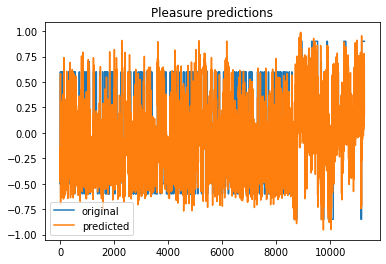

In [50]:
x_ax = range(len(test_y_p))
plt.plot(x_ax, test_y_p, label="original")
plt.plot(x_ax, pred_y_p, label="predicted")

plt.title("Pleasure predictions")

plt.legend()
plt.show()

In [ ]:
x_ax = range(len(test_y_a))
plt.plot(x_ax, test_y_a, label="original")
plt.plot(x_ax, pred_y_a, label="predicted")

plt.title("Arousal predictions")

plt.legend()
plt.show()

### Prediction Examples

In [53]:
row=test_X.iloc[0]

x = np.asarray([row])

y_p = model_p.predict(x)
y_a = model_a.predict(x)

print('Real: %s' % np.asarray(test_y.iloc[0]))
print('Predicted: %s' % [y_p[0], y_a[0]])

Real: [-0.5  0.6]
Predicted: [-0.29030004, 0.4199877]


In [54]:
row=test_X.iloc[420]

x = np.asarray([row])

y_p = model_p.predict(x)
y_a = model_a.predict(x)

print('Real: %s' % np.asarray(test_y.iloc[420]))
print('Predicted: %s' % [y_p[0], y_a[0]])

Real: [-0.6 -0.3]
Predicted: [-0.36928195, -0.17541961]


In [55]:
row=test_X.iloc[4000]

x = np.asarray([row])

y_p = model_p.predict(x)
y_a = model_a.predict(x)

print('Real: %s' % np.asarray(test_y.iloc[4000]))
print('Predicted: %s' % [y_p[0], y_a[0]])

Real: [-0.4   0.25]
Predicted: [-0.38055393, 0.20550194]


## Save Models

In [56]:
# save to JSON
model_p.save_model("l2p_model.json")
model_a.save_model("l2a_model.json")

# save to text format
model_p.save_model("l2p_model.txt")
model_a.save_model("l2a_model.txt")

# Hyperparameter Grid Search with XGBoost

In [25]:
from datetime import datetime
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RandomizedSearchCV
import time

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns

import tensorflow as tf

import sklearn
from sklearn.model_selection import cross_val_score, KFold
from sklearn.metrics import mean_absolute_error


import xgboost as xgb

xgb.set_config(verbosity=0)

from sklearn.metrics import mean_squared_error

## Load Data

In [37]:
#dataset = pd.read_csv('datasets/pa/Fs_B_N_LMA_DATA.csv')
#dataset = pd.read_csv('datasets/pa/Fs_N_LMA_DATA.csv')
dataset = pd.read_csv('datasets/pa/Fs_N_LMA_DATA_EXTRA.csv')
#dataset = pd.read_csv('datasets/pa/Fs2_N_LMA_DATA_EXTRA.csv')

### Split into Test and Train data

In [38]:
train_dataset = dataset.sample(frac=0.8, random_state=42)
test_dataset = dataset.drop(train_dataset.index)

print("No Training Samples:",train_dataset.shape[0])
print("No Test Samples:",test_dataset.shape[0])

No Training Samples: 45087
No Test Samples: 11272


### Split Features from Targets

In [39]:
train_X = train_dataset.copy()
test_X = test_dataset.copy()

train_y = pd.concat([train_X.pop(x) for x in ['EMOTION_P', 'EMOTION_A']], axis=1)
test_y = pd.concat([test_X.pop(x) for x in ['EMOTION_P', 'EMOTION_A']], axis=1)

test_y_p = test_y.iloc[:,0]
train_y_p = train_y.iloc[:,0]

test_y_a = test_y.iloc[:,1]
train_y_a = train_y.iloc[:,1]

In [40]:
train_X.head()

,avg_hand_distance,avg_l_hand_hip_distance,avg_r_hand_hip_distance,avg_feet_distance,avg_l_hand_chest_distance,avg_r_hand_chest_distance,avg_l_elbow_hip_distance,avg_r_elbow_hip_distance,avg_chest_pelvis_distance,avg_neck_chest_distance,...,avg_pelvis_velocity_y,avg_pelvis_velocity_z,avg_l_foot_velocity_x,avg_l_foot_velocity_y,avg_l_foot_velocity_z,avg_r_foot_velocity_x,avg_r_foot_velocity_y,avg_r_foot_velocity_z,avg_upper_body_volume,avg_distance_traveled
5770,0.262334,0.662568,0.696583,0.241384,0.630144,0.594538,0.681151,0.629491,0.257159,0.996101,...,0.473326,0.539095,0.590923,0.633511,0.331921,0.448977,0.506205,0.533892,0.634425,0.055723
20189,0.531666,0.499619,0.491083,0.182074,0.747718,0.387772,0.699997,0.397462,0.256635,0.999420,...,0.492880,0.357735,0.592764,0.617945,0.345391,0.450799,0.496437,0.548976,0.533730,0.132637
55768,0.404123,0.144595,0.455608,0.180686,0.546617,0.711027,0.429951,0.666752,0.272435,0.896752,...,0.482871,0.432854,0.586842,0.662572,0.372798,0.439296,0.481497,0.525963,0.316449,0.031250
5563,0.328572,0.268337,0.225690,0.294625,0.629984,0.598234,0.557388,0.518056,0.264650,0.998397,...,0.507869,0.506601,0.589155,0.622941,0.338966,0.447227,0.499572,0.541782,0.350779,0.032754
53047,0.570762,0.540919,0.507984,0.273218,0.560548,0.556178,0.646091,0.596224,0.260777,0.982706,...,0.447770,0.526478,0.575987,0.652520,0.372661,0.454815,0.506949,0.489328,0.693218,0.046396


In [41]:
train_y.head()

,EMOTION_P,EMOTION_A
5770,-0.35,0.7
20189,-0.35,0.7
55768,-0.85,-0.1
5563,-0.50,0.6
53047,0.50,0.7


In [42]:
train_X.describe().transpose()[['mean', 'std']]

,mean,std
avg_hand_distance,0.367866,0.202526
avg_l_hand_hip_distance,0.354570,0.185754
avg_r_hand_hip_distance,0.369125,0.193929
avg_feet_distance,0.221029,0.105025
avg_l_hand_chest_distance,0.566260,0.164762
avg_r_hand_chest_distance,0.563325,0.164601
avg_l_elbow_hip_distance,0.525713,0.154588
avg_r_elbow_hip_distance,0.526010,0.155729
avg_chest_pelvis_distance,0.268310,0.023227
avg_neck_chest_distance,0.982620,0.035712


## Get Best

In [26]:
# A parameter grid for XGBoost
params = {
        'n_estimators': [500, 1000, 1500, 2000],
        'min_child_weight': [1, 5, 11, 22, 33],
        'gamma': [0, 0.1, 0.25, 0.5, 1.0],
        'learning_rate': [0.05, 0.15, 0.3, 0.5, 0.8],
        'subsample': [1, 2],
        'colsample_bytree': [1, 2],
        'max_depth': [6, 10, 15, 20, 30],
        'lambda': [1, 1.5, 2],
        }

In [27]:
model_p = xgb.XGBRegressor(
                    n_estimators=2000, learning_rate=0.05, max_depth=10, min_child_weight=11, 
                    subsample=1, colsample_bytree=1, objective="reg:linear"
                )

#model_a = xgb.XGBRegressor(
#                    n_estimators=2000, learning_rate=0.05, max_depth=10, min_child_weight=11, 
#                    subsample=1, colsample_bytree=1, objective="reg:linear"
#                )

In [28]:
# run randomized search
n_iter_search = 50
random_search_p = RandomizedSearchCV(model_p, param_distributions=params,
                                   n_iter=n_iter_search, cv=5, scoring='mean_absolute_error')

start = time.time()
random_search_p.fit(train_X, train_y_p)


print("RandomizedSearchCV took %.2f seconds for %d candidates"
      " parameter settings." % ((time.time() - start), n_iter_search))

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a fu

[15:30:46] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[15:30:46] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[15:30:46] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[15:30:46] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[15:30:46] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[15:30:46] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[15:30:46] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[15:30:46] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[15:30:46] WARNING: ../src/objective/regression_

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a fu

[15:30:46] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[15:30:46] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[15:30:46] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[15:30:46] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[15:30:46] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[15:30:46] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[15:30:46] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[15:30:46] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[15:30:46] WARNING: ../src/objective/regression_

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a fu

[15:30:46] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[15:30:46] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[15:30:46] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[15:30:46] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[15:30:46] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[15:30:46] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[15:30:46] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[15:30:46] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[15:30:47] WARNING: ../src/objective/regression_

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a fu

[15:30:47] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[15:30:47] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[15:30:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 630 extra nodes, 76 pruned nodes, max_depth=20
[15:30:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 830 extra nodes, 120 pruned nodes, max_depth=20
[15:30:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 736 extra nodes, 74 pruned nodes, max_depth=20
[15:30:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 690 extra nodes, 72 pruned nodes, max_depth=20
[15:30:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 794 extra nodes, 108 pruned nodes, max_depth=20
[15:30:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 722 extra nodes, 98 pruned nodes, max_depth=20
[15:30:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning 

[15:30:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 482 extra nodes, 114 pruned nodes, max_depth=20
[15:30:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 654 extra nodes, 240 pruned nodes, max_depth=20
[15:30:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 404 extra nodes, 142 pruned nodes, max_depth=20
[15:30:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 632 extra nodes, 228 pruned nodes, max_depth=20
[15:30:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 332 extra nodes, 98 pruned nodes, max_depth=20
[15:30:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 558 extra nodes, 234 pruned nodes, max_depth=20
[15:30:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 746 extra nodes, 312 pruned nodes, max_depth=20
[15:30:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 548 extra nodes, 272 pruned nodes, max_depth=20
[15:30:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning e

[15:31:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 388 extra nodes, 386 pruned nodes, max_depth=20
[15:31:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 424 extra nodes, 566 pruned nodes, max_depth=20
[15:31:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 296 extra nodes, 330 pruned nodes, max_depth=20
[15:31:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 192 extra nodes, 152 pruned nodes, max_depth=20
[15:31:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 318 extra nodes, 392 pruned nodes, max_depth=20
[15:31:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 226 extra nodes, 320 pruned nodes, max_depth=20
[15:31:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 410 extra nodes, 504 pruned nodes, max_depth=20
[15:31:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 474 extra nodes, 496 pruned nodes, max_depth=20
[15:31:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning 

[15:31:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 166 extra nodes, 540 pruned nodes, max_depth=20
[15:31:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 122 extra nodes, 538 pruned nodes, max_depth=20
[15:31:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 98 extra nodes, 292 pruned nodes, max_depth=16
[15:31:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 180 extra nodes, 628 pruned nodes, max_depth=20
[15:31:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 276 extra nodes, 646 pruned nodes, max_depth=20
[15:31:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 166 extra nodes, 642 pruned nodes, max_depth=20
[15:31:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 174 extra nodes, 802 pruned nodes, max_depth=20
[15:31:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 214 extra nodes, 668 pruned nodes, max_depth=20
[15:31:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning e

[15:31:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 458 pruned nodes, max_depth=18
[15:31:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 114 extra nodes, 736 pruned nodes, max_depth=20
[15:31:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 170 extra nodes, 544 pruned nodes, max_depth=20
[15:31:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 1016 pruned nodes, max_depth=14
[15:31:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 140 extra nodes, 908 pruned nodes, max_depth=20
[15:31:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 148 extra nodes, 842 pruned nodes, max_depth=19
[15:31:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 372 pruned nodes, max_depth=16
[15:31:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 extra nodes, 550 pruned nodes, max_depth=16
[15:31:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end

[15:31:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 100 extra nodes, 762 pruned nodes, max_depth=20
[15:31:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 92 extra nodes, 798 pruned nodes, max_depth=20
[15:31:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 136 extra nodes, 698 pruned nodes, max_depth=20
[15:31:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 124 extra nodes, 700 pruned nodes, max_depth=18
[15:31:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 690 pruned nodes, max_depth=13
[15:31:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 170 extra nodes, 716 pruned nodes, max_depth=20
[15:31:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 840 pruned nodes, max_depth=19
[15:31:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 116 extra nodes, 704 pruned nodes, max_depth=20
[15:31:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end

[15:31:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 324 pruned nodes, max_depth=18
[15:31:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 90 extra nodes, 1056 pruned nodes, max_depth=13
[15:31:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 588 pruned nodes, max_depth=19
[15:31:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 604 pruned nodes, max_depth=20
[15:31:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 88 extra nodes, 684 pruned nodes, max_depth=16
[15:31:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 712 pruned nodes, max_depth=14
[15:31:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 894 pruned nodes, max_depth=12
[15:31:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 458 pruned nodes, max_depth=0
[15:31:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 e

[15:31:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 650 pruned nodes, max_depth=19
[15:31:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 84 extra nodes, 1026 pruned nodes, max_depth=19
[15:31:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 1028 pruned nodes, max_depth=18
[15:31:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 580 pruned nodes, max_depth=13
[15:31:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 892 pruned nodes, max_depth=17
[15:31:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 612 pruned nodes, max_depth=17
[15:31:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 350 pruned nodes, max_depth=17
[15:31:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 694 pruned nodes, max_depth=18
[15:31:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 9

[15:32:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 778 pruned nodes, max_depth=0
[15:32:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 292 pruned nodes, max_depth=17
[15:32:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 644 pruned nodes, max_depth=13
[15:32:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 872 pruned nodes, max_depth=19
[15:32:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 816 pruned nodes, max_depth=0
[15:32:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 392 pruned nodes, max_depth=20
[15:32:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 730 pruned nodes, max_depth=16
[15:32:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 828 pruned nodes, max_depth=14
[15:32:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra

[15:32:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 994 pruned nodes, max_depth=12
[15:32:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 584 pruned nodes, max_depth=0
[15:32:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 514 pruned nodes, max_depth=0
[15:32:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 530 pruned nodes, max_depth=17
[15:32:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 416 pruned nodes, max_depth=19
[15:32:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 100 extra nodes, 784 pruned nodes, max_depth=19
[15:32:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 876 pruned nodes, max_depth=0
[15:32:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 556 pruned nodes, max_depth=0
[15:32:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra n

[15:32:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 684 pruned nodes, max_depth=20
[15:32:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 728 pruned nodes, max_depth=18
[15:32:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 804 pruned nodes, max_depth=16
[15:32:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 706 pruned nodes, max_depth=17
[15:32:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 970 pruned nodes, max_depth=20
[15:32:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 608 pruned nodes, max_depth=16
[15:32:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 1086 pruned nodes, max_depth=11
[15:32:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 1034 pruned nodes, max_depth=9
[15:32:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70

[15:32:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 796 pruned nodes, max_depth=19
[15:32:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1046 pruned nodes, max_depth=0
[15:32:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 424 pruned nodes, max_depth=0
[15:32:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 376 pruned nodes, max_depth=20
[15:32:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 488 pruned nodes, max_depth=0
[15:32:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 404 pruned nodes, max_depth=0
[15:32:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 780 pruned nodes, max_depth=0
[15:32:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 368 pruned nodes, max_depth=0
[15:32:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[15:32:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 610 pruned nodes, max_depth=0
[15:32:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 744 pruned nodes, max_depth=20
[15:32:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 536 pruned nodes, max_depth=0
[15:32:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 846 pruned nodes, max_depth=13
[15:32:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 806 pruned nodes, max_depth=14
[15:32:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 760 pruned nodes, max_depth=14
[15:32:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 662 pruned nodes, max_depth=0
[15:32:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 722 pruned nodes, max_depth=19
[15:32:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra n

[15:32:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1014 pruned nodes, max_depth=0
[15:32:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 924 pruned nodes, max_depth=19
[15:32:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 862 pruned nodes, max_depth=0
[15:32:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 832 pruned nodes, max_depth=0
[15:32:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 612 pruned nodes, max_depth=0
[15:32:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 564 pruned nodes, max_depth=17
[15:32:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 650 pruned nodes, max_depth=18
[15:32:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 934 pruned nodes, max_depth=8
[15:32:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nod

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[15:33:04] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[15:33:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 706 extra nodes, 62 pruned nodes, max_depth=20
[15:33:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 780 extra nodes, 126 pruned nodes, max_depth=20
[15:33:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 796 extra nodes, 98 pruned nodes, max_depth=20
[15:33:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 726 extra nodes, 118 pruned nodes, max_depth=20
[15:33:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 766 extra nodes, 88 pruned nodes, max_depth=20
[15:33:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 758 extra nodes, 82 pruned nodes, max_depth=20
[15:33:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 764 extra nodes, 76 pruned nodes, max_depth=20
[15:33:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end

[15:33:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 548 extra nodes, 218 pruned nodes, max_depth=20
[15:33:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 482 extra nodes, 200 pruned nodes, max_depth=20
[15:33:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 228 extra nodes, 86 pruned nodes, max_depth=20
[15:33:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 520 extra nodes, 238 pruned nodes, max_depth=20
[15:33:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 626 extra nodes, 274 pruned nodes, max_depth=20
[15:33:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 654 extra nodes, 308 pruned nodes, max_depth=20
[15:33:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 384 extra nodes, 132 pruned nodes, max_depth=20
[15:33:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 516 extra nodes, 188 pruned nodes, max_depth=20
[15:33:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning e

[15:33:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 418 extra nodes, 528 pruned nodes, max_depth=20
[15:33:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 244 extra nodes, 220 pruned nodes, max_depth=20
[15:33:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 310 extra nodes, 420 pruned nodes, max_depth=20
[15:33:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 400 extra nodes, 412 pruned nodes, max_depth=20
[15:33:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 290 extra nodes, 442 pruned nodes, max_depth=20
[15:33:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 376 extra nodes, 510 pruned nodes, max_depth=20
[15:33:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 322 extra nodes, 378 pruned nodes, max_depth=20
[15:33:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 426 extra nodes, 672 pruned nodes, max_depth=20
[15:33:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning 

[15:33:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 124 extra nodes, 276 pruned nodes, max_depth=20
[15:33:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 254 extra nodes, 674 pruned nodes, max_depth=20
[15:33:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 206 extra nodes, 726 pruned nodes, max_depth=20
[15:33:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 168 pruned nodes, max_depth=20
[15:33:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 158 extra nodes, 310 pruned nodes, max_depth=20
[15:33:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 136 extra nodes, 236 pruned nodes, max_depth=20
[15:33:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 178 extra nodes, 452 pruned nodes, max_depth=20
[15:33:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 138 extra nodes, 490 pruned nodes, max_depth=19
[15:33:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning e

[15:33:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 122 extra nodes, 796 pruned nodes, max_depth=20
[15:33:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 138 extra nodes, 886 pruned nodes, max_depth=19
[15:33:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 108 extra nodes, 766 pruned nodes, max_depth=20
[15:33:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 120 extra nodes, 536 pruned nodes, max_depth=19
[15:33:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 88 extra nodes, 444 pruned nodes, max_depth=20
[15:33:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 356 pruned nodes, max_depth=20
[15:33:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 106 extra nodes, 560 pruned nodes, max_depth=20
[15:33:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 394 pruned nodes, max_depth=10
[15:33:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end

[15:33:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 146 extra nodes, 710 pruned nodes, max_depth=20
[15:33:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 extra nodes, 436 pruned nodes, max_depth=20
[15:33:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 extra nodes, 722 pruned nodes, max_depth=20
[15:33:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 84 extra nodes, 810 pruned nodes, max_depth=18
[15:33:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 560 pruned nodes, max_depth=16
[15:33:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 560 pruned nodes, max_depth=18
[15:33:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 134 extra nodes, 646 pruned nodes, max_depth=20
[15:33:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 166 extra nodes, 760 pruned nodes, max_depth=20
[15:33:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 

[15:34:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 612 pruned nodes, max_depth=15
[15:34:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 920 pruned nodes, max_depth=16
[15:34:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 516 pruned nodes, max_depth=20
[15:34:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 496 pruned nodes, max_depth=19
[15:34:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 extra nodes, 1000 pruned nodes, max_depth=17
[15:34:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 594 pruned nodes, max_depth=16
[15:34:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 112 extra nodes, 988 pruned nodes, max_depth=16
[15:34:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 426 pruned nodes, max_depth=19
[15:34:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6

[15:34:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 92 extra nodes, 748 pruned nodes, max_depth=19
[15:34:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 116 extra nodes, 1098 pruned nodes, max_depth=19
[15:34:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 572 pruned nodes, max_depth=15
[15:34:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 866 pruned nodes, max_depth=15
[15:34:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 830 pruned nodes, max_depth=13
[15:34:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 650 pruned nodes, max_depth=13
[15:34:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 454 pruned nodes, max_depth=19
[15:34:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 712 pruned nodes, max_depth=19
[15:34:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 4

[15:34:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 432 pruned nodes, max_depth=12
[15:34:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 986 pruned nodes, max_depth=16
[15:34:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 596 pruned nodes, max_depth=17
[15:34:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 842 pruned nodes, max_depth=20
[15:34:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 718 pruned nodes, max_depth=9
[15:34:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 808 pruned nodes, max_depth=20
[15:34:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 738 pruned nodes, max_depth=9
[15:34:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 234 pruned nodes, max_depth=0
[15:34:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extr

[15:34:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 396 pruned nodes, max_depth=0
[15:34:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 978 pruned nodes, max_depth=15
[15:34:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 468 pruned nodes, max_depth=19
[15:34:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 782 pruned nodes, max_depth=13
[15:34:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 742 pruned nodes, max_depth=19
[15:34:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 864 pruned nodes, max_depth=19
[15:34:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 854 pruned nodes, max_depth=0
[15:34:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 762 pruned nodes, max_depth=16
[15:34:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra

[15:34:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 666 pruned nodes, max_depth=17
[15:34:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 722 pruned nodes, max_depth=12
[15:34:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 518 pruned nodes, max_depth=0
[15:34:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 990 pruned nodes, max_depth=14
[15:34:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 570 pruned nodes, max_depth=18
[15:34:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 894 pruned nodes, max_depth=0
[15:34:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 598 pruned nodes, max_depth=11
[15:34:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 798 pruned nodes, max_depth=0
[15:34:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra 

[15:34:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 884 pruned nodes, max_depth=12
[15:34:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 610 pruned nodes, max_depth=17
[15:34:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 270 pruned nodes, max_depth=0
[15:34:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 502 pruned nodes, max_depth=0
[15:34:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 424 pruned nodes, max_depth=20
[15:34:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 500 pruned nodes, max_depth=10
[15:34:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 846 pruned nodes, max_depth=8
[15:34:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 542 pruned nodes, max_depth=18
[15:34:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra

[15:35:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 476 pruned nodes, max_depth=0
[15:35:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 548 pruned nodes, max_depth=17
[15:35:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 800 pruned nodes, max_depth=8
[15:35:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 758 pruned nodes, max_depth=0
[15:35:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 260 pruned nodes, max_depth=14
[15:35:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 850 pruned nodes, max_depth=18
[15:35:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 806 pruned nodes, max_depth=0
[15:35:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 774 pruned nodes, max_depth=19
[15:35:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra n

[15:35:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 976 pruned nodes, max_depth=18
[15:35:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 898 pruned nodes, max_depth=0
[15:35:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 946 pruned nodes, max_depth=13
[15:35:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 348 pruned nodes, max_depth=19
[15:35:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 630 pruned nodes, max_depth=0
[15:35:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 918 pruned nodes, max_depth=14
[15:35:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 816 pruned nodes, max_depth=15
[15:35:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 574 pruned nodes, max_depth=9
[15:35:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[15:35:22] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[15:35:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 816 extra nodes, 124 pruned nodes, max_depth=20
[15:35:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 780 extra nodes, 72 pruned nodes, max_depth=20
[15:35:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 820 extra nodes, 106 pruned nodes, max_depth=20
[15:35:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 826 extra nodes, 130 pruned nodes, max_depth=20
[15:35:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 808 extra nodes, 108 pruned nodes, max_depth=20
[15:35:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 692 extra nodes, 86 pruned nodes, max_depth=20
[15:35:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 856 extra nodes, 128 pruned nodes, max_depth=20
[15:35:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning 

[15:35:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 410 extra nodes, 100 pruned nodes, max_depth=20
[15:35:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 426 extra nodes, 88 pruned nodes, max_depth=20
[15:35:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 634 extra nodes, 244 pruned nodes, max_depth=20
[15:35:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 646 extra nodes, 228 pruned nodes, max_depth=20
[15:35:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 426 extra nodes, 150 pruned nodes, max_depth=20
[15:35:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 646 extra nodes, 280 pruned nodes, max_depth=20
[15:35:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 286 extra nodes, 106 pruned nodes, max_depth=20
[15:35:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 598 extra nodes, 210 pruned nodes, max_depth=20
[15:35:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning e

[15:35:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 466 extra nodes, 548 pruned nodes, max_depth=20
[15:35:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 346 extra nodes, 436 pruned nodes, max_depth=20
[15:35:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 388 extra nodes, 456 pruned nodes, max_depth=20
[15:35:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 310 extra nodes, 368 pruned nodes, max_depth=20
[15:35:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 224 extra nodes, 276 pruned nodes, max_depth=20
[15:35:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 404 extra nodes, 534 pruned nodes, max_depth=20
[15:35:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 424 extra nodes, 486 pruned nodes, max_depth=20
[15:35:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 222 extra nodes, 184 pruned nodes, max_depth=20
[15:35:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning 

[15:35:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 204 extra nodes, 484 pruned nodes, max_depth=20
[15:35:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 158 extra nodes, 562 pruned nodes, max_depth=20
[15:35:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 188 extra nodes, 342 pruned nodes, max_depth=20
[15:35:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 extra nodes, 238 pruned nodes, max_depth=20
[15:35:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 292 extra nodes, 906 pruned nodes, max_depth=20
[15:35:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 210 extra nodes, 488 pruned nodes, max_depth=20
[15:35:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 146 extra nodes, 450 pruned nodes, max_depth=20
[15:35:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 200 extra nodes, 434 pruned nodes, max_depth=20
[15:35:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning e

[15:36:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 126 extra nodes, 488 pruned nodes, max_depth=20
[15:36:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 114 extra nodes, 654 pruned nodes, max_depth=20
[15:36:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 500 pruned nodes, max_depth=13
[15:36:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 126 extra nodes, 406 pruned nodes, max_depth=20
[15:36:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 110 extra nodes, 518 pruned nodes, max_depth=20
[15:36:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 174 extra nodes, 826 pruned nodes, max_depth=18
[15:36:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 330 pruned nodes, max_depth=18
[15:36:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 98 extra nodes, 486 pruned nodes, max_depth=20
[15:36:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end

[15:36:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 446 pruned nodes, max_depth=8
[15:36:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 720 pruned nodes, max_depth=16
[15:36:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 114 extra nodes, 1042 pruned nodes, max_depth=15
[15:36:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 98 extra nodes, 786 pruned nodes, max_depth=20
[15:36:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 400 pruned nodes, max_depth=18
[15:36:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 570 pruned nodes, max_depth=17
[15:36:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 94 extra nodes, 952 pruned nodes, max_depth=15
[15:36:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 652 pruned nodes, max_depth=20
[15:36:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58

[15:36:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 516 pruned nodes, max_depth=19
[15:36:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 88 extra nodes, 920 pruned nodes, max_depth=19
[15:36:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 620 pruned nodes, max_depth=12
[15:36:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 526 pruned nodes, max_depth=18
[15:36:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 1028 pruned nodes, max_depth=18
[15:36:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 858 pruned nodes, max_depth=13
[15:36:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 664 pruned nodes, max_depth=17
[15:36:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 extra nodes, 382 pruned nodes, max_depth=20
[15:36:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70

[15:36:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 590 pruned nodes, max_depth=18
[15:36:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 754 pruned nodes, max_depth=20
[15:36:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 712 pruned nodes, max_depth=20
[15:36:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 1012 pruned nodes, max_depth=15
[15:36:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 708 pruned nodes, max_depth=8
[15:36:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 620 pruned nodes, max_depth=20
[15:36:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 752 pruned nodes, max_depth=17
[15:36:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 extra nodes, 928 pruned nodes, max_depth=18
[15:36:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 98 

[15:36:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 550 pruned nodes, max_depth=14
[15:36:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 456 pruned nodes, max_depth=0
[15:36:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 554 pruned nodes, max_depth=15
[15:36:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 444 pruned nodes, max_depth=19
[15:36:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 248 pruned nodes, max_depth=17
[15:36:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 752 pruned nodes, max_depth=0
[15:36:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 206 pruned nodes, max_depth=18
[15:36:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 1004 pruned nodes, max_depth=19
[15:36:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 ext

[15:36:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 644 pruned nodes, max_depth=4
[15:36:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 1140 pruned nodes, max_depth=15
[15:36:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 640 pruned nodes, max_depth=16
[15:36:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 664 pruned nodes, max_depth=17
[15:36:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 944 pruned nodes, max_depth=16
[15:36:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 602 pruned nodes, max_depth=16
[15:36:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 482 pruned nodes, max_depth=17
[15:36:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 678 pruned nodes, max_depth=18
[15:36:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 e

[15:37:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 830 pruned nodes, max_depth=19
[15:37:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 552 pruned nodes, max_depth=19
[15:37:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 744 pruned nodes, max_depth=13
[15:37:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 658 pruned nodes, max_depth=14
[15:37:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 870 pruned nodes, max_depth=0
[15:37:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 594 pruned nodes, max_depth=0
[15:37:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 592 pruned nodes, max_depth=0
[15:37:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 528 pruned nodes, max_depth=0
[15:37:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nod

[15:37:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 452 pruned nodes, max_depth=0
[15:37:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 872 pruned nodes, max_depth=0
[15:37:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 extra nodes, 632 pruned nodes, max_depth=20
[15:37:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 570 pruned nodes, max_depth=0
[15:37:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 648 pruned nodes, max_depth=9
[15:37:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 1090 pruned nodes, max_depth=11
[15:37:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 496 pruned nodes, max_depth=0
[15:37:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 538 pruned nodes, max_depth=0
[15:37:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra node

[15:37:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 868 pruned nodes, max_depth=14
[15:37:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 670 pruned nodes, max_depth=14
[15:37:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 996 pruned nodes, max_depth=16
[15:37:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 946 pruned nodes, max_depth=9
[15:37:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 828 pruned nodes, max_depth=20
[15:37:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 714 pruned nodes, max_depth=20
[15:37:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 1034 pruned nodes, max_depth=11
[15:37:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 618 pruned nodes, max_depth=18
[15:37:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 

[15:37:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 506 pruned nodes, max_depth=0
[15:37:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 850 pruned nodes, max_depth=11
[15:37:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 914 pruned nodes, max_depth=13
[15:37:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 796 pruned nodes, max_depth=17
[15:37:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 820 pruned nodes, max_depth=11
[15:37:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 858 pruned nodes, max_depth=0
[15:37:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 656 pruned nodes, max_depth=15
[15:37:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 534 pruned nodes, max_depth=0
[15:37:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra n

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[15:37:40] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[15:37:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 700 extra nodes, 50 pruned nodes, max_depth=20
[15:37:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 816 extra nodes, 92 pruned nodes, max_depth=20
[15:37:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 798 extra nodes, 84 pruned nodes, max_depth=20
[15:37:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 762 extra nodes, 90 pruned nodes, max_depth=20
[15:37:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 792 extra nodes, 104 pruned nodes, max_depth=20
[15:37:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 744 extra nodes, 92 pruned nodes, max_depth=20
[15:37:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 840 extra nodes, 102 pruned nodes, max_depth=20
[15:37:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end

[15:37:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 168 extra nodes, 68 pruned nodes, max_depth=20
[15:37:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 690 extra nodes, 292 pruned nodes, max_depth=20
[15:37:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 680 extra nodes, 266 pruned nodes, max_depth=20
[15:37:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 600 extra nodes, 210 pruned nodes, max_depth=20
[15:37:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 336 extra nodes, 102 pruned nodes, max_depth=20
[15:37:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 600 extra nodes, 214 pruned nodes, max_depth=20
[15:37:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 426 extra nodes, 126 pruned nodes, max_depth=20
[15:37:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 608 extra nodes, 200 pruned nodes, max_depth=20
[15:37:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning e

[15:37:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 338 extra nodes, 526 pruned nodes, max_depth=20
[15:37:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 272 extra nodes, 354 pruned nodes, max_depth=20
[15:37:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 348 extra nodes, 476 pruned nodes, max_depth=20
[15:37:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 202 extra nodes, 170 pruned nodes, max_depth=20
[15:38:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 276 extra nodes, 226 pruned nodes, max_depth=20
[15:38:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 434 extra nodes, 638 pruned nodes, max_depth=20
[15:38:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 304 extra nodes, 484 pruned nodes, max_depth=20
[15:38:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 406 extra nodes, 730 pruned nodes, max_depth=20
[15:38:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning 

[15:38:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 274 extra nodes, 864 pruned nodes, max_depth=20
[15:38:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 98 extra nodes, 208 pruned nodes, max_depth=20
[15:38:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 228 extra nodes, 646 pruned nodes, max_depth=20
[15:38:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 250 extra nodes, 590 pruned nodes, max_depth=20
[15:38:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 270 extra nodes, 792 pruned nodes, max_depth=20
[15:38:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 132 extra nodes, 234 pruned nodes, max_depth=19
[15:38:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 238 extra nodes, 608 pruned nodes, max_depth=20
[15:38:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 136 extra nodes, 600 pruned nodes, max_depth=20
[15:38:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning e

[15:38:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 154 extra nodes, 766 pruned nodes, max_depth=19
[15:38:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 438 pruned nodes, max_depth=19
[15:38:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 114 extra nodes, 766 pruned nodes, max_depth=17
[15:38:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 132 extra nodes, 712 pruned nodes, max_depth=20
[15:38:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 242 pruned nodes, max_depth=19
[15:38:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 158 extra nodes, 672 pruned nodes, max_depth=20
[15:38:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 114 extra nodes, 426 pruned nodes, max_depth=20
[15:38:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 136 extra nodes, 1002 pruned nodes, max_depth=19
[15:38:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning e

[15:38:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 94 extra nodes, 946 pruned nodes, max_depth=17
[15:38:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 114 extra nodes, 820 pruned nodes, max_depth=20
[15:38:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 116 extra nodes, 760 pruned nodes, max_depth=20
[15:38:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 extra nodes, 666 pruned nodes, max_depth=16
[15:38:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 88 extra nodes, 696 pruned nodes, max_depth=20
[15:38:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 140 extra nodes, 568 pruned nodes, max_depth=20
[15:38:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 334 pruned nodes, max_depth=13
[15:38:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 280 pruned nodes, max_depth=19
[15:38:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 

[15:38:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 862 pruned nodes, max_depth=12
[15:38:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 376 pruned nodes, max_depth=0
[15:38:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 100 extra nodes, 814 pruned nodes, max_depth=19
[15:38:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 100 extra nodes, 894 pruned nodes, max_depth=16
[15:38:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 744 pruned nodes, max_depth=11
[15:38:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 extra nodes, 910 pruned nodes, max_depth=15
[15:38:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 570 pruned nodes, max_depth=0
[15:38:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 92 extra nodes, 916 pruned nodes, max_depth=20
[15:38:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 104 e

[15:38:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 454 pruned nodes, max_depth=0
[15:38:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 extra nodes, 648 pruned nodes, max_depth=20
[15:38:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 446 pruned nodes, max_depth=17
[15:38:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 578 pruned nodes, max_depth=20
[15:38:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 618 pruned nodes, max_depth=9
[15:38:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 420 pruned nodes, max_depth=20
[15:38:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 758 pruned nodes, max_depth=0
[15:38:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 624 pruned nodes, max_depth=13
[15:38:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra

[15:38:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 448 pruned nodes, max_depth=17
[15:38:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 798 pruned nodes, max_depth=14
[15:38:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 820 pruned nodes, max_depth=17
[15:38:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 588 pruned nodes, max_depth=18
[15:38:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 522 pruned nodes, max_depth=15
[15:38:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 924 pruned nodes, max_depth=18
[15:38:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 896 pruned nodes, max_depth=17
[15:38:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 336 pruned nodes, max_depth=18
[15:38:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 

[15:39:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 722 pruned nodes, max_depth=19
[15:39:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 780 pruned nodes, max_depth=4
[15:39:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 828 pruned nodes, max_depth=17
[15:39:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 434 pruned nodes, max_depth=20
[15:39:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 514 pruned nodes, max_depth=12
[15:39:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 616 pruned nodes, max_depth=0
[15:39:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 extra nodes, 590 pruned nodes, max_depth=20
[15:39:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 1018 pruned nodes, max_depth=20
[15:39:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 ext

[15:39:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 928 pruned nodes, max_depth=0
[15:39:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 552 pruned nodes, max_depth=0
[15:39:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 910 pruned nodes, max_depth=17
[15:39:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 880 pruned nodes, max_depth=0
[15:39:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 848 pruned nodes, max_depth=18
[15:39:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 590 pruned nodes, max_depth=11
[15:39:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 392 pruned nodes, max_depth=0
[15:39:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 848 pruned nodes, max_depth=13
[15:39:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nod

[15:39:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 496 pruned nodes, max_depth=19
[15:39:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 684 pruned nodes, max_depth=16
[15:39:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 872 pruned nodes, max_depth=5
[15:39:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 862 pruned nodes, max_depth=12
[15:39:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 512 pruned nodes, max_depth=8
[15:39:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 970 pruned nodes, max_depth=14
[15:39:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 606 pruned nodes, max_depth=0
[15:39:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 576 pruned nodes, max_depth=18
[15:39:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extr

[15:39:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 398 pruned nodes, max_depth=0
[15:39:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 1000 pruned nodes, max_depth=11
[15:39:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 434 pruned nodes, max_depth=0
[15:39:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 848 pruned nodes, max_depth=18
[15:39:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 880 pruned nodes, max_depth=18
[15:39:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 584 pruned nodes, max_depth=17
[15:39:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 572 pruned nodes, max_depth=0
[15:39:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 844 pruned nodes, max_depth=0
[15:39:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra n

[15:39:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1026 pruned nodes, max_depth=0
[15:39:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 872 pruned nodes, max_depth=0
[15:39:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 692 pruned nodes, max_depth=7
[15:39:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 842 pruned nodes, max_depth=20
[15:39:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 900 pruned nodes, max_depth=0
[15:39:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 826 pruned nodes, max_depth=11
[15:39:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 470 pruned nodes, max_depth=0
[15:39:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 878 pruned nodes, max_depth=20
[15:39:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra no

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[15:39:58] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[15:39:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 656 extra nodes, 74 pruned nodes, max_depth=20
[15:39:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 638 extra nodes, 88 pruned nodes, max_depth=20
[15:39:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 772 extra nodes, 88 pruned nodes, max_depth=20
[15:39:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 660 extra nodes, 64 pruned nodes, max_depth=20
[15:39:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 744 extra nodes, 86 pruned nodes, max_depth=20
[15:39:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 744 extra nodes, 102 pruned nodes, max_depth=20
[15:39:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 768 extra nodes, 110 pruned nodes, max_depth=20
[15:39:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end

[15:40:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 414 extra nodes, 180 pruned nodes, max_depth=20
[15:40:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 474 extra nodes, 252 pruned nodes, max_depth=20
[15:40:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 660 extra nodes, 280 pruned nodes, max_depth=20
[15:40:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 642 extra nodes, 188 pruned nodes, max_depth=20
[15:40:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 336 extra nodes, 118 pruned nodes, max_depth=20
[15:40:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 446 extra nodes, 136 pruned nodes, max_depth=20
[15:40:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 604 extra nodes, 200 pruned nodes, max_depth=20
[15:40:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 328 extra nodes, 114 pruned nodes, max_depth=20
[15:40:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning 

[15:40:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 372 extra nodes, 306 pruned nodes, max_depth=20
[15:40:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 334 extra nodes, 462 pruned nodes, max_depth=20
[15:40:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 462 extra nodes, 524 pruned nodes, max_depth=20
[15:40:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 210 extra nodes, 246 pruned nodes, max_depth=20
[15:40:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 270 extra nodes, 432 pruned nodes, max_depth=20
[15:40:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 372 extra nodes, 478 pruned nodes, max_depth=20
[15:40:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 286 extra nodes, 358 pruned nodes, max_depth=20
[15:40:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 456 extra nodes, 648 pruned nodes, max_depth=20
[15:40:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning 

[15:40:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 224 extra nodes, 688 pruned nodes, max_depth=20
[15:40:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 130 extra nodes, 374 pruned nodes, max_depth=20
[15:40:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 170 extra nodes, 510 pruned nodes, max_depth=20
[15:40:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 316 extra nodes, 822 pruned nodes, max_depth=19
[15:40:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 288 extra nodes, 832 pruned nodes, max_depth=20
[15:40:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 244 extra nodes, 566 pruned nodes, max_depth=20
[15:40:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 264 extra nodes, 804 pruned nodes, max_depth=18
[15:40:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 160 extra nodes, 382 pruned nodes, max_depth=20
[15:40:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning 

[15:40:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 622 pruned nodes, max_depth=20
[15:40:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 138 extra nodes, 790 pruned nodes, max_depth=20
[15:40:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 extra nodes, 412 pruned nodes, max_depth=20
[15:40:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 110 extra nodes, 702 pruned nodes, max_depth=19
[15:40:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 124 extra nodes, 560 pruned nodes, max_depth=19
[15:40:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 98 extra nodes, 842 pruned nodes, max_depth=20
[15:40:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 430 pruned nodes, max_depth=18
[15:40:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 extra nodes, 312 pruned nodes, max_depth=20
[15:40:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 

[15:40:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 528 pruned nodes, max_depth=19
[15:40:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 372 pruned nodes, max_depth=19
[15:40:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 558 pruned nodes, max_depth=18
[15:40:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 110 extra nodes, 432 pruned nodes, max_depth=20
[15:40:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 98 extra nodes, 590 pruned nodes, max_depth=20
[15:40:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 508 pruned nodes, max_depth=19
[15:40:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 144 extra nodes, 610 pruned nodes, max_depth=20
[15:40:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 548 pruned nodes, max_depth=15
[15:40:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 1

[15:40:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 892 pruned nodes, max_depth=15
[15:40:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 102 extra nodes, 840 pruned nodes, max_depth=20
[15:40:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 106 extra nodes, 714 pruned nodes, max_depth=18
[15:40:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 472 pruned nodes, max_depth=20
[15:40:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 804 pruned nodes, max_depth=17
[15:40:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 480 pruned nodes, max_depth=19
[15:40:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 92 extra nodes, 844 pruned nodes, max_depth=19
[15:40:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 102 extra nodes, 696 pruned nodes, max_depth=19
[15:40:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 

[15:41:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 908 pruned nodes, max_depth=20
[15:41:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 772 pruned nodes, max_depth=11
[15:41:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 346 pruned nodes, max_depth=0
[15:41:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 806 pruned nodes, max_depth=16
[15:41:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 734 pruned nodes, max_depth=15
[15:41:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 420 pruned nodes, max_depth=20
[15:41:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 330 pruned nodes, max_depth=0
[15:41:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 860 pruned nodes, max_depth=10
[15:41:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extr

[15:41:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 758 pruned nodes, max_depth=20
[15:41:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 702 pruned nodes, max_depth=0
[15:41:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 932 pruned nodes, max_depth=13
[15:41:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 448 pruned nodes, max_depth=0
[15:41:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 584 pruned nodes, max_depth=19
[15:41:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 786 pruned nodes, max_depth=17
[15:41:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 1080 pruned nodes, max_depth=14
[15:41:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 730 pruned nodes, max_depth=0
[15:41:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra

[15:41:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 774 pruned nodes, max_depth=20
[15:41:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 506 pruned nodes, max_depth=18
[15:41:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 510 pruned nodes, max_depth=0
[15:41:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 846 pruned nodes, max_depth=0
[15:41:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 652 pruned nodes, max_depth=20
[15:41:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 814 pruned nodes, max_depth=18
[15:41:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 856 pruned nodes, max_depth=20
[15:41:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 718 pruned nodes, max_depth=15
[15:41:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extr

[15:41:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 830 pruned nodes, max_depth=0
[15:41:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 106 extra nodes, 890 pruned nodes, max_depth=19
[15:41:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 752 pruned nodes, max_depth=3
[15:41:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 768 pruned nodes, max_depth=5
[15:41:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 458 pruned nodes, max_depth=0
[15:41:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 1014 pruned nodes, max_depth=15
[15:41:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 562 pruned nodes, max_depth=11
[15:41:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 646 pruned nodes, max_depth=8
[15:41:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra n

[15:41:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 282 pruned nodes, max_depth=0
[15:41:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 1008 pruned nodes, max_depth=11
[15:41:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 566 pruned nodes, max_depth=18
[15:41:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 1008 pruned nodes, max_depth=16
[15:41:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 extra nodes, 626 pruned nodes, max_depth=18
[15:41:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 1036 pruned nodes, max_depth=7
[15:41:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 456 pruned nodes, max_depth=17
[15:41:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 1142 pruned nodes, max_depth=15
[15:41:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32

[15:41:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 638 pruned nodes, max_depth=0
[15:41:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 644 pruned nodes, max_depth=19
[15:41:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 620 pruned nodes, max_depth=17
[15:41:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 858 pruned nodes, max_depth=0
[15:41:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 902 pruned nodes, max_depth=8
[15:42:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 902 pruned nodes, max_depth=0
[15:42:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 998 pruned nodes, max_depth=11
[15:42:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 884 pruned nodes, max_depth=14
[15:42:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra n

[15:42:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 568 pruned nodes, max_depth=0
[15:42:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 948 pruned nodes, max_depth=19
[15:42:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 674 pruned nodes, max_depth=5
[15:42:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 958 pruned nodes, max_depth=16
[15:42:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1138 pruned nodes, max_depth=0
[15:42:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 722 pruned nodes, max_depth=18
[15:42:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 952 pruned nodes, max_depth=20
[15:42:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 1066 pruned nodes, max_depth=10
[15:42:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extr

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a fu

[15:42:20] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[15:42:20] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[15:42:20] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[15:42:20] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[15:42:20] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[15:42:20] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[15:42:20] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[15:42:20] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[15:42:20] WARNING: ../src/objective/regression_

[15:42:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 254 extra nodes, 238 pruned nodes, max_depth=10
[15:42:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 164 extra nodes, 112 pruned nodes, max_depth=10
[15:42:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 254 extra nodes, 154 pruned nodes, max_depth=10
[15:42:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 280 extra nodes, 174 pruned nodes, max_depth=10
[15:42:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 162 extra nodes, 90 pruned nodes, max_depth=10
[15:42:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 254 extra nodes, 174 pruned nodes, max_depth=10
[15:42:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 134 extra nodes, 108 pruned nodes, max_depth=10
[15:42:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 130 extra nodes, 104 pruned nodes, max_depth=10
[15:42:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning e

[15:42:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 160 extra nodes, 288 pruned nodes, max_depth=10
[15:42:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 236 extra nodes, 322 pruned nodes, max_depth=10
[15:42:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 168 extra nodes, 202 pruned nodes, max_depth=10
[15:42:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 extra nodes, 106 pruned nodes, max_depth=10
[15:42:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 154 pruned nodes, max_depth=10
[15:42:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 128 extra nodes, 144 pruned nodes, max_depth=10
[15:42:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 200 extra nodes, 286 pruned nodes, max_depth=10
[15:42:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 234 extra nodes, 326 pruned nodes, max_depth=10
[15:42:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning en

[15:42:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 180 pruned nodes, max_depth=10
[15:42:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 134 extra nodes, 264 pruned nodes, max_depth=10
[15:42:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 extra nodes, 280 pruned nodes, max_depth=10
[15:42:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 102 pruned nodes, max_depth=10
[15:42:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 110 pruned nodes, max_depth=9
[15:42:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 148 extra nodes, 288 pruned nodes, max_depth=10
[15:42:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 102 extra nodes, 238 pruned nodes, max_depth=10
[15:42:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 144 pruned nodes, max_depth=10
[15:42:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 1

[15:42:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 202 pruned nodes, max_depth=10
[15:42:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 148 extra nodes, 296 pruned nodes, max_depth=10
[15:42:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 262 pruned nodes, max_depth=10
[15:42:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 326 pruned nodes, max_depth=10
[15:42:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 100 extra nodes, 400 pruned nodes, max_depth=10
[15:42:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 106 extra nodes, 254 pruned nodes, max_depth=10
[15:42:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 186 pruned nodes, max_depth=10
[15:42:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 204 pruned nodes, max_depth=10
[15:42:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 

[15:42:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 178 pruned nodes, max_depth=10
[15:42:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 248 pruned nodes, max_depth=10
[15:42:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 172 pruned nodes, max_depth=10
[15:42:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 194 pruned nodes, max_depth=10
[15:42:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 82 pruned nodes, max_depth=10
[15:42:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 238 pruned nodes, max_depth=10
[15:42:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 364 pruned nodes, max_depth=10
[15:42:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 88 extra nodes, 238 pruned nodes, max_depth=10
[15:42:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 e

[15:42:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 64 pruned nodes, max_depth=0
[15:42:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 118 pruned nodes, max_depth=10
[15:42:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 282 pruned nodes, max_depth=10
[15:42:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 226 pruned nodes, max_depth=10
[15:42:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 4 extra nodes, 170 pruned nodes, max_depth=2
[15:42:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 330 pruned nodes, max_depth=9
[15:42:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 326 pruned nodes, max_depth=10
[15:42:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 260 pruned nodes, max_depth=10
[15:42:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra 

[15:42:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 360 pruned nodes, max_depth=10
[15:42:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 268 pruned nodes, max_depth=10
[15:42:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 220 pruned nodes, max_depth=10
[15:42:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 166 pruned nodes, max_depth=5
[15:42:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 216 pruned nodes, max_depth=10
[15:42:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 296 pruned nodes, max_depth=10
[15:42:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 462 pruned nodes, max_depth=9
[15:42:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 292 pruned nodes, max_depth=10
[15:42:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 ex

[15:42:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 298 pruned nodes, max_depth=9
[15:42:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 332 pruned nodes, max_depth=8
[15:42:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 324 pruned nodes, max_depth=10
[15:42:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 202 pruned nodes, max_depth=10
[15:42:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 268 pruned nodes, max_depth=9
[15:42:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 282 pruned nodes, max_depth=10
[15:42:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 442 pruned nodes, max_depth=10
[15:42:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 206 pruned nodes, max_depth=10
[15:42:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 ext

[15:42:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 420 pruned nodes, max_depth=10
[15:42:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 392 pruned nodes, max_depth=10
[15:42:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 308 pruned nodes, max_depth=10
[15:42:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 202 pruned nodes, max_depth=9
[15:42:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 144 pruned nodes, max_depth=8
[15:42:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 362 pruned nodes, max_depth=9
[15:42:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 248 pruned nodes, max_depth=9
[15:42:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 84 extra nodes, 552 pruned nodes, max_depth=10
[15:42:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extr

[15:42:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 244 pruned nodes, max_depth=7
[15:42:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 262 pruned nodes, max_depth=10
[15:42:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 258 pruned nodes, max_depth=10
[15:42:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 280 pruned nodes, max_depth=10
[15:42:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 446 pruned nodes, max_depth=10
[15:42:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 472 pruned nodes, max_depth=10
[15:42:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 142 pruned nodes, max_depth=0
[15:42:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 406 pruned nodes, max_depth=9
[15:42:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extr

[15:42:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 230 pruned nodes, max_depth=9
[15:42:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 306 pruned nodes, max_depth=10
[15:42:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 350 pruned nodes, max_depth=0
[15:42:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 224 pruned nodes, max_depth=0
[15:42:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 364 pruned nodes, max_depth=0
[15:42:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 352 pruned nodes, max_depth=10
[15:42:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 138 pruned nodes, max_depth=10
[15:42:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 264 pruned nodes, max_depth=0
[15:42:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra node

[15:42:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 132 pruned nodes, max_depth=10
[15:42:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 296 pruned nodes, max_depth=8
[15:42:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 292 pruned nodes, max_depth=6
[15:42:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 314 pruned nodes, max_depth=10
[15:42:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 144 pruned nodes, max_depth=0
[15:42:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 370 pruned nodes, max_depth=7
[15:42:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 288 pruned nodes, max_depth=6
[15:42:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 220 pruned nodes, max_depth=10
[15:42:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra 

[15:42:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 380 pruned nodes, max_depth=9
[15:42:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 278 pruned nodes, max_depth=10
[15:42:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 338 pruned nodes, max_depth=10
[15:42:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 92 pruned nodes, max_depth=10
[15:42:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 294 pruned nodes, max_depth=6
[15:42:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 128 pruned nodes, max_depth=0
[15:42:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 324 pruned nodes, max_depth=8
[15:42:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 328 pruned nodes, max_depth=0
[15:42:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra no

[15:42:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 312 pruned nodes, max_depth=4
[15:42:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 280 pruned nodes, max_depth=9
[15:42:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 302 pruned nodes, max_depth=8
[15:42:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 242 pruned nodes, max_depth=0
[15:42:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 214 pruned nodes, max_depth=8
[15:43:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 256 pruned nodes, max_depth=10
[15:43:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 312 pruned nodes, max_depth=6
[15:43:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 192 pruned nodes, max_depth=8
[15:43:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nod

[15:43:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 230 pruned nodes, max_depth=0
[15:43:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 94 pruned nodes, max_depth=0
[15:43:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 354 pruned nodes, max_depth=0
[15:43:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 238 pruned nodes, max_depth=10
[15:43:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 334 pruned nodes, max_depth=10
[15:43:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 58 pruned nodes, max_depth=0
[15:43:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 386 pruned nodes, max_depth=6
[15:43:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 286 pruned nodes, max_depth=7
[15:43:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[15:43:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 388 pruned nodes, max_depth=9
[15:43:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 410 pruned nodes, max_depth=7
[15:43:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 356 pruned nodes, max_depth=8
[15:43:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 168 pruned nodes, max_depth=0
[15:43:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 330 pruned nodes, max_depth=0
[15:43:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 360 pruned nodes, max_depth=10
[15:43:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 340 pruned nodes, max_depth=9
[15:43:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 268 pruned nodes, max_depth=9
[15:43:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nod

[15:43:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 380 pruned nodes, max_depth=9
[15:43:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 212 pruned nodes, max_depth=0
[15:43:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 336 pruned nodes, max_depth=8
[15:43:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 154 pruned nodes, max_depth=0
[15:43:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 380 pruned nodes, max_depth=0
[15:43:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 252 pruned nodes, max_depth=0
[15:43:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 250 pruned nodes, max_depth=0
[15:43:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 446 pruned nodes, max_depth=8
[15:43:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 

[15:43:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 368 pruned nodes, max_depth=0
[15:43:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 128 pruned nodes, max_depth=10
[15:43:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 310 pruned nodes, max_depth=0
[15:43:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 62 pruned nodes, max_depth=0
[15:43:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 294 pruned nodes, max_depth=0
[15:43:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 320 pruned nodes, max_depth=0
[15:43:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 392 pruned nodes, max_depth=9
[15:43:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 268 pruned nodes, max_depth=0
[15:43:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 2

[15:43:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 110 pruned nodes, max_depth=0
[15:43:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 442 pruned nodes, max_depth=0
[15:43:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 296 pruned nodes, max_depth=0
[15:43:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 80 pruned nodes, max_depth=0
[15:43:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 266 pruned nodes, max_depth=9
[15:43:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 304 pruned nodes, max_depth=9
[15:43:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 164 pruned nodes, max_depth=0
[15:43:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 324 pruned nodes, max_depth=7
[15:43:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 1

[15:43:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 386 pruned nodes, max_depth=7
[15:43:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 320 pruned nodes, max_depth=9
[15:43:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 342 pruned nodes, max_depth=0
[15:43:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 280 pruned nodes, max_depth=9
[15:43:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 216 pruned nodes, max_depth=9
[15:43:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 410 pruned nodes, max_depth=10
[15:43:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 426 pruned nodes, max_depth=8
[15:43:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 484 pruned nodes, max_depth=9
[15:43:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra no

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[15:43:19] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[15:43:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 428 extra nodes, 82 pruned nodes, max_depth=10
[15:43:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 464 extra nodes, 128 pruned nodes, max_depth=10
[15:43:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 528 extra nodes, 106 pruned nodes, max_depth=10
[15:43:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 412 extra nodes, 96 pruned nodes, max_depth=10
[15:43:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 382 extra nodes, 114 pruned nodes, max_depth=10
[15:43:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 440 extra nodes, 134 pruned nodes, max_depth=10
[15:43:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 376 extra nodes, 178 pruned nodes, max_depth=10
[15:43:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning 

[15:43:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 160 extra nodes, 176 pruned nodes, max_depth=10
[15:43:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 144 extra nodes, 210 pruned nodes, max_depth=10
[15:43:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 248 extra nodes, 186 pruned nodes, max_depth=10
[15:43:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 154 extra nodes, 162 pruned nodes, max_depth=10
[15:43:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 240 extra nodes, 164 pruned nodes, max_depth=10
[15:43:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 320 extra nodes, 226 pruned nodes, max_depth=10
[15:43:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 184 extra nodes, 158 pruned nodes, max_depth=10
[15:43:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 166 extra nodes, 162 pruned nodes, max_depth=10
[15:43:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning 

[15:43:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 158 extra nodes, 308 pruned nodes, max_depth=10
[15:43:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 154 extra nodes, 152 pruned nodes, max_depth=10
[15:43:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 174 pruned nodes, max_depth=10
[15:43:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 104 extra nodes, 132 pruned nodes, max_depth=10
[15:43:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 174 pruned nodes, max_depth=10
[15:43:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 132 extra nodes, 242 pruned nodes, max_depth=10
[15:43:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 62 pruned nodes, max_depth=10
[15:43:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 142 extra nodes, 188 pruned nodes, max_depth=10
[15:43:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end,

[15:43:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 216 pruned nodes, max_depth=10
[15:43:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 302 pruned nodes, max_depth=10
[15:43:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 174 extra nodes, 430 pruned nodes, max_depth=10
[15:43:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 122 pruned nodes, max_depth=10
[15:43:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 108 extra nodes, 154 pruned nodes, max_depth=10
[15:43:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 102 extra nodes, 230 pruned nodes, max_depth=10
[15:43:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 96 extra nodes, 184 pruned nodes, max_depth=10
[15:43:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 90 extra nodes, 212 pruned nodes, max_depth=10
[15:43:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 

[15:43:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 102 pruned nodes, max_depth=8
[15:43:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 140 pruned nodes, max_depth=10
[15:43:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 226 pruned nodes, max_depth=9
[15:43:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 142 pruned nodes, max_depth=6
[15:43:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 120 pruned nodes, max_depth=10
[15:43:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 192 pruned nodes, max_depth=10
[15:43:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 212 pruned nodes, max_depth=8
[15:43:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 130 pruned nodes, max_depth=9
[15:43:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 88 extra

[15:43:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 98 extra nodes, 426 pruned nodes, max_depth=10
[15:43:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 220 pruned nodes, max_depth=10
[15:43:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 132 pruned nodes, max_depth=10
[15:43:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 88 extra nodes, 326 pruned nodes, max_depth=10
[15:43:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 118 extra nodes, 334 pruned nodes, max_depth=10
[15:43:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 184 pruned nodes, max_depth=10
[15:43:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 192 pruned nodes, max_depth=10
[15:43:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 134 pruned nodes, max_depth=0
[15:43:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 e

[15:43:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 extra nodes, 280 pruned nodes, max_depth=10
[15:43:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 218 pruned nodes, max_depth=9
[15:43:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 140 pruned nodes, max_depth=10
[15:43:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 118 pruned nodes, max_depth=5
[15:43:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 556 pruned nodes, max_depth=8
[15:43:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 356 pruned nodes, max_depth=10
[15:43:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 164 pruned nodes, max_depth=8
[15:43:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 106 extra nodes, 302 pruned nodes, max_depth=10
[15:43:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 ext

[15:43:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 266 pruned nodes, max_depth=10
[15:43:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 148 pruned nodes, max_depth=10
[15:43:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 156 pruned nodes, max_depth=10
[15:43:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 362 pruned nodes, max_depth=10
[15:43:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 extra nodes, 346 pruned nodes, max_depth=10
[15:43:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 260 pruned nodes, max_depth=10
[15:43:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 124 pruned nodes, max_depth=0
[15:43:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 340 pruned nodes, max_depth=10
[15:43:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 ex

[15:43:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 400 pruned nodes, max_depth=3
[15:43:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 322 pruned nodes, max_depth=10
[15:43:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 350 pruned nodes, max_depth=10
[15:43:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 228 pruned nodes, max_depth=10
[15:43:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 104 pruned nodes, max_depth=10
[15:43:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 300 pruned nodes, max_depth=8
[15:43:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 340 pruned nodes, max_depth=10
[15:43:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 178 pruned nodes, max_depth=4
[15:43:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra

[15:43:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 218 pruned nodes, max_depth=10
[15:43:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 134 pruned nodes, max_depth=10
[15:43:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 394 pruned nodes, max_depth=10
[15:43:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 288 pruned nodes, max_depth=10
[15:43:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 392 pruned nodes, max_depth=10
[15:43:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 188 pruned nodes, max_depth=10
[15:43:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 228 pruned nodes, max_depth=9
[15:43:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 212 pruned nodes, max_depth=10
[15:43:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 e

[15:43:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 110 pruned nodes, max_depth=0
[15:43:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 422 pruned nodes, max_depth=10
[15:43:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 152 pruned nodes, max_depth=0
[15:43:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 160 pruned nodes, max_depth=8
[15:43:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 298 pruned nodes, max_depth=10
[15:43:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 192 pruned nodes, max_depth=10
[15:43:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 168 pruned nodes, max_depth=8
[15:43:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 448 pruned nodes, max_depth=8
[15:43:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra n

[15:43:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 254 pruned nodes, max_depth=9
[15:43:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 330 pruned nodes, max_depth=10
[15:43:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 254 pruned nodes, max_depth=0
[15:43:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 182 pruned nodes, max_depth=10
[15:43:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 350 pruned nodes, max_depth=0
[15:43:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 82 pruned nodes, max_depth=9
[15:43:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 352 pruned nodes, max_depth=5
[15:43:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 356 pruned nodes, max_depth=5
[15:43:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nod

[15:43:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 284 pruned nodes, max_depth=10
[15:43:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 204 pruned nodes, max_depth=8
[15:43:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 158 pruned nodes, max_depth=10
[15:43:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 174 pruned nodes, max_depth=0
[15:43:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 334 pruned nodes, max_depth=0
[15:43:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 200 pruned nodes, max_depth=9
[15:43:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 184 pruned nodes, max_depth=10
[15:43:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 192 pruned nodes, max_depth=10
[15:43:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra 

[15:43:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 154 pruned nodes, max_depth=0
[15:43:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 366 pruned nodes, max_depth=9
[15:43:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 248 pruned nodes, max_depth=7
[15:43:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 162 pruned nodes, max_depth=10
[15:43:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 84 extra nodes, 364 pruned nodes, max_depth=10
[15:43:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 320 pruned nodes, max_depth=6
[15:43:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 210 pruned nodes, max_depth=9
[15:43:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 336 pruned nodes, max_depth=9
[15:43:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra n

[15:43:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 200 pruned nodes, max_depth=0
[15:43:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 264 pruned nodes, max_depth=0
[15:43:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 146 pruned nodes, max_depth=0
[15:43:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 198 pruned nodes, max_depth=0
[15:43:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 276 pruned nodes, max_depth=0
[15:43:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 304 pruned nodes, max_depth=0
[15:43:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 212 pruned nodes, max_depth=0
[15:43:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 178 pruned nodes, max_depth=0
[15:43:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 264

[15:44:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 350 pruned nodes, max_depth=0
[15:44:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 262 pruned nodes, max_depth=10
[15:44:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 598 pruned nodes, max_depth=9
[15:44:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 254 pruned nodes, max_depth=9
[15:44:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 348 pruned nodes, max_depth=9
[15:44:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 4 extra nodes, 296 pruned nodes, max_depth=2
[15:44:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 358 pruned nodes, max_depth=0
[15:44:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 372 pruned nodes, max_depth=10
[15:44:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra node

[15:44:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 392 pruned nodes, max_depth=10
[15:44:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 282 pruned nodes, max_depth=10
[15:44:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 416 pruned nodes, max_depth=10
[15:44:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 298 pruned nodes, max_depth=6
[15:44:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 228 pruned nodes, max_depth=0
[15:44:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 178 pruned nodes, max_depth=0
[15:44:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 262 pruned nodes, max_depth=0
[15:44:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 246 pruned nodes, max_depth=0
[15:44:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nod

[15:44:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 236 pruned nodes, max_depth=10
[15:44:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 124 pruned nodes, max_depth=8
[15:44:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 162 pruned nodes, max_depth=0
[15:44:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 286 pruned nodes, max_depth=0
[15:44:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 200 pruned nodes, max_depth=0
[15:44:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 356 pruned nodes, max_depth=10
[15:44:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 224 pruned nodes, max_depth=0
[15:44:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 224 pruned nodes, max_depth=0
[15:44:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[15:44:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 488 pruned nodes, max_depth=10
[15:44:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 326 pruned nodes, max_depth=10
[15:44:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 172 pruned nodes, max_depth=10
[15:44:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 226 pruned nodes, max_depth=10
[15:44:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 232 pruned nodes, max_depth=5
[15:44:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 478 pruned nodes, max_depth=0
[15:44:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 322 pruned nodes, max_depth=10
[15:44:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 252 pruned nodes, max_depth=0
[15:44:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra 

[15:44:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 412 pruned nodes, max_depth=0
[15:44:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 212 pruned nodes, max_depth=0
[15:44:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 394 pruned nodes, max_depth=0
[15:44:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 454 pruned nodes, max_depth=9
[15:44:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 522 pruned nodes, max_depth=0
[15:44:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 322 pruned nodes, max_depth=10
[15:44:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 190 pruned nodes, max_depth=0
[15:44:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 164 pruned nodes, max_depth=0
[15:44:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 

[15:44:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 348 pruned nodes, max_depth=0
[15:44:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 268 pruned nodes, max_depth=0
[15:44:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 196 pruned nodes, max_depth=0
[15:44:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 352 pruned nodes, max_depth=10
[15:44:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 258 pruned nodes, max_depth=0
[15:44:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 404 pruned nodes, max_depth=0
[15:44:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 304 pruned nodes, max_depth=7
[15:44:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 332 pruned nodes, max_depth=10
[15:44:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[15:44:17] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[15:44:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 430 extra nodes, 98 pruned nodes, max_depth=10
[15:44:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 452 extra nodes, 108 pruned nodes, max_depth=10
[15:44:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 424 extra nodes, 128 pruned nodes, max_depth=10
[15:44:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 454 extra nodes, 114 pruned nodes, max_depth=10
[15:44:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 460 extra nodes, 146 pruned nodes, max_depth=10
[15:44:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 386 extra nodes, 136 pruned nodes, max_depth=10
[15:44:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 444 extra nodes, 130 pruned nodes, max_depth=10
[15:44:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning

[15:44:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 194 extra nodes, 142 pruned nodes, max_depth=10
[15:44:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 146 extra nodes, 170 pruned nodes, max_depth=10
[15:44:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 266 extra nodes, 178 pruned nodes, max_depth=10
[15:44:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 222 extra nodes, 208 pruned nodes, max_depth=10
[15:44:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 180 extra nodes, 152 pruned nodes, max_depth=10
[15:44:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 174 extra nodes, 294 pruned nodes, max_depth=10
[15:44:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 192 extra nodes, 206 pruned nodes, max_depth=10
[15:44:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 extra nodes, 66 pruned nodes, max_depth=10
[15:44:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning en

[15:44:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 66 pruned nodes, max_depth=10
[15:44:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 118 extra nodes, 182 pruned nodes, max_depth=10
[15:44:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 122 extra nodes, 234 pruned nodes, max_depth=10
[15:44:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 134 extra nodes, 250 pruned nodes, max_depth=10
[15:44:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 194 extra nodes, 402 pruned nodes, max_depth=10
[15:44:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 114 extra nodes, 204 pruned nodes, max_depth=10
[15:44:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 212 extra nodes, 300 pruned nodes, max_depth=10
[15:44:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 114 extra nodes, 200 pruned nodes, max_depth=10
[15:44:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning en

[15:44:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 152 pruned nodes, max_depth=10
[15:44:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 128 pruned nodes, max_depth=10
[15:44:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 180 extra nodes, 378 pruned nodes, max_depth=10
[15:44:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 142 pruned nodes, max_depth=10
[15:44:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 106 extra nodes, 236 pruned nodes, max_depth=10
[15:44:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 220 pruned nodes, max_depth=10
[15:44:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 extra nodes, 178 pruned nodes, max_depth=10
[15:44:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 extra nodes, 202 pruned nodes, max_depth=10
[15:44:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8

[15:44:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 142 extra nodes, 360 pruned nodes, max_depth=10
[15:44:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 122 extra nodes, 210 pruned nodes, max_depth=10
[15:44:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 extra nodes, 152 pruned nodes, max_depth=10
[15:44:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 76 pruned nodes, max_depth=10
[15:44:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 120 pruned nodes, max_depth=10
[15:44:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 398 pruned nodes, max_depth=10
[15:44:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 114 extra nodes, 220 pruned nodes, max_depth=10
[15:44:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 100 extra nodes, 430 pruned nodes, max_depth=10
[15:44:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 

[15:44:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 120 extra nodes, 354 pruned nodes, max_depth=10
[15:44:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 158 pruned nodes, max_depth=9
[15:44:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 246 pruned nodes, max_depth=10
[15:44:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 234 pruned nodes, max_depth=10
[15:44:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 142 pruned nodes, max_depth=0
[15:44:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 160 pruned nodes, max_depth=9
[15:44:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 322 pruned nodes, max_depth=10
[15:44:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 94 pruned nodes, max_depth=10
[15:44:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extr

[15:44:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 206 pruned nodes, max_depth=10
[15:44:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 216 pruned nodes, max_depth=4
[15:44:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 354 pruned nodes, max_depth=9
[15:44:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 302 pruned nodes, max_depth=9
[15:44:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 126 pruned nodes, max_depth=0
[15:44:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 266 pruned nodes, max_depth=10
[15:44:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 98 pruned nodes, max_depth=10
[15:44:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 236 pruned nodes, max_depth=10
[15:44:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra n

[15:44:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 108 pruned nodes, max_depth=9
[15:44:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 312 pruned nodes, max_depth=7
[15:44:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 170 pruned nodes, max_depth=7
[15:44:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 212 pruned nodes, max_depth=8
[15:44:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 318 pruned nodes, max_depth=10
[15:44:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 302 pruned nodes, max_depth=10
[15:44:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 114 pruned nodes, max_depth=0
[15:44:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 extra nodes, 324 pruned nodes, max_depth=9
[15:44:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra n

[15:44:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 284 pruned nodes, max_depth=9
[15:44:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 390 pruned nodes, max_depth=8
[15:44:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 132 pruned nodes, max_depth=10
[15:44:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 68 pruned nodes, max_depth=0
[15:44:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 326 pruned nodes, max_depth=10
[15:44:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 274 pruned nodes, max_depth=10
[15:44:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 302 pruned nodes, max_depth=10
[15:44:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 156 pruned nodes, max_depth=8
[15:44:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra 

[15:44:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 176 pruned nodes, max_depth=4
[15:44:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 226 pruned nodes, max_depth=10
[15:44:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 138 pruned nodes, max_depth=10
[15:44:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 146 pruned nodes, max_depth=0
[15:44:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 228 pruned nodes, max_depth=7
[15:44:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 234 pruned nodes, max_depth=0
[15:44:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 282 pruned nodes, max_depth=10
[15:44:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 148 pruned nodes, max_depth=0
[15:44:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nod

[15:44:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 546 pruned nodes, max_depth=10
[15:44:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 226 pruned nodes, max_depth=7
[15:44:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 4 extra nodes, 312 pruned nodes, max_depth=2
[15:44:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 244 pruned nodes, max_depth=6
[15:44:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 204 pruned nodes, max_depth=8
[15:44:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 224 pruned nodes, max_depth=0
[15:44:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 144 pruned nodes, max_depth=0
[15:44:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 290 pruned nodes, max_depth=8
[15:44:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra node

[15:44:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 298 pruned nodes, max_depth=10
[15:44:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 346 pruned nodes, max_depth=10
[15:44:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 338 pruned nodes, max_depth=3
[15:44:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 268 pruned nodes, max_depth=8
[15:44:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 294 pruned nodes, max_depth=10
[15:44:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 240 pruned nodes, max_depth=5
[15:44:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 194 pruned nodes, max_depth=0
[15:44:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 188 pruned nodes, max_depth=10
[15:44:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra 

[15:44:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 162 pruned nodes, max_depth=0
[15:44:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 368 pruned nodes, max_depth=10
[15:44:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 232 pruned nodes, max_depth=4
[15:44:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 150 pruned nodes, max_depth=10
[15:44:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 186 pruned nodes, max_depth=9
[15:44:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 372 pruned nodes, max_depth=10
[15:44:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 220 pruned nodes, max_depth=0
[15:44:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 252 pruned nodes, max_depth=8
[15:44:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra no

[15:44:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 404 pruned nodes, max_depth=10
[15:44:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 204 pruned nodes, max_depth=10
[15:44:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 312 pruned nodes, max_depth=0
[15:44:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 242 pruned nodes, max_depth=0
[15:44:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 236 pruned nodes, max_depth=8
[15:44:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 152 pruned nodes, max_depth=4
[15:44:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 354 pruned nodes, max_depth=0
[15:44:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 430 pruned nodes, max_depth=9
[15:44:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra node

[15:44:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 196 pruned nodes, max_depth=0
[15:44:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 86 pruned nodes, max_depth=0
[15:44:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 152 pruned nodes, max_depth=6
[15:44:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 238 pruned nodes, max_depth=8
[15:44:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 430 pruned nodes, max_depth=0
[15:44:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 118 pruned nodes, max_depth=0
[15:44:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 370 pruned nodes, max_depth=10
[15:44:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 354 pruned nodes, max_depth=7
[15:44:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[15:44:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 292 pruned nodes, max_depth=10
[15:44:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 368 pruned nodes, max_depth=10
[15:44:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 348 pruned nodes, max_depth=9
[15:44:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 336 pruned nodes, max_depth=9
[15:44:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 344 pruned nodes, max_depth=4
[15:44:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 232 pruned nodes, max_depth=9
[15:44:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 292 pruned nodes, max_depth=5
[15:44:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 188 pruned nodes, max_depth=0
[15:44:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra n

[15:45:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 262 pruned nodes, max_depth=10
[15:45:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 376 pruned nodes, max_depth=7
[15:45:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 300 pruned nodes, max_depth=10
[15:45:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 274 pruned nodes, max_depth=0
[15:45:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 300 pruned nodes, max_depth=0
[15:45:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 358 pruned nodes, max_depth=10
[15:45:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 272 pruned nodes, max_depth=7
[15:45:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 286 pruned nodes, max_depth=5
[15:45:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra n

[15:45:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 342 pruned nodes, max_depth=7
[15:45:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 432 pruned nodes, max_depth=4
[15:45:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 152 pruned nodes, max_depth=0
[15:45:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 276 pruned nodes, max_depth=0
[15:45:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 252 pruned nodes, max_depth=9
[15:45:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 414 pruned nodes, max_depth=10
[15:45:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 260 pruned nodes, max_depth=0
[15:45:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 158 pruned nodes, max_depth=6
[15:45:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[15:45:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 312 pruned nodes, max_depth=0
[15:45:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 524 pruned nodes, max_depth=0
[15:45:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 170 pruned nodes, max_depth=7
[15:45:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 302 pruned nodes, max_depth=0
[15:45:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 286 pruned nodes, max_depth=0
[15:45:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 308 pruned nodes, max_depth=10
[15:45:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 320 pruned nodes, max_depth=0
[15:45:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 344 pruned nodes, max_depth=0
[15:45:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 

[15:45:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 256 pruned nodes, max_depth=0
[15:45:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 208 pruned nodes, max_depth=9
[15:45:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 276 pruned nodes, max_depth=0
[15:45:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 380 pruned nodes, max_depth=9
[15:45:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 210 pruned nodes, max_depth=0
[15:45:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 278 pruned nodes, max_depth=0
[15:45:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 252 pruned nodes, max_depth=0
[15:45:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 300 pruned nodes, max_depth=8
[15:45:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1

[15:45:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 238 pruned nodes, max_depth=9
[15:45:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 292 pruned nodes, max_depth=3
[15:45:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 236 pruned nodes, max_depth=7
[15:45:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 256 pruned nodes, max_depth=4
[15:45:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 158 pruned nodes, max_depth=0
[15:45:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 182 pruned nodes, max_depth=9
[15:45:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 204 pruned nodes, max_depth=3
[15:45:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 210 pruned nodes, max_depth=0
[15:45:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[15:45:16] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[15:45:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 416 extra nodes, 128 pruned nodes, max_depth=10
[15:45:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 446 extra nodes, 102 pruned nodes, max_depth=10
[15:45:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 406 extra nodes, 90 pruned nodes, max_depth=10
[15:45:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 476 extra nodes, 120 pruned nodes, max_depth=10
[15:45:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 426 extra nodes, 168 pruned nodes, max_depth=10
[15:45:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 418 extra nodes, 134 pruned nodes, max_depth=10
[15:45:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 410 extra nodes, 128 pruned nodes, max_depth=10
[15:45:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning

[15:45:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 216 extra nodes, 178 pruned nodes, max_depth=10
[15:45:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 310 extra nodes, 290 pruned nodes, max_depth=10
[15:45:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 124 extra nodes, 164 pruned nodes, max_depth=10
[15:45:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 292 extra nodes, 178 pruned nodes, max_depth=10
[15:45:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 102 extra nodes, 82 pruned nodes, max_depth=10
[15:45:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 220 extra nodes, 212 pruned nodes, max_depth=10
[15:45:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 178 extra nodes, 156 pruned nodes, max_depth=10
[15:45:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 180 extra nodes, 104 pruned nodes, max_depth=10
[15:45:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning e

[15:45:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 100 extra nodes, 170 pruned nodes, max_depth=10
[15:45:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 84 extra nodes, 100 pruned nodes, max_depth=10
[15:45:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 96 extra nodes, 110 pruned nodes, max_depth=10
[15:45:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 108 extra nodes, 140 pruned nodes, max_depth=10
[15:45:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 254 extra nodes, 314 pruned nodes, max_depth=10
[15:45:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 168 extra nodes, 174 pruned nodes, max_depth=10
[15:45:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 114 extra nodes, 202 pruned nodes, max_depth=10
[15:45:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 176 extra nodes, 222 pruned nodes, max_depth=10
[15:45:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning en

[15:45:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 92 extra nodes, 320 pruned nodes, max_depth=10
[15:45:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 86 pruned nodes, max_depth=10
[15:45:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 extra nodes, 206 pruned nodes, max_depth=10
[15:45:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 188 extra nodes, 418 pruned nodes, max_depth=10
[15:45:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 124 pruned nodes, max_depth=10
[15:45:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 extra nodes, 168 pruned nodes, max_depth=10
[15:45:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 128 extra nodes, 272 pruned nodes, max_depth=10
[15:45:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 52 pruned nodes, max_depth=10
[15:45:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 

[15:45:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 84 extra nodes, 282 pruned nodes, max_depth=10
[15:45:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 74 pruned nodes, max_depth=10
[15:45:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 168 pruned nodes, max_depth=10
[15:45:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 124 pruned nodes, max_depth=10
[15:45:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 104 extra nodes, 314 pruned nodes, max_depth=10
[15:45:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 94 extra nodes, 348 pruned nodes, max_depth=10
[15:45:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 202 pruned nodes, max_depth=10
[15:45:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 246 pruned nodes, max_depth=10
[15:45:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 

[15:45:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 148 pruned nodes, max_depth=9
[15:45:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 210 pruned nodes, max_depth=10
[15:45:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 184 pruned nodes, max_depth=8
[15:45:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 288 pruned nodes, max_depth=10
[15:45:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 354 pruned nodes, max_depth=10
[15:45:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 162 pruned nodes, max_depth=9
[15:45:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 180 pruned nodes, max_depth=10
[15:45:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 90 extra nodes, 352 pruned nodes, max_depth=10
[15:45:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 108 ex

[15:45:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 230 pruned nodes, max_depth=10
[15:45:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 198 pruned nodes, max_depth=7
[15:45:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 312 pruned nodes, max_depth=10
[15:45:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 312 pruned nodes, max_depth=10
[15:45:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 278 pruned nodes, max_depth=9
[15:45:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 100 extra nodes, 318 pruned nodes, max_depth=10
[15:45:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 196 pruned nodes, max_depth=10
[15:45:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 244 pruned nodes, max_depth=10
[15:45:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 e

[15:45:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 246 pruned nodes, max_depth=9
[15:45:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 252 pruned nodes, max_depth=10
[15:45:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 226 pruned nodes, max_depth=10
[15:45:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 226 pruned nodes, max_depth=0
[15:45:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 346 pruned nodes, max_depth=10
[15:45:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 158 pruned nodes, max_depth=10
[15:45:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 136 pruned nodes, max_depth=9
[15:45:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 190 pruned nodes, max_depth=8
[15:45:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra 

[15:45:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 456 pruned nodes, max_depth=9
[15:45:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 224 pruned nodes, max_depth=9
[15:45:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 246 pruned nodes, max_depth=9
[15:45:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 386 pruned nodes, max_depth=8
[15:45:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 154 pruned nodes, max_depth=4
[15:45:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 220 pruned nodes, max_depth=10
[15:45:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 210 pruned nodes, max_depth=9
[15:45:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 322 pruned nodes, max_depth=10
[15:45:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra n

[15:45:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 266 pruned nodes, max_depth=7
[15:45:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 378 pruned nodes, max_depth=5
[15:45:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 226 pruned nodes, max_depth=9
[15:45:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 208 pruned nodes, max_depth=3
[15:45:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 254 pruned nodes, max_depth=7
[15:45:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 250 pruned nodes, max_depth=7
[15:45:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 290 pruned nodes, max_depth=10
[15:45:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 306 pruned nodes, max_depth=3
[15:45:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nod

[15:45:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 344 pruned nodes, max_depth=9
[15:45:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 338 pruned nodes, max_depth=10
[15:45:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 248 pruned nodes, max_depth=8
[15:45:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 410 pruned nodes, max_depth=10
[15:45:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 166 pruned nodes, max_depth=0
[15:45:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 192 pruned nodes, max_depth=10
[15:45:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 266 pruned nodes, max_depth=10
[15:45:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 242 pruned nodes, max_depth=9
[15:45:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra

[15:45:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 282 pruned nodes, max_depth=10
[15:45:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 416 pruned nodes, max_depth=5
[15:45:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 210 pruned nodes, max_depth=10
[15:45:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 344 pruned nodes, max_depth=10
[15:45:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 154 pruned nodes, max_depth=9
[15:45:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 208 pruned nodes, max_depth=10
[15:45:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 212 pruned nodes, max_depth=0
[15:45:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 286 pruned nodes, max_depth=9
[15:45:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra

[15:45:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 268 pruned nodes, max_depth=0
[15:45:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 212 pruned nodes, max_depth=8
[15:45:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 254 pruned nodes, max_depth=0
[15:45:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 308 pruned nodes, max_depth=0
[15:45:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 382 pruned nodes, max_depth=9
[15:45:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 282 pruned nodes, max_depth=3
[15:45:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 162 pruned nodes, max_depth=8
[15:45:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 290 pruned nodes, max_depth=10
[15:45:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes

[15:45:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 314 pruned nodes, max_depth=9
[15:45:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 258 pruned nodes, max_depth=10
[15:45:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 442 pruned nodes, max_depth=0
[15:45:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 194 pruned nodes, max_depth=10
[15:45:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 376 pruned nodes, max_depth=8
[15:45:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 170 pruned nodes, max_depth=10
[15:45:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 356 pruned nodes, max_depth=10
[15:45:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 142 pruned nodes, max_depth=10
[15:45:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra

[15:45:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 252 pruned nodes, max_depth=10
[15:45:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 196 pruned nodes, max_depth=5
[15:45:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 72 pruned nodes, max_depth=0
[15:45:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 148 pruned nodes, max_depth=0
[15:45:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 134 pruned nodes, max_depth=0
[15:45:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 278 pruned nodes, max_depth=7
[15:45:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 162 pruned nodes, max_depth=0
[15:45:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 192 pruned nodes, max_depth=10
[15:45:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes

[15:45:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 216 pruned nodes, max_depth=10
[15:45:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 336 pruned nodes, max_depth=4
[15:45:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 416 pruned nodes, max_depth=8
[15:45:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 344 pruned nodes, max_depth=0
[15:45:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 354 pruned nodes, max_depth=9
[15:45:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 492 pruned nodes, max_depth=8
[15:45:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 448 pruned nodes, max_depth=7
[15:45:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 258 pruned nodes, max_depth=0
[15:45:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra node

[15:46:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 210 pruned nodes, max_depth=0
[15:46:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 348 pruned nodes, max_depth=0
[15:46:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 318 pruned nodes, max_depth=10
[15:46:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 330 pruned nodes, max_depth=10
[15:46:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 298 pruned nodes, max_depth=0
[15:46:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 288 pruned nodes, max_depth=10
[15:46:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 238 pruned nodes, max_depth=3
[15:46:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 348 pruned nodes, max_depth=9
[15:46:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nod

[15:46:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 152 pruned nodes, max_depth=0
[15:46:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 138 pruned nodes, max_depth=0
[15:46:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 252 pruned nodes, max_depth=10
[15:46:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 202 pruned nodes, max_depth=0
[15:46:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 390 pruned nodes, max_depth=3
[15:46:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 212 pruned nodes, max_depth=10
[15:46:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 240 pruned nodes, max_depth=0
[15:46:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 192 pruned nodes, max_depth=0
[15:46:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes,

[15:46:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 202 pruned nodes, max_depth=9
[15:46:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 182 pruned nodes, max_depth=0
[15:46:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 238 pruned nodes, max_depth=8
[15:46:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 296 pruned nodes, max_depth=0
[15:46:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 262 pruned nodes, max_depth=0
[15:46:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 238 pruned nodes, max_depth=10
[15:46:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 344 pruned nodes, max_depth=9
[15:46:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 244 pruned nodes, max_depth=0
[15:46:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes

[15:46:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 266 pruned nodes, max_depth=0
[15:46:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 242 pruned nodes, max_depth=9
[15:46:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 192 pruned nodes, max_depth=8
[15:46:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 212 pruned nodes, max_depth=0
[15:46:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 286 pruned nodes, max_depth=0
[15:46:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 282 pruned nodes, max_depth=7
[15:46:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 228 pruned nodes, max_depth=10
[15:46:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 372 pruned nodes, max_depth=8
[15:46:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

[15:46:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 152 pruned nodes, max_depth=0
[15:46:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 158 pruned nodes, max_depth=0
[15:46:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 166 pruned nodes, max_depth=0
[15:46:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 402 pruned nodes, max_depth=0
[15:46:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 284 pruned nodes, max_depth=4
[15:46:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 326 pruned nodes, max_depth=9
[15:46:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 242 pruned nodes, max_depth=9
[15:46:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 198 pruned nodes, max_depth=10
[15:46:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes,

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[15:46:15] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[15:46:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 412 extra nodes, 114 pruned nodes, max_depth=10
[15:46:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 464 extra nodes, 128 pruned nodes, max_depth=10
[15:46:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 396 extra nodes, 102 pruned nodes, max_depth=10
[15:46:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 474 extra nodes, 126 pruned nodes, max_depth=10
[15:46:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 434 extra nodes, 128 pruned nodes, max_depth=10
[15:46:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 428 extra nodes, 146 pruned nodes, max_depth=10
[15:46:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 406 extra nodes, 134 pruned nodes, max_depth=10
[15:46:15] INFO: ../src/tree/updater_prune.cc:101: tree prunin

[15:46:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 210 extra nodes, 152 pruned nodes, max_depth=10
[15:46:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 234 extra nodes, 208 pruned nodes, max_depth=10
[15:46:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 180 extra nodes, 202 pruned nodes, max_depth=10
[15:46:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 240 extra nodes, 250 pruned nodes, max_depth=10
[15:46:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 162 extra nodes, 132 pruned nodes, max_depth=10
[15:46:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 132 extra nodes, 94 pruned nodes, max_depth=10
[15:46:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 152 extra nodes, 148 pruned nodes, max_depth=10
[15:46:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 98 extra nodes, 82 pruned nodes, max_depth=10
[15:46:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end

[15:46:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 102 extra nodes, 56 pruned nodes, max_depth=10
[15:46:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 120 extra nodes, 118 pruned nodes, max_depth=10
[15:46:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 216 extra nodes, 322 pruned nodes, max_depth=10
[15:46:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 190 pruned nodes, max_depth=10
[15:46:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 70 pruned nodes, max_depth=10
[15:46:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 118 pruned nodes, max_depth=10
[15:46:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 98 extra nodes, 98 pruned nodes, max_depth=10
[15:46:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 260 extra nodes, 258 pruned nodes, max_depth=10
[15:46:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62

[15:46:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 100 extra nodes, 366 pruned nodes, max_depth=10
[15:46:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 100 pruned nodes, max_depth=10
[15:46:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 194 pruned nodes, max_depth=9
[15:46:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 84 extra nodes, 202 pruned nodes, max_depth=10
[15:46:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 102 pruned nodes, max_depth=10
[15:46:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 112 extra nodes, 216 pruned nodes, max_depth=10
[15:46:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 164 extra nodes, 264 pruned nodes, max_depth=10
[15:46:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 100 extra nodes, 232 pruned nodes, max_depth=10
[15:46:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 

[15:46:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 262 pruned nodes, max_depth=10
[15:46:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 40 pruned nodes, max_depth=9
[15:46:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 230 pruned nodes, max_depth=10
[15:46:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 134 pruned nodes, max_depth=10
[15:46:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 144 pruned nodes, max_depth=10
[15:46:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 258 pruned nodes, max_depth=10
[15:46:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 90 extra nodes, 206 pruned nodes, max_depth=10
[15:46:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 136 pruned nodes, max_depth=9
[15:46:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 90 ext

[15:46:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 extra nodes, 244 pruned nodes, max_depth=10
[15:46:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 70 pruned nodes, max_depth=6
[15:46:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 114 pruned nodes, max_depth=7
[15:46:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 110 pruned nodes, max_depth=10
[15:46:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 84 extra nodes, 206 pruned nodes, max_depth=10
[15:46:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 192 pruned nodes, max_depth=10
[15:46:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 196 pruned nodes, max_depth=10
[15:46:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 196 pruned nodes, max_depth=10
[15:46:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 ext

[15:46:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 118 pruned nodes, max_depth=0
[15:46:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 48 pruned nodes, max_depth=8
[15:46:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 154 pruned nodes, max_depth=10
[15:46:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 302 pruned nodes, max_depth=10
[15:46:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 142 pruned nodes, max_depth=9
[15:46:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 214 pruned nodes, max_depth=9
[15:46:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 232 pruned nodes, max_depth=10
[15:46:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 244 pruned nodes, max_depth=10
[15:46:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra 

[15:46:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 352 pruned nodes, max_depth=10
[15:46:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 368 pruned nodes, max_depth=6
[15:46:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 290 pruned nodes, max_depth=10
[15:46:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 356 pruned nodes, max_depth=10
[15:46:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 214 pruned nodes, max_depth=10
[15:46:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 180 pruned nodes, max_depth=9
[15:46:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 256 pruned nodes, max_depth=10
[15:46:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 244 pruned nodes, max_depth=9
[15:46:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 ext

[15:46:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 292 pruned nodes, max_depth=9
[15:46:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 208 pruned nodes, max_depth=9
[15:46:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 270 pruned nodes, max_depth=8
[15:46:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 252 pruned nodes, max_depth=7
[15:46:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 178 pruned nodes, max_depth=8
[15:46:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 276 pruned nodes, max_depth=10
[15:46:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 210 pruned nodes, max_depth=0
[15:46:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 280 pruned nodes, max_depth=0
[15:46:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nod

[15:46:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 152 pruned nodes, max_depth=10
[15:46:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 316 pruned nodes, max_depth=10
[15:46:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 376 pruned nodes, max_depth=6
[15:46:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 214 pruned nodes, max_depth=3
[15:46:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 426 pruned nodes, max_depth=7
[15:46:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 292 pruned nodes, max_depth=9
[15:46:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 156 pruned nodes, max_depth=4
[15:46:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 350 pruned nodes, max_depth=9
[15:46:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra no

[15:46:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 336 pruned nodes, max_depth=10
[15:46:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 186 pruned nodes, max_depth=10
[15:46:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 98 pruned nodes, max_depth=0
[15:46:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 296 pruned nodes, max_depth=7
[15:46:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 482 pruned nodes, max_depth=0
[15:46:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 174 pruned nodes, max_depth=3
[15:46:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 108 pruned nodes, max_depth=10
[15:46:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 252 pruned nodes, max_depth=0
[15:46:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

[15:46:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 392 pruned nodes, max_depth=10
[15:46:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 74 pruned nodes, max_depth=10
[15:46:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 232 pruned nodes, max_depth=9
[15:46:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 184 pruned nodes, max_depth=10
[15:46:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 390 pruned nodes, max_depth=9
[15:46:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 158 pruned nodes, max_depth=3
[15:46:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 248 pruned nodes, max_depth=10
[15:46:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 318 pruned nodes, max_depth=0
[15:46:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra n

[15:46:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 302 pruned nodes, max_depth=10
[15:46:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 298 pruned nodes, max_depth=0
[15:46:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 204 pruned nodes, max_depth=8
[15:46:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 100 pruned nodes, max_depth=0
[15:46:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 268 pruned nodes, max_depth=0
[15:46:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 462 pruned nodes, max_depth=6
[15:46:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 368 pruned nodes, max_depth=10
[15:46:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 110 pruned nodes, max_depth=9
[15:46:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra node

[15:46:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 330 pruned nodes, max_depth=9
[15:46:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 360 pruned nodes, max_depth=9
[15:46:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 350 pruned nodes, max_depth=10
[15:46:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 224 pruned nodes, max_depth=0
[15:46:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 160 pruned nodes, max_depth=0
[15:46:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 232 pruned nodes, max_depth=8
[15:46:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 270 pruned nodes, max_depth=0
[15:46:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 208 pruned nodes, max_depth=9
[15:46:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

[15:46:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 306 pruned nodes, max_depth=10
[15:46:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 216 pruned nodes, max_depth=0
[15:46:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 166 pruned nodes, max_depth=10
[15:46:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 506 pruned nodes, max_depth=8
[15:46:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 336 pruned nodes, max_depth=4
[15:46:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 180 pruned nodes, max_depth=6
[15:46:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 82 pruned nodes, max_depth=10
[15:46:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 244 pruned nodes, max_depth=9
[15:46:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra no

[15:46:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 406 pruned nodes, max_depth=6
[15:46:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 320 pruned nodes, max_depth=8
[15:46:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 180 pruned nodes, max_depth=10
[15:46:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 372 pruned nodes, max_depth=7
[15:46:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 300 pruned nodes, max_depth=10
[15:46:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 210 pruned nodes, max_depth=0
[15:46:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 418 pruned nodes, max_depth=10
[15:46:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 214 pruned nodes, max_depth=7
[15:46:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra n

[15:46:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 288 pruned nodes, max_depth=10
[15:46:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 318 pruned nodes, max_depth=0
[15:46:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 196 pruned nodes, max_depth=0
[15:46:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 382 pruned nodes, max_depth=6
[15:46:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 302 pruned nodes, max_depth=4
[15:46:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 304 pruned nodes, max_depth=9
[15:46:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 210 pruned nodes, max_depth=0
[15:46:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 164 pruned nodes, max_depth=0
[15:46:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes,

[15:47:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 238 pruned nodes, max_depth=0
[15:47:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 246 pruned nodes, max_depth=10
[15:47:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 224 pruned nodes, max_depth=0
[15:47:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 284 pruned nodes, max_depth=0
[15:47:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 226 pruned nodes, max_depth=0
[15:47:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 208 pruned nodes, max_depth=10
[15:47:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 166 pruned nodes, max_depth=3
[15:47:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 264 pruned nodes, max_depth=7
[15:47:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[15:47:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 384 pruned nodes, max_depth=7
[15:47:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 222 pruned nodes, max_depth=0
[15:47:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 258 pruned nodes, max_depth=0
[15:47:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 240 pruned nodes, max_depth=8
[15:47:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 174 pruned nodes, max_depth=8
[15:47:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 378 pruned nodes, max_depth=0
[15:47:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 124 pruned nodes, max_depth=8
[15:47:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 328 pruned nodes, max_depth=10
[15:47:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra node

[15:47:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 196 pruned nodes, max_depth=0
[15:47:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 290 pruned nodes, max_depth=0
[15:47:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 232 pruned nodes, max_depth=0
[15:47:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 380 pruned nodes, max_depth=0
[15:47:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 130 pruned nodes, max_depth=0
[15:47:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 4 extra nodes, 204 pruned nodes, max_depth=2
[15:47:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 116 pruned nodes, max_depth=0
[15:47:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 320 pruned nodes, max_depth=10
[15:47:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 2

[15:47:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 322 pruned nodes, max_depth=8
[15:47:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 240 pruned nodes, max_depth=0
[15:47:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 474 pruned nodes, max_depth=7
[15:47:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 182 pruned nodes, max_depth=10
[15:47:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 428 pruned nodes, max_depth=0
[15:47:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 390 pruned nodes, max_depth=0
[15:47:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 214 pruned nodes, max_depth=5
[15:47:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 212 pruned nodes, max_depth=0
[15:47:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes,

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a fu

[15:47:13] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[15:47:13] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[15:47:13] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[15:47:13] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[15:47:13] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[15:47:13] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[15:47:13] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[15:47:13] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[15:47:13] WARNING: ../src/objective/regression_

[15:47:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 402 extra nodes, 26 pruned nodes, max_depth=10
[15:47:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 174 extra nodes, 2 pruned nodes, max_depth=10
[15:47:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 196 extra nodes, 22 pruned nodes, max_depth=10
[15:47:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 192 extra nodes, 58 pruned nodes, max_depth=10
[15:47:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 192 extra nodes, 12 pruned nodes, max_depth=10
[15:47:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 212 extra nodes, 54 pruned nodes, max_depth=10
[15:47:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 148 extra nodes, 42 pruned nodes, max_depth=10
[15:47:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 232 extra nodes, 16 pruned nodes, max_depth=10
[15:47:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 170 

[15:47:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 260 extra nodes, 14 pruned nodes, max_depth=10
[15:47:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 extra nodes, 14 pruned nodes, max_depth=10
[15:47:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 158 extra nodes, 6 pruned nodes, max_depth=10
[15:47:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 120 extra nodes, 20 pruned nodes, max_depth=10
[15:47:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 116 extra nodes, 18 pruned nodes, max_depth=10
[15:47:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 430 extra nodes, 60 pruned nodes, max_depth=10
[15:47:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 230 extra nodes, 28 pruned nodes, max_depth=10
[15:47:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 246 extra nodes, 32 pruned nodes, max_depth=10
[15:47:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 210 e

[15:47:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 242 extra nodes, 60 pruned nodes, max_depth=10
[15:47:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 126 extra nodes, 42 pruned nodes, max_depth=10
[15:47:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 260 extra nodes, 90 pruned nodes, max_depth=10
[15:47:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 150 extra nodes, 60 pruned nodes, max_depth=10
[15:47:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 260 extra nodes, 42 pruned nodes, max_depth=10
[15:47:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 130 extra nodes, 42 pruned nodes, max_depth=10
[15:47:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 196 extra nodes, 34 pruned nodes, max_depth=10
[15:47:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 114 extra nodes, 28 pruned nodes, max_depth=10
[15:47:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 312

[15:47:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 190 extra nodes, 88 pruned nodes, max_depth=10
[15:47:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 28 pruned nodes, max_depth=10
[15:47:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 256 extra nodes, 94 pruned nodes, max_depth=10
[15:47:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 162 extra nodes, 90 pruned nodes, max_depth=10
[15:47:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 170 extra nodes, 94 pruned nodes, max_depth=10
[15:47:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 150 extra nodes, 84 pruned nodes, max_depth=10
[15:47:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 234 extra nodes, 106 pruned nodes, max_depth=10
[15:47:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 228 extra nodes, 86 pruned nodes, max_depth=10
[15:47:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 

[15:47:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 114 extra nodes, 78 pruned nodes, max_depth=10
[15:47:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 122 extra nodes, 94 pruned nodes, max_depth=10
[15:47:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 44 pruned nodes, max_depth=10
[15:47:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 228 extra nodes, 164 pruned nodes, max_depth=10
[15:47:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 130 extra nodes, 72 pruned nodes, max_depth=10
[15:47:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 46 pruned nodes, max_depth=10
[15:47:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 118 extra nodes, 100 pruned nodes, max_depth=10
[15:47:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 88 extra nodes, 66 pruned nodes, max_depth=10
[15:47:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 176 

[15:47:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 94 extra nodes, 106 pruned nodes, max_depth=10
[15:47:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 88 extra nodes, 72 pruned nodes, max_depth=10
[15:47:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 152 extra nodes, 102 pruned nodes, max_depth=10
[15:47:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 extra nodes, 132 pruned nodes, max_depth=10
[15:47:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 102 extra nodes, 116 pruned nodes, max_depth=10
[15:47:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 58 pruned nodes, max_depth=10
[15:47:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 230 extra nodes, 188 pruned nodes, max_depth=10
[15:47:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 134 extra nodes, 152 pruned nodes, max_depth=10
[15:47:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 1

[15:47:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 110 extra nodes, 164 pruned nodes, max_depth=10
[15:47:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 114 pruned nodes, max_depth=10
[15:47:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 106 extra nodes, 130 pruned nodes, max_depth=10
[15:47:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 96 extra nodes, 154 pruned nodes, max_depth=10
[15:47:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 148 pruned nodes, max_depth=10
[15:47:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 92 pruned nodes, max_depth=10
[15:47:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 96 extra nodes, 234 pruned nodes, max_depth=10
[15:47:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 132 pruned nodes, max_depth=10
[15:47:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66

[15:47:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 154 pruned nodes, max_depth=9
[15:47:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 extra nodes, 128 pruned nodes, max_depth=10
[15:47:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 70 pruned nodes, max_depth=10
[15:47:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 214 pruned nodes, max_depth=10
[15:47:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 110 pruned nodes, max_depth=10
[15:47:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 168 pruned nodes, max_depth=10
[15:47:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 80 pruned nodes, max_depth=10
[15:47:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 246 pruned nodes, max_depth=10
[15:47:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 104 ex

[15:48:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 94 extra nodes, 144 pruned nodes, max_depth=10
[15:48:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 108 pruned nodes, max_depth=9
[15:48:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 150 pruned nodes, max_depth=10
[15:48:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 174 pruned nodes, max_depth=10
[15:48:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 extra nodes, 176 pruned nodes, max_depth=10
[15:48:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 212 pruned nodes, max_depth=10
[15:48:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 170 pruned nodes, max_depth=9
[15:48:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 134 extra nodes, 274 pruned nodes, max_depth=10
[15:48:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 e

[15:48:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 214 pruned nodes, max_depth=7
[15:48:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 extra nodes, 292 pruned nodes, max_depth=10
[15:48:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 58 pruned nodes, max_depth=10
[15:48:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 114 extra nodes, 318 pruned nodes, max_depth=10
[15:48:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 258 pruned nodes, max_depth=10
[15:48:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 140 pruned nodes, max_depth=10
[15:48:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 238 pruned nodes, max_depth=10
[15:48:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 248 pruned nodes, max_depth=10
[15:48:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 e

[15:48:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 160 pruned nodes, max_depth=7
[15:48:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 328 pruned nodes, max_depth=10
[15:48:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 312 pruned nodes, max_depth=10
[15:48:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 246 pruned nodes, max_depth=10
[15:48:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 222 pruned nodes, max_depth=9
[15:48:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 184 pruned nodes, max_depth=10
[15:48:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 188 pruned nodes, max_depth=0
[15:48:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 268 pruned nodes, max_depth=9
[15:48:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra

[15:48:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 122 pruned nodes, max_depth=9
[15:48:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 226 pruned nodes, max_depth=10
[15:48:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 140 pruned nodes, max_depth=10
[15:48:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 146 pruned nodes, max_depth=0
[15:48:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 418 pruned nodes, max_depth=10
[15:48:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 118 pruned nodes, max_depth=10
[15:48:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 256 pruned nodes, max_depth=10
[15:48:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 94 pruned nodes, max_depth=10
[15:48:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extr

[15:48:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 190 pruned nodes, max_depth=9
[15:48:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 230 pruned nodes, max_depth=10
[15:48:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 100 pruned nodes, max_depth=10
[15:48:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 322 pruned nodes, max_depth=10
[15:48:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 188 pruned nodes, max_depth=10
[15:48:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 304 pruned nodes, max_depth=4
[15:48:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 194 pruned nodes, max_depth=10
[15:48:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 232 pruned nodes, max_depth=8
[15:48:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extr

[15:48:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 138 pruned nodes, max_depth=0
[15:48:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 270 pruned nodes, max_depth=10
[15:48:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 302 pruned nodes, max_depth=9
[15:48:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 268 pruned nodes, max_depth=10
[15:48:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 138 pruned nodes, max_depth=0
[15:48:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 162 pruned nodes, max_depth=9
[15:48:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 174 pruned nodes, max_depth=7
[15:48:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 190 pruned nodes, max_depth=10
[15:48:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra n

[15:48:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 230 pruned nodes, max_depth=9
[15:48:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 194 pruned nodes, max_depth=7
[15:48:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 218 pruned nodes, max_depth=0
[15:48:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 164 pruned nodes, max_depth=10
[15:48:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 208 pruned nodes, max_depth=9
[15:48:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 288 pruned nodes, max_depth=7
[15:48:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 334 pruned nodes, max_depth=10
[15:48:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 194 pruned nodes, max_depth=9
[15:48:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra n

[15:48:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 196 pruned nodes, max_depth=8
[15:48:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 148 pruned nodes, max_depth=0
[15:48:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 172 pruned nodes, max_depth=0
[15:48:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 174 pruned nodes, max_depth=9
[15:48:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 214 pruned nodes, max_depth=10
[15:48:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 420 pruned nodes, max_depth=10
[15:48:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 348 pruned nodes, max_depth=6
[15:48:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 180 pruned nodes, max_depth=0
[15:48:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nod

[15:48:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 356 pruned nodes, max_depth=10
[15:48:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 86 pruned nodes, max_depth=0
[15:48:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 218 pruned nodes, max_depth=0
[15:48:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 232 pruned nodes, max_depth=10
[15:48:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 234 pruned nodes, max_depth=10
[15:48:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 280 pruned nodes, max_depth=10
[15:48:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 300 pruned nodes, max_depth=8
[15:48:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 320 pruned nodes, max_depth=10
[15:48:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra 

[15:48:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 140 pruned nodes, max_depth=0
[15:48:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 198 pruned nodes, max_depth=0
[15:48:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 238 pruned nodes, max_depth=10
[15:48:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 246 pruned nodes, max_depth=10
[15:48:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 290 pruned nodes, max_depth=0
[15:48:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 220 pruned nodes, max_depth=0
[15:48:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 326 pruned nodes, max_depth=10
[15:48:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 382 pruned nodes, max_depth=10
[15:48:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nod

[15:48:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 230 pruned nodes, max_depth=10
[15:48:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 206 pruned nodes, max_depth=7
[15:48:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 92 pruned nodes, max_depth=0
[15:48:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 280 pruned nodes, max_depth=7
[15:48:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 276 pruned nodes, max_depth=10
[15:48:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 244 pruned nodes, max_depth=0
[15:48:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 270 pruned nodes, max_depth=10
[15:48:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 230 pruned nodes, max_depth=9
[15:48:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra no

[15:49:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 292 pruned nodes, max_depth=10
[15:49:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 288 pruned nodes, max_depth=0
[15:49:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 136 pruned nodes, max_depth=5
[15:49:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 294 pruned nodes, max_depth=0
[15:49:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 292 pruned nodes, max_depth=7
[15:49:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 250 pruned nodes, max_depth=8
[15:49:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 160 pruned nodes, max_depth=0
[15:49:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 110 pruned nodes, max_depth=0
[15:49:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes

[15:49:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 290 pruned nodes, max_depth=9
[15:49:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 186 pruned nodes, max_depth=0
[15:49:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 310 pruned nodes, max_depth=10
[15:49:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 220 pruned nodes, max_depth=0
[15:49:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 166 pruned nodes, max_depth=7
[15:49:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 242 pruned nodes, max_depth=7
[15:49:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 376 pruned nodes, max_depth=0
[15:49:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 186 pruned nodes, max_depth=0
[15:49:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[15:49:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 272 pruned nodes, max_depth=3
[15:49:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 98 pruned nodes, max_depth=8
[15:49:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 270 pruned nodes, max_depth=9
[15:49:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 178 pruned nodes, max_depth=0
[15:49:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 222 pruned nodes, max_depth=9
[15:49:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 4 extra nodes, 276 pruned nodes, max_depth=2
[15:49:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 306 pruned nodes, max_depth=0
[15:49:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 244 pruned nodes, max_depth=0
[15:49:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 2

[15:49:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 104 pruned nodes, max_depth=0
[15:49:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 254 pruned nodes, max_depth=0
[15:49:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 196 pruned nodes, max_depth=10
[15:49:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 340 pruned nodes, max_depth=10
[15:49:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 208 pruned nodes, max_depth=0
[15:49:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 160 pruned nodes, max_depth=10
[15:49:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 186 pruned nodes, max_depth=0
[15:49:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 150 pruned nodes, max_depth=0
[15:49:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra node

[15:49:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 184 pruned nodes, max_depth=10
[15:49:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 246 pruned nodes, max_depth=7
[15:49:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 190 pruned nodes, max_depth=0
[15:49:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 262 pruned nodes, max_depth=9
[15:49:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 114 pruned nodes, max_depth=0
[15:49:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 248 pruned nodes, max_depth=9
[15:49:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 254 pruned nodes, max_depth=0
[15:49:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 112 pruned nodes, max_depth=0
[15:49:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes

[15:49:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 180 pruned nodes, max_depth=0
[15:49:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 140 pruned nodes, max_depth=0
[15:49:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 180 pruned nodes, max_depth=10
[15:49:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 230 pruned nodes, max_depth=0
[15:49:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 298 pruned nodes, max_depth=0
[15:49:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 316 pruned nodes, max_depth=0
[15:49:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 226 pruned nodes, max_depth=0
[15:49:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 96 pruned nodes, max_depth=0
[15:49:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 224

[15:49:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 130 pruned nodes, max_depth=10
[15:49:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 204 pruned nodes, max_depth=0
[15:49:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 142 pruned nodes, max_depth=0
[15:49:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 182 pruned nodes, max_depth=10
[15:49:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 310 pruned nodes, max_depth=0
[15:49:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 268 pruned nodes, max_depth=0
[15:49:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 168 pruned nodes, max_depth=0
[15:49:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 222 pruned nodes, max_depth=9
[15:49:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[15:49:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 294 pruned nodes, max_depth=9
[15:49:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 196 pruned nodes, max_depth=0
[15:49:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 202 pruned nodes, max_depth=0
[15:49:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 158 pruned nodes, max_depth=0
[15:49:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 266 pruned nodes, max_depth=7
[15:49:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 190 pruned nodes, max_depth=0
[15:49:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 176 pruned nodes, max_depth=0
[15:49:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 208 pruned nodes, max_depth=0
[15:49:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 20

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[15:49:46] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[15:49:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 340 extra nodes, 18 pruned nodes, max_depth=10
[15:49:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 376 extra nodes, 20 pruned nodes, max_depth=10
[15:49:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 388 extra nodes, 20 pruned nodes, max_depth=10
[15:49:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 380 extra nodes, 22 pruned nodes, max_depth=10
[15:49:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 300 extra nodes, 18 pruned nodes, max_depth=10
[15:49:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 358 extra nodes, 20 pruned nodes, max_depth=10
[15:49:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 404 extra nodes, 18 pruned nodes, max_depth=10
[15:49:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 

[15:49:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 182 extra nodes, 16 pruned nodes, max_depth=10
[15:49:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 172 extra nodes, 52 pruned nodes, max_depth=10
[15:49:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 272 extra nodes, 44 pruned nodes, max_depth=10
[15:49:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 178 extra nodes, 8 pruned nodes, max_depth=10
[15:49:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 92 extra nodes, 16 pruned nodes, max_depth=10
[15:49:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 268 extra nodes, 36 pruned nodes, max_depth=10
[15:49:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 118 extra nodes, 54 pruned nodes, max_depth=10
[15:49:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 280 extra nodes, 16 pruned nodes, max_depth=10
[15:49:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 98 ex

[15:49:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 304 extra nodes, 50 pruned nodes, max_depth=10
[15:49:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 108 extra nodes, 18 pruned nodes, max_depth=10
[15:49:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 144 extra nodes, 24 pruned nodes, max_depth=10
[15:49:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 218 extra nodes, 28 pruned nodes, max_depth=10
[15:49:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 310 extra nodes, 32 pruned nodes, max_depth=10
[15:49:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 246 extra nodes, 34 pruned nodes, max_depth=10
[15:49:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 170 extra nodes, 12 pruned nodes, max_depth=10
[15:49:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 104 extra nodes, 12 pruned nodes, max_depth=10
[15:49:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 140

[15:50:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 158 extra nodes, 74 pruned nodes, max_depth=10
[15:50:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 122 extra nodes, 44 pruned nodes, max_depth=10
[15:50:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 158 extra nodes, 18 pruned nodes, max_depth=10
[15:50:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 230 extra nodes, 38 pruned nodes, max_depth=10
[15:50:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 258 extra nodes, 90 pruned nodes, max_depth=10
[15:50:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 194 extra nodes, 56 pruned nodes, max_depth=10
[15:50:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 234 extra nodes, 62 pruned nodes, max_depth=10
[15:50:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 130 extra nodes, 48 pruned nodes, max_depth=10
[15:50:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 222

[15:50:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 56 pruned nodes, max_depth=10
[15:50:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 256 extra nodes, 92 pruned nodes, max_depth=10
[15:50:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 132 extra nodes, 84 pruned nodes, max_depth=10
[15:50:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 116 extra nodes, 114 pruned nodes, max_depth=10
[15:50:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 262 extra nodes, 116 pruned nodes, max_depth=10
[15:50:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 176 extra nodes, 86 pruned nodes, max_depth=10
[15:50:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 276 extra nodes, 138 pruned nodes, max_depth=10
[15:50:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 18 pruned nodes, max_depth=10
[15:50:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16

[15:50:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 154 extra nodes, 146 pruned nodes, max_depth=10
[15:50:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 166 extra nodes, 128 pruned nodes, max_depth=10
[15:50:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 228 extra nodes, 200 pruned nodes, max_depth=10
[15:50:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 250 extra nodes, 180 pruned nodes, max_depth=10
[15:50:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 120 extra nodes, 130 pruned nodes, max_depth=10
[15:50:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 114 extra nodes, 90 pruned nodes, max_depth=10
[15:50:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 138 extra nodes, 152 pruned nodes, max_depth=10
[15:50:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 184 extra nodes, 106 pruned nodes, max_depth=10
[15:50:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning e

[15:50:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 132 extra nodes, 76 pruned nodes, max_depth=10
[15:50:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 172 extra nodes, 180 pruned nodes, max_depth=10
[15:50:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 152 extra nodes, 182 pruned nodes, max_depth=10
[15:50:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 136 extra nodes, 120 pruned nodes, max_depth=10
[15:50:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 106 pruned nodes, max_depth=10
[15:50:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 100 extra nodes, 110 pruned nodes, max_depth=10
[15:50:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 88 extra nodes, 104 pruned nodes, max_depth=10
[15:50:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 112 extra nodes, 124 pruned nodes, max_depth=10
[15:50:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end

[15:50:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 116 extra nodes, 198 pruned nodes, max_depth=10
[15:50:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 136 pruned nodes, max_depth=10
[15:50:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 168 pruned nodes, max_depth=10
[15:50:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 88 extra nodes, 176 pruned nodes, max_depth=10
[15:50:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 130 pruned nodes, max_depth=10
[15:50:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 170 pruned nodes, max_depth=10
[15:50:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 208 pruned nodes, max_depth=10
[15:50:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 92 extra nodes, 184 pruned nodes, max_depth=10
[15:50:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38

[15:50:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 180 pruned nodes, max_depth=10
[15:50:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 278 pruned nodes, max_depth=10
[15:50:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 210 pruned nodes, max_depth=10
[15:50:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 156 pruned nodes, max_depth=10
[15:50:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 132 pruned nodes, max_depth=0
[15:50:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 204 pruned nodes, max_depth=10
[15:50:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 114 extra nodes, 306 pruned nodes, max_depth=10
[15:50:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 118 pruned nodes, max_depth=9
[15:50:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 ex

[15:50:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 104 extra nodes, 198 pruned nodes, max_depth=10
[15:50:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 154 pruned nodes, max_depth=10
[15:50:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 184 pruned nodes, max_depth=10
[15:50:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 252 pruned nodes, max_depth=10
[15:50:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 170 pruned nodes, max_depth=10
[15:50:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 110 extra nodes, 282 pruned nodes, max_depth=10
[15:50:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 268 pruned nodes, max_depth=10
[15:50:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 164 pruned nodes, max_depth=10
[15:50:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 1

[15:50:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 158 pruned nodes, max_depth=8
[15:50:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 222 pruned nodes, max_depth=10
[15:50:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 208 pruned nodes, max_depth=9
[15:50:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 246 pruned nodes, max_depth=10
[15:50:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 96 extra nodes, 270 pruned nodes, max_depth=10
[15:50:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 148 pruned nodes, max_depth=8
[15:50:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 136 pruned nodes, max_depth=10
[15:50:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 196 pruned nodes, max_depth=10
[15:50:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extr

[15:50:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 210 pruned nodes, max_depth=10
[15:50:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 120 pruned nodes, max_depth=10
[15:50:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 186 pruned nodes, max_depth=10
[15:50:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 160 pruned nodes, max_depth=9
[15:50:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 90 extra nodes, 224 pruned nodes, max_depth=10
[15:50:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 246 pruned nodes, max_depth=10
[15:50:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 184 pruned nodes, max_depth=10
[15:50:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 158 pruned nodes, max_depth=9
[15:50:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 ex

[15:50:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 290 pruned nodes, max_depth=10
[15:50:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 144 pruned nodes, max_depth=10
[15:50:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 190 pruned nodes, max_depth=8
[15:50:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 144 pruned nodes, max_depth=0
[15:50:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 336 pruned nodes, max_depth=8
[15:50:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 300 pruned nodes, max_depth=10
[15:50:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 226 pruned nodes, max_depth=8
[15:50:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 88 extra nodes, 270 pruned nodes, max_depth=10
[15:50:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra 

[15:50:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 238 pruned nodes, max_depth=9
[15:50:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 176 pruned nodes, max_depth=9
[15:50:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 4 extra nodes, 272 pruned nodes, max_depth=2
[15:50:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 280 pruned nodes, max_depth=8
[15:50:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 160 pruned nodes, max_depth=10
[15:50:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 156 pruned nodes, max_depth=10
[15:50:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 178 pruned nodes, max_depth=10
[15:50:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 266 pruned nodes, max_depth=10
[15:50:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 extra

[15:51:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 264 pruned nodes, max_depth=9
[15:51:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 276 pruned nodes, max_depth=9
[15:51:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 182 pruned nodes, max_depth=10
[15:51:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 360 pruned nodes, max_depth=10
[15:51:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 158 pruned nodes, max_depth=10
[15:51:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 104 pruned nodes, max_depth=9
[15:51:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 172 pruned nodes, max_depth=9
[15:51:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 266 pruned nodes, max_depth=9
[15:51:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra

[15:51:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 150 pruned nodes, max_depth=0
[15:51:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 308 pruned nodes, max_depth=10
[15:51:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 228 pruned nodes, max_depth=9
[15:51:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 258 pruned nodes, max_depth=10
[15:51:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 214 pruned nodes, max_depth=8
[15:51:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 164 pruned nodes, max_depth=0
[15:51:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 172 pruned nodes, max_depth=9
[15:51:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 268 pruned nodes, max_depth=8
[15:51:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra no

[15:51:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 178 pruned nodes, max_depth=9
[15:51:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 200 pruned nodes, max_depth=10
[15:51:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 114 pruned nodes, max_depth=0
[15:51:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 128 pruned nodes, max_depth=0
[15:51:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 310 pruned nodes, max_depth=10
[15:51:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 324 pruned nodes, max_depth=8
[15:51:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 208 pruned nodes, max_depth=0
[15:51:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 190 pruned nodes, max_depth=10
[15:51:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra no

[15:51:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 236 pruned nodes, max_depth=10
[15:51:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 290 pruned nodes, max_depth=8
[15:51:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 224 pruned nodes, max_depth=0
[15:51:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 272 pruned nodes, max_depth=9
[15:51:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 380 pruned nodes, max_depth=10
[15:51:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 174 pruned nodes, max_depth=0
[15:51:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 178 pruned nodes, max_depth=9
[15:51:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 156 pruned nodes, max_depth=0
[15:51:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra node

[15:51:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 198 pruned nodes, max_depth=7
[15:51:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 320 pruned nodes, max_depth=10
[15:51:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 178 pruned nodes, max_depth=0
[15:51:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 178 pruned nodes, max_depth=10
[15:51:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 202 pruned nodes, max_depth=6
[15:51:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 158 pruned nodes, max_depth=0
[15:51:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 136 pruned nodes, max_depth=0
[15:51:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 140 pruned nodes, max_depth=0
[15:51:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

[15:51:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 134 pruned nodes, max_depth=10
[15:51:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 260 pruned nodes, max_depth=8
[15:51:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 144 pruned nodes, max_depth=10
[15:51:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 290 pruned nodes, max_depth=8
[15:51:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 266 pruned nodes, max_depth=10
[15:51:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 330 pruned nodes, max_depth=8
[15:51:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 210 pruned nodes, max_depth=7
[15:51:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 314 pruned nodes, max_depth=0
[15:51:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra 

[15:51:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 258 pruned nodes, max_depth=8
[15:51:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 222 pruned nodes, max_depth=6
[15:51:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 272 pruned nodes, max_depth=9
[15:51:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 140 pruned nodes, max_depth=9
[15:51:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 240 pruned nodes, max_depth=10
[15:51:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 210 pruned nodes, max_depth=8
[15:51:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 172 pruned nodes, max_depth=0
[15:51:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 330 pruned nodes, max_depth=6
[15:51:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra no

[15:51:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 186 pruned nodes, max_depth=6
[15:51:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 294 pruned nodes, max_depth=0
[15:51:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 220 pruned nodes, max_depth=4
[15:51:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 150 pruned nodes, max_depth=10
[15:51:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 332 pruned nodes, max_depth=10
[15:51:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 202 pruned nodes, max_depth=8
[15:51:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 298 pruned nodes, max_depth=0
[15:51:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 186 pruned nodes, max_depth=9
[15:51:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nod

[15:51:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 378 pruned nodes, max_depth=10
[15:51:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 272 pruned nodes, max_depth=5
[15:51:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 284 pruned nodes, max_depth=9
[15:51:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 172 pruned nodes, max_depth=7
[15:51:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 236 pruned nodes, max_depth=5
[15:51:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 260 pruned nodes, max_depth=0
[15:51:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 152 pruned nodes, max_depth=0
[15:51:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 230 pruned nodes, max_depth=0
[15:51:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra node

[15:51:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 248 pruned nodes, max_depth=8
[15:51:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 170 pruned nodes, max_depth=0
[15:51:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 216 pruned nodes, max_depth=9
[15:51:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 356 pruned nodes, max_depth=9
[15:51:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 178 pruned nodes, max_depth=0
[15:51:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 154 pruned nodes, max_depth=0
[15:51:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 158 pruned nodes, max_depth=0
[15:51:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 134 pruned nodes, max_depth=0
[15:51:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2

[15:51:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 246 pruned nodes, max_depth=6
[15:51:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 254 pruned nodes, max_depth=10
[15:51:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 366 pruned nodes, max_depth=10
[15:51:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 174 pruned nodes, max_depth=5
[15:51:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 192 pruned nodes, max_depth=10
[15:51:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 320 pruned nodes, max_depth=0
[15:52:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 260 pruned nodes, max_depth=8
[15:52:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 206 pruned nodes, max_depth=0
[15:52:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra n

[15:52:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 184 pruned nodes, max_depth=0
[15:52:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 244 pruned nodes, max_depth=0
[15:52:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 212 pruned nodes, max_depth=7
[15:52:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 246 pruned nodes, max_depth=0
[15:52:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 202 pruned nodes, max_depth=0
[15:52:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 208 pruned nodes, max_depth=7
[15:52:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 162 pruned nodes, max_depth=0
[15:52:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 160 pruned nodes, max_depth=0
[15:52:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 34

[15:52:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 154 pruned nodes, max_depth=0
[15:52:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 296 pruned nodes, max_depth=0
[15:52:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 226 pruned nodes, max_depth=8
[15:52:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 220 pruned nodes, max_depth=9
[15:52:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 248 pruned nodes, max_depth=0
[15:52:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 200 pruned nodes, max_depth=7
[15:52:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 314 pruned nodes, max_depth=8
[15:52:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 292 pruned nodes, max_depth=0
[15:52:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes,

[15:52:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 246 pruned nodes, max_depth=10
[15:52:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 4 extra nodes, 208 pruned nodes, max_depth=2
[15:52:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 374 pruned nodes, max_depth=0
[15:52:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 242 pruned nodes, max_depth=8
[15:52:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 238 pruned nodes, max_depth=7
[15:52:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 242 pruned nodes, max_depth=10
[15:52:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 224 pruned nodes, max_depth=9
[15:52:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 258 pruned nodes, max_depth=0
[15:52:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra node

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[15:52:20] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[15:52:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 384 extra nodes, 26 pruned nodes, max_depth=10
[15:52:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 430 extra nodes, 22 pruned nodes, max_depth=10
[15:52:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 346 extra nodes, 20 pruned nodes, max_depth=10
[15:52:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 360 extra nodes, 12 pruned nodes, max_depth=10
[15:52:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 376 extra nodes, 18 pruned nodes, max_depth=10
[15:52:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 338 extra nodes, 18 pruned nodes, max_depth=10
[15:52:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 362 extra nodes, 26 pruned nodes, max_depth=10
[15:52:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 

[15:52:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 152 extra nodes, 22 pruned nodes, max_depth=10
[15:52:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 138 extra nodes, 8 pruned nodes, max_depth=10
[15:52:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 332 extra nodes, 44 pruned nodes, max_depth=10
[15:52:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 308 extra nodes, 12 pruned nodes, max_depth=10
[15:52:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 192 extra nodes, 18 pruned nodes, max_depth=10
[15:52:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 268 extra nodes, 34 pruned nodes, max_depth=10
[15:52:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 162 extra nodes, 12 pruned nodes, max_depth=10
[15:52:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 250 extra nodes, 22 pruned nodes, max_depth=10
[15:52:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 272 

[15:52:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 242 extra nodes, 50 pruned nodes, max_depth=10
[15:52:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 244 extra nodes, 54 pruned nodes, max_depth=10
[15:52:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 340 extra nodes, 48 pruned nodes, max_depth=10
[15:52:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 168 extra nodes, 30 pruned nodes, max_depth=10
[15:52:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 222 extra nodes, 28 pruned nodes, max_depth=10
[15:52:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 208 extra nodes, 50 pruned nodes, max_depth=10
[15:52:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 172 extra nodes, 42 pruned nodes, max_depth=10
[15:52:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 262 extra nodes, 34 pruned nodes, max_depth=10
[15:52:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 352

[15:52:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 274 extra nodes, 116 pruned nodes, max_depth=10
[15:52:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 164 extra nodes, 38 pruned nodes, max_depth=10
[15:52:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 434 extra nodes, 112 pruned nodes, max_depth=10
[15:52:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 180 extra nodes, 46 pruned nodes, max_depth=10
[15:52:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 164 extra nodes, 38 pruned nodes, max_depth=10
[15:52:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 156 extra nodes, 58 pruned nodes, max_depth=10
[15:52:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 196 extra nodes, 66 pruned nodes, max_depth=10
[15:52:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 186 extra nodes, 62 pruned nodes, max_depth=10
[15:52:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 1

[15:52:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 36 pruned nodes, max_depth=10
[15:52:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 30 pruned nodes, max_depth=10
[15:52:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 94 extra nodes, 42 pruned nodes, max_depth=10
[15:52:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 190 extra nodes, 132 pruned nodes, max_depth=10
[15:52:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 150 extra nodes, 78 pruned nodes, max_depth=10
[15:52:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 90 extra nodes, 26 pruned nodes, max_depth=10
[15:52:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 276 extra nodes, 136 pruned nodes, max_depth=10
[15:52:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 174 extra nodes, 112 pruned nodes, max_depth=10
[15:52:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 198 

[15:52:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 228 extra nodes, 202 pruned nodes, max_depth=10
[15:52:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 174 extra nodes, 132 pruned nodes, max_depth=10
[15:52:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 202 extra nodes, 150 pruned nodes, max_depth=10
[15:52:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 132 extra nodes, 168 pruned nodes, max_depth=10
[15:52:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 100 extra nodes, 82 pruned nodes, max_depth=10
[15:52:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 142 extra nodes, 82 pruned nodes, max_depth=10
[15:52:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 100 extra nodes, 116 pruned nodes, max_depth=10
[15:52:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 94 extra nodes, 114 pruned nodes, max_depth=10
[15:52:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end

[15:52:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 186 extra nodes, 296 pruned nodes, max_depth=10
[15:52:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 220 extra nodes, 198 pruned nodes, max_depth=10
[15:52:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 extra nodes, 106 pruned nodes, max_depth=10
[15:52:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 96 extra nodes, 98 pruned nodes, max_depth=10
[15:52:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 146 extra nodes, 248 pruned nodes, max_depth=10
[15:52:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 134 extra nodes, 196 pruned nodes, max_depth=10
[15:52:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 112 pruned nodes, max_depth=9
[15:52:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 132 extra nodes, 172 pruned nodes, max_depth=10
[15:52:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 

[15:52:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 126 pruned nodes, max_depth=10
[15:52:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 104 pruned nodes, max_depth=10
[15:52:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 122 pruned nodes, max_depth=10
[15:52:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 116 pruned nodes, max_depth=10
[15:52:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 120 extra nodes, 158 pruned nodes, max_depth=10
[15:52:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 232 pruned nodes, max_depth=9
[15:52:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 166 extra nodes, 334 pruned nodes, max_depth=10
[15:52:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 114 extra nodes, 170 pruned nodes, max_depth=10
[15:52:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 3

[15:53:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 extra nodes, 174 pruned nodes, max_depth=10
[15:53:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 72 pruned nodes, max_depth=9
[15:53:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 172 pruned nodes, max_depth=10
[15:53:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 160 pruned nodes, max_depth=10
[15:53:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 extra nodes, 234 pruned nodes, max_depth=10
[15:53:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 extra nodes, 164 pruned nodes, max_depth=10
[15:53:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 66 pruned nodes, max_depth=10
[15:53:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 210 pruned nodes, max_depth=10
[15:53:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 92 ext

[15:53:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 144 pruned nodes, max_depth=10
[15:53:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 110 extra nodes, 366 pruned nodes, max_depth=10
[15:53:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 100 pruned nodes, max_depth=10
[15:53:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 88 extra nodes, 314 pruned nodes, max_depth=10
[15:53:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 192 pruned nodes, max_depth=9
[15:53:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 164 pruned nodes, max_depth=10
[15:53:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 114 pruned nodes, max_depth=5
[15:53:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 178 pruned nodes, max_depth=3
[15:53:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 ext

[15:53:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 84 extra nodes, 268 pruned nodes, max_depth=10
[15:53:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 230 pruned nodes, max_depth=6
[15:53:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 298 pruned nodes, max_depth=10
[15:53:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 232 pruned nodes, max_depth=10
[15:53:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 160 pruned nodes, max_depth=10
[15:53:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 270 pruned nodes, max_depth=10
[15:53:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 268 pruned nodes, max_depth=10
[15:53:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 290 pruned nodes, max_depth=10
[15:53:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 e

[15:53:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 204 pruned nodes, max_depth=10
[15:53:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 258 pruned nodes, max_depth=10
[15:53:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 292 pruned nodes, max_depth=10
[15:53:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 186 pruned nodes, max_depth=9
[15:53:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 150 pruned nodes, max_depth=10
[15:53:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 126 pruned nodes, max_depth=10
[15:53:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 264 pruned nodes, max_depth=10
[15:53:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 218 pruned nodes, max_depth=9
[15:53:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 ex

[15:53:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 364 pruned nodes, max_depth=10
[15:53:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 extra nodes, 200 pruned nodes, max_depth=10
[15:53:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 356 pruned nodes, max_depth=10
[15:53:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 408 pruned nodes, max_depth=10
[15:53:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 144 pruned nodes, max_depth=3
[15:53:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 204 pruned nodes, max_depth=0
[15:53:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 292 pruned nodes, max_depth=10
[15:53:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 230 pruned nodes, max_depth=6
[15:53:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra

[15:53:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 150 pruned nodes, max_depth=0
[15:53:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 192 pruned nodes, max_depth=9
[15:53:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 120 pruned nodes, max_depth=7
[15:53:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 172 pruned nodes, max_depth=9
[15:53:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 150 pruned nodes, max_depth=8
[15:53:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 266 pruned nodes, max_depth=10
[15:53:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 186 pruned nodes, max_depth=8
[15:53:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 252 pruned nodes, max_depth=10
[15:53:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra no

[15:53:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 282 pruned nodes, max_depth=10
[15:53:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 166 pruned nodes, max_depth=0
[15:53:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 296 pruned nodes, max_depth=9
[15:53:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 154 pruned nodes, max_depth=0
[15:53:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 4 extra nodes, 286 pruned nodes, max_depth=2
[15:53:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 312 pruned nodes, max_depth=10
[15:53:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 166 pruned nodes, max_depth=8
[15:53:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 218 pruned nodes, max_depth=10
[15:53:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nod

[15:53:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 88 pruned nodes, max_depth=10
[15:53:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 186 pruned nodes, max_depth=4
[15:53:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 110 pruned nodes, max_depth=0
[15:53:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 146 pruned nodes, max_depth=0
[15:53:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 154 pruned nodes, max_depth=9
[15:53:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 120 pruned nodes, max_depth=0
[15:53:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 170 pruned nodes, max_depth=0
[15:53:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 272 pruned nodes, max_depth=4
[15:53:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 2

[15:53:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 292 pruned nodes, max_depth=10
[15:53:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 280 pruned nodes, max_depth=10
[15:53:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 272 pruned nodes, max_depth=9
[15:53:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 226 pruned nodes, max_depth=0
[15:53:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 150 pruned nodes, max_depth=10
[15:53:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 186 pruned nodes, max_depth=0
[15:53:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 212 pruned nodes, max_depth=10
[15:53:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 222 pruned nodes, max_depth=0
[15:53:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra n

[15:53:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 376 pruned nodes, max_depth=0
[15:53:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 398 pruned nodes, max_depth=9
[15:53:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 296 pruned nodes, max_depth=8
[15:53:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 198 pruned nodes, max_depth=0
[15:53:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 252 pruned nodes, max_depth=0
[15:53:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 160 pruned nodes, max_depth=0
[15:53:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 390 pruned nodes, max_depth=10
[15:53:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 124 pruned nodes, max_depth=10
[15:53:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra node

[15:53:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 148 pruned nodes, max_depth=8
[15:53:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 196 pruned nodes, max_depth=10
[15:53:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 268 pruned nodes, max_depth=10
[15:53:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 164 pruned nodes, max_depth=5
[15:53:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 186 pruned nodes, max_depth=0
[15:53:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 138 pruned nodes, max_depth=10
[15:53:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 238 pruned nodes, max_depth=3
[15:53:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 210 pruned nodes, max_depth=10
[15:53:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra n

[15:54:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 270 pruned nodes, max_depth=9
[15:54:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 192 pruned nodes, max_depth=9
[15:54:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 236 pruned nodes, max_depth=7
[15:54:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 256 pruned nodes, max_depth=0
[15:54:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 262 pruned nodes, max_depth=8
[15:54:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 290 pruned nodes, max_depth=6
[15:54:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 166 pruned nodes, max_depth=9
[15:54:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 178 pruned nodes, max_depth=10
[15:54:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nod

[15:54:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 350 pruned nodes, max_depth=9
[15:54:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 254 pruned nodes, max_depth=0
[15:54:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 190 pruned nodes, max_depth=8
[15:54:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 232 pruned nodes, max_depth=8
[15:54:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 70 pruned nodes, max_depth=0
[15:54:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 250 pruned nodes, max_depth=6
[15:54:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 178 pruned nodes, max_depth=3
[15:54:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 160 pruned nodes, max_depth=9
[15:54:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[15:54:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 236 pruned nodes, max_depth=10
[15:54:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 160 pruned nodes, max_depth=0
[15:54:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 256 pruned nodes, max_depth=0
[15:54:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 154 pruned nodes, max_depth=0
[15:54:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 162 pruned nodes, max_depth=0
[15:54:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 230 pruned nodes, max_depth=9
[15:54:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 254 pruned nodes, max_depth=10
[15:54:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 244 pruned nodes, max_depth=5
[15:54:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

[15:54:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 378 pruned nodes, max_depth=7
[15:54:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 254 pruned nodes, max_depth=9
[15:54:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 118 pruned nodes, max_depth=0
[15:54:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 184 pruned nodes, max_depth=9
[15:54:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 204 pruned nodes, max_depth=10
[15:54:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 190 pruned nodes, max_depth=0
[15:54:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 202 pruned nodes, max_depth=10
[15:54:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 258 pruned nodes, max_depth=10
[15:54:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra no

[15:54:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 358 pruned nodes, max_depth=8
[15:54:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 224 pruned nodes, max_depth=0
[15:54:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 38 pruned nodes, max_depth=10
[15:54:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 282 pruned nodes, max_depth=10
[15:54:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 292 pruned nodes, max_depth=0
[15:54:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 334 pruned nodes, max_depth=0
[15:54:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 142 pruned nodes, max_depth=0
[15:54:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 372 pruned nodes, max_depth=10
[15:54:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

[15:54:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 210 pruned nodes, max_depth=0
[15:54:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 226 pruned nodes, max_depth=0
[15:54:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 328 pruned nodes, max_depth=0
[15:54:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 158 pruned nodes, max_depth=0
[15:54:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 252 pruned nodes, max_depth=0
[15:54:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 158 pruned nodes, max_depth=9
[15:54:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 150 pruned nodes, max_depth=10
[15:54:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 166 pruned nodes, max_depth=0
[15:54:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 

[15:54:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 106 pruned nodes, max_depth=0
[15:54:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 160 pruned nodes, max_depth=0
[15:54:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 214 pruned nodes, max_depth=9
[15:54:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 250 pruned nodes, max_depth=0
[15:54:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 362 pruned nodes, max_depth=10
[15:54:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 188 pruned nodes, max_depth=0
[15:54:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 4 extra nodes, 126 pruned nodes, max_depth=2
[15:54:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 230 pruned nodes, max_depth=0
[15:54:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2

[15:54:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 286 pruned nodes, max_depth=0
[15:54:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 320 pruned nodes, max_depth=6
[15:54:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 180 pruned nodes, max_depth=0
[15:54:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 344 pruned nodes, max_depth=0
[15:54:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 290 pruned nodes, max_depth=10
[15:54:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 120 pruned nodes, max_depth=0
[15:54:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 236 pruned nodes, max_depth=0
[15:54:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 174 pruned nodes, max_depth=0
[15:54:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1

[15:54:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 148 pruned nodes, max_depth=0
[15:54:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 192 pruned nodes, max_depth=0
[15:54:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 174 pruned nodes, max_depth=10
[15:54:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 208 pruned nodes, max_depth=0
[15:54:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 250 pruned nodes, max_depth=5
[15:54:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 254 pruned nodes, max_depth=10
[15:54:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 190 pruned nodes, max_depth=0
[15:54:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 114 pruned nodes, max_depth=0
[15:54:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[15:54:52] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[15:54:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 378 extra nodes, 12 pruned nodes, max_depth=10
[15:54:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 368 extra nodes, 18 pruned nodes, max_depth=10
[15:54:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 362 extra nodes, 20 pruned nodes, max_depth=10
[15:54:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 368 extra nodes, 14 pruned nodes, max_depth=10
[15:54:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 352 extra nodes, 20 pruned nodes, max_depth=10
[15:54:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 338 extra nodes, 12 pruned nodes, max_depth=10
[15:54:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 338 extra nodes, 16 pruned nodes, max_depth=10
[15:54:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 

[15:54:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 260 extra nodes, 18 pruned nodes, max_depth=10
[15:54:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 354 extra nodes, 36 pruned nodes, max_depth=10
[15:54:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 232 extra nodes, 6 pruned nodes, max_depth=10
[15:54:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 26 pruned nodes, max_depth=10
[15:54:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 190 extra nodes, 10 pruned nodes, max_depth=10
[15:54:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 150 extra nodes, 4 pruned nodes, max_depth=10
[15:54:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 236 extra nodes, 14 pruned nodes, max_depth=10
[15:54:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 172 extra nodes, 28 pruned nodes, max_depth=10
[15:54:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 88 ext

[15:55:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 288 extra nodes, 38 pruned nodes, max_depth=10
[15:55:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 274 extra nodes, 16 pruned nodes, max_depth=10
[15:55:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 88 extra nodes, 10 pruned nodes, max_depth=10
[15:55:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 206 extra nodes, 16 pruned nodes, max_depth=10
[15:55:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 254 extra nodes, 40 pruned nodes, max_depth=10
[15:55:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 208 extra nodes, 44 pruned nodes, max_depth=10
[15:55:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 394 extra nodes, 46 pruned nodes, max_depth=10
[15:55:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 348 extra nodes, 62 pruned nodes, max_depth=10
[15:55:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 180 

[15:55:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 180 extra nodes, 54 pruned nodes, max_depth=10
[15:55:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 292 extra nodes, 74 pruned nodes, max_depth=10
[15:55:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 122 extra nodes, 38 pruned nodes, max_depth=10
[15:55:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 242 extra nodes, 80 pruned nodes, max_depth=10
[15:55:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 186 extra nodes, 50 pruned nodes, max_depth=10
[15:55:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 128 extra nodes, 40 pruned nodes, max_depth=10
[15:55:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 174 extra nodes, 66 pruned nodes, max_depth=10
[15:55:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 16 pruned nodes, max_depth=10
[15:55:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 234 

[15:55:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 128 extra nodes, 60 pruned nodes, max_depth=10
[15:55:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 30 pruned nodes, max_depth=10
[15:55:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 152 extra nodes, 34 pruned nodes, max_depth=10
[15:55:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 186 extra nodes, 98 pruned nodes, max_depth=10
[15:55:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 80 pruned nodes, max_depth=10
[15:55:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 140 extra nodes, 62 pruned nodes, max_depth=10
[15:55:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 278 extra nodes, 176 pruned nodes, max_depth=10
[15:55:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 150 extra nodes, 106 pruned nodes, max_depth=10
[15:55:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 192

[15:55:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 146 extra nodes, 122 pruned nodes, max_depth=10
[15:55:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 246 extra nodes, 184 pruned nodes, max_depth=10
[15:55:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 176 extra nodes, 158 pruned nodes, max_depth=10
[15:55:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 216 extra nodes, 182 pruned nodes, max_depth=10
[15:55:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 138 extra nodes, 128 pruned nodes, max_depth=10
[15:55:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 46 pruned nodes, max_depth=10
[15:55:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 92 extra nodes, 52 pruned nodes, max_depth=10
[15:55:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 172 extra nodes, 128 pruned nodes, max_depth=10
[15:55:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end,

[15:55:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 120 extra nodes, 226 pruned nodes, max_depth=10
[15:55:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 132 extra nodes, 100 pruned nodes, max_depth=10
[15:55:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 194 extra nodes, 216 pruned nodes, max_depth=10
[15:55:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 102 pruned nodes, max_depth=10
[15:55:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 176 extra nodes, 174 pruned nodes, max_depth=10
[15:55:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 130 extra nodes, 166 pruned nodes, max_depth=10
[15:55:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 122 extra nodes, 152 pruned nodes, max_depth=10
[15:55:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 84 extra nodes, 190 pruned nodes, max_depth=10
[15:55:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning en

[15:55:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 92 pruned nodes, max_depth=10
[15:55:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 98 extra nodes, 150 pruned nodes, max_depth=10
[15:55:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 176 pruned nodes, max_depth=10
[15:55:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 134 extra nodes, 154 pruned nodes, max_depth=10
[15:55:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 148 pruned nodes, max_depth=10
[15:55:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 96 pruned nodes, max_depth=0
[15:55:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 100 extra nodes, 242 pruned nodes, max_depth=10
[15:55:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 92 pruned nodes, max_depth=10
[15:55:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 ext

[15:55:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 130 pruned nodes, max_depth=9
[15:55:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 142 pruned nodes, max_depth=10
[15:55:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 210 pruned nodes, max_depth=10
[15:55:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 90 extra nodes, 234 pruned nodes, max_depth=10
[15:55:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 84 extra nodes, 212 pruned nodes, max_depth=10
[15:55:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 140 extra nodes, 212 pruned nodes, max_depth=10
[15:55:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 152 pruned nodes, max_depth=10
[15:55:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 190 pruned nodes, max_depth=10
[15:55:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 

[15:55:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 168 pruned nodes, max_depth=10
[15:55:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 224 pruned nodes, max_depth=10
[15:55:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 52 pruned nodes, max_depth=10
[15:55:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 190 pruned nodes, max_depth=10
[15:55:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 214 pruned nodes, max_depth=9
[15:55:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 96 extra nodes, 270 pruned nodes, max_depth=10
[15:55:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 90 pruned nodes, max_depth=10
[15:55:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 138 pruned nodes, max_depth=10
[15:55:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 ext

[15:55:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 extra nodes, 276 pruned nodes, max_depth=10
[15:55:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 194 pruned nodes, max_depth=9
[15:55:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 224 pruned nodes, max_depth=9
[15:55:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 312 pruned nodes, max_depth=7
[15:55:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 124 pruned nodes, max_depth=0
[15:55:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 256 pruned nodes, max_depth=8
[15:55:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 248 pruned nodes, max_depth=9
[15:55:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 204 pruned nodes, max_depth=10
[15:55:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra n

[15:55:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 146 pruned nodes, max_depth=9
[15:55:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 158 pruned nodes, max_depth=10
[15:55:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 254 pruned nodes, max_depth=10
[15:55:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 274 pruned nodes, max_depth=8
[15:55:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 108 pruned nodes, max_depth=0
[15:55:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 182 pruned nodes, max_depth=9
[15:55:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 252 pruned nodes, max_depth=10
[15:55:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 180 pruned nodes, max_depth=9
[15:55:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra 

[15:55:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 272 pruned nodes, max_depth=9
[15:55:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 156 pruned nodes, max_depth=10
[15:55:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 150 pruned nodes, max_depth=10
[15:55:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 60 pruned nodes, max_depth=6
[15:55:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 140 pruned nodes, max_depth=10
[15:55:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 190 pruned nodes, max_depth=10
[15:55:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 296 pruned nodes, max_depth=9
[15:55:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 242 pruned nodes, max_depth=10
[15:55:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extr

[15:56:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 196 pruned nodes, max_depth=0
[15:56:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 288 pruned nodes, max_depth=10
[15:56:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 224 pruned nodes, max_depth=8
[15:56:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 82 pruned nodes, max_depth=0
[15:56:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 238 pruned nodes, max_depth=8
[15:56:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 176 pruned nodes, max_depth=10
[15:56:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 192 pruned nodes, max_depth=9
[15:56:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 208 pruned nodes, max_depth=5
[15:56:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nod

[15:56:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 254 pruned nodes, max_depth=10
[15:56:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 206 pruned nodes, max_depth=8
[15:56:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 170 pruned nodes, max_depth=9
[15:56:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 206 pruned nodes, max_depth=9
[15:56:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 264 pruned nodes, max_depth=0
[15:56:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 228 pruned nodes, max_depth=10
[15:56:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 294 pruned nodes, max_depth=10
[15:56:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 148 pruned nodes, max_depth=9
[15:56:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra n

[15:56:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 276 pruned nodes, max_depth=10
[15:56:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 172 pruned nodes, max_depth=8
[15:56:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 204 pruned nodes, max_depth=0
[15:56:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 232 pruned nodes, max_depth=9
[15:56:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 218 pruned nodes, max_depth=9
[15:56:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 204 pruned nodes, max_depth=0
[15:56:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 230 pruned nodes, max_depth=10
[15:56:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 70 pruned nodes, max_depth=9
[15:56:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nod

[15:56:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 94 pruned nodes, max_depth=8
[15:56:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 342 pruned nodes, max_depth=10
[15:56:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 148 pruned nodes, max_depth=0
[15:56:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 182 pruned nodes, max_depth=8
[15:56:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 110 pruned nodes, max_depth=10
[15:56:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 208 pruned nodes, max_depth=8
[15:56:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 232 pruned nodes, max_depth=10
[15:56:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 156 pruned nodes, max_depth=10
[15:56:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra 

[15:56:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 252 pruned nodes, max_depth=8
[15:56:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 120 pruned nodes, max_depth=0
[15:56:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 346 pruned nodes, max_depth=10
[15:56:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 246 pruned nodes, max_depth=0
[15:56:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 232 pruned nodes, max_depth=10
[15:56:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 216 pruned nodes, max_depth=7
[15:56:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 240 pruned nodes, max_depth=10
[15:56:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 350 pruned nodes, max_depth=6
[15:56:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra n

[15:56:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 184 pruned nodes, max_depth=10
[15:56:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 262 pruned nodes, max_depth=10
[15:56:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 232 pruned nodes, max_depth=6
[15:56:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 192 pruned nodes, max_depth=9
[15:56:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 94 pruned nodes, max_depth=0
[15:56:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 232 pruned nodes, max_depth=0
[15:56:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 320 pruned nodes, max_depth=9
[15:56:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 228 pruned nodes, max_depth=10
[15:56:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nod

[15:56:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 352 pruned nodes, max_depth=10
[15:56:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 118 pruned nodes, max_depth=8
[15:56:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 250 pruned nodes, max_depth=10
[15:56:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 306 pruned nodes, max_depth=0
[15:56:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 238 pruned nodes, max_depth=0
[15:56:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 148 pruned nodes, max_depth=6
[15:56:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 186 pruned nodes, max_depth=10
[15:56:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 186 pruned nodes, max_depth=9
[15:56:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra n

[15:56:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 132 pruned nodes, max_depth=8
[15:56:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 202 pruned nodes, max_depth=9
[15:56:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 354 pruned nodes, max_depth=0
[15:56:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 402 pruned nodes, max_depth=0
[15:56:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 220 pruned nodes, max_depth=4
[15:56:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 306 pruned nodes, max_depth=0
[15:56:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 248 pruned nodes, max_depth=0
[15:56:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 288 pruned nodes, max_depth=7
[15:56:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1

[15:56:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 168 pruned nodes, max_depth=7
[15:56:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 290 pruned nodes, max_depth=0
[15:56:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 190 pruned nodes, max_depth=0
[15:56:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 280 pruned nodes, max_depth=0
[15:56:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 192 pruned nodes, max_depth=0
[15:56:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 370 pruned nodes, max_depth=7
[15:56:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 116 pruned nodes, max_depth=7
[15:56:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 290 pruned nodes, max_depth=0
[15:56:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 

[15:56:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 230 pruned nodes, max_depth=8
[15:56:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 220 pruned nodes, max_depth=6
[15:56:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 186 pruned nodes, max_depth=0
[15:56:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 286 pruned nodes, max_depth=0
[15:56:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 180 pruned nodes, max_depth=6
[15:56:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 234 pruned nodes, max_depth=10
[15:56:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 134 pruned nodes, max_depth=0
[15:56:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 334 pruned nodes, max_depth=8
[15:56:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

[15:56:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 222 pruned nodes, max_depth=7
[15:56:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 286 pruned nodes, max_depth=0
[15:56:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 156 pruned nodes, max_depth=0
[15:56:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 252 pruned nodes, max_depth=10
[15:56:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 206 pruned nodes, max_depth=10
[15:56:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 278 pruned nodes, max_depth=10
[15:56:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 248 pruned nodes, max_depth=0
[15:56:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 188 pruned nodes, max_depth=10
[15:56:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra n

[15:57:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 262 pruned nodes, max_depth=0
[15:57:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 242 pruned nodes, max_depth=9
[15:57:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 92 pruned nodes, max_depth=7
[15:57:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 268 pruned nodes, max_depth=10
[15:57:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 338 pruned nodes, max_depth=0
[15:57:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 244 pruned nodes, max_depth=5
[15:57:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 104 pruned nodes, max_depth=0
[15:57:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 118 pruned nodes, max_depth=0
[15:57:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes,

[15:57:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 182 pruned nodes, max_depth=0
[15:57:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 166 pruned nodes, max_depth=0
[15:57:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 230 pruned nodes, max_depth=7
[15:57:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 212 pruned nodes, max_depth=0
[15:57:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 162 pruned nodes, max_depth=10
[15:57:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 72 pruned nodes, max_depth=0
[15:57:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 192 pruned nodes, max_depth=0
[15:57:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 206 pruned nodes, max_depth=9
[15:57:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 

[15:57:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 298 pruned nodes, max_depth=0
[15:57:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 110 pruned nodes, max_depth=9
[15:57:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 310 pruned nodes, max_depth=8
[15:57:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 194 pruned nodes, max_depth=0
[15:57:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 178 pruned nodes, max_depth=10
[15:57:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 178 pruned nodes, max_depth=0
[15:57:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 218 pruned nodes, max_depth=10
[15:57:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 216 pruned nodes, max_depth=8
[15:57:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra node

[15:57:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 348 pruned nodes, max_depth=7
[15:57:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 214 pruned nodes, max_depth=10
[15:57:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 210 pruned nodes, max_depth=0
[15:57:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 122 pruned nodes, max_depth=0
[15:57:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 220 pruned nodes, max_depth=8
[15:57:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 278 pruned nodes, max_depth=0
[15:57:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 254 pruned nodes, max_depth=0
[15:57:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 156 pruned nodes, max_depth=0
[15:57:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[15:57:24] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[15:57:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 372 extra nodes, 28 pruned nodes, max_depth=10
[15:57:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 362 extra nodes, 30 pruned nodes, max_depth=10
[15:57:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 348 extra nodes, 16 pruned nodes, max_depth=10
[15:57:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 362 extra nodes, 24 pruned nodes, max_depth=10
[15:57:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 344 extra nodes, 12 pruned nodes, max_depth=10
[15:57:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 332 extra nodes, 14 pruned nodes, max_depth=10
[15:57:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 394 extra nodes, 18 pruned nodes, max_depth=10
[15:57:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 

[15:57:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 322 extra nodes, 40 pruned nodes, max_depth=10
[15:57:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 282 extra nodes, 34 pruned nodes, max_depth=10
[15:57:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 300 extra nodes, 30 pruned nodes, max_depth=10
[15:57:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 320 extra nodes, 22 pruned nodes, max_depth=10
[15:57:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 extra nodes, 16 pruned nodes, max_depth=10
[15:57:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 220 extra nodes, 12 pruned nodes, max_depth=10
[15:57:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 160 extra nodes, 32 pruned nodes, max_depth=10
[15:57:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 284 extra nodes, 42 pruned nodes, max_depth=10
[15:57:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 118 

[15:57:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 340 extra nodes, 44 pruned nodes, max_depth=10
[15:57:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 186 extra nodes, 48 pruned nodes, max_depth=10
[15:57:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 102 extra nodes, 8 pruned nodes, max_depth=10
[15:57:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 300 extra nodes, 70 pruned nodes, max_depth=10
[15:57:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 8 pruned nodes, max_depth=10
[15:57:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 352 extra nodes, 84 pruned nodes, max_depth=10
[15:57:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 20 pruned nodes, max_depth=10
[15:57:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 170 extra nodes, 32 pruned nodes, max_depth=10
[15:57:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 166 ext

[15:57:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 extra nodes, 22 pruned nodes, max_depth=10
[15:57:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 142 extra nodes, 54 pruned nodes, max_depth=10
[15:57:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 332 extra nodes, 92 pruned nodes, max_depth=10
[15:57:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 204 extra nodes, 82 pruned nodes, max_depth=10
[15:57:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 190 extra nodes, 52 pruned nodes, max_depth=10
[15:57:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 266 extra nodes, 80 pruned nodes, max_depth=10
[15:57:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 116 extra nodes, 50 pruned nodes, max_depth=10
[15:57:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 234 extra nodes, 74 pruned nodes, max_depth=10
[15:57:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 298 

[15:57:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 92 extra nodes, 54 pruned nodes, max_depth=10
[15:57:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 194 extra nodes, 110 pruned nodes, max_depth=10
[15:57:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 118 extra nodes, 52 pruned nodes, max_depth=10
[15:57:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 188 extra nodes, 108 pruned nodes, max_depth=10
[15:57:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 142 extra nodes, 90 pruned nodes, max_depth=10
[15:57:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 166 extra nodes, 100 pruned nodes, max_depth=10
[15:57:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 28 pruned nodes, max_depth=10
[15:57:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 54 pruned nodes, max_depth=10
[15:57:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 

[15:57:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 140 extra nodes, 96 pruned nodes, max_depth=10
[15:57:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 192 extra nodes, 160 pruned nodes, max_depth=10
[15:57:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 124 extra nodes, 82 pruned nodes, max_depth=10
[15:57:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 84 extra nodes, 66 pruned nodes, max_depth=10
[15:57:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 126 extra nodes, 148 pruned nodes, max_depth=10
[15:57:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 100 extra nodes, 124 pruned nodes, max_depth=10
[15:57:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 98 extra nodes, 86 pruned nodes, max_depth=10
[15:57:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 188 extra nodes, 90 pruned nodes, max_depth=10
[15:57:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 15

[15:57:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 142 extra nodes, 108 pruned nodes, max_depth=10
[15:57:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 extra nodes, 118 pruned nodes, max_depth=10
[15:57:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 110 pruned nodes, max_depth=10
[15:57:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 90 extra nodes, 138 pruned nodes, max_depth=10
[15:57:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 190 extra nodes, 234 pruned nodes, max_depth=10
[15:57:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 122 extra nodes, 156 pruned nodes, max_depth=10
[15:57:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 122 extra nodes, 196 pruned nodes, max_depth=10
[15:57:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 126 pruned nodes, max_depth=10
[15:57:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end,

[15:58:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 130 pruned nodes, max_depth=4
[15:58:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 178 pruned nodes, max_depth=10
[15:58:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 94 pruned nodes, max_depth=10
[15:58:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 76 pruned nodes, max_depth=10
[15:58:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 154 pruned nodes, max_depth=10
[15:58:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 138 extra nodes, 248 pruned nodes, max_depth=10
[15:58:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 84 extra nodes, 128 pruned nodes, max_depth=10
[15:58:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 extra nodes, 132 pruned nodes, max_depth=10
[15:58:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 156 e

[15:58:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 142 pruned nodes, max_depth=10
[15:58:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 114 extra nodes, 248 pruned nodes, max_depth=10
[15:58:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 114 extra nodes, 190 pruned nodes, max_depth=10
[15:58:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 246 pruned nodes, max_depth=10
[15:58:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 226 pruned nodes, max_depth=10
[15:58:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 246 pruned nodes, max_depth=10
[15:58:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 extra nodes, 194 pruned nodes, max_depth=10
[15:58:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 174 pruned nodes, max_depth=10
[15:58:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 1

[15:58:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 232 pruned nodes, max_depth=10
[15:58:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 138 pruned nodes, max_depth=10
[15:58:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 132 pruned nodes, max_depth=10
[15:58:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 250 pruned nodes, max_depth=10
[15:58:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 108 pruned nodes, max_depth=10
[15:58:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 96 extra nodes, 138 pruned nodes, max_depth=10
[15:58:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 160 pruned nodes, max_depth=9
[15:58:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 188 pruned nodes, max_depth=10
[15:58:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 e

[15:58:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 280 pruned nodes, max_depth=10
[15:58:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 206 pruned nodes, max_depth=9
[15:58:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 144 pruned nodes, max_depth=9
[15:58:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 278 pruned nodes, max_depth=9
[15:58:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 270 pruned nodes, max_depth=10
[15:58:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 extra nodes, 248 pruned nodes, max_depth=10
[15:58:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 344 pruned nodes, max_depth=10
[15:58:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 192 pruned nodes, max_depth=10
[15:58:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 ext

[15:58:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 340 pruned nodes, max_depth=10
[15:58:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 134 pruned nodes, max_depth=10
[15:58:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 188 pruned nodes, max_depth=10
[15:58:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 198 pruned nodes, max_depth=10
[15:58:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 234 pruned nodes, max_depth=0
[15:58:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 236 pruned nodes, max_depth=10
[15:58:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 192 pruned nodes, max_depth=8
[15:58:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 166 pruned nodes, max_depth=8
[15:58:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extr

[15:58:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 250 pruned nodes, max_depth=10
[15:58:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 270 pruned nodes, max_depth=10
[15:58:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 306 pruned nodes, max_depth=10
[15:58:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 98 pruned nodes, max_depth=10
[15:58:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 98 extra nodes, 256 pruned nodes, max_depth=10
[15:58:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 206 pruned nodes, max_depth=10
[15:58:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 266 pruned nodes, max_depth=9
[15:58:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 162 pruned nodes, max_depth=10
[15:58:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 ex

[15:58:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 190 pruned nodes, max_depth=9
[15:58:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 298 pruned nodes, max_depth=10
[15:58:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 250 pruned nodes, max_depth=10
[15:58:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 116 pruned nodes, max_depth=6
[15:58:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 178 pruned nodes, max_depth=7
[15:58:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 138 pruned nodes, max_depth=9
[15:58:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 216 pruned nodes, max_depth=10
[15:58:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 188 pruned nodes, max_depth=8
[15:58:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra

[15:58:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 212 pruned nodes, max_depth=10
[15:58:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 176 pruned nodes, max_depth=9
[15:58:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 216 pruned nodes, max_depth=10
[15:58:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 272 pruned nodes, max_depth=0
[15:58:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 164 pruned nodes, max_depth=9
[15:58:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 228 pruned nodes, max_depth=10
[15:58:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 226 pruned nodes, max_depth=10
[15:58:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 234 pruned nodes, max_depth=10
[15:58:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extr

[15:58:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 180 pruned nodes, max_depth=9
[15:58:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 220 pruned nodes, max_depth=0
[15:58:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 370 pruned nodes, max_depth=7
[15:58:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 84 pruned nodes, max_depth=0
[15:58:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 182 pruned nodes, max_depth=0
[15:58:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 308 pruned nodes, max_depth=10
[15:58:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 190 pruned nodes, max_depth=0
[15:58:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 272 pruned nodes, max_depth=10
[15:58:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes

[15:58:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 152 pruned nodes, max_depth=0
[15:58:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 228 pruned nodes, max_depth=10
[15:58:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 102 pruned nodes, max_depth=10
[15:58:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 202 pruned nodes, max_depth=10
[15:58:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 174 pruned nodes, max_depth=0
[15:58:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 156 pruned nodes, max_depth=0
[15:58:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 262 pruned nodes, max_depth=0
[15:58:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 212 pruned nodes, max_depth=8
[15:58:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra node

[15:58:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 80 pruned nodes, max_depth=9
[15:58:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 174 pruned nodes, max_depth=7
[15:58:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 298 pruned nodes, max_depth=10
[15:58:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 316 pruned nodes, max_depth=10
[15:58:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 158 pruned nodes, max_depth=0
[15:58:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 144 pruned nodes, max_depth=10
[15:58:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 300 pruned nodes, max_depth=7
[15:58:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 224 pruned nodes, max_depth=10
[15:58:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra 

[15:59:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 116 pruned nodes, max_depth=0
[15:59:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 192 pruned nodes, max_depth=10
[15:59:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 222 pruned nodes, max_depth=8
[15:59:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 198 pruned nodes, max_depth=0
[15:59:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 236 pruned nodes, max_depth=10
[15:59:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 322 pruned nodes, max_depth=10
[15:59:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 292 pruned nodes, max_depth=10
[15:59:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 242 pruned nodes, max_depth=7
[15:59:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra 

[15:59:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 4 extra nodes, 230 pruned nodes, max_depth=2
[15:59:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 152 pruned nodes, max_depth=6
[15:59:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 192 pruned nodes, max_depth=0
[15:59:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 318 pruned nodes, max_depth=10
[15:59:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 284 pruned nodes, max_depth=6
[15:59:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 166 pruned nodes, max_depth=0
[15:59:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 192 pruned nodes, max_depth=10
[15:59:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 218 pruned nodes, max_depth=10
[15:59:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra no

[15:59:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 68 pruned nodes, max_depth=0
[15:59:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 140 pruned nodes, max_depth=0
[15:59:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 240 pruned nodes, max_depth=10
[15:59:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 122 pruned nodes, max_depth=0
[15:59:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 362 pruned nodes, max_depth=10
[15:59:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 78 pruned nodes, max_depth=10
[15:59:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 298 pruned nodes, max_depth=10
[15:59:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 218 pruned nodes, max_depth=4
[15:59:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra node

[15:59:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 246 pruned nodes, max_depth=10
[15:59:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 198 pruned nodes, max_depth=0
[15:59:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 100 pruned nodes, max_depth=0
[15:59:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 172 pruned nodes, max_depth=10
[15:59:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 184 pruned nodes, max_depth=0
[15:59:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 182 pruned nodes, max_depth=10
[15:59:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 338 pruned nodes, max_depth=10
[15:59:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 228 pruned nodes, max_depth=10
[15:59:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra 

[15:59:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 286 pruned nodes, max_depth=9
[15:59:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 164 pruned nodes, max_depth=10
[15:59:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 190 pruned nodes, max_depth=0
[15:59:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 296 pruned nodes, max_depth=0
[15:59:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 320 pruned nodes, max_depth=4
[15:59:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 240 pruned nodes, max_depth=10
[15:59:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 214 pruned nodes, max_depth=10
[15:59:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 182 pruned nodes, max_depth=9
[15:59:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra no

[15:59:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 266 pruned nodes, max_depth=7
[15:59:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 178 pruned nodes, max_depth=7
[15:59:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 218 pruned nodes, max_depth=0
[15:59:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 176 pruned nodes, max_depth=0
[15:59:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 230 pruned nodes, max_depth=10
[15:59:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 220 pruned nodes, max_depth=6
[15:59:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 184 pruned nodes, max_depth=0
[15:59:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 302 pruned nodes, max_depth=0
[15:59:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[15:59:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 320 pruned nodes, max_depth=7
[15:59:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 218 pruned nodes, max_depth=10
[15:59:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 76 pruned nodes, max_depth=8
[15:59:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 184 pruned nodes, max_depth=8
[15:59:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 284 pruned nodes, max_depth=0
[15:59:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 366 pruned nodes, max_depth=10
[15:59:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 190 pruned nodes, max_depth=0
[15:59:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 250 pruned nodes, max_depth=0
[15:59:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra node

[15:59:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 236 pruned nodes, max_depth=9
[15:59:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 236 pruned nodes, max_depth=8
[15:59:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 396 pruned nodes, max_depth=10
[15:59:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 326 pruned nodes, max_depth=0
[15:59:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 208 pruned nodes, max_depth=7
[15:59:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 156 pruned nodes, max_depth=10
[15:59:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 188 pruned nodes, max_depth=0
[15:59:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 378 pruned nodes, max_depth=0
[15:59:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra node

[15:59:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 208 pruned nodes, max_depth=0
[15:59:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 236 pruned nodes, max_depth=9
[15:59:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 250 pruned nodes, max_depth=0
[15:59:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 268 pruned nodes, max_depth=0
[15:59:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 176 pruned nodes, max_depth=0
[15:59:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 446 pruned nodes, max_depth=7
[15:59:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 132 pruned nodes, max_depth=0
[15:59:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 258 pruned nodes, max_depth=0
[15:59:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 24

[15:59:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 266 pruned nodes, max_depth=5
[15:59:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 304 pruned nodes, max_depth=8
[15:59:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 298 pruned nodes, max_depth=0
[15:59:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 276 pruned nodes, max_depth=0
[15:59:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 152 pruned nodes, max_depth=0
[15:59:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 146 pruned nodes, max_depth=3
[15:59:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 202 pruned nodes, max_depth=7
[15:59:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 188 pruned nodes, max_depth=0
[15:59:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a fu

[15:59:54] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[15:59:54] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[15:59:54] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[15:59:54] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[15:59:54] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[15:59:54] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[15:59:54] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[15:59:54] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[15:59:54] WARNING: ../src/objective/regression_

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[15:59:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 380 extra nodes, 292 pruned nodes, max_depth=10
[15:59:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 394 extra nodes, 268 pruned nodes, max_depth=10
[15:59:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 408 extra nodes, 318 pruned nodes, max_depth=10
[15:59:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 358 extra nodes, 244 pruned nodes, max_depth=10
[15:59:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 364 extra nodes, 342 pruned nodes, max_depth=10
[15:59:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 428 extra nodes, 326 pruned nodes, max_depth=10
[15:59:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 416 extra nodes, 396 pruned nodes, max_depth=10
[15:59:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 356 extra nodes, 232 pruned nodes, max_depth=10
[15:59:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning 

[15:59:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 98 extra nodes, 212 pruned nodes, max_depth=10
[15:59:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 150 extra nodes, 340 pruned nodes, max_depth=10
[15:59:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 168 extra nodes, 416 pruned nodes, max_depth=10
[15:59:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 152 extra nodes, 476 pruned nodes, max_depth=10
[15:59:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 124 extra nodes, 320 pruned nodes, max_depth=10
[15:59:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 98 extra nodes, 192 pruned nodes, max_depth=10
[15:59:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 134 extra nodes, 284 pruned nodes, max_depth=10
[15:59:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 130 extra nodes, 392 pruned nodes, max_depth=10
[15:59:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning en

[16:00:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 110 extra nodes, 368 pruned nodes, max_depth=10
[16:00:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 480 pruned nodes, max_depth=10
[16:00:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 348 pruned nodes, max_depth=10
[16:00:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 178 pruned nodes, max_depth=9
[16:00:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 110 extra nodes, 316 pruned nodes, max_depth=10
[16:00:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 358 pruned nodes, max_depth=10
[16:00:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 112 pruned nodes, max_depth=10
[16:00:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 274 pruned nodes, max_depth=10
[16:00:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 84

[16:00:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 378 pruned nodes, max_depth=10
[16:00:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 406 pruned nodes, max_depth=10
[16:00:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 356 pruned nodes, max_depth=10
[16:00:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 526 pruned nodes, max_depth=10
[16:00:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 184 pruned nodes, max_depth=10
[16:00:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 210 pruned nodes, max_depth=10
[16:00:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 198 pruned nodes, max_depth=5
[16:00:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 406 pruned nodes, max_depth=10
[16:00:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 e

[16:00:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 204 pruned nodes, max_depth=10
[16:00:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 4 extra nodes, 192 pruned nodes, max_depth=2
[16:00:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 270 pruned nodes, max_depth=3
[16:00:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 366 pruned nodes, max_depth=6
[16:00:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 extra nodes, 476 pruned nodes, max_depth=10
[16:00:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 296 pruned nodes, max_depth=9
[16:00:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 506 pruned nodes, max_depth=10
[16:00:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 268 pruned nodes, max_depth=9
[16:00:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra n

[16:00:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 272 pruned nodes, max_depth=9
[16:00:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 136 pruned nodes, max_depth=9
[16:00:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 576 pruned nodes, max_depth=10
[16:00:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 386 pruned nodes, max_depth=10
[16:00:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 336 pruned nodes, max_depth=5
[16:00:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 574 pruned nodes, max_depth=9
[16:00:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 336 pruned nodes, max_depth=9
[16:00:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 556 pruned nodes, max_depth=10
[16:00:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra

[16:00:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 650 pruned nodes, max_depth=10
[16:00:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 208 pruned nodes, max_depth=9
[16:00:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 590 pruned nodes, max_depth=10
[16:00:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 370 pruned nodes, max_depth=8
[16:00:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 222 pruned nodes, max_depth=10
[16:00:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 302 pruned nodes, max_depth=5
[16:00:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 102 pruned nodes, max_depth=10
[16:00:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 342 pruned nodes, max_depth=0
[16:00:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra

[16:00:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 444 pruned nodes, max_depth=8
[16:00:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 328 pruned nodes, max_depth=0
[16:00:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 198 pruned nodes, max_depth=0
[16:00:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 348 pruned nodes, max_depth=4
[16:00:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 348 pruned nodes, max_depth=4
[16:00:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 274 pruned nodes, max_depth=0
[16:00:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 618 pruned nodes, max_depth=8
[16:00:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 476 pruned nodes, max_depth=7
[16:00:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2

[16:00:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 356 pruned nodes, max_depth=0
[16:00:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 400 pruned nodes, max_depth=9
[16:00:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 144 pruned nodes, max_depth=8
[16:00:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 356 pruned nodes, max_depth=7
[16:00:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 532 pruned nodes, max_depth=6
[16:00:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 302 pruned nodes, max_depth=0
[16:00:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 364 pruned nodes, max_depth=0
[16:00:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 386 pruned nodes, max_depth=10
[16:00:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

[16:00:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 358 pruned nodes, max_depth=0
[16:00:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 214 pruned nodes, max_depth=9
[16:00:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 196 pruned nodes, max_depth=0
[16:00:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 252 pruned nodes, max_depth=10
[16:00:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 358 pruned nodes, max_depth=0
[16:00:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 128 pruned nodes, max_depth=10
[16:00:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 282 pruned nodes, max_depth=6
[16:00:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 370 pruned nodes, max_depth=8
[16:00:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nod

[16:00:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 180 pruned nodes, max_depth=6
[16:00:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 146 pruned nodes, max_depth=10
[16:00:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 352 pruned nodes, max_depth=0
[16:00:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 306 pruned nodes, max_depth=0
[16:00:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 516 pruned nodes, max_depth=10
[16:00:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 610 pruned nodes, max_depth=10
[16:00:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 380 pruned nodes, max_depth=0
[16:00:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 274 pruned nodes, max_depth=3
[16:00:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra node

[16:00:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 480 pruned nodes, max_depth=0
[16:00:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 480 pruned nodes, max_depth=10
[16:00:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 488 pruned nodes, max_depth=10
[16:00:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 198 pruned nodes, max_depth=0
[16:00:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 502 pruned nodes, max_depth=10
[16:00:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 206 pruned nodes, max_depth=10
[16:00:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 534 pruned nodes, max_depth=7
[16:00:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 440 pruned nodes, max_depth=9
[16:00:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra n

[16:00:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 336 pruned nodes, max_depth=9
[16:00:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 550 pruned nodes, max_depth=10
[16:00:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 292 pruned nodes, max_depth=0
[16:00:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 146 pruned nodes, max_depth=0
[16:00:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 176 pruned nodes, max_depth=5
[16:00:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 382 pruned nodes, max_depth=8
[16:00:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 204 pruned nodes, max_depth=0
[16:00:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 340 pruned nodes, max_depth=0
[16:00:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[16:00:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 422 pruned nodes, max_depth=6
[16:00:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 288 pruned nodes, max_depth=8
[16:00:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 344 pruned nodes, max_depth=0
[16:00:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 692 pruned nodes, max_depth=9
[16:00:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 582 pruned nodes, max_depth=6
[16:00:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 466 pruned nodes, max_depth=0
[16:00:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 148 pruned nodes, max_depth=9
[16:00:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 370 pruned nodes, max_depth=10
[16:00:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nod

[16:00:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 306 pruned nodes, max_depth=0
[16:00:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 362 pruned nodes, max_depth=0
[16:00:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 290 pruned nodes, max_depth=5
[16:00:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 200 pruned nodes, max_depth=0
[16:00:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 332 pruned nodes, max_depth=9
[16:00:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 420 pruned nodes, max_depth=0
[16:00:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 368 pruned nodes, max_depth=0
[16:00:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 278 pruned nodes, max_depth=0
[16:00:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 61

[16:00:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 436 pruned nodes, max_depth=0
[16:00:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 268 pruned nodes, max_depth=7
[16:00:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 326 pruned nodes, max_depth=0
[16:00:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 494 pruned nodes, max_depth=0
[16:00:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 518 pruned nodes, max_depth=0
[16:00:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 248 pruned nodes, max_depth=7
[16:00:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 162 pruned nodes, max_depth=0
[16:00:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 438 pruned nodes, max_depth=0
[16:00:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 20

[16:00:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 282 pruned nodes, max_depth=0
[16:00:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 456 pruned nodes, max_depth=0
[16:00:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 410 pruned nodes, max_depth=0
[16:00:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 332 pruned nodes, max_depth=10
[16:00:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 212 pruned nodes, max_depth=0
[16:00:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 440 pruned nodes, max_depth=0
[16:00:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 326 pruned nodes, max_depth=9
[16:00:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 4 extra nodes, 398 pruned nodes, max_depth=2
[16:00:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 4

[16:00:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 284 pruned nodes, max_depth=0
[16:00:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 374 pruned nodes, max_depth=3
[16:00:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 594 pruned nodes, max_depth=7
[16:00:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 364 pruned nodes, max_depth=9
[16:00:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 226 pruned nodes, max_depth=5
[16:00:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 268 pruned nodes, max_depth=0
[16:00:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 348 pruned nodes, max_depth=8
[16:00:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 310 pruned nodes, max_depth=10
[16:00:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra node

[16:00:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 454 pruned nodes, max_depth=0
[16:00:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 460 pruned nodes, max_depth=0
[16:00:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 526 pruned nodes, max_depth=0
[16:00:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 580 pruned nodes, max_depth=0
[16:00:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 330 pruned nodes, max_depth=0
[16:00:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 180 pruned nodes, max_depth=3
[16:00:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 390 pruned nodes, max_depth=8
[16:00:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 292 pruned nodes, max_depth=6
[16:00:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 41

[16:00:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 296 pruned nodes, max_depth=9
[16:00:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 484 pruned nodes, max_depth=0
[16:00:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 352 pruned nodes, max_depth=0
[16:00:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 380 pruned nodes, max_depth=9
[16:00:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 306 pruned nodes, max_depth=0
[16:00:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 194 pruned nodes, max_depth=5
[16:00:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 154 pruned nodes, max_depth=0
[16:00:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 362 pruned nodes, max_depth=6
[16:00:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[16:00:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 602 pruned nodes, max_depth=0
[16:00:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 228 pruned nodes, max_depth=0
[16:00:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 508 pruned nodes, max_depth=9
[16:00:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 296 pruned nodes, max_depth=0
[16:00:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 282 pruned nodes, max_depth=6
[16:00:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 480 pruned nodes, max_depth=0
[16:00:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 334 pruned nodes, max_depth=7
[16:00:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 392 pruned nodes, max_depth=10
[16:00:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[16:00:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 514 pruned nodes, max_depth=0
[16:00:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 516 pruned nodes, max_depth=0
[16:00:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 320 pruned nodes, max_depth=10
[16:00:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 432 pruned nodes, max_depth=0
[16:00:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 496 pruned nodes, max_depth=0
[16:00:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 266 pruned nodes, max_depth=0
[16:00:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 214 pruned nodes, max_depth=0
[16:00:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 420 pruned nodes, max_depth=0
[16:00:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 46

[16:00:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 424 pruned nodes, max_depth=0
[16:00:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 516 pruned nodes, max_depth=0
[16:00:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 604 pruned nodes, max_depth=0
[16:00:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 336 pruned nodes, max_depth=0
[16:00:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 262 pruned nodes, max_depth=0
[16:00:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 354 pruned nodes, max_depth=9
[16:00:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 186 pruned nodes, max_depth=0
[16:00:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 304 pruned nodes, max_depth=0
[16:00:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 27

[16:01:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 438 pruned nodes, max_depth=8
[16:01:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 258 pruned nodes, max_depth=0
[16:01:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 668 pruned nodes, max_depth=0
[16:01:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 624 pruned nodes, max_depth=0
[16:01:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 392 pruned nodes, max_depth=0
[16:01:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 4 extra nodes, 240 pruned nodes, max_depth=2
[16:01:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 184 pruned nodes, max_depth=0
[16:01:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 650 pruned nodes, max_depth=0
[16:01:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 544

[16:01:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 360 pruned nodes, max_depth=0
[16:01:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 494 pruned nodes, max_depth=9
[16:01:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 338 pruned nodes, max_depth=9
[16:01:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 290 pruned nodes, max_depth=0
[16:01:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 438 pruned nodes, max_depth=10
[16:01:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 354 pruned nodes, max_depth=0
[16:01:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 592 pruned nodes, max_depth=4
[16:01:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 468 pruned nodes, max_depth=9
[16:01:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[16:01:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 396 pruned nodes, max_depth=0
[16:01:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 298 pruned nodes, max_depth=0
[16:01:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 274 pruned nodes, max_depth=0
[16:01:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 444 pruned nodes, max_depth=9
[16:01:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 446 pruned nodes, max_depth=0
[16:01:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 298 pruned nodes, max_depth=0
[16:01:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 368 pruned nodes, max_depth=0
[16:01:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 302 pruned nodes, max_depth=0
[16:01:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 422

[16:01:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 334 pruned nodes, max_depth=0
[16:01:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 414 pruned nodes, max_depth=6
[16:01:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 402 pruned nodes, max_depth=0
[16:01:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 174 pruned nodes, max_depth=0
[16:01:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 428 pruned nodes, max_depth=0
[16:01:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 126 pruned nodes, max_depth=0
[16:01:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 148 pruned nodes, max_depth=10
[16:01:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 172 pruned nodes, max_depth=0
[16:01:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 5

[16:01:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 286 pruned nodes, max_depth=0
[16:01:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 526 pruned nodes, max_depth=0
[16:01:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 142 pruned nodes, max_depth=0
[16:01:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 364 pruned nodes, max_depth=0
[16:01:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 556 pruned nodes, max_depth=0
[16:01:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 212 pruned nodes, max_depth=0
[16:01:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 552 pruned nodes, max_depth=10
[16:01:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 442 pruned nodes, max_depth=0
[16:01:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 49

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[16:01:14] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:01:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 388 extra nodes, 236 pruned nodes, max_depth=10
[16:01:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 476 extra nodes, 318 pruned nodes, max_depth=10
[16:01:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 504 extra nodes, 304 pruned nodes, max_depth=10
[16:01:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 412 extra nodes, 290 pruned nodes, max_depth=10
[16:01:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 386 extra nodes, 292 pruned nodes, max_depth=10
[16:01:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 430 extra nodes, 298 pruned nodes, max_depth=10
[16:01:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 400 extra nodes, 292 pruned nodes, max_depth=10
[16:01:14] INFO: ../src/tree/updater_prune.cc:101: tree prunin

[16:01:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 162 extra nodes, 396 pruned nodes, max_depth=10
[16:01:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 326 pruned nodes, max_depth=10
[16:01:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 184 extra nodes, 456 pruned nodes, max_depth=10
[16:01:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 130 extra nodes, 316 pruned nodes, max_depth=10
[16:01:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 122 extra nodes, 410 pruned nodes, max_depth=10
[16:01:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 162 extra nodes, 400 pruned nodes, max_depth=10
[16:01:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 172 extra nodes, 438 pruned nodes, max_depth=10
[16:01:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 104 extra nodes, 362 pruned nodes, max_depth=10
[16:01:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning e

[16:01:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 112 extra nodes, 558 pruned nodes, max_depth=10
[16:01:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 122 extra nodes, 378 pruned nodes, max_depth=10
[16:01:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 298 pruned nodes, max_depth=10
[16:01:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 354 pruned nodes, max_depth=10
[16:01:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 200 pruned nodes, max_depth=10
[16:01:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 396 pruned nodes, max_depth=9
[16:01:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 228 pruned nodes, max_depth=9
[16:01:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 318 pruned nodes, max_depth=10
[16:01:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 

[16:01:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 308 pruned nodes, max_depth=8
[16:01:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 370 pruned nodes, max_depth=10
[16:01:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 98 pruned nodes, max_depth=10
[16:01:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 94 extra nodes, 498 pruned nodes, max_depth=10
[16:01:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 104 extra nodes, 338 pruned nodes, max_depth=10
[16:01:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 136 extra nodes, 572 pruned nodes, max_depth=10
[16:01:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 488 pruned nodes, max_depth=9
[16:01:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 258 pruned nodes, max_depth=8
[16:01:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 ex

[16:01:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 162 pruned nodes, max_depth=4
[16:01:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 398 pruned nodes, max_depth=9
[16:01:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 290 pruned nodes, max_depth=10
[16:01:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 188 pruned nodes, max_depth=10
[16:01:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 120 pruned nodes, max_depth=10
[16:01:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 282 pruned nodes, max_depth=0
[16:01:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 440 pruned nodes, max_depth=9
[16:01:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 282 pruned nodes, max_depth=10
[16:01:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra 

[16:01:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 432 pruned nodes, max_depth=9
[16:01:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 462 pruned nodes, max_depth=8
[16:01:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 368 pruned nodes, max_depth=10
[16:01:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 370 pruned nodes, max_depth=8
[16:01:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 462 pruned nodes, max_depth=10
[16:01:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 376 pruned nodes, max_depth=9
[16:01:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 176 pruned nodes, max_depth=10
[16:01:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 292 pruned nodes, max_depth=8
[16:01:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra

[16:01:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 206 pruned nodes, max_depth=0
[16:01:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 398 pruned nodes, max_depth=9
[16:01:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 208 pruned nodes, max_depth=10
[16:01:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 246 pruned nodes, max_depth=0
[16:01:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 440 pruned nodes, max_depth=10
[16:01:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 608 pruned nodes, max_depth=10
[16:01:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 214 pruned nodes, max_depth=10
[16:01:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 496 pruned nodes, max_depth=10
[16:01:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra

[16:01:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 298 pruned nodes, max_depth=10
[16:01:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 414 pruned nodes, max_depth=9
[16:01:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 632 pruned nodes, max_depth=10
[16:01:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 470 pruned nodes, max_depth=10
[16:01:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 304 pruned nodes, max_depth=10
[16:01:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 384 pruned nodes, max_depth=9
[16:01:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 258 pruned nodes, max_depth=0
[16:01:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 380 pruned nodes, max_depth=0
[16:01:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra n

[16:01:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 146 pruned nodes, max_depth=0
[16:01:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 362 pruned nodes, max_depth=10
[16:01:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 296 pruned nodes, max_depth=4
[16:01:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 178 pruned nodes, max_depth=0
[16:01:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 638 pruned nodes, max_depth=0
[16:01:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 274 pruned nodes, max_depth=10
[16:01:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 498 pruned nodes, max_depth=10
[16:01:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 274 pruned nodes, max_depth=10
[16:01:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra no

[16:01:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 302 pruned nodes, max_depth=0
[16:01:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 512 pruned nodes, max_depth=10
[16:01:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 378 pruned nodes, max_depth=8
[16:01:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 542 pruned nodes, max_depth=8
[16:01:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 282 pruned nodes, max_depth=0
[16:01:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 436 pruned nodes, max_depth=0
[16:01:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 382 pruned nodes, max_depth=7
[16:01:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 384 pruned nodes, max_depth=4
[16:01:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[16:01:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 188 pruned nodes, max_depth=0
[16:01:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 432 pruned nodes, max_depth=5
[16:01:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 190 pruned nodes, max_depth=3
[16:01:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 266 pruned nodes, max_depth=10
[16:01:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 574 pruned nodes, max_depth=7
[16:01:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 350 pruned nodes, max_depth=10
[16:01:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 144 pruned nodes, max_depth=0
[16:01:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 266 pruned nodes, max_depth=0
[16:01:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra node

[16:01:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 340 pruned nodes, max_depth=0
[16:01:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 326 pruned nodes, max_depth=7
[16:01:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 422 pruned nodes, max_depth=0
[16:01:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 166 pruned nodes, max_depth=0
[16:01:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 458 pruned nodes, max_depth=10
[16:01:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 226 pruned nodes, max_depth=0
[16:01:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 444 pruned nodes, max_depth=10
[16:01:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 464 pruned nodes, max_depth=7
[16:01:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra node

[16:01:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 238 pruned nodes, max_depth=0
[16:01:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 478 pruned nodes, max_depth=2
[16:01:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 314 pruned nodes, max_depth=0
[16:01:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 154 pruned nodes, max_depth=0
[16:01:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 136 pruned nodes, max_depth=0
[16:01:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 166 pruned nodes, max_depth=9
[16:01:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 238 pruned nodes, max_depth=0
[16:01:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 346 pruned nodes, max_depth=10
[16:01:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 

[16:01:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 266 pruned nodes, max_depth=0
[16:01:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 266 pruned nodes, max_depth=0
[16:01:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 528 pruned nodes, max_depth=10
[16:01:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 302 pruned nodes, max_depth=0
[16:01:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 396 pruned nodes, max_depth=0
[16:01:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 464 pruned nodes, max_depth=10
[16:01:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 240 pruned nodes, max_depth=0
[16:01:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 140 pruned nodes, max_depth=9
[16:01:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes

[16:01:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 448 pruned nodes, max_depth=3
[16:01:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 270 pruned nodes, max_depth=0
[16:01:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 262 pruned nodes, max_depth=0
[16:01:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 346 pruned nodes, max_depth=0
[16:01:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 364 pruned nodes, max_depth=0
[16:01:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 502 pruned nodes, max_depth=0
[16:01:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 326 pruned nodes, max_depth=10
[16:01:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 394 pruned nodes, max_depth=9
[16:01:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2

[16:01:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 276 pruned nodes, max_depth=0
[16:01:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 288 pruned nodes, max_depth=0
[16:01:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 258 pruned nodes, max_depth=0
[16:01:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 428 pruned nodes, max_depth=8
[16:01:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 182 pruned nodes, max_depth=0
[16:01:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 224 pruned nodes, max_depth=3
[16:01:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 344 pruned nodes, max_depth=0
[16:01:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 604 pruned nodes, max_depth=8
[16:01:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 6

[16:02:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 372 pruned nodes, max_depth=8
[16:02:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 364 pruned nodes, max_depth=6
[16:02:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 528 pruned nodes, max_depth=0
[16:02:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 388 pruned nodes, max_depth=9
[16:02:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 212 pruned nodes, max_depth=9
[16:02:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 492 pruned nodes, max_depth=9
[16:02:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 392 pruned nodes, max_depth=0
[16:02:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 250 pruned nodes, max_depth=0
[16:02:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes

[16:02:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 418 pruned nodes, max_depth=0
[16:02:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 718 pruned nodes, max_depth=0
[16:02:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 290 pruned nodes, max_depth=10
[16:02:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 144 pruned nodes, max_depth=0
[16:02:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 370 pruned nodes, max_depth=8
[16:02:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 100 pruned nodes, max_depth=0
[16:02:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 338 pruned nodes, max_depth=0
[16:02:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 344 pruned nodes, max_depth=9
[16:02:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[16:02:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 426 pruned nodes, max_depth=0
[16:02:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 546 pruned nodes, max_depth=7
[16:02:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 422 pruned nodes, max_depth=0
[16:02:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 496 pruned nodes, max_depth=0
[16:02:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 456 pruned nodes, max_depth=10
[16:02:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 368 pruned nodes, max_depth=0
[16:02:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 306 pruned nodes, max_depth=0
[16:02:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 272 pruned nodes, max_depth=0
[16:02:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3

[16:02:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 100 pruned nodes, max_depth=0
[16:02:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 280 pruned nodes, max_depth=0
[16:02:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 416 pruned nodes, max_depth=0
[16:02:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 294 pruned nodes, max_depth=0
[16:02:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 460 pruned nodes, max_depth=0
[16:02:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 300 pruned nodes, max_depth=0
[16:02:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 470 pruned nodes, max_depth=5
[16:02:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 444 pruned nodes, max_depth=8
[16:02:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 33

[16:02:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 164 pruned nodes, max_depth=0
[16:02:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 400 pruned nodes, max_depth=0
[16:02:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 440 pruned nodes, max_depth=6
[16:02:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 230 pruned nodes, max_depth=0
[16:02:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 428 pruned nodes, max_depth=7
[16:02:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 378 pruned nodes, max_depth=0
[16:02:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 324 pruned nodes, max_depth=0
[16:02:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 412 pruned nodes, max_depth=0
[16:02:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 38

[16:02:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 522 pruned nodes, max_depth=0
[16:02:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 538 pruned nodes, max_depth=0
[16:02:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 182 pruned nodes, max_depth=0
[16:02:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 252 pruned nodes, max_depth=0
[16:02:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 212 pruned nodes, max_depth=5
[16:02:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 322 pruned nodes, max_depth=0
[16:02:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 306 pruned nodes, max_depth=3
[16:02:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 640 pruned nodes, max_depth=6
[16:02:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 4

[16:02:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 350 pruned nodes, max_depth=0
[16:02:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 356 pruned nodes, max_depth=6
[16:02:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 228 pruned nodes, max_depth=0
[16:02:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 284 pruned nodes, max_depth=0
[16:02:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 350 pruned nodes, max_depth=0
[16:02:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 178 pruned nodes, max_depth=7
[16:02:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 256 pruned nodes, max_depth=0
[16:02:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 576 pruned nodes, max_depth=0
[16:02:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 5

[16:02:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 212 pruned nodes, max_depth=10
[16:02:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 454 pruned nodes, max_depth=7
[16:02:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 328 pruned nodes, max_depth=9
[16:02:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 290 pruned nodes, max_depth=0
[16:02:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 468 pruned nodes, max_depth=6
[16:02:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 200 pruned nodes, max_depth=0
[16:02:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 440 pruned nodes, max_depth=0
[16:02:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 302 pruned nodes, max_depth=0
[16:02:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[16:02:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 174 pruned nodes, max_depth=0
[16:02:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 508 pruned nodes, max_depth=0
[16:02:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 188 pruned nodes, max_depth=0
[16:02:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 164 pruned nodes, max_depth=0
[16:02:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 484 pruned nodes, max_depth=0
[16:02:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 348 pruned nodes, max_depth=0
[16:02:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 410 pruned nodes, max_depth=3
[16:02:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 4 extra nodes, 758 pruned nodes, max_depth=2
[16:02:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 548 

[16:02:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 306 pruned nodes, max_depth=0
[16:02:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 242 pruned nodes, max_depth=0
[16:02:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 190 pruned nodes, max_depth=0
[16:02:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 432 pruned nodes, max_depth=7
[16:02:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 536 pruned nodes, max_depth=10
[16:02:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 494 pruned nodes, max_depth=0
[16:02:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 392 pruned nodes, max_depth=0
[16:02:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 344 pruned nodes, max_depth=7
[16:02:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes,

[16:02:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 284 pruned nodes, max_depth=0
[16:02:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 138 pruned nodes, max_depth=0
[16:02:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 220 pruned nodes, max_depth=0
[16:02:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 466 pruned nodes, max_depth=8
[16:02:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 248 pruned nodes, max_depth=0
[16:02:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 316 pruned nodes, max_depth=8
[16:02:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 362 pruned nodes, max_depth=10
[16:02:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 408 pruned nodes, max_depth=0
[16:02:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[16:02:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 446 pruned nodes, max_depth=9
[16:02:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 488 pruned nodes, max_depth=10
[16:02:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 466 pruned nodes, max_depth=0
[16:02:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 542 pruned nodes, max_depth=8
[16:02:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 500 pruned nodes, max_depth=0
[16:02:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 344 pruned nodes, max_depth=0
[16:02:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 606 pruned nodes, max_depth=10
[16:02:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 534 pruned nodes, max_depth=0
[16:02:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra node

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[16:02:38] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:02:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 418 extra nodes, 264 pruned nodes, max_depth=10
[16:02:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 434 extra nodes, 314 pruned nodes, max_depth=10
[16:02:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 442 extra nodes, 328 pruned nodes, max_depth=10
[16:02:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 482 extra nodes, 302 pruned nodes, max_depth=10
[16:02:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 440 extra nodes, 320 pruned nodes, max_depth=10
[16:02:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 408 extra nodes, 296 pruned nodes, max_depth=10
[16:02:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 420 extra nodes, 306 pruned nodes, max_depth=10
[16:02:38] INFO: ../src/tree/updater_prune.cc:101: tree prunin

[16:02:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 110 extra nodes, 390 pruned nodes, max_depth=10
[16:02:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 364 pruned nodes, max_depth=10
[16:02:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 136 extra nodes, 406 pruned nodes, max_depth=10
[16:02:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 126 extra nodes, 346 pruned nodes, max_depth=10
[16:02:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 118 extra nodes, 274 pruned nodes, max_depth=10
[16:02:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 148 extra nodes, 454 pruned nodes, max_depth=10
[16:02:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 162 extra nodes, 548 pruned nodes, max_depth=10
[16:02:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 84 extra nodes, 294 pruned nodes, max_depth=10
[16:02:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning en

[16:02:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 258 pruned nodes, max_depth=10
[16:02:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 122 extra nodes, 612 pruned nodes, max_depth=10
[16:02:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 414 pruned nodes, max_depth=9
[16:02:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 192 pruned nodes, max_depth=10
[16:02:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 410 pruned nodes, max_depth=10
[16:02:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 246 pruned nodes, max_depth=10
[16:02:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 106 extra nodes, 380 pruned nodes, max_depth=10
[16:02:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 148 extra nodes, 570 pruned nodes, max_depth=10
[16:02:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6

[16:02:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 114 extra nodes, 706 pruned nodes, max_depth=10
[16:02:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 152 pruned nodes, max_depth=6
[16:02:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 234 pruned nodes, max_depth=7
[16:02:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 298 pruned nodes, max_depth=10
[16:02:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 118 extra nodes, 582 pruned nodes, max_depth=10
[16:02:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 286 pruned nodes, max_depth=10
[16:02:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 436 pruned nodes, max_depth=8
[16:02:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 328 pruned nodes, max_depth=10
[16:02:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 e

[16:02:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 458 pruned nodes, max_depth=8
[16:02:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 192 pruned nodes, max_depth=5
[16:02:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 398 pruned nodes, max_depth=10
[16:02:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 278 pruned nodes, max_depth=10
[16:02:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 196 pruned nodes, max_depth=9
[16:02:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 188 pruned nodes, max_depth=8
[16:02:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 212 pruned nodes, max_depth=9
[16:02:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 676 pruned nodes, max_depth=5
[16:02:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 100 extra

[16:02:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 374 pruned nodes, max_depth=10
[16:02:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 268 pruned nodes, max_depth=0
[16:02:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 486 pruned nodes, max_depth=10
[16:02:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 368 pruned nodes, max_depth=10
[16:02:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 432 pruned nodes, max_depth=10
[16:02:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 338 pruned nodes, max_depth=0
[16:02:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 414 pruned nodes, max_depth=10
[16:02:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 440 pruned nodes, max_depth=7
[16:02:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra

[16:02:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 280 pruned nodes, max_depth=9
[16:02:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 292 pruned nodes, max_depth=10
[16:02:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 388 pruned nodes, max_depth=4
[16:02:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 168 pruned nodes, max_depth=7
[16:02:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 328 pruned nodes, max_depth=0
[16:02:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 450 pruned nodes, max_depth=9
[16:02:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 158 pruned nodes, max_depth=7
[16:02:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 260 pruned nodes, max_depth=8
[16:02:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nod

[16:02:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 334 pruned nodes, max_depth=0
[16:02:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 412 pruned nodes, max_depth=9
[16:02:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 148 pruned nodes, max_depth=0
[16:02:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 330 pruned nodes, max_depth=10
[16:02:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 368 pruned nodes, max_depth=0
[16:02:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 292 pruned nodes, max_depth=0
[16:02:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 272 pruned nodes, max_depth=10
[16:02:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 518 pruned nodes, max_depth=9
[16:02:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra node

[16:03:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 652 pruned nodes, max_depth=10
[16:03:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 284 pruned nodes, max_depth=9
[16:03:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 550 pruned nodes, max_depth=0
[16:03:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 446 pruned nodes, max_depth=10
[16:03:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 304 pruned nodes, max_depth=0
[16:03:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 380 pruned nodes, max_depth=10
[16:03:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 148 pruned nodes, max_depth=0
[16:03:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 210 pruned nodes, max_depth=0
[16:03:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nod

[16:03:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 262 pruned nodes, max_depth=0
[16:03:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 314 pruned nodes, max_depth=0
[16:03:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 422 pruned nodes, max_depth=7
[16:03:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 290 pruned nodes, max_depth=0
[16:03:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 412 pruned nodes, max_depth=0
[16:03:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 480 pruned nodes, max_depth=6
[16:03:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 400 pruned nodes, max_depth=10
[16:03:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 206 pruned nodes, max_depth=7
[16:03:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[16:03:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 290 pruned nodes, max_depth=9
[16:03:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 310 pruned nodes, max_depth=9
[16:03:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 348 pruned nodes, max_depth=10
[16:03:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 4 extra nodes, 444 pruned nodes, max_depth=2
[16:03:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 270 pruned nodes, max_depth=6
[16:03:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 182 pruned nodes, max_depth=10
[16:03:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 360 pruned nodes, max_depth=0
[16:03:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 106 pruned nodes, max_depth=0
[16:03:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nod

[16:03:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 354 pruned nodes, max_depth=10
[16:03:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 540 pruned nodes, max_depth=0
[16:03:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 442 pruned nodes, max_depth=3
[16:03:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 580 pruned nodes, max_depth=10
[16:03:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 402 pruned nodes, max_depth=0
[16:03:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 486 pruned nodes, max_depth=0
[16:03:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 164 pruned nodes, max_depth=0
[16:03:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 104 pruned nodes, max_depth=10
[16:03:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

[16:03:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 402 pruned nodes, max_depth=0
[16:03:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 190 pruned nodes, max_depth=0
[16:03:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 248 pruned nodes, max_depth=0
[16:03:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 496 pruned nodes, max_depth=9
[16:03:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 334 pruned nodes, max_depth=10
[16:03:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 170 pruned nodes, max_depth=9
[16:03:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 480 pruned nodes, max_depth=8
[16:03:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 206 pruned nodes, max_depth=10
[16:03:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nod

[16:03:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 414 pruned nodes, max_depth=9
[16:03:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 552 pruned nodes, max_depth=7
[16:03:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 350 pruned nodes, max_depth=9
[16:03:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 330 pruned nodes, max_depth=0
[16:03:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 426 pruned nodes, max_depth=7
[16:03:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 408 pruned nodes, max_depth=0
[16:03:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 282 pruned nodes, max_depth=9
[16:03:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 574 pruned nodes, max_depth=8
[16:03:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra node

[16:03:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 568 pruned nodes, max_depth=4
[16:03:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 446 pruned nodes, max_depth=7
[16:03:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 238 pruned nodes, max_depth=0
[16:03:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 198 pruned nodes, max_depth=10
[16:03:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 398 pruned nodes, max_depth=0
[16:03:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 380 pruned nodes, max_depth=0
[16:03:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 444 pruned nodes, max_depth=8
[16:03:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 596 pruned nodes, max_depth=5
[16:03:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

[16:03:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 300 pruned nodes, max_depth=0
[16:03:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 262 pruned nodes, max_depth=0
[16:03:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 528 pruned nodes, max_depth=0
[16:03:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 196 pruned nodes, max_depth=0
[16:03:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 330 pruned nodes, max_depth=0
[16:03:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 218 pruned nodes, max_depth=0
[16:03:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 404 pruned nodes, max_depth=9
[16:03:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 446 pruned nodes, max_depth=0
[16:03:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 340

[16:03:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 432 pruned nodes, max_depth=8
[16:03:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 128 pruned nodes, max_depth=0
[16:03:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 558 pruned nodes, max_depth=10
[16:03:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 268 pruned nodes, max_depth=0
[16:03:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 532 pruned nodes, max_depth=6
[16:03:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 396 pruned nodes, max_depth=0
[16:03:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 168 pruned nodes, max_depth=6
[16:03:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 286 pruned nodes, max_depth=0
[16:03:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[16:03:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 332 pruned nodes, max_depth=0
[16:03:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 320 pruned nodes, max_depth=0
[16:03:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 340 pruned nodes, max_depth=10
[16:03:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 276 pruned nodes, max_depth=0
[16:03:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 612 pruned nodes, max_depth=10
[16:03:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 236 pruned nodes, max_depth=10
[16:03:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 128 pruned nodes, max_depth=0
[16:03:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 548 pruned nodes, max_depth=0
[16:03:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

[16:03:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 302 pruned nodes, max_depth=0
[16:03:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 542 pruned nodes, max_depth=7
[16:03:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 580 pruned nodes, max_depth=0
[16:03:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 368 pruned nodes, max_depth=0
[16:03:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 270 pruned nodes, max_depth=10
[16:03:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 450 pruned nodes, max_depth=0
[16:03:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 288 pruned nodes, max_depth=0
[16:03:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 216 pruned nodes, max_depth=0
[16:03:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 5

[16:03:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 280 pruned nodes, max_depth=0
[16:03:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 322 pruned nodes, max_depth=0
[16:03:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 492 pruned nodes, max_depth=0
[16:03:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 484 pruned nodes, max_depth=0
[16:03:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 428 pruned nodes, max_depth=5
[16:03:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 584 pruned nodes, max_depth=9
[16:03:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 298 pruned nodes, max_depth=0
[16:03:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 406 pruned nodes, max_depth=0
[16:03:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 24

[16:03:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 316 pruned nodes, max_depth=0
[16:03:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 554 pruned nodes, max_depth=0
[16:03:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 456 pruned nodes, max_depth=0
[16:03:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 368 pruned nodes, max_depth=0
[16:03:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 266 pruned nodes, max_depth=0
[16:03:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 210 pruned nodes, max_depth=10
[16:03:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 314 pruned nodes, max_depth=0
[16:03:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 414 pruned nodes, max_depth=0
[16:03:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 46

[16:03:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 236 pruned nodes, max_depth=0
[16:03:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 184 pruned nodes, max_depth=0
[16:03:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 196 pruned nodes, max_depth=0
[16:03:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 616 pruned nodes, max_depth=8
[16:03:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 310 pruned nodes, max_depth=0
[16:03:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 260 pruned nodes, max_depth=7
[16:03:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 392 pruned nodes, max_depth=0
[16:03:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 604 pruned nodes, max_depth=7
[16:03:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3

[16:03:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 742 pruned nodes, max_depth=7
[16:03:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 542 pruned nodes, max_depth=0
[16:03:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 478 pruned nodes, max_depth=0
[16:03:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 150 pruned nodes, max_depth=0
[16:03:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 478 pruned nodes, max_depth=7
[16:03:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 524 pruned nodes, max_depth=0
[16:03:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 288 pruned nodes, max_depth=0
[16:03:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 190 pruned nodes, max_depth=0
[16:03:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 27

[16:03:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 236 pruned nodes, max_depth=0
[16:03:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 456 pruned nodes, max_depth=0
[16:03:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 520 pruned nodes, max_depth=0
[16:03:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 598 pruned nodes, max_depth=0
[16:03:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 424 pruned nodes, max_depth=0
[16:03:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 614 pruned nodes, max_depth=0
[16:03:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 578 pruned nodes, max_depth=0
[16:03:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 316 pruned nodes, max_depth=0
[16:03:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 262

[16:03:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 406 pruned nodes, max_depth=9
[16:03:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 336 pruned nodes, max_depth=0
[16:03:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 446 pruned nodes, max_depth=6
[16:03:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 402 pruned nodes, max_depth=0
[16:03:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 410 pruned nodes, max_depth=0
[16:03:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 418 pruned nodes, max_depth=0
[16:03:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 394 pruned nodes, max_depth=0
[16:03:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 474 pruned nodes, max_depth=0
[16:03:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 5

[16:03:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 228 pruned nodes, max_depth=0
[16:03:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 276 pruned nodes, max_depth=0
[16:03:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 380 pruned nodes, max_depth=0
[16:03:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 382 pruned nodes, max_depth=0
[16:03:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 188 pruned nodes, max_depth=0
[16:03:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 232 pruned nodes, max_depth=0
[16:03:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 590 pruned nodes, max_depth=10
[16:03:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 304 pruned nodes, max_depth=0
[16:03:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 25

[16:03:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 252 pruned nodes, max_depth=0
[16:03:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 296 pruned nodes, max_depth=0
[16:03:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 410 pruned nodes, max_depth=9
[16:03:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 258 pruned nodes, max_depth=0
[16:03:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 286 pruned nodes, max_depth=0
[16:03:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 592 pruned nodes, max_depth=3
[16:03:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 442 pruned nodes, max_depth=0
[16:03:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 388 pruned nodes, max_depth=0
[16:03:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 36

[16:03:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 412 pruned nodes, max_depth=10
[16:03:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 552 pruned nodes, max_depth=4
[16:03:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 458 pruned nodes, max_depth=0
[16:03:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 352 pruned nodes, max_depth=6
[16:03:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 232 pruned nodes, max_depth=0
[16:03:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 156 pruned nodes, max_depth=0
[16:03:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 286 pruned nodes, max_depth=0
[16:03:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 604 pruned nodes, max_depth=9
[16:03:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[16:04:01] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:04:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 420 extra nodes, 302 pruned nodes, max_depth=10
[16:04:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 444 extra nodes, 286 pruned nodes, max_depth=10
[16:04:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 410 extra nodes, 276 pruned nodes, max_depth=10
[16:04:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 412 extra nodes, 290 pruned nodes, max_depth=10
[16:04:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 456 extra nodes, 304 pruned nodes, max_depth=10
[16:04:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 420 extra nodes, 304 pruned nodes, max_depth=10
[16:04:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 392 extra nodes, 300 pruned nodes, max_depth=10
[16:04:01] INFO: ../src/tree/updater_prune.cc:101: tree prunin

[16:04:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 146 extra nodes, 412 pruned nodes, max_depth=10
[16:04:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 126 extra nodes, 458 pruned nodes, max_depth=10
[16:04:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 extra nodes, 340 pruned nodes, max_depth=10
[16:04:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 140 extra nodes, 622 pruned nodes, max_depth=10
[16:04:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 198 pruned nodes, max_depth=10
[16:04:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 134 extra nodes, 376 pruned nodes, max_depth=10
[16:04:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 108 extra nodes, 338 pruned nodes, max_depth=10
[16:04:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 124 extra nodes, 202 pruned nodes, max_depth=10
[16:04:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning en

[16:04:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 286 pruned nodes, max_depth=9
[16:04:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 84 extra nodes, 330 pruned nodes, max_depth=10
[16:04:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 108 extra nodes, 700 pruned nodes, max_depth=10
[16:04:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 282 pruned nodes, max_depth=10
[16:04:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 454 pruned nodes, max_depth=10
[16:04:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 90 extra nodes, 476 pruned nodes, max_depth=10
[16:04:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 220 pruned nodes, max_depth=10
[16:04:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 140 extra nodes, 484 pruned nodes, max_depth=10
[16:04:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44

[16:04:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 88 extra nodes, 614 pruned nodes, max_depth=10
[16:04:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 180 pruned nodes, max_depth=8
[16:04:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 338 pruned nodes, max_depth=9
[16:04:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 198 pruned nodes, max_depth=0
[16:04:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 376 pruned nodes, max_depth=8
[16:04:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 380 pruned nodes, max_depth=9
[16:04:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 142 pruned nodes, max_depth=10
[16:04:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 276 pruned nodes, max_depth=10
[16:04:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra 

[16:04:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 216 pruned nodes, max_depth=10
[16:04:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 538 pruned nodes, max_depth=10
[16:04:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 274 pruned nodes, max_depth=9
[16:04:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 276 pruned nodes, max_depth=8
[16:04:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 extra nodes, 492 pruned nodes, max_depth=10
[16:04:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 516 pruned nodes, max_depth=10
[16:04:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 404 pruned nodes, max_depth=10
[16:04:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 198 pruned nodes, max_depth=10
[16:04:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 ex

[16:04:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 396 pruned nodes, max_depth=10
[16:04:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 210 pruned nodes, max_depth=10
[16:04:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 254 pruned nodes, max_depth=6
[16:04:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 238 pruned nodes, max_depth=0
[16:04:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 342 pruned nodes, max_depth=9
[16:04:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 406 pruned nodes, max_depth=6
[16:04:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 376 pruned nodes, max_depth=9
[16:04:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 372 pruned nodes, max_depth=10
[16:04:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra n

[16:04:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 428 pruned nodes, max_depth=0
[16:04:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 316 pruned nodes, max_depth=9
[16:04:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 188 pruned nodes, max_depth=0
[16:04:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 180 pruned nodes, max_depth=10
[16:04:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 284 pruned nodes, max_depth=7
[16:04:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 240 pruned nodes, max_depth=9
[16:04:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 340 pruned nodes, max_depth=10
[16:04:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 314 pruned nodes, max_depth=0
[16:04:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nod

[16:04:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 260 pruned nodes, max_depth=0
[16:04:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 424 pruned nodes, max_depth=8
[16:04:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 544 pruned nodes, max_depth=10
[16:04:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 198 pruned nodes, max_depth=0
[16:04:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 292 pruned nodes, max_depth=9
[16:04:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 368 pruned nodes, max_depth=9
[16:04:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 288 pruned nodes, max_depth=9
[16:04:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 338 pruned nodes, max_depth=8
[16:04:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nod

[16:04:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 390 pruned nodes, max_depth=9
[16:04:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 316 pruned nodes, max_depth=7
[16:04:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 344 pruned nodes, max_depth=10
[16:04:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 486 pruned nodes, max_depth=8
[16:04:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 528 pruned nodes, max_depth=7
[16:04:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 292 pruned nodes, max_depth=10
[16:04:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 378 pruned nodes, max_depth=0
[16:04:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 308 pruned nodes, max_depth=10
[16:04:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra 

[16:04:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 528 pruned nodes, max_depth=0
[16:04:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 300 pruned nodes, max_depth=6
[16:04:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 696 pruned nodes, max_depth=7
[16:04:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 370 pruned nodes, max_depth=0
[16:04:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 326 pruned nodes, max_depth=0
[16:04:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 326 pruned nodes, max_depth=0
[16:04:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 634 pruned nodes, max_depth=0
[16:04:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 386 pruned nodes, max_depth=0
[16:04:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 30

[16:04:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 438 pruned nodes, max_depth=10
[16:04:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 4 extra nodes, 458 pruned nodes, max_depth=2
[16:04:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 690 pruned nodes, max_depth=6
[16:04:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 530 pruned nodes, max_depth=0
[16:04:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 356 pruned nodes, max_depth=10
[16:04:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 480 pruned nodes, max_depth=0
[16:04:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 376 pruned nodes, max_depth=8
[16:04:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 280 pruned nodes, max_depth=4
[16:04:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nod

[16:04:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 390 pruned nodes, max_depth=9
[16:04:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 214 pruned nodes, max_depth=0
[16:04:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 294 pruned nodes, max_depth=0
[16:04:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 236 pruned nodes, max_depth=9
[16:04:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 580 pruned nodes, max_depth=10
[16:04:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 488 pruned nodes, max_depth=10
[16:04:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 430 pruned nodes, max_depth=7
[16:04:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 236 pruned nodes, max_depth=0
[16:04:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nod

[16:04:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 426 pruned nodes, max_depth=8
[16:04:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 274 pruned nodes, max_depth=0
[16:04:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 258 pruned nodes, max_depth=0
[16:04:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 408 pruned nodes, max_depth=3
[16:04:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 410 pruned nodes, max_depth=8
[16:04:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 250 pruned nodes, max_depth=0
[16:04:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 480 pruned nodes, max_depth=10
[16:04:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 48 pruned nodes, max_depth=0
[16:04:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 

[16:04:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 508 pruned nodes, max_depth=0
[16:04:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 576 pruned nodes, max_depth=10
[16:04:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 410 pruned nodes, max_depth=0
[16:04:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 308 pruned nodes, max_depth=0
[16:04:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 290 pruned nodes, max_depth=0
[16:04:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 362 pruned nodes, max_depth=7
[16:04:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 356 pruned nodes, max_depth=0
[16:04:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 466 pruned nodes, max_depth=7
[16:04:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[16:04:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 428 pruned nodes, max_depth=7
[16:04:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 272 pruned nodes, max_depth=10
[16:04:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 240 pruned nodes, max_depth=0
[16:04:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 454 pruned nodes, max_depth=0
[16:04:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 198 pruned nodes, max_depth=8
[16:04:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 250 pruned nodes, max_depth=0
[16:04:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 566 pruned nodes, max_depth=0
[16:04:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 366 pruned nodes, max_depth=0
[16:04:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes,

[16:04:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 222 pruned nodes, max_depth=0
[16:04:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 400 pruned nodes, max_depth=0
[16:04:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 136 pruned nodes, max_depth=0
[16:04:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 554 pruned nodes, max_depth=0
[16:04:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 228 pruned nodes, max_depth=10
[16:04:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 438 pruned nodes, max_depth=9
[16:04:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 272 pruned nodes, max_depth=0
[16:04:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 488 pruned nodes, max_depth=0
[16:04:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 5

[16:04:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 396 pruned nodes, max_depth=8
[16:04:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 458 pruned nodes, max_depth=5
[16:04:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 512 pruned nodes, max_depth=8
[16:04:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 466 pruned nodes, max_depth=0
[16:04:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 536 pruned nodes, max_depth=0
[16:04:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 4 extra nodes, 278 pruned nodes, max_depth=2
[16:04:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 498 pruned nodes, max_depth=10
[16:04:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 412 pruned nodes, max_depth=0
[16:04:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[16:04:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 364 pruned nodes, max_depth=7
[16:04:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 576 pruned nodes, max_depth=10
[16:04:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 492 pruned nodes, max_depth=9
[16:04:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 338 pruned nodes, max_depth=0
[16:04:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 334 pruned nodes, max_depth=0
[16:04:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 378 pruned nodes, max_depth=0
[16:04:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 340 pruned nodes, max_depth=0
[16:04:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 354 pruned nodes, max_depth=0
[16:04:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[16:04:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 286 pruned nodes, max_depth=6
[16:04:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 350 pruned nodes, max_depth=0
[16:04:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 226 pruned nodes, max_depth=0
[16:04:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 208 pruned nodes, max_depth=0
[16:04:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 370 pruned nodes, max_depth=0
[16:04:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 390 pruned nodes, max_depth=9
[16:04:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 340 pruned nodes, max_depth=8
[16:04:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 294 pruned nodes, max_depth=9
[16:04:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes,

[16:04:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 428 pruned nodes, max_depth=0
[16:04:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 370 pruned nodes, max_depth=9
[16:04:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 316 pruned nodes, max_depth=0
[16:04:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 510 pruned nodes, max_depth=0
[16:04:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 190 pruned nodes, max_depth=0
[16:04:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 262 pruned nodes, max_depth=0
[16:04:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 340 pruned nodes, max_depth=0
[16:04:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 302 pruned nodes, max_depth=0
[16:04:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 454

[16:04:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 294 pruned nodes, max_depth=0
[16:04:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 424 pruned nodes, max_depth=7
[16:04:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 440 pruned nodes, max_depth=0
[16:04:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 394 pruned nodes, max_depth=10
[16:04:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 470 pruned nodes, max_depth=7
[16:04:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 256 pruned nodes, max_depth=8
[16:05:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 420 pruned nodes, max_depth=0
[16:05:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 310 pruned nodes, max_depth=0
[16:05:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[16:05:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 534 pruned nodes, max_depth=0
[16:05:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 254 pruned nodes, max_depth=0
[16:05:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 370 pruned nodes, max_depth=0
[16:05:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 392 pruned nodes, max_depth=9
[16:05:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 262 pruned nodes, max_depth=0
[16:05:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 348 pruned nodes, max_depth=10
[16:05:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 356 pruned nodes, max_depth=6
[16:05:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 390 pruned nodes, max_depth=6
[16:05:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes

[16:05:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 98 pruned nodes, max_depth=0
[16:05:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 150 pruned nodes, max_depth=0
[16:05:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 242 pruned nodes, max_depth=10
[16:05:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 380 pruned nodes, max_depth=0
[16:05:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 288 pruned nodes, max_depth=9
[16:05:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 480 pruned nodes, max_depth=0
[16:05:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 282 pruned nodes, max_depth=0
[16:05:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 194 pruned nodes, max_depth=0
[16:05:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 52

[16:05:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 360 pruned nodes, max_depth=0
[16:05:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 200 pruned nodes, max_depth=0
[16:05:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 302 pruned nodes, max_depth=0
[16:05:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 386 pruned nodes, max_depth=0
[16:05:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 328 pruned nodes, max_depth=0
[16:05:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 328 pruned nodes, max_depth=0
[16:05:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 290 pruned nodes, max_depth=0
[16:05:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 278 pruned nodes, max_depth=10
[16:05:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 32

[16:05:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 178 pruned nodes, max_depth=0
[16:05:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 470 pruned nodes, max_depth=0
[16:05:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 300 pruned nodes, max_depth=6
[16:05:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 366 pruned nodes, max_depth=10
[16:05:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 322 pruned nodes, max_depth=10
[16:05:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 498 pruned nodes, max_depth=7
[16:05:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 364 pruned nodes, max_depth=9
[16:05:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 416 pruned nodes, max_depth=0
[16:05:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nod

[16:05:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 414 pruned nodes, max_depth=8
[16:05:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 436 pruned nodes, max_depth=0
[16:05:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 464 pruned nodes, max_depth=0
[16:05:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 254 pruned nodes, max_depth=0
[16:05:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 420 pruned nodes, max_depth=0
[16:05:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 494 pruned nodes, max_depth=0
[16:05:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 266 pruned nodes, max_depth=7
[16:05:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 134 pruned nodes, max_depth=0
[16:05:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 40

[16:05:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 354 pruned nodes, max_depth=0
[16:05:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 346 pruned nodes, max_depth=0
[16:05:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 388 pruned nodes, max_depth=10
[16:05:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 202 pruned nodes, max_depth=0
[16:05:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 414 pruned nodes, max_depth=0
[16:05:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 472 pruned nodes, max_depth=0
[16:05:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 422 pruned nodes, max_depth=0
[16:05:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 346 pruned nodes, max_depth=0
[16:05:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 37

[16:05:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 386 pruned nodes, max_depth=0
[16:05:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 372 pruned nodes, max_depth=10
[16:05:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 486 pruned nodes, max_depth=0
[16:05:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 460 pruned nodes, max_depth=8
[16:05:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 316 pruned nodes, max_depth=0
[16:05:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 338 pruned nodes, max_depth=7
[16:05:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 412 pruned nodes, max_depth=4
[16:05:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 280 pruned nodes, max_depth=0
[16:05:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[16:05:23] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:05:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 420 extra nodes, 294 pruned nodes, max_depth=10
[16:05:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 452 extra nodes, 298 pruned nodes, max_depth=10
[16:05:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 420 extra nodes, 248 pruned nodes, max_depth=10
[16:05:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 448 extra nodes, 336 pruned nodes, max_depth=10
[16:05:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 398 extra nodes, 276 pruned nodes, max_depth=10
[16:05:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 436 extra nodes, 312 pruned nodes, max_depth=10
[16:05:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 394 extra nodes, 312 pruned nodes, max_depth=10
[16:05:24] INFO: ../src/tree/updater_prune.cc:101: tree prunin

[16:05:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 122 extra nodes, 348 pruned nodes, max_depth=10
[16:05:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 152 extra nodes, 438 pruned nodes, max_depth=10
[16:05:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 200 extra nodes, 464 pruned nodes, max_depth=10
[16:05:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 162 extra nodes, 568 pruned nodes, max_depth=10
[16:05:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 92 extra nodes, 228 pruned nodes, max_depth=10
[16:05:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 94 extra nodes, 264 pruned nodes, max_depth=10
[16:05:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 128 extra nodes, 352 pruned nodes, max_depth=10
[16:05:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 extra nodes, 216 pruned nodes, max_depth=10
[16:05:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end

[16:05:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 88 extra nodes, 234 pruned nodes, max_depth=10
[16:05:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 220 pruned nodes, max_depth=10
[16:05:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 88 extra nodes, 428 pruned nodes, max_depth=10
[16:05:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 460 pruned nodes, max_depth=10
[16:05:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 260 pruned nodes, max_depth=10
[16:05:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 192 pruned nodes, max_depth=7
[16:05:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 230 pruned nodes, max_depth=10
[16:05:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 108 extra nodes, 560 pruned nodes, max_depth=10
[16:05:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 

[16:05:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 310 pruned nodes, max_depth=7
[16:05:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 390 pruned nodes, max_depth=10
[16:05:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 200 pruned nodes, max_depth=10
[16:05:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 238 pruned nodes, max_depth=10
[16:05:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 180 pruned nodes, max_depth=10
[16:05:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 322 pruned nodes, max_depth=10
[16:05:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 176 pruned nodes, max_depth=10
[16:05:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 104 extra nodes, 520 pruned nodes, max_depth=10
[16:05:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 

[16:05:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 150 pruned nodes, max_depth=9
[16:05:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 116 pruned nodes, max_depth=10
[16:05:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 88 extra nodes, 618 pruned nodes, max_depth=10
[16:05:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 268 pruned nodes, max_depth=9
[16:05:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 370 pruned nodes, max_depth=10
[16:05:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 436 pruned nodes, max_depth=10
[16:05:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 224 pruned nodes, max_depth=9
[16:05:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 336 pruned nodes, max_depth=10
[16:05:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 ext

[16:05:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 178 pruned nodes, max_depth=8
[16:05:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 344 pruned nodes, max_depth=10
[16:05:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 358 pruned nodes, max_depth=0
[16:05:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 236 pruned nodes, max_depth=0
[16:05:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 404 pruned nodes, max_depth=10
[16:05:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 348 pruned nodes, max_depth=0
[16:05:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 294 pruned nodes, max_depth=10
[16:05:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 424 pruned nodes, max_depth=9
[16:05:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra no

[16:05:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 292 pruned nodes, max_depth=6
[16:05:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 332 pruned nodes, max_depth=7
[16:05:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 512 pruned nodes, max_depth=10
[16:05:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 126 pruned nodes, max_depth=0
[16:05:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 310 pruned nodes, max_depth=10
[16:05:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 4 extra nodes, 222 pruned nodes, max_depth=2
[16:05:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 466 pruned nodes, max_depth=10
[16:05:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 extra nodes, 514 pruned nodes, max_depth=10
[16:05:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra n

[16:05:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 352 pruned nodes, max_depth=10
[16:05:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 242 pruned nodes, max_depth=10
[16:05:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 294 pruned nodes, max_depth=9
[16:05:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 388 pruned nodes, max_depth=0
[16:05:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 234 pruned nodes, max_depth=7
[16:05:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 298 pruned nodes, max_depth=6
[16:05:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 584 pruned nodes, max_depth=7
[16:05:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 308 pruned nodes, max_depth=7
[16:05:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra n

[16:05:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 398 pruned nodes, max_depth=10
[16:05:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 290 pruned nodes, max_depth=0
[16:05:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 564 pruned nodes, max_depth=10
[16:05:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 236 pruned nodes, max_depth=10
[16:05:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 372 pruned nodes, max_depth=0
[16:05:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 648 pruned nodes, max_depth=7
[16:05:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 422 pruned nodes, max_depth=4
[16:05:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 324 pruned nodes, max_depth=0
[16:05:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nod

[16:05:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 176 pruned nodes, max_depth=3
[16:05:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 616 pruned nodes, max_depth=7
[16:05:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 466 pruned nodes, max_depth=5
[16:05:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 280 pruned nodes, max_depth=0
[16:05:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 252 pruned nodes, max_depth=0
[16:05:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 244 pruned nodes, max_depth=3
[16:05:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 266 pruned nodes, max_depth=8
[16:05:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 580 pruned nodes, max_depth=7
[16:05:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 

[16:05:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 644 pruned nodes, max_depth=9
[16:05:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 520 pruned nodes, max_depth=0
[16:05:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 454 pruned nodes, max_depth=5
[16:05:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 296 pruned nodes, max_depth=9
[16:05:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 288 pruned nodes, max_depth=0
[16:05:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 426 pruned nodes, max_depth=10
[16:05:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 350 pruned nodes, max_depth=8
[16:05:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 208 pruned nodes, max_depth=0
[16:05:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra node

[16:05:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 446 pruned nodes, max_depth=10
[16:05:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 592 pruned nodes, max_depth=0
[16:05:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 300 pruned nodes, max_depth=0
[16:05:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 462 pruned nodes, max_depth=7
[16:05:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 288 pruned nodes, max_depth=0
[16:05:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 578 pruned nodes, max_depth=5
[16:05:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 452 pruned nodes, max_depth=7
[16:05:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 364 pruned nodes, max_depth=0
[16:05:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes

[16:05:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 102 pruned nodes, max_depth=10
[16:05:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 390 pruned nodes, max_depth=0
[16:05:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 376 pruned nodes, max_depth=0
[16:05:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 512 pruned nodes, max_depth=10
[16:05:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 210 pruned nodes, max_depth=0
[16:05:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 560 pruned nodes, max_depth=10
[16:05:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 286 pruned nodes, max_depth=10
[16:05:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 588 pruned nodes, max_depth=0
[16:05:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra no

[16:06:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 326 pruned nodes, max_depth=6
[16:06:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 162 pruned nodes, max_depth=0
[16:06:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 300 pruned nodes, max_depth=0
[16:06:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 414 pruned nodes, max_depth=0
[16:06:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 408 pruned nodes, max_depth=10
[16:06:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 454 pruned nodes, max_depth=0
[16:06:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 310 pruned nodes, max_depth=0
[16:06:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 208 pruned nodes, max_depth=10
[16:06:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes

[16:06:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 214 pruned nodes, max_depth=0
[16:06:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 252 pruned nodes, max_depth=0
[16:06:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 540 pruned nodes, max_depth=0
[16:06:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 382 pruned nodes, max_depth=0
[16:06:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 454 pruned nodes, max_depth=4
[16:06:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 542 pruned nodes, max_depth=9
[16:06:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 320 pruned nodes, max_depth=0
[16:06:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 324 pruned nodes, max_depth=0
[16:06:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 29

[16:06:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 192 pruned nodes, max_depth=0
[16:06:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 430 pruned nodes, max_depth=9
[16:06:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 224 pruned nodes, max_depth=10
[16:06:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 670 pruned nodes, max_depth=0
[16:06:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 528 pruned nodes, max_depth=0
[16:06:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 282 pruned nodes, max_depth=0
[16:06:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 372 pruned nodes, max_depth=10
[16:06:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 280 pruned nodes, max_depth=0
[16:06:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[16:06:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 776 pruned nodes, max_depth=0
[16:06:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 478 pruned nodes, max_depth=7
[16:06:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 424 pruned nodes, max_depth=0
[16:06:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 382 pruned nodes, max_depth=0
[16:06:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 390 pruned nodes, max_depth=0
[16:06:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 520 pruned nodes, max_depth=5
[16:06:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 560 pruned nodes, max_depth=0
[16:06:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 438 pruned nodes, max_depth=0
[16:06:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 6

[16:06:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 266 pruned nodes, max_depth=8
[16:06:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 334 pruned nodes, max_depth=0
[16:06:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 272 pruned nodes, max_depth=8
[16:06:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 432 pruned nodes, max_depth=4
[16:06:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 496 pruned nodes, max_depth=0
[16:06:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 432 pruned nodes, max_depth=8
[16:06:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 404 pruned nodes, max_depth=0
[16:06:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 170 pruned nodes, max_depth=0
[16:06:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 

[16:06:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 180 pruned nodes, max_depth=9
[16:06:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 446 pruned nodes, max_depth=9
[16:06:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 330 pruned nodes, max_depth=0
[16:06:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 368 pruned nodes, max_depth=0
[16:06:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 632 pruned nodes, max_depth=8
[16:06:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 228 pruned nodes, max_depth=10
[16:06:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 412 pruned nodes, max_depth=6
[16:06:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 314 pruned nodes, max_depth=0
[16:06:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

[16:06:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 792 pruned nodes, max_depth=7
[16:06:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 404 pruned nodes, max_depth=10
[16:06:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 522 pruned nodes, max_depth=0
[16:06:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 332 pruned nodes, max_depth=0
[16:06:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 572 pruned nodes, max_depth=5
[16:06:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 328 pruned nodes, max_depth=0
[16:06:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 328 pruned nodes, max_depth=4
[16:06:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 396 pruned nodes, max_depth=0
[16:06:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[16:06:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 274 pruned nodes, max_depth=9
[16:06:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 282 pruned nodes, max_depth=0
[16:06:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 508 pruned nodes, max_depth=0
[16:06:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 432 pruned nodes, max_depth=0
[16:06:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 458 pruned nodes, max_depth=0
[16:06:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 266 pruned nodes, max_depth=6
[16:06:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 320 pruned nodes, max_depth=0
[16:06:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 372 pruned nodes, max_depth=0
[16:06:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 6

[16:06:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 212 pruned nodes, max_depth=0
[16:06:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 450 pruned nodes, max_depth=0
[16:06:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 292 pruned nodes, max_depth=0
[16:06:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 314 pruned nodes, max_depth=0
[16:06:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 466 pruned nodes, max_depth=8
[16:06:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 336 pruned nodes, max_depth=0
[16:06:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 358 pruned nodes, max_depth=8
[16:06:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 462 pruned nodes, max_depth=10
[16:06:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[16:06:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 374 pruned nodes, max_depth=0
[16:06:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 492 pruned nodes, max_depth=0
[16:06:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 336 pruned nodes, max_depth=10
[16:06:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 468 pruned nodes, max_depth=0
[16:06:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 638 pruned nodes, max_depth=9
[16:06:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 638 pruned nodes, max_depth=6
[16:06:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 528 pruned nodes, max_depth=0
[16:06:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 444 pruned nodes, max_depth=0
[16:06:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[16:06:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 232 pruned nodes, max_depth=0
[16:06:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 336 pruned nodes, max_depth=0
[16:06:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 458 pruned nodes, max_depth=0
[16:06:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 578 pruned nodes, max_depth=8
[16:06:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 472 pruned nodes, max_depth=10
[16:06:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 272 pruned nodes, max_depth=0
[16:06:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 410 pruned nodes, max_depth=0
[16:06:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 328 pruned nodes, max_depth=0
[16:06:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 5

[16:06:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 610 pruned nodes, max_depth=0
[16:06:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 386 pruned nodes, max_depth=0
[16:06:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 186 pruned nodes, max_depth=0
[16:06:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 392 pruned nodes, max_depth=0
[16:06:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 336 pruned nodes, max_depth=0
[16:06:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 476 pruned nodes, max_depth=9
[16:06:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 288 pruned nodes, max_depth=0
[16:06:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 406 pruned nodes, max_depth=0
[16:06:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 194

[16:06:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 438 pruned nodes, max_depth=0
[16:06:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 218 pruned nodes, max_depth=0
[16:06:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 576 pruned nodes, max_depth=0
[16:06:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 374 pruned nodes, max_depth=0
[16:06:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 362 pruned nodes, max_depth=10
[16:06:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 424 pruned nodes, max_depth=0
[16:06:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 372 pruned nodes, max_depth=0
[16:06:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 558 pruned nodes, max_depth=6
[16:06:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 

[16:06:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 534 pruned nodes, max_depth=0
[16:06:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 336 pruned nodes, max_depth=0
[16:06:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 348 pruned nodes, max_depth=0
[16:06:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 486 pruned nodes, max_depth=10
[16:06:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 186 pruned nodes, max_depth=0
[16:06:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 526 pruned nodes, max_depth=5
[16:06:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 452 pruned nodes, max_depth=0
[16:06:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 478 pruned nodes, max_depth=10
[16:06:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes

[16:06:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 278 pruned nodes, max_depth=0
[16:06:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 380 pruned nodes, max_depth=0
[16:06:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 456 pruned nodes, max_depth=0
[16:06:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 494 pruned nodes, max_depth=5
[16:06:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 188 pruned nodes, max_depth=0
[16:06:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 340 pruned nodes, max_depth=10
[16:06:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 216 pruned nodes, max_depth=10
[16:06:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 504 pruned nodes, max_depth=9
[16:06:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a fu

[16:06:45] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:06:45] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:06:45] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:06:45] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:06:45] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:06:45] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:06:45] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:06:45] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:06:45] WARNING: ../src/objective/regression_

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a fu

[16:06:45] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:06:45] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:06:45] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:06:45] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:06:45] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:06:45] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:06:45] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:06:45] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:06:45] WARNING: ../src/objective/regression_

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a fu

[16:06:45] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:06:45] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:06:45] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:06:45] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:06:45] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:06:45] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:06:45] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:06:45] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:06:45] WARNING: ../src/objective/regression_

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a fu

[16:06:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 452 extra nodes, 164 pruned nodes, max_depth=15
[16:06:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 524 extra nodes, 290 pruned nodes, max_depth=15
[16:06:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 442 extra nodes, 250 pruned nodes, max_depth=15
[16:06:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 440 extra nodes, 310 pruned nodes, max_depth=15
[16:06:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 358 extra nodes, 244 pruned nodes, max_depth=15
[16:06:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 336 extra nodes, 238 pruned nodes, max_depth=15
[16:06:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 402 extra nodes, 310 pruned nodes, max_depth=15
[16:06:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 380 extra nodes, 418 pruned nodes, max_depth=15
[16:06:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning 

[16:06:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 316 pruned nodes, max_depth=15
[16:06:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 304 pruned nodes, max_depth=15
[16:06:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 198 pruned nodes, max_depth=15
[16:06:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 480 pruned nodes, max_depth=15
[16:06:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 90 extra nodes, 630 pruned nodes, max_depth=14
[16:06:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 652 pruned nodes, max_depth=13
[16:06:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 542 pruned nodes, max_depth=15
[16:06:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 342 pruned nodes, max_depth=7
[16:06:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 e

[16:06:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 212 pruned nodes, max_depth=3
[16:06:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 420 pruned nodes, max_depth=0
[16:06:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 336 pruned nodes, max_depth=0
[16:06:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 312 pruned nodes, max_depth=14
[16:06:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 554 pruned nodes, max_depth=0
[16:06:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 670 pruned nodes, max_depth=14
[16:06:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 376 pruned nodes, max_depth=0
[16:06:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 428 pruned nodes, max_depth=5
[16:06:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes

[16:06:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 418 pruned nodes, max_depth=7
[16:06:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 498 pruned nodes, max_depth=5
[16:06:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 520 pruned nodes, max_depth=13
[16:06:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 652 pruned nodes, max_depth=12
[16:06:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 360 pruned nodes, max_depth=0
[16:06:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 362 pruned nodes, max_depth=12
[16:06:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 528 pruned nodes, max_depth=4
[16:06:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 242 pruned nodes, max_depth=14
[16:06:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra n

[16:07:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 448 pruned nodes, max_depth=0
[16:07:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 294 pruned nodes, max_depth=4
[16:07:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 372 pruned nodes, max_depth=14
[16:07:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 694 pruned nodes, max_depth=5
[16:07:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 232 pruned nodes, max_depth=11
[16:07:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 706 pruned nodes, max_depth=15
[16:07:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 462 pruned nodes, max_depth=0
[16:07:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 434 pruned nodes, max_depth=4
[16:07:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra node

[16:07:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 542 pruned nodes, max_depth=13
[16:07:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 732 pruned nodes, max_depth=15
[16:07:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 554 pruned nodes, max_depth=7
[16:07:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 452 pruned nodes, max_depth=6
[16:07:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 360 pruned nodes, max_depth=6
[16:07:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 330 pruned nodes, max_depth=0
[16:07:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 644 pruned nodes, max_depth=0
[16:07:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 480 pruned nodes, max_depth=6
[16:07:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra no

[16:07:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 464 pruned nodes, max_depth=9
[16:07:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 270 pruned nodes, max_depth=0
[16:07:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 404 pruned nodes, max_depth=0
[16:07:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 602 pruned nodes, max_depth=14
[16:07:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 408 pruned nodes, max_depth=0
[16:07:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 274 pruned nodes, max_depth=0
[16:07:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 502 pruned nodes, max_depth=13
[16:07:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 362 pruned nodes, max_depth=7
[16:07:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

[16:07:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 374 pruned nodes, max_depth=0
[16:07:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 262 pruned nodes, max_depth=0
[16:07:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 444 pruned nodes, max_depth=0
[16:07:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 352 pruned nodes, max_depth=15
[16:07:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 522 pruned nodes, max_depth=0
[16:07:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 552 pruned nodes, max_depth=10
[16:07:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 426 pruned nodes, max_depth=14
[16:07:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 302 pruned nodes, max_depth=0
[16:07:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

[16:07:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 294 pruned nodes, max_depth=0
[16:07:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 514 pruned nodes, max_depth=0
[16:07:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 608 pruned nodes, max_depth=0
[16:07:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 150 pruned nodes, max_depth=0
[16:07:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 202 pruned nodes, max_depth=0
[16:07:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 450 pruned nodes, max_depth=9
[16:07:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 272 pruned nodes, max_depth=0
[16:07:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 376 pruned nodes, max_depth=0
[16:07:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 230

[16:07:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 790 pruned nodes, max_depth=11
[16:07:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 480 pruned nodes, max_depth=0
[16:07:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 538 pruned nodes, max_depth=0
[16:07:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 574 pruned nodes, max_depth=0
[16:07:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 732 pruned nodes, max_depth=0
[16:07:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 424 pruned nodes, max_depth=0
[16:07:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 500 pruned nodes, max_depth=0
[16:07:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 418 pruned nodes, max_depth=0
[16:07:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 21

[16:07:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 364 pruned nodes, max_depth=0
[16:07:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 392 pruned nodes, max_depth=0
[16:07:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 678 pruned nodes, max_depth=5
[16:07:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 726 pruned nodes, max_depth=0
[16:07:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 492 pruned nodes, max_depth=0
[16:07:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 598 pruned nodes, max_depth=6
[16:07:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 578 pruned nodes, max_depth=11
[16:07:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 452 pruned nodes, max_depth=12
[16:07:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra node

[16:07:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 440 pruned nodes, max_depth=0
[16:07:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 780 pruned nodes, max_depth=0
[16:07:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 538 pruned nodes, max_depth=0
[16:07:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 718 pruned nodes, max_depth=0
[16:07:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 414 pruned nodes, max_depth=0
[16:07:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 410 pruned nodes, max_depth=0
[16:07:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 894 pruned nodes, max_depth=0
[16:07:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 364 pruned nodes, max_depth=0
[16:07:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 286 

[16:07:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 670 pruned nodes, max_depth=0
[16:07:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 818 pruned nodes, max_depth=0
[16:07:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 364 pruned nodes, max_depth=0
[16:07:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 746 pruned nodes, max_depth=14
[16:07:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 678 pruned nodes, max_depth=9
[16:07:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 446 pruned nodes, max_depth=6
[16:07:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 630 pruned nodes, max_depth=0
[16:07:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 468 pruned nodes, max_depth=0
[16:07:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes,

[16:07:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 206 pruned nodes, max_depth=0
[16:07:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 274 pruned nodes, max_depth=0
[16:07:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 564 pruned nodes, max_depth=0
[16:07:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 572 pruned nodes, max_depth=0
[16:07:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 382 pruned nodes, max_depth=0
[16:07:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 642 pruned nodes, max_depth=0
[16:07:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 414 pruned nodes, max_depth=0
[16:07:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 454 pruned nodes, max_depth=0
[16:07:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 614 

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[16:07:43] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:07:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 422 extra nodes, 160 pruned nodes, max_depth=15
[16:07:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 500 extra nodes, 338 pruned nodes, max_depth=15
[16:07:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 484 extra nodes, 286 pruned nodes, max_depth=15
[16:07:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 398 extra nodes, 238 pruned nodes, max_depth=15
[16:07:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 376 extra nodes, 190 pruned nodes, max_depth=15
[16:07:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 408 extra nodes, 218 pruned nodes, max_depth=15
[16:07:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 438 extra nodes, 352 pruned nodes, max_depth=15
[16:07:44] INFO: ../src/tree/updater_prune.cc:101: tree prunin

[16:07:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 358 pruned nodes, max_depth=15
[16:07:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 446 pruned nodes, max_depth=9
[16:07:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 510 pruned nodes, max_depth=14
[16:07:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 100 extra nodes, 570 pruned nodes, max_depth=15
[16:07:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 516 pruned nodes, max_depth=11
[16:07:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 104 extra nodes, 550 pruned nodes, max_depth=14
[16:07:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 602 pruned nodes, max_depth=15
[16:07:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 266 pruned nodes, max_depth=14
[16:07:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34

[16:07:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 248 pruned nodes, max_depth=7
[16:07:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 616 pruned nodes, max_depth=14
[16:07:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 392 pruned nodes, max_depth=13
[16:07:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 346 pruned nodes, max_depth=0
[16:07:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 550 pruned nodes, max_depth=13
[16:07:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 134 pruned nodes, max_depth=15
[16:07:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 486 pruned nodes, max_depth=14
[16:07:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 212 pruned nodes, max_depth=15
[16:07:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 ext

[16:07:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 770 pruned nodes, max_depth=10
[16:07:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 466 pruned nodes, max_depth=13
[16:07:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 160 pruned nodes, max_depth=4
[16:07:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 376 pruned nodes, max_depth=13
[16:07:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 226 pruned nodes, max_depth=0
[16:07:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 608 pruned nodes, max_depth=0
[16:07:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 584 pruned nodes, max_depth=14
[16:07:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 162 pruned nodes, max_depth=0
[16:07:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra no

[16:07:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 552 pruned nodes, max_depth=13
[16:07:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 528 pruned nodes, max_depth=0
[16:07:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 344 pruned nodes, max_depth=15
[16:07:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 406 pruned nodes, max_depth=8
[16:07:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 296 pruned nodes, max_depth=0
[16:07:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 236 pruned nodes, max_depth=0
[16:07:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 642 pruned nodes, max_depth=13
[16:07:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 106 pruned nodes, max_depth=12
[16:07:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra no

[16:08:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 514 pruned nodes, max_depth=13
[16:08:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 300 pruned nodes, max_depth=0
[16:08:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 792 pruned nodes, max_depth=15
[16:08:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 386 pruned nodes, max_depth=0
[16:08:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 312 pruned nodes, max_depth=0
[16:08:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 436 pruned nodes, max_depth=15
[16:08:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 514 pruned nodes, max_depth=0
[16:08:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 264 pruned nodes, max_depth=0
[16:08:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra node

[16:08:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 382 pruned nodes, max_depth=15
[16:08:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 560 pruned nodes, max_depth=0
[16:08:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 582 pruned nodes, max_depth=0
[16:08:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 260 pruned nodes, max_depth=0
[16:08:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 378 pruned nodes, max_depth=0
[16:08:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 314 pruned nodes, max_depth=0
[16:08:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 450 pruned nodes, max_depth=0
[16:08:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 522 pruned nodes, max_depth=8
[16:08:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 6

[16:08:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 516 pruned nodes, max_depth=0
[16:08:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 448 pruned nodes, max_depth=0
[16:08:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 480 pruned nodes, max_depth=0
[16:08:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 502 pruned nodes, max_depth=0
[16:08:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 268 pruned nodes, max_depth=0
[16:08:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 460 pruned nodes, max_depth=0
[16:08:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 548 pruned nodes, max_depth=5
[16:08:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 568 pruned nodes, max_depth=0
[16:08:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 346

[16:08:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 484 pruned nodes, max_depth=0
[16:08:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 416 pruned nodes, max_depth=0
[16:08:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 606 pruned nodes, max_depth=0
[16:08:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 442 pruned nodes, max_depth=0
[16:08:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 512 pruned nodes, max_depth=0
[16:08:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 500 pruned nodes, max_depth=0
[16:08:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 470 pruned nodes, max_depth=0
[16:08:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 646 pruned nodes, max_depth=0
[16:08:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 236 

[16:08:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 486 pruned nodes, max_depth=0
[16:08:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 764 pruned nodes, max_depth=0
[16:08:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 448 pruned nodes, max_depth=13
[16:08:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 554 pruned nodes, max_depth=0
[16:08:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 408 pruned nodes, max_depth=0
[16:08:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 486 pruned nodes, max_depth=13
[16:08:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 360 pruned nodes, max_depth=0
[16:08:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 412 pruned nodes, max_depth=0
[16:08:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[16:08:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 428 pruned nodes, max_depth=0
[16:08:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 240 pruned nodes, max_depth=0
[16:08:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 396 pruned nodes, max_depth=0
[16:08:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 530 pruned nodes, max_depth=0
[16:08:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 324 pruned nodes, max_depth=0
[16:08:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 758 pruned nodes, max_depth=0
[16:08:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 250 pruned nodes, max_depth=0
[16:08:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 190 pruned nodes, max_depth=0
[16:08:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 458 

[16:08:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 386 pruned nodes, max_depth=0
[16:08:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 626 pruned nodes, max_depth=0
[16:08:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 296 pruned nodes, max_depth=0
[16:08:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 372 pruned nodes, max_depth=0
[16:08:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 574 pruned nodes, max_depth=0
[16:08:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 482 pruned nodes, max_depth=0
[16:08:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 476 pruned nodes, max_depth=9
[16:08:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 564 pruned nodes, max_depth=0
[16:08:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 394

[16:08:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 398 pruned nodes, max_depth=0
[16:08:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 506 pruned nodes, max_depth=0
[16:08:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 684 pruned nodes, max_depth=11
[16:08:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 272 pruned nodes, max_depth=0
[16:08:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 756 pruned nodes, max_depth=0
[16:08:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 318 pruned nodes, max_depth=0
[16:08:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 432 pruned nodes, max_depth=0
[16:08:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 564 pruned nodes, max_depth=0
[16:08:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 45

[16:08:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 456 pruned nodes, max_depth=0
[16:08:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 314 pruned nodes, max_depth=0
[16:08:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 342 pruned nodes, max_depth=0
[16:08:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 236 pruned nodes, max_depth=13
[16:08:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 488 pruned nodes, max_depth=0
[16:08:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 346 pruned nodes, max_depth=0
[16:08:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 596 pruned nodes, max_depth=0
[16:08:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 760 pruned nodes, max_depth=0
[16:08:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 49

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[16:08:41] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:08:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 478 extra nodes, 222 pruned nodes, max_depth=15
[16:08:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 424 extra nodes, 196 pruned nodes, max_depth=15
[16:08:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 418 extra nodes, 230 pruned nodes, max_depth=15
[16:08:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 440 extra nodes, 304 pruned nodes, max_depth=15
[16:08:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 458 extra nodes, 282 pruned nodes, max_depth=15
[16:08:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 416 extra nodes, 336 pruned nodes, max_depth=15
[16:08:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 426 extra nodes, 366 pruned nodes, max_depth=15
[16:08:41] INFO: ../src/tree/updater_prune.cc:101: tree prunin

[16:08:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 500 pruned nodes, max_depth=13
[16:08:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 110 extra nodes, 364 pruned nodes, max_depth=15
[16:08:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 438 pruned nodes, max_depth=14
[16:08:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 360 pruned nodes, max_depth=13
[16:08:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 128 pruned nodes, max_depth=15
[16:08:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 100 extra nodes, 502 pruned nodes, max_depth=15
[16:08:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 318 pruned nodes, max_depth=15
[16:08:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 92 extra nodes, 670 pruned nodes, max_depth=15
[16:08:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 4

[16:08:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 314 pruned nodes, max_depth=0
[16:08:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 550 pruned nodes, max_depth=0
[16:08:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 610 pruned nodes, max_depth=0
[16:08:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 904 pruned nodes, max_depth=6
[16:08:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 276 pruned nodes, max_depth=13
[16:08:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 634 pruned nodes, max_depth=15
[16:08:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 444 pruned nodes, max_depth=0
[16:08:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 682 pruned nodes, max_depth=15
[16:08:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nod

[16:08:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 504 pruned nodes, max_depth=6
[16:08:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 162 pruned nodes, max_depth=0
[16:08:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 358 pruned nodes, max_depth=0
[16:08:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 438 pruned nodes, max_depth=13
[16:08:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 500 pruned nodes, max_depth=0
[16:08:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 468 pruned nodes, max_depth=15
[16:08:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 324 pruned nodes, max_depth=0
[16:08:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 90 pruned nodes, max_depth=0
[16:08:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes,

[16:08:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 440 pruned nodes, max_depth=11
[16:08:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 288 pruned nodes, max_depth=10
[16:08:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 162 pruned nodes, max_depth=0
[16:08:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 520 pruned nodes, max_depth=11
[16:08:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 506 pruned nodes, max_depth=0
[16:08:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 666 pruned nodes, max_depth=12
[16:08:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 192 pruned nodes, max_depth=0
[16:08:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 314 pruned nodes, max_depth=8
[16:08:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra no

[16:09:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 560 pruned nodes, max_depth=0
[16:09:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 360 pruned nodes, max_depth=15
[16:09:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 358 pruned nodes, max_depth=10
[16:09:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 464 pruned nodes, max_depth=11
[16:09:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 334 pruned nodes, max_depth=0
[16:09:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 640 pruned nodes, max_depth=11
[16:09:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 416 pruned nodes, max_depth=0
[16:09:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 192 pruned nodes, max_depth=0
[16:09:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra no

[16:09:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 318 pruned nodes, max_depth=0
[16:09:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 672 pruned nodes, max_depth=0
[16:09:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 652 pruned nodes, max_depth=12
[16:09:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 392 pruned nodes, max_depth=0
[16:09:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 566 pruned nodes, max_depth=0
[16:09:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 266 pruned nodes, max_depth=8
[16:09:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 316 pruned nodes, max_depth=15
[16:09:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 610 pruned nodes, max_depth=0
[16:09:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[16:09:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 878 pruned nodes, max_depth=15
[16:09:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 328 pruned nodes, max_depth=7
[16:09:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 250 pruned nodes, max_depth=0
[16:09:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 668 pruned nodes, max_depth=5
[16:09:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 396 pruned nodes, max_depth=7
[16:09:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 446 pruned nodes, max_depth=0
[16:09:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 508 pruned nodes, max_depth=0
[16:09:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 728 pruned nodes, max_depth=0
[16:09:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[16:09:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 320 pruned nodes, max_depth=0
[16:09:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 446 pruned nodes, max_depth=8
[16:09:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 452 pruned nodes, max_depth=0
[16:09:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 294 pruned nodes, max_depth=0
[16:09:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 584 pruned nodes, max_depth=0
[16:09:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 620 pruned nodes, max_depth=15
[16:09:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 408 pruned nodes, max_depth=0
[16:09:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 334 pruned nodes, max_depth=0
[16:09:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3

[16:09:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 490 pruned nodes, max_depth=0
[16:09:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 786 pruned nodes, max_depth=0
[16:09:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 732 pruned nodes, max_depth=0
[16:09:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 666 pruned nodes, max_depth=0
[16:09:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 360 pruned nodes, max_depth=0
[16:09:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 674 pruned nodes, max_depth=0
[16:09:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 448 pruned nodes, max_depth=0
[16:09:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 512 pruned nodes, max_depth=0
[16:09:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 260 

[16:09:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 372 pruned nodes, max_depth=0
[16:09:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 470 pruned nodes, max_depth=0
[16:09:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 348 pruned nodes, max_depth=0
[16:09:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 194 pruned nodes, max_depth=0
[16:09:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 274 pruned nodes, max_depth=0
[16:09:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 914 pruned nodes, max_depth=11
[16:09:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 394 pruned nodes, max_depth=0
[16:09:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 154 pruned nodes, max_depth=0
[16:09:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 33

[16:09:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 694 pruned nodes, max_depth=0
[16:09:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 364 pruned nodes, max_depth=0
[16:09:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 376 pruned nodes, max_depth=0
[16:09:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 580 pruned nodes, max_depth=0
[16:09:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 522 pruned nodes, max_depth=0
[16:09:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 210 pruned nodes, max_depth=0
[16:09:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 276 pruned nodes, max_depth=13
[16:09:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 600 pruned nodes, max_depth=0
[16:09:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 57

[16:09:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 486 pruned nodes, max_depth=0
[16:09:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 632 pruned nodes, max_depth=0
[16:09:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 316 pruned nodes, max_depth=0
[16:09:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 186 pruned nodes, max_depth=0
[16:09:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 804 pruned nodes, max_depth=0
[16:09:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 150 pruned nodes, max_depth=0
[16:09:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 322 pruned nodes, max_depth=0
[16:09:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 250 pruned nodes, max_depth=0
[16:09:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 456

[16:09:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 552 pruned nodes, max_depth=0
[16:09:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 628 pruned nodes, max_depth=0
[16:09:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 262 pruned nodes, max_depth=0
[16:09:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 588 pruned nodes, max_depth=0
[16:09:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 802 pruned nodes, max_depth=0
[16:09:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 590 pruned nodes, max_depth=0
[16:09:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 436 pruned nodes, max_depth=0
[16:09:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 566 pruned nodes, max_depth=0
[16:09:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 568 

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[16:09:37] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:09:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 462 extra nodes, 208 pruned nodes, max_depth=15
[16:09:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 508 extra nodes, 286 pruned nodes, max_depth=15
[16:09:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 494 extra nodes, 240 pruned nodes, max_depth=15
[16:09:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 478 extra nodes, 322 pruned nodes, max_depth=15
[16:09:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 402 extra nodes, 296 pruned nodes, max_depth=15
[16:09:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 356 extra nodes, 262 pruned nodes, max_depth=15
[16:09:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 364 extra nodes, 330 pruned nodes, max_depth=15
[16:09:37] INFO: ../src/tree/updater_prune.cc:101: tree prunin

[16:09:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 312 pruned nodes, max_depth=9
[16:09:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 448 pruned nodes, max_depth=15
[16:09:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 132 extra nodes, 626 pruned nodes, max_depth=15
[16:09:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 254 pruned nodes, max_depth=15
[16:09:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 190 pruned nodes, max_depth=15
[16:09:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 272 pruned nodes, max_depth=11
[16:09:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 222 pruned nodes, max_depth=14
[16:09:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 80 pruned nodes, max_depth=15
[16:09:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 84 e

[16:09:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 524 pruned nodes, max_depth=10
[16:09:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 140 pruned nodes, max_depth=10
[16:09:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 486 pruned nodes, max_depth=11
[16:09:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 420 pruned nodes, max_depth=12
[16:09:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 482 pruned nodes, max_depth=11
[16:09:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 674 pruned nodes, max_depth=12
[16:09:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 418 pruned nodes, max_depth=0
[16:09:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 480 pruned nodes, max_depth=11
[16:09:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 ex

[16:09:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 254 pruned nodes, max_depth=0
[16:09:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 254 pruned nodes, max_depth=0
[16:09:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 218 pruned nodes, max_depth=0
[16:09:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 370 pruned nodes, max_depth=12
[16:09:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 262 pruned nodes, max_depth=0
[16:09:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 734 pruned nodes, max_depth=13
[16:09:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 396 pruned nodes, max_depth=12
[16:09:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 206 pruned nodes, max_depth=0
[16:09:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

[16:09:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 566 pruned nodes, max_depth=9
[16:09:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 388 pruned nodes, max_depth=14
[16:09:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 644 pruned nodes, max_depth=10
[16:09:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 596 pruned nodes, max_depth=13
[16:09:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 468 pruned nodes, max_depth=13
[16:09:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 288 pruned nodes, max_depth=0
[16:09:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 596 pruned nodes, max_depth=11
[16:09:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 224 pruned nodes, max_depth=12
[16:09:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extr

[16:09:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 682 pruned nodes, max_depth=15
[16:09:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 490 pruned nodes, max_depth=0
[16:09:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 376 pruned nodes, max_depth=0
[16:09:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 150 pruned nodes, max_depth=0
[16:09:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 436 pruned nodes, max_depth=0
[16:09:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 230 pruned nodes, max_depth=13
[16:09:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 286 pruned nodes, max_depth=0
[16:09:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 778 pruned nodes, max_depth=0
[16:09:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[16:10:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 250 pruned nodes, max_depth=5
[16:10:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 302 pruned nodes, max_depth=0
[16:10:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 636 pruned nodes, max_depth=6
[16:10:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 644 pruned nodes, max_depth=15
[16:10:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 258 pruned nodes, max_depth=0
[16:10:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 678 pruned nodes, max_depth=14
[16:10:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 188 pruned nodes, max_depth=0
[16:10:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 456 pruned nodes, max_depth=0
[16:10:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes

[16:10:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 230 pruned nodes, max_depth=0
[16:10:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 492 pruned nodes, max_depth=0
[16:10:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 246 pruned nodes, max_depth=0
[16:10:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 480 pruned nodes, max_depth=0
[16:10:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 346 pruned nodes, max_depth=0
[16:10:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 484 pruned nodes, max_depth=0
[16:10:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 490 pruned nodes, max_depth=0
[16:10:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 210 pruned nodes, max_depth=0
[16:10:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 408

[16:10:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 326 pruned nodes, max_depth=0
[16:10:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 470 pruned nodes, max_depth=0
[16:10:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 678 pruned nodes, max_depth=0
[16:10:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 336 pruned nodes, max_depth=0
[16:10:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 764 pruned nodes, max_depth=0
[16:10:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 282 pruned nodes, max_depth=0
[16:10:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 402 pruned nodes, max_depth=0
[16:10:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 498 pruned nodes, max_depth=15
[16:10:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 60

[16:10:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 424 pruned nodes, max_depth=11
[16:10:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 352 pruned nodes, max_depth=0
[16:10:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 586 pruned nodes, max_depth=0
[16:10:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 342 pruned nodes, max_depth=0
[16:10:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 390 pruned nodes, max_depth=0
[16:10:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 684 pruned nodes, max_depth=0
[16:10:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 442 pruned nodes, max_depth=0
[16:10:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 492 pruned nodes, max_depth=0
[16:10:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 57

[16:10:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 332 pruned nodes, max_depth=0
[16:10:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 428 pruned nodes, max_depth=0
[16:10:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 380 pruned nodes, max_depth=0
[16:10:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 446 pruned nodes, max_depth=11
[16:10:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 514 pruned nodes, max_depth=0
[16:10:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 272 pruned nodes, max_depth=0
[16:10:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 476 pruned nodes, max_depth=0
[16:10:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 172 pruned nodes, max_depth=0
[16:10:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 59

[16:10:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 292 pruned nodes, max_depth=0
[16:10:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 422 pruned nodes, max_depth=0
[16:10:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 530 pruned nodes, max_depth=0
[16:10:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 200 pruned nodes, max_depth=0
[16:10:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 370 pruned nodes, max_depth=0
[16:10:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 228 pruned nodes, max_depth=0
[16:10:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 190 pruned nodes, max_depth=0
[16:10:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 366 pruned nodes, max_depth=4
[16:10:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 544 

[16:10:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 364 pruned nodes, max_depth=0
[16:10:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 170 pruned nodes, max_depth=0
[16:10:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 424 pruned nodes, max_depth=0
[16:10:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 760 pruned nodes, max_depth=0
[16:10:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 436 pruned nodes, max_depth=0
[16:10:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 566 pruned nodes, max_depth=0
[16:10:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 246 pruned nodes, max_depth=9
[16:10:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 728 pruned nodes, max_depth=0
[16:10:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 282

[16:10:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 274 pruned nodes, max_depth=0
[16:10:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 628 pruned nodes, max_depth=0
[16:10:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 432 pruned nodes, max_depth=15
[16:10:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 306 pruned nodes, max_depth=0
[16:10:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 178 pruned nodes, max_depth=0
[16:10:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 482 pruned nodes, max_depth=0
[16:10:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 266 pruned nodes, max_depth=0
[16:10:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 446 pruned nodes, max_depth=0
[16:10:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 4

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[16:10:34] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:10:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 402 extra nodes, 174 pruned nodes, max_depth=15
[16:10:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 494 extra nodes, 294 pruned nodes, max_depth=15
[16:10:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 446 extra nodes, 242 pruned nodes, max_depth=15
[16:10:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 450 extra nodes, 260 pruned nodes, max_depth=15
[16:10:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 394 extra nodes, 254 pruned nodes, max_depth=15
[16:10:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 422 extra nodes, 262 pruned nodes, max_depth=15
[16:10:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 416 extra nodes, 450 pruned nodes, max_depth=15
[16:10:35] INFO: ../src/tree/updater_prune.cc:101: tree prunin

[16:10:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 90 extra nodes, 360 pruned nodes, max_depth=15
[16:10:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 extra nodes, 542 pruned nodes, max_depth=13
[16:10:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 248 pruned nodes, max_depth=11
[16:10:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 382 pruned nodes, max_depth=15
[16:10:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 extra nodes, 584 pruned nodes, max_depth=15
[16:10:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 extra nodes, 284 pruned nodes, max_depth=15
[16:10:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 152 pruned nodes, max_depth=15
[16:10:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 368 pruned nodes, max_depth=12
[16:10:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 

[16:10:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 608 pruned nodes, max_depth=12
[16:10:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 462 pruned nodes, max_depth=15
[16:10:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 230 pruned nodes, max_depth=12
[16:10:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 272 pruned nodes, max_depth=13
[16:10:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 352 pruned nodes, max_depth=15
[16:10:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 600 pruned nodes, max_depth=15
[16:10:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 220 pruned nodes, max_depth=13
[16:10:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 286 pruned nodes, max_depth=15
[16:10:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 e

[16:10:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 486 pruned nodes, max_depth=14
[16:10:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 472 pruned nodes, max_depth=13
[16:10:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 292 pruned nodes, max_depth=0
[16:10:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 612 pruned nodes, max_depth=15
[16:10:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 468 pruned nodes, max_depth=10
[16:10:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 732 pruned nodes, max_depth=0
[16:10:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 814 pruned nodes, max_depth=12
[16:10:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 264 pruned nodes, max_depth=15
[16:10:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extr

[16:10:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 340 pruned nodes, max_depth=0
[16:10:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 508 pruned nodes, max_depth=15
[16:10:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 172 pruned nodes, max_depth=0
[16:10:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 428 pruned nodes, max_depth=15
[16:10:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 234 pruned nodes, max_depth=0
[16:10:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 576 pruned nodes, max_depth=4
[16:10:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 554 pruned nodes, max_depth=0
[16:10:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 582 pruned nodes, max_depth=0
[16:10:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[16:10:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 106 pruned nodes, max_depth=15
[16:10:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 178 pruned nodes, max_depth=0
[16:10:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 526 pruned nodes, max_depth=0
[16:10:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 808 pruned nodes, max_depth=0
[16:10:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 310 pruned nodes, max_depth=0
[16:10:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 326 pruned nodes, max_depth=12
[16:10:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 338 pruned nodes, max_depth=0
[16:10:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 450 pruned nodes, max_depth=0
[16:10:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[16:10:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 308 pruned nodes, max_depth=0
[16:10:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 324 pruned nodes, max_depth=0
[16:10:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 886 pruned nodes, max_depth=15
[16:10:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 560 pruned nodes, max_depth=0
[16:10:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 466 pruned nodes, max_depth=0
[16:10:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 260 pruned nodes, max_depth=0
[16:10:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 756 pruned nodes, max_depth=0
[16:10:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 346 pruned nodes, max_depth=9
[16:10:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3

[16:11:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 174 pruned nodes, max_depth=0
[16:11:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 246 pruned nodes, max_depth=0
[16:11:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 412 pruned nodes, max_depth=0
[16:11:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 422 pruned nodes, max_depth=0
[16:11:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 410 pruned nodes, max_depth=0
[16:11:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 388 pruned nodes, max_depth=0
[16:11:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 304 pruned nodes, max_depth=0
[16:11:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 374 pruned nodes, max_depth=0
[16:11:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 284 

[16:11:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 662 pruned nodes, max_depth=8
[16:11:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 434 pruned nodes, max_depth=0
[16:11:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 382 pruned nodes, max_depth=0
[16:11:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 236 pruned nodes, max_depth=0
[16:11:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 424 pruned nodes, max_depth=0
[16:11:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 314 pruned nodes, max_depth=0
[16:11:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 716 pruned nodes, max_depth=0
[16:11:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 220 pruned nodes, max_depth=0
[16:11:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 464

[16:11:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 488 pruned nodes, max_depth=0
[16:11:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 174 pruned nodes, max_depth=0
[16:11:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 662 pruned nodes, max_depth=0
[16:11:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 300 pruned nodes, max_depth=0
[16:11:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 650 pruned nodes, max_depth=0
[16:11:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 986 pruned nodes, max_depth=10
[16:11:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 422 pruned nodes, max_depth=0
[16:11:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 562 pruned nodes, max_depth=13
[16:11:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[16:11:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 396 pruned nodes, max_depth=15
[16:11:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 404 pruned nodes, max_depth=4
[16:11:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 462 pruned nodes, max_depth=0
[16:11:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 360 pruned nodes, max_depth=9
[16:11:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 396 pruned nodes, max_depth=0
[16:11:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 318 pruned nodes, max_depth=0
[16:11:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 456 pruned nodes, max_depth=0
[16:11:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 720 pruned nodes, max_depth=0
[16:11:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 4

[16:11:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 266 pruned nodes, max_depth=0
[16:11:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 388 pruned nodes, max_depth=0
[16:11:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 542 pruned nodes, max_depth=0
[16:11:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 832 pruned nodes, max_depth=0
[16:11:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 548 pruned nodes, max_depth=0
[16:11:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 564 pruned nodes, max_depth=0
[16:11:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 348 pruned nodes, max_depth=0
[16:11:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 496 pruned nodes, max_depth=15
[16:11:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 42

[16:11:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 430 pruned nodes, max_depth=0
[16:11:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 468 pruned nodes, max_depth=0
[16:11:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 150 pruned nodes, max_depth=0
[16:11:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 466 pruned nodes, max_depth=0
[16:11:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 384 pruned nodes, max_depth=15
[16:11:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 376 pruned nodes, max_depth=0
[16:11:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 416 pruned nodes, max_depth=0
[16:11:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 418 pruned nodes, max_depth=0
[16:11:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 44

[16:11:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 570 pruned nodes, max_depth=0
[16:11:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 476 pruned nodes, max_depth=0
[16:11:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 346 pruned nodes, max_depth=0
[16:11:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 724 pruned nodes, max_depth=0
[16:11:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 656 pruned nodes, max_depth=0
[16:11:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 496 pruned nodes, max_depth=0
[16:11:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 640 pruned nodes, max_depth=0
[16:11:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 346 pruned nodes, max_depth=10
[16:11:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 28

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[16:11:31] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:11:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 742 extra nodes, 96 pruned nodes, max_depth=20
[16:11:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 848 extra nodes, 134 pruned nodes, max_depth=20
[16:11:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 748 extra nodes, 78 pruned nodes, max_depth=20
[16:11:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 754 extra nodes, 132 pruned nodes, max_depth=20
[16:11:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 806 extra nodes, 94 pruned nodes, max_depth=20
[16:11:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 716 extra nodes, 72 pruned nodes, max_depth=20
[16:11:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 860 extra nodes, 122 pruned nodes, max_depth=20
[16:11:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning en

[16:11:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 562 extra nodes, 202 pruned nodes, max_depth=20
[16:11:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 672 extra nodes, 316 pruned nodes, max_depth=20
[16:11:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 532 extra nodes, 184 pruned nodes, max_depth=20
[16:11:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 650 extra nodes, 296 pruned nodes, max_depth=20
[16:11:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 434 extra nodes, 222 pruned nodes, max_depth=20
[16:11:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 610 extra nodes, 280 pruned nodes, max_depth=20
[16:11:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 642 extra nodes, 346 pruned nodes, max_depth=20
[16:11:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 414 extra nodes, 190 pruned nodes, max_depth=20
[16:11:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning 

[16:11:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 476 extra nodes, 520 pruned nodes, max_depth=20
[16:11:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 240 extra nodes, 276 pruned nodes, max_depth=20
[16:11:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 302 extra nodes, 336 pruned nodes, max_depth=20
[16:11:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 254 extra nodes, 250 pruned nodes, max_depth=20
[16:11:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 164 extra nodes, 106 pruned nodes, max_depth=20
[16:11:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 426 extra nodes, 570 pruned nodes, max_depth=20
[16:11:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 306 extra nodes, 354 pruned nodes, max_depth=20
[16:11:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 322 extra nodes, 398 pruned nodes, max_depth=20
[16:11:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning 

[16:11:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 148 extra nodes, 248 pruned nodes, max_depth=20
[16:11:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 210 extra nodes, 622 pruned nodes, max_depth=19
[16:11:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 130 extra nodes, 228 pruned nodes, max_depth=20
[16:11:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 144 extra nodes, 246 pruned nodes, max_depth=20
[16:11:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 334 extra nodes, 656 pruned nodes, max_depth=20
[16:11:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 246 extra nodes, 586 pruned nodes, max_depth=20
[16:11:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 128 extra nodes, 354 pruned nodes, max_depth=20
[16:11:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 196 extra nodes, 634 pruned nodes, max_depth=20
[16:11:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning 

[16:11:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 206 extra nodes, 1042 pruned nodes, max_depth=17
[16:11:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 132 extra nodes, 654 pruned nodes, max_depth=20
[16:11:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 126 extra nodes, 486 pruned nodes, max_depth=20
[16:11:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 150 pruned nodes, max_depth=0
[16:11:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 126 extra nodes, 450 pruned nodes, max_depth=20
[16:11:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 152 extra nodes, 606 pruned nodes, max_depth=20
[16:11:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 126 extra nodes, 634 pruned nodes, max_depth=20
[16:11:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 348 pruned nodes, max_depth=20
[16:11:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end

[16:11:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 110 extra nodes, 738 pruned nodes, max_depth=20
[16:11:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 88 extra nodes, 730 pruned nodes, max_depth=18
[16:11:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 88 extra nodes, 694 pruned nodes, max_depth=18
[16:11:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 extra nodes, 598 pruned nodes, max_depth=16
[16:11:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 502 pruned nodes, max_depth=18
[16:11:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 extra nodes, 760 pruned nodes, max_depth=17
[16:11:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 84 extra nodes, 376 pruned nodes, max_depth=20
[16:11:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 444 pruned nodes, max_depth=20
[16:11:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72

[16:12:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 88 extra nodes, 866 pruned nodes, max_depth=18
[16:12:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 124 extra nodes, 792 pruned nodes, max_depth=20
[16:12:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 730 pruned nodes, max_depth=16
[16:12:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 822 pruned nodes, max_depth=18
[16:12:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 492 pruned nodes, max_depth=19
[16:12:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 392 pruned nodes, max_depth=18
[16:12:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 430 pruned nodes, max_depth=20
[16:12:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 extra nodes, 730 pruned nodes, max_depth=18
[16:12:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46

[16:12:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 668 pruned nodes, max_depth=14
[16:12:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 726 pruned nodes, max_depth=18
[16:12:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 912 pruned nodes, max_depth=19
[16:12:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 780 pruned nodes, max_depth=20
[16:12:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 1004 pruned nodes, max_depth=8
[16:12:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 680 pruned nodes, max_depth=20
[16:12:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 510 pruned nodes, max_depth=20
[16:12:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 672 pruned nodes, max_depth=0
[16:12:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 ex

[16:12:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 558 pruned nodes, max_depth=15
[16:12:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 extra nodes, 808 pruned nodes, max_depth=17
[16:12:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 826 pruned nodes, max_depth=15
[16:12:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 380 pruned nodes, max_depth=14
[16:12:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 84 extra nodes, 694 pruned nodes, max_depth=17
[16:12:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 568 pruned nodes, max_depth=16
[16:12:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 664 pruned nodes, max_depth=14
[16:12:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 842 pruned nodes, max_depth=0
[16:12:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 ex

[16:12:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 662 pruned nodes, max_depth=20
[16:12:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 790 pruned nodes, max_depth=0
[16:12:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 808 pruned nodes, max_depth=13
[16:12:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 730 pruned nodes, max_depth=19
[16:12:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 646 pruned nodes, max_depth=0
[16:12:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 330 pruned nodes, max_depth=14
[16:12:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 560 pruned nodes, max_depth=20
[16:12:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 674 pruned nodes, max_depth=15
[16:12:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extr

[16:12:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 820 pruned nodes, max_depth=0
[16:12:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 780 pruned nodes, max_depth=20
[16:12:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 926 pruned nodes, max_depth=15
[16:12:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 580 pruned nodes, max_depth=11
[16:12:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 350 pruned nodes, max_depth=4
[16:12:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 424 pruned nodes, max_depth=7
[16:12:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 642 pruned nodes, max_depth=19
[16:12:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 1032 pruned nodes, max_depth=12
[16:12:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra

[16:12:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 700 pruned nodes, max_depth=0
[16:12:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 500 pruned nodes, max_depth=0
[16:12:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 928 pruned nodes, max_depth=14
[16:12:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 480 pruned nodes, max_depth=0
[16:12:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 528 pruned nodes, max_depth=0
[16:12:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 720 pruned nodes, max_depth=10
[16:12:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 1118 pruned nodes, max_depth=10
[16:12:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 756 pruned nodes, max_depth=9
[16:12:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nod

[16:12:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 762 pruned nodes, max_depth=15
[16:12:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 672 pruned nodes, max_depth=18
[16:12:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 extra nodes, 882 pruned nodes, max_depth=20
[16:12:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 672 pruned nodes, max_depth=17
[16:12:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 766 pruned nodes, max_depth=0
[16:12:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 802 pruned nodes, max_depth=11
[16:12:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 270 pruned nodes, max_depth=0
[16:12:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 488 pruned nodes, max_depth=10
[16:12:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extr

[16:12:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 966 pruned nodes, max_depth=13
[16:12:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 940 pruned nodes, max_depth=0
[16:12:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 698 pruned nodes, max_depth=20
[16:12:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 1120 pruned nodes, max_depth=8
[16:12:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 814 pruned nodes, max_depth=0
[16:12:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 828 pruned nodes, max_depth=15
[16:12:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 716 pruned nodes, max_depth=6
[16:12:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 626 pruned nodes, max_depth=18
[16:12:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra

[16:12:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 656 pruned nodes, max_depth=17
[16:12:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 1098 pruned nodes, max_depth=19
[16:12:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 850 pruned nodes, max_depth=15
[16:12:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 1092 pruned nodes, max_depth=12
[16:12:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 912 pruned nodes, max_depth=15
[16:12:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 628 pruned nodes, max_depth=19
[16:12:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 390 pruned nodes, max_depth=0
[16:12:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 852 pruned nodes, max_depth=9
[16:12:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 e

[16:12:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 616 pruned nodes, max_depth=0
[16:12:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 538 pruned nodes, max_depth=9
[16:12:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 930 pruned nodes, max_depth=0
[16:12:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 752 pruned nodes, max_depth=0
[16:12:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 578 pruned nodes, max_depth=0
[16:12:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 550 pruned nodes, max_depth=0
[16:12:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 538 pruned nodes, max_depth=0
[16:12:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 716 pruned nodes, max_depth=0
[16:12:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 504

[16:12:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 378 pruned nodes, max_depth=0
[16:12:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 860 pruned nodes, max_depth=0
[16:12:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 712 pruned nodes, max_depth=16
[16:12:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 1008 pruned nodes, max_depth=20
[16:12:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 840 pruned nodes, max_depth=0
[16:12:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 548 pruned nodes, max_depth=18
[16:12:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 862 pruned nodes, max_depth=0
[16:12:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 400 pruned nodes, max_depth=19
[16:12:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra n

[16:13:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 684 pruned nodes, max_depth=0
[16:13:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 970 pruned nodes, max_depth=0
[16:13:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 654 pruned nodes, max_depth=0
[16:13:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 844 pruned nodes, max_depth=0
[16:13:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 576 pruned nodes, max_depth=16
[16:13:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 470 pruned nodes, max_depth=13
[16:13:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 692 pruned nodes, max_depth=15
[16:13:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 674 pruned nodes, max_depth=0
[16:13:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

[16:13:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 660 pruned nodes, max_depth=8
[16:13:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 680 pruned nodes, max_depth=11
[16:13:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 978 pruned nodes, max_depth=0
[16:13:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 902 pruned nodes, max_depth=0
[16:13:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 628 pruned nodes, max_depth=0
[16:13:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 704 pruned nodes, max_depth=0
[16:13:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 710 pruned nodes, max_depth=0
[16:13:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 298 pruned nodes, max_depth=20
[16:13:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[16:13:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 506 pruned nodes, max_depth=0
[16:13:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 904 pruned nodes, max_depth=0
[16:13:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 564 pruned nodes, max_depth=0
[16:13:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 430 pruned nodes, max_depth=0
[16:13:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 496 pruned nodes, max_depth=15
[16:13:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 522 pruned nodes, max_depth=0
[16:13:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 784 pruned nodes, max_depth=0
[16:13:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1170 pruned nodes, max_depth=0
[16:13:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 5

[16:13:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 348 pruned nodes, max_depth=0
[16:13:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 400 pruned nodes, max_depth=0
[16:13:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1082 pruned nodes, max_depth=0
[16:13:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 376 pruned nodes, max_depth=0
[16:13:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 592 pruned nodes, max_depth=18
[16:13:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 838 pruned nodes, max_depth=0
[16:13:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 874 pruned nodes, max_depth=0
[16:13:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 528 pruned nodes, max_depth=0
[16:13:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[16:13:22] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:13:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 746 extra nodes, 86 pruned nodes, max_depth=20
[16:13:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 844 extra nodes, 136 pruned nodes, max_depth=20
[16:13:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 774 extra nodes, 116 pruned nodes, max_depth=20
[16:13:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 752 extra nodes, 86 pruned nodes, max_depth=20
[16:13:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 652 extra nodes, 88 pruned nodes, max_depth=20
[16:13:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 740 extra nodes, 88 pruned nodes, max_depth=20
[16:13:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 744 extra nodes, 84 pruned nodes, max_depth=20
[16:13:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end

[16:13:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 486 extra nodes, 166 pruned nodes, max_depth=20
[16:13:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 616 extra nodes, 268 pruned nodes, max_depth=20
[16:13:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 754 extra nodes, 354 pruned nodes, max_depth=20
[16:13:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 712 extra nodes, 396 pruned nodes, max_depth=20
[16:13:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 532 extra nodes, 242 pruned nodes, max_depth=20
[16:13:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 616 extra nodes, 272 pruned nodes, max_depth=20
[16:13:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 620 extra nodes, 318 pruned nodes, max_depth=20
[16:13:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 470 extra nodes, 246 pruned nodes, max_depth=20
[16:13:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning 

[16:13:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 492 extra nodes, 532 pruned nodes, max_depth=20
[16:13:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 322 extra nodes, 438 pruned nodes, max_depth=20
[16:13:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 362 extra nodes, 484 pruned nodes, max_depth=20
[16:13:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 164 extra nodes, 184 pruned nodes, max_depth=20
[16:13:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 216 extra nodes, 248 pruned nodes, max_depth=20
[16:13:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 460 extra nodes, 532 pruned nodes, max_depth=20
[16:13:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 210 extra nodes, 248 pruned nodes, max_depth=20
[16:13:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 346 extra nodes, 420 pruned nodes, max_depth=20
[16:13:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning 

[16:13:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 156 extra nodes, 452 pruned nodes, max_depth=18
[16:13:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 278 extra nodes, 576 pruned nodes, max_depth=20
[16:13:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 224 extra nodes, 514 pruned nodes, max_depth=20
[16:13:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 98 extra nodes, 226 pruned nodes, max_depth=20
[16:13:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 154 extra nodes, 560 pruned nodes, max_depth=20
[16:13:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 288 extra nodes, 642 pruned nodes, max_depth=20
[16:13:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 254 extra nodes, 616 pruned nodes, max_depth=20
[16:13:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 288 extra nodes, 712 pruned nodes, max_depth=20
[16:13:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning e

[16:13:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 166 extra nodes, 690 pruned nodes, max_depth=20
[16:13:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 214 extra nodes, 876 pruned nodes, max_depth=20
[16:13:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 152 extra nodes, 588 pruned nodes, max_depth=20
[16:13:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 258 pruned nodes, max_depth=0
[16:13:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 124 extra nodes, 512 pruned nodes, max_depth=20
[16:13:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 182 extra nodes, 810 pruned nodes, max_depth=19
[16:13:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 406 pruned nodes, max_depth=17
[16:13:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 extra nodes, 426 pruned nodes, max_depth=19
[16:13:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 

[16:13:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 120 extra nodes, 830 pruned nodes, max_depth=20
[16:13:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 94 extra nodes, 808 pruned nodes, max_depth=17
[16:13:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 104 extra nodes, 776 pruned nodes, max_depth=18
[16:13:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 636 pruned nodes, max_depth=13
[16:13:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 84 extra nodes, 820 pruned nodes, max_depth=19
[16:13:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 92 extra nodes, 578 pruned nodes, max_depth=20
[16:13:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 132 extra nodes, 936 pruned nodes, max_depth=18
[16:13:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 120 extra nodes, 570 pruned nodes, max_depth=20
[16:13:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end,

[16:13:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 112 extra nodes, 884 pruned nodes, max_depth=18
[16:13:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 530 pruned nodes, max_depth=0
[16:13:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 104 extra nodes, 904 pruned nodes, max_depth=19
[16:13:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 94 extra nodes, 974 pruned nodes, max_depth=18
[16:13:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 90 extra nodes, 574 pruned nodes, max_depth=20
[16:13:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 496 pruned nodes, max_depth=20
[16:13:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 120 extra nodes, 786 pruned nodes, max_depth=20
[16:13:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 extra nodes, 740 pruned nodes, max_depth=14
[16:13:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 98

[16:13:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 624 pruned nodes, max_depth=19
[16:13:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 850 pruned nodes, max_depth=15
[16:13:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 686 pruned nodes, max_depth=0
[16:13:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 832 pruned nodes, max_depth=19
[16:13:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 116 extra nodes, 768 pruned nodes, max_depth=14
[16:13:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 436 pruned nodes, max_depth=15
[16:13:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 874 pruned nodes, max_depth=16
[16:13:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 900 pruned nodes, max_depth=20
[16:13:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 e

[16:14:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 954 pruned nodes, max_depth=19
[16:14:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 906 pruned nodes, max_depth=12
[16:14:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 980 pruned nodes, max_depth=15
[16:14:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 862 pruned nodes, max_depth=7
[16:14:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 686 pruned nodes, max_depth=12
[16:14:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 938 pruned nodes, max_depth=17
[16:14:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 1136 pruned nodes, max_depth=11
[16:14:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 176 pruned nodes, max_depth=0
[16:14:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 ext

[16:14:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 652 pruned nodes, max_depth=20
[16:14:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 562 pruned nodes, max_depth=12
[16:14:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 588 pruned nodes, max_depth=14
[16:14:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 982 pruned nodes, max_depth=17
[16:14:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 514 pruned nodes, max_depth=19
[16:14:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 570 pruned nodes, max_depth=13
[16:14:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 888 pruned nodes, max_depth=15
[16:14:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 560 pruned nodes, max_depth=0
[16:14:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 ex

[16:14:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 1142 pruned nodes, max_depth=16
[16:14:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 770 pruned nodes, max_depth=0
[16:14:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 908 pruned nodes, max_depth=16
[16:14:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 678 pruned nodes, max_depth=8
[16:14:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 910 pruned nodes, max_depth=20
[16:14:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 1138 pruned nodes, max_depth=15
[16:14:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 716 pruned nodes, max_depth=14
[16:14:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 1050 pruned nodes, max_depth=10
[16:14:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 e

[16:14:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 726 pruned nodes, max_depth=19
[16:14:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 456 pruned nodes, max_depth=10
[16:14:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 1024 pruned nodes, max_depth=20
[16:14:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 852 pruned nodes, max_depth=0
[16:14:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 842 pruned nodes, max_depth=0
[16:14:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 606 pruned nodes, max_depth=13
[16:14:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 684 pruned nodes, max_depth=20
[16:14:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 726 pruned nodes, max_depth=19
[16:14:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 ext

[16:14:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 994 pruned nodes, max_depth=0
[16:14:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 772 pruned nodes, max_depth=12
[16:14:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 454 pruned nodes, max_depth=18
[16:14:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 836 pruned nodes, max_depth=19
[16:14:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 658 pruned nodes, max_depth=11
[16:14:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 912 pruned nodes, max_depth=16
[16:14:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 832 pruned nodes, max_depth=0
[16:14:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 478 pruned nodes, max_depth=20
[16:14:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extr

[16:14:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 818 pruned nodes, max_depth=6
[16:14:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 428 pruned nodes, max_depth=19
[16:14:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 434 pruned nodes, max_depth=0
[16:14:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 764 pruned nodes, max_depth=14
[16:14:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 764 pruned nodes, max_depth=8
[16:14:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 884 pruned nodes, max_depth=9
[16:14:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 1078 pruned nodes, max_depth=16
[16:14:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 1044 pruned nodes, max_depth=18
[16:14:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 ext

[16:14:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 632 pruned nodes, max_depth=12
[16:14:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1060 pruned nodes, max_depth=0
[16:14:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 748 pruned nodes, max_depth=0
[16:14:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 720 pruned nodes, max_depth=14
[16:14:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 558 pruned nodes, max_depth=0
[16:14:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 242 pruned nodes, max_depth=0
[16:14:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 540 pruned nodes, max_depth=0
[16:14:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 994 pruned nodes, max_depth=6
[16:14:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra node

[16:14:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 616 pruned nodes, max_depth=6
[16:14:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 754 pruned nodes, max_depth=0
[16:14:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 476 pruned nodes, max_depth=0
[16:14:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 682 pruned nodes, max_depth=18
[16:14:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 928 pruned nodes, max_depth=10
[16:14:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 446 pruned nodes, max_depth=13
[16:14:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 476 pruned nodes, max_depth=20
[16:14:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 938 pruned nodes, max_depth=0
[16:14:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra n

[16:14:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 698 pruned nodes, max_depth=0
[16:14:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 1018 pruned nodes, max_depth=20
[16:14:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 282 pruned nodes, max_depth=0
[16:14:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 832 pruned nodes, max_depth=19
[16:14:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 400 pruned nodes, max_depth=15
[16:14:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 770 pruned nodes, max_depth=0
[16:14:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 678 pruned nodes, max_depth=0
[16:14:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 626 pruned nodes, max_depth=17
[16:14:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra no

[16:14:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 728 pruned nodes, max_depth=0
[16:14:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 644 pruned nodes, max_depth=0
[16:14:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 518 pruned nodes, max_depth=0
[16:14:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 862 pruned nodes, max_depth=0
[16:14:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 336 pruned nodes, max_depth=0
[16:14:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 664 pruned nodes, max_depth=0
[16:14:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 1028 pruned nodes, max_depth=15
[16:14:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 836 pruned nodes, max_depth=0
[16:14:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 

[16:14:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 540 pruned nodes, max_depth=0
[16:14:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 800 pruned nodes, max_depth=15
[16:14:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1182 pruned nodes, max_depth=0
[16:14:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 788 pruned nodes, max_depth=0
[16:14:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 782 pruned nodes, max_depth=0
[16:14:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 528 pruned nodes, max_depth=13
[16:14:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 470 pruned nodes, max_depth=0
[16:14:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 732 pruned nodes, max_depth=16
[16:14:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra node

[16:14:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 870 pruned nodes, max_depth=20
[16:14:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 758 pruned nodes, max_depth=0
[16:14:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 296 pruned nodes, max_depth=16
[16:14:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 286 pruned nodes, max_depth=0
[16:14:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 702 pruned nodes, max_depth=20
[16:14:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 362 pruned nodes, max_depth=19
[16:15:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 710 pruned nodes, max_depth=0
[16:15:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 722 pruned nodes, max_depth=0
[16:15:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra no

[16:15:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 822 pruned nodes, max_depth=8
[16:15:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 776 pruned nodes, max_depth=14
[16:15:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 958 pruned nodes, max_depth=6
[16:15:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 682 pruned nodes, max_depth=0
[16:15:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 944 pruned nodes, max_depth=6
[16:15:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 460 pruned nodes, max_depth=0
[16:15:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 650 pruned nodes, max_depth=0
[16:15:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 1080 pruned nodes, max_depth=11
[16:15:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra no

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[16:15:11] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:15:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 828 extra nodes, 90 pruned nodes, max_depth=20
[16:15:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 728 extra nodes, 96 pruned nodes, max_depth=20
[16:15:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 766 extra nodes, 100 pruned nodes, max_depth=20
[16:15:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 834 extra nodes, 126 pruned nodes, max_depth=20
[16:15:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 776 extra nodes, 104 pruned nodes, max_depth=20
[16:15:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 832 extra nodes, 102 pruned nodes, max_depth=20
[16:15:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 798 extra nodes, 136 pruned nodes, max_depth=20
[16:15:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning 

[16:15:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 596 extra nodes, 266 pruned nodes, max_depth=20
[16:15:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 668 extra nodes, 396 pruned nodes, max_depth=20
[16:15:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 616 extra nodes, 260 pruned nodes, max_depth=20
[16:15:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 656 extra nodes, 346 pruned nodes, max_depth=20
[16:15:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 498 extra nodes, 230 pruned nodes, max_depth=20
[16:15:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 518 extra nodes, 222 pruned nodes, max_depth=20
[16:15:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 326 extra nodes, 92 pruned nodes, max_depth=20
[16:15:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 462 extra nodes, 190 pruned nodes, max_depth=20
[16:15:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning e

[16:15:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 282 extra nodes, 428 pruned nodes, max_depth=20
[16:15:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 116 extra nodes, 186 pruned nodes, max_depth=20
[16:15:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 294 extra nodes, 280 pruned nodes, max_depth=20
[16:15:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 284 extra nodes, 400 pruned nodes, max_depth=20
[16:15:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 372 extra nodes, 520 pruned nodes, max_depth=20
[16:15:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 242 extra nodes, 444 pruned nodes, max_depth=20
[16:15:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 298 extra nodes, 544 pruned nodes, max_depth=20
[16:15:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 312 extra nodes, 436 pruned nodes, max_depth=20
[16:15:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning 

[16:15:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 166 extra nodes, 376 pruned nodes, max_depth=20
[16:15:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 102 extra nodes, 266 pruned nodes, max_depth=20
[16:15:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 336 extra nodes, 880 pruned nodes, max_depth=20
[16:15:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 236 extra nodes, 596 pruned nodes, max_depth=19
[16:15:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 extra nodes, 226 pruned nodes, max_depth=19
[16:15:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 246 extra nodes, 774 pruned nodes, max_depth=20
[16:15:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 268 extra nodes, 784 pruned nodes, max_depth=20
[16:15:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 174 extra nodes, 514 pruned nodes, max_depth=20
[16:15:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning e

[16:15:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 126 extra nodes, 508 pruned nodes, max_depth=20
[16:15:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 90 extra nodes, 452 pruned nodes, max_depth=19
[16:15:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 88 extra nodes, 468 pruned nodes, max_depth=17
[16:15:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 164 extra nodes, 674 pruned nodes, max_depth=20
[16:15:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 208 extra nodes, 844 pruned nodes, max_depth=20
[16:15:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 150 extra nodes, 500 pruned nodes, max_depth=20
[16:15:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 224 extra nodes, 694 pruned nodes, max_depth=20
[16:15:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 204 extra nodes, 828 pruned nodes, max_depth=20
[16:15:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning en

[16:15:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 84 extra nodes, 900 pruned nodes, max_depth=17
[16:15:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 84 extra nodes, 806 pruned nodes, max_depth=20
[16:15:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 90 extra nodes, 454 pruned nodes, max_depth=20
[16:15:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 128 extra nodes, 702 pruned nodes, max_depth=20
[16:15:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 98 extra nodes, 472 pruned nodes, max_depth=18
[16:15:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 114 extra nodes, 536 pruned nodes, max_depth=20
[16:15:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 334 pruned nodes, max_depth=13
[16:15:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 696 pruned nodes, max_depth=18
[16:15:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 5

[16:15:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 624 pruned nodes, max_depth=17
[16:15:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 102 extra nodes, 638 pruned nodes, max_depth=20
[16:15:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 636 pruned nodes, max_depth=9
[16:15:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 486 pruned nodes, max_depth=20
[16:15:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 298 pruned nodes, max_depth=19
[16:15:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 84 extra nodes, 898 pruned nodes, max_depth=16
[16:15:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 320 pruned nodes, max_depth=19
[16:15:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 110 extra nodes, 628 pruned nodes, max_depth=20
[16:15:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 92

[16:15:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 990 pruned nodes, max_depth=19
[16:15:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 extra nodes, 678 pruned nodes, max_depth=18
[16:15:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 488 pruned nodes, max_depth=0
[16:15:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 extra nodes, 898 pruned nodes, max_depth=15
[16:15:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 1016 pruned nodes, max_depth=17
[16:15:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 532 pruned nodes, max_depth=0
[16:15:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 556 pruned nodes, max_depth=20
[16:15:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 810 pruned nodes, max_depth=19
[16:15:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 ext

[16:15:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 314 pruned nodes, max_depth=0
[16:15:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 656 pruned nodes, max_depth=0
[16:15:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 870 pruned nodes, max_depth=12
[16:15:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 462 pruned nodes, max_depth=16
[16:15:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 100 extra nodes, 990 pruned nodes, max_depth=19
[16:15:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 852 pruned nodes, max_depth=20
[16:15:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 706 pruned nodes, max_depth=0
[16:15:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 734 pruned nodes, max_depth=10
[16:15:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra

[16:15:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 606 pruned nodes, max_depth=19
[16:15:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 548 pruned nodes, max_depth=19
[16:15:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 798 pruned nodes, max_depth=8
[16:15:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 250 pruned nodes, max_depth=0
[16:15:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 788 pruned nodes, max_depth=0
[16:15:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 818 pruned nodes, max_depth=19
[16:15:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 546 pruned nodes, max_depth=0
[16:15:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 726 pruned nodes, max_depth=12
[16:15:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra n

[16:16:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 668 pruned nodes, max_depth=20
[16:16:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 876 pruned nodes, max_depth=18
[16:16:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 946 pruned nodes, max_depth=6
[16:16:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 526 pruned nodes, max_depth=20
[16:16:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 694 pruned nodes, max_depth=11
[16:16:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1096 pruned nodes, max_depth=0
[16:16:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 852 pruned nodes, max_depth=18
[16:16:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 816 pruned nodes, max_depth=17
[16:16:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 ext

[16:16:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 672 pruned nodes, max_depth=19
[16:16:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 588 pruned nodes, max_depth=0
[16:16:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 572 pruned nodes, max_depth=17
[16:16:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 1106 pruned nodes, max_depth=17
[16:16:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 674 pruned nodes, max_depth=19
[16:16:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 924 pruned nodes, max_depth=18
[16:16:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 784 pruned nodes, max_depth=17
[16:16:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 454 pruned nodes, max_depth=19
[16:16:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 ex

[16:16:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 636 pruned nodes, max_depth=0
[16:16:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 590 pruned nodes, max_depth=20
[16:16:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 582 pruned nodes, max_depth=0
[16:16:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 420 pruned nodes, max_depth=19
[16:16:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1054 pruned nodes, max_depth=0
[16:16:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 576 pruned nodes, max_depth=0
[16:16:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 424 pruned nodes, max_depth=6
[16:16:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 1014 pruned nodes, max_depth=8
[16:16:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nod

[16:16:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 1076 pruned nodes, max_depth=16
[16:16:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 688 pruned nodes, max_depth=0
[16:16:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 1014 pruned nodes, max_depth=16
[16:16:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 528 pruned nodes, max_depth=11
[16:16:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 670 pruned nodes, max_depth=0
[16:16:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 710 pruned nodes, max_depth=0
[16:16:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1052 pruned nodes, max_depth=0
[16:16:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 640 pruned nodes, max_depth=0
[16:16:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra no

[16:16:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 886 pruned nodes, max_depth=20
[16:16:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 836 pruned nodes, max_depth=7
[16:16:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 796 pruned nodes, max_depth=13
[16:16:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 786 pruned nodes, max_depth=14
[16:16:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 734 pruned nodes, max_depth=0
[16:16:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1006 pruned nodes, max_depth=0
[16:16:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 622 pruned nodes, max_depth=0
[16:16:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 536 pruned nodes, max_depth=0
[16:16:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nod

[16:16:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 720 pruned nodes, max_depth=17
[16:16:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 480 pruned nodes, max_depth=0
[16:16:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 694 pruned nodes, max_depth=18
[16:16:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 504 pruned nodes, max_depth=0
[16:16:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 562 pruned nodes, max_depth=7
[16:16:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 618 pruned nodes, max_depth=0
[16:16:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 618 pruned nodes, max_depth=16
[16:16:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 820 pruned nodes, max_depth=0
[16:16:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra node

[16:16:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 504 pruned nodes, max_depth=20
[16:16:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 930 pruned nodes, max_depth=17
[16:16:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 832 pruned nodes, max_depth=0
[16:16:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 508 pruned nodes, max_depth=0
[16:16:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 756 pruned nodes, max_depth=13
[16:16:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 368 pruned nodes, max_depth=0
[16:16:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 808 pruned nodes, max_depth=4
[16:16:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 662 pruned nodes, max_depth=0
[16:16:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

[16:16:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 480 pruned nodes, max_depth=0
[16:16:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 982 pruned nodes, max_depth=0
[16:16:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 928 pruned nodes, max_depth=0
[16:16:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 338 pruned nodes, max_depth=12
[16:16:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1024 pruned nodes, max_depth=0
[16:16:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 584 pruned nodes, max_depth=0
[16:16:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 572 pruned nodes, max_depth=0
[16:16:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 492 pruned nodes, max_depth=8
[16:16:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[16:16:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 686 pruned nodes, max_depth=17
[16:16:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 774 pruned nodes, max_depth=0
[16:16:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 562 pruned nodes, max_depth=0
[16:16:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 862 pruned nodes, max_depth=0
[16:16:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 954 pruned nodes, max_depth=16
[16:16:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 446 pruned nodes, max_depth=0
[16:16:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 906 pruned nodes, max_depth=10
[16:16:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 370 pruned nodes, max_depth=14
[16:16:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nod

[16:16:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 974 pruned nodes, max_depth=13
[16:16:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 806 pruned nodes, max_depth=0
[16:16:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 900 pruned nodes, max_depth=0
[16:16:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 504 pruned nodes, max_depth=18
[16:16:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 866 pruned nodes, max_depth=0
[16:16:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 786 pruned nodes, max_depth=0
[16:16:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 690 pruned nodes, max_depth=0
[16:16:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 502 pruned nodes, max_depth=0
[16:16:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes,

[16:16:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 384 pruned nodes, max_depth=0
[16:16:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 414 pruned nodes, max_depth=0
[16:16:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 504 pruned nodes, max_depth=19
[16:16:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 480 pruned nodes, max_depth=10
[16:16:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 702 pruned nodes, max_depth=0
[16:16:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 870 pruned nodes, max_depth=19
[16:16:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 646 pruned nodes, max_depth=0
[16:16:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 744 pruned nodes, max_depth=0
[16:16:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra node

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[16:16:59] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:16:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 820 extra nodes, 100 pruned nodes, max_depth=20
[16:16:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 834 extra nodes, 120 pruned nodes, max_depth=20
[16:16:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 796 extra nodes, 72 pruned nodes, max_depth=20
[16:16:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 892 extra nodes, 128 pruned nodes, max_depth=20
[16:16:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 816 extra nodes, 110 pruned nodes, max_depth=20
[16:17:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 848 extra nodes, 102 pruned nodes, max_depth=20
[16:17:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 808 extra nodes, 164 pruned nodes, max_depth=20
[16:17:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning

[16:17:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 512 extra nodes, 164 pruned nodes, max_depth=20
[16:17:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 580 extra nodes, 280 pruned nodes, max_depth=20
[16:17:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 372 extra nodes, 164 pruned nodes, max_depth=20
[16:17:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 406 extra nodes, 160 pruned nodes, max_depth=20
[16:17:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 130 extra nodes, 26 pruned nodes, max_depth=20
[16:17:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 530 extra nodes, 238 pruned nodes, max_depth=20
[16:17:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 278 extra nodes, 94 pruned nodes, max_depth=20
[16:17:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 532 extra nodes, 250 pruned nodes, max_depth=20
[16:17:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning en

[16:17:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 374 extra nodes, 356 pruned nodes, max_depth=20
[16:17:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 388 extra nodes, 444 pruned nodes, max_depth=20
[16:17:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 278 extra nodes, 296 pruned nodes, max_depth=20
[16:17:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 190 extra nodes, 176 pruned nodes, max_depth=20
[16:17:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 158 extra nodes, 176 pruned nodes, max_depth=20
[16:17:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 202 extra nodes, 178 pruned nodes, max_depth=20
[16:17:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 280 extra nodes, 276 pruned nodes, max_depth=20
[16:17:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 392 extra nodes, 642 pruned nodes, max_depth=20
[16:17:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning 

[16:17:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 260 extra nodes, 512 pruned nodes, max_depth=20
[16:17:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 188 pruned nodes, max_depth=20
[16:17:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 252 extra nodes, 640 pruned nodes, max_depth=19
[16:17:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 180 extra nodes, 464 pruned nodes, max_depth=20
[16:17:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 138 extra nodes, 262 pruned nodes, max_depth=20
[16:17:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 158 extra nodes, 370 pruned nodes, max_depth=20
[16:17:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 186 extra nodes, 502 pruned nodes, max_depth=20
[16:17:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 224 extra nodes, 710 pruned nodes, max_depth=20
[16:17:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning e

[16:17:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 170 extra nodes, 666 pruned nodes, max_depth=20
[16:17:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 408 pruned nodes, max_depth=18
[16:17:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 122 extra nodes, 616 pruned nodes, max_depth=20
[16:17:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 208 extra nodes, 868 pruned nodes, max_depth=20
[16:17:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 152 extra nodes, 688 pruned nodes, max_depth=20
[16:17:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 120 extra nodes, 304 pruned nodes, max_depth=19
[16:17:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 126 extra nodes, 388 pruned nodes, max_depth=20
[16:17:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 128 extra nodes, 586 pruned nodes, max_depth=20
[16:17:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning e

[16:17:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 128 extra nodes, 886 pruned nodes, max_depth=20
[16:17:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 168 extra nodes, 872 pruned nodes, max_depth=20
[16:17:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 118 extra nodes, 836 pruned nodes, max_depth=19
[16:17:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 108 extra nodes, 474 pruned nodes, max_depth=20
[16:17:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 982 pruned nodes, max_depth=14
[16:17:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 520 pruned nodes, max_depth=18
[16:17:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 332 pruned nodes, max_depth=18
[16:17:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 486 pruned nodes, max_depth=16
[16:17:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end,

[16:17:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 794 pruned nodes, max_depth=13
[16:17:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 150 extra nodes, 1018 pruned nodes, max_depth=20
[16:17:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 686 pruned nodes, max_depth=18
[16:17:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 extra nodes, 594 pruned nodes, max_depth=19
[16:17:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 232 pruned nodes, max_depth=20
[16:17:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 572 pruned nodes, max_depth=18
[16:17:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 740 pruned nodes, max_depth=15
[16:17:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 88 extra nodes, 574 pruned nodes, max_depth=19
[16:17:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6

[16:17:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 622 pruned nodes, max_depth=17
[16:17:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 540 pruned nodes, max_depth=19
[16:17:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 124 extra nodes, 944 pruned nodes, max_depth=20
[16:17:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 498 pruned nodes, max_depth=16
[16:17:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 652 pruned nodes, max_depth=18
[16:17:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 98 extra nodes, 670 pruned nodes, max_depth=17
[16:17:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 400 pruned nodes, max_depth=10
[16:17:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 446 pruned nodes, max_depth=17
[16:17:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 

[16:17:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 604 pruned nodes, max_depth=8
[16:17:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 292 pruned nodes, max_depth=17
[16:17:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 638 pruned nodes, max_depth=14
[16:17:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 114 extra nodes, 1016 pruned nodes, max_depth=17
[16:17:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 240 pruned nodes, max_depth=20
[16:17:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 1088 pruned nodes, max_depth=17
[16:17:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 792 pruned nodes, max_depth=16
[16:17:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 486 pruned nodes, max_depth=8
[16:17:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36

[16:17:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 930 pruned nodes, max_depth=0
[16:17:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 672 pruned nodes, max_depth=20
[16:17:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 874 pruned nodes, max_depth=16
[16:17:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 458 pruned nodes, max_depth=0
[16:17:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 314 pruned nodes, max_depth=20
[16:17:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 766 pruned nodes, max_depth=15
[16:17:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 582 pruned nodes, max_depth=10
[16:17:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 788 pruned nodes, max_depth=16
[16:17:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra

[16:17:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 762 pruned nodes, max_depth=20
[16:17:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 688 pruned nodes, max_depth=16
[16:17:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 654 pruned nodes, max_depth=0
[16:17:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 904 pruned nodes, max_depth=13
[16:17:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 914 pruned nodes, max_depth=18
[16:17:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 552 pruned nodes, max_depth=20
[16:17:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 592 pruned nodes, max_depth=0
[16:17:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 392 pruned nodes, max_depth=20
[16:17:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extr

[16:17:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 1116 pruned nodes, max_depth=16
[16:17:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 462 pruned nodes, max_depth=11
[16:17:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 612 pruned nodes, max_depth=19
[16:17:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 810 pruned nodes, max_depth=19
[16:17:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 742 pruned nodes, max_depth=0
[16:17:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 772 pruned nodes, max_depth=18
[16:17:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 816 pruned nodes, max_depth=8
[16:17:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 784 pruned nodes, max_depth=10
[16:17:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 ex

[16:17:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 506 pruned nodes, max_depth=17
[16:17:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 752 pruned nodes, max_depth=8
[16:17:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 498 pruned nodes, max_depth=14
[16:17:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 362 pruned nodes, max_depth=20
[16:17:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 628 pruned nodes, max_depth=11
[16:17:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 930 pruned nodes, max_depth=20
[16:17:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 896 pruned nodes, max_depth=0
[16:17:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 466 pruned nodes, max_depth=0
[16:17:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra 

[16:18:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 454 pruned nodes, max_depth=0
[16:18:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 758 pruned nodes, max_depth=0
[16:18:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 352 pruned nodes, max_depth=0
[16:18:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 922 pruned nodes, max_depth=8
[16:18:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 678 pruned nodes, max_depth=12
[16:18:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 416 pruned nodes, max_depth=0
[16:18:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 484 pruned nodes, max_depth=0
[16:18:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 682 pruned nodes, max_depth=7
[16:18:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes,

[16:18:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 386 pruned nodes, max_depth=0
[16:18:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 818 pruned nodes, max_depth=0
[16:18:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 848 pruned nodes, max_depth=0
[16:18:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 632 pruned nodes, max_depth=0
[16:18:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1002 pruned nodes, max_depth=0
[16:18:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1122 pruned nodes, max_depth=0
[16:18:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 484 pruned nodes, max_depth=15
[16:18:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 668 pruned nodes, max_depth=0
[16:18:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes,

[16:18:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 704 pruned nodes, max_depth=0
[16:18:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 910 pruned nodes, max_depth=18
[16:18:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 626 pruned nodes, max_depth=9
[16:18:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 356 pruned nodes, max_depth=0
[16:18:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 918 pruned nodes, max_depth=12
[16:18:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 184 pruned nodes, max_depth=0
[16:18:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 280 pruned nodes, max_depth=0
[16:18:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 830 pruned nodes, max_depth=0
[16:18:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes

[16:18:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 696 pruned nodes, max_depth=0
[16:18:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 506 pruned nodes, max_depth=0
[16:18:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 960 pruned nodes, max_depth=0
[16:18:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 698 pruned nodes, max_depth=15
[16:18:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 678 pruned nodes, max_depth=14
[16:18:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 686 pruned nodes, max_depth=0
[16:18:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 656 pruned nodes, max_depth=6
[16:18:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 556 pruned nodes, max_depth=0
[16:18:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[16:18:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 908 pruned nodes, max_depth=0
[16:18:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1050 pruned nodes, max_depth=0
[16:18:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 768 pruned nodes, max_depth=0
[16:18:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 636 pruned nodes, max_depth=18
[16:18:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 644 pruned nodes, max_depth=13
[16:18:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 836 pruned nodes, max_depth=17
[16:18:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 684 pruned nodes, max_depth=17
[16:18:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 528 pruned nodes, max_depth=0
[16:18:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra no

[16:18:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 868 pruned nodes, max_depth=0
[16:18:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 296 pruned nodes, max_depth=0
[16:18:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 830 pruned nodes, max_depth=8
[16:18:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 810 pruned nodes, max_depth=0
[16:18:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 406 pruned nodes, max_depth=0
[16:18:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 778 pruned nodes, max_depth=0
[16:18:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 982 pruned nodes, max_depth=12
[16:18:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 618 pruned nodes, max_depth=14
[16:18:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[16:18:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 744 pruned nodes, max_depth=0
[16:18:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 936 pruned nodes, max_depth=0
[16:18:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 830 pruned nodes, max_depth=0
[16:18:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 864 pruned nodes, max_depth=9
[16:18:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 976 pruned nodes, max_depth=17
[16:18:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 582 pruned nodes, max_depth=17
[16:18:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 998 pruned nodes, max_depth=0
[16:18:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 540 pruned nodes, max_depth=19
[16:18:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra node

[16:18:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 674 pruned nodes, max_depth=0
[16:18:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 902 pruned nodes, max_depth=0
[16:18:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 798 pruned nodes, max_depth=0
[16:18:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 700 pruned nodes, max_depth=7
[16:18:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 956 pruned nodes, max_depth=7
[16:18:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 842 pruned nodes, max_depth=0
[16:18:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 546 pruned nodes, max_depth=0
[16:18:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 688 pruned nodes, max_depth=0
[16:18:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 7

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[16:18:47] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:18:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 704 extra nodes, 106 pruned nodes, max_depth=20
[16:18:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 814 extra nodes, 98 pruned nodes, max_depth=20
[16:18:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 738 extra nodes, 82 pruned nodes, max_depth=20
[16:18:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 838 extra nodes, 114 pruned nodes, max_depth=20
[16:18:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 738 extra nodes, 92 pruned nodes, max_depth=20
[16:18:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 802 extra nodes, 92 pruned nodes, max_depth=20
[16:18:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 854 extra nodes, 106 pruned nodes, max_depth=20
[16:18:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning en

[16:18:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 528 extra nodes, 232 pruned nodes, max_depth=20
[16:18:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 382 extra nodes, 160 pruned nodes, max_depth=20
[16:18:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 538 extra nodes, 204 pruned nodes, max_depth=20
[16:18:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 478 extra nodes, 168 pruned nodes, max_depth=20
[16:18:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 506 extra nodes, 242 pruned nodes, max_depth=20
[16:18:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 436 extra nodes, 222 pruned nodes, max_depth=20
[16:18:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 552 extra nodes, 286 pruned nodes, max_depth=20
[16:18:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 358 extra nodes, 152 pruned nodes, max_depth=20
[16:18:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning 

[16:18:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 506 extra nodes, 712 pruned nodes, max_depth=20
[16:18:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 468 extra nodes, 454 pruned nodes, max_depth=20
[16:18:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 222 extra nodes, 316 pruned nodes, max_depth=20
[16:18:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 112 extra nodes, 64 pruned nodes, max_depth=20
[16:18:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 188 extra nodes, 264 pruned nodes, max_depth=20
[16:18:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 376 extra nodes, 508 pruned nodes, max_depth=20
[16:18:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 222 extra nodes, 208 pruned nodes, max_depth=20
[16:18:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 184 extra nodes, 188 pruned nodes, max_depth=20
[16:18:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning e

[16:19:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 204 extra nodes, 454 pruned nodes, max_depth=20
[16:19:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 206 pruned nodes, max_depth=20
[16:19:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 122 extra nodes, 306 pruned nodes, max_depth=19
[16:19:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 222 extra nodes, 654 pruned nodes, max_depth=18
[16:19:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 150 extra nodes, 452 pruned nodes, max_depth=20
[16:19:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 218 extra nodes, 606 pruned nodes, max_depth=19
[16:19:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 140 extra nodes, 346 pruned nodes, max_depth=20
[16:19:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 extra nodes, 216 pruned nodes, max_depth=19
[16:19:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning en

[16:19:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 116 extra nodes, 514 pruned nodes, max_depth=20
[16:19:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 118 extra nodes, 484 pruned nodes, max_depth=20
[16:19:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 190 extra nodes, 754 pruned nodes, max_depth=19
[16:19:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 188 extra nodes, 638 pruned nodes, max_depth=20
[16:19:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 84 extra nodes, 654 pruned nodes, max_depth=16
[16:19:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 126 extra nodes, 540 pruned nodes, max_depth=20
[16:19:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 360 pruned nodes, max_depth=17
[16:19:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 118 extra nodes, 978 pruned nodes, max_depth=16
[16:19:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning en

[16:19:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 434 pruned nodes, max_depth=20
[16:19:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 242 pruned nodes, max_depth=20
[16:19:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 154 extra nodes, 790 pruned nodes, max_depth=18
[16:19:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 726 pruned nodes, max_depth=15
[16:19:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 90 extra nodes, 674 pruned nodes, max_depth=14
[16:19:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 94 extra nodes, 484 pruned nodes, max_depth=20
[16:19:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 118 extra nodes, 918 pruned nodes, max_depth=20
[16:19:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 874 pruned nodes, max_depth=16
[16:19:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8

[16:19:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 1080 pruned nodes, max_depth=13
[16:19:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 extra nodes, 534 pruned nodes, max_depth=14
[16:19:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 340 pruned nodes, max_depth=20
[16:19:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 110 extra nodes, 796 pruned nodes, max_depth=18
[16:19:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 extra nodes, 818 pruned nodes, max_depth=18
[16:19:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 682 pruned nodes, max_depth=18
[16:19:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 898 pruned nodes, max_depth=11
[16:19:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 816 pruned nodes, max_depth=19
[16:19:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 3

[16:19:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 448 pruned nodes, max_depth=10
[16:19:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 686 pruned nodes, max_depth=18
[16:19:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 1070 pruned nodes, max_depth=17
[16:19:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 792 pruned nodes, max_depth=16
[16:19:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 88 extra nodes, 818 pruned nodes, max_depth=20
[16:19:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 268 pruned nodes, max_depth=20
[16:19:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 490 pruned nodes, max_depth=6
[16:19:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 660 pruned nodes, max_depth=19
[16:19:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 e

[16:19:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 460 pruned nodes, max_depth=15
[16:19:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 854 pruned nodes, max_depth=10
[16:19:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 592 pruned nodes, max_depth=18
[16:19:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 612 pruned nodes, max_depth=13
[16:19:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 312 pruned nodes, max_depth=0
[16:19:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 700 pruned nodes, max_depth=20
[16:19:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 586 pruned nodes, max_depth=13
[16:19:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 412 pruned nodes, max_depth=14
[16:19:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 ex

[16:19:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 472 pruned nodes, max_depth=0
[16:19:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 904 pruned nodes, max_depth=14
[16:19:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 532 pruned nodes, max_depth=20
[16:19:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 528 pruned nodes, max_depth=14
[16:19:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 630 pruned nodes, max_depth=19
[16:19:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 930 pruned nodes, max_depth=14
[16:19:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 858 pruned nodes, max_depth=14
[16:19:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 556 pruned nodes, max_depth=0
[16:19:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extr

[16:19:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 792 pruned nodes, max_depth=17
[16:19:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 806 pruned nodes, max_depth=16
[16:19:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 882 pruned nodes, max_depth=18
[16:19:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 1132 pruned nodes, max_depth=10
[16:19:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 518 pruned nodes, max_depth=15
[16:19:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 728 pruned nodes, max_depth=19
[16:19:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 840 pruned nodes, max_depth=20
[16:19:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 414 pruned nodes, max_depth=17
[16:19:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48

[16:19:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 528 pruned nodes, max_depth=0
[16:19:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 672 pruned nodes, max_depth=17
[16:19:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 764 pruned nodes, max_depth=17
[16:19:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 920 pruned nodes, max_depth=15
[16:19:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 564 pruned nodes, max_depth=11
[16:19:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 846 pruned nodes, max_depth=17
[16:19:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 816 pruned nodes, max_depth=18
[16:19:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 744 pruned nodes, max_depth=20
[16:19:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 ex

[16:19:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 516 pruned nodes, max_depth=19
[16:19:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 810 pruned nodes, max_depth=15
[16:19:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 886 pruned nodes, max_depth=13
[16:19:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 554 pruned nodes, max_depth=0
[16:19:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 792 pruned nodes, max_depth=0
[16:19:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 772 pruned nodes, max_depth=20
[16:19:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 748 pruned nodes, max_depth=20
[16:19:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 780 pruned nodes, max_depth=17
[16:19:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extr

[16:19:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 448 pruned nodes, max_depth=0
[16:19:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 878 pruned nodes, max_depth=12
[16:19:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 382 pruned nodes, max_depth=0
[16:19:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 848 pruned nodes, max_depth=19
[16:19:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 930 pruned nodes, max_depth=19
[16:19:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 448 pruned nodes, max_depth=18
[16:19:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 600 pruned nodes, max_depth=19
[16:19:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 194 pruned nodes, max_depth=0
[16:19:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra n

[16:19:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 900 pruned nodes, max_depth=0
[16:19:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 760 pruned nodes, max_depth=0
[16:19:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 432 pruned nodes, max_depth=0
[16:19:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 450 pruned nodes, max_depth=15
[16:19:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 754 pruned nodes, max_depth=18
[16:19:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 598 pruned nodes, max_depth=0
[16:19:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 722 pruned nodes, max_depth=0
[16:19:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 1002 pruned nodes, max_depth=11
[16:19:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nod

[16:20:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 1136 pruned nodes, max_depth=20
[16:20:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 582 pruned nodes, max_depth=0
[16:20:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 794 pruned nodes, max_depth=14
[16:20:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 600 pruned nodes, max_depth=7
[16:20:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 822 pruned nodes, max_depth=0
[16:20:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 718 pruned nodes, max_depth=12
[16:20:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 808 pruned nodes, max_depth=0
[16:20:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 526 pruned nodes, max_depth=11
[16:20:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra n

[16:20:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 652 pruned nodes, max_depth=0
[16:20:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 880 pruned nodes, max_depth=0
[16:20:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 684 pruned nodes, max_depth=12
[16:20:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 556 pruned nodes, max_depth=0
[16:20:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 828 pruned nodes, max_depth=0
[16:20:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 666 pruned nodes, max_depth=11
[16:20:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 640 pruned nodes, max_depth=17
[16:20:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 652 pruned nodes, max_depth=18
[16:20:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra no

[16:20:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 680 pruned nodes, max_depth=0
[16:20:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 690 pruned nodes, max_depth=0
[16:20:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 398 pruned nodes, max_depth=10
[16:20:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 880 pruned nodes, max_depth=13
[16:20:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 436 pruned nodes, max_depth=0
[16:20:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 458 pruned nodes, max_depth=0
[16:20:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 614 pruned nodes, max_depth=0
[16:20:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 640 pruned nodes, max_depth=18
[16:20:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra node

[16:20:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 342 pruned nodes, max_depth=15
[16:20:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 770 pruned nodes, max_depth=0
[16:20:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 684 pruned nodes, max_depth=13
[16:20:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 762 pruned nodes, max_depth=12
[16:20:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 922 pruned nodes, max_depth=0
[16:20:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 972 pruned nodes, max_depth=0
[16:20:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 646 pruned nodes, max_depth=0
[16:20:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 702 pruned nodes, max_depth=0
[16:20:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

[16:20:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 806 pruned nodes, max_depth=12
[16:20:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 736 pruned nodes, max_depth=12
[16:20:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 890 pruned nodes, max_depth=0
[16:20:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 534 pruned nodes, max_depth=19
[16:20:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1026 pruned nodes, max_depth=0
[16:20:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 566 pruned nodes, max_depth=0
[16:20:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 846 pruned nodes, max_depth=0
[16:20:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 754 pruned nodes, max_depth=13
[16:20:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra n

[16:20:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 654 pruned nodes, max_depth=18
[16:20:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1038 pruned nodes, max_depth=0
[16:20:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 908 pruned nodes, max_depth=0
[16:20:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 782 pruned nodes, max_depth=0
[16:20:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 698 pruned nodes, max_depth=0
[16:20:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 988 pruned nodes, max_depth=8
[16:20:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 104 extra nodes, 1022 pruned nodes, max_depth=18
[16:20:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 518 pruned nodes, max_depth=0
[16:20:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra no

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a fu

[16:20:34] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:20:34] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:20:34] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:20:34] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:20:34] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:20:34] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:20:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 1070 extra nodes, 1292 pruned nodes, max_depth=20
[16:20:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 1168 extra nodes, 1656 pruned nodes, max_depth=20
[16:20:35] INFO: ../src/tree/updater_prune.cc:10

[16:20:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 214 extra nodes, 1812 pruned nodes, max_depth=20
[16:20:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 200 extra nodes, 2302 pruned nodes, max_depth=20
[16:20:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 164 extra nodes, 2310 pruned nodes, max_depth=20
[16:20:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 194 extra nodes, 2762 pruned nodes, max_depth=20
[16:20:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 144 extra nodes, 2332 pruned nodes, max_depth=17
[16:20:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 178 extra nodes, 2836 pruned nodes, max_depth=19
[16:20:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 114 extra nodes, 2064 pruned nodes, max_depth=19
[16:20:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 134 extra nodes, 2740 pruned nodes, max_depth=20
[16:20:40] INFO: ../src/tree/updater_prune.cc:101: tree 

[16:20:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 1984 pruned nodes, max_depth=16
[16:20:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 100 extra nodes, 2284 pruned nodes, max_depth=20
[16:20:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 2120 pruned nodes, max_depth=18
[16:20:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 2608 pruned nodes, max_depth=19
[16:20:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 extra nodes, 2674 pruned nodes, max_depth=18
[16:20:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 84 extra nodes, 3414 pruned nodes, max_depth=17
[16:20:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 174 extra nodes, 4158 pruned nodes, max_depth=17
[16:20:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 1390 pruned nodes, max_depth=19
[16:20:46] INFO: ../src/tree/updater_prune.cc:101: tree prunin

[16:20:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 94 extra nodes, 2046 pruned nodes, max_depth=19
[16:20:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 2498 pruned nodes, max_depth=14
[16:20:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 996 pruned nodes, max_depth=11
[16:20:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 1888 pruned nodes, max_depth=18
[16:20:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 2840 pruned nodes, max_depth=10
[16:20:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 114 extra nodes, 2744 pruned nodes, max_depth=20
[16:20:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 1580 pruned nodes, max_depth=9
[16:20:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 2114 pruned nodes, max_depth=11
[16:20:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning e

[16:20:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 2800 pruned nodes, max_depth=10
[16:20:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 1538 pruned nodes, max_depth=6
[16:20:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 3458 pruned nodes, max_depth=14
[16:20:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 2042 pruned nodes, max_depth=10
[16:20:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 1650 pruned nodes, max_depth=17
[16:20:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 1990 pruned nodes, max_depth=18
[16:20:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 2264 pruned nodes, max_depth=13
[16:20:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 1328 pruned nodes, max_depth=19
[16:20:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning e

[16:21:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 1918 pruned nodes, max_depth=6
[16:21:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 2338 pruned nodes, max_depth=16
[16:21:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 886 pruned nodes, max_depth=19
[16:21:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1016 pruned nodes, max_depth=0
[16:21:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1590 pruned nodes, max_depth=0
[16:21:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 2866 pruned nodes, max_depth=15
[16:21:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 2052 pruned nodes, max_depth=13
[16:21:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2002 pruned nodes, max_depth=0
[16:21:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 e

[16:21:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 662 pruned nodes, max_depth=20
[16:21:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 2180 pruned nodes, max_depth=12
[16:21:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 1672 pruned nodes, max_depth=4
[16:21:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 2614 pruned nodes, max_depth=15
[16:21:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 2116 pruned nodes, max_depth=14
[16:21:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 3014 pruned nodes, max_depth=15
[16:21:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 3610 pruned nodes, max_depth=14
[16:21:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1858 pruned nodes, max_depth=0
[16:21:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 

[16:21:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 2172 pruned nodes, max_depth=13
[16:21:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1846 pruned nodes, max_depth=0
[16:21:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2036 pruned nodes, max_depth=0
[16:21:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2392 pruned nodes, max_depth=0
[16:21:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 2598 pruned nodes, max_depth=18
[16:21:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 2574 pruned nodes, max_depth=20
[16:21:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 2516 pruned nodes, max_depth=20
[16:21:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 3328 pruned nodes, max_depth=18
[16:21:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 3

[16:21:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2084 pruned nodes, max_depth=0
[16:21:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1288 pruned nodes, max_depth=0
[16:21:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 2614 pruned nodes, max_depth=5
[16:21:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2360 pruned nodes, max_depth=0
[16:21:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1812 pruned nodes, max_depth=0
[16:21:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3736 pruned nodes, max_depth=0
[16:21:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 2964 pruned nodes, max_depth=7
[16:21:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1524 pruned nodes, max_depth=0
[16:21:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra 

[16:21:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 3090 pruned nodes, max_depth=15
[16:21:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 1194 pruned nodes, max_depth=17
[16:21:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 1992 pruned nodes, max_depth=20
[16:21:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3028 pruned nodes, max_depth=0
[16:21:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2738 pruned nodes, max_depth=0
[16:21:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2772 pruned nodes, max_depth=0
[16:21:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 2976 pruned nodes, max_depth=14
[16:21:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 1950 pruned nodes, max_depth=15
[16:21:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 2

[16:21:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2798 pruned nodes, max_depth=0
[16:21:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1290 pruned nodes, max_depth=0
[16:21:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2410 pruned nodes, max_depth=0
[16:21:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2228 pruned nodes, max_depth=0
[16:21:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1358 pruned nodes, max_depth=0
[16:21:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 2298 pruned nodes, max_depth=15
[16:21:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 2624 pruned nodes, max_depth=16
[16:21:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3080 pruned nodes, max_depth=0
[16:21:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra

[16:21:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3094 pruned nodes, max_depth=0
[16:21:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2492 pruned nodes, max_depth=0
[16:21:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 2282 pruned nodes, max_depth=11
[16:21:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 2586 pruned nodes, max_depth=19
[16:21:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 2382 pruned nodes, max_depth=18
[16:21:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3338 pruned nodes, max_depth=0
[16:21:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3752 pruned nodes, max_depth=0
[16:21:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1918 pruned nodes, max_depth=0
[16:21:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 ext

[16:21:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 3486 pruned nodes, max_depth=17
[16:21:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 1474 pruned nodes, max_depth=4
[16:21:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3490 pruned nodes, max_depth=0
[16:21:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 2480 pruned nodes, max_depth=16
[16:21:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 702 pruned nodes, max_depth=0
[16:21:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 2138 pruned nodes, max_depth=7
[16:21:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1498 pruned nodes, max_depth=0
[16:21:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 3996 pruned nodes, max_depth=14
[16:21:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 ex

[16:21:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 3060 pruned nodes, max_depth=4
[16:21:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1370 pruned nodes, max_depth=0
[16:21:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2116 pruned nodes, max_depth=0
[16:21:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1690 pruned nodes, max_depth=0
[16:21:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3156 pruned nodes, max_depth=0
[16:21:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2434 pruned nodes, max_depth=0
[16:21:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 2792 pruned nodes, max_depth=15
[16:21:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2494 pruned nodes, max_depth=0
[16:21:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra 

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[16:22:00] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:22:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 1040 extra nodes, 1292 pruned nodes, max_depth=20
[16:22:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 1138 extra nodes, 1754 pruned nodes, max_depth=20
[16:22:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 1090 extra nodes, 1612 pruned nodes, max_depth=20
[16:22:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 908 extra nodes, 1498 pruned nodes, max_depth=20
[16:22:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 868 extra nodes, 1352 pruned nodes, max_depth=20
[16:22:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 960 extra nodes, 1582 pruned nodes, max_depth=20
[16:22:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 968 extra nodes, 1532 pruned nodes, max_depth=20
[16:22:01] INFO: ../src/tree/updater_prune.cc:101: t

[16:22:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 144 extra nodes, 3118 pruned nodes, max_depth=17
[16:22:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 152 extra nodes, 2900 pruned nodes, max_depth=20
[16:22:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 138 extra nodes, 2238 pruned nodes, max_depth=20
[16:22:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 142 extra nodes, 1394 pruned nodes, max_depth=20
[16:22:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 244 extra nodes, 3266 pruned nodes, max_depth=20
[16:22:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 194 extra nodes, 2412 pruned nodes, max_depth=20
[16:22:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 152 extra nodes, 2508 pruned nodes, max_depth=19
[16:22:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 136 extra nodes, 3106 pruned nodes, max_depth=19
[16:22:06] INFO: ../src/tree/updater_prune.cc:101: tree 

[16:22:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 110 extra nodes, 2476 pruned nodes, max_depth=20
[16:22:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 124 extra nodes, 2130 pruned nodes, max_depth=20
[16:22:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 120 extra nodes, 3418 pruned nodes, max_depth=19
[16:22:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 extra nodes, 2342 pruned nodes, max_depth=18
[16:22:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 1854 pruned nodes, max_depth=17
[16:22:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 892 pruned nodes, max_depth=17
[16:22:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 106 extra nodes, 2212 pruned nodes, max_depth=20
[16:22:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 2204 pruned nodes, max_depth=18
[16:22:12] INFO: ../src/tree/updater_prune.cc:101: tree pruni

[16:22:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 2274 pruned nodes, max_depth=10
[16:22:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 1682 pruned nodes, max_depth=19
[16:22:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 1688 pruned nodes, max_depth=19
[16:22:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 1368 pruned nodes, max_depth=17
[16:22:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1476 pruned nodes, max_depth=0
[16:22:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 902 pruned nodes, max_depth=9
[16:22:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 2318 pruned nodes, max_depth=9
[16:22:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 2448 pruned nodes, max_depth=10
[16:22:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 

[16:22:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 2484 pruned nodes, max_depth=10
[16:22:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 2088 pruned nodes, max_depth=16
[16:22:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 2960 pruned nodes, max_depth=15
[16:22:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 1270 pruned nodes, max_depth=14
[16:22:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 736 pruned nodes, max_depth=4
[16:22:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2178 pruned nodes, max_depth=0
[16:22:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 3136 pruned nodes, max_depth=16
[16:22:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 1160 pruned nodes, max_depth=20
[16:22:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 

[16:22:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 98 extra nodes, 3174 pruned nodes, max_depth=20
[16:22:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 1930 pruned nodes, max_depth=19
[16:22:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 1582 pruned nodes, max_depth=20
[16:22:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 3320 pruned nodes, max_depth=15
[16:22:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 2054 pruned nodes, max_depth=19
[16:22:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 3296 pruned nodes, max_depth=18
[16:22:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 3462 pruned nodes, max_depth=17
[16:22:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1366 pruned nodes, max_depth=0
[16:22:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning en

[16:22:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 2564 pruned nodes, max_depth=7
[16:22:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 1308 pruned nodes, max_depth=4
[16:22:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 2432 pruned nodes, max_depth=18
[16:22:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 1566 pruned nodes, max_depth=18
[16:22:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 862 pruned nodes, max_depth=9
[16:22:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 1362 pruned nodes, max_depth=15
[16:22:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 1860 pruned nodes, max_depth=19
[16:22:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 1882 pruned nodes, max_depth=16
[16:22:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 

[16:22:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 2224 pruned nodes, max_depth=17
[16:22:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2210 pruned nodes, max_depth=0
[16:22:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3512 pruned nodes, max_depth=0
[16:22:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 2792 pruned nodes, max_depth=17
[16:22:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 880 pruned nodes, max_depth=0
[16:22:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 3236 pruned nodes, max_depth=6
[16:22:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 1872 pruned nodes, max_depth=8
[16:22:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1666 pruned nodes, max_depth=0
[16:22:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 ext

[16:22:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 3078 pruned nodes, max_depth=11
[16:22:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 646 pruned nodes, max_depth=0
[16:22:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 3264 pruned nodes, max_depth=6
[16:22:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 2338 pruned nodes, max_depth=15
[16:22:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 2560 pruned nodes, max_depth=14
[16:22:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2996 pruned nodes, max_depth=0
[16:22:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 3660 pruned nodes, max_depth=16
[16:22:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1278 pruned nodes, max_depth=0
[16:22:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 e

[16:22:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3390 pruned nodes, max_depth=0
[16:22:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 2502 pruned nodes, max_depth=19
[16:22:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 906 pruned nodes, max_depth=12
[16:22:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2312 pruned nodes, max_depth=0
[16:22:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2434 pruned nodes, max_depth=0
[16:22:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1232 pruned nodes, max_depth=0
[16:22:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1762 pruned nodes, max_depth=0
[16:22:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2088 pruned nodes, max_depth=0
[16:22:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra 

[16:22:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2136 pruned nodes, max_depth=0
[16:22:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 2744 pruned nodes, max_depth=16
[16:22:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 1878 pruned nodes, max_depth=18
[16:22:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 2356 pruned nodes, max_depth=6
[16:22:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 2554 pruned nodes, max_depth=17
[16:22:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1718 pruned nodes, max_depth=0
[16:22:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 342 pruned nodes, max_depth=0
[16:22:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 3132 pruned nodes, max_depth=14
[16:22:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 e

[16:23:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2004 pruned nodes, max_depth=0
[16:23:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2198 pruned nodes, max_depth=0
[16:23:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1538 pruned nodes, max_depth=0
[16:23:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1364 pruned nodes, max_depth=0
[16:23:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 1766 pruned nodes, max_depth=12
[16:23:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 1898 pruned nodes, max_depth=17
[16:23:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1510 pruned nodes, max_depth=0
[16:23:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1724 pruned nodes, max_depth=0
[16:23:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra

[16:23:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 572 pruned nodes, max_depth=0
[16:23:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1618 pruned nodes, max_depth=0
[16:23:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1538 pruned nodes, max_depth=0
[16:23:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2442 pruned nodes, max_depth=0
[16:23:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3114 pruned nodes, max_depth=0
[16:23:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 2260 pruned nodes, max_depth=11
[16:23:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 3716 pruned nodes, max_depth=14
[16:23:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2886 pruned nodes, max_depth=0
[16:23:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra

[16:23:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1300 pruned nodes, max_depth=0
[16:23:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 2258 pruned nodes, max_depth=8
[16:23:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2488 pruned nodes, max_depth=0
[16:23:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1698 pruned nodes, max_depth=0
[16:23:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3220 pruned nodes, max_depth=0
[16:23:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2082 pruned nodes, max_depth=0
[16:23:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2128 pruned nodes, max_depth=0
[16:23:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2518 pruned nodes, max_depth=0
[16:23:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra no

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[16:23:27] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:23:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 1116 extra nodes, 1520 pruned nodes, max_depth=20
[16:23:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 1098 extra nodes, 1482 pruned nodes, max_depth=20
[16:23:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 994 extra nodes, 1392 pruned nodes, max_depth=20
[16:23:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 1036 extra nodes, 1678 pruned nodes, max_depth=20
[16:23:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 926 extra nodes, 1654 pruned nodes, max_depth=20
[16:23:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 1038 extra nodes, 1764 pruned nodes, max_depth=20
[16:23:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 928 extra nodes, 1708 pruned nodes, max_depth=20
[16:23:27] INFO: ../src/tree/updater_prune.cc:101: 

[16:23:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 118 extra nodes, 2036 pruned nodes, max_depth=17
[16:23:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 extra nodes, 1700 pruned nodes, max_depth=20
[16:23:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 112 extra nodes, 1616 pruned nodes, max_depth=18
[16:23:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 158 extra nodes, 2062 pruned nodes, max_depth=20
[16:23:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 236 extra nodes, 3164 pruned nodes, max_depth=20
[16:23:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 156 extra nodes, 2318 pruned nodes, max_depth=20
[16:23:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 156 extra nodes, 2548 pruned nodes, max_depth=19
[16:23:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 118 extra nodes, 2248 pruned nodes, max_depth=20
[16:23:33] INFO: ../src/tree/updater_prune.cc:101: tree p

[16:23:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 90 extra nodes, 2662 pruned nodes, max_depth=17
[16:23:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 2426 pruned nodes, max_depth=18
[16:23:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 96 extra nodes, 2776 pruned nodes, max_depth=16
[16:23:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 2002 pruned nodes, max_depth=17
[16:23:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 958 pruned nodes, max_depth=19
[16:23:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 1994 pruned nodes, max_depth=17
[16:23:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 2626 pruned nodes, max_depth=17
[16:23:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 extra nodes, 2772 pruned nodes, max_depth=13
[16:23:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning e

[16:23:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 3088 pruned nodes, max_depth=13
[16:23:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 2470 pruned nodes, max_depth=20
[16:23:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 2808 pruned nodes, max_depth=17
[16:23:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 1660 pruned nodes, max_depth=18
[16:23:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 722 pruned nodes, max_depth=14
[16:23:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 3672 pruned nodes, max_depth=10
[16:23:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 3924 pruned nodes, max_depth=6
[16:23:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 918 pruned nodes, max_depth=8
[16:23:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end,

[16:23:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 1806 pruned nodes, max_depth=18
[16:23:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 670 pruned nodes, max_depth=7
[16:23:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 1072 pruned nodes, max_depth=17
[16:23:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 840 pruned nodes, max_depth=20
[16:23:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 3102 pruned nodes, max_depth=18
[16:23:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 3508 pruned nodes, max_depth=16
[16:23:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 2328 pruned nodes, max_depth=16
[16:23:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 1154 pruned nodes, max_depth=8
[16:23:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end,

[16:23:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 3598 pruned nodes, max_depth=17
[16:23:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 1526 pruned nodes, max_depth=17
[16:23:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1394 pruned nodes, max_depth=0
[16:23:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 2358 pruned nodes, max_depth=14
[16:23:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 3166 pruned nodes, max_depth=19
[16:23:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1220 pruned nodes, max_depth=0
[16:23:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2006 pruned nodes, max_depth=0
[16:23:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 1952 pruned nodes, max_depth=5
[16:23:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 

[16:24:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 2572 pruned nodes, max_depth=14
[16:24:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2746 pruned nodes, max_depth=0
[16:24:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 2376 pruned nodes, max_depth=13
[16:24:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1332 pruned nodes, max_depth=0
[16:24:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1460 pruned nodes, max_depth=0
[16:24:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 624 pruned nodes, max_depth=0
[16:24:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1988 pruned nodes, max_depth=0
[16:24:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 1386 pruned nodes, max_depth=18
[16:24:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extr

[16:24:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 1584 pruned nodes, max_depth=15
[16:24:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2028 pruned nodes, max_depth=0
[16:24:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2970 pruned nodes, max_depth=0
[16:24:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1288 pruned nodes, max_depth=0
[16:24:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 2466 pruned nodes, max_depth=20
[16:24:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 1652 pruned nodes, max_depth=20
[16:24:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2044 pruned nodes, max_depth=0
[16:24:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 1508 pruned nodes, max_depth=18
[16:24:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 

[16:24:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 2026 pruned nodes, max_depth=20
[16:24:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1188 pruned nodes, max_depth=0
[16:24:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 850 pruned nodes, max_depth=0
[16:24:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 2092 pruned nodes, max_depth=12
[16:24:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 1902 pruned nodes, max_depth=17
[16:24:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 2914 pruned nodes, max_depth=17
[16:24:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 2990 pruned nodes, max_depth=13
[16:24:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2008 pruned nodes, max_depth=0
[16:24:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16

[16:24:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1856 pruned nodes, max_depth=0
[16:24:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2022 pruned nodes, max_depth=0
[16:24:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 2590 pruned nodes, max_depth=7
[16:24:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1750 pruned nodes, max_depth=0
[16:24:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1914 pruned nodes, max_depth=0
[16:24:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1668 pruned nodes, max_depth=0
[16:24:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 3062 pruned nodes, max_depth=17
[16:24:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1736 pruned nodes, max_depth=0
[16:24:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra

[16:24:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 842 pruned nodes, max_depth=9
[16:24:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2014 pruned nodes, max_depth=0
[16:24:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 2740 pruned nodes, max_depth=16
[16:24:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 3514 pruned nodes, max_depth=16
[16:24:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1654 pruned nodes, max_depth=0
[16:24:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1562 pruned nodes, max_depth=0
[16:24:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2446 pruned nodes, max_depth=0
[16:24:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 3088 pruned nodes, max_depth=7
[16:24:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 ext

[16:24:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2290 pruned nodes, max_depth=0
[16:24:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 620 pruned nodes, max_depth=0
[16:24:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1606 pruned nodes, max_depth=0
[16:24:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1354 pruned nodes, max_depth=0
[16:24:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2120 pruned nodes, max_depth=0
[16:24:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3442 pruned nodes, max_depth=0
[16:24:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1830 pruned nodes, max_depth=0
[16:24:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 3390 pruned nodes, max_depth=17
[16:24:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra no

[16:24:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 986 pruned nodes, max_depth=0
[16:24:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 2540 pruned nodes, max_depth=8
[16:24:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1836 pruned nodes, max_depth=0
[16:24:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1502 pruned nodes, max_depth=0
[16:24:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3072 pruned nodes, max_depth=0
[16:24:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1650 pruned nodes, max_depth=0
[16:24:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 2348 pruned nodes, max_depth=15
[16:24:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2628 pruned nodes, max_depth=0
[16:24:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra 

[16:24:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 4248 pruned nodes, max_depth=0
[16:24:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2344 pruned nodes, max_depth=0
[16:24:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3692 pruned nodes, max_depth=0
[16:24:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1394 pruned nodes, max_depth=0
[16:24:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1388 pruned nodes, max_depth=0
[16:24:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1122 pruned nodes, max_depth=0
[16:24:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 2688 pruned nodes, max_depth=5
[16:24:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1886 pruned nodes, max_depth=0
[16:24:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra no

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[16:24:52] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:24:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 1124 extra nodes, 1450 pruned nodes, max_depth=20
[16:24:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 1058 extra nodes, 1594 pruned nodes, max_depth=20
[16:24:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 1052 extra nodes, 1468 pruned nodes, max_depth=20
[16:24:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 1090 extra nodes, 1790 pruned nodes, max_depth=20
[16:24:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 990 extra nodes, 1552 pruned nodes, max_depth=20
[16:24:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 978 extra nodes, 1684 pruned nodes, max_depth=20
[16:24:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 956 extra nodes, 1904 pruned nodes, max_depth=20
[16:24:53] INFO: ../src/tree/updater_prune.cc:101: 

[16:24:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 98 extra nodes, 2782 pruned nodes, max_depth=20
[16:24:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 118 extra nodes, 1830 pruned nodes, max_depth=19
[16:24:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 136 extra nodes, 1320 pruned nodes, max_depth=20
[16:24:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 156 extra nodes, 2988 pruned nodes, max_depth=20
[16:24:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 872 pruned nodes, max_depth=20
[16:24:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 146 extra nodes, 3088 pruned nodes, max_depth=20
[16:24:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 134 extra nodes, 1564 pruned nodes, max_depth=20
[16:24:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 112 extra nodes, 2182 pruned nodes, max_depth=18
[16:24:58] INFO: ../src/tree/updater_prune.cc:101: tree pru

[16:25:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 extra nodes, 1594 pruned nodes, max_depth=20
[16:25:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 108 extra nodes, 2246 pruned nodes, max_depth=20
[16:25:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 2630 pruned nodes, max_depth=12
[16:25:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 extra nodes, 2512 pruned nodes, max_depth=19
[16:25:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 1430 pruned nodes, max_depth=18
[16:25:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 90 extra nodes, 2776 pruned nodes, max_depth=17
[16:25:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 extra nodes, 1460 pruned nodes, max_depth=20
[16:25:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 112 extra nodes, 3820 pruned nodes, max_depth=17
[16:25:04] INFO: ../src/tree/updater_prune.cc:101: tree prunin

[16:25:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 2384 pruned nodes, max_depth=14
[16:25:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 836 pruned nodes, max_depth=18
[16:25:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 3224 pruned nodes, max_depth=15
[16:25:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 450 pruned nodes, max_depth=6
[16:25:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 742 pruned nodes, max_depth=0
[16:25:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 1616 pruned nodes, max_depth=19
[16:25:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 3362 pruned nodes, max_depth=16
[16:25:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 1762 pruned nodes, max_depth=19
[16:25:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8

[16:25:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 888 pruned nodes, max_depth=13
[16:25:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 1172 pruned nodes, max_depth=6
[16:25:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 2644 pruned nodes, max_depth=17
[16:25:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 3152 pruned nodes, max_depth=12
[16:25:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 1726 pruned nodes, max_depth=12
[16:25:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 1994 pruned nodes, max_depth=12
[16:25:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 846 pruned nodes, max_depth=19
[16:25:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1724 pruned nodes, max_depth=0
[16:25:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 

[16:25:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 2796 pruned nodes, max_depth=16
[16:25:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 3020 pruned nodes, max_depth=10
[16:25:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 2452 pruned nodes, max_depth=9
[16:25:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3258 pruned nodes, max_depth=0
[16:25:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 1992 pruned nodes, max_depth=18
[16:25:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 678 pruned nodes, max_depth=20
[16:25:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 520 pruned nodes, max_depth=18
[16:25:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 2190 pruned nodes, max_depth=9
[16:25:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 4

[16:25:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 2704 pruned nodes, max_depth=11
[16:25:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 3336 pruned nodes, max_depth=16
[16:25:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 3600 pruned nodes, max_depth=9
[16:25:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 1932 pruned nodes, max_depth=20
[16:25:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 424 pruned nodes, max_depth=0
[16:25:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 1104 pruned nodes, max_depth=19
[16:25:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 3018 pruned nodes, max_depth=18
[16:25:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2392 pruned nodes, max_depth=0
[16:25:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0

[16:25:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2086 pruned nodes, max_depth=0
[16:25:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1126 pruned nodes, max_depth=0
[16:25:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 966 pruned nodes, max_depth=19
[16:25:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 2150 pruned nodes, max_depth=17
[16:25:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1540 pruned nodes, max_depth=0
[16:25:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 914 pruned nodes, max_depth=0
[16:25:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 2042 pruned nodes, max_depth=8
[16:25:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 564 pruned nodes, max_depth=0
[16:25:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra n

[16:25:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 1264 pruned nodes, max_depth=11
[16:25:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 1484 pruned nodes, max_depth=14
[16:25:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2128 pruned nodes, max_depth=0
[16:25:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 690 pruned nodes, max_depth=0
[16:25:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 2490 pruned nodes, max_depth=11
[16:25:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 1628 pruned nodes, max_depth=18
[16:25:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 1380 pruned nodes, max_depth=17
[16:25:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 2152 pruned nodes, max_depth=5
[16:25:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0

[16:25:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1342 pruned nodes, max_depth=0
[16:25:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1772 pruned nodes, max_depth=0
[16:25:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1402 pruned nodes, max_depth=0
[16:25:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1158 pruned nodes, max_depth=0
[16:25:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 2944 pruned nodes, max_depth=7
[16:25:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1654 pruned nodes, max_depth=0
[16:25:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2908 pruned nodes, max_depth=0
[16:25:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1048 pruned nodes, max_depth=0
[16:25:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra n

[16:25:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1354 pruned nodes, max_depth=0
[16:25:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 2232 pruned nodes, max_depth=13
[16:25:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 1658 pruned nodes, max_depth=9
[16:25:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2598 pruned nodes, max_depth=0
[16:25:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 2326 pruned nodes, max_depth=9
[16:25:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 868 pruned nodes, max_depth=16
[16:25:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 3066 pruned nodes, max_depth=17
[16:25:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1496 pruned nodes, max_depth=0
[16:25:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 e

[16:25:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2182 pruned nodes, max_depth=0
[16:25:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 2644 pruned nodes, max_depth=4
[16:25:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1802 pruned nodes, max_depth=0
[16:25:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1132 pruned nodes, max_depth=0
[16:25:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 2056 pruned nodes, max_depth=15
[16:25:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2168 pruned nodes, max_depth=0
[16:25:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 1462 pruned nodes, max_depth=19
[16:25:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1056 pruned nodes, max_depth=0
[16:25:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extr

[16:26:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 2956 pruned nodes, max_depth=15
[16:26:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1238 pruned nodes, max_depth=0
[16:26:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1732 pruned nodes, max_depth=0
[16:26:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2250 pruned nodes, max_depth=0
[16:26:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 1806 pruned nodes, max_depth=18
[16:26:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 708 pruned nodes, max_depth=0
[16:26:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 2988 pruned nodes, max_depth=20
[16:26:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2428 pruned nodes, max_depth=0
[16:26:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 ext

[16:26:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 2880 pruned nodes, max_depth=16
[16:26:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 1436 pruned nodes, max_depth=9
[16:26:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3252 pruned nodes, max_depth=0
[16:26:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1950 pruned nodes, max_depth=0
[16:26:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1982 pruned nodes, max_depth=0
[16:26:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2828 pruned nodes, max_depth=0
[16:26:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2802 pruned nodes, max_depth=0
[16:26:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1104 pruned nodes, max_depth=0
[16:26:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra 

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[16:26:16] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:26:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 976 extra nodes, 1282 pruned nodes, max_depth=20
[16:26:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 1030 extra nodes, 1540 pruned nodes, max_depth=20
[16:26:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 1020 extra nodes, 1484 pruned nodes, max_depth=20
[16:26:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 1054 extra nodes, 1594 pruned nodes, max_depth=20
[16:26:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 990 extra nodes, 1450 pruned nodes, max_depth=20
[16:26:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 998 extra nodes, 1560 pruned nodes, max_depth=20
[16:26:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 988 extra nodes, 1870 pruned nodes, max_depth=20
[16:26:16] INFO: ../src/tree/updater_prune.cc:101: t

[16:26:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 144 extra nodes, 2968 pruned nodes, max_depth=20
[16:26:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 160 extra nodes, 3478 pruned nodes, max_depth=20
[16:26:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 188 extra nodes, 2488 pruned nodes, max_depth=19
[16:26:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 158 extra nodes, 2696 pruned nodes, max_depth=20
[16:26:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 308 extra nodes, 3176 pruned nodes, max_depth=20
[16:26:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 112 extra nodes, 1924 pruned nodes, max_depth=19
[16:26:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 124 extra nodes, 2204 pruned nodes, max_depth=20
[16:26:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 98 extra nodes, 2236 pruned nodes, max_depth=20
[16:26:21] INFO: ../src/tree/updater_prune.cc:101: tree p

[16:26:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 100 extra nodes, 2804 pruned nodes, max_depth=20
[16:26:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 1772 pruned nodes, max_depth=7
[16:26:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 2718 pruned nodes, max_depth=18
[16:26:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 1712 pruned nodes, max_depth=19
[16:26:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 3726 pruned nodes, max_depth=20
[16:26:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 2232 pruned nodes, max_depth=19
[16:26:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 1888 pruned nodes, max_depth=18
[16:26:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 98 extra nodes, 1958 pruned nodes, max_depth=20
[16:26:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning 

[16:26:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1256 pruned nodes, max_depth=0
[16:26:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 3216 pruned nodes, max_depth=18
[16:26:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 1708 pruned nodes, max_depth=20
[16:26:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 780 pruned nodes, max_depth=0
[16:26:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 1388 pruned nodes, max_depth=7
[16:26:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 1712 pruned nodes, max_depth=14
[16:26:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 114 extra nodes, 1912 pruned nodes, max_depth=19
[16:26:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 2032 pruned nodes, max_depth=19
[16:26:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 

[16:26:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 1218 pruned nodes, max_depth=9
[16:26:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 2800 pruned nodes, max_depth=13
[16:26:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 4 extra nodes, 1452 pruned nodes, max_depth=2
[16:26:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 3050 pruned nodes, max_depth=15
[16:26:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 2472 pruned nodes, max_depth=10
[16:26:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 2944 pruned nodes, max_depth=10
[16:26:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1540 pruned nodes, max_depth=0
[16:26:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1930 pruned nodes, max_depth=0
[16:26:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 

[16:26:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 2136 pruned nodes, max_depth=14
[16:26:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 1510 pruned nodes, max_depth=15
[16:26:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2182 pruned nodes, max_depth=0
[16:26:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 1816 pruned nodes, max_depth=14
[16:26:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3106 pruned nodes, max_depth=0
[16:26:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 1746 pruned nodes, max_depth=20
[16:26:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 2514 pruned nodes, max_depth=6
[16:26:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 1352 pruned nodes, max_depth=5
[16:26:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0

[16:26:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 2556 pruned nodes, max_depth=15
[16:26:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 extra nodes, 2594 pruned nodes, max_depth=20
[16:26:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 3288 pruned nodes, max_depth=15
[16:26:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 2178 pruned nodes, max_depth=12
[16:26:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 1424 pruned nodes, max_depth=20
[16:26:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 1756 pruned nodes, max_depth=12
[16:26:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2090 pruned nodes, max_depth=0
[16:26:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 890 pruned nodes, max_depth=0
[16:26:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 

[16:26:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 2576 pruned nodes, max_depth=18
[16:26:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 3148 pruned nodes, max_depth=13
[16:26:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 3682 pruned nodes, max_depth=18
[16:26:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 4 extra nodes, 2158 pruned nodes, max_depth=2
[16:26:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1244 pruned nodes, max_depth=0
[16:26:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 3246 pruned nodes, max_depth=9
[16:26:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 424 pruned nodes, max_depth=0
[16:26:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 1682 pruned nodes, max_depth=19
[16:26:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 e

[16:27:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 1672 pruned nodes, max_depth=13
[16:27:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1404 pruned nodes, max_depth=0
[16:27:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2524 pruned nodes, max_depth=0
[16:27:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 740 pruned nodes, max_depth=0
[16:27:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 84 extra nodes, 2764 pruned nodes, max_depth=20
[16:27:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 2746 pruned nodes, max_depth=19
[16:27:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 730 pruned nodes, max_depth=0
[16:27:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2312 pruned nodes, max_depth=0
[16:27:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extr

[16:27:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 2568 pruned nodes, max_depth=13
[16:27:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 2754 pruned nodes, max_depth=15
[16:27:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3174 pruned nodes, max_depth=0
[16:27:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 1886 pruned nodes, max_depth=7
[16:27:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2288 pruned nodes, max_depth=0
[16:27:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1518 pruned nodes, max_depth=0
[16:27:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 2210 pruned nodes, max_depth=20
[16:27:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1874 pruned nodes, max_depth=0
[16:27:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 ex

[16:27:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 2040 pruned nodes, max_depth=12
[16:27:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 2692 pruned nodes, max_depth=14
[16:27:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2796 pruned nodes, max_depth=0
[16:27:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 2260 pruned nodes, max_depth=19
[16:27:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 1804 pruned nodes, max_depth=12
[16:27:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 2636 pruned nodes, max_depth=15
[16:27:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3150 pruned nodes, max_depth=0
[16:27:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3140 pruned nodes, max_depth=0
[16:27:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 2

[16:27:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1702 pruned nodes, max_depth=0
[16:27:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2316 pruned nodes, max_depth=0
[16:27:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1178 pruned nodes, max_depth=0
[16:27:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 380 pruned nodes, max_depth=0
[16:27:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2070 pruned nodes, max_depth=0
[16:27:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 1318 pruned nodes, max_depth=13
[16:27:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1898 pruned nodes, max_depth=0
[16:27:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2466 pruned nodes, max_depth=0
[16:27:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra no

[16:27:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2056 pruned nodes, max_depth=0
[16:27:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 844 pruned nodes, max_depth=17
[16:27:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1710 pruned nodes, max_depth=0
[16:27:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 1450 pruned nodes, max_depth=6
[16:27:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 2580 pruned nodes, max_depth=15
[16:27:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 2686 pruned nodes, max_depth=20
[16:27:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1418 pruned nodes, max_depth=0
[16:27:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 2790 pruned nodes, max_depth=17
[16:27:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 e

[16:27:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2312 pruned nodes, max_depth=0
[16:27:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2440 pruned nodes, max_depth=0
[16:27:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 3160 pruned nodes, max_depth=20
[16:27:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 2286 pruned nodes, max_depth=20
[16:27:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 3844 pruned nodes, max_depth=12
[16:27:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 3770 pruned nodes, max_depth=9
[16:27:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1876 pruned nodes, max_depth=0
[16:27:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3246 pruned nodes, max_depth=0
[16:27:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 e

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[16:27:40] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:27:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 512 extra nodes, 194 pruned nodes, max_depth=10
[16:27:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 538 extra nodes, 206 pruned nodes, max_depth=10
[16:27:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 480 extra nodes, 200 pruned nodes, max_depth=10
[16:27:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 490 extra nodes, 198 pruned nodes, max_depth=10
[16:27:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 488 extra nodes, 290 pruned nodes, max_depth=10
[16:27:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 448 extra nodes, 222 pruned nodes, max_depth=10
[16:27:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 416 extra nodes, 242 pruned nodes, max_depth=10
[16:27:41] INFO: ../src/tree/updater_prune.cc:101: tree prunin

[16:27:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 320 pruned nodes, max_depth=10
[16:27:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 150 pruned nodes, max_depth=10
[16:27:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 186 pruned nodes, max_depth=10
[16:27:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 2 extra nodes, 214 pruned nodes, max_depth=1
[16:27:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 120 extra nodes, 374 pruned nodes, max_depth=10
[16:27:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 138 extra nodes, 498 pruned nodes, max_depth=10
[16:27:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 200 pruned nodes, max_depth=7
[16:27:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 110 extra nodes, 432 pruned nodes, max_depth=10
[16:27:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 108

[16:27:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 372 pruned nodes, max_depth=10
[16:27:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 690 pruned nodes, max_depth=9
[16:27:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 664 pruned nodes, max_depth=10
[16:27:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 106 extra nodes, 384 pruned nodes, max_depth=10
[16:27:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 398 pruned nodes, max_depth=10
[16:27:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 370 pruned nodes, max_depth=10
[16:27:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 630 pruned nodes, max_depth=9
[16:27:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 256 pruned nodes, max_depth=10
[16:27:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 e

[16:27:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 270 pruned nodes, max_depth=7
[16:27:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 426 pruned nodes, max_depth=0
[16:27:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 704 pruned nodes, max_depth=10
[16:27:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 418 pruned nodes, max_depth=9
[16:27:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 498 pruned nodes, max_depth=10
[16:27:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 382 pruned nodes, max_depth=7
[16:27:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 404 pruned nodes, max_depth=10
[16:27:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 460 pruned nodes, max_depth=9
[16:27:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra 

[16:28:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 452 pruned nodes, max_depth=8
[16:28:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 400 pruned nodes, max_depth=10
[16:28:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 320 pruned nodes, max_depth=10
[16:28:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 354 pruned nodes, max_depth=6
[16:28:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 extra nodes, 642 pruned nodes, max_depth=10
[16:28:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 250 pruned nodes, max_depth=0
[16:28:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 144 pruned nodes, max_depth=10
[16:28:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 492 pruned nodes, max_depth=6
[16:28:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra

[16:28:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 288 pruned nodes, max_depth=7
[16:28:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 436 pruned nodes, max_depth=10
[16:28:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 532 pruned nodes, max_depth=0
[16:28:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 584 pruned nodes, max_depth=0
[16:28:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 472 pruned nodes, max_depth=0
[16:28:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 468 pruned nodes, max_depth=6
[16:28:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 502 pruned nodes, max_depth=0
[16:28:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 222 pruned nodes, max_depth=9
[16:28:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[16:28:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 548 pruned nodes, max_depth=3
[16:28:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 630 pruned nodes, max_depth=7
[16:28:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 252 pruned nodes, max_depth=8
[16:28:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 400 pruned nodes, max_depth=9
[16:28:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 606 pruned nodes, max_depth=9
[16:28:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 496 pruned nodes, max_depth=0
[16:28:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 460 pruned nodes, max_depth=0
[16:28:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 372 pruned nodes, max_depth=10
[16:28:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

[16:28:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 548 pruned nodes, max_depth=0
[16:28:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 396 pruned nodes, max_depth=0
[16:28:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 580 pruned nodes, max_depth=10
[16:28:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 314 pruned nodes, max_depth=9
[16:28:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 482 pruned nodes, max_depth=8
[16:28:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 392 pruned nodes, max_depth=0
[16:28:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 386 pruned nodes, max_depth=0
[16:28:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 440 pruned nodes, max_depth=8
[16:28:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes

[16:28:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 456 pruned nodes, max_depth=9
[16:28:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 156 pruned nodes, max_depth=0
[16:28:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 442 pruned nodes, max_depth=0
[16:28:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 244 pruned nodes, max_depth=0
[16:28:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 624 pruned nodes, max_depth=0
[16:28:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 340 pruned nodes, max_depth=0
[16:28:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 238 pruned nodes, max_depth=0
[16:28:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 776 pruned nodes, max_depth=8
[16:28:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 4

[16:28:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 290 pruned nodes, max_depth=0
[16:28:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 356 pruned nodes, max_depth=0
[16:28:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 404 pruned nodes, max_depth=0
[16:28:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 476 pruned nodes, max_depth=0
[16:28:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 362 pruned nodes, max_depth=0
[16:28:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 438 pruned nodes, max_depth=8
[16:28:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 354 pruned nodes, max_depth=0
[16:28:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 672 pruned nodes, max_depth=0
[16:28:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 330

[16:28:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 384 pruned nodes, max_depth=6
[16:28:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 526 pruned nodes, max_depth=8
[16:28:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 478 pruned nodes, max_depth=0
[16:28:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 532 pruned nodes, max_depth=0
[16:28:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 384 pruned nodes, max_depth=0
[16:28:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 560 pruned nodes, max_depth=0
[16:28:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 512 pruned nodes, max_depth=9
[16:28:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 332 pruned nodes, max_depth=0
[16:28:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 4

[16:28:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 340 pruned nodes, max_depth=0
[16:28:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 528 pruned nodes, max_depth=0
[16:28:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 316 pruned nodes, max_depth=0
[16:28:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 280 pruned nodes, max_depth=0
[16:28:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 310 pruned nodes, max_depth=0
[16:28:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 302 pruned nodes, max_depth=7
[16:28:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 552 pruned nodes, max_depth=0
[16:28:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 448 pruned nodes, max_depth=0
[16:28:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 516

[16:28:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 442 pruned nodes, max_depth=0
[16:28:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 562 pruned nodes, max_depth=0
[16:28:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 270 pruned nodes, max_depth=0
[16:28:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 364 pruned nodes, max_depth=0
[16:28:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 316 pruned nodes, max_depth=0
[16:28:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 462 pruned nodes, max_depth=0
[16:28:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 414 pruned nodes, max_depth=0
[16:28:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 352 pruned nodes, max_depth=10
[16:28:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 43

[16:28:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 590 pruned nodes, max_depth=0
[16:28:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 392 pruned nodes, max_depth=0
[16:28:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 552 pruned nodes, max_depth=0
[16:28:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 280 pruned nodes, max_depth=0
[16:28:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 336 pruned nodes, max_depth=0
[16:28:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 600 pruned nodes, max_depth=0
[16:28:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 414 pruned nodes, max_depth=0
[16:28:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 352 pruned nodes, max_depth=0
[16:28:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 278 

[16:28:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 548 pruned nodes, max_depth=0
[16:28:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 244 pruned nodes, max_depth=0
[16:28:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 358 pruned nodes, max_depth=0
[16:28:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 362 pruned nodes, max_depth=0
[16:28:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 492 pruned nodes, max_depth=0
[16:28:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 732 pruned nodes, max_depth=0
[16:28:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 304 pruned nodes, max_depth=0
[16:28:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 542 pruned nodes, max_depth=6
[16:28:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 39

[16:29:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 470 pruned nodes, max_depth=0
[16:29:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 422 pruned nodes, max_depth=0
[16:29:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 320 pruned nodes, max_depth=0
[16:29:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 472 pruned nodes, max_depth=6
[16:29:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 458 pruned nodes, max_depth=0
[16:29:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 364 pruned nodes, max_depth=0
[16:29:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 376 pruned nodes, max_depth=0
[16:29:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 604 pruned nodes, max_depth=9
[16:29:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 5

[16:29:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 538 pruned nodes, max_depth=0
[16:29:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 292 pruned nodes, max_depth=0
[16:29:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 514 pruned nodes, max_depth=0
[16:29:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 402 pruned nodes, max_depth=0
[16:29:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 380 pruned nodes, max_depth=0
[16:29:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 194 pruned nodes, max_depth=0
[16:29:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 626 pruned nodes, max_depth=10
[16:29:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 486 pruned nodes, max_depth=0
[16:29:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 38

[16:29:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 242 pruned nodes, max_depth=0
[16:29:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 494 pruned nodes, max_depth=10
[16:29:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 210 pruned nodes, max_depth=0
[16:29:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 570 pruned nodes, max_depth=0
[16:29:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 356 pruned nodes, max_depth=0
[16:29:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 298 pruned nodes, max_depth=0
[16:29:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 306 pruned nodes, max_depth=0
[16:29:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 320 pruned nodes, max_depth=0
[16:29:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 57

[16:29:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 448 pruned nodes, max_depth=0
[16:29:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 670 pruned nodes, max_depth=0
[16:29:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 356 pruned nodes, max_depth=0
[16:29:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 266 pruned nodes, max_depth=0
[16:29:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 436 pruned nodes, max_depth=0
[16:29:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 348 pruned nodes, max_depth=9
[16:29:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 428 pruned nodes, max_depth=0
[16:29:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 324 pruned nodes, max_depth=10
[16:29:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 

[16:29:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 366 pruned nodes, max_depth=0
[16:29:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 504 pruned nodes, max_depth=0
[16:29:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 674 pruned nodes, max_depth=0
[16:29:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 130 pruned nodes, max_depth=0
[16:29:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 326 pruned nodes, max_depth=0
[16:29:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 456 pruned nodes, max_depth=0
[16:29:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 308 pruned nodes, max_depth=0
[16:29:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 496 pruned nodes, max_depth=10
[16:29:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 40

[16:29:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 510 pruned nodes, max_depth=0
[16:29:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 540 pruned nodes, max_depth=0
[16:29:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 232 pruned nodes, max_depth=0
[16:29:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 462 pruned nodes, max_depth=0
[16:29:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 280 pruned nodes, max_depth=0
[16:29:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 274 pruned nodes, max_depth=0
[16:29:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 510 pruned nodes, max_depth=0
[16:29:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 588 pruned nodes, max_depth=10
[16:29:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 35

[16:29:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 308 pruned nodes, max_depth=0
[16:29:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 246 pruned nodes, max_depth=0
[16:29:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 292 pruned nodes, max_depth=0
[16:29:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 386 pruned nodes, max_depth=0
[16:29:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 482 pruned nodes, max_depth=0
[16:29:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 422 pruned nodes, max_depth=0
[16:29:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 342 pruned nodes, max_depth=0
[16:29:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 466 pruned nodes, max_depth=0
[16:29:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 628 

[16:29:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 468 pruned nodes, max_depth=0
[16:29:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 386 pruned nodes, max_depth=0
[16:29:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 532 pruned nodes, max_depth=0
[16:29:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 488 pruned nodes, max_depth=0
[16:29:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 350 pruned nodes, max_depth=7
[16:29:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 330 pruned nodes, max_depth=0
[16:29:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 450 pruned nodes, max_depth=0
[16:29:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 256 pruned nodes, max_depth=0
[16:29:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 300

[16:29:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 450 pruned nodes, max_depth=0
[16:29:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 276 pruned nodes, max_depth=0
[16:29:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 316 pruned nodes, max_depth=0
[16:29:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 564 pruned nodes, max_depth=0
[16:29:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 564 pruned nodes, max_depth=0
[16:29:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 468 pruned nodes, max_depth=0
[16:29:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 414 pruned nodes, max_depth=0
[16:29:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 314 pruned nodes, max_depth=0
[16:29:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 506

[16:29:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 292 pruned nodes, max_depth=0
[16:29:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 574 pruned nodes, max_depth=0
[16:29:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 460 pruned nodes, max_depth=9
[16:29:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 416 pruned nodes, max_depth=9
[16:29:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 392 pruned nodes, max_depth=0
[16:29:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 266 pruned nodes, max_depth=0
[16:29:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 504 pruned nodes, max_depth=0
[16:29:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 452 pruned nodes, max_depth=0
[16:29:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 24

[16:30:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 428 pruned nodes, max_depth=0
[16:30:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 172 pruned nodes, max_depth=0
[16:30:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 410 pruned nodes, max_depth=0
[16:30:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 222 pruned nodes, max_depth=0
[16:30:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 264 pruned nodes, max_depth=0
[16:30:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 482 pruned nodes, max_depth=0
[16:30:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 172 pruned nodes, max_depth=0
[16:30:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 400 pruned nodes, max_depth=0
[16:30:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 446

[16:30:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 588 pruned nodes, max_depth=0
[16:30:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 420 pruned nodes, max_depth=0
[16:30:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 410 pruned nodes, max_depth=0
[16:30:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 316 pruned nodes, max_depth=0
[16:30:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 358 pruned nodes, max_depth=0
[16:30:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 266 pruned nodes, max_depth=0
[16:30:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 586 pruned nodes, max_depth=0
[16:30:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 472 pruned nodes, max_depth=0
[16:30:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 496 

[16:30:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 388 pruned nodes, max_depth=0
[16:30:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 388 pruned nodes, max_depth=0
[16:30:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 412 pruned nodes, max_depth=0
[16:30:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 294 pruned nodes, max_depth=0
[16:30:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 344 pruned nodes, max_depth=0
[16:30:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 414 pruned nodes, max_depth=0
[16:30:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 312 pruned nodes, max_depth=0
[16:30:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 522 pruned nodes, max_depth=0
[16:30:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 578

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[16:30:19] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:30:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 464 extra nodes, 200 pruned nodes, max_depth=10
[16:30:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 566 extra nodes, 208 pruned nodes, max_depth=10
[16:30:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 538 extra nodes, 244 pruned nodes, max_depth=10
[16:30:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 428 extra nodes, 188 pruned nodes, max_depth=10
[16:30:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 452 extra nodes, 208 pruned nodes, max_depth=10
[16:30:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 484 extra nodes, 242 pruned nodes, max_depth=10
[16:30:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 432 extra nodes, 242 pruned nodes, max_depth=10
[16:30:19] INFO: ../src/tree/updater_prune.cc:101: tree prunin

[16:30:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 424 pruned nodes, max_depth=10
[16:30:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 106 extra nodes, 408 pruned nodes, max_depth=10
[16:30:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 186 pruned nodes, max_depth=10
[16:30:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 206 pruned nodes, max_depth=10
[16:30:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 182 extra nodes, 608 pruned nodes, max_depth=10
[16:30:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 extra nodes, 268 pruned nodes, max_depth=10
[16:30:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 88 extra nodes, 252 pruned nodes, max_depth=10
[16:30:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 102 extra nodes, 392 pruned nodes, max_depth=10
[16:30:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 

[16:30:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 436 pruned nodes, max_depth=10
[16:30:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 410 pruned nodes, max_depth=10
[16:30:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 266 pruned nodes, max_depth=10
[16:30:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 454 pruned nodes, max_depth=9
[16:30:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 526 pruned nodes, max_depth=8
[16:30:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 352 pruned nodes, max_depth=10
[16:30:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 374 pruned nodes, max_depth=10
[16:30:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 356 pruned nodes, max_depth=7
[16:30:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 ext

[16:30:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 416 pruned nodes, max_depth=0
[16:30:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 740 pruned nodes, max_depth=10
[16:30:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 448 pruned nodes, max_depth=9
[16:30:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 438 pruned nodes, max_depth=10
[16:30:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 410 pruned nodes, max_depth=5
[16:30:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 586 pruned nodes, max_depth=9
[16:30:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 624 pruned nodes, max_depth=8
[16:30:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 610 pruned nodes, max_depth=10
[16:30:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra n

[16:30:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 558 pruned nodes, max_depth=4
[16:30:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 442 pruned nodes, max_depth=6
[16:30:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 426 pruned nodes, max_depth=7
[16:30:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 350 pruned nodes, max_depth=9
[16:30:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 140 pruned nodes, max_depth=7
[16:30:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 444 pruned nodes, max_depth=0
[16:30:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 338 pruned nodes, max_depth=8
[16:30:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 324 pruned nodes, max_depth=9
[16:30:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

[16:30:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 256 pruned nodes, max_depth=10
[16:30:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 420 pruned nodes, max_depth=9
[16:30:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 582 pruned nodes, max_depth=10
[16:30:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 332 pruned nodes, max_depth=0
[16:30:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 358 pruned nodes, max_depth=10
[16:30:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 322 pruned nodes, max_depth=0
[16:30:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 380 pruned nodes, max_depth=0
[16:30:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 384 pruned nodes, max_depth=7
[16:30:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra no

[16:30:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 156 pruned nodes, max_depth=0
[16:30:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 270 pruned nodes, max_depth=7
[16:30:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 538 pruned nodes, max_depth=0
[16:30:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 294 pruned nodes, max_depth=0
[16:30:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 312 pruned nodes, max_depth=0
[16:30:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 272 pruned nodes, max_depth=0
[16:30:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 324 pruned nodes, max_depth=8
[16:30:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 418 pruned nodes, max_depth=0
[16:30:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 5

[16:30:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 358 pruned nodes, max_depth=0
[16:30:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 436 pruned nodes, max_depth=5
[16:30:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 544 pruned nodes, max_depth=4
[16:30:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 420 pruned nodes, max_depth=0
[16:30:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 464 pruned nodes, max_depth=0
[16:30:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 376 pruned nodes, max_depth=0
[16:30:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 280 pruned nodes, max_depth=0
[16:30:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 708 pruned nodes, max_depth=0
[16:30:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 49

[16:31:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 668 pruned nodes, max_depth=0
[16:31:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 560 pruned nodes, max_depth=0
[16:31:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 442 pruned nodes, max_depth=0
[16:31:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 504 pruned nodes, max_depth=0
[16:31:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 534 pruned nodes, max_depth=9
[16:31:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 414 pruned nodes, max_depth=0
[16:31:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 550 pruned nodes, max_depth=0
[16:31:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 642 pruned nodes, max_depth=9
[16:31:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 34

[16:31:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 250 pruned nodes, max_depth=0
[16:31:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 200 pruned nodes, max_depth=0
[16:31:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 532 pruned nodes, max_depth=0
[16:31:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 606 pruned nodes, max_depth=0
[16:31:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 296 pruned nodes, max_depth=0
[16:31:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 382 pruned nodes, max_depth=0
[16:31:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 530 pruned nodes, max_depth=9
[16:31:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 544 pruned nodes, max_depth=4
[16:31:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 470

[16:31:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 606 pruned nodes, max_depth=0
[16:31:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 346 pruned nodes, max_depth=0
[16:31:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 226 pruned nodes, max_depth=0
[16:31:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 482 pruned nodes, max_depth=0
[16:31:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 540 pruned nodes, max_depth=8
[16:31:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 604 pruned nodes, max_depth=0
[16:31:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 388 pruned nodes, max_depth=0
[16:31:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 498 pruned nodes, max_depth=0
[16:31:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 404

[16:31:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 414 pruned nodes, max_depth=0
[16:31:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 434 pruned nodes, max_depth=0
[16:31:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 166 pruned nodes, max_depth=0
[16:31:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 332 pruned nodes, max_depth=0
[16:31:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 166 pruned nodes, max_depth=0
[16:31:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 398 pruned nodes, max_depth=0
[16:31:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 462 pruned nodes, max_depth=5
[16:31:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 356 pruned nodes, max_depth=0
[16:31:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 146

[16:31:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 334 pruned nodes, max_depth=0
[16:31:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 444 pruned nodes, max_depth=0
[16:31:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 358 pruned nodes, max_depth=0
[16:31:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 382 pruned nodes, max_depth=0
[16:31:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 438 pruned nodes, max_depth=0
[16:31:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 640 pruned nodes, max_depth=0
[16:31:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 290 pruned nodes, max_depth=0
[16:31:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 434 pruned nodes, max_depth=10
[16:31:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 18

[16:31:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 420 pruned nodes, max_depth=0
[16:31:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 542 pruned nodes, max_depth=0
[16:31:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 360 pruned nodes, max_depth=0
[16:31:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 728 pruned nodes, max_depth=0
[16:31:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 358 pruned nodes, max_depth=0
[16:31:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 490 pruned nodes, max_depth=0
[16:31:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 398 pruned nodes, max_depth=9
[16:31:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 520 pruned nodes, max_depth=0
[16:31:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 65

[16:31:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 588 pruned nodes, max_depth=0
[16:31:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 390 pruned nodes, max_depth=0
[16:31:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 620 pruned nodes, max_depth=3
[16:31:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 668 pruned nodes, max_depth=5
[16:31:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 560 pruned nodes, max_depth=0
[16:31:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 198 pruned nodes, max_depth=0
[16:31:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 314 pruned nodes, max_depth=0
[16:31:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 524 pruned nodes, max_depth=0
[16:31:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 38

[16:31:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 622 pruned nodes, max_depth=0
[16:31:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 186 pruned nodes, max_depth=9
[16:31:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 242 pruned nodes, max_depth=0
[16:31:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 264 pruned nodes, max_depth=0
[16:31:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 244 pruned nodes, max_depth=0
[16:31:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 262 pruned nodes, max_depth=0
[16:31:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 732 pruned nodes, max_depth=6
[16:31:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 512 pruned nodes, max_depth=0
[16:31:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 4

[16:31:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 628 pruned nodes, max_depth=0
[16:31:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 256 pruned nodes, max_depth=0
[16:31:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 208 pruned nodes, max_depth=0
[16:31:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 316 pruned nodes, max_depth=0
[16:31:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 636 pruned nodes, max_depth=9
[16:31:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 302 pruned nodes, max_depth=6
[16:31:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 410 pruned nodes, max_depth=6
[16:31:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 530 pruned nodes, max_depth=0
[16:31:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3

[16:31:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 424 pruned nodes, max_depth=0
[16:31:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 394 pruned nodes, max_depth=0
[16:31:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 506 pruned nodes, max_depth=0
[16:31:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 456 pruned nodes, max_depth=0
[16:31:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 552 pruned nodes, max_depth=0
[16:31:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 502 pruned nodes, max_depth=0
[16:31:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 300 pruned nodes, max_depth=0
[16:31:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 334 pruned nodes, max_depth=0
[16:31:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 572 

[16:32:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 248 pruned nodes, max_depth=0
[16:32:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 420 pruned nodes, max_depth=0
[16:32:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 392 pruned nodes, max_depth=0
[16:32:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 388 pruned nodes, max_depth=0
[16:32:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 704 pruned nodes, max_depth=0
[16:32:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 494 pruned nodes, max_depth=0
[16:32:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 538 pruned nodes, max_depth=6
[16:32:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 314 pruned nodes, max_depth=0
[16:32:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 456

[16:32:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 282 pruned nodes, max_depth=0
[16:32:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 598 pruned nodes, max_depth=0
[16:32:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 384 pruned nodes, max_depth=0
[16:32:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 526 pruned nodes, max_depth=0
[16:32:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 278 pruned nodes, max_depth=0
[16:32:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 482 pruned nodes, max_depth=0
[16:32:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 448 pruned nodes, max_depth=9
[16:32:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 614 pruned nodes, max_depth=0
[16:32:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 216

[16:32:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 410 pruned nodes, max_depth=0
[16:32:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 628 pruned nodes, max_depth=0
[16:32:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 360 pruned nodes, max_depth=0
[16:32:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 224 pruned nodes, max_depth=0
[16:32:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 366 pruned nodes, max_depth=0
[16:32:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 694 pruned nodes, max_depth=0
[16:32:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 312 pruned nodes, max_depth=0
[16:32:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 580 pruned nodes, max_depth=10
[16:32:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 3

[16:32:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 356 pruned nodes, max_depth=0
[16:32:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 592 pruned nodes, max_depth=0
[16:32:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 448 pruned nodes, max_depth=4
[16:32:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 374 pruned nodes, max_depth=0
[16:32:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 402 pruned nodes, max_depth=0
[16:32:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 500 pruned nodes, max_depth=4
[16:32:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 502 pruned nodes, max_depth=0
[16:32:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 438 pruned nodes, max_depth=0
[16:32:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 224 

[16:32:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 488 pruned nodes, max_depth=0
[16:32:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 470 pruned nodes, max_depth=0
[16:32:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 388 pruned nodes, max_depth=0
[16:32:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 550 pruned nodes, max_depth=0
[16:32:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 616 pruned nodes, max_depth=10
[16:32:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 556 pruned nodes, max_depth=0
[16:32:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 712 pruned nodes, max_depth=0
[16:32:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 454 pruned nodes, max_depth=0
[16:32:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 62

[16:32:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 554 pruned nodes, max_depth=0
[16:32:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 406 pruned nodes, max_depth=0
[16:32:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 460 pruned nodes, max_depth=0
[16:32:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 408 pruned nodes, max_depth=0
[16:32:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 400 pruned nodes, max_depth=0
[16:32:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 394 pruned nodes, max_depth=0
[16:32:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 540 pruned nodes, max_depth=0
[16:32:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 408 pruned nodes, max_depth=0
[16:32:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 502 

[16:32:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 388 pruned nodes, max_depth=0
[16:32:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 406 pruned nodes, max_depth=0
[16:32:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 348 pruned nodes, max_depth=0
[16:32:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 426 pruned nodes, max_depth=0
[16:32:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 386 pruned nodes, max_depth=0
[16:32:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 474 pruned nodes, max_depth=0
[16:32:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 674 pruned nodes, max_depth=5
[16:32:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 558 pruned nodes, max_depth=0
[16:32:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 678

[16:32:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 314 pruned nodes, max_depth=0
[16:32:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 322 pruned nodes, max_depth=8
[16:32:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 358 pruned nodes, max_depth=0
[16:32:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 320 pruned nodes, max_depth=0
[16:32:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 528 pruned nodes, max_depth=0
[16:32:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 286 pruned nodes, max_depth=0
[16:32:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 534 pruned nodes, max_depth=0
[16:32:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 268 pruned nodes, max_depth=0
[16:32:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 43

[16:32:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 602 pruned nodes, max_depth=0
[16:32:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 368 pruned nodes, max_depth=0
[16:32:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 546 pruned nodes, max_depth=0
[16:32:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 322 pruned nodes, max_depth=0
[16:32:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 530 pruned nodes, max_depth=0
[16:32:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 362 pruned nodes, max_depth=0
[16:32:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 660 pruned nodes, max_depth=0
[16:32:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 568 pruned nodes, max_depth=0
[16:32:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 480 

[16:32:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 522 pruned nodes, max_depth=0
[16:32:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 348 pruned nodes, max_depth=0
[16:32:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 450 pruned nodes, max_depth=0
[16:32:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 328 pruned nodes, max_depth=0
[16:32:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 340 pruned nodes, max_depth=0
[16:32:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 200 pruned nodes, max_depth=0
[16:32:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 386 pruned nodes, max_depth=0
[16:32:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 496 pruned nodes, max_depth=0
[16:32:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 470 

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[16:32:57] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:32:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 534 extra nodes, 180 pruned nodes, max_depth=10
[16:32:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 528 extra nodes, 194 pruned nodes, max_depth=10
[16:32:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 482 extra nodes, 210 pruned nodes, max_depth=10
[16:32:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 452 extra nodes, 206 pruned nodes, max_depth=10
[16:32:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 474 extra nodes, 184 pruned nodes, max_depth=10
[16:32:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 468 extra nodes, 206 pruned nodes, max_depth=10
[16:32:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 414 extra nodes, 276 pruned nodes, max_depth=10
[16:32:58] INFO: ../src/tree/updater_prune.cc:101: tree prunin

[16:33:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 extra nodes, 386 pruned nodes, max_depth=10
[16:33:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 204 pruned nodes, max_depth=10
[16:33:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 116 pruned nodes, max_depth=10
[16:33:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 218 pruned nodes, max_depth=10
[16:33:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 388 pruned nodes, max_depth=10
[16:33:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 234 pruned nodes, max_depth=10
[16:33:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 102 extra nodes, 332 pruned nodes, max_depth=10
[16:33:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 110 extra nodes, 468 pruned nodes, max_depth=10
[16:33:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 3

[16:33:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 112 extra nodes, 674 pruned nodes, max_depth=10
[16:33:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 342 pruned nodes, max_depth=9
[16:33:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 254 pruned nodes, max_depth=8
[16:33:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 330 pruned nodes, max_depth=9
[16:33:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 398 pruned nodes, max_depth=10
[16:33:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 276 pruned nodes, max_depth=10
[16:33:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 468 pruned nodes, max_depth=10
[16:33:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 270 pruned nodes, max_depth=10
[16:33:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 ex

[16:33:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 576 pruned nodes, max_depth=10
[16:33:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 742 pruned nodes, max_depth=7
[16:33:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 444 pruned nodes, max_depth=10
[16:33:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 212 pruned nodes, max_depth=0
[16:33:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 472 pruned nodes, max_depth=10
[16:33:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 450 pruned nodes, max_depth=0
[16:33:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 422 pruned nodes, max_depth=5
[16:33:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 712 pruned nodes, max_depth=10
[16:33:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra 

[16:33:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 354 pruned nodes, max_depth=8
[16:33:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 258 pruned nodes, max_depth=0
[16:33:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 510 pruned nodes, max_depth=0
[16:33:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 382 pruned nodes, max_depth=0
[16:33:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 340 pruned nodes, max_depth=7
[16:33:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 416 pruned nodes, max_depth=7
[16:33:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 388 pruned nodes, max_depth=10
[16:33:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 634 pruned nodes, max_depth=0
[16:33:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[16:33:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 180 pruned nodes, max_depth=10
[16:33:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 654 pruned nodes, max_depth=10
[16:33:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 390 pruned nodes, max_depth=0
[16:33:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 324 pruned nodes, max_depth=10
[16:33:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 420 pruned nodes, max_depth=9
[16:33:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 570 pruned nodes, max_depth=0
[16:33:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 426 pruned nodes, max_depth=5
[16:33:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 204 pruned nodes, max_depth=10
[16:33:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra n

[16:33:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 618 pruned nodes, max_depth=7
[16:33:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 606 pruned nodes, max_depth=0
[16:33:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 366 pruned nodes, max_depth=0
[16:33:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 378 pruned nodes, max_depth=9
[16:33:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 504 pruned nodes, max_depth=10
[16:33:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 662 pruned nodes, max_depth=0
[16:33:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 182 pruned nodes, max_depth=0
[16:33:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 200 pruned nodes, max_depth=0
[16:33:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[16:33:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 370 pruned nodes, max_depth=0
[16:33:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 394 pruned nodes, max_depth=0
[16:33:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 4 extra nodes, 500 pruned nodes, max_depth=2
[16:33:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 496 pruned nodes, max_depth=7
[16:33:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 390 pruned nodes, max_depth=0
[16:33:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 456 pruned nodes, max_depth=0
[16:33:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 186 pruned nodes, max_depth=0
[16:33:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 424 pruned nodes, max_depth=9
[16:33:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 23

[16:33:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 406 pruned nodes, max_depth=0
[16:33:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 354 pruned nodes, max_depth=0
[16:33:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 296 pruned nodes, max_depth=0
[16:33:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 634 pruned nodes, max_depth=8
[16:33:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 304 pruned nodes, max_depth=0
[16:33:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 562 pruned nodes, max_depth=10
[16:33:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 786 pruned nodes, max_depth=0
[16:33:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 372 pruned nodes, max_depth=0
[16:33:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3

[16:33:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 328 pruned nodes, max_depth=7
[16:33:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 352 pruned nodes, max_depth=10
[16:33:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 448 pruned nodes, max_depth=0
[16:33:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 264 pruned nodes, max_depth=0
[16:33:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 304 pruned nodes, max_depth=0
[16:33:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 326 pruned nodes, max_depth=8
[16:33:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 402 pruned nodes, max_depth=4
[16:33:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 126 pruned nodes, max_depth=0
[16:33:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[16:33:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 306 pruned nodes, max_depth=0
[16:33:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 458 pruned nodes, max_depth=0
[16:33:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 396 pruned nodes, max_depth=0
[16:33:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 462 pruned nodes, max_depth=0
[16:33:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 550 pruned nodes, max_depth=10
[16:33:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 424 pruned nodes, max_depth=0
[16:33:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 284 pruned nodes, max_depth=0
[16:33:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 410 pruned nodes, max_depth=0
[16:33:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 47

[16:33:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 636 pruned nodes, max_depth=0
[16:33:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 438 pruned nodes, max_depth=10
[16:33:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 214 pruned nodes, max_depth=0
[16:33:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 406 pruned nodes, max_depth=0
[16:33:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 530 pruned nodes, max_depth=0
[16:33:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 438 pruned nodes, max_depth=9
[16:33:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 314 pruned nodes, max_depth=0
[16:33:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 510 pruned nodes, max_depth=0
[16:33:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2

[16:34:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 782 pruned nodes, max_depth=0
[16:34:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 332 pruned nodes, max_depth=0
[16:34:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 566 pruned nodes, max_depth=10
[16:34:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 492 pruned nodes, max_depth=10
[16:34:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 396 pruned nodes, max_depth=5
[16:34:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 428 pruned nodes, max_depth=0
[16:34:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 356 pruned nodes, max_depth=0
[16:34:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 310 pruned nodes, max_depth=0
[16:34:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[16:34:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 182 pruned nodes, max_depth=0
[16:34:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 284 pruned nodes, max_depth=0
[16:34:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 442 pruned nodes, max_depth=0
[16:34:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 220 pruned nodes, max_depth=9
[16:34:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 4 extra nodes, 368 pruned nodes, max_depth=2
[16:34:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 222 pruned nodes, max_depth=0
[16:34:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 596 pruned nodes, max_depth=0
[16:34:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 374 pruned nodes, max_depth=0
[16:34:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 376

[16:34:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 536 pruned nodes, max_depth=0
[16:34:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 258 pruned nodes, max_depth=0
[16:34:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 336 pruned nodes, max_depth=0
[16:34:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 352 pruned nodes, max_depth=0
[16:34:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 660 pruned nodes, max_depth=6
[16:34:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 368 pruned nodes, max_depth=4
[16:34:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 160 pruned nodes, max_depth=0
[16:34:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 442 pruned nodes, max_depth=0
[16:34:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 232

[16:34:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 368 pruned nodes, max_depth=0
[16:34:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 476 pruned nodes, max_depth=3
[16:34:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 314 pruned nodes, max_depth=0
[16:34:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 432 pruned nodes, max_depth=0
[16:34:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 308 pruned nodes, max_depth=4
[16:34:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 396 pruned nodes, max_depth=0
[16:34:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 436 pruned nodes, max_depth=0
[16:34:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 602 pruned nodes, max_depth=0
[16:34:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 390 

[16:34:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 480 pruned nodes, max_depth=9
[16:34:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 500 pruned nodes, max_depth=0
[16:34:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 516 pruned nodes, max_depth=0
[16:34:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 322 pruned nodes, max_depth=0
[16:34:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 630 pruned nodes, max_depth=8
[16:34:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 396 pruned nodes, max_depth=0
[16:34:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 394 pruned nodes, max_depth=0
[16:34:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 362 pruned nodes, max_depth=4
[16:34:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 6

[16:34:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 392 pruned nodes, max_depth=0
[16:34:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 408 pruned nodes, max_depth=8
[16:34:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 264 pruned nodes, max_depth=10
[16:34:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 508 pruned nodes, max_depth=0
[16:34:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 348 pruned nodes, max_depth=0
[16:34:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 476 pruned nodes, max_depth=0
[16:34:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 364 pruned nodes, max_depth=9
[16:34:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 420 pruned nodes, max_depth=8
[16:34:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes

[16:34:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 438 pruned nodes, max_depth=0
[16:34:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 392 pruned nodes, max_depth=0
[16:34:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 278 pruned nodes, max_depth=0
[16:34:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 646 pruned nodes, max_depth=0
[16:34:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 464 pruned nodes, max_depth=9
[16:34:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 330 pruned nodes, max_depth=0
[16:34:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 580 pruned nodes, max_depth=6
[16:34:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 398 pruned nodes, max_depth=0
[16:34:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 17

[16:34:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 526 pruned nodes, max_depth=0
[16:34:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 198 pruned nodes, max_depth=0
[16:34:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 494 pruned nodes, max_depth=0
[16:34:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 662 pruned nodes, max_depth=0
[16:34:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 468 pruned nodes, max_depth=0
[16:34:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 504 pruned nodes, max_depth=0
[16:34:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 430 pruned nodes, max_depth=0
[16:34:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 372 pruned nodes, max_depth=0
[16:34:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 538 

[16:34:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 712 pruned nodes, max_depth=0
[16:34:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 252 pruned nodes, max_depth=10
[16:34:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 654 pruned nodes, max_depth=0
[16:34:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 270 pruned nodes, max_depth=0
[16:34:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 344 pruned nodes, max_depth=0
[16:34:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 332 pruned nodes, max_depth=0
[16:34:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 630 pruned nodes, max_depth=0
[16:34:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 286 pruned nodes, max_depth=0
[16:34:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 55

[16:34:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 474 pruned nodes, max_depth=0
[16:34:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 430 pruned nodes, max_depth=0
[16:34:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 526 pruned nodes, max_depth=0
[16:34:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 504 pruned nodes, max_depth=0
[16:34:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 368 pruned nodes, max_depth=0
[16:34:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 460 pruned nodes, max_depth=0
[16:34:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 354 pruned nodes, max_depth=5
[16:34:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 476 pruned nodes, max_depth=0
[16:34:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 526

[16:35:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 346 pruned nodes, max_depth=10
[16:35:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 126 pruned nodes, max_depth=0
[16:35:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 184 pruned nodes, max_depth=0
[16:35:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 510 pruned nodes, max_depth=0
[16:35:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 446 pruned nodes, max_depth=6
[16:35:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 540 pruned nodes, max_depth=0
[16:35:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 238 pruned nodes, max_depth=0
[16:35:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 342 pruned nodes, max_depth=0
[16:35:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3

[16:35:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 546 pruned nodes, max_depth=0
[16:35:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 516 pruned nodes, max_depth=0
[16:35:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 226 pruned nodes, max_depth=0
[16:35:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 572 pruned nodes, max_depth=0
[16:35:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 454 pruned nodes, max_depth=0
[16:35:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 528 pruned nodes, max_depth=9
[16:35:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 360 pruned nodes, max_depth=0
[16:35:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 596 pruned nodes, max_depth=0
[16:35:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 228

[16:35:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 522 pruned nodes, max_depth=10
[16:35:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 396 pruned nodes, max_depth=0
[16:35:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 284 pruned nodes, max_depth=0
[16:35:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 266 pruned nodes, max_depth=0
[16:35:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 406 pruned nodes, max_depth=0
[16:35:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 356 pruned nodes, max_depth=0
[16:35:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 412 pruned nodes, max_depth=0
[16:35:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 240 pruned nodes, max_depth=0
[16:35:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 44

[16:35:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 420 pruned nodes, max_depth=0
[16:35:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 390 pruned nodes, max_depth=0
[16:35:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 388 pruned nodes, max_depth=0
[16:35:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 762 pruned nodes, max_depth=0
[16:35:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 430 pruned nodes, max_depth=0
[16:35:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 390 pruned nodes, max_depth=8
[16:35:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 300 pruned nodes, max_depth=0
[16:35:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 282 pruned nodes, max_depth=0
[16:35:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 554

[16:35:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 592 pruned nodes, max_depth=0
[16:35:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 756 pruned nodes, max_depth=7
[16:35:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 622 pruned nodes, max_depth=0
[16:35:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 692 pruned nodes, max_depth=0
[16:35:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 586 pruned nodes, max_depth=9
[16:35:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 220 pruned nodes, max_depth=0
[16:35:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 566 pruned nodes, max_depth=0
[16:35:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 470 pruned nodes, max_depth=0
[16:35:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 39

[16:35:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 356 pruned nodes, max_depth=0
[16:35:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 310 pruned nodes, max_depth=0
[16:35:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 436 pruned nodes, max_depth=0
[16:35:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 386 pruned nodes, max_depth=0
[16:35:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 424 pruned nodes, max_depth=0
[16:35:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 392 pruned nodes, max_depth=0
[16:35:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 500 pruned nodes, max_depth=0
[16:35:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 552 pruned nodes, max_depth=0
[16:35:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 362 

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[16:35:35] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:35:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 500 extra nodes, 182 pruned nodes, max_depth=10
[16:35:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 574 extra nodes, 194 pruned nodes, max_depth=10
[16:35:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 534 extra nodes, 228 pruned nodes, max_depth=10
[16:35:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 478 extra nodes, 198 pruned nodes, max_depth=10
[16:35:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 472 extra nodes, 244 pruned nodes, max_depth=10
[16:35:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 432 extra nodes, 186 pruned nodes, max_depth=10
[16:35:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 358 extra nodes, 198 pruned nodes, max_depth=10
[16:35:36] INFO: ../src/tree/updater_prune.cc:101: tree prunin

[16:35:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 138 extra nodes, 450 pruned nodes, max_depth=10
[16:35:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 120 extra nodes, 436 pruned nodes, max_depth=10
[16:35:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 114 extra nodes, 418 pruned nodes, max_depth=10
[16:35:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 314 pruned nodes, max_depth=10
[16:35:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 140 extra nodes, 474 pruned nodes, max_depth=10
[16:35:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 314 pruned nodes, max_depth=9
[16:35:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 extra nodes, 370 pruned nodes, max_depth=10
[16:35:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 104 extra nodes, 326 pruned nodes, max_depth=10
[16:35:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end,

[16:35:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 200 pruned nodes, max_depth=9
[16:35:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 110 extra nodes, 484 pruned nodes, max_depth=10
[16:35:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 280 pruned nodes, max_depth=10
[16:35:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 312 pruned nodes, max_depth=10
[16:35:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 258 pruned nodes, max_depth=10
[16:35:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 264 pruned nodes, max_depth=0
[16:35:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 extra nodes, 340 pruned nodes, max_depth=10
[16:35:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 484 pruned nodes, max_depth=8
[16:35:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 ext

[16:35:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 296 pruned nodes, max_depth=10
[16:35:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 272 pruned nodes, max_depth=7
[16:35:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 348 pruned nodes, max_depth=10
[16:35:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 434 pruned nodes, max_depth=9
[16:35:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 432 pruned nodes, max_depth=0
[16:35:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 298 pruned nodes, max_depth=0
[16:35:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 438 pruned nodes, max_depth=8
[16:35:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 562 pruned nodes, max_depth=10
[16:35:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra n

[16:35:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 262 pruned nodes, max_depth=0
[16:35:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 270 pruned nodes, max_depth=10
[16:35:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 410 pruned nodes, max_depth=10
[16:35:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 392 pruned nodes, max_depth=0
[16:35:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 490 pruned nodes, max_depth=7
[16:35:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 254 pruned nodes, max_depth=10
[16:35:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 532 pruned nodes, max_depth=10
[16:35:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 462 pruned nodes, max_depth=9
[16:35:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra 

[16:36:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 530 pruned nodes, max_depth=0
[16:36:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 350 pruned nodes, max_depth=0
[16:36:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 374 pruned nodes, max_depth=0
[16:36:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 304 pruned nodes, max_depth=0
[16:36:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 420 pruned nodes, max_depth=4
[16:36:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 232 pruned nodes, max_depth=0
[16:36:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 390 pruned nodes, max_depth=6
[16:36:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 130 pruned nodes, max_depth=0
[16:36:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 376

[16:36:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 472 pruned nodes, max_depth=4
[16:36:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 518 pruned nodes, max_depth=8
[16:36:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 326 pruned nodes, max_depth=0
[16:36:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 522 pruned nodes, max_depth=3
[16:36:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 456 pruned nodes, max_depth=10
[16:36:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 240 pruned nodes, max_depth=0
[16:36:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 594 pruned nodes, max_depth=9
[16:36:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 156 pruned nodes, max_depth=3
[16:36:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes,

[16:36:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 296 pruned nodes, max_depth=7
[16:36:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 548 pruned nodes, max_depth=8
[16:36:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 542 pruned nodes, max_depth=9
[16:36:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 508 pruned nodes, max_depth=0
[16:36:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 258 pruned nodes, max_depth=0
[16:36:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 360 pruned nodes, max_depth=0
[16:36:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 334 pruned nodes, max_depth=0
[16:36:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 310 pruned nodes, max_depth=0
[16:36:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2

[16:36:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 294 pruned nodes, max_depth=10
[16:36:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 396 pruned nodes, max_depth=0
[16:36:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 466 pruned nodes, max_depth=0
[16:36:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 424 pruned nodes, max_depth=9
[16:36:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 618 pruned nodes, max_depth=0
[16:36:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 264 pruned nodes, max_depth=0
[16:36:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 740 pruned nodes, max_depth=10
[16:36:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 592 pruned nodes, max_depth=0
[16:36:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[16:36:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 338 pruned nodes, max_depth=0
[16:36:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 360 pruned nodes, max_depth=0
[16:36:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 446 pruned nodes, max_depth=0
[16:36:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 430 pruned nodes, max_depth=0
[16:36:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 510 pruned nodes, max_depth=9
[16:36:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 788 pruned nodes, max_depth=6
[16:36:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 552 pruned nodes, max_depth=0
[16:36:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 474 pruned nodes, max_depth=7
[16:36:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 5

[16:36:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 562 pruned nodes, max_depth=9
[16:36:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 454 pruned nodes, max_depth=10
[16:36:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 374 pruned nodes, max_depth=9
[16:36:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 284 pruned nodes, max_depth=0
[16:36:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 324 pruned nodes, max_depth=0
[16:36:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 500 pruned nodes, max_depth=0
[16:36:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 660 pruned nodes, max_depth=0
[16:36:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 456 pruned nodes, max_depth=0
[16:36:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[16:36:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 312 pruned nodes, max_depth=0
[16:36:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 280 pruned nodes, max_depth=0
[16:36:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 530 pruned nodes, max_depth=0
[16:36:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 480 pruned nodes, max_depth=0
[16:36:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 284 pruned nodes, max_depth=0
[16:36:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 272 pruned nodes, max_depth=0
[16:36:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 394 pruned nodes, max_depth=0
[16:36:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 210 pruned nodes, max_depth=0
[16:36:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 566

[16:36:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 486 pruned nodes, max_depth=0
[16:36:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 446 pruned nodes, max_depth=0
[16:36:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 550 pruned nodes, max_depth=0
[16:36:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 210 pruned nodes, max_depth=0
[16:36:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 256 pruned nodes, max_depth=0
[16:36:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 534 pruned nodes, max_depth=10
[16:36:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 362 pruned nodes, max_depth=0
[16:36:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 240 pruned nodes, max_depth=8
[16:36:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 4

[16:36:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 198 pruned nodes, max_depth=0
[16:36:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 356 pruned nodes, max_depth=0
[16:36:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 396 pruned nodes, max_depth=0
[16:36:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 464 pruned nodes, max_depth=0
[16:36:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 494 pruned nodes, max_depth=0
[16:36:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 382 pruned nodes, max_depth=0
[16:36:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 610 pruned nodes, max_depth=0
[16:36:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 568 pruned nodes, max_depth=0
[16:36:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 368 

[16:36:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 548 pruned nodes, max_depth=0
[16:36:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 354 pruned nodes, max_depth=0
[16:36:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 262 pruned nodes, max_depth=0
[16:36:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 342 pruned nodes, max_depth=0
[16:36:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 448 pruned nodes, max_depth=0
[16:36:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 230 pruned nodes, max_depth=0
[16:36:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 504 pruned nodes, max_depth=6
[16:36:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 292 pruned nodes, max_depth=8
[16:36:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 52

[16:37:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 336 pruned nodes, max_depth=0
[16:37:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 592 pruned nodes, max_depth=5
[16:37:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 492 pruned nodes, max_depth=0
[16:37:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 410 pruned nodes, max_depth=0
[16:37:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 650 pruned nodes, max_depth=0
[16:37:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 234 pruned nodes, max_depth=0
[16:37:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 308 pruned nodes, max_depth=0
[16:37:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 354 pruned nodes, max_depth=0
[16:37:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 512

[16:37:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 410 pruned nodes, max_depth=0
[16:37:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 400 pruned nodes, max_depth=0
[16:37:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 532 pruned nodes, max_depth=0
[16:37:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 426 pruned nodes, max_depth=0
[16:37:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 372 pruned nodes, max_depth=0
[16:37:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 400 pruned nodes, max_depth=0
[16:37:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 498 pruned nodes, max_depth=0
[16:37:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 454 pruned nodes, max_depth=0
[16:37:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 494 

[16:37:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 612 pruned nodes, max_depth=0
[16:37:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 328 pruned nodes, max_depth=0
[16:37:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 418 pruned nodes, max_depth=0
[16:37:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 704 pruned nodes, max_depth=0
[16:37:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 378 pruned nodes, max_depth=0
[16:37:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 286 pruned nodes, max_depth=0
[16:37:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 642 pruned nodes, max_depth=0
[16:37:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 530 pruned nodes, max_depth=0
[16:37:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 508 

[16:37:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 332 pruned nodes, max_depth=0
[16:37:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 368 pruned nodes, max_depth=0
[16:37:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 306 pruned nodes, max_depth=0
[16:37:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 422 pruned nodes, max_depth=0
[16:37:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 216 pruned nodes, max_depth=10
[16:37:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 428 pruned nodes, max_depth=0
[16:37:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 384 pruned nodes, max_depth=0
[16:37:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 284 pruned nodes, max_depth=0
[16:37:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 61

[16:37:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 278 pruned nodes, max_depth=0
[16:37:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 376 pruned nodes, max_depth=0
[16:37:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 630 pruned nodes, max_depth=0
[16:37:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 300 pruned nodes, max_depth=0
[16:37:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 208 pruned nodes, max_depth=0
[16:37:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 456 pruned nodes, max_depth=0
[16:37:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 414 pruned nodes, max_depth=0
[16:37:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 478 pruned nodes, max_depth=4
[16:37:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 396

[16:37:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 456 pruned nodes, max_depth=0
[16:37:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 460 pruned nodes, max_depth=9
[16:37:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 158 pruned nodes, max_depth=0
[16:37:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 388 pruned nodes, max_depth=0
[16:37:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 526 pruned nodes, max_depth=0
[16:37:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 654 pruned nodes, max_depth=0
[16:37:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 502 pruned nodes, max_depth=0
[16:37:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 428 pruned nodes, max_depth=0
[16:37:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 288

[16:37:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 282 pruned nodes, max_depth=0
[16:37:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 328 pruned nodes, max_depth=0
[16:37:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 484 pruned nodes, max_depth=0
[16:37:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 324 pruned nodes, max_depth=0
[16:37:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 300 pruned nodes, max_depth=0
[16:37:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 406 pruned nodes, max_depth=0
[16:37:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 304 pruned nodes, max_depth=0
[16:37:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 628 pruned nodes, max_depth=9
[16:37:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 348

[16:37:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 314 pruned nodes, max_depth=0
[16:37:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 616 pruned nodes, max_depth=0
[16:37:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 622 pruned nodes, max_depth=0
[16:37:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 348 pruned nodes, max_depth=0
[16:37:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 406 pruned nodes, max_depth=0
[16:37:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 442 pruned nodes, max_depth=0
[16:37:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 402 pruned nodes, max_depth=0
[16:37:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 496 pruned nodes, max_depth=0
[16:37:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 524 

[16:37:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 446 pruned nodes, max_depth=0
[16:37:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 536 pruned nodes, max_depth=9
[16:37:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 332 pruned nodes, max_depth=8
[16:37:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 428 pruned nodes, max_depth=0
[16:37:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 298 pruned nodes, max_depth=0
[16:37:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 518 pruned nodes, max_depth=7
[16:37:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 416 pruned nodes, max_depth=0
[16:37:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 306 pruned nodes, max_depth=0
[16:37:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 4

[16:37:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 642 pruned nodes, max_depth=0
[16:37:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 376 pruned nodes, max_depth=0
[16:37:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 176 pruned nodes, max_depth=0
[16:37:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 530 pruned nodes, max_depth=0
[16:37:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 344 pruned nodes, max_depth=0
[16:37:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 186 pruned nodes, max_depth=0
[16:37:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 480 pruned nodes, max_depth=0
[16:37:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 656 pruned nodes, max_depth=10
[16:37:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 50

[16:37:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 390 pruned nodes, max_depth=0
[16:37:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 592 pruned nodes, max_depth=0
[16:37:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 626 pruned nodes, max_depth=0
[16:37:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 286 pruned nodes, max_depth=0
[16:37:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 350 pruned nodes, max_depth=0
[16:37:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 554 pruned nodes, max_depth=0
[16:37:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 610 pruned nodes, max_depth=0
[16:37:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 488 pruned nodes, max_depth=0
[16:37:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 468 

[16:38:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 332 pruned nodes, max_depth=0
[16:38:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 542 pruned nodes, max_depth=0
[16:38:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 334 pruned nodes, max_depth=0
[16:38:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 446 pruned nodes, max_depth=0
[16:38:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 314 pruned nodes, max_depth=0
[16:38:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 600 pruned nodes, max_depth=0
[16:38:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 398 pruned nodes, max_depth=8
[16:38:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 326 pruned nodes, max_depth=0
[16:38:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 226

[16:38:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 286 pruned nodes, max_depth=0
[16:38:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 420 pruned nodes, max_depth=0
[16:38:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 236 pruned nodes, max_depth=0
[16:38:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 248 pruned nodes, max_depth=0
[16:38:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 306 pruned nodes, max_depth=0
[16:38:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 588 pruned nodes, max_depth=0
[16:38:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 406 pruned nodes, max_depth=9
[16:38:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 388 pruned nodes, max_depth=0
[16:38:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 354

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[16:38:13] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:38:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 534 extra nodes, 202 pruned nodes, max_depth=10
[16:38:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 568 extra nodes, 156 pruned nodes, max_depth=10
[16:38:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 496 extra nodes, 198 pruned nodes, max_depth=10
[16:38:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 516 extra nodes, 256 pruned nodes, max_depth=10
[16:38:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 372 extra nodes, 218 pruned nodes, max_depth=10
[16:38:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 422 extra nodes, 208 pruned nodes, max_depth=10
[16:38:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 492 extra nodes, 246 pruned nodes, max_depth=10
[16:38:13] INFO: ../src/tree/updater_prune.cc:101: tree prunin

[16:38:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 208 pruned nodes, max_depth=9
[16:38:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 292 pruned nodes, max_depth=10
[16:38:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 152 extra nodes, 538 pruned nodes, max_depth=10
[16:38:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 90 extra nodes, 394 pruned nodes, max_depth=10
[16:38:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 100 extra nodes, 440 pruned nodes, max_depth=10
[16:38:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 94 extra nodes, 290 pruned nodes, max_depth=10
[16:38:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 168 extra nodes, 518 pruned nodes, max_depth=10
[16:38:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 130 extra nodes, 448 pruned nodes, max_depth=10
[16:38:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 

[16:38:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 380 pruned nodes, max_depth=10
[16:38:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 292 pruned nodes, max_depth=10
[16:38:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 528 pruned nodes, max_depth=10
[16:38:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 352 pruned nodes, max_depth=7
[16:38:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 276 pruned nodes, max_depth=10
[16:38:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 308 pruned nodes, max_depth=10
[16:38:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 346 pruned nodes, max_depth=9
[16:38:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 542 pruned nodes, max_depth=10
[16:38:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 ext

[16:38:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 262 pruned nodes, max_depth=10
[16:38:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 548 pruned nodes, max_depth=0
[16:38:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 394 pruned nodes, max_depth=10
[16:38:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 256 pruned nodes, max_depth=0
[16:38:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 362 pruned nodes, max_depth=10
[16:38:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 360 pruned nodes, max_depth=10
[16:38:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 336 pruned nodes, max_depth=9
[16:38:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 352 pruned nodes, max_depth=8
[16:38:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra 

[16:38:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 418 pruned nodes, max_depth=0
[16:38:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 544 pruned nodes, max_depth=10
[16:38:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 354 pruned nodes, max_depth=9
[16:38:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 138 pruned nodes, max_depth=9
[16:38:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 212 pruned nodes, max_depth=10
[16:38:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 570 pruned nodes, max_depth=9
[16:38:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 272 pruned nodes, max_depth=0
[16:38:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 496 pruned nodes, max_depth=9
[16:38:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra no

[16:38:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 422 pruned nodes, max_depth=10
[16:38:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 394 pruned nodes, max_depth=9
[16:38:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 338 pruned nodes, max_depth=0
[16:38:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 462 pruned nodes, max_depth=0
[16:38:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 524 pruned nodes, max_depth=10
[16:38:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 256 pruned nodes, max_depth=0
[16:38:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 550 pruned nodes, max_depth=3
[16:38:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 278 pruned nodes, max_depth=0
[16:38:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[16:38:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 596 pruned nodes, max_depth=6
[16:38:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 778 pruned nodes, max_depth=9
[16:38:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 358 pruned nodes, max_depth=0
[16:38:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 532 pruned nodes, max_depth=8
[16:38:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 412 pruned nodes, max_depth=10
[16:38:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 296 pruned nodes, max_depth=0
[16:38:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 234 pruned nodes, max_depth=0
[16:38:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 206 pruned nodes, max_depth=0
[16:38:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes

[16:38:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 160 pruned nodes, max_depth=9
[16:38:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 410 pruned nodes, max_depth=0
[16:38:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 272 pruned nodes, max_depth=0
[16:38:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 484 pruned nodes, max_depth=0
[16:38:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 422 pruned nodes, max_depth=10
[16:38:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 400 pruned nodes, max_depth=0
[16:38:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 480 pruned nodes, max_depth=8
[16:38:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 386 pruned nodes, max_depth=8
[16:38:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[16:38:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 216 pruned nodes, max_depth=10
[16:38:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 364 pruned nodes, max_depth=0
[16:38:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 434 pruned nodes, max_depth=3
[16:38:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 510 pruned nodes, max_depth=10
[16:38:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 494 pruned nodes, max_depth=0
[16:38:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 514 pruned nodes, max_depth=8
[16:38:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 214 pruned nodes, max_depth=10
[16:38:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 644 pruned nodes, max_depth=0
[16:38:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nod

[16:39:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 420 pruned nodes, max_depth=0
[16:39:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 370 pruned nodes, max_depth=0
[16:39:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 560 pruned nodes, max_depth=0
[16:39:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 214 pruned nodes, max_depth=0
[16:39:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 454 pruned nodes, max_depth=0
[16:39:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 476 pruned nodes, max_depth=9
[16:39:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 528 pruned nodes, max_depth=7
[16:39:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 544 pruned nodes, max_depth=0
[16:39:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 59

[16:39:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 324 pruned nodes, max_depth=0
[16:39:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 338 pruned nodes, max_depth=0
[16:39:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 572 pruned nodes, max_depth=10
[16:39:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 730 pruned nodes, max_depth=10
[16:39:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 356 pruned nodes, max_depth=8
[16:39:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 702 pruned nodes, max_depth=5
[16:39:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 372 pruned nodes, max_depth=0
[16:39:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 464 pruned nodes, max_depth=0
[16:39:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

[16:39:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 492 pruned nodes, max_depth=9
[16:39:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 202 pruned nodes, max_depth=0
[16:39:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 726 pruned nodes, max_depth=0
[16:39:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 440 pruned nodes, max_depth=0
[16:39:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 408 pruned nodes, max_depth=0
[16:39:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 498 pruned nodes, max_depth=0
[16:39:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 462 pruned nodes, max_depth=0
[16:39:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 292 pruned nodes, max_depth=0
[16:39:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 598

[16:39:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 610 pruned nodes, max_depth=0
[16:39:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 262 pruned nodes, max_depth=0
[16:39:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 390 pruned nodes, max_depth=0
[16:39:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 522 pruned nodes, max_depth=0
[16:39:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 588 pruned nodes, max_depth=0
[16:39:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 522 pruned nodes, max_depth=0
[16:39:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 220 pruned nodes, max_depth=0
[16:39:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 350 pruned nodes, max_depth=0
[16:39:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 592 

[16:39:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 402 pruned nodes, max_depth=0
[16:39:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 270 pruned nodes, max_depth=0
[16:39:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 512 pruned nodes, max_depth=0
[16:39:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 528 pruned nodes, max_depth=0
[16:39:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 504 pruned nodes, max_depth=0
[16:39:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 568 pruned nodes, max_depth=8
[16:39:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 402 pruned nodes, max_depth=0
[16:39:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 728 pruned nodes, max_depth=0
[16:39:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 542

[16:39:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 644 pruned nodes, max_depth=8
[16:39:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 382 pruned nodes, max_depth=0
[16:39:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 562 pruned nodes, max_depth=0
[16:39:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 380 pruned nodes, max_depth=0
[16:39:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 408 pruned nodes, max_depth=8
[16:39:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 434 pruned nodes, max_depth=0
[16:39:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 518 pruned nodes, max_depth=0
[16:39:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 288 pruned nodes, max_depth=10
[16:39:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[16:39:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 672 pruned nodes, max_depth=0
[16:39:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 110 pruned nodes, max_depth=0
[16:39:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 524 pruned nodes, max_depth=0
[16:39:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 664 pruned nodes, max_depth=5
[16:39:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 304 pruned nodes, max_depth=10
[16:39:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 420 pruned nodes, max_depth=0
[16:39:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 382 pruned nodes, max_depth=8
[16:39:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 430 pruned nodes, max_depth=0
[16:39:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[16:39:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 442 pruned nodes, max_depth=7
[16:39:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 340 pruned nodes, max_depth=0
[16:39:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 582 pruned nodes, max_depth=0
[16:39:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 348 pruned nodes, max_depth=0
[16:39:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 232 pruned nodes, max_depth=0
[16:39:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 602 pruned nodes, max_depth=7
[16:39:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 350 pruned nodes, max_depth=10
[16:39:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 634 pruned nodes, max_depth=0
[16:39:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[16:39:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 654 pruned nodes, max_depth=0
[16:39:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 570 pruned nodes, max_depth=0
[16:39:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 696 pruned nodes, max_depth=5
[16:39:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 416 pruned nodes, max_depth=0
[16:39:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 380 pruned nodes, max_depth=0
[16:39:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 506 pruned nodes, max_depth=0
[16:39:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 342 pruned nodes, max_depth=0
[16:39:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 236 pruned nodes, max_depth=0
[16:39:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 482

[16:39:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 248 pruned nodes, max_depth=0
[16:39:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 254 pruned nodes, max_depth=0
[16:39:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 314 pruned nodes, max_depth=0
[16:39:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 530 pruned nodes, max_depth=0
[16:39:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 478 pruned nodes, max_depth=0
[16:39:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 422 pruned nodes, max_depth=0
[16:39:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 560 pruned nodes, max_depth=0
[16:39:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 492 pruned nodes, max_depth=9
[16:39:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 384

[16:39:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 374 pruned nodes, max_depth=8
[16:39:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 698 pruned nodes, max_depth=0
[16:39:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 536 pruned nodes, max_depth=0
[16:39:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 394 pruned nodes, max_depth=0
[16:39:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 420 pruned nodes, max_depth=0
[16:39:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 494 pruned nodes, max_depth=0
[16:39:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 198 pruned nodes, max_depth=0
[16:39:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 430 pruned nodes, max_depth=0
[16:39:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 334

[16:40:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 662 pruned nodes, max_depth=0
[16:40:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 472 pruned nodes, max_depth=0
[16:40:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 502 pruned nodes, max_depth=0
[16:40:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 322 pruned nodes, max_depth=0
[16:40:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 306 pruned nodes, max_depth=0
[16:40:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 476 pruned nodes, max_depth=0
[16:40:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 232 pruned nodes, max_depth=0
[16:40:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 278 pruned nodes, max_depth=0
[16:40:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 478 

[16:40:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 380 pruned nodes, max_depth=0
[16:40:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 542 pruned nodes, max_depth=0
[16:40:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 312 pruned nodes, max_depth=0
[16:40:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 322 pruned nodes, max_depth=0
[16:40:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 292 pruned nodes, max_depth=0
[16:40:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 428 pruned nodes, max_depth=0
[16:40:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 428 pruned nodes, max_depth=0
[16:40:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 444 pruned nodes, max_depth=0
[16:40:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 404 

[16:40:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 362 pruned nodes, max_depth=0
[16:40:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 546 pruned nodes, max_depth=0
[16:40:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 538 pruned nodes, max_depth=0
[16:40:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 540 pruned nodes, max_depth=0
[16:40:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 398 pruned nodes, max_depth=10
[16:40:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 388 pruned nodes, max_depth=0
[16:40:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 586 pruned nodes, max_depth=0
[16:40:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 410 pruned nodes, max_depth=0
[16:40:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 35

[16:40:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 362 pruned nodes, max_depth=0
[16:40:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 316 pruned nodes, max_depth=0
[16:40:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 218 pruned nodes, max_depth=0
[16:40:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 516 pruned nodes, max_depth=9
[16:40:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 342 pruned nodes, max_depth=0
[16:40:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 436 pruned nodes, max_depth=0
[16:40:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 440 pruned nodes, max_depth=0
[16:40:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 260 pruned nodes, max_depth=0
[16:40:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 432

[16:40:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 480 pruned nodes, max_depth=0
[16:40:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 572 pruned nodes, max_depth=0
[16:40:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 458 pruned nodes, max_depth=0
[16:40:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 738 pruned nodes, max_depth=0
[16:40:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 482 pruned nodes, max_depth=0
[16:40:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 296 pruned nodes, max_depth=0
[16:40:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 402 pruned nodes, max_depth=0
[16:40:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 412 pruned nodes, max_depth=0
[16:40:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 398 

[16:40:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 458 pruned nodes, max_depth=0
[16:40:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 330 pruned nodes, max_depth=0
[16:40:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 308 pruned nodes, max_depth=0
[16:40:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 634 pruned nodes, max_depth=0
[16:40:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 474 pruned nodes, max_depth=0
[16:40:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 482 pruned nodes, max_depth=0
[16:40:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 550 pruned nodes, max_depth=0
[16:40:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 324 pruned nodes, max_depth=0
[16:40:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 366 

[16:40:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 408 pruned nodes, max_depth=0
[16:40:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 4 extra nodes, 386 pruned nodes, max_depth=2
[16:40:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 418 pruned nodes, max_depth=0
[16:40:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 192 pruned nodes, max_depth=0
[16:40:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 220 pruned nodes, max_depth=0
[16:40:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 610 pruned nodes, max_depth=0
[16:40:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 480 pruned nodes, max_depth=0
[16:40:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 150 pruned nodes, max_depth=0
[16:40:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 520

[16:40:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 396 pruned nodes, max_depth=0
[16:40:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 442 pruned nodes, max_depth=0
[16:40:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 252 pruned nodes, max_depth=0
[16:40:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 410 pruned nodes, max_depth=0
[16:40:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 440 pruned nodes, max_depth=0
[16:40:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 282 pruned nodes, max_depth=0
[16:40:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 362 pruned nodes, max_depth=0
[16:40:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 414 pruned nodes, max_depth=0
[16:40:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 550 

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a fu

[16:40:51] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:40:51] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:40:51] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:40:51] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:40:51] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:40:51] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:40:51] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:40:51] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:40:51] WARNING: ../src/objective/regression_

[16:40:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 352 extra nodes, 386 pruned nodes, max_depth=10
[16:40:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 304 extra nodes, 220 pruned nodes, max_depth=10
[16:40:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 220 extra nodes, 264 pruned nodes, max_depth=10
[16:40:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 294 extra nodes, 246 pruned nodes, max_depth=10
[16:40:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 136 extra nodes, 292 pruned nodes, max_depth=10
[16:40:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 234 extra nodes, 218 pruned nodes, max_depth=10
[16:40:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 276 extra nodes, 262 pruned nodes, max_depth=10
[16:40:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 192 extra nodes, 232 pruned nodes, max_depth=10
[16:40:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning 

[16:41:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 170 extra nodes, 260 pruned nodes, max_depth=10
[16:41:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 160 extra nodes, 340 pruned nodes, max_depth=10
[16:41:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 206 pruned nodes, max_depth=10
[16:41:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 226 extra nodes, 400 pruned nodes, max_depth=10
[16:41:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 88 pruned nodes, max_depth=10
[16:41:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 180 extra nodes, 462 pruned nodes, max_depth=10
[16:41:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 144 extra nodes, 308 pruned nodes, max_depth=10
[16:41:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 104 extra nodes, 266 pruned nodes, max_depth=10
[16:41:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end

[16:41:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 382 pruned nodes, max_depth=10
[16:41:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 280 pruned nodes, max_depth=10
[16:41:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 244 pruned nodes, max_depth=10
[16:41:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 116 extra nodes, 422 pruned nodes, max_depth=10
[16:41:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 312 pruned nodes, max_depth=10
[16:41:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 150 extra nodes, 598 pruned nodes, max_depth=10
[16:41:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 122 pruned nodes, max_depth=10
[16:41:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 98 extra nodes, 352 pruned nodes, max_depth=10
[16:41:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 4

[16:41:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 122 extra nodes, 412 pruned nodes, max_depth=10
[16:41:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 434 pruned nodes, max_depth=9
[16:41:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 482 pruned nodes, max_depth=9
[16:41:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 178 pruned nodes, max_depth=10
[16:41:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 130 extra nodes, 528 pruned nodes, max_depth=10
[16:41:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 208 pruned nodes, max_depth=10
[16:41:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 292 pruned nodes, max_depth=10
[16:41:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 146 extra nodes, 502 pruned nodes, max_depth=10
[16:41:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60

[16:41:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 230 pruned nodes, max_depth=10
[16:41:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 422 pruned nodes, max_depth=10
[16:41:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 276 pruned nodes, max_depth=10
[16:41:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 518 pruned nodes, max_depth=10
[16:41:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 262 pruned nodes, max_depth=4
[16:41:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 278 pruned nodes, max_depth=9
[16:41:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 474 pruned nodes, max_depth=10
[16:41:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 340 pruned nodes, max_depth=8
[16:41:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extr

[16:41:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 158 pruned nodes, max_depth=0
[16:41:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 192 pruned nodes, max_depth=10
[16:41:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 104 extra nodes, 422 pruned nodes, max_depth=10
[16:41:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 462 pruned nodes, max_depth=10
[16:41:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 194 pruned nodes, max_depth=8
[16:41:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 84 extra nodes, 462 pruned nodes, max_depth=9
[16:41:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 366 pruned nodes, max_depth=10
[16:41:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 430 pruned nodes, max_depth=10
[16:41:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extr

[16:41:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 180 pruned nodes, max_depth=0
[16:41:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 180 pruned nodes, max_depth=9
[16:41:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 542 pruned nodes, max_depth=10
[16:41:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 454 pruned nodes, max_depth=7
[16:41:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 336 pruned nodes, max_depth=0
[16:41:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 452 pruned nodes, max_depth=10
[16:41:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 338 pruned nodes, max_depth=9
[16:41:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 252 pruned nodes, max_depth=0
[16:41:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra node

[16:41:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 262 pruned nodes, max_depth=9
[16:41:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 392 pruned nodes, max_depth=10
[16:41:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 316 pruned nodes, max_depth=10
[16:41:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 480 pruned nodes, max_depth=10
[16:41:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 346 pruned nodes, max_depth=6
[16:41:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 358 pruned nodes, max_depth=0
[16:41:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 388 pruned nodes, max_depth=10
[16:41:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 302 pruned nodes, max_depth=0
[16:41:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra 

[16:41:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 540 pruned nodes, max_depth=0
[16:41:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 424 pruned nodes, max_depth=10
[16:41:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 310 pruned nodes, max_depth=8
[16:41:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 596 pruned nodes, max_depth=10
[16:41:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 582 pruned nodes, max_depth=10
[16:41:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 extra nodes, 472 pruned nodes, max_depth=10
[16:41:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 160 pruned nodes, max_depth=10
[16:41:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 408 pruned nodes, max_depth=10
[16:41:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 ext

[16:41:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 728 pruned nodes, max_depth=10
[16:41:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 342 pruned nodes, max_depth=0
[16:41:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 472 pruned nodes, max_depth=0
[16:41:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 294 pruned nodes, max_depth=8
[16:41:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 410 pruned nodes, max_depth=8
[16:41:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 382 pruned nodes, max_depth=8
[16:41:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 454 pruned nodes, max_depth=6
[16:41:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 362 pruned nodes, max_depth=10
[16:41:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra no

[16:41:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 442 pruned nodes, max_depth=10
[16:41:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 348 pruned nodes, max_depth=9
[16:41:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 538 pruned nodes, max_depth=10
[16:41:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 246 pruned nodes, max_depth=0
[16:41:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 384 pruned nodes, max_depth=10
[16:41:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 586 pruned nodes, max_depth=0
[16:41:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 282 pruned nodes, max_depth=0
[16:41:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 272 pruned nodes, max_depth=8
[16:41:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nod

[16:41:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 580 pruned nodes, max_depth=6
[16:41:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 350 pruned nodes, max_depth=9
[16:41:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 540 pruned nodes, max_depth=6
[16:41:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 386 pruned nodes, max_depth=0
[16:41:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 276 pruned nodes, max_depth=5
[16:41:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 460 pruned nodes, max_depth=9
[16:41:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 132 pruned nodes, max_depth=8
[16:41:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 406 pruned nodes, max_depth=5
[16:41:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nod

[16:42:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 524 pruned nodes, max_depth=0
[16:42:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 322 pruned nodes, max_depth=0
[16:42:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 198 pruned nodes, max_depth=0
[16:42:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 266 pruned nodes, max_depth=0
[16:42:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 668 pruned nodes, max_depth=9
[16:42:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 560 pruned nodes, max_depth=0
[16:42:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 456 pruned nodes, max_depth=0
[16:42:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 360 pruned nodes, max_depth=9
[16:42:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 5

[16:42:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 366 pruned nodes, max_depth=0
[16:42:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 390 pruned nodes, max_depth=9
[16:42:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 494 pruned nodes, max_depth=5


/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[16:42:09] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:42:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 464 extra nodes, 200 pruned nodes, max_depth=10
[16:42:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 530 extra nodes, 204 pruned nodes, max_depth=10
[16:42:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 550 extra nodes, 192 pruned nodes, max_depth=10
[16:42:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 500 extra nodes, 196 pruned nodes, max_depth=10
[16:42:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 530 extra nodes, 206 pruned nodes, max_depth=10
[16:42:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 510 extra nodes, 166 pruned nodes, max_depth=10
[16:42:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 448 extra nodes, 170 pruned nodes, max_depth=10
[16:42:09] INFO: ../src/tree/updater_prune.cc:101: tree prunin

[16:42:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 158 extra nodes, 270 pruned nodes, max_depth=10
[16:42:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 152 extra nodes, 250 pruned nodes, max_depth=10
[16:42:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 268 extra nodes, 282 pruned nodes, max_depth=10
[16:42:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 116 extra nodes, 156 pruned nodes, max_depth=10
[16:42:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 300 extra nodes, 276 pruned nodes, max_depth=10
[16:42:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 284 extra nodes, 352 pruned nodes, max_depth=10
[16:42:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 126 extra nodes, 184 pruned nodes, max_depth=10
[16:42:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 218 extra nodes, 250 pruned nodes, max_depth=10
[16:42:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning 

[16:42:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 192 extra nodes, 470 pruned nodes, max_depth=10
[16:42:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 160 extra nodes, 486 pruned nodes, max_depth=10
[16:42:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 206 pruned nodes, max_depth=10
[16:42:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 102 extra nodes, 290 pruned nodes, max_depth=10
[16:42:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 92 extra nodes, 326 pruned nodes, max_depth=10
[16:42:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 172 extra nodes, 468 pruned nodes, max_depth=10
[16:42:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 208 extra nodes, 482 pruned nodes, max_depth=10
[16:42:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 96 extra nodes, 284 pruned nodes, max_depth=10
[16:42:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end

[16:42:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 156 extra nodes, 508 pruned nodes, max_depth=10
[16:42:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 96 extra nodes, 290 pruned nodes, max_depth=10
[16:42:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 100 extra nodes, 458 pruned nodes, max_depth=10
[16:42:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 324 pruned nodes, max_depth=10
[16:42:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 88 extra nodes, 438 pruned nodes, max_depth=9
[16:42:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 284 pruned nodes, max_depth=9
[16:42:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 140 extra nodes, 302 pruned nodes, max_depth=10
[16:42:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 extra nodes, 362 pruned nodes, max_depth=10
[16:42:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 15

[16:42:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 444 pruned nodes, max_depth=10
[16:42:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 280 pruned nodes, max_depth=10
[16:42:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 104 extra nodes, 534 pruned nodes, max_depth=10
[16:42:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 364 pruned nodes, max_depth=10
[16:42:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 118 extra nodes, 624 pruned nodes, max_depth=10
[16:42:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 208 pruned nodes, max_depth=0
[16:42:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 112 extra nodes, 280 pruned nodes, max_depth=10
[16:42:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 358 pruned nodes, max_depth=10
[16:42:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20

[16:42:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 354 pruned nodes, max_depth=10
[16:42:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 194 pruned nodes, max_depth=10
[16:42:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 178 pruned nodes, max_depth=9
[16:42:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 320 pruned nodes, max_depth=10
[16:42:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 566 pruned nodes, max_depth=10
[16:42:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 402 pruned nodes, max_depth=10
[16:42:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 98 extra nodes, 434 pruned nodes, max_depth=10
[16:42:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 344 pruned nodes, max_depth=10
[16:42:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 100 

[16:42:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 480 pruned nodes, max_depth=7
[16:42:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 442 pruned nodes, max_depth=7
[16:42:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 222 pruned nodes, max_depth=9
[16:42:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 222 pruned nodes, max_depth=0
[16:42:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 678 pruned nodes, max_depth=10
[16:42:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 206 pruned nodes, max_depth=10
[16:42:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 226 pruned nodes, max_depth=8
[16:42:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 448 pruned nodes, max_depth=9
[16:42:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra n

[16:42:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 456 pruned nodes, max_depth=9
[16:42:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 460 pruned nodes, max_depth=9
[16:42:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 280 pruned nodes, max_depth=10
[16:42:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 278 pruned nodes, max_depth=7
[16:42:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 414 pruned nodes, max_depth=0
[16:42:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 360 pruned nodes, max_depth=9
[16:42:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 384 pruned nodes, max_depth=7
[16:42:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 588 pruned nodes, max_depth=9
[16:42:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra no

[16:42:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 174 pruned nodes, max_depth=9
[16:42:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 532 pruned nodes, max_depth=10
[16:42:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 592 pruned nodes, max_depth=10
[16:42:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 376 pruned nodes, max_depth=10
[16:42:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 562 pruned nodes, max_depth=9
[16:42:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 466 pruned nodes, max_depth=10
[16:42:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 378 pruned nodes, max_depth=0
[16:42:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 382 pruned nodes, max_depth=0
[16:42:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra n

[16:43:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 162 pruned nodes, max_depth=7
[16:43:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 544 pruned nodes, max_depth=0
[16:43:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 420 pruned nodes, max_depth=10
[16:43:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 322 pruned nodes, max_depth=9
[16:43:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 448 pruned nodes, max_depth=0
[16:43:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 484 pruned nodes, max_depth=9
[16:43:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 466 pruned nodes, max_depth=9
[16:43:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 672 pruned nodes, max_depth=10
[16:43:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra no

[16:43:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 278 pruned nodes, max_depth=8
[16:43:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 556 pruned nodes, max_depth=10
[16:43:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 378 pruned nodes, max_depth=0
[16:43:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 338 pruned nodes, max_depth=10
[16:43:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 190 pruned nodes, max_depth=10
[16:43:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 466 pruned nodes, max_depth=0
[16:43:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 464 pruned nodes, max_depth=9
[16:43:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 660 pruned nodes, max_depth=6
[16:43:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra n

[16:43:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 346 pruned nodes, max_depth=10
[16:43:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 238 pruned nodes, max_depth=0
[16:43:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 370 pruned nodes, max_depth=9
[16:43:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 350 pruned nodes, max_depth=0
[16:43:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 340 pruned nodes, max_depth=8
[16:43:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 528 pruned nodes, max_depth=0
[16:43:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 246 pruned nodes, max_depth=8
[16:43:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 472 pruned nodes, max_depth=9
[16:43:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra node

[16:43:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 454 pruned nodes, max_depth=10
[16:43:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 390 pruned nodes, max_depth=9
[16:43:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 656 pruned nodes, max_depth=10
[16:43:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 312 pruned nodes, max_depth=8
[16:43:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 338 pruned nodes, max_depth=0
[16:43:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 228 pruned nodes, max_depth=0
[16:43:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 246 pruned nodes, max_depth=9
[16:43:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 724 pruned nodes, max_depth=0
[16:43:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nod

[16:43:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 694 pruned nodes, max_depth=0
[16:43:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 430 pruned nodes, max_depth=9
[16:43:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 544 pruned nodes, max_depth=6
[16:43:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 422 pruned nodes, max_depth=10
[16:43:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 340 pruned nodes, max_depth=0
[16:43:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 574 pruned nodes, max_depth=10
[16:43:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 622 pruned nodes, max_depth=10
[16:43:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 extra nodes, 584 pruned nodes, max_depth=10
[16:43:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra n

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[16:43:28] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:43:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 534 extra nodes, 180 pruned nodes, max_depth=10
[16:43:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 604 extra nodes, 192 pruned nodes, max_depth=10
[16:43:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 536 extra nodes, 226 pruned nodes, max_depth=10
[16:43:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 538 extra nodes, 188 pruned nodes, max_depth=10
[16:43:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 508 extra nodes, 216 pruned nodes, max_depth=10
[16:43:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 516 extra nodes, 160 pruned nodes, max_depth=10
[16:43:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 510 extra nodes, 166 pruned nodes, max_depth=10
[16:43:29] INFO: ../src/tree/updater_prune.cc:101: tree prunin

[16:43:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 148 extra nodes, 266 pruned nodes, max_depth=10
[16:43:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 190 extra nodes, 344 pruned nodes, max_depth=10
[16:43:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 304 extra nodes, 290 pruned nodes, max_depth=10
[16:43:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 176 extra nodes, 272 pruned nodes, max_depth=10
[16:43:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 274 extra nodes, 264 pruned nodes, max_depth=10
[16:43:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 434 extra nodes, 362 pruned nodes, max_depth=10
[16:43:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 90 extra nodes, 208 pruned nodes, max_depth=10
[16:43:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 332 extra nodes, 422 pruned nodes, max_depth=10
[16:43:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning e

[16:43:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 206 extra nodes, 414 pruned nodes, max_depth=10
[16:43:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 94 extra nodes, 442 pruned nodes, max_depth=10
[16:43:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 124 extra nodes, 196 pruned nodes, max_depth=10
[16:43:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 154 extra nodes, 300 pruned nodes, max_depth=10
[16:43:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 220 pruned nodes, max_depth=10
[16:43:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 164 extra nodes, 414 pruned nodes, max_depth=10
[16:43:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 222 extra nodes, 316 pruned nodes, max_depth=10
[16:43:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 264 pruned nodes, max_depth=10
[16:43:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end

[16:43:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 160 extra nodes, 684 pruned nodes, max_depth=10
[16:43:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 98 extra nodes, 550 pruned nodes, max_depth=10
[16:43:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 92 extra nodes, 420 pruned nodes, max_depth=10
[16:43:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 160 extra nodes, 374 pruned nodes, max_depth=10
[16:43:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 90 extra nodes, 360 pruned nodes, max_depth=10
[16:43:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 extra nodes, 328 pruned nodes, max_depth=10
[16:43:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 158 extra nodes, 524 pruned nodes, max_depth=10
[16:43:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 126 pruned nodes, max_depth=10
[16:43:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 

[16:43:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 158 pruned nodes, max_depth=9
[16:43:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 108 extra nodes, 476 pruned nodes, max_depth=10
[16:43:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 110 extra nodes, 466 pruned nodes, max_depth=10
[16:43:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 extra nodes, 238 pruned nodes, max_depth=10
[16:43:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 358 pruned nodes, max_depth=10
[16:43:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 270 pruned nodes, max_depth=10
[16:43:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 248 pruned nodes, max_depth=7
[16:43:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 562 pruned nodes, max_depth=10
[16:43:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 

[16:43:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 620 pruned nodes, max_depth=10
[16:43:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 414 pruned nodes, max_depth=10
[16:43:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 288 pruned nodes, max_depth=10
[16:43:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 286 pruned nodes, max_depth=9
[16:43:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 246 pruned nodes, max_depth=10
[16:43:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 440 pruned nodes, max_depth=10
[16:43:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 544 pruned nodes, max_depth=10
[16:43:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 280 pruned nodes, max_depth=9
[16:43:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 ex

[16:44:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 338 pruned nodes, max_depth=10
[16:44:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 462 pruned nodes, max_depth=8
[16:44:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 338 pruned nodes, max_depth=0
[16:44:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 504 pruned nodes, max_depth=10
[16:44:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 366 pruned nodes, max_depth=10
[16:44:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 290 pruned nodes, max_depth=0
[16:44:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 382 pruned nodes, max_depth=9
[16:44:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 376 pruned nodes, max_depth=9
[16:44:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 extra n

[16:44:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 256 pruned nodes, max_depth=10
[16:44:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 228 pruned nodes, max_depth=8
[16:44:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 478 pruned nodes, max_depth=10
[16:44:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 414 pruned nodes, max_depth=10
[16:44:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 436 pruned nodes, max_depth=10
[16:44:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 390 pruned nodes, max_depth=10
[16:44:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 256 pruned nodes, max_depth=6
[16:44:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 160 pruned nodes, max_depth=0
[16:44:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extr

[16:44:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 204 pruned nodes, max_depth=4
[16:44:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 264 pruned nodes, max_depth=9
[16:44:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 340 pruned nodes, max_depth=9
[16:44:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 240 pruned nodes, max_depth=10
[16:44:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 212 pruned nodes, max_depth=8
[16:44:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 498 pruned nodes, max_depth=10
[16:44:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 300 pruned nodes, max_depth=0
[16:44:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 214 pruned nodes, max_depth=10
[16:44:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra n

[16:44:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 446 pruned nodes, max_depth=0
[16:44:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 594 pruned nodes, max_depth=9
[16:44:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 398 pruned nodes, max_depth=10
[16:44:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 482 pruned nodes, max_depth=6
[16:44:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 400 pruned nodes, max_depth=0
[16:44:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 542 pruned nodes, max_depth=6
[16:44:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 152 pruned nodes, max_depth=10
[16:44:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 452 pruned nodes, max_depth=0
[16:44:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nod

[16:44:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 344 pruned nodes, max_depth=9
[16:44:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 424 pruned nodes, max_depth=8
[16:44:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 288 pruned nodes, max_depth=10
[16:44:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 594 pruned nodes, max_depth=10
[16:44:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 370 pruned nodes, max_depth=0
[16:44:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 304 pruned nodes, max_depth=3
[16:44:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 450 pruned nodes, max_depth=10
[16:44:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 236 pruned nodes, max_depth=0
[16:44:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra no

[16:44:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 402 pruned nodes, max_depth=10
[16:44:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 230 pruned nodes, max_depth=9
[16:44:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 580 pruned nodes, max_depth=7
[16:44:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 304 pruned nodes, max_depth=10
[16:44:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 264 pruned nodes, max_depth=0
[16:44:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 260 pruned nodes, max_depth=8
[16:44:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 614 pruned nodes, max_depth=8
[16:44:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 344 pruned nodes, max_depth=10
[16:44:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra n

[16:44:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 526 pruned nodes, max_depth=0
[16:44:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 482 pruned nodes, max_depth=9
[16:44:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 320 pruned nodes, max_depth=7
[16:44:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 632 pruned nodes, max_depth=8
[16:44:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 372 pruned nodes, max_depth=6
[16:44:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 464 pruned nodes, max_depth=9
[16:44:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 652 pruned nodes, max_depth=0
[16:44:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 408 pruned nodes, max_depth=9
[16:44:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

[16:44:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 386 pruned nodes, max_depth=0
[16:44:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 306 pruned nodes, max_depth=0
[16:44:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 170 pruned nodes, max_depth=0
[16:44:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 322 pruned nodes, max_depth=7
[16:44:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 136 pruned nodes, max_depth=0
[16:44:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 718 pruned nodes, max_depth=6
[16:44:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 442 pruned nodes, max_depth=10
[16:44:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 206 pruned nodes, max_depth=9
[16:44:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[16:44:48] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:44:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 500 extra nodes, 182 pruned nodes, max_depth=10
[16:44:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 508 extra nodes, 174 pruned nodes, max_depth=10
[16:44:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 502 extra nodes, 172 pruned nodes, max_depth=10
[16:44:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 476 extra nodes, 168 pruned nodes, max_depth=10
[16:44:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 492 extra nodes, 180 pruned nodes, max_depth=10
[16:44:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 520 extra nodes, 216 pruned nodes, max_depth=10
[16:44:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 446 extra nodes, 158 pruned nodes, max_depth=10
[16:44:48] INFO: ../src/tree/updater_prune.cc:101: tree prunin

[16:44:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 132 extra nodes, 206 pruned nodes, max_depth=10
[16:44:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 206 extra nodes, 248 pruned nodes, max_depth=10
[16:44:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 278 extra nodes, 314 pruned nodes, max_depth=10
[16:44:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 246 extra nodes, 264 pruned nodes, max_depth=10
[16:44:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 214 extra nodes, 186 pruned nodes, max_depth=10
[16:44:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 310 extra nodes, 244 pruned nodes, max_depth=10
[16:44:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 180 extra nodes, 220 pruned nodes, max_depth=10
[16:44:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 362 extra nodes, 360 pruned nodes, max_depth=10
[16:44:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning 

[16:44:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 152 extra nodes, 374 pruned nodes, max_depth=10
[16:44:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 140 extra nodes, 458 pruned nodes, max_depth=10
[16:44:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 194 extra nodes, 448 pruned nodes, max_depth=10
[16:44:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 180 pruned nodes, max_depth=10
[16:44:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 256 pruned nodes, max_depth=10
[16:44:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 168 extra nodes, 416 pruned nodes, max_depth=10
[16:44:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 160 pruned nodes, max_depth=10
[16:44:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 258 extra nodes, 532 pruned nodes, max_depth=10
[16:44:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end

[16:45:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 100 extra nodes, 392 pruned nodes, max_depth=10
[16:45:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 472 pruned nodes, max_depth=10
[16:45:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 176 pruned nodes, max_depth=10
[16:45:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 112 extra nodes, 492 pruned nodes, max_depth=10
[16:45:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 144 extra nodes, 496 pruned nodes, max_depth=10
[16:45:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 320 pruned nodes, max_depth=10
[16:45:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 236 pruned nodes, max_depth=10
[16:45:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 90 pruned nodes, max_depth=5
[16:45:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 17

[16:45:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 300 pruned nodes, max_depth=10
[16:45:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 400 pruned nodes, max_depth=10
[16:45:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 90 extra nodes, 494 pruned nodes, max_depth=10
[16:45:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 210 pruned nodes, max_depth=10
[16:45:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 508 pruned nodes, max_depth=10
[16:45:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 472 pruned nodes, max_depth=10
[16:45:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 164 pruned nodes, max_depth=10
[16:45:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 178 pruned nodes, max_depth=10
[16:45:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 102

[16:45:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 400 pruned nodes, max_depth=10
[16:45:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 extra nodes, 376 pruned nodes, max_depth=10
[16:45:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 662 pruned nodes, max_depth=10
[16:45:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 410 pruned nodes, max_depth=10
[16:45:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 354 pruned nodes, max_depth=10
[16:45:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 300 pruned nodes, max_depth=10
[16:45:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 324 pruned nodes, max_depth=9
[16:45:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 202 pruned nodes, max_depth=10
[16:45:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 e

[16:45:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 358 pruned nodes, max_depth=9
[16:45:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 412 pruned nodes, max_depth=10
[16:45:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 474 pruned nodes, max_depth=10
[16:45:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 548 pruned nodes, max_depth=9
[16:45:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 604 pruned nodes, max_depth=10
[16:45:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 378 pruned nodes, max_depth=10
[16:45:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 356 pruned nodes, max_depth=10
[16:45:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 324 pruned nodes, max_depth=10
[16:45:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 ex

[16:45:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 370 pruned nodes, max_depth=8
[16:45:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 368 pruned nodes, max_depth=8
[16:45:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 518 pruned nodes, max_depth=9
[16:45:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 272 pruned nodes, max_depth=10
[16:45:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 192 pruned nodes, max_depth=0
[16:45:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 342 pruned nodes, max_depth=4
[16:45:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 584 pruned nodes, max_depth=10
[16:45:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 424 pruned nodes, max_depth=10
[16:45:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra n

[16:45:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 454 pruned nodes, max_depth=8
[16:45:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 136 pruned nodes, max_depth=10
[16:45:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 348 pruned nodes, max_depth=10
[16:45:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 608 pruned nodes, max_depth=10
[16:45:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 272 pruned nodes, max_depth=10
[16:45:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 548 pruned nodes, max_depth=10
[16:45:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 376 pruned nodes, max_depth=0
[16:45:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 448 pruned nodes, max_depth=10
[16:45:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extr

[16:45:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 300 pruned nodes, max_depth=9
[16:45:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 502 pruned nodes, max_depth=10
[16:45:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 284 pruned nodes, max_depth=0
[16:45:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 334 pruned nodes, max_depth=5
[16:45:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 296 pruned nodes, max_depth=0
[16:45:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 288 pruned nodes, max_depth=0
[16:45:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 232 pruned nodes, max_depth=0
[16:45:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 544 pruned nodes, max_depth=9
[16:45:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[16:45:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 540 pruned nodes, max_depth=10
[16:45:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 298 pruned nodes, max_depth=9
[16:45:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 440 pruned nodes, max_depth=0
[16:45:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 82 pruned nodes, max_depth=10
[16:45:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 544 pruned nodes, max_depth=10
[16:45:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 360 pruned nodes, max_depth=6
[16:45:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 500 pruned nodes, max_depth=6
[16:45:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 474 pruned nodes, max_depth=10
[16:45:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra n

[16:45:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 226 pruned nodes, max_depth=10
[16:45:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 398 pruned nodes, max_depth=6
[16:45:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 358 pruned nodes, max_depth=0
[16:45:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 292 pruned nodes, max_depth=0
[16:45:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 372 pruned nodes, max_depth=0
[16:45:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 536 pruned nodes, max_depth=0
[16:45:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 460 pruned nodes, max_depth=10
[16:45:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 322 pruned nodes, max_depth=0
[16:45:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes

[16:45:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 550 pruned nodes, max_depth=9
[16:45:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 404 pruned nodes, max_depth=0
[16:45:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 500 pruned nodes, max_depth=10
[16:45:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 182 pruned nodes, max_depth=3
[16:45:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 384 pruned nodes, max_depth=8
[16:45:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 502 pruned nodes, max_depth=6
[16:45:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 522 pruned nodes, max_depth=10
[16:45:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 432 pruned nodes, max_depth=0
[16:45:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nod

[16:46:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 378 pruned nodes, max_depth=0
[16:46:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 472 pruned nodes, max_depth=0
[16:46:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 378 pruned nodes, max_depth=9
[16:46:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 358 pruned nodes, max_depth=8
[16:46:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 286 pruned nodes, max_depth=10
[16:46:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 344 pruned nodes, max_depth=0
[16:46:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 366 pruned nodes, max_depth=8
[16:46:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 332 pruned nodes, max_depth=9
[16:46:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[16:46:06] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:46:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 534 extra nodes, 202 pruned nodes, max_depth=10
[16:46:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 496 extra nodes, 204 pruned nodes, max_depth=10
[16:46:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 518 extra nodes, 164 pruned nodes, max_depth=10
[16:46:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 550 extra nodes, 160 pruned nodes, max_depth=10
[16:46:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 526 extra nodes, 200 pruned nodes, max_depth=10
[16:46:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 476 extra nodes, 166 pruned nodes, max_depth=10
[16:46:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 518 extra nodes, 214 pruned nodes, max_depth=10
[16:46:07] INFO: ../src/tree/updater_prune.cc:101: tree prunin

[16:46:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 182 extra nodes, 296 pruned nodes, max_depth=10
[16:46:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 334 extra nodes, 412 pruned nodes, max_depth=10
[16:46:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 290 extra nodes, 320 pruned nodes, max_depth=10
[16:46:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 258 extra nodes, 368 pruned nodes, max_depth=10
[16:46:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 156 extra nodes, 200 pruned nodes, max_depth=10
[16:46:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 106 pruned nodes, max_depth=10
[16:46:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 190 extra nodes, 192 pruned nodes, max_depth=10
[16:46:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 212 extra nodes, 160 pruned nodes, max_depth=10
[16:46:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning e

[16:46:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 170 extra nodes, 306 pruned nodes, max_depth=10
[16:46:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 190 extra nodes, 506 pruned nodes, max_depth=10
[16:46:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 154 extra nodes, 402 pruned nodes, max_depth=10
[16:46:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 100 extra nodes, 324 pruned nodes, max_depth=10
[16:46:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 118 extra nodes, 166 pruned nodes, max_depth=10
[16:46:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 168 extra nodes, 302 pruned nodes, max_depth=10
[16:46:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 126 pruned nodes, max_depth=9
[16:46:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 240 extra nodes, 488 pruned nodes, max_depth=10
[16:46:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning en

[16:46:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 108 extra nodes, 318 pruned nodes, max_depth=10
[16:46:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 238 pruned nodes, max_depth=10
[16:46:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 142 extra nodes, 364 pruned nodes, max_depth=10
[16:46:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 138 extra nodes, 394 pruned nodes, max_depth=10
[16:46:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 452 pruned nodes, max_depth=10
[16:46:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 342 pruned nodes, max_depth=10
[16:46:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 242 pruned nodes, max_depth=10
[16:46:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 240 pruned nodes, max_depth=10
[16:46:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 

[16:46:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 460 pruned nodes, max_depth=10
[16:46:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 318 pruned nodes, max_depth=10
[16:46:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 418 pruned nodes, max_depth=10
[16:46:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 328 pruned nodes, max_depth=0
[16:46:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 436 pruned nodes, max_depth=10
[16:46:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 228 pruned nodes, max_depth=9
[16:46:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 198 pruned nodes, max_depth=10
[16:46:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 118 pruned nodes, max_depth=10
[16:46:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 ext

[16:46:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 330 pruned nodes, max_depth=10
[16:46:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 436 pruned nodes, max_depth=10
[16:46:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 extra nodes, 408 pruned nodes, max_depth=10
[16:46:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 408 pruned nodes, max_depth=10
[16:46:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 270 pruned nodes, max_depth=7
[16:46:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 704 pruned nodes, max_depth=9
[16:46:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 494 pruned nodes, max_depth=9
[16:46:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 314 pruned nodes, max_depth=7
[16:46:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extr

[16:46:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 240 pruned nodes, max_depth=10
[16:46:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 318 pruned nodes, max_depth=10
[16:46:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 320 pruned nodes, max_depth=10
[16:46:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 502 pruned nodes, max_depth=9
[16:46:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 416 pruned nodes, max_depth=8
[16:46:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 366 pruned nodes, max_depth=10
[16:46:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 482 pruned nodes, max_depth=10
[16:46:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 220 pruned nodes, max_depth=10
[16:46:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 ext

[16:46:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 360 pruned nodes, max_depth=0
[16:46:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 180 pruned nodes, max_depth=0
[16:46:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 316 pruned nodes, max_depth=9
[16:46:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 284 pruned nodes, max_depth=10
[16:46:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 444 pruned nodes, max_depth=9
[16:46:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 384 pruned nodes, max_depth=10
[16:46:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 170 pruned nodes, max_depth=9
[16:46:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 248 pruned nodes, max_depth=10
[16:46:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra n

[16:46:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 540 pruned nodes, max_depth=7
[16:46:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 312 pruned nodes, max_depth=9
[16:46:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 340 pruned nodes, max_depth=10
[16:46:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 650 pruned nodes, max_depth=10
[16:46:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 350 pruned nodes, max_depth=6
[16:46:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 374 pruned nodes, max_depth=10
[16:46:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 544 pruned nodes, max_depth=10
[16:46:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 370 pruned nodes, max_depth=10
[16:46:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extr

[16:46:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 562 pruned nodes, max_depth=7
[16:46:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 334 pruned nodes, max_depth=0
[16:46:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 202 pruned nodes, max_depth=0
[16:46:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 550 pruned nodes, max_depth=10
[16:46:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 354 pruned nodes, max_depth=0
[16:46:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 416 pruned nodes, max_depth=10
[16:46:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 420 pruned nodes, max_depth=8
[16:46:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 304 pruned nodes, max_depth=0
[16:46:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra node

[16:47:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 542 pruned nodes, max_depth=9
[16:47:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 216 pruned nodes, max_depth=9
[16:47:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 478 pruned nodes, max_depth=10
[16:47:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 546 pruned nodes, max_depth=8
[16:47:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 386 pruned nodes, max_depth=10
[16:47:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 302 pruned nodes, max_depth=8
[16:47:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 446 pruned nodes, max_depth=8
[16:47:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 366 pruned nodes, max_depth=0
[16:47:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra no

[16:47:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 356 pruned nodes, max_depth=5
[16:47:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 328 pruned nodes, max_depth=10
[16:47:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 430 pruned nodes, max_depth=10
[16:47:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 346 pruned nodes, max_depth=0
[16:47:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 340 pruned nodes, max_depth=8
[16:47:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 608 pruned nodes, max_depth=10
[16:47:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 510 pruned nodes, max_depth=9
[16:47:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 550 pruned nodes, max_depth=10
[16:47:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra 

[16:47:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 808 pruned nodes, max_depth=9
[16:47:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 484 pruned nodes, max_depth=7
[16:47:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 444 pruned nodes, max_depth=9
[16:47:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 338 pruned nodes, max_depth=8
[16:47:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 372 pruned nodes, max_depth=0
[16:47:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 500 pruned nodes, max_depth=7
[16:47:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 550 pruned nodes, max_depth=0
[16:47:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 576 pruned nodes, max_depth=8
[16:47:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

[16:47:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 436 pruned nodes, max_depth=0
[16:47:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 528 pruned nodes, max_depth=9
[16:47:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 520 pruned nodes, max_depth=0
[16:47:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 334 pruned nodes, max_depth=9
[16:47:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 484 pruned nodes, max_depth=0
[16:47:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 560 pruned nodes, max_depth=10
[16:47:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 388 pruned nodes, max_depth=8
[16:47:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 456 pruned nodes, max_depth=0
[16:47:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a fu

[16:47:25] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:47:25] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:47:25] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:47:25] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:47:25] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:47:25] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:47:25] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:47:26] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:47:26] WARNING: ../src/objective/regression_

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a fu

[16:47:26] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:47:26] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:47:26] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:47:26] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:47:26] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:47:26] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:47:26] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:47:26] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:47:26] WARNING: ../src/objective/regression_

[16:47:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 210 extra nodes, 410 pruned nodes, max_depth=15
[16:47:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 268 extra nodes, 570 pruned nodes, max_depth=15
[16:47:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 238 extra nodes, 390 pruned nodes, max_depth=15
[16:47:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 408 extra nodes, 794 pruned nodes, max_depth=15
[16:47:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 392 extra nodes, 548 pruned nodes, max_depth=15
[16:47:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 256 extra nodes, 394 pruned nodes, max_depth=15
[16:47:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 412 extra nodes, 726 pruned nodes, max_depth=15
[16:47:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 320 extra nodes, 578 pruned nodes, max_depth=15
[16:47:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning 

[16:47:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 152 extra nodes, 498 pruned nodes, max_depth=15
[16:47:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 438 pruned nodes, max_depth=15
[16:47:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 170 extra nodes, 510 pruned nodes, max_depth=15
[16:47:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 230 extra nodes, 794 pruned nodes, max_depth=15
[16:47:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 382 pruned nodes, max_depth=15
[16:47:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 88 extra nodes, 596 pruned nodes, max_depth=15
[16:47:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 extra nodes, 462 pruned nodes, max_depth=15
[16:47:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 254 extra nodes, 1002 pruned nodes, max_depth=15
[16:47:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end

[16:47:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 342 pruned nodes, max_depth=11
[16:47:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 1406 pruned nodes, max_depth=12
[16:47:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 88 extra nodes, 548 pruned nodes, max_depth=15
[16:47:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 466 pruned nodes, max_depth=10
[16:47:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 132 extra nodes, 1026 pruned nodes, max_depth=14
[16:47:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 932 pruned nodes, max_depth=13
[16:47:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 402 pruned nodes, max_depth=14
[16:47:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 534 pruned nodes, max_depth=15
[16:47:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 

[16:47:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 274 pruned nodes, max_depth=10
[16:47:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 506 pruned nodes, max_depth=14
[16:47:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 90 extra nodes, 820 pruned nodes, max_depth=13
[16:47:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 376 pruned nodes, max_depth=0
[16:47:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 130 extra nodes, 1028 pruned nodes, max_depth=15
[16:47:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 810 pruned nodes, max_depth=15
[16:47:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 644 pruned nodes, max_depth=15
[16:47:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 880 pruned nodes, max_depth=9
[16:47:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 134 

[16:47:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 562 pruned nodes, max_depth=11
[16:47:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 1102 pruned nodes, max_depth=14
[16:47:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 1176 pruned nodes, max_depth=12
[16:47:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 724 pruned nodes, max_depth=0
[16:47:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 356 pruned nodes, max_depth=4
[16:47:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 322 pruned nodes, max_depth=15
[16:47:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 554 pruned nodes, max_depth=15
[16:47:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 332 pruned nodes, max_depth=11
[16:47:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 ex

[16:47:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 410 pruned nodes, max_depth=15
[16:47:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 756 pruned nodes, max_depth=12
[16:47:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 350 pruned nodes, max_depth=0
[16:47:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 490 pruned nodes, max_depth=15
[16:47:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 494 pruned nodes, max_depth=11
[16:47:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 702 pruned nodes, max_depth=11
[16:47:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 814 pruned nodes, max_depth=11
[16:47:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 764 pruned nodes, max_depth=14
[16:47:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 ex

[16:47:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 636 pruned nodes, max_depth=15
[16:47:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 636 pruned nodes, max_depth=9
[16:47:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 982 pruned nodes, max_depth=13
[16:47:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 462 pruned nodes, max_depth=6
[16:47:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 682 pruned nodes, max_depth=15
[16:47:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 794 pruned nodes, max_depth=0
[16:47:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 462 pruned nodes, max_depth=0
[16:47:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 888 pruned nodes, max_depth=15
[16:47:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra 

[16:47:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 630 pruned nodes, max_depth=6
[16:47:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 996 pruned nodes, max_depth=10
[16:47:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 318 pruned nodes, max_depth=14
[16:47:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 398 pruned nodes, max_depth=14
[16:47:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 268 pruned nodes, max_depth=0
[16:47:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 692 pruned nodes, max_depth=0
[16:47:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 1054 pruned nodes, max_depth=10
[16:47:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 1118 pruned nodes, max_depth=11
[16:47:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extr

[16:48:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1092 pruned nodes, max_depth=0
[16:48:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 834 pruned nodes, max_depth=11
[16:48:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 490 pruned nodes, max_depth=12
[16:48:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 616 pruned nodes, max_depth=12
[16:48:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 1300 pruned nodes, max_depth=8
[16:48:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 1058 pruned nodes, max_depth=8
[16:48:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 924 pruned nodes, max_depth=14
[16:48:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 756 pruned nodes, max_depth=0
[16:48:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 ext

[16:48:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 558 pruned nodes, max_depth=0
[16:48:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 802 pruned nodes, max_depth=14
[16:48:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 498 pruned nodes, max_depth=14
[16:48:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 1028 pruned nodes, max_depth=9
[16:48:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 728 pruned nodes, max_depth=14
[16:48:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 1106 pruned nodes, max_depth=14
[16:48:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 536 pruned nodes, max_depth=14
[16:48:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 674 pruned nodes, max_depth=15
[16:48:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 ex

[16:48:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 616 pruned nodes, max_depth=0
[16:48:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 556 pruned nodes, max_depth=15
[16:48:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 592 pruned nodes, max_depth=0
[16:48:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 404 pruned nodes, max_depth=14
[16:48:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 844 pruned nodes, max_depth=12
[16:48:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 744 pruned nodes, max_depth=3
[16:48:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 916 pruned nodes, max_depth=0
[16:48:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 678 pruned nodes, max_depth=13
[16:48:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nod

[16:48:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 974 pruned nodes, max_depth=15
[16:48:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 684 pruned nodes, max_depth=11
[16:48:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 1080 pruned nodes, max_depth=13
[16:48:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 854 pruned nodes, max_depth=12
[16:48:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 240 pruned nodes, max_depth=0
[16:48:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 858 pruned nodes, max_depth=12
[16:48:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 820 pruned nodes, max_depth=0
[16:48:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 762 pruned nodes, max_depth=10
[16:48:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extr

[16:48:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 526 pruned nodes, max_depth=0
[16:48:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 458 pruned nodes, max_depth=0
[16:48:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 826 pruned nodes, max_depth=14
[16:48:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 1068 pruned nodes, max_depth=10
[16:48:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 662 pruned nodes, max_depth=14
[16:48:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 878 pruned nodes, max_depth=0
[16:48:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 810 pruned nodes, max_depth=12
[16:48:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 1018 pruned nodes, max_depth=8
[16:48:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[16:48:24] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:48:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 768 extra nodes, 254 pruned nodes, max_depth=15
[16:48:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 918 extra nodes, 446 pruned nodes, max_depth=15
[16:48:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 866 extra nodes, 376 pruned nodes, max_depth=15
[16:48:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 778 extra nodes, 330 pruned nodes, max_depth=15
[16:48:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 694 extra nodes, 296 pruned nodes, max_depth=15
[16:48:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 772 extra nodes, 342 pruned nodes, max_depth=15
[16:48:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 706 extra nodes, 384 pruned nodes, max_depth=15
[16:48:25] INFO: ../src/tree/updater_prune.cc:101: tree prunin

[16:48:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 224 extra nodes, 542 pruned nodes, max_depth=15
[16:48:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 178 extra nodes, 454 pruned nodes, max_depth=15
[16:48:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 406 extra nodes, 1094 pruned nodes, max_depth=15
[16:48:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 184 extra nodes, 358 pruned nodes, max_depth=15
[16:48:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 320 extra nodes, 724 pruned nodes, max_depth=15
[16:48:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 324 extra nodes, 950 pruned nodes, max_depth=15
[16:48:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 330 extra nodes, 878 pruned nodes, max_depth=15
[16:48:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 172 extra nodes, 418 pruned nodes, max_depth=15
[16:48:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning

[16:48:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 172 extra nodes, 890 pruned nodes, max_depth=15
[16:48:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 172 extra nodes, 662 pruned nodes, max_depth=15
[16:48:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 114 extra nodes, 602 pruned nodes, max_depth=15
[16:48:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 102 extra nodes, 578 pruned nodes, max_depth=14
[16:48:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 500 pruned nodes, max_depth=15
[16:48:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 92 extra nodes, 400 pruned nodes, max_depth=15
[16:48:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 384 pruned nodes, max_depth=15
[16:48:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 156 extra nodes, 638 pruned nodes, max_depth=15
[16:48:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end

[16:48:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 462 pruned nodes, max_depth=15
[16:48:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 516 pruned nodes, max_depth=12
[16:48:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 108 extra nodes, 634 pruned nodes, max_depth=15
[16:48:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 436 pruned nodes, max_depth=14
[16:48:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 270 pruned nodes, max_depth=14
[16:48:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 122 extra nodes, 1220 pruned nodes, max_depth=14
[16:48:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 564 pruned nodes, max_depth=12
[16:48:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 100 extra nodes, 514 pruned nodes, max_depth=15
[16:48:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end,

[16:48:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 892 pruned nodes, max_depth=13
[16:48:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 828 pruned nodes, max_depth=15
[16:48:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 490 pruned nodes, max_depth=12
[16:48:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 716 pruned nodes, max_depth=15
[16:48:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 432 pruned nodes, max_depth=13
[16:48:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 680 pruned nodes, max_depth=15
[16:48:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 574 pruned nodes, max_depth=15
[16:48:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 554 pruned nodes, max_depth=6
[16:48:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 e

[16:48:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 88 extra nodes, 662 pruned nodes, max_depth=15
[16:48:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 760 pruned nodes, max_depth=13
[16:48:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 864 pruned nodes, max_depth=13
[16:48:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 1050 pruned nodes, max_depth=14
[16:48:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 686 pruned nodes, max_depth=0
[16:48:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 570 pruned nodes, max_depth=12
[16:48:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 698 pruned nodes, max_depth=14
[16:48:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 622 pruned nodes, max_depth=14
[16:48:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 e

[16:48:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 656 pruned nodes, max_depth=15
[16:48:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 672 pruned nodes, max_depth=8
[16:48:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 332 pruned nodes, max_depth=15
[16:48:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 222 pruned nodes, max_depth=0
[16:48:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 436 pruned nodes, max_depth=0
[16:48:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 478 pruned nodes, max_depth=14
[16:48:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 554 pruned nodes, max_depth=14
[16:48:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 284 pruned nodes, max_depth=6
[16:48:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra 

[16:48:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 1208 pruned nodes, max_depth=13
[16:48:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 1250 pruned nodes, max_depth=14
[16:48:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 512 pruned nodes, max_depth=11
[16:48:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 988 pruned nodes, max_depth=0
[16:48:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 628 pruned nodes, max_depth=13
[16:48:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 868 pruned nodes, max_depth=15
[16:48:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 594 pruned nodes, max_depth=11
[16:48:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 920 pruned nodes, max_depth=11
[16:48:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 

[16:48:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 1000 pruned nodes, max_depth=14
[16:48:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 952 pruned nodes, max_depth=0
[16:48:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 1100 pruned nodes, max_depth=9
[16:48:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 934 pruned nodes, max_depth=8
[16:48:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 714 pruned nodes, max_depth=15
[16:48:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 696 pruned nodes, max_depth=15
[16:48:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 392 pruned nodes, max_depth=10
[16:48:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 246 pruned nodes, max_depth=0
[16:48:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra

[16:49:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 370 pruned nodes, max_depth=14
[16:49:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 620 pruned nodes, max_depth=0
[16:49:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 508 pruned nodes, max_depth=15
[16:49:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 274 pruned nodes, max_depth=0
[16:49:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 628 pruned nodes, max_depth=9
[16:49:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 954 pruned nodes, max_depth=0
[16:49:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 816 pruned nodes, max_depth=8
[16:49:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 688 pruned nodes, max_depth=13
[16:49:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra no

[16:49:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 670 pruned nodes, max_depth=9
[16:49:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1100 pruned nodes, max_depth=0
[16:49:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 850 pruned nodes, max_depth=15
[16:49:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 612 pruned nodes, max_depth=14
[16:49:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 236 pruned nodes, max_depth=12
[16:49:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 1158 pruned nodes, max_depth=6
[16:49:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 698 pruned nodes, max_depth=15
[16:49:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 236 pruned nodes, max_depth=0
[16:49:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extr

[16:49:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 514 pruned nodes, max_depth=13
[16:49:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 466 pruned nodes, max_depth=15
[16:49:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 574 pruned nodes, max_depth=13
[16:49:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 488 pruned nodes, max_depth=0
[16:49:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 922 pruned nodes, max_depth=13
[16:49:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 606 pruned nodes, max_depth=12
[16:49:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 814 pruned nodes, max_depth=6
[16:49:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 808 pruned nodes, max_depth=0
[16:49:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra

[16:49:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 1436 pruned nodes, max_depth=12
[16:49:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 1040 pruned nodes, max_depth=13
[16:49:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 428 pruned nodes, max_depth=0
[16:49:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 938 pruned nodes, max_depth=0
[16:49:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 982 pruned nodes, max_depth=0
[16:49:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 1338 pruned nodes, max_depth=13
[16:49:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 572 pruned nodes, max_depth=8
[16:49:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 268 pruned nodes, max_depth=0
[16:49:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra n

[16:49:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 596 pruned nodes, max_depth=0
[16:49:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 678 pruned nodes, max_depth=0
[16:49:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 482 pruned nodes, max_depth=0
[16:49:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 1116 pruned nodes, max_depth=13
[16:49:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 1278 pruned nodes, max_depth=9
[16:49:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 840 pruned nodes, max_depth=7
[16:49:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 664 pruned nodes, max_depth=0
[16:49:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 1056 pruned nodes, max_depth=6
[16:49:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra no

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[16:49:24] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:49:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 874 extra nodes, 282 pruned nodes, max_depth=15
[16:49:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 844 extra nodes, 326 pruned nodes, max_depth=15
[16:49:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 744 extra nodes, 334 pruned nodes, max_depth=15
[16:49:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 888 extra nodes, 356 pruned nodes, max_depth=15
[16:49:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 794 extra nodes, 374 pruned nodes, max_depth=15
[16:49:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 784 extra nodes, 376 pruned nodes, max_depth=15
[16:49:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 818 extra nodes, 398 pruned nodes, max_depth=15
[16:49:24] INFO: ../src/tree/updater_prune.cc:101: tree prunin

[16:49:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 184 extra nodes, 502 pruned nodes, max_depth=15
[16:49:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 306 extra nodes, 552 pruned nodes, max_depth=15
[16:49:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 290 extra nodes, 732 pruned nodes, max_depth=15
[16:49:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 314 extra nodes, 896 pruned nodes, max_depth=15
[16:49:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 214 extra nodes, 522 pruned nodes, max_depth=15
[16:49:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 238 extra nodes, 698 pruned nodes, max_depth=15
[16:49:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 164 extra nodes, 548 pruned nodes, max_depth=15
[16:49:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 116 extra nodes, 288 pruned nodes, max_depth=15
[16:49:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning 

[16:49:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 142 extra nodes, 738 pruned nodes, max_depth=15
[16:49:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 184 extra nodes, 558 pruned nodes, max_depth=15
[16:49:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 92 extra nodes, 478 pruned nodes, max_depth=15
[16:49:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 extra nodes, 628 pruned nodes, max_depth=13
[16:49:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 130 extra nodes, 758 pruned nodes, max_depth=15
[16:49:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 164 extra nodes, 1260 pruned nodes, max_depth=15
[16:49:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 206 extra nodes, 1090 pruned nodes, max_depth=15
[16:49:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 170 extra nodes, 1120 pruned nodes, max_depth=15
[16:49:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning

[16:49:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 168 extra nodes, 1224 pruned nodes, max_depth=15
[16:49:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 extra nodes, 936 pruned nodes, max_depth=15
[16:49:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 320 pruned nodes, max_depth=15
[16:49:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 144 extra nodes, 750 pruned nodes, max_depth=15
[16:49:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 494 pruned nodes, max_depth=14
[16:49:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 340 pruned nodes, max_depth=0
[16:49:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 144 extra nodes, 600 pruned nodes, max_depth=15
[16:49:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 92 extra nodes, 1030 pruned nodes, max_depth=13
[16:49:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 

[16:49:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 580 pruned nodes, max_depth=15
[16:49:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 334 pruned nodes, max_depth=14
[16:49:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 766 pruned nodes, max_depth=15
[16:49:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 526 pruned nodes, max_depth=14
[16:49:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 712 pruned nodes, max_depth=15
[16:49:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 428 pruned nodes, max_depth=15
[16:49:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 152 extra nodes, 874 pruned nodes, max_depth=15
[16:49:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 538 pruned nodes, max_depth=14
[16:49:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 11

[16:49:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 1032 pruned nodes, max_depth=15
[16:49:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 980 pruned nodes, max_depth=10
[16:49:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 120 extra nodes, 1102 pruned nodes, max_depth=15
[16:49:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 84 extra nodes, 1048 pruned nodes, max_depth=15
[16:49:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 1062 pruned nodes, max_depth=15
[16:49:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 464 pruned nodes, max_depth=15
[16:49:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 624 pruned nodes, max_depth=13
[16:49:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 1032 pruned nodes, max_depth=12
[16:49:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning en

[16:49:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 442 pruned nodes, max_depth=9
[16:49:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 660 pruned nodes, max_depth=13
[16:49:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 666 pruned nodes, max_depth=0
[16:49:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 764 pruned nodes, max_depth=15
[16:49:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 506 pruned nodes, max_depth=0
[16:49:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 894 pruned nodes, max_depth=0
[16:49:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 652 pruned nodes, max_depth=13
[16:49:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 1112 pruned nodes, max_depth=7
[16:49:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra n

[16:49:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 94 extra nodes, 1464 pruned nodes, max_depth=15
[16:49:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 422 pruned nodes, max_depth=0
[16:49:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 298 pruned nodes, max_depth=0
[16:49:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 1140 pruned nodes, max_depth=14
[16:49:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 742 pruned nodes, max_depth=12
[16:49:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 412 pruned nodes, max_depth=12
[16:49:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 288 pruned nodes, max_depth=13
[16:49:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 454 pruned nodes, max_depth=0
[16:49:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra

[16:49:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 552 pruned nodes, max_depth=13
[16:49:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 566 pruned nodes, max_depth=0
[16:49:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 814 pruned nodes, max_depth=13
[16:49:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 898 pruned nodes, max_depth=14
[16:49:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 1378 pruned nodes, max_depth=13
[16:49:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 536 pruned nodes, max_depth=0
[16:49:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 346 pruned nodes, max_depth=9
[16:49:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 684 pruned nodes, max_depth=14
[16:49:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extr

[16:50:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 326 pruned nodes, max_depth=15
[16:50:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 374 pruned nodes, max_depth=15
[16:50:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 790 pruned nodes, max_depth=13
[16:50:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 512 pruned nodes, max_depth=15
[16:50:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 816 pruned nodes, max_depth=15
[16:50:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 744 pruned nodes, max_depth=10
[16:50:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 572 pruned nodes, max_depth=12
[16:50:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 390 pruned nodes, max_depth=15
[16:50:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 e

[16:50:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 798 pruned nodes, max_depth=8
[16:50:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 1298 pruned nodes, max_depth=10
[16:50:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 610 pruned nodes, max_depth=11
[16:50:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 436 pruned nodes, max_depth=0
[16:50:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 876 pruned nodes, max_depth=0
[16:50:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 1284 pruned nodes, max_depth=3
[16:50:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 1246 pruned nodes, max_depth=14
[16:50:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 574 pruned nodes, max_depth=13
[16:50:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extr

[16:50:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 482 pruned nodes, max_depth=10
[16:50:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 1114 pruned nodes, max_depth=12
[16:50:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 322 pruned nodes, max_depth=15
[16:50:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1180 pruned nodes, max_depth=0
[16:50:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 532 pruned nodes, max_depth=15
[16:50:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 898 pruned nodes, max_depth=10
[16:50:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 760 pruned nodes, max_depth=14
[16:50:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 644 pruned nodes, max_depth=0
[16:50:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 ex

[16:50:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 712 pruned nodes, max_depth=0
[16:50:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 416 pruned nodes, max_depth=0
[16:50:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 768 pruned nodes, max_depth=15
[16:50:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 700 pruned nodes, max_depth=9
[16:50:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 524 pruned nodes, max_depth=11
[16:50:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 782 pruned nodes, max_depth=14
[16:50:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 766 pruned nodes, max_depth=0
[16:50:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1244 pruned nodes, max_depth=0
[16:50:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra no

[16:50:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 576 pruned nodes, max_depth=0
[16:50:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 332 pruned nodes, max_depth=0
[16:50:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 398 pruned nodes, max_depth=0
[16:50:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 754 pruned nodes, max_depth=9
[16:50:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 388 pruned nodes, max_depth=0
[16:50:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 936 pruned nodes, max_depth=0
[16:50:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 772 pruned nodes, max_depth=10
[16:50:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 500 pruned nodes, max_depth=0
[16:50:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[16:50:22] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:50:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 824 extra nodes, 298 pruned nodes, max_depth=15
[16:50:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 874 extra nodes, 346 pruned nodes, max_depth=15
[16:50:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 760 extra nodes, 314 pruned nodes, max_depth=15
[16:50:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 872 extra nodes, 370 pruned nodes, max_depth=15
[16:50:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 778 extra nodes, 380 pruned nodes, max_depth=15
[16:50:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 790 extra nodes, 340 pruned nodes, max_depth=15
[16:50:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 824 extra nodes, 464 pruned nodes, max_depth=15
[16:50:23] INFO: ../src/tree/updater_prune.cc:101: tree prunin

[16:50:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 250 extra nodes, 690 pruned nodes, max_depth=15
[16:50:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 274 extra nodes, 530 pruned nodes, max_depth=15
[16:50:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 126 extra nodes, 336 pruned nodes, max_depth=15
[16:50:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 238 extra nodes, 736 pruned nodes, max_depth=15
[16:50:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 160 extra nodes, 354 pruned nodes, max_depth=15
[16:50:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 308 extra nodes, 814 pruned nodes, max_depth=15
[16:50:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 118 extra nodes, 334 pruned nodes, max_depth=15
[16:50:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 132 extra nodes, 144 pruned nodes, max_depth=15
[16:50:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning 

[16:50:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 262 pruned nodes, max_depth=15
[16:50:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 182 extra nodes, 976 pruned nodes, max_depth=14
[16:50:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 112 extra nodes, 458 pruned nodes, max_depth=15
[16:50:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 370 pruned nodes, max_depth=0
[16:50:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 164 extra nodes, 872 pruned nodes, max_depth=15
[16:50:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 124 extra nodes, 562 pruned nodes, max_depth=15
[16:50:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 176 extra nodes, 966 pruned nodes, max_depth=15
[16:50:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 262 pruned nodes, max_depth=14
[16:50:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 

[16:50:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 460 pruned nodes, max_depth=15
[16:50:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 146 extra nodes, 1304 pruned nodes, max_depth=15
[16:50:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 360 pruned nodes, max_depth=14
[16:50:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 600 pruned nodes, max_depth=15
[16:50:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 122 extra nodes, 620 pruned nodes, max_depth=15
[16:50:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 420 pruned nodes, max_depth=15
[16:50:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 686 pruned nodes, max_depth=14
[16:50:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 110 extra nodes, 626 pruned nodes, max_depth=15
[16:50:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end,

[16:50:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 146 extra nodes, 1358 pruned nodes, max_depth=15
[16:50:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 96 extra nodes, 1016 pruned nodes, max_depth=13
[16:50:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 508 pruned nodes, max_depth=13
[16:50:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 294 pruned nodes, max_depth=13
[16:50:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 634 pruned nodes, max_depth=13
[16:50:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 850 pruned nodes, max_depth=15
[16:50:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 1190 pruned nodes, max_depth=15
[16:50:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 274 pruned nodes, max_depth=15
[16:50:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end,

[16:50:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 686 pruned nodes, max_depth=15
[16:50:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 1070 pruned nodes, max_depth=11
[16:50:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 464 pruned nodes, max_depth=11
[16:50:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 178 pruned nodes, max_depth=0
[16:50:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 500 pruned nodes, max_depth=11
[16:50:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 224 pruned nodes, max_depth=0
[16:50:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 402 pruned nodes, max_depth=10
[16:50:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 1164 pruned nodes, max_depth=14
[16:50:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 ex

[16:50:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 192 pruned nodes, max_depth=0
[16:50:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 822 pruned nodes, max_depth=7
[16:50:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 560 pruned nodes, max_depth=0
[16:50:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 1162 pruned nodes, max_depth=10
[16:50:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 266 pruned nodes, max_depth=15
[16:50:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 108 extra nodes, 858 pruned nodes, max_depth=15
[16:50:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 466 pruned nodes, max_depth=0
[16:50:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 488 pruned nodes, max_depth=14
[16:50:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra

[16:50:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 472 pruned nodes, max_depth=8
[16:50:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 494 pruned nodes, max_depth=11
[16:50:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 966 pruned nodes, max_depth=15
[16:50:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 370 pruned nodes, max_depth=11
[16:50:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 736 pruned nodes, max_depth=13
[16:50:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 694 pruned nodes, max_depth=15
[16:50:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 610 pruned nodes, max_depth=14
[16:50:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 592 pruned nodes, max_depth=14
[16:50:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 ex

[16:50:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 404 pruned nodes, max_depth=0
[16:50:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 836 pruned nodes, max_depth=14
[16:50:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 906 pruned nodes, max_depth=13
[16:50:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 522 pruned nodes, max_depth=13
[16:50:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 572 pruned nodes, max_depth=0
[16:50:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 570 pruned nodes, max_depth=15
[16:50:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 456 pruned nodes, max_depth=15
[16:50:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 506 pruned nodes, max_depth=13
[16:50:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra

[16:51:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 772 pruned nodes, max_depth=14
[16:51:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 252 pruned nodes, max_depth=0
[16:51:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 434 pruned nodes, max_depth=10
[16:51:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 536 pruned nodes, max_depth=0
[16:51:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 1062 pruned nodes, max_depth=12
[16:51:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 614 pruned nodes, max_depth=13
[16:51:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 424 pruned nodes, max_depth=0
[16:51:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 460 pruned nodes, max_depth=12
[16:51:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra

[16:51:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 588 pruned nodes, max_depth=0
[16:51:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 770 pruned nodes, max_depth=13
[16:51:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 806 pruned nodes, max_depth=0
[16:51:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 890 pruned nodes, max_depth=11
[16:51:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 578 pruned nodes, max_depth=15
[16:51:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 896 pruned nodes, max_depth=14
[16:51:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 586 pruned nodes, max_depth=7
[16:51:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 426 pruned nodes, max_depth=10
[16:51:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra 

[16:51:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 700 pruned nodes, max_depth=0
[16:51:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 1066 pruned nodes, max_depth=14
[16:51:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 926 pruned nodes, max_depth=0
[16:51:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 1004 pruned nodes, max_depth=14
[16:51:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 664 pruned nodes, max_depth=0
[16:51:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 998 pruned nodes, max_depth=8
[16:51:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 210 pruned nodes, max_depth=0
[16:51:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 778 pruned nodes, max_depth=4
[16:51:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nod

[16:51:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 974 pruned nodes, max_depth=12
[16:51:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 662 pruned nodes, max_depth=7
[16:51:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 730 pruned nodes, max_depth=0
[16:51:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 808 pruned nodes, max_depth=10
[16:51:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 946 pruned nodes, max_depth=0
[16:51:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 740 pruned nodes, max_depth=8
[16:51:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 916 pruned nodes, max_depth=0
[16:51:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 756 pruned nodes, max_depth=14
[16:51:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nod

[16:51:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 360 pruned nodes, max_depth=0
[16:51:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 970 pruned nodes, max_depth=10
[16:51:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 798 pruned nodes, max_depth=0
[16:51:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 844 pruned nodes, max_depth=14
[16:51:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 716 pruned nodes, max_depth=0
[16:51:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 468 pruned nodes, max_depth=15
[16:51:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1082 pruned nodes, max_depth=0
[16:51:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 432 pruned nodes, max_depth=9
[16:51:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nod

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[16:51:22] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:51:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 718 extra nodes, 246 pruned nodes, max_depth=15
[16:51:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 842 extra nodes, 328 pruned nodes, max_depth=15
[16:51:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 738 extra nodes, 328 pruned nodes, max_depth=15
[16:51:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 890 extra nodes, 370 pruned nodes, max_depth=15
[16:51:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 710 extra nodes, 330 pruned nodes, max_depth=15
[16:51:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 728 extra nodes, 370 pruned nodes, max_depth=15
[16:51:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 842 extra nodes, 380 pruned nodes, max_depth=15
[16:51:22] INFO: ../src/tree/updater_prune.cc:101: tree prunin

[16:51:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 240 extra nodes, 530 pruned nodes, max_depth=15
[16:51:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 320 extra nodes, 786 pruned nodes, max_depth=15
[16:51:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 318 extra nodes, 612 pruned nodes, max_depth=15
[16:51:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 256 extra nodes, 654 pruned nodes, max_depth=15
[16:51:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 162 extra nodes, 354 pruned nodes, max_depth=15
[16:51:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 190 extra nodes, 644 pruned nodes, max_depth=15
[16:51:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 248 extra nodes, 494 pruned nodes, max_depth=15
[16:51:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 240 extra nodes, 344 pruned nodes, max_depth=15
[16:51:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning 

[16:51:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 134 extra nodes, 350 pruned nodes, max_depth=15
[16:51:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 222 extra nodes, 1172 pruned nodes, max_depth=15
[16:51:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 160 extra nodes, 716 pruned nodes, max_depth=15
[16:51:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 228 extra nodes, 906 pruned nodes, max_depth=15
[16:51:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 614 pruned nodes, max_depth=15
[16:51:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 182 extra nodes, 820 pruned nodes, max_depth=15
[16:51:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 366 pruned nodes, max_depth=14
[16:51:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 240 extra nodes, 1138 pruned nodes, max_depth=15
[16:51:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning 

[16:51:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 618 pruned nodes, max_depth=14
[16:51:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 590 pruned nodes, max_depth=15
[16:51:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 extra nodes, 384 pruned nodes, max_depth=15
[16:51:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 716 pruned nodes, max_depth=15
[16:51:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 534 pruned nodes, max_depth=13
[16:51:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 114 extra nodes, 1124 pruned nodes, max_depth=12
[16:51:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 92 extra nodes, 750 pruned nodes, max_depth=15
[16:51:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 84 extra nodes, 510 pruned nodes, max_depth=15
[16:51:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 7

[16:51:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 636 pruned nodes, max_depth=13
[16:51:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 674 pruned nodes, max_depth=15
[16:51:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 106 extra nodes, 1072 pruned nodes, max_depth=14
[16:51:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 268 pruned nodes, max_depth=12
[16:51:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 extra nodes, 844 pruned nodes, max_depth=15
[16:51:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 690 pruned nodes, max_depth=14
[16:51:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 120 extra nodes, 710 pruned nodes, max_depth=15
[16:51:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 266 pruned nodes, max_depth=0
[16:51:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42

[16:51:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 876 pruned nodes, max_depth=15
[16:51:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 630 pruned nodes, max_depth=15
[16:51:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 260 pruned nodes, max_depth=14
[16:51:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 498 pruned nodes, max_depth=10
[16:51:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 234 pruned nodes, max_depth=0
[16:51:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 88 extra nodes, 954 pruned nodes, max_depth=15
[16:51:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 382 pruned nodes, max_depth=15
[16:51:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 778 pruned nodes, max_depth=15
[16:51:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 ex

[16:51:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 516 pruned nodes, max_depth=13
[16:51:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 374 pruned nodes, max_depth=5
[16:51:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 748 pruned nodes, max_depth=15
[16:51:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 406 pruned nodes, max_depth=0
[16:51:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 766 pruned nodes, max_depth=10
[16:51:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 84 extra nodes, 876 pruned nodes, max_depth=15
[16:51:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 920 pruned nodes, max_depth=15
[16:51:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 902 pruned nodes, max_depth=13
[16:51:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extr

[16:51:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 942 pruned nodes, max_depth=14
[16:51:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 984 pruned nodes, max_depth=13
[16:51:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 786 pruned nodes, max_depth=14
[16:51:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 1138 pruned nodes, max_depth=15
[16:51:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 1146 pruned nodes, max_depth=15
[16:51:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 1050 pruned nodes, max_depth=14
[16:51:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 528 pruned nodes, max_depth=15
[16:51:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 290 pruned nodes, max_depth=3
[16:51:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14

[16:51:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 900 pruned nodes, max_depth=15
[16:51:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 350 pruned nodes, max_depth=0
[16:51:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 1134 pruned nodes, max_depth=13
[16:51:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 710 pruned nodes, max_depth=0
[16:51:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 808 pruned nodes, max_depth=9
[16:51:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 714 pruned nodes, max_depth=0
[16:51:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 662 pruned nodes, max_depth=5
[16:51:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 710 pruned nodes, max_depth=15
[16:51:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra n

[16:51:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 914 pruned nodes, max_depth=11
[16:51:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 458 pruned nodes, max_depth=0
[16:51:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 958 pruned nodes, max_depth=11
[16:51:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 624 pruned nodes, max_depth=10
[16:51:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 416 pruned nodes, max_depth=0
[16:51:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 230 pruned nodes, max_depth=10
[16:51:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 1174 pruned nodes, max_depth=8
[16:51:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 1064 pruned nodes, max_depth=14
[16:51:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 ext

[16:52:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 850 pruned nodes, max_depth=6
[16:52:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 300 pruned nodes, max_depth=9
[16:52:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 668 pruned nodes, max_depth=6
[16:52:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 824 pruned nodes, max_depth=13
[16:52:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 786 pruned nodes, max_depth=10
[16:52:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 464 pruned nodes, max_depth=0
[16:52:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 454 pruned nodes, max_depth=9
[16:52:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 842 pruned nodes, max_depth=0
[16:52:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra no

[16:52:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 378 pruned nodes, max_depth=0
[16:52:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 592 pruned nodes, max_depth=10
[16:52:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 492 pruned nodes, max_depth=0
[16:52:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 1122 pruned nodes, max_depth=7
[16:52:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 402 pruned nodes, max_depth=13
[16:52:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 504 pruned nodes, max_depth=15
[16:52:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 686 pruned nodes, max_depth=0
[16:52:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 1102 pruned nodes, max_depth=14
[16:52:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra

[16:52:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 574 pruned nodes, max_depth=5
[16:52:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 1238 pruned nodes, max_depth=10
[16:52:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 772 pruned nodes, max_depth=0
[16:52:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 768 pruned nodes, max_depth=13
[16:52:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 514 pruned nodes, max_depth=0
[16:52:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 528 pruned nodes, max_depth=13
[16:52:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 624 pruned nodes, max_depth=0
[16:52:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 862 pruned nodes, max_depth=9
[16:52:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra no

[16:52:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 822 pruned nodes, max_depth=0
[16:52:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 356 pruned nodes, max_depth=13
[16:52:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 808 pruned nodes, max_depth=0
[16:52:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 1252 pruned nodes, max_depth=10
[16:52:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1024 pruned nodes, max_depth=0
[16:52:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 488 pruned nodes, max_depth=14
[16:52:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 494 pruned nodes, max_depth=15
[16:52:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 284 pruned nodes, max_depth=0
[16:52:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra n

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[16:52:20] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:52:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 742 extra nodes, 96 pruned nodes, max_depth=20
[16:52:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 848 extra nodes, 134 pruned nodes, max_depth=20
[16:52:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 748 extra nodes, 78 pruned nodes, max_depth=20
[16:52:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 754 extra nodes, 132 pruned nodes, max_depth=20
[16:52:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 806 extra nodes, 94 pruned nodes, max_depth=20
[16:52:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 716 extra nodes, 72 pruned nodes, max_depth=20
[16:52:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 860 extra nodes, 122 pruned nodes, max_depth=20
[16:52:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning en

[16:52:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 384 extra nodes, 150 pruned nodes, max_depth=20
[16:52:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 562 extra nodes, 202 pruned nodes, max_depth=20
[16:52:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 672 extra nodes, 316 pruned nodes, max_depth=20
[16:52:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 532 extra nodes, 184 pruned nodes, max_depth=20
[16:52:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 650 extra nodes, 296 pruned nodes, max_depth=20
[16:52:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 434 extra nodes, 222 pruned nodes, max_depth=20
[16:52:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 610 extra nodes, 280 pruned nodes, max_depth=20
[16:52:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 642 extra nodes, 346 pruned nodes, max_depth=20
[16:52:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning 

[16:52:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 376 extra nodes, 442 pruned nodes, max_depth=20
[16:52:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 380 extra nodes, 422 pruned nodes, max_depth=20
[16:52:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 476 extra nodes, 520 pruned nodes, max_depth=20
[16:52:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 240 extra nodes, 276 pruned nodes, max_depth=20
[16:52:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 302 extra nodes, 336 pruned nodes, max_depth=20
[16:52:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 254 extra nodes, 250 pruned nodes, max_depth=20
[16:52:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 164 extra nodes, 106 pruned nodes, max_depth=20
[16:52:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 426 extra nodes, 570 pruned nodes, max_depth=20
[16:52:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning 

[16:52:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 162 extra nodes, 232 pruned nodes, max_depth=20
[16:52:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 148 extra nodes, 248 pruned nodes, max_depth=20
[16:52:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 210 extra nodes, 622 pruned nodes, max_depth=19
[16:52:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 130 extra nodes, 228 pruned nodes, max_depth=20
[16:52:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 144 extra nodes, 246 pruned nodes, max_depth=20
[16:52:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 334 extra nodes, 656 pruned nodes, max_depth=20
[16:52:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 246 extra nodes, 586 pruned nodes, max_depth=20
[16:52:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 128 extra nodes, 354 pruned nodes, max_depth=20
[16:52:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning 

[16:52:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 330 pruned nodes, max_depth=20
[16:52:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 206 extra nodes, 1042 pruned nodes, max_depth=17
[16:52:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 132 extra nodes, 654 pruned nodes, max_depth=20
[16:52:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 126 extra nodes, 486 pruned nodes, max_depth=20
[16:52:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 150 pruned nodes, max_depth=0
[16:52:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 126 extra nodes, 450 pruned nodes, max_depth=20
[16:52:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 152 extra nodes, 606 pruned nodes, max_depth=20
[16:52:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 126 extra nodes, 634 pruned nodes, max_depth=20
[16:52:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end

[16:52:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 110 extra nodes, 738 pruned nodes, max_depth=20
[16:52:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 88 extra nodes, 730 pruned nodes, max_depth=18
[16:52:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 88 extra nodes, 694 pruned nodes, max_depth=18
[16:52:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 extra nodes, 598 pruned nodes, max_depth=16
[16:52:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 502 pruned nodes, max_depth=18
[16:52:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 extra nodes, 760 pruned nodes, max_depth=17
[16:52:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 84 extra nodes, 376 pruned nodes, max_depth=20
[16:52:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 444 pruned nodes, max_depth=20
[16:52:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72

[16:52:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 88 extra nodes, 866 pruned nodes, max_depth=18
[16:52:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 124 extra nodes, 792 pruned nodes, max_depth=20
[16:52:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 730 pruned nodes, max_depth=16
[16:52:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 822 pruned nodes, max_depth=18
[16:52:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 492 pruned nodes, max_depth=19
[16:52:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 392 pruned nodes, max_depth=18
[16:52:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 430 pruned nodes, max_depth=20
[16:52:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 extra nodes, 730 pruned nodes, max_depth=18
[16:52:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46

[16:52:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 94 extra nodes, 806 pruned nodes, max_depth=20
[16:52:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 668 pruned nodes, max_depth=14
[16:52:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 726 pruned nodes, max_depth=18
[16:52:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 912 pruned nodes, max_depth=19
[16:52:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 780 pruned nodes, max_depth=20
[16:52:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 1004 pruned nodes, max_depth=8
[16:52:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 680 pruned nodes, max_depth=20
[16:52:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 510 pruned nodes, max_depth=20
[16:52:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 e

[16:53:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 640 pruned nodes, max_depth=16
[16:53:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 558 pruned nodes, max_depth=15
[16:53:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 extra nodes, 808 pruned nodes, max_depth=17
[16:53:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 826 pruned nodes, max_depth=15
[16:53:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 380 pruned nodes, max_depth=14
[16:53:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 84 extra nodes, 694 pruned nodes, max_depth=17
[16:53:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 568 pruned nodes, max_depth=16
[16:53:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 664 pruned nodes, max_depth=14
[16:53:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 e

[16:53:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 624 pruned nodes, max_depth=0
[16:53:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 898 pruned nodes, max_depth=13
[16:53:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 124 extra nodes, 994 pruned nodes, max_depth=18
[16:53:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 578 pruned nodes, max_depth=20
[16:53:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 662 pruned nodes, max_depth=20
[16:53:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 790 pruned nodes, max_depth=0
[16:53:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 808 pruned nodes, max_depth=13
[16:53:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 730 pruned nodes, max_depth=19
[16:53:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extr

[16:53:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 874 pruned nodes, max_depth=10
[16:53:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 536 pruned nodes, max_depth=10
[16:53:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 602 pruned nodes, max_depth=20
[16:53:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 84 extra nodes, 956 pruned nodes, max_depth=15
[16:53:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 696 pruned nodes, max_depth=15
[16:53:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 522 pruned nodes, max_depth=0
[16:53:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 820 pruned nodes, max_depth=0
[16:53:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 780 pruned nodes, max_depth=20
[16:53:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extr

[16:53:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 416 pruned nodes, max_depth=20
[16:53:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 420 pruned nodes, max_depth=5
[16:53:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 614 pruned nodes, max_depth=18
[16:53:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 970 pruned nodes, max_depth=14
[16:53:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 454 pruned nodes, max_depth=0
[16:53:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 522 pruned nodes, max_depth=10
[16:53:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 780 pruned nodes, max_depth=20
[16:53:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 700 pruned nodes, max_depth=0
[16:53:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra 

[16:53:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 706 pruned nodes, max_depth=17
[16:53:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 700 pruned nodes, max_depth=20
[16:53:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 670 pruned nodes, max_depth=16
[16:53:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 276 pruned nodes, max_depth=19
[16:53:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 708 pruned nodes, max_depth=0
[16:53:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 850 pruned nodes, max_depth=6
[16:53:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 850 pruned nodes, max_depth=16
[16:53:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 1038 pruned nodes, max_depth=7
[16:53:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 ext

[16:53:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 588 pruned nodes, max_depth=11
[16:53:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 648 pruned nodes, max_depth=0
[16:53:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1002 pruned nodes, max_depth=0
[16:53:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 758 pruned nodes, max_depth=14
[16:53:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 796 pruned nodes, max_depth=0
[16:53:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 954 pruned nodes, max_depth=0
[16:53:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 330 pruned nodes, max_depth=0
[16:53:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 842 pruned nodes, max_depth=18
[16:53:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nod

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[16:53:33] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:53:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 746 extra nodes, 86 pruned nodes, max_depth=20
[16:53:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 844 extra nodes, 136 pruned nodes, max_depth=20
[16:53:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 774 extra nodes, 116 pruned nodes, max_depth=20
[16:53:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 752 extra nodes, 86 pruned nodes, max_depth=20
[16:53:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 652 extra nodes, 88 pruned nodes, max_depth=20
[16:53:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 740 extra nodes, 88 pruned nodes, max_depth=20
[16:53:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 744 extra nodes, 84 pruned nodes, max_depth=20
[16:53:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end

[16:53:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 452 extra nodes, 166 pruned nodes, max_depth=20
[16:53:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 486 extra nodes, 166 pruned nodes, max_depth=20
[16:53:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 616 extra nodes, 268 pruned nodes, max_depth=20
[16:53:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 754 extra nodes, 354 pruned nodes, max_depth=20
[16:53:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 712 extra nodes, 396 pruned nodes, max_depth=20
[16:53:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 532 extra nodes, 242 pruned nodes, max_depth=20
[16:53:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 616 extra nodes, 272 pruned nodes, max_depth=20
[16:53:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 620 extra nodes, 318 pruned nodes, max_depth=20
[16:53:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning 

[16:53:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 378 extra nodes, 564 pruned nodes, max_depth=20
[16:53:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 492 extra nodes, 532 pruned nodes, max_depth=20
[16:53:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 322 extra nodes, 438 pruned nodes, max_depth=20
[16:53:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 362 extra nodes, 484 pruned nodes, max_depth=20
[16:53:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 164 extra nodes, 184 pruned nodes, max_depth=20
[16:53:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 216 extra nodes, 248 pruned nodes, max_depth=20
[16:53:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 460 extra nodes, 532 pruned nodes, max_depth=20
[16:53:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 210 extra nodes, 248 pruned nodes, max_depth=20
[16:53:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning 

[16:53:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 202 extra nodes, 588 pruned nodes, max_depth=17
[16:53:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 300 extra nodes, 794 pruned nodes, max_depth=20
[16:53:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 156 extra nodes, 452 pruned nodes, max_depth=18
[16:53:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 278 extra nodes, 576 pruned nodes, max_depth=20
[16:53:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 224 extra nodes, 514 pruned nodes, max_depth=20
[16:53:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 98 extra nodes, 226 pruned nodes, max_depth=20
[16:53:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 154 extra nodes, 560 pruned nodes, max_depth=20
[16:53:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 288 extra nodes, 642 pruned nodes, max_depth=20
[16:53:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning e

[16:53:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 166 extra nodes, 690 pruned nodes, max_depth=20
[16:53:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 214 extra nodes, 876 pruned nodes, max_depth=20
[16:53:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 152 extra nodes, 588 pruned nodes, max_depth=20
[16:53:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 258 pruned nodes, max_depth=0
[16:53:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 124 extra nodes, 512 pruned nodes, max_depth=20
[16:53:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 182 extra nodes, 810 pruned nodes, max_depth=19
[16:53:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 406 pruned nodes, max_depth=17
[16:53:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 extra nodes, 426 pruned nodes, max_depth=19
[16:53:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 

[16:53:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 120 extra nodes, 830 pruned nodes, max_depth=20
[16:53:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 94 extra nodes, 808 pruned nodes, max_depth=17
[16:53:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 104 extra nodes, 776 pruned nodes, max_depth=18
[16:53:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 636 pruned nodes, max_depth=13
[16:53:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 84 extra nodes, 820 pruned nodes, max_depth=19
[16:53:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 92 extra nodes, 578 pruned nodes, max_depth=20
[16:53:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 132 extra nodes, 936 pruned nodes, max_depth=18
[16:53:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 120 extra nodes, 570 pruned nodes, max_depth=20
[16:53:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end,

[16:54:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 112 extra nodes, 884 pruned nodes, max_depth=18
[16:54:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 530 pruned nodes, max_depth=0
[16:54:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 104 extra nodes, 904 pruned nodes, max_depth=19
[16:54:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 94 extra nodes, 974 pruned nodes, max_depth=18
[16:54:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 90 extra nodes, 574 pruned nodes, max_depth=20
[16:54:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 496 pruned nodes, max_depth=20
[16:54:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 120 extra nodes, 786 pruned nodes, max_depth=20
[16:54:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 extra nodes, 740 pruned nodes, max_depth=14
[16:54:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 98

[16:54:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 624 pruned nodes, max_depth=19
[16:54:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 850 pruned nodes, max_depth=15
[16:54:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 686 pruned nodes, max_depth=0
[16:54:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 832 pruned nodes, max_depth=19
[16:54:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 116 extra nodes, 768 pruned nodes, max_depth=14
[16:54:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 436 pruned nodes, max_depth=15
[16:54:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 874 pruned nodes, max_depth=16
[16:54:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 900 pruned nodes, max_depth=20
[16:54:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 e

[16:54:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 640 pruned nodes, max_depth=7
[16:54:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 604 pruned nodes, max_depth=10
[16:54:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 690 pruned nodes, max_depth=19
[16:54:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 954 pruned nodes, max_depth=19
[16:54:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 906 pruned nodes, max_depth=12
[16:54:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 980 pruned nodes, max_depth=15
[16:54:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 862 pruned nodes, max_depth=7
[16:54:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 686 pruned nodes, max_depth=12
[16:54:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 ex

[16:54:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 940 pruned nodes, max_depth=0
[16:54:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 556 pruned nodes, max_depth=10
[16:54:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 628 pruned nodes, max_depth=15
[16:54:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 652 pruned nodes, max_depth=20
[16:54:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 562 pruned nodes, max_depth=12
[16:54:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 588 pruned nodes, max_depth=14
[16:54:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 982 pruned nodes, max_depth=17
[16:54:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 514 pruned nodes, max_depth=19
[16:54:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 ex

[16:54:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 558 pruned nodes, max_depth=16
[16:54:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 1142 pruned nodes, max_depth=16
[16:54:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 770 pruned nodes, max_depth=0
[16:54:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 908 pruned nodes, max_depth=16
[16:54:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 678 pruned nodes, max_depth=8
[16:54:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 910 pruned nodes, max_depth=20
[16:54:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 1138 pruned nodes, max_depth=15
[16:54:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 716 pruned nodes, max_depth=14
[16:54:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 e

[16:54:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 726 pruned nodes, max_depth=19
[16:54:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 456 pruned nodes, max_depth=10
[16:54:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 1024 pruned nodes, max_depth=20
[16:54:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 852 pruned nodes, max_depth=0
[16:54:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 842 pruned nodes, max_depth=0
[16:54:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 606 pruned nodes, max_depth=13
[16:54:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 684 pruned nodes, max_depth=20
[16:54:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 726 pruned nodes, max_depth=19
[16:54:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 ext

[16:54:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 772 pruned nodes, max_depth=12
[16:54:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 454 pruned nodes, max_depth=18
[16:54:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 836 pruned nodes, max_depth=19
[16:54:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 658 pruned nodes, max_depth=11
[16:54:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 912 pruned nodes, max_depth=16
[16:54:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 832 pruned nodes, max_depth=0
[16:54:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 478 pruned nodes, max_depth=20
[16:54:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 804 pruned nodes, max_depth=8
[16:54:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 ext

[16:54:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 696 pruned nodes, max_depth=20
[16:54:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 818 pruned nodes, max_depth=6
[16:54:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 428 pruned nodes, max_depth=19
[16:54:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 434 pruned nodes, max_depth=0
[16:54:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 764 pruned nodes, max_depth=14
[16:54:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 764 pruned nodes, max_depth=8
[16:54:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 884 pruned nodes, max_depth=9
[16:54:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 1078 pruned nodes, max_depth=16
[16:54:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extr

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[16:54:47] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:54:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 828 extra nodes, 90 pruned nodes, max_depth=20
[16:54:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 728 extra nodes, 96 pruned nodes, max_depth=20
[16:54:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 766 extra nodes, 100 pruned nodes, max_depth=20
[16:54:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 834 extra nodes, 126 pruned nodes, max_depth=20
[16:54:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 776 extra nodes, 104 pruned nodes, max_depth=20
[16:54:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 832 extra nodes, 102 pruned nodes, max_depth=20
[16:54:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 798 extra nodes, 136 pruned nodes, max_depth=20
[16:54:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning 

[16:54:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 512 extra nodes, 242 pruned nodes, max_depth=20
[16:54:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 596 extra nodes, 266 pruned nodes, max_depth=20
[16:54:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 668 extra nodes, 396 pruned nodes, max_depth=20
[16:54:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 616 extra nodes, 260 pruned nodes, max_depth=20
[16:54:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 656 extra nodes, 346 pruned nodes, max_depth=20
[16:54:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 498 extra nodes, 230 pruned nodes, max_depth=20
[16:54:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 518 extra nodes, 222 pruned nodes, max_depth=20
[16:54:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 326 extra nodes, 92 pruned nodes, max_depth=20
[16:54:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning e

[16:54:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 262 extra nodes, 308 pruned nodes, max_depth=20
[16:54:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 392 extra nodes, 500 pruned nodes, max_depth=20
[16:54:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 282 extra nodes, 428 pruned nodes, max_depth=20
[16:54:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 116 extra nodes, 186 pruned nodes, max_depth=20
[16:54:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 294 extra nodes, 280 pruned nodes, max_depth=20
[16:54:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 284 extra nodes, 400 pruned nodes, max_depth=20
[16:54:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 372 extra nodes, 520 pruned nodes, max_depth=20
[16:54:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 242 extra nodes, 444 pruned nodes, max_depth=20
[16:54:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning 

[16:55:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 206 extra nodes, 584 pruned nodes, max_depth=20
[16:55:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 182 extra nodes, 360 pruned nodes, max_depth=20
[16:55:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 274 extra nodes, 668 pruned nodes, max_depth=20
[16:55:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 166 extra nodes, 376 pruned nodes, max_depth=20
[16:55:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 102 extra nodes, 266 pruned nodes, max_depth=20
[16:55:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 336 extra nodes, 880 pruned nodes, max_depth=20
[16:55:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 236 extra nodes, 596 pruned nodes, max_depth=19
[16:55:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 extra nodes, 226 pruned nodes, max_depth=19
[16:55:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning e

[16:55:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 184 extra nodes, 700 pruned nodes, max_depth=20
[16:55:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 406 pruned nodes, max_depth=19
[16:55:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 268 pruned nodes, max_depth=20
[16:55:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 126 extra nodes, 508 pruned nodes, max_depth=20
[16:55:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 90 extra nodes, 452 pruned nodes, max_depth=19
[16:55:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 88 extra nodes, 468 pruned nodes, max_depth=17
[16:55:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 164 extra nodes, 674 pruned nodes, max_depth=20
[16:55:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 208 extra nodes, 844 pruned nodes, max_depth=20
[16:55:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end,

[16:55:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 126 extra nodes, 706 pruned nodes, max_depth=19
[16:55:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 94 extra nodes, 702 pruned nodes, max_depth=19
[16:55:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 84 extra nodes, 900 pruned nodes, max_depth=17
[16:55:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 84 extra nodes, 806 pruned nodes, max_depth=20
[16:55:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 90 extra nodes, 454 pruned nodes, max_depth=20
[16:55:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 128 extra nodes, 702 pruned nodes, max_depth=20
[16:55:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 98 extra nodes, 472 pruned nodes, max_depth=18
[16:55:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 114 extra nodes, 536 pruned nodes, max_depth=20
[16:55:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 

[16:55:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 90 extra nodes, 756 pruned nodes, max_depth=19
[16:55:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 858 pruned nodes, max_depth=16
[16:55:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 624 pruned nodes, max_depth=17
[16:55:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 102 extra nodes, 638 pruned nodes, max_depth=20
[16:55:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 636 pruned nodes, max_depth=9
[16:55:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 486 pruned nodes, max_depth=20
[16:55:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 298 pruned nodes, max_depth=19
[16:55:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 84 extra nodes, 898 pruned nodes, max_depth=16
[16:55:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 

[16:55:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 990 pruned nodes, max_depth=19
[16:55:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 extra nodes, 678 pruned nodes, max_depth=18
[16:55:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 488 pruned nodes, max_depth=0
[16:55:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 extra nodes, 898 pruned nodes, max_depth=15
[16:55:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 1016 pruned nodes, max_depth=17
[16:55:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 532 pruned nodes, max_depth=0
[16:55:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 556 pruned nodes, max_depth=20
[16:55:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 810 pruned nodes, max_depth=19
[16:55:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 ext

[16:55:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 462 pruned nodes, max_depth=16
[16:55:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 100 extra nodes, 990 pruned nodes, max_depth=19
[16:55:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 852 pruned nodes, max_depth=20
[16:55:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 706 pruned nodes, max_depth=0
[16:55:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 734 pruned nodes, max_depth=10
[16:55:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 876 pruned nodes, max_depth=18
[16:55:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 894 pruned nodes, max_depth=19
[16:55:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 814 pruned nodes, max_depth=16
[16:55:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 e

[16:55:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 798 pruned nodes, max_depth=8
[16:55:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 250 pruned nodes, max_depth=0
[16:55:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 788 pruned nodes, max_depth=0
[16:55:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 818 pruned nodes, max_depth=19
[16:55:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 546 pruned nodes, max_depth=0
[16:55:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 726 pruned nodes, max_depth=12
[16:55:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 674 pruned nodes, max_depth=19
[16:55:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 1094 pruned nodes, max_depth=4
[16:55:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra no

[16:55:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 694 pruned nodes, max_depth=11
[16:55:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1096 pruned nodes, max_depth=0
[16:55:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 852 pruned nodes, max_depth=18
[16:55:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 816 pruned nodes, max_depth=17
[16:55:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1228 pruned nodes, max_depth=0
[16:55:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 790 pruned nodes, max_depth=15
[16:55:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 558 pruned nodes, max_depth=19
[16:55:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 812 pruned nodes, max_depth=0
[16:55:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extr

[16:55:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 924 pruned nodes, max_depth=18
[16:55:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 784 pruned nodes, max_depth=17
[16:55:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 454 pruned nodes, max_depth=19
[16:55:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 914 pruned nodes, max_depth=0
[16:55:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 782 pruned nodes, max_depth=10
[16:55:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 558 pruned nodes, max_depth=7
[16:55:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 716 pruned nodes, max_depth=0
[16:55:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 920 pruned nodes, max_depth=18
[16:55:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra 

[16:55:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 582 pruned nodes, max_depth=0
[16:55:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 880 pruned nodes, max_depth=0
[16:55:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 790 pruned nodes, max_depth=18
[16:55:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 878 pruned nodes, max_depth=20
[16:55:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 486 pruned nodes, max_depth=10
[16:55:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 612 pruned nodes, max_depth=0
[16:55:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 446 pruned nodes, max_depth=14
[16:55:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 282 pruned nodes, max_depth=14
[16:55:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra 

[16:55:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 918 pruned nodes, max_depth=0
[16:55:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 766 pruned nodes, max_depth=8
[16:55:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 1030 pruned nodes, max_depth=18
[16:55:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 460 pruned nodes, max_depth=0
[16:55:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 514 pruned nodes, max_depth=0
[16:55:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 598 pruned nodes, max_depth=12
[16:55:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 738 pruned nodes, max_depth=10
[16:55:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 758 pruned nodes, max_depth=0
[16:55:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra no

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[16:55:58] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:55:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 820 extra nodes, 100 pruned nodes, max_depth=20
[16:55:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 834 extra nodes, 120 pruned nodes, max_depth=20
[16:55:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 796 extra nodes, 72 pruned nodes, max_depth=20
[16:55:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 892 extra nodes, 128 pruned nodes, max_depth=20
[16:55:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 816 extra nodes, 110 pruned nodes, max_depth=20
[16:55:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 848 extra nodes, 102 pruned nodes, max_depth=20
[16:55:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 808 extra nodes, 164 pruned nodes, max_depth=20
[16:55:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning

[16:56:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 512 extra nodes, 164 pruned nodes, max_depth=20
[16:56:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 580 extra nodes, 280 pruned nodes, max_depth=20
[16:56:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 372 extra nodes, 164 pruned nodes, max_depth=20
[16:56:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 406 extra nodes, 160 pruned nodes, max_depth=20
[16:56:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 130 extra nodes, 26 pruned nodes, max_depth=20
[16:56:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 530 extra nodes, 238 pruned nodes, max_depth=20
[16:56:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 278 extra nodes, 94 pruned nodes, max_depth=20
[16:56:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 532 extra nodes, 250 pruned nodes, max_depth=20
[16:56:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning en

[16:56:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 374 extra nodes, 356 pruned nodes, max_depth=20
[16:56:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 388 extra nodes, 444 pruned nodes, max_depth=20
[16:56:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 278 extra nodes, 296 pruned nodes, max_depth=20
[16:56:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 190 extra nodes, 176 pruned nodes, max_depth=20
[16:56:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 158 extra nodes, 176 pruned nodes, max_depth=20
[16:56:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 202 extra nodes, 178 pruned nodes, max_depth=20
[16:56:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 280 extra nodes, 276 pruned nodes, max_depth=20
[16:56:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 392 extra nodes, 642 pruned nodes, max_depth=20
[16:56:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning 

[16:56:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 260 extra nodes, 512 pruned nodes, max_depth=20
[16:56:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 188 pruned nodes, max_depth=20
[16:56:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 252 extra nodes, 640 pruned nodes, max_depth=19
[16:56:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 180 extra nodes, 464 pruned nodes, max_depth=20
[16:56:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 138 extra nodes, 262 pruned nodes, max_depth=20
[16:56:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 158 extra nodes, 370 pruned nodes, max_depth=20
[16:56:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 186 extra nodes, 502 pruned nodes, max_depth=20
[16:56:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 224 extra nodes, 710 pruned nodes, max_depth=20
[16:56:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning e

[16:56:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 170 extra nodes, 666 pruned nodes, max_depth=20
[16:56:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 408 pruned nodes, max_depth=18
[16:56:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 122 extra nodes, 616 pruned nodes, max_depth=20
[16:56:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 208 extra nodes, 868 pruned nodes, max_depth=20
[16:56:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 152 extra nodes, 688 pruned nodes, max_depth=20
[16:56:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 120 extra nodes, 304 pruned nodes, max_depth=19
[16:56:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 126 extra nodes, 388 pruned nodes, max_depth=20
[16:56:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 128 extra nodes, 586 pruned nodes, max_depth=20
[16:56:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning e

[16:56:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 128 extra nodes, 886 pruned nodes, max_depth=20
[16:56:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 168 extra nodes, 872 pruned nodes, max_depth=20
[16:56:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 118 extra nodes, 836 pruned nodes, max_depth=19
[16:56:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 108 extra nodes, 474 pruned nodes, max_depth=20
[16:56:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 982 pruned nodes, max_depth=14
[16:56:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 520 pruned nodes, max_depth=18
[16:56:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 332 pruned nodes, max_depth=18
[16:56:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 486 pruned nodes, max_depth=16
[16:56:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end,

[16:56:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 88 extra nodes, 510 pruned nodes, max_depth=20
[16:56:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 794 pruned nodes, max_depth=13
[16:56:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 150 extra nodes, 1018 pruned nodes, max_depth=20
[16:56:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 686 pruned nodes, max_depth=18
[16:56:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 extra nodes, 594 pruned nodes, max_depth=19
[16:56:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 232 pruned nodes, max_depth=20
[16:56:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 572 pruned nodes, max_depth=18
[16:56:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 740 pruned nodes, max_depth=15
[16:56:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8

[16:56:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 336 pruned nodes, max_depth=14
[16:56:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 622 pruned nodes, max_depth=17
[16:56:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 540 pruned nodes, max_depth=19
[16:56:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 124 extra nodes, 944 pruned nodes, max_depth=20
[16:56:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 498 pruned nodes, max_depth=16
[16:56:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 652 pruned nodes, max_depth=18
[16:56:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 98 extra nodes, 670 pruned nodes, max_depth=17
[16:56:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 400 pruned nodes, max_depth=10
[16:56:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70

[16:56:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 530 pruned nodes, max_depth=17
[16:56:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 604 pruned nodes, max_depth=8
[16:56:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 292 pruned nodes, max_depth=17
[16:56:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 638 pruned nodes, max_depth=14
[16:56:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 114 extra nodes, 1016 pruned nodes, max_depth=17
[16:56:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 240 pruned nodes, max_depth=20
[16:56:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 1088 pruned nodes, max_depth=17
[16:56:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 792 pruned nodes, max_depth=16
[16:56:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 1

[16:56:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 624 pruned nodes, max_depth=12
[16:56:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 930 pruned nodes, max_depth=0
[16:56:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 672 pruned nodes, max_depth=20
[16:56:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 874 pruned nodes, max_depth=16
[16:56:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 458 pruned nodes, max_depth=0
[16:56:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 314 pruned nodes, max_depth=20
[16:56:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 766 pruned nodes, max_depth=15
[16:56:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 582 pruned nodes, max_depth=10
[16:56:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extr

[16:56:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 734 pruned nodes, max_depth=16
[16:56:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 762 pruned nodes, max_depth=20
[16:56:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 688 pruned nodes, max_depth=16
[16:56:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 654 pruned nodes, max_depth=0
[16:56:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 904 pruned nodes, max_depth=13
[16:56:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 914 pruned nodes, max_depth=18
[16:56:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 552 pruned nodes, max_depth=20
[16:56:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 592 pruned nodes, max_depth=0
[16:56:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extr

[16:56:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 700 pruned nodes, max_depth=0
[16:56:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 892 pruned nodes, max_depth=3
[16:56:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 624 pruned nodes, max_depth=0
[16:56:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 440 pruned nodes, max_depth=18
[16:56:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 1116 pruned nodes, max_depth=16
[16:56:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 462 pruned nodes, max_depth=11
[16:56:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 612 pruned nodes, max_depth=19
[16:56:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 810 pruned nodes, max_depth=19
[16:56:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra 

[16:56:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 510 pruned nodes, max_depth=0
[16:56:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 778 pruned nodes, max_depth=13
[16:56:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 542 pruned nodes, max_depth=10
[16:56:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 902 pruned nodes, max_depth=0
[16:56:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 506 pruned nodes, max_depth=17
[16:56:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 752 pruned nodes, max_depth=8
[16:56:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 498 pruned nodes, max_depth=14
[16:56:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 362 pruned nodes, max_depth=20
[16:56:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra

[16:57:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 576 pruned nodes, max_depth=0
[16:57:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 1218 pruned nodes, max_depth=11
[16:57:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 862 pruned nodes, max_depth=5
[16:57:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 850 pruned nodes, max_depth=0
[16:57:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 454 pruned nodes, max_depth=0
[16:57:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 758 pruned nodes, max_depth=0
[16:57:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 352 pruned nodes, max_depth=0
[16:57:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 922 pruned nodes, max_depth=8
[16:57:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[16:57:10] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:57:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 704 extra nodes, 106 pruned nodes, max_depth=20
[16:57:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 814 extra nodes, 98 pruned nodes, max_depth=20
[16:57:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 738 extra nodes, 82 pruned nodes, max_depth=20
[16:57:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 838 extra nodes, 114 pruned nodes, max_depth=20
[16:57:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 738 extra nodes, 92 pruned nodes, max_depth=20
[16:57:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 802 extra nodes, 92 pruned nodes, max_depth=20
[16:57:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 854 extra nodes, 106 pruned nodes, max_depth=20
[16:57:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning en

[16:57:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 528 extra nodes, 232 pruned nodes, max_depth=20
[16:57:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 382 extra nodes, 160 pruned nodes, max_depth=20
[16:57:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 538 extra nodes, 204 pruned nodes, max_depth=20
[16:57:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 478 extra nodes, 168 pruned nodes, max_depth=20
[16:57:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 506 extra nodes, 242 pruned nodes, max_depth=20
[16:57:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 436 extra nodes, 222 pruned nodes, max_depth=20
[16:57:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 552 extra nodes, 286 pruned nodes, max_depth=20
[16:57:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 358 extra nodes, 152 pruned nodes, max_depth=20
[16:57:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning 

[16:57:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 268 extra nodes, 260 pruned nodes, max_depth=20
[16:57:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 306 extra nodes, 306 pruned nodes, max_depth=20
[16:57:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 404 extra nodes, 654 pruned nodes, max_depth=20
[16:57:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 506 extra nodes, 712 pruned nodes, max_depth=20
[16:57:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 468 extra nodes, 454 pruned nodes, max_depth=20
[16:57:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 222 extra nodes, 316 pruned nodes, max_depth=20
[16:57:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 112 extra nodes, 64 pruned nodes, max_depth=20
[16:57:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 188 extra nodes, 264 pruned nodes, max_depth=20
[16:57:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning e

[16:57:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 122 extra nodes, 284 pruned nodes, max_depth=20
[16:57:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 282 extra nodes, 710 pruned nodes, max_depth=20
[16:57:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 244 extra nodes, 642 pruned nodes, max_depth=20
[16:57:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 132 extra nodes, 292 pruned nodes, max_depth=20
[16:57:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 260 extra nodes, 684 pruned nodes, max_depth=20
[16:57:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 204 extra nodes, 454 pruned nodes, max_depth=20
[16:57:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 206 pruned nodes, max_depth=20
[16:57:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 122 extra nodes, 306 pruned nodes, max_depth=19
[16:57:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning e

[16:57:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 128 extra nodes, 712 pruned nodes, max_depth=18
[16:57:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 230 pruned nodes, max_depth=20
[16:57:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 114 extra nodes, 490 pruned nodes, max_depth=20
[16:57:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 88 extra nodes, 594 pruned nodes, max_depth=18
[16:57:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 154 extra nodes, 516 pruned nodes, max_depth=20
[16:57:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 148 extra nodes, 708 pruned nodes, max_depth=19
[16:57:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 154 extra nodes, 644 pruned nodes, max_depth=20
[16:57:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 116 extra nodes, 514 pruned nodes, max_depth=20
[16:57:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning en

[16:57:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 148 extra nodes, 466 pruned nodes, max_depth=20
[16:57:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 174 extra nodes, 854 pruned nodes, max_depth=19
[16:57:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 844 pruned nodes, max_depth=15
[16:57:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 108 extra nodes, 534 pruned nodes, max_depth=19
[16:57:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 654 pruned nodes, max_depth=12
[16:57:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 434 pruned nodes, max_depth=20
[16:57:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 242 pruned nodes, max_depth=20
[16:57:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 154 extra nodes, 790 pruned nodes, max_depth=18
[16:57:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end,

[16:57:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 extra nodes, 984 pruned nodes, max_depth=19
[16:57:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 930 pruned nodes, max_depth=20
[16:57:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 448 pruned nodes, max_depth=20
[16:57:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 102 extra nodes, 668 pruned nodes, max_depth=20
[16:57:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 642 pruned nodes, max_depth=19
[16:57:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 424 pruned nodes, max_depth=20
[16:57:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 94 extra nodes, 810 pruned nodes, max_depth=17
[16:57:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 1080 pruned nodes, max_depth=13
[16:57:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 7

[16:57:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 852 pruned nodes, max_depth=18
[16:57:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 1008 pruned nodes, max_depth=16
[16:57:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 894 pruned nodes, max_depth=13
[16:57:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 772 pruned nodes, max_depth=20
[16:57:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 352 pruned nodes, max_depth=17
[16:57:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 504 pruned nodes, max_depth=12
[16:57:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 946 pruned nodes, max_depth=10
[16:57:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 448 pruned nodes, max_depth=10
[16:57:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60

[16:57:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 740 pruned nodes, max_depth=20
[16:57:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 520 pruned nodes, max_depth=0
[16:57:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 734 pruned nodes, max_depth=7
[16:57:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 690 pruned nodes, max_depth=18
[16:57:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 450 pruned nodes, max_depth=16
[16:57:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 88 extra nodes, 960 pruned nodes, max_depth=19
[16:57:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 460 pruned nodes, max_depth=15
[16:57:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 854 pruned nodes, max_depth=10
[16:57:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 ext

[16:57:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 640 pruned nodes, max_depth=16
[16:57:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 474 pruned nodes, max_depth=9
[16:57:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 502 pruned nodes, max_depth=19
[16:57:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 424 pruned nodes, max_depth=8
[16:57:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 472 pruned nodes, max_depth=0
[16:57:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 904 pruned nodes, max_depth=14
[16:57:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 532 pruned nodes, max_depth=20
[16:57:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 528 pruned nodes, max_depth=14
[16:57:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extr

[16:57:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 812 pruned nodes, max_depth=16
[16:57:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 446 pruned nodes, max_depth=8
[16:58:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 492 pruned nodes, max_depth=0
[16:58:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 942 pruned nodes, max_depth=20
[16:58:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 792 pruned nodes, max_depth=17
[16:58:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 806 pruned nodes, max_depth=16
[16:58:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 882 pruned nodes, max_depth=18
[16:58:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 1132 pruned nodes, max_depth=10
[16:58:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 ex

[16:58:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 494 pruned nodes, max_depth=0
[16:58:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 764 pruned nodes, max_depth=16
[16:58:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 722 pruned nodes, max_depth=19
[16:58:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 714 pruned nodes, max_depth=15
[16:58:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 528 pruned nodes, max_depth=0
[16:58:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 672 pruned nodes, max_depth=17
[16:58:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 764 pruned nodes, max_depth=17
[16:58:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 920 pruned nodes, max_depth=15
[16:58:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extr

[16:58:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1094 pruned nodes, max_depth=0
[16:58:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 672 pruned nodes, max_depth=17
[16:58:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 474 pruned nodes, max_depth=10
[16:58:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 448 pruned nodes, max_depth=0
[16:58:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 516 pruned nodes, max_depth=19
[16:58:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 810 pruned nodes, max_depth=15
[16:58:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 886 pruned nodes, max_depth=13
[16:58:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 554 pruned nodes, max_depth=0
[16:58:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra 

[16:58:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 1064 pruned nodes, max_depth=11
[16:58:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 900 pruned nodes, max_depth=18
[16:58:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 448 pruned nodes, max_depth=0
[16:58:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 878 pruned nodes, max_depth=12
[16:58:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 382 pruned nodes, max_depth=0
[16:58:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 848 pruned nodes, max_depth=19
[16:58:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 930 pruned nodes, max_depth=19
[16:58:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 448 pruned nodes, max_depth=18
[16:58:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 ext

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[16:58:21] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[16:58:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 742 extra nodes, 96 pruned nodes, max_depth=20
[16:58:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 838 extra nodes, 98 pruned nodes, max_depth=20
[16:58:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 792 extra nodes, 104 pruned nodes, max_depth=20
[16:58:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 862 extra nodes, 144 pruned nodes, max_depth=20
[16:58:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 768 extra nodes, 110 pruned nodes, max_depth=20
[16:58:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 686 extra nodes, 80 pruned nodes, max_depth=20
[16:58:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 814 extra nodes, 146 pruned nodes, max_depth=20
[16:58:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning e

[16:58:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 176 extra nodes, 466 pruned nodes, max_depth=20
[16:58:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 346 extra nodes, 750 pruned nodes, max_depth=20
[16:58:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 346 extra nodes, 816 pruned nodes, max_depth=20
[16:58:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 232 extra nodes, 564 pruned nodes, max_depth=20
[16:58:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 202 extra nodes, 478 pruned nodes, max_depth=19
[16:58:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 92 extra nodes, 308 pruned nodes, max_depth=19
[16:58:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 176 extra nodes, 368 pruned nodes, max_depth=20
[16:58:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 214 extra nodes, 518 pruned nodes, max_depth=20
[16:58:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning e

[16:58:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 100 extra nodes, 734 pruned nodes, max_depth=20
[16:58:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 134 extra nodes, 526 pruned nodes, max_depth=20
[16:58:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 104 extra nodes, 618 pruned nodes, max_depth=19
[16:58:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 118 extra nodes, 860 pruned nodes, max_depth=20
[16:58:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 88 extra nodes, 480 pruned nodes, max_depth=20
[16:58:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 640 pruned nodes, max_depth=20
[16:58:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 extra nodes, 524 pruned nodes, max_depth=20
[16:58:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 330 pruned nodes, max_depth=14
[16:58:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end,

[16:58:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 458 pruned nodes, max_depth=18
[16:58:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 808 pruned nodes, max_depth=16
[16:58:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 452 pruned nodes, max_depth=0
[16:58:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 598 pruned nodes, max_depth=16
[16:58:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 112 extra nodes, 960 pruned nodes, max_depth=20
[16:58:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 extra nodes, 950 pruned nodes, max_depth=16
[16:58:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 986 pruned nodes, max_depth=18
[16:58:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 428 pruned nodes, max_depth=19
[16:58:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 e

[16:58:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 944 pruned nodes, max_depth=0
[16:58:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 482 pruned nodes, max_depth=11
[16:58:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 846 pruned nodes, max_depth=17
[16:58:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 870 pruned nodes, max_depth=0
[16:58:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 788 pruned nodes, max_depth=18
[16:58:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 594 pruned nodes, max_depth=18
[16:58:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 818 pruned nodes, max_depth=13
[16:58:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 416 pruned nodes, max_depth=15
[16:58:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extr

[16:58:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 634 pruned nodes, max_depth=15
[16:58:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 940 pruned nodes, max_depth=11
[16:58:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 938 pruned nodes, max_depth=19
[16:58:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1074 pruned nodes, max_depth=0
[16:58:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 810 pruned nodes, max_depth=12
[16:58:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 884 pruned nodes, max_depth=0
[16:58:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 852 pruned nodes, max_depth=18
[16:58:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 996 pruned nodes, max_depth=11
[16:58:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 ext

[16:58:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 1020 pruned nodes, max_depth=20
[16:58:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 1028 pruned nodes, max_depth=8
[16:58:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 590 pruned nodes, max_depth=20
[16:58:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1038 pruned nodes, max_depth=0
[16:58:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 572 pruned nodes, max_depth=0
[16:58:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 1082 pruned nodes, max_depth=19
[16:58:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 674 pruned nodes, max_depth=20
[16:58:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 736 pruned nodes, max_depth=17
[16:58:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 ex

[16:58:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 644 pruned nodes, max_depth=0
[16:58:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 794 pruned nodes, max_depth=20
[16:58:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 692 pruned nodes, max_depth=0
[16:58:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 950 pruned nodes, max_depth=8
[16:58:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 978 pruned nodes, max_depth=13
[16:58:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 702 pruned nodes, max_depth=0
[16:58:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1056 pruned nodes, max_depth=0
[16:58:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 566 pruned nodes, max_depth=0
[16:58:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

[16:59:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 918 pruned nodes, max_depth=17
[16:59:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 412 pruned nodes, max_depth=16
[16:59:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1054 pruned nodes, max_depth=0
[16:59:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 850 pruned nodes, max_depth=0
[16:59:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 356 pruned nodes, max_depth=0
[16:59:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 382 pruned nodes, max_depth=12
[16:59:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 712 pruned nodes, max_depth=16
[16:59:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 628 pruned nodes, max_depth=18
[16:59:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra

[16:59:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 624 pruned nodes, max_depth=0
[16:59:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 992 pruned nodes, max_depth=17
[16:59:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1072 pruned nodes, max_depth=0
[16:59:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 898 pruned nodes, max_depth=0
[16:59:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 946 pruned nodes, max_depth=0
[16:59:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 728 pruned nodes, max_depth=19
[16:59:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1066 pruned nodes, max_depth=0
[16:59:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 810 pruned nodes, max_depth=0
[16:59:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

[16:59:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 794 pruned nodes, max_depth=0
[16:59:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 484 pruned nodes, max_depth=13
[16:59:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1006 pruned nodes, max_depth=0
[16:59:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 922 pruned nodes, max_depth=0
[16:59:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 842 pruned nodes, max_depth=0
[16:59:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 454 pruned nodes, max_depth=0
[16:59:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 496 pruned nodes, max_depth=0
[16:59:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 1000 pruned nodes, max_depth=12
[16:59:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

[16:59:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 756 pruned nodes, max_depth=0
[16:59:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 610 pruned nodes, max_depth=0
[16:59:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 572 pruned nodes, max_depth=0
[16:59:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 892 pruned nodes, max_depth=0
[16:59:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 870 pruned nodes, max_depth=9
[16:59:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 1196 pruned nodes, max_depth=13
[16:59:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 794 pruned nodes, max_depth=0
[16:59:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 772 pruned nodes, max_depth=0
[16:59:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[16:59:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 838 pruned nodes, max_depth=0
[16:59:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 792 pruned nodes, max_depth=12
[16:59:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 584 pruned nodes, max_depth=0
[16:59:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 484 pruned nodes, max_depth=6
[16:59:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 928 pruned nodes, max_depth=5
[16:59:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 460 pruned nodes, max_depth=0
[16:59:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 854 pruned nodes, max_depth=6
[16:59:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 992 pruned nodes, max_depth=10
[16:59:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra node

[16:59:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1068 pruned nodes, max_depth=0
[16:59:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1056 pruned nodes, max_depth=0
[16:59:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 470 pruned nodes, max_depth=17
[16:59:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 966 pruned nodes, max_depth=11
[16:59:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 498 pruned nodes, max_depth=0
[16:59:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1088 pruned nodes, max_depth=0
[16:59:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 606 pruned nodes, max_depth=0
[16:59:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1046 pruned nodes, max_depth=0
[16:59:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nod

[16:59:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 830 pruned nodes, max_depth=16
[16:59:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 530 pruned nodes, max_depth=0
[16:59:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 514 pruned nodes, max_depth=0
[16:59:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 800 pruned nodes, max_depth=0
[16:59:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 660 pruned nodes, max_depth=0
[16:59:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 846 pruned nodes, max_depth=0
[16:59:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 4 extra nodes, 608 pruned nodes, max_depth=2
[16:59:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 504 pruned nodes, max_depth=0
[16:59:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 95

[16:59:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 896 pruned nodes, max_depth=0
[16:59:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 730 pruned nodes, max_depth=0
[16:59:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 540 pruned nodes, max_depth=20
[16:59:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 464 pruned nodes, max_depth=0
[16:59:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 482 pruned nodes, max_depth=0
[16:59:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 558 pruned nodes, max_depth=0
[16:59:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1038 pruned nodes, max_depth=0
[16:59:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 536 pruned nodes, max_depth=0
[16:59:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 6

[16:59:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 728 pruned nodes, max_depth=0
[16:59:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 946 pruned nodes, max_depth=0
[16:59:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 840 pruned nodes, max_depth=0
[16:59:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1036 pruned nodes, max_depth=0
[16:59:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 630 pruned nodes, max_depth=0
[16:59:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 594 pruned nodes, max_depth=15
[16:59:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 792 pruned nodes, max_depth=0
[16:59:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 852 pruned nodes, max_depth=0
[16:59:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 9

[16:59:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 814 pruned nodes, max_depth=0
[16:59:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 556 pruned nodes, max_depth=0
[16:59:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 906 pruned nodes, max_depth=0
[16:59:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 486 pruned nodes, max_depth=0
[16:59:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 596 pruned nodes, max_depth=0
[16:59:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 670 pruned nodes, max_depth=0
[16:59:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 516 pruned nodes, max_depth=0
[16:59:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 686 pruned nodes, max_depth=0
[16:59:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 312 

[16:59:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 794 pruned nodes, max_depth=0
[16:59:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 920 pruned nodes, max_depth=0
[16:59:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1092 pruned nodes, max_depth=0
[16:59:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 504 pruned nodes, max_depth=0
[16:59:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 580 pruned nodes, max_depth=20
[16:59:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 420 pruned nodes, max_depth=0
[16:59:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 1102 pruned nodes, max_depth=3
[16:59:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 292 pruned nodes, max_depth=19
[16:59:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

[16:59:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 670 pruned nodes, max_depth=0
[16:59:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 868 pruned nodes, max_depth=0
[16:59:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 652 pruned nodes, max_depth=10
[16:59:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 780 pruned nodes, max_depth=20
[16:59:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 640 pruned nodes, max_depth=12
[17:00:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 754 pruned nodes, max_depth=0
[17:00:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 938 pruned nodes, max_depth=0
[17:00:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 592 pruned nodes, max_depth=0
[17:00:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

[17:00:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1128 pruned nodes, max_depth=0
[17:00:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 544 pruned nodes, max_depth=15
[17:00:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 832 pruned nodes, max_depth=0
[17:00:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 758 pruned nodes, max_depth=0
[17:00:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1012 pruned nodes, max_depth=0
[17:00:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1078 pruned nodes, max_depth=0
[17:00:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 418 pruned nodes, max_depth=0
[17:00:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 866 pruned nodes, max_depth=0
[17:00:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[17:00:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 592 pruned nodes, max_depth=0
[17:00:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 620 pruned nodes, max_depth=0
[17:00:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 496 pruned nodes, max_depth=0
[17:00:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 762 pruned nodes, max_depth=0
[17:00:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 762 pruned nodes, max_depth=0
[17:00:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 958 pruned nodes, max_depth=0
[17:00:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 792 pruned nodes, max_depth=0
[17:00:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 626 pruned nodes, max_depth=0
[17:00:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 720

[17:00:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 604 pruned nodes, max_depth=0
[17:00:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1192 pruned nodes, max_depth=0
[17:00:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 834 pruned nodes, max_depth=0
[17:00:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 810 pruned nodes, max_depth=0
[17:00:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 652 pruned nodes, max_depth=0
[17:00:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 804 pruned nodes, max_depth=18
[17:00:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 996 pruned nodes, max_depth=0
[17:00:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1094 pruned nodes, max_depth=0
[17:00:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[17:00:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1054 pruned nodes, max_depth=0
[17:00:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 710 pruned nodes, max_depth=0
[17:00:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 938 pruned nodes, max_depth=0
[17:00:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 834 pruned nodes, max_depth=0
[17:00:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 360 pruned nodes, max_depth=0
[17:00:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 688 pruned nodes, max_depth=4
[17:00:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 640 pruned nodes, max_depth=0
[17:00:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 970 pruned nodes, max_depth=0
[17:00:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 574

[17:00:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 544 pruned nodes, max_depth=0
[17:00:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 916 pruned nodes, max_depth=0
[17:00:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 712 pruned nodes, max_depth=0
[17:00:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1020 pruned nodes, max_depth=0
[17:00:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 648 pruned nodes, max_depth=0
[17:00:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 940 pruned nodes, max_depth=0
[17:00:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 954 pruned nodes, max_depth=0
[17:00:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1058 pruned nodes, max_depth=0
[17:00:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 96

[17:00:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 528 pruned nodes, max_depth=0
[17:00:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 652 pruned nodes, max_depth=0
[17:00:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 462 pruned nodes, max_depth=0
[17:00:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 668 pruned nodes, max_depth=0
[17:00:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 982 pruned nodes, max_depth=0
[17:00:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 558 pruned nodes, max_depth=0
[17:00:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 586 pruned nodes, max_depth=0
[17:00:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 632 pruned nodes, max_depth=0
[17:00:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 744 

[17:00:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1054 pruned nodes, max_depth=0
[17:00:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 368 pruned nodes, max_depth=19
[17:00:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 800 pruned nodes, max_depth=0
[17:00:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 816 pruned nodes, max_depth=14
[17:00:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1050 pruned nodes, max_depth=0
[17:00:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 556 pruned nodes, max_depth=0
[17:00:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 348 pruned nodes, max_depth=0
[17:00:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 664 pruned nodes, max_depth=0
[17:00:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

[17:00:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 572 pruned nodes, max_depth=11
[17:00:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 686 pruned nodes, max_depth=0
[17:00:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 1094 pruned nodes, max_depth=8
[17:00:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1106 pruned nodes, max_depth=0
[17:00:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 796 pruned nodes, max_depth=0
[17:00:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 820 pruned nodes, max_depth=0
[17:00:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 470 pruned nodes, max_depth=0
[17:00:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 914 pruned nodes, max_depth=0
[17:00:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[17:00:47] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[17:00:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 746 extra nodes, 86 pruned nodes, max_depth=20
[17:00:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 856 extra nodes, 132 pruned nodes, max_depth=20
[17:00:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 844 extra nodes, 110 pruned nodes, max_depth=20
[17:00:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 750 extra nodes, 112 pruned nodes, max_depth=20
[17:00:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 668 extra nodes, 72 pruned nodes, max_depth=20
[17:00:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 742 extra nodes, 104 pruned nodes, max_depth=20
[17:00:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 802 extra nodes, 158 pruned nodes, max_depth=20
[17:00:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning 

[17:00:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 308 extra nodes, 480 pruned nodes, max_depth=20
[17:00:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 188 extra nodes, 410 pruned nodes, max_depth=20
[17:00:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 312 extra nodes, 808 pruned nodes, max_depth=20
[17:00:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 244 extra nodes, 584 pruned nodes, max_depth=20
[17:00:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 294 extra nodes, 622 pruned nodes, max_depth=20
[17:00:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 244 extra nodes, 718 pruned nodes, max_depth=20
[17:00:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 214 extra nodes, 414 pruned nodes, max_depth=20
[17:00:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 188 extra nodes, 484 pruned nodes, max_depth=20
[17:00:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning 

[17:00:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 138 extra nodes, 834 pruned nodes, max_depth=20
[17:00:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 102 extra nodes, 486 pruned nodes, max_depth=20
[17:00:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 110 extra nodes, 664 pruned nodes, max_depth=20
[17:00:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 84 extra nodes, 790 pruned nodes, max_depth=20
[17:00:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 96 extra nodes, 538 pruned nodes, max_depth=20
[17:00:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 414 pruned nodes, max_depth=11
[17:00:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 96 extra nodes, 746 pruned nodes, max_depth=16
[17:00:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 426 pruned nodes, max_depth=19
[17:00:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 

[17:01:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 546 pruned nodes, max_depth=12
[17:01:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 784 pruned nodes, max_depth=18
[17:01:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 684 pruned nodes, max_depth=19
[17:01:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 532 pruned nodes, max_depth=16
[17:01:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 996 pruned nodes, max_depth=17
[17:01:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 596 pruned nodes, max_depth=0
[17:01:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 794 pruned nodes, max_depth=14
[17:01:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 530 pruned nodes, max_depth=11
[17:01:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 ex

[17:01:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 760 pruned nodes, max_depth=0
[17:01:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 828 pruned nodes, max_depth=16
[17:01:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 804 pruned nodes, max_depth=15
[17:01:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 946 pruned nodes, max_depth=14
[17:01:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 308 pruned nodes, max_depth=16
[17:01:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 536 pruned nodes, max_depth=14
[17:01:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 562 pruned nodes, max_depth=0
[17:01:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 502 pruned nodes, max_depth=19
[17:01:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extr

[17:01:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 820 pruned nodes, max_depth=4
[17:01:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 636 pruned nodes, max_depth=8
[17:01:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 724 pruned nodes, max_depth=8
[17:01:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 extra nodes, 814 pruned nodes, max_depth=18
[17:01:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 688 pruned nodes, max_depth=19
[17:01:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 1124 pruned nodes, max_depth=19
[17:01:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 720 pruned nodes, max_depth=17
[17:01:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 608 pruned nodes, max_depth=16
[17:01:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extr

[17:01:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 842 pruned nodes, max_depth=14
[17:01:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 1096 pruned nodes, max_depth=11
[17:01:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 1052 pruned nodes, max_depth=20
[17:01:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 700 pruned nodes, max_depth=0
[17:01:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 248 pruned nodes, max_depth=0
[17:01:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 940 pruned nodes, max_depth=13
[17:01:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 496 pruned nodes, max_depth=0
[17:01:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1032 pruned nodes, max_depth=0
[17:01:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra 

[17:01:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1020 pruned nodes, max_depth=0
[17:01:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 966 pruned nodes, max_depth=19
[17:01:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 722 pruned nodes, max_depth=0
[17:01:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 1076 pruned nodes, max_depth=10
[17:01:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 798 pruned nodes, max_depth=19
[17:01:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 612 pruned nodes, max_depth=0
[17:01:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 834 pruned nodes, max_depth=0
[17:01:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1074 pruned nodes, max_depth=0
[17:01:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra n

[17:01:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1146 pruned nodes, max_depth=0
[17:01:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 934 pruned nodes, max_depth=0
[17:01:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 968 pruned nodes, max_depth=0
[17:01:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 1078 pruned nodes, max_depth=5
[17:01:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 630 pruned nodes, max_depth=0
[17:01:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1010 pruned nodes, max_depth=0
[17:01:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 994 pruned nodes, max_depth=0
[17:01:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 414 pruned nodes, max_depth=5
[17:01:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[17:01:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 858 pruned nodes, max_depth=0
[17:01:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 664 pruned nodes, max_depth=0
[17:01:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 782 pruned nodes, max_depth=0
[17:01:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 682 pruned nodes, max_depth=16
[17:01:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 254 pruned nodes, max_depth=0
[17:01:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 706 pruned nodes, max_depth=18
[17:01:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 942 pruned nodes, max_depth=0
[17:01:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 614 pruned nodes, max_depth=0
[17:01:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes,

[17:01:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 752 pruned nodes, max_depth=0
[17:01:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 980 pruned nodes, max_depth=9
[17:01:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 936 pruned nodes, max_depth=13
[17:01:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 768 pruned nodes, max_depth=0
[17:01:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 892 pruned nodes, max_depth=16
[17:01:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 792 pruned nodes, max_depth=11
[17:01:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 764 pruned nodes, max_depth=0
[17:01:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 996 pruned nodes, max_depth=0
[17:01:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nod

[17:01:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 700 pruned nodes, max_depth=0
[17:01:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 778 pruned nodes, max_depth=0
[17:01:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 620 pruned nodes, max_depth=0
[17:01:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 828 pruned nodes, max_depth=0
[17:01:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 482 pruned nodes, max_depth=0
[17:01:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 962 pruned nodes, max_depth=15
[17:01:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 816 pruned nodes, max_depth=0
[17:01:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1126 pruned nodes, max_depth=0
[17:01:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 6

[17:01:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 480 pruned nodes, max_depth=0
[17:01:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 768 pruned nodes, max_depth=20
[17:01:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 688 pruned nodes, max_depth=0
[17:01:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 610 pruned nodes, max_depth=0
[17:01:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 706 pruned nodes, max_depth=0
[17:01:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 432 pruned nodes, max_depth=0
[17:01:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 938 pruned nodes, max_depth=0
[17:01:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1014 pruned nodes, max_depth=0
[17:01:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 5

[17:01:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 990 pruned nodes, max_depth=4
[17:01:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 682 pruned nodes, max_depth=9
[17:01:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 866 pruned nodes, max_depth=0
[17:01:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 650 pruned nodes, max_depth=0
[17:01:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 980 pruned nodes, max_depth=0
[17:01:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 554 pruned nodes, max_depth=0
[17:01:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 970 pruned nodes, max_depth=10
[17:01:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 642 pruned nodes, max_depth=0
[17:01:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 9

[17:01:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 956 pruned nodes, max_depth=0
[17:01:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 778 pruned nodes, max_depth=0
[17:01:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 868 pruned nodes, max_depth=0
[17:01:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 454 pruned nodes, max_depth=0
[17:01:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1102 pruned nodes, max_depth=0
[17:01:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 890 pruned nodes, max_depth=0
[17:01:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 790 pruned nodes, max_depth=0
[17:01:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 598 pruned nodes, max_depth=0
[17:01:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 996

[17:02:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 858 pruned nodes, max_depth=0
[17:02:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 956 pruned nodes, max_depth=0
[17:02:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 454 pruned nodes, max_depth=13
[17:02:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 936 pruned nodes, max_depth=0
[17:02:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 862 pruned nodes, max_depth=0
[17:02:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 444 pruned nodes, max_depth=0
[17:02:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 618 pruned nodes, max_depth=14
[17:02:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 658 pruned nodes, max_depth=18
[17:02:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

[17:02:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 718 pruned nodes, max_depth=0
[17:02:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 594 pruned nodes, max_depth=0
[17:02:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 510 pruned nodes, max_depth=0
[17:02:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 700 pruned nodes, max_depth=9
[17:02:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 562 pruned nodes, max_depth=0
[17:02:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 794 pruned nodes, max_depth=0
[17:02:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1010 pruned nodes, max_depth=0
[17:02:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 722 pruned nodes, max_depth=0
[17:02:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 69

[17:02:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 578 pruned nodes, max_depth=0
[17:02:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 608 pruned nodes, max_depth=0
[17:02:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 912 pruned nodes, max_depth=0
[17:02:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 762 pruned nodes, max_depth=12
[17:02:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 538 pruned nodes, max_depth=0
[17:02:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 708 pruned nodes, max_depth=0
[17:02:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 686 pruned nodes, max_depth=0
[17:02:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 348 pruned nodes, max_depth=0
[17:02:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 42

[17:02:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 966 pruned nodes, max_depth=0
[17:02:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 568 pruned nodes, max_depth=0
[17:02:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 962 pruned nodes, max_depth=0
[17:02:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 566 pruned nodes, max_depth=0
[17:02:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 456 pruned nodes, max_depth=0
[17:02:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 866 pruned nodes, max_depth=0
[17:02:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 830 pruned nodes, max_depth=0
[17:02:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 854 pruned nodes, max_depth=0
[17:02:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 802 

[17:02:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 952 pruned nodes, max_depth=0
[17:02:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1010 pruned nodes, max_depth=0
[17:02:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 618 pruned nodes, max_depth=0
[17:02:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1104 pruned nodes, max_depth=0
[17:02:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 832 pruned nodes, max_depth=19
[17:02:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 538 pruned nodes, max_depth=0
[17:02:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 522 pruned nodes, max_depth=0
[17:02:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 632 pruned nodes, max_depth=19
[17:02:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

[17:02:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 804 pruned nodes, max_depth=0
[17:02:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 624 pruned nodes, max_depth=0
[17:02:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 878 pruned nodes, max_depth=0
[17:02:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 888 pruned nodes, max_depth=0
[17:02:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 426 pruned nodes, max_depth=0
[17:02:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 668 pruned nodes, max_depth=0
[17:02:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 906 pruned nodes, max_depth=0
[17:02:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 398 pruned nodes, max_depth=0
[17:02:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 494 

[17:02:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 1014 pruned nodes, max_depth=19
[17:02:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 672 pruned nodes, max_depth=0
[17:02:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 940 pruned nodes, max_depth=0
[17:02:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 468 pruned nodes, max_depth=0
[17:02:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 678 pruned nodes, max_depth=0
[17:02:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 930 pruned nodes, max_depth=0
[17:02:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 594 pruned nodes, max_depth=0
[17:02:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 828 pruned nodes, max_depth=0
[17:02:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 8

[17:02:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 456 pruned nodes, max_depth=0
[17:02:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 984 pruned nodes, max_depth=0
[17:02:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1066 pruned nodes, max_depth=0
[17:02:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 984 pruned nodes, max_depth=0
[17:02:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 854 pruned nodes, max_depth=0
[17:02:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1036 pruned nodes, max_depth=0
[17:02:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 570 pruned nodes, max_depth=0
[17:02:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 844 pruned nodes, max_depth=0
[17:02:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 58

[17:02:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 870 pruned nodes, max_depth=0
[17:02:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1042 pruned nodes, max_depth=0
[17:02:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 562 pruned nodes, max_depth=0
[17:02:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 808 pruned nodes, max_depth=0
[17:02:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 866 pruned nodes, max_depth=0
[17:02:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1060 pruned nodes, max_depth=0
[17:02:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 672 pruned nodes, max_depth=7
[17:02:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 792 pruned nodes, max_depth=0
[17:02:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 5

[17:02:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 546 pruned nodes, max_depth=0
[17:02:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 1068 pruned nodes, max_depth=15
[17:02:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 636 pruned nodes, max_depth=18
[17:02:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1042 pruned nodes, max_depth=0
[17:02:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 588 pruned nodes, max_depth=0
[17:02:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 420 pruned nodes, max_depth=19
[17:02:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 892 pruned nodes, max_depth=0
[17:02:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 308 pruned nodes, max_depth=0
[17:02:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nod

[17:02:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 648 pruned nodes, max_depth=0
[17:02:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 966 pruned nodes, max_depth=12
[17:02:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 632 pruned nodes, max_depth=0
[17:02:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 296 pruned nodes, max_depth=0
[17:02:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 940 pruned nodes, max_depth=13
[17:02:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 612 pruned nodes, max_depth=0
[17:02:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 394 pruned nodes, max_depth=0
[17:02:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 698 pruned nodes, max_depth=15
[17:02:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

[17:02:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 864 pruned nodes, max_depth=0
[17:02:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 562 pruned nodes, max_depth=0
[17:02:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1162 pruned nodes, max_depth=0
[17:02:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1034 pruned nodes, max_depth=0
[17:02:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 632 pruned nodes, max_depth=0
[17:02:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 896 pruned nodes, max_depth=6
[17:02:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1074 pruned nodes, max_depth=0
[17:02:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 716 pruned nodes, max_depth=0
[17:02:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[17:03:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1094 pruned nodes, max_depth=0
[17:03:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 680 pruned nodes, max_depth=0
[17:03:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 776 pruned nodes, max_depth=0
[17:03:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 700 pruned nodes, max_depth=0
[17:03:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 524 pruned nodes, max_depth=0
[17:03:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 494 pruned nodes, max_depth=0
[17:03:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 618 pruned nodes, max_depth=0
[17:03:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1018 pruned nodes, max_depth=0
[17:03:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 69

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[17:03:10] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[17:03:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 828 extra nodes, 90 pruned nodes, max_depth=20
[17:03:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 746 extra nodes, 114 pruned nodes, max_depth=20
[17:03:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 740 extra nodes, 114 pruned nodes, max_depth=20
[17:03:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 828 extra nodes, 136 pruned nodes, max_depth=20
[17:03:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 758 extra nodes, 144 pruned nodes, max_depth=20
[17:03:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 812 extra nodes, 146 pruned nodes, max_depth=20
[17:03:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 904 extra nodes, 172 pruned nodes, max_depth=20
[17:03:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning

[17:03:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 180 extra nodes, 394 pruned nodes, max_depth=20
[17:03:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 180 extra nodes, 294 pruned nodes, max_depth=20
[17:03:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 186 extra nodes, 412 pruned nodes, max_depth=20
[17:03:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 96 extra nodes, 232 pruned nodes, max_depth=20
[17:03:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 290 extra nodes, 616 pruned nodes, max_depth=20
[17:03:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 124 extra nodes, 400 pruned nodes, max_depth=20
[17:03:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 180 extra nodes, 502 pruned nodes, max_depth=20
[17:03:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 158 extra nodes, 396 pruned nodes, max_depth=20
[17:03:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning e

[17:03:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 100 extra nodes, 748 pruned nodes, max_depth=20
[17:03:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 84 extra nodes, 510 pruned nodes, max_depth=20
[17:03:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 112 extra nodes, 594 pruned nodes, max_depth=18
[17:03:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 666 pruned nodes, max_depth=19
[17:03:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 714 pruned nodes, max_depth=19
[17:03:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 686 pruned nodes, max_depth=11
[17:03:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 126 extra nodes, 778 pruned nodes, max_depth=19
[17:03:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 94 extra nodes, 550 pruned nodes, max_depth=20
[17:03:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 

[17:03:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 96 extra nodes, 772 pruned nodes, max_depth=20
[17:03:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 356 pruned nodes, max_depth=0
[17:03:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 676 pruned nodes, max_depth=18
[17:03:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 extra nodes, 670 pruned nodes, max_depth=18
[17:03:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 374 pruned nodes, max_depth=18
[17:03:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 4 extra nodes, 394 pruned nodes, max_depth=2
[17:03:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 688 pruned nodes, max_depth=20
[17:03:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 684 pruned nodes, max_depth=11
[17:03:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extr

[17:03:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 286 pruned nodes, max_depth=0
[17:03:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 478 pruned nodes, max_depth=0
[17:03:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 168 pruned nodes, max_depth=16
[17:03:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 1134 pruned nodes, max_depth=18
[17:03:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 532 pruned nodes, max_depth=18
[17:03:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 752 pruned nodes, max_depth=0
[17:03:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 708 pruned nodes, max_depth=8
[17:03:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 1024 pruned nodes, max_depth=13
[17:03:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra 

[17:03:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 900 pruned nodes, max_depth=0
[17:03:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 784 pruned nodes, max_depth=16
[17:03:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 840 pruned nodes, max_depth=12
[17:03:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 682 pruned nodes, max_depth=0
[17:03:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 442 pruned nodes, max_depth=0
[17:03:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 632 pruned nodes, max_depth=0
[17:03:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 1068 pruned nodes, max_depth=14
[17:03:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 962 pruned nodes, max_depth=0
[17:03:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra node

[17:03:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 512 pruned nodes, max_depth=14
[17:03:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 648 pruned nodes, max_depth=5
[17:03:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 580 pruned nodes, max_depth=0
[17:03:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 544 pruned nodes, max_depth=0
[17:03:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 932 pruned nodes, max_depth=4
[17:03:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 696 pruned nodes, max_depth=19
[17:03:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1136 pruned nodes, max_depth=0
[17:03:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 836 pruned nodes, max_depth=10
[17:03:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra no

[17:03:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 1058 pruned nodes, max_depth=17
[17:03:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1026 pruned nodes, max_depth=0
[17:03:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 734 pruned nodes, max_depth=0
[17:03:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 368 pruned nodes, max_depth=0
[17:03:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 746 pruned nodes, max_depth=13
[17:03:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 930 pruned nodes, max_depth=11
[17:03:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 332 pruned nodes, max_depth=0
[17:03:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1088 pruned nodes, max_depth=0
[17:03:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra n

[17:03:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 1044 pruned nodes, max_depth=16
[17:03:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 900 pruned nodes, max_depth=0
[17:03:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1094 pruned nodes, max_depth=0
[17:03:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 662 pruned nodes, max_depth=0
[17:03:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 1086 pruned nodes, max_depth=5
[17:03:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 798 pruned nodes, max_depth=0
[17:03:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 636 pruned nodes, max_depth=0
[17:03:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 606 pruned nodes, max_depth=0
[17:03:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra node

[17:03:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 390 pruned nodes, max_depth=0
[17:03:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 562 pruned nodes, max_depth=8
[17:03:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 686 pruned nodes, max_depth=0
[17:03:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 942 pruned nodes, max_depth=0
[17:03:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 852 pruned nodes, max_depth=9
[17:03:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 750 pruned nodes, max_depth=0
[17:03:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 804 pruned nodes, max_depth=14
[17:03:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 824 pruned nodes, max_depth=0
[17:03:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[17:04:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 618 pruned nodes, max_depth=0
[17:04:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 1004 pruned nodes, max_depth=11
[17:04:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 1058 pruned nodes, max_depth=18
[17:04:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1182 pruned nodes, max_depth=0
[17:04:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 622 pruned nodes, max_depth=0
[17:04:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 604 pruned nodes, max_depth=0
[17:04:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 810 pruned nodes, max_depth=12
[17:04:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 928 pruned nodes, max_depth=0
[17:04:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra no

[17:04:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 780 pruned nodes, max_depth=0
[17:04:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 474 pruned nodes, max_depth=0
[17:04:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 486 pruned nodes, max_depth=0
[17:04:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1078 pruned nodes, max_depth=0
[17:04:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 614 pruned nodes, max_depth=15
[17:04:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 854 pruned nodes, max_depth=0
[17:04:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 828 pruned nodes, max_depth=0
[17:04:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 652 pruned nodes, max_depth=16
[17:04:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[17:04:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 826 pruned nodes, max_depth=0
[17:04:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 940 pruned nodes, max_depth=0
[17:04:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 876 pruned nodes, max_depth=0
[17:04:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 670 pruned nodes, max_depth=18
[17:04:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 762 pruned nodes, max_depth=0
[17:04:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 966 pruned nodes, max_depth=0
[17:04:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 556 pruned nodes, max_depth=13
[17:04:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 692 pruned nodes, max_depth=0
[17:04:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[17:04:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1000 pruned nodes, max_depth=0
[17:04:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 750 pruned nodes, max_depth=0
[17:04:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 748 pruned nodes, max_depth=0
[17:04:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 378 pruned nodes, max_depth=0
[17:04:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 778 pruned nodes, max_depth=0
[17:04:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 766 pruned nodes, max_depth=0
[17:04:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 658 pruned nodes, max_depth=0
[17:04:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 636 pruned nodes, max_depth=0
[17:04:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 730

[17:04:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 494 pruned nodes, max_depth=0
[17:04:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 476 pruned nodes, max_depth=0
[17:04:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 476 pruned nodes, max_depth=0
[17:04:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 826 pruned nodes, max_depth=14
[17:04:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 832 pruned nodes, max_depth=0
[17:04:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 938 pruned nodes, max_depth=19
[17:04:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1048 pruned nodes, max_depth=0
[17:04:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 588 pruned nodes, max_depth=0
[17:04:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[17:04:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 838 pruned nodes, max_depth=0
[17:04:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 604 pruned nodes, max_depth=0
[17:04:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 572 pruned nodes, max_depth=0
[17:04:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1008 pruned nodes, max_depth=0
[17:04:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 938 pruned nodes, max_depth=0
[17:04:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 290 pruned nodes, max_depth=0
[17:04:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 988 pruned nodes, max_depth=0
[17:04:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1206 pruned nodes, max_depth=0
[17:04:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 62

[17:04:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 886 pruned nodes, max_depth=0
[17:04:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 810 pruned nodes, max_depth=0
[17:04:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 836 pruned nodes, max_depth=11
[17:04:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 940 pruned nodes, max_depth=0
[17:04:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 900 pruned nodes, max_depth=0
[17:04:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 690 pruned nodes, max_depth=0
[17:04:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 662 pruned nodes, max_depth=0
[17:04:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 916 pruned nodes, max_depth=0
[17:04:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 66

[17:04:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 562 pruned nodes, max_depth=19
[17:04:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 728 pruned nodes, max_depth=0
[17:04:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1110 pruned nodes, max_depth=0
[17:04:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 828 pruned nodes, max_depth=0
[17:04:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 630 pruned nodes, max_depth=0
[17:04:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 500 pruned nodes, max_depth=0
[17:04:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 836 pruned nodes, max_depth=0
[17:04:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 672 pruned nodes, max_depth=0
[17:04:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1

[17:04:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 896 pruned nodes, max_depth=0
[17:04:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 654 pruned nodes, max_depth=14
[17:04:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1034 pruned nodes, max_depth=0
[17:04:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 756 pruned nodes, max_depth=0
[17:04:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1000 pruned nodes, max_depth=0
[17:04:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 472 pruned nodes, max_depth=0
[17:04:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 870 pruned nodes, max_depth=0
[17:04:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 656 pruned nodes, max_depth=0
[17:04:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[17:04:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 362 pruned nodes, max_depth=0
[17:04:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 790 pruned nodes, max_depth=0
[17:04:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 208 pruned nodes, max_depth=0
[17:04:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 446 pruned nodes, max_depth=0
[17:04:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 742 pruned nodes, max_depth=0
[17:04:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 826 pruned nodes, max_depth=0
[17:04:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 878 pruned nodes, max_depth=0
[17:04:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 982 pruned nodes, max_depth=0
[17:04:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 896 

[17:04:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 658 pruned nodes, max_depth=0
[17:04:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1114 pruned nodes, max_depth=0
[17:04:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 604 pruned nodes, max_depth=0
[17:04:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 832 pruned nodes, max_depth=0
[17:04:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1070 pruned nodes, max_depth=0
[17:04:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 488 pruned nodes, max_depth=0
[17:04:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1142 pruned nodes, max_depth=0
[17:04:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1122 pruned nodes, max_depth=0
[17:04:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[17:05:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 836 pruned nodes, max_depth=0
[17:05:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 684 pruned nodes, max_depth=0
[17:05:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 600 pruned nodes, max_depth=0
[17:05:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 836 pruned nodes, max_depth=0
[17:05:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 678 pruned nodes, max_depth=0
[17:05:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 950 pruned nodes, max_depth=0
[17:05:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 634 pruned nodes, max_depth=0
[17:05:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 494 pruned nodes, max_depth=0
[17:05:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 936 

[17:05:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 720 pruned nodes, max_depth=0
[17:05:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 834 pruned nodes, max_depth=0
[17:05:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 444 pruned nodes, max_depth=0
[17:05:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 836 pruned nodes, max_depth=0
[17:05:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 678 pruned nodes, max_depth=0
[17:05:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 806 pruned nodes, max_depth=0
[17:05:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 894 pruned nodes, max_depth=0
[17:05:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 766 pruned nodes, max_depth=0
[17:05:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1142

[17:05:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1010 pruned nodes, max_depth=0
[17:05:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 992 pruned nodes, max_depth=0
[17:05:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 524 pruned nodes, max_depth=0
[17:05:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1090 pruned nodes, max_depth=0
[17:05:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 604 pruned nodes, max_depth=0
[17:05:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1050 pruned nodes, max_depth=0
[17:05:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 850 pruned nodes, max_depth=0
[17:05:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 390 pruned nodes, max_depth=0
[17:05:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 

[17:05:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1030 pruned nodes, max_depth=0
[17:05:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 990 pruned nodes, max_depth=0
[17:05:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 666 pruned nodes, max_depth=0
[17:05:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 556 pruned nodes, max_depth=0
[17:05:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 502 pruned nodes, max_depth=0
[17:05:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 672 pruned nodes, max_depth=0
[17:05:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1100 pruned nodes, max_depth=0
[17:05:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 548 pruned nodes, max_depth=0
[17:05:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 87

[17:05:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 836 pruned nodes, max_depth=0
[17:05:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 428 pruned nodes, max_depth=0
[17:05:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 620 pruned nodes, max_depth=0
[17:05:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 878 pruned nodes, max_depth=0
[17:05:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 918 pruned nodes, max_depth=0
[17:05:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1022 pruned nodes, max_depth=0
[17:05:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 822 pruned nodes, max_depth=0
[17:05:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 576 pruned nodes, max_depth=0
[17:05:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 810

[17:05:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 1108 pruned nodes, max_depth=11
[17:05:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 510 pruned nodes, max_depth=0
[17:05:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 410 pruned nodes, max_depth=0
[17:05:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 780 pruned nodes, max_depth=0
[17:05:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 972 pruned nodes, max_depth=0
[17:05:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 706 pruned nodes, max_depth=0
[17:05:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 600 pruned nodes, max_depth=0
[17:05:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 456 pruned nodes, max_depth=0
[17:05:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 5

[17:05:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 854 pruned nodes, max_depth=0
[17:05:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 840 pruned nodes, max_depth=0
[17:05:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 446 pruned nodes, max_depth=0
[17:05:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1146 pruned nodes, max_depth=0
[17:05:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1076 pruned nodes, max_depth=0
[17:05:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 730 pruned nodes, max_depth=0
[17:05:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 982 pruned nodes, max_depth=9
[17:05:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 988 pruned nodes, max_depth=0
[17:05:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 8

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[17:05:36] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[17:05:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 820 extra nodes, 100 pruned nodes, max_depth=20
[17:05:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 862 extra nodes, 100 pruned nodes, max_depth=20
[17:05:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 838 extra nodes, 104 pruned nodes, max_depth=20
[17:05:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 898 extra nodes, 142 pruned nodes, max_depth=20
[17:05:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 736 extra nodes, 110 pruned nodes, max_depth=20
[17:05:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 778 extra nodes, 120 pruned nodes, max_depth=20
[17:05:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 664 extra nodes, 78 pruned nodes, max_depth=20
[17:05:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning

[17:05:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 142 pruned nodes, max_depth=19
[17:05:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 158 extra nodes, 286 pruned nodes, max_depth=20
[17:05:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 168 extra nodes, 380 pruned nodes, max_depth=20
[17:05:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 100 extra nodes, 198 pruned nodes, max_depth=19
[17:05:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 190 extra nodes, 458 pruned nodes, max_depth=20
[17:05:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 230 extra nodes, 542 pruned nodes, max_depth=20
[17:05:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 254 extra nodes, 572 pruned nodes, max_depth=20
[17:05:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 100 extra nodes, 360 pruned nodes, max_depth=19
[17:05:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning e

[17:05:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 98 extra nodes, 1064 pruned nodes, max_depth=16
[17:05:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 106 extra nodes, 854 pruned nodes, max_depth=20
[17:05:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 616 pruned nodes, max_depth=19
[17:05:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 112 extra nodes, 680 pruned nodes, max_depth=20
[17:05:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 470 pruned nodes, max_depth=20
[17:05:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 116 extra nodes, 960 pruned nodes, max_depth=19
[17:05:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 450 pruned nodes, max_depth=10
[17:05:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 96 extra nodes, 684 pruned nodes, max_depth=16
[17:05:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end,

[17:05:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 472 pruned nodes, max_depth=18
[17:05:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 732 pruned nodes, max_depth=15
[17:05:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 286 pruned nodes, max_depth=0
[17:05:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 720 pruned nodes, max_depth=0
[17:05:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 858 pruned nodes, max_depth=10
[17:05:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 538 pruned nodes, max_depth=19
[17:05:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 610 pruned nodes, max_depth=19
[17:05:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 400 pruned nodes, max_depth=15
[17:05:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extr

[17:05:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 950 pruned nodes, max_depth=17
[17:05:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 1088 pruned nodes, max_depth=10
[17:05:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 770 pruned nodes, max_depth=0
[17:05:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 680 pruned nodes, max_depth=0
[17:05:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 808 pruned nodes, max_depth=15
[17:05:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 1100 pruned nodes, max_depth=9
[17:05:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 776 pruned nodes, max_depth=20
[17:05:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 440 pruned nodes, max_depth=11
[17:05:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extr

[17:06:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 826 pruned nodes, max_depth=0
[17:06:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 736 pruned nodes, max_depth=0
[17:06:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 732 pruned nodes, max_depth=20
[17:06:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 808 pruned nodes, max_depth=12
[17:06:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 982 pruned nodes, max_depth=12
[17:06:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1100 pruned nodes, max_depth=0
[17:06:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 634 pruned nodes, max_depth=6
[17:06:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 520 pruned nodes, max_depth=9
[17:06:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra n

[17:06:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 1150 pruned nodes, max_depth=12
[17:06:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 1200 pruned nodes, max_depth=6
[17:06:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 928 pruned nodes, max_depth=0
[17:06:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 766 pruned nodes, max_depth=20
[17:06:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 588 pruned nodes, max_depth=20
[17:06:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 1060 pruned nodes, max_depth=14
[17:06:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 482 pruned nodes, max_depth=12
[17:06:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 1036 pruned nodes, max_depth=15
[17:06:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42

[17:06:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1028 pruned nodes, max_depth=0
[17:06:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1034 pruned nodes, max_depth=0
[17:06:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 948 pruned nodes, max_depth=0
[17:06:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 352 pruned nodes, max_depth=0
[17:06:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 442 pruned nodes, max_depth=0
[17:06:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 748 pruned nodes, max_depth=0
[17:06:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1028 pruned nodes, max_depth=0
[17:06:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 772 pruned nodes, max_depth=17
[17:06:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[17:06:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 902 pruned nodes, max_depth=18
[17:06:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 726 pruned nodes, max_depth=4
[17:06:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 918 pruned nodes, max_depth=0
[17:06:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 916 pruned nodes, max_depth=0
[17:06:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 886 pruned nodes, max_depth=6
[17:06:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 814 pruned nodes, max_depth=0
[17:06:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1076 pruned nodes, max_depth=0
[17:06:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 712 pruned nodes, max_depth=11
[17:06:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra node

[17:06:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 734 pruned nodes, max_depth=0
[17:06:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 422 pruned nodes, max_depth=15
[17:06:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 836 pruned nodes, max_depth=0
[17:06:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 776 pruned nodes, max_depth=0
[17:06:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 830 pruned nodes, max_depth=0
[17:06:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 546 pruned nodes, max_depth=0
[17:06:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 1004 pruned nodes, max_depth=11
[17:06:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 488 pruned nodes, max_depth=4
[17:06:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[17:06:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 742 pruned nodes, max_depth=0
[17:06:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 666 pruned nodes, max_depth=9
[17:06:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 358 pruned nodes, max_depth=0
[17:06:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1176 pruned nodes, max_depth=0
[17:06:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 834 pruned nodes, max_depth=0
[17:06:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 500 pruned nodes, max_depth=0
[17:06:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 730 pruned nodes, max_depth=0
[17:06:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 840 pruned nodes, max_depth=0
[17:06:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 66

[17:06:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 1022 pruned nodes, max_depth=8
[17:06:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 656 pruned nodes, max_depth=0
[17:06:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 466 pruned nodes, max_depth=0
[17:06:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1008 pruned nodes, max_depth=0
[17:06:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 916 pruned nodes, max_depth=14
[17:06:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 524 pruned nodes, max_depth=0
[17:06:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 948 pruned nodes, max_depth=0
[17:06:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 542 pruned nodes, max_depth=0
[17:06:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[17:06:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 650 pruned nodes, max_depth=19
[17:06:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 756 pruned nodes, max_depth=0
[17:06:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 368 pruned nodes, max_depth=0
[17:06:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 768 pruned nodes, max_depth=0
[17:06:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 532 pruned nodes, max_depth=0
[17:06:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 486 pruned nodes, max_depth=0
[17:06:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 578 pruned nodes, max_depth=0
[17:06:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 890 pruned nodes, max_depth=0
[17:06:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 8

[17:06:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 426 pruned nodes, max_depth=16
[17:06:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 908 pruned nodes, max_depth=0
[17:06:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 910 pruned nodes, max_depth=0
[17:06:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 838 pruned nodes, max_depth=0
[17:06:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 632 pruned nodes, max_depth=20
[17:06:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 840 pruned nodes, max_depth=0
[17:06:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 848 pruned nodes, max_depth=8
[17:06:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 922 pruned nodes, max_depth=17
[17:06:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra node

[17:06:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 474 pruned nodes, max_depth=0
[17:06:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 676 pruned nodes, max_depth=0
[17:06:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 612 pruned nodes, max_depth=0
[17:06:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 594 pruned nodes, max_depth=0
[17:06:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 564 pruned nodes, max_depth=0
[17:06:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1030 pruned nodes, max_depth=0
[17:06:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 650 pruned nodes, max_depth=0
[17:06:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 872 pruned nodes, max_depth=0
[17:06:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 830

[17:06:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 778 pruned nodes, max_depth=0
[17:06:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 464 pruned nodes, max_depth=0
[17:06:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 460 pruned nodes, max_depth=0
[17:06:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 600 pruned nodes, max_depth=0
[17:06:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 962 pruned nodes, max_depth=15
[17:06:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 518 pruned nodes, max_depth=0
[17:06:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 658 pruned nodes, max_depth=0
[17:06:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 724 pruned nodes, max_depth=16
[17:06:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[17:06:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 856 pruned nodes, max_depth=12
[17:06:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 878 pruned nodes, max_depth=0
[17:06:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 690 pruned nodes, max_depth=0
[17:06:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 486 pruned nodes, max_depth=0
[17:06:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1040 pruned nodes, max_depth=0
[17:06:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 690 pruned nodes, max_depth=0
[17:06:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 548 pruned nodes, max_depth=0
[17:06:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 960 pruned nodes, max_depth=17
[17:06:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[17:07:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 528 pruned nodes, max_depth=0
[17:07:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 606 pruned nodes, max_depth=0
[17:07:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 704 pruned nodes, max_depth=0
[17:07:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 524 pruned nodes, max_depth=0
[17:07:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 390 pruned nodes, max_depth=0
[17:07:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 924 pruned nodes, max_depth=0
[17:07:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 644 pruned nodes, max_depth=0
[17:07:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1108 pruned nodes, max_depth=0
[17:07:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 110

[17:07:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1032 pruned nodes, max_depth=0
[17:07:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 846 pruned nodes, max_depth=0
[17:07:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1074 pruned nodes, max_depth=0
[17:07:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 660 pruned nodes, max_depth=0
[17:07:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 818 pruned nodes, max_depth=0
[17:07:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 752 pruned nodes, max_depth=19
[17:07:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 670 pruned nodes, max_depth=0
[17:07:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1076 pruned nodes, max_depth=0
[17:07:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[17:07:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 826 pruned nodes, max_depth=0
[17:07:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 538 pruned nodes, max_depth=0
[17:07:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 696 pruned nodes, max_depth=0
[17:07:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 780 pruned nodes, max_depth=0
[17:07:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 694 pruned nodes, max_depth=0
[17:07:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 400 pruned nodes, max_depth=20
[17:07:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 1128 pruned nodes, max_depth=8
[17:07:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 846 pruned nodes, max_depth=0
[17:07:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[17:07:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 600 pruned nodes, max_depth=0
[17:07:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 560 pruned nodes, max_depth=0
[17:07:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 554 pruned nodes, max_depth=0
[17:07:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 390 pruned nodes, max_depth=0
[17:07:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 884 pruned nodes, max_depth=0
[17:07:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 484 pruned nodes, max_depth=0
[17:07:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 624 pruned nodes, max_depth=0
[17:07:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 816 pruned nodes, max_depth=0
[17:07:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 720 

[17:07:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 516 pruned nodes, max_depth=0
[17:07:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 536 pruned nodes, max_depth=0
[17:07:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 944 pruned nodes, max_depth=0
[17:07:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 814 pruned nodes, max_depth=0
[17:07:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 456 pruned nodes, max_depth=0
[17:07:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 790 pruned nodes, max_depth=0
[17:07:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1172 pruned nodes, max_depth=0
[17:07:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 804 pruned nodes, max_depth=0
[17:07:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 520

[17:07:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 948 pruned nodes, max_depth=0
[17:07:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 630 pruned nodes, max_depth=0
[17:07:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 966 pruned nodes, max_depth=9
[17:07:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 476 pruned nodes, max_depth=0
[17:07:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 828 pruned nodes, max_depth=0
[17:07:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 826 pruned nodes, max_depth=0
[17:07:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 864 pruned nodes, max_depth=0
[17:07:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 826 pruned nodes, max_depth=0
[17:07:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 690

[17:07:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 500 pruned nodes, max_depth=0
[17:07:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 972 pruned nodes, max_depth=0
[17:07:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1008 pruned nodes, max_depth=0
[17:07:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1102 pruned nodes, max_depth=0
[17:07:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 702 pruned nodes, max_depth=0
[17:07:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1076 pruned nodes, max_depth=0
[17:07:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 686 pruned nodes, max_depth=0
[17:07:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 902 pruned nodes, max_depth=0
[17:07:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 

[17:07:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 482 pruned nodes, max_depth=0
[17:07:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 798 pruned nodes, max_depth=0
[17:07:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 942 pruned nodes, max_depth=0
[17:07:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 592 pruned nodes, max_depth=0
[17:07:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 622 pruned nodes, max_depth=0
[17:07:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 656 pruned nodes, max_depth=0
[17:07:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1064 pruned nodes, max_depth=0
[17:07:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 938 pruned nodes, max_depth=18
[17:07:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3

[17:07:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 618 pruned nodes, max_depth=0
[17:07:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 568 pruned nodes, max_depth=0
[17:07:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 574 pruned nodes, max_depth=0
[17:07:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 840 pruned nodes, max_depth=0
[17:07:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 534 pruned nodes, max_depth=0
[17:07:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 776 pruned nodes, max_depth=0
[17:07:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 946 pruned nodes, max_depth=0
[17:07:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 932 pruned nodes, max_depth=19
[17:07:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 42

[17:07:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 984 pruned nodes, max_depth=0
[17:07:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 632 pruned nodes, max_depth=0
[17:07:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 614 pruned nodes, max_depth=0
[17:07:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 802 pruned nodes, max_depth=0
[17:07:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 556 pruned nodes, max_depth=0
[17:07:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 740 pruned nodes, max_depth=0
[17:07:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 980 pruned nodes, max_depth=0
[17:07:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 602 pruned nodes, max_depth=0
[17:07:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 820 

[17:07:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 816 pruned nodes, max_depth=0
[17:07:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 716 pruned nodes, max_depth=0
[17:07:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 620 pruned nodes, max_depth=13
[17:07:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 900 pruned nodes, max_depth=0
[17:07:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 970 pruned nodes, max_depth=0
[17:07:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1102 pruned nodes, max_depth=0
[17:07:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 744 pruned nodes, max_depth=0
[17:07:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 744 pruned nodes, max_depth=0
[17:07:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 6

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[17:07:59] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[17:07:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 704 extra nodes, 106 pruned nodes, max_depth=20
[17:08:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 774 extra nodes, 112 pruned nodes, max_depth=20
[17:08:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 738 extra nodes, 94 pruned nodes, max_depth=20
[17:08:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 858 extra nodes, 132 pruned nodes, max_depth=20
[17:08:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 850 extra nodes, 124 pruned nodes, max_depth=20
[17:08:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 806 extra nodes, 112 pruned nodes, max_depth=20
[17:08:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 900 extra nodes, 190 pruned nodes, max_depth=20
[17:08:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning

[17:08:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 234 extra nodes, 536 pruned nodes, max_depth=20
[17:08:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 234 extra nodes, 444 pruned nodes, max_depth=20
[17:08:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 330 extra nodes, 680 pruned nodes, max_depth=20
[17:08:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 160 extra nodes, 502 pruned nodes, max_depth=20
[17:08:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 268 extra nodes, 718 pruned nodes, max_depth=20
[17:08:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 270 extra nodes, 598 pruned nodes, max_depth=20
[17:08:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 328 extra nodes, 816 pruned nodes, max_depth=20
[17:08:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 182 extra nodes, 330 pruned nodes, max_depth=20
[17:08:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning 

[17:08:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 84 extra nodes, 524 pruned nodes, max_depth=20
[17:08:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 100 extra nodes, 818 pruned nodes, max_depth=20
[17:08:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 102 extra nodes, 968 pruned nodes, max_depth=20
[17:08:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 98 extra nodes, 506 pruned nodes, max_depth=20
[17:08:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 132 extra nodes, 1014 pruned nodes, max_depth=20
[17:08:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 104 extra nodes, 516 pruned nodes, max_depth=20
[17:08:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 644 pruned nodes, max_depth=20
[17:08:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 112 extra nodes, 818 pruned nodes, max_depth=19
[17:08:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning en

[17:08:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 496 pruned nodes, max_depth=12
[17:08:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 540 pruned nodes, max_depth=19
[17:08:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 884 pruned nodes, max_depth=12
[17:08:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 882 pruned nodes, max_depth=18
[17:08:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 552 pruned nodes, max_depth=20
[17:08:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 544 pruned nodes, max_depth=20
[17:08:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 84 extra nodes, 822 pruned nodes, max_depth=18
[17:08:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 870 pruned nodes, max_depth=19
[17:08:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 

[17:08:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 814 pruned nodes, max_depth=16
[17:08:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 376 pruned nodes, max_depth=17
[17:08:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 626 pruned nodes, max_depth=0
[17:08:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 598 pruned nodes, max_depth=0
[17:08:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 648 pruned nodes, max_depth=14
[17:08:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 540 pruned nodes, max_depth=19
[17:08:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 834 pruned nodes, max_depth=13
[17:08:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 310 pruned nodes, max_depth=0
[17:08:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra n

[17:08:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 532 pruned nodes, max_depth=0
[17:08:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 534 pruned nodes, max_depth=20
[17:08:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 834 pruned nodes, max_depth=0
[17:08:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 612 pruned nodes, max_depth=0
[17:08:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 206 pruned nodes, max_depth=0
[17:08:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 698 pruned nodes, max_depth=0
[17:08:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 574 pruned nodes, max_depth=17
[17:08:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 530 pruned nodes, max_depth=11
[17:08:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra node

[17:08:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 652 pruned nodes, max_depth=17
[17:08:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 900 pruned nodes, max_depth=19
[17:08:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 644 pruned nodes, max_depth=0
[17:08:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 466 pruned nodes, max_depth=0
[17:08:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 818 pruned nodes, max_depth=0
[17:08:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1116 pruned nodes, max_depth=0
[17:08:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 712 pruned nodes, max_depth=0
[17:08:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 1032 pruned nodes, max_depth=16
[17:08:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra no

[17:08:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 646 pruned nodes, max_depth=0
[17:08:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 718 pruned nodes, max_depth=15
[17:08:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 794 pruned nodes, max_depth=18
[17:08:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 424 pruned nodes, max_depth=18
[17:08:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 678 pruned nodes, max_depth=9
[17:08:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 612 pruned nodes, max_depth=0
[17:08:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 798 pruned nodes, max_depth=14
[17:08:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1018 pruned nodes, max_depth=0
[17:08:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra n

[17:08:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 850 pruned nodes, max_depth=0
[17:08:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 800 pruned nodes, max_depth=17
[17:08:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 856 pruned nodes, max_depth=0
[17:08:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 870 pruned nodes, max_depth=14
[17:08:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 880 pruned nodes, max_depth=0
[17:08:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 810 pruned nodes, max_depth=0
[17:08:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 812 pruned nodes, max_depth=0
[17:08:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 726 pruned nodes, max_depth=17
[17:08:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

[17:08:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 512 pruned nodes, max_depth=0
[17:08:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 812 pruned nodes, max_depth=0
[17:08:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1006 pruned nodes, max_depth=0
[17:08:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 986 pruned nodes, max_depth=16
[17:08:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 214 pruned nodes, max_depth=0
[17:08:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 1032 pruned nodes, max_depth=15
[17:08:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 654 pruned nodes, max_depth=0
[17:08:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 952 pruned nodes, max_depth=13
[17:08:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra no

[17:08:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 504 pruned nodes, max_depth=0
[17:08:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 634 pruned nodes, max_depth=0
[17:08:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 546 pruned nodes, max_depth=17
[17:08:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 446 pruned nodes, max_depth=0
[17:08:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 850 pruned nodes, max_depth=0
[17:08:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 824 pruned nodes, max_depth=0
[17:08:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 770 pruned nodes, max_depth=0
[17:08:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1088 pruned nodes, max_depth=0
[17:08:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 5

[17:08:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 656 pruned nodes, max_depth=0
[17:08:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 728 pruned nodes, max_depth=0
[17:08:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1110 pruned nodes, max_depth=0
[17:08:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 960 pruned nodes, max_depth=12
[17:08:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 598 pruned nodes, max_depth=0
[17:08:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 438 pruned nodes, max_depth=0
[17:08:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 726 pruned nodes, max_depth=0
[17:08:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 538 pruned nodes, max_depth=0
[17:08:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 

[17:09:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 972 pruned nodes, max_depth=14
[17:09:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 496 pruned nodes, max_depth=0
[17:09:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 994 pruned nodes, max_depth=0
[17:09:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 840 pruned nodes, max_depth=0
[17:09:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 874 pruned nodes, max_depth=0
[17:09:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 818 pruned nodes, max_depth=0
[17:09:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 584 pruned nodes, max_depth=0
[17:09:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 832 pruned nodes, max_depth=19
[17:09:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[17:09:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 462 pruned nodes, max_depth=0
[17:09:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 862 pruned nodes, max_depth=0
[17:09:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 586 pruned nodes, max_depth=0
[17:09:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 576 pruned nodes, max_depth=0
[17:09:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 854 pruned nodes, max_depth=0
[17:09:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 938 pruned nodes, max_depth=7
[17:09:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 542 pruned nodes, max_depth=16
[17:09:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 758 pruned nodes, max_depth=0
[17:09:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 6

[17:09:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 868 pruned nodes, max_depth=0
[17:09:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 558 pruned nodes, max_depth=0
[17:09:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 620 pruned nodes, max_depth=0
[17:09:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 222 pruned nodes, max_depth=0
[17:09:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 1056 pruned nodes, max_depth=17
[17:09:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 992 pruned nodes, max_depth=0
[17:09:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1126 pruned nodes, max_depth=0
[17:09:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 450 pruned nodes, max_depth=0
[17:09:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[17:09:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 286 pruned nodes, max_depth=0
[17:09:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 500 pruned nodes, max_depth=0
[17:09:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 760 pruned nodes, max_depth=0
[17:09:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 868 pruned nodes, max_depth=0
[17:09:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 910 pruned nodes, max_depth=0
[17:09:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 484 pruned nodes, max_depth=0
[17:09:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 718 pruned nodes, max_depth=0
[17:09:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 664 pruned nodes, max_depth=0
[17:09:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 820 

[17:09:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1062 pruned nodes, max_depth=0
[17:09:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 756 pruned nodes, max_depth=0
[17:09:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 690 pruned nodes, max_depth=0
[17:09:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 852 pruned nodes, max_depth=0
[17:09:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 628 pruned nodes, max_depth=19
[17:09:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 512 pruned nodes, max_depth=0
[17:09:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1062 pruned nodes, max_depth=0
[17:09:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 446 pruned nodes, max_depth=0
[17:09:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes,

[17:09:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 606 pruned nodes, max_depth=0
[17:09:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1016 pruned nodes, max_depth=0
[17:09:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 922 pruned nodes, max_depth=0
[17:09:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 812 pruned nodes, max_depth=0
[17:09:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 996 pruned nodes, max_depth=0
[17:09:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 594 pruned nodes, max_depth=0
[17:09:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 748 pruned nodes, max_depth=0
[17:09:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 642 pruned nodes, max_depth=10
[17:09:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 8

[17:09:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 802 pruned nodes, max_depth=0
[17:09:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 674 pruned nodes, max_depth=0
[17:09:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 1138 pruned nodes, max_depth=15
[17:09:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 568 pruned nodes, max_depth=0
[17:09:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 808 pruned nodes, max_depth=0
[17:09:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 638 pruned nodes, max_depth=18
[17:09:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1038 pruned nodes, max_depth=0
[17:09:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 1024 pruned nodes, max_depth=16
[17:09:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra n

[17:09:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 502 pruned nodes, max_depth=0
[17:09:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 964 pruned nodes, max_depth=0
[17:09:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 716 pruned nodes, max_depth=13
[17:09:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 658 pruned nodes, max_depth=10
[17:09:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 1160 pruned nodes, max_depth=14
[17:09:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 680 pruned nodes, max_depth=0
[17:09:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 650 pruned nodes, max_depth=0
[17:09:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 974 pruned nodes, max_depth=0
[17:09:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra node

[17:09:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 398 pruned nodes, max_depth=0
[17:09:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 868 pruned nodes, max_depth=0
[17:09:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1052 pruned nodes, max_depth=0
[17:09:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 530 pruned nodes, max_depth=0
[17:09:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 582 pruned nodes, max_depth=0
[17:09:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1066 pruned nodes, max_depth=0
[17:09:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 604 pruned nodes, max_depth=0
[17:09:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 486 pruned nodes, max_depth=0
[17:09:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 81

[17:09:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 518 pruned nodes, max_depth=0
[17:09:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 742 pruned nodes, max_depth=15
[17:09:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1160 pruned nodes, max_depth=0
[17:09:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 930 pruned nodes, max_depth=0
[17:09:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 554 pruned nodes, max_depth=0
[17:09:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 818 pruned nodes, max_depth=0
[17:09:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 908 pruned nodes, max_depth=0
[17:09:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 872 pruned nodes, max_depth=0
[17:09:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 7

[17:09:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1098 pruned nodes, max_depth=0
[17:09:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 926 pruned nodes, max_depth=0
[17:09:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 810 pruned nodes, max_depth=0
[17:09:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 810 pruned nodes, max_depth=0
[17:09:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1096 pruned nodes, max_depth=0
[17:09:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 712 pruned nodes, max_depth=0
[17:09:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1062 pruned nodes, max_depth=0
[17:09:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1044 pruned nodes, max_depth=0
[17:09:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[17:09:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 750 pruned nodes, max_depth=18
[17:09:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 766 pruned nodes, max_depth=0
[17:09:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 792 pruned nodes, max_depth=8
[17:09:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 806 pruned nodes, max_depth=0
[17:09:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 826 pruned nodes, max_depth=0
[17:09:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 942 pruned nodes, max_depth=0
[17:09:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 914 pruned nodes, max_depth=0
[17:09:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 810 pruned nodes, max_depth=0
[17:09:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 4

[17:10:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 832 pruned nodes, max_depth=0
[17:10:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 982 pruned nodes, max_depth=0
[17:10:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 988 pruned nodes, max_depth=11
[17:10:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1020 pruned nodes, max_depth=0
[17:10:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 816 pruned nodes, max_depth=0
[17:10:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 714 pruned nodes, max_depth=0
[17:10:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1100 pruned nodes, max_depth=0
[17:10:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 992 pruned nodes, max_depth=0
[17:10:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[17:10:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 696 pruned nodes, max_depth=0
[17:10:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1036 pruned nodes, max_depth=0
[17:10:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 630 pruned nodes, max_depth=0
[17:10:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 728 pruned nodes, max_depth=0
[17:10:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1110 pruned nodes, max_depth=0
[17:10:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 806 pruned nodes, max_depth=0
[17:10:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 680 pruned nodes, max_depth=0
[17:10:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 466 pruned nodes, max_depth=20
[17:10:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[17:10:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 822 pruned nodes, max_depth=0
[17:10:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 822 pruned nodes, max_depth=0
[17:10:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 492 pruned nodes, max_depth=0
[17:10:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 626 pruned nodes, max_depth=0
[17:10:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 748 pruned nodes, max_depth=0
[17:10:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 876 pruned nodes, max_depth=0
[17:10:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 640 pruned nodes, max_depth=0
[17:10:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 898 pruned nodes, max_depth=0
[17:10:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 522

[17:10:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 446 pruned nodes, max_depth=0
[17:10:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 754 pruned nodes, max_depth=0
[17:10:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 428 pruned nodes, max_depth=0
[17:10:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 800 pruned nodes, max_depth=0
[17:10:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 566 pruned nodes, max_depth=0
[17:10:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 964 pruned nodes, max_depth=0
[17:10:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 700 pruned nodes, max_depth=0
[17:10:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 994 pruned nodes, max_depth=0
[17:10:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 658 

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[17:10:22] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[17:10:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 638 extra nodes, 378 pruned nodes, max_depth=15
[17:10:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 718 extra nodes, 418 pruned nodes, max_depth=15
[17:10:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 626 extra nodes, 412 pruned nodes, max_depth=15
[17:10:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 650 extra nodes, 484 pruned nodes, max_depth=15
[17:10:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 664 extra nodes, 486 pruned nodes, max_depth=15
[17:10:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 632 extra nodes, 476 pruned nodes, max_depth=15
[17:10:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 540 extra nodes, 424 pruned nodes, max_depth=15
[17:10:23] INFO: ../src/tree/updater_prune.cc:101: tree prunin

[17:10:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 182 extra nodes, 818 pruned nodes, max_depth=15
[17:10:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 116 extra nodes, 592 pruned nodes, max_depth=15
[17:10:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 158 extra nodes, 502 pruned nodes, max_depth=15
[17:10:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 172 extra nodes, 748 pruned nodes, max_depth=15
[17:10:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 112 extra nodes, 348 pruned nodes, max_depth=15
[17:10:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 344 pruned nodes, max_depth=15
[17:10:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 226 extra nodes, 1144 pruned nodes, max_depth=15
[17:10:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 166 extra nodes, 642 pruned nodes, max_depth=15
[17:10:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning 

[17:10:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 122 extra nodes, 1214 pruned nodes, max_depth=15
[17:10:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 104 extra nodes, 996 pruned nodes, max_depth=13
[17:10:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 176 extra nodes, 1200 pruned nodes, max_depth=15
[17:10:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 extra nodes, 724 pruned nodes, max_depth=15
[17:10:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 92 extra nodes, 804 pruned nodes, max_depth=15
[17:10:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 84 extra nodes, 648 pruned nodes, max_depth=15
[17:10:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 570 pruned nodes, max_depth=14
[17:10:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 88 extra nodes, 910 pruned nodes, max_depth=15
[17:10:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end

[17:10:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 1018 pruned nodes, max_depth=12
[17:10:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 586 pruned nodes, max_depth=14
[17:10:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 536 pruned nodes, max_depth=8
[17:10:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 724 pruned nodes, max_depth=14
[17:10:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 732 pruned nodes, max_depth=14
[17:10:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 656 pruned nodes, max_depth=15
[17:10:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 464 pruned nodes, max_depth=14
[17:10:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 654 pruned nodes, max_depth=15
[17:10:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 92 

[17:10:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 424 pruned nodes, max_depth=0
[17:10:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 792 pruned nodes, max_depth=13
[17:10:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 758 pruned nodes, max_depth=10
[17:10:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 382 pruned nodes, max_depth=14
[17:10:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 746 pruned nodes, max_depth=14
[17:10:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 986 pruned nodes, max_depth=15
[17:10:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 196 pruned nodes, max_depth=0
[17:10:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 476 pruned nodes, max_depth=15
[17:10:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra

[17:11:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 482 pruned nodes, max_depth=14
[17:11:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 450 pruned nodes, max_depth=7
[17:11:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 868 pruned nodes, max_depth=15
[17:11:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 838 pruned nodes, max_depth=15
[17:11:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 800 pruned nodes, max_depth=13
[17:11:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 542 pruned nodes, max_depth=15
[17:11:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 664 pruned nodes, max_depth=9
[17:11:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 682 pruned nodes, max_depth=0
[17:11:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extr

[17:11:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1000 pruned nodes, max_depth=0
[17:11:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 736 pruned nodes, max_depth=15
[17:11:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 986 pruned nodes, max_depth=7
[17:11:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 988 pruned nodes, max_depth=15
[17:11:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 864 pruned nodes, max_depth=12
[17:11:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 88 extra nodes, 896 pruned nodes, max_depth=15
[17:11:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 548 pruned nodes, max_depth=0
[17:11:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 766 pruned nodes, max_depth=14
[17:11:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extr

[17:11:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 888 pruned nodes, max_depth=11
[17:11:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 342 pruned nodes, max_depth=14
[17:11:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 912 pruned nodes, max_depth=10
[17:11:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 724 pruned nodes, max_depth=0
[17:11:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 706 pruned nodes, max_depth=7
[17:11:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 606 pruned nodes, max_depth=13
[17:11:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 1410 pruned nodes, max_depth=15
[17:11:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1228 pruned nodes, max_depth=0
[17:11:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 ext

[17:11:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 770 pruned nodes, max_depth=0
[17:11:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 614 pruned nodes, max_depth=0
[17:11:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 334 pruned nodes, max_depth=0
[17:11:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 362 pruned nodes, max_depth=0
[17:11:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 512 pruned nodes, max_depth=9
[17:11:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 810 pruned nodes, max_depth=14
[17:11:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 888 pruned nodes, max_depth=4
[17:11:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 558 pruned nodes, max_depth=0
[17:11:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 

[17:11:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 1162 pruned nodes, max_depth=12
[17:11:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1032 pruned nodes, max_depth=0
[17:11:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 860 pruned nodes, max_depth=13
[17:11:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 938 pruned nodes, max_depth=0
[17:11:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 330 pruned nodes, max_depth=10
[17:11:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 1016 pruned nodes, max_depth=14
[17:11:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 722 pruned nodes, max_depth=14
[17:11:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 1260 pruned nodes, max_depth=8
[17:11:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 ex

[17:11:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 860 pruned nodes, max_depth=0
[17:11:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 592 pruned nodes, max_depth=0
[17:11:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1252 pruned nodes, max_depth=0
[17:11:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 670 pruned nodes, max_depth=10
[17:11:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 986 pruned nodes, max_depth=0
[17:11:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 1104 pruned nodes, max_depth=15
[17:11:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 692 pruned nodes, max_depth=8
[17:11:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 1304 pruned nodes, max_depth=9
[17:11:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra n

[17:11:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1302 pruned nodes, max_depth=0
[17:11:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 804 pruned nodes, max_depth=0
[17:11:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1218 pruned nodes, max_depth=0
[17:11:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 400 pruned nodes, max_depth=0
[17:11:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 632 pruned nodes, max_depth=0
[17:11:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 1066 pruned nodes, max_depth=5
[17:11:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 440 pruned nodes, max_depth=0
[17:11:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 704 pruned nodes, max_depth=0
[17:11:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[17:12:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 1106 pruned nodes, max_depth=11
[17:12:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 778 pruned nodes, max_depth=0
[17:12:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 494 pruned nodes, max_depth=0
[17:12:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 268 pruned nodes, max_depth=8
[17:12:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 648 pruned nodes, max_depth=0
[17:12:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 572 pruned nodes, max_depth=0
[17:12:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1090 pruned nodes, max_depth=0
[17:12:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 730 pruned nodes, max_depth=0
[17:12:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes

[17:12:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 532 pruned nodes, max_depth=0
[17:12:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 886 pruned nodes, max_depth=12
[17:12:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 864 pruned nodes, max_depth=0
[17:12:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 832 pruned nodes, max_depth=0
[17:12:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 716 pruned nodes, max_depth=0
[17:12:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 674 pruned nodes, max_depth=9
[17:12:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 226 pruned nodes, max_depth=0
[17:12:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 1128 pruned nodes, max_depth=11
[17:12:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

[17:12:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 836 pruned nodes, max_depth=15
[17:12:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 1370 pruned nodes, max_depth=13
[17:12:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 442 pruned nodes, max_depth=13
[17:12:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 646 pruned nodes, max_depth=11
[17:12:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 868 pruned nodes, max_depth=12
[17:12:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 886 pruned nodes, max_depth=10
[17:12:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 790 pruned nodes, max_depth=0
[17:12:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1044 pruned nodes, max_depth=0
[17:12:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 ext

[17:12:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 368 pruned nodes, max_depth=0
[17:12:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 888 pruned nodes, max_depth=0
[17:12:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 608 pruned nodes, max_depth=0
[17:12:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 480 pruned nodes, max_depth=0
[17:12:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 690 pruned nodes, max_depth=10
[17:12:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 532 pruned nodes, max_depth=0
[17:12:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 374 pruned nodes, max_depth=14
[17:12:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 858 pruned nodes, max_depth=0
[17:12:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes,

[17:12:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 1082 pruned nodes, max_depth=11
[17:12:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 712 pruned nodes, max_depth=0
[17:12:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 676 pruned nodes, max_depth=0
[17:12:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 772 pruned nodes, max_depth=0
[17:12:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 712 pruned nodes, max_depth=0
[17:12:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 724 pruned nodes, max_depth=11
[17:12:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 674 pruned nodes, max_depth=0
[17:12:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 368 pruned nodes, max_depth=15
[17:12:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nod

[17:12:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 724 pruned nodes, max_depth=0
[17:12:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 658 pruned nodes, max_depth=0
[17:12:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 1194 pruned nodes, max_depth=6
[17:12:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 736 pruned nodes, max_depth=0
[17:12:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 778 pruned nodes, max_depth=0
[17:12:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 626 pruned nodes, max_depth=0
[17:12:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 238 pruned nodes, max_depth=0
[17:12:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 368 pruned nodes, max_depth=9
[17:12:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 8

[17:12:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 1066 pruned nodes, max_depth=10
[17:12:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 800 pruned nodes, max_depth=0
[17:12:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 754 pruned nodes, max_depth=0
[17:12:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 774 pruned nodes, max_depth=0
[17:12:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 488 pruned nodes, max_depth=10
[17:12:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 692 pruned nodes, max_depth=0
[17:12:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 474 pruned nodes, max_depth=0
[17:12:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 404 pruned nodes, max_depth=0
[17:12:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[17:13:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 1298 pruned nodes, max_depth=8
[17:13:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 552 pruned nodes, max_depth=13
[17:13:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 854 pruned nodes, max_depth=14
[17:13:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 116 pruned nodes, max_depth=0
[17:13:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 252 pruned nodes, max_depth=0
[17:13:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 568 pruned nodes, max_depth=0
[17:13:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 510 pruned nodes, max_depth=11
[17:13:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 616 pruned nodes, max_depth=0
[17:13:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nod

[17:13:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 818 pruned nodes, max_depth=0
[17:13:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 734 pruned nodes, max_depth=0
[17:13:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 658 pruned nodes, max_depth=0
[17:13:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 736 pruned nodes, max_depth=0
[17:13:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 442 pruned nodes, max_depth=0
[17:13:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 1198 pruned nodes, max_depth=15
[17:13:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 278 pruned nodes, max_depth=0
[17:13:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 826 pruned nodes, max_depth=0
[17:13:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 5

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[17:13:19] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[17:13:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 622 extra nodes, 378 pruned nodes, max_depth=15
[17:13:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 676 extra nodes, 454 pruned nodes, max_depth=15
[17:13:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 710 extra nodes, 450 pruned nodes, max_depth=15
[17:13:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 660 extra nodes, 454 pruned nodes, max_depth=15
[17:13:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 546 extra nodes, 428 pruned nodes, max_depth=15
[17:13:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 626 extra nodes, 522 pruned nodes, max_depth=15
[17:13:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 650 extra nodes, 500 pruned nodes, max_depth=15
[17:13:20] INFO: ../src/tree/updater_prune.cc:101: tree prunin

[17:13:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 180 extra nodes, 842 pruned nodes, max_depth=15
[17:13:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 114 extra nodes, 446 pruned nodes, max_depth=15
[17:13:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 146 extra nodes, 568 pruned nodes, max_depth=15
[17:13:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 228 extra nodes, 906 pruned nodes, max_depth=15
[17:13:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 156 extra nodes, 646 pruned nodes, max_depth=14
[17:13:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 182 extra nodes, 976 pruned nodes, max_depth=15
[17:13:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 226 extra nodes, 1186 pruned nodes, max_depth=15
[17:13:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 118 extra nodes, 526 pruned nodes, max_depth=15
[17:13:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning

[17:13:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 728 pruned nodes, max_depth=14
[17:13:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 94 extra nodes, 760 pruned nodes, max_depth=14
[17:13:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 128 extra nodes, 956 pruned nodes, max_depth=14
[17:13:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 446 pruned nodes, max_depth=14
[17:13:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 478 pruned nodes, max_depth=14
[17:13:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 extra nodes, 772 pruned nodes, max_depth=14
[17:13:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 688 pruned nodes, max_depth=14
[17:13:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 88 extra nodes, 576 pruned nodes, max_depth=15
[17:13:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 94

[17:13:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 624 pruned nodes, max_depth=15
[17:13:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 962 pruned nodes, max_depth=15
[17:13:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 640 pruned nodes, max_depth=9
[17:13:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 1156 pruned nodes, max_depth=11
[17:13:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 96 extra nodes, 698 pruned nodes, max_depth=15
[17:13:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 1010 pruned nodes, max_depth=15
[17:13:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 284 pruned nodes, max_depth=0
[17:13:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 474 pruned nodes, max_depth=14
[17:13:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 e

[17:13:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 1018 pruned nodes, max_depth=8
[17:13:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 1244 pruned nodes, max_depth=9
[17:13:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 250 pruned nodes, max_depth=0
[17:13:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 810 pruned nodes, max_depth=9
[17:13:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 706 pruned nodes, max_depth=14
[17:13:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 970 pruned nodes, max_depth=7
[17:13:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 690 pruned nodes, max_depth=0
[17:13:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 734 pruned nodes, max_depth=15
[17:13:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra 

[17:14:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 804 pruned nodes, max_depth=15
[17:14:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 996 pruned nodes, max_depth=4
[17:14:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 614 pruned nodes, max_depth=0
[17:14:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 1316 pruned nodes, max_depth=12
[17:14:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 526 pruned nodes, max_depth=0
[17:14:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 474 pruned nodes, max_depth=0
[17:14:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 608 pruned nodes, max_depth=13
[17:14:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 extra nodes, 1456 pruned nodes, max_depth=15
[17:14:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra 

[17:14:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 1270 pruned nodes, max_depth=11
[17:14:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 1088 pruned nodes, max_depth=12
[17:14:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 498 pruned nodes, max_depth=13
[17:14:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 974 pruned nodes, max_depth=12
[17:14:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 502 pruned nodes, max_depth=15
[17:14:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 438 pruned nodes, max_depth=0
[17:14:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 480 pruned nodes, max_depth=14
[17:14:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 618 pruned nodes, max_depth=0
[17:14:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 ext

[17:14:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 848 pruned nodes, max_depth=12
[17:14:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 948 pruned nodes, max_depth=11
[17:14:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 770 pruned nodes, max_depth=0
[17:14:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 672 pruned nodes, max_depth=0
[17:14:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 888 pruned nodes, max_depth=0
[17:14:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 900 pruned nodes, max_depth=0
[17:14:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 874 pruned nodes, max_depth=15
[17:14:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 816 pruned nodes, max_depth=13
[17:14:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nod

[17:14:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1194 pruned nodes, max_depth=0
[17:14:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 630 pruned nodes, max_depth=10
[17:14:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 410 pruned nodes, max_depth=8
[17:14:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 968 pruned nodes, max_depth=12
[17:14:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 748 pruned nodes, max_depth=0
[17:14:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 896 pruned nodes, max_depth=0
[17:14:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 818 pruned nodes, max_depth=11
[17:14:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 772 pruned nodes, max_depth=6
[17:14:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra no

[17:14:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 1074 pruned nodes, max_depth=15
[17:14:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 636 pruned nodes, max_depth=0
[17:14:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 596 pruned nodes, max_depth=12
[17:14:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 810 pruned nodes, max_depth=0
[17:14:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 276 pruned nodes, max_depth=0
[17:14:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 702 pruned nodes, max_depth=0
[17:14:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 946 pruned nodes, max_depth=10
[17:14:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 834 pruned nodes, max_depth=13
[17:14:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra no

[17:14:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 666 pruned nodes, max_depth=0
[17:14:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 906 pruned nodes, max_depth=0
[17:14:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1126 pruned nodes, max_depth=0
[17:14:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 728 pruned nodes, max_depth=7
[17:14:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 742 pruned nodes, max_depth=14
[17:14:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 484 pruned nodes, max_depth=0
[17:14:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 554 pruned nodes, max_depth=0
[17:14:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1332 pruned nodes, max_depth=0
[17:14:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes

[17:14:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 914 pruned nodes, max_depth=0
[17:14:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 234 pruned nodes, max_depth=15
[17:14:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 644 pruned nodes, max_depth=0
[17:14:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 516 pruned nodes, max_depth=5
[17:14:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 714 pruned nodes, max_depth=0
[17:14:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 888 pruned nodes, max_depth=10
[17:14:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 378 pruned nodes, max_depth=0
[17:14:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 536 pruned nodes, max_depth=0
[17:14:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes

[17:14:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 666 pruned nodes, max_depth=0
[17:14:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 508 pruned nodes, max_depth=10
[17:15:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 380 pruned nodes, max_depth=0
[17:15:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 796 pruned nodes, max_depth=0
[17:15:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 458 pruned nodes, max_depth=0
[17:15:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 840 pruned nodes, max_depth=0
[17:15:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 998 pruned nodes, max_depth=10
[17:15:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 1176 pruned nodes, max_depth=5
[17:15:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra node

[17:15:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1000 pruned nodes, max_depth=0
[17:15:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 600 pruned nodes, max_depth=0
[17:15:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 754 pruned nodes, max_depth=0
[17:15:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 302 pruned nodes, max_depth=0
[17:15:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 1148 pruned nodes, max_depth=14
[17:15:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1048 pruned nodes, max_depth=0
[17:15:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 772 pruned nodes, max_depth=0
[17:15:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 444 pruned nodes, max_depth=0
[17:15:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[17:15:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 932 pruned nodes, max_depth=13
[17:15:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 988 pruned nodes, max_depth=15
[17:15:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 798 pruned nodes, max_depth=0
[17:15:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1074 pruned nodes, max_depth=0
[17:15:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 1180 pruned nodes, max_depth=13
[17:15:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 832 pruned nodes, max_depth=0
[17:15:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 1184 pruned nodes, max_depth=14
[17:15:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 490 pruned nodes, max_depth=0
[17:15:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra

[17:15:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 792 pruned nodes, max_depth=0
[17:15:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 258 pruned nodes, max_depth=0
[17:15:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 918 pruned nodes, max_depth=0
[17:15:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 966 pruned nodes, max_depth=11
[17:15:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 690 pruned nodes, max_depth=0
[17:15:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 626 pruned nodes, max_depth=0
[17:15:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 674 pruned nodes, max_depth=0
[17:15:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 584 pruned nodes, max_depth=0
[17:15:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 9

[17:15:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 750 pruned nodes, max_depth=0
[17:15:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 1120 pruned nodes, max_depth=10
[17:15:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 682 pruned nodes, max_depth=4
[17:15:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1014 pruned nodes, max_depth=0
[17:15:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 334 pruned nodes, max_depth=0
[17:15:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 422 pruned nodes, max_depth=0
[17:15:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 528 pruned nodes, max_depth=0
[17:15:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 1216 pruned nodes, max_depth=11
[17:15:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra node

[17:15:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 848 pruned nodes, max_depth=0
[17:15:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 950 pruned nodes, max_depth=0
[17:15:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 564 pruned nodes, max_depth=0
[17:15:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 448 pruned nodes, max_depth=0
[17:15:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 620 pruned nodes, max_depth=0
[17:15:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 940 pruned nodes, max_depth=0
[17:15:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 732 pruned nodes, max_depth=0
[17:15:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 236 pruned nodes, max_depth=0
[17:15:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 554 

[17:15:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 298 pruned nodes, max_depth=0
[17:15:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 1100 pruned nodes, max_depth=13
[17:15:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 838 pruned nodes, max_depth=11
[17:15:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 644 pruned nodes, max_depth=0
[17:15:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 354 pruned nodes, max_depth=0
[17:15:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 650 pruned nodes, max_depth=0
[17:15:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 546 pruned nodes, max_depth=0
[17:15:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 712 pruned nodes, max_depth=0
[17:15:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[17:15:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 810 pruned nodes, max_depth=14
[17:15:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 634 pruned nodes, max_depth=0
[17:15:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 792 pruned nodes, max_depth=0
[17:15:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 724 pruned nodes, max_depth=0
[17:15:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 482 pruned nodes, max_depth=0
[17:15:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1010 pruned nodes, max_depth=0
[17:15:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 536 pruned nodes, max_depth=0
[17:15:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 894 pruned nodes, max_depth=0
[17:15:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 8

[17:16:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 380 pruned nodes, max_depth=0
[17:16:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 608 pruned nodes, max_depth=0
[17:16:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 388 pruned nodes, max_depth=0
[17:16:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 728 pruned nodes, max_depth=0
[17:16:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 406 pruned nodes, max_depth=0
[17:16:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 942 pruned nodes, max_depth=15
[17:16:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 962 pruned nodes, max_depth=0
[17:16:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 702 pruned nodes, max_depth=0
[17:16:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 2

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[17:16:15] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[17:16:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 720 extra nodes, 444 pruned nodes, max_depth=15
[17:16:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 698 extra nodes, 496 pruned nodes, max_depth=15
[17:16:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 694 extra nodes, 442 pruned nodes, max_depth=15
[17:16:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 726 extra nodes, 468 pruned nodes, max_depth=15
[17:16:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 656 extra nodes, 478 pruned nodes, max_depth=15
[17:16:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 544 extra nodes, 444 pruned nodes, max_depth=15
[17:16:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 682 extra nodes, 498 pruned nodes, max_depth=15
[17:16:16] INFO: ../src/tree/updater_prune.cc:101: tree prunin

[17:16:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 142 extra nodes, 742 pruned nodes, max_depth=15
[17:16:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 320 pruned nodes, max_depth=11
[17:16:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 222 extra nodes, 800 pruned nodes, max_depth=15
[17:16:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 132 extra nodes, 442 pruned nodes, max_depth=15
[17:16:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 140 extra nodes, 654 pruned nodes, max_depth=15
[17:16:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 176 extra nodes, 774 pruned nodes, max_depth=15
[17:16:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 122 extra nodes, 552 pruned nodes, max_depth=14
[17:16:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 284 pruned nodes, max_depth=15
[17:16:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning en

[17:16:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 126 extra nodes, 600 pruned nodes, max_depth=15
[17:16:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 708 pruned nodes, max_depth=15
[17:16:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 122 extra nodes, 798 pruned nodes, max_depth=15
[17:16:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 560 pruned nodes, max_depth=15
[17:16:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 90 extra nodes, 498 pruned nodes, max_depth=15
[17:16:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 650 pruned nodes, max_depth=13
[17:16:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 850 pruned nodes, max_depth=15
[17:16:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 156 extra nodes, 1282 pruned nodes, max_depth=15
[17:16:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end,

[17:16:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 488 pruned nodes, max_depth=15
[17:16:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 540 pruned nodes, max_depth=15
[17:16:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 1146 pruned nodes, max_depth=10
[17:16:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 996 pruned nodes, max_depth=12
[17:16:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 474 pruned nodes, max_depth=14
[17:16:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 1196 pruned nodes, max_depth=13
[17:16:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 extra nodes, 698 pruned nodes, max_depth=15
[17:16:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 722 pruned nodes, max_depth=15
[17:16:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 4

[17:16:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 1024 pruned nodes, max_depth=14
[17:16:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 1182 pruned nodes, max_depth=12
[17:16:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 530 pruned nodes, max_depth=0
[17:16:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 190 pruned nodes, max_depth=0
[17:16:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 700 pruned nodes, max_depth=3
[17:16:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 888 pruned nodes, max_depth=14
[17:16:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 816 pruned nodes, max_depth=0
[17:16:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 338 pruned nodes, max_depth=11
[17:16:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra 

[17:16:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 1168 pruned nodes, max_depth=15
[17:16:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 482 pruned nodes, max_depth=0
[17:16:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 120 extra nodes, 952 pruned nodes, max_depth=15
[17:16:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 592 pruned nodes, max_depth=13
[17:16:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 756 pruned nodes, max_depth=12
[17:16:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 600 pruned nodes, max_depth=14
[17:16:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 646 pruned nodes, max_depth=0
[17:16:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 994 pruned nodes, max_depth=0
[17:16:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra

[17:17:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 910 pruned nodes, max_depth=9
[17:17:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 666 pruned nodes, max_depth=6
[17:17:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 1052 pruned nodes, max_depth=13
[17:17:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 932 pruned nodes, max_depth=15
[17:17:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 1110 pruned nodes, max_depth=13
[17:17:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 336 pruned nodes, max_depth=15
[17:17:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 716 pruned nodes, max_depth=8
[17:17:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 856 pruned nodes, max_depth=11
[17:17:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 e

[17:17:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 298 pruned nodes, max_depth=0
[17:17:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 1048 pruned nodes, max_depth=13
[17:17:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 688 pruned nodes, max_depth=13
[17:17:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 4 extra nodes, 442 pruned nodes, max_depth=2
[17:17:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 470 pruned nodes, max_depth=0
[17:17:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 808 pruned nodes, max_depth=0
[17:17:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 834 pruned nodes, max_depth=7
[17:17:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 722 pruned nodes, max_depth=15
[17:17:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra no

[17:17:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 552 pruned nodes, max_depth=11
[17:17:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 1044 pruned nodes, max_depth=11
[17:17:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 438 pruned nodes, max_depth=11
[17:17:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 432 pruned nodes, max_depth=12
[17:17:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 894 pruned nodes, max_depth=15
[17:17:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1164 pruned nodes, max_depth=0
[17:17:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 198 pruned nodes, max_depth=0
[17:17:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1000 pruned nodes, max_depth=0
[17:17:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 ext

[17:17:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 920 pruned nodes, max_depth=0
[17:17:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 598 pruned nodes, max_depth=13
[17:17:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 640 pruned nodes, max_depth=14
[17:17:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 1470 pruned nodes, max_depth=13
[17:17:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 1108 pruned nodes, max_depth=15
[17:17:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 562 pruned nodes, max_depth=14
[17:17:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 608 pruned nodes, max_depth=15
[17:17:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 564 pruned nodes, max_depth=15
[17:17:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 

[17:17:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 630 pruned nodes, max_depth=9
[17:17:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 806 pruned nodes, max_depth=12
[17:17:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 826 pruned nodes, max_depth=13
[17:17:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 812 pruned nodes, max_depth=0
[17:17:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 938 pruned nodes, max_depth=0
[17:17:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 934 pruned nodes, max_depth=0
[17:17:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 588 pruned nodes, max_depth=0
[17:17:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 574 pruned nodes, max_depth=0
[17:17:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[17:17:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 776 pruned nodes, max_depth=0
[17:17:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 472 pruned nodes, max_depth=6
[17:17:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 706 pruned nodes, max_depth=14
[17:17:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 970 pruned nodes, max_depth=0
[17:17:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 244 pruned nodes, max_depth=0
[17:17:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 922 pruned nodes, max_depth=0
[17:17:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 874 pruned nodes, max_depth=6
[17:17:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 922 pruned nodes, max_depth=15
[17:17:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra node

[17:17:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 966 pruned nodes, max_depth=0
[17:17:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1000 pruned nodes, max_depth=0
[17:17:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 598 pruned nodes, max_depth=0
[17:17:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1218 pruned nodes, max_depth=0
[17:17:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 468 pruned nodes, max_depth=0
[17:17:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 680 pruned nodes, max_depth=0
[17:17:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 812 pruned nodes, max_depth=14
[17:17:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1120 pruned nodes, max_depth=0
[17:17:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[17:18:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 814 pruned nodes, max_depth=14
[17:18:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 526 pruned nodes, max_depth=0
[17:18:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 556 pruned nodes, max_depth=0
[17:18:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 420 pruned nodes, max_depth=0
[17:18:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 158 pruned nodes, max_depth=0
[17:18:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 978 pruned nodes, max_depth=15
[17:18:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 750 pruned nodes, max_depth=0
[17:18:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 500 pruned nodes, max_depth=5
[17:18:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[17:18:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 522 pruned nodes, max_depth=0
[17:18:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 774 pruned nodes, max_depth=0
[17:18:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 960 pruned nodes, max_depth=0
[17:18:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 986 pruned nodes, max_depth=0
[17:18:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 706 pruned nodes, max_depth=0
[17:18:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 696 pruned nodes, max_depth=0
[17:18:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 244 pruned nodes, max_depth=0
[17:18:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 490 pruned nodes, max_depth=0
[17:18:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 422 

[17:18:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 896 pruned nodes, max_depth=0
[17:18:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1100 pruned nodes, max_depth=0
[17:18:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 388 pruned nodes, max_depth=0
[17:18:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 1420 pruned nodes, max_depth=14
[17:18:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 752 pruned nodes, max_depth=12
[17:18:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 236 pruned nodes, max_depth=0
[17:18:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1004 pruned nodes, max_depth=0
[17:18:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 682 pruned nodes, max_depth=0
[17:18:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nod

[17:18:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 570 pruned nodes, max_depth=0
[17:18:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 240 pruned nodes, max_depth=0
[17:18:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 348 pruned nodes, max_depth=0
[17:18:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 418 pruned nodes, max_depth=0
[17:18:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 738 pruned nodes, max_depth=10
[17:18:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 864 pruned nodes, max_depth=0
[17:18:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 746 pruned nodes, max_depth=0
[17:18:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 796 pruned nodes, max_depth=15
[17:18:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[17:18:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1214 pruned nodes, max_depth=0
[17:18:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 880 pruned nodes, max_depth=11
[17:18:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 512 pruned nodes, max_depth=0
[17:18:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 586 pruned nodes, max_depth=0
[17:18:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 614 pruned nodes, max_depth=12
[17:18:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 678 pruned nodes, max_depth=0
[17:18:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1096 pruned nodes, max_depth=0
[17:18:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 768 pruned nodes, max_depth=0
[17:18:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

[17:18:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 554 pruned nodes, max_depth=0
[17:18:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 444 pruned nodes, max_depth=0
[17:18:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 964 pruned nodes, max_depth=0
[17:18:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 694 pruned nodes, max_depth=0
[17:18:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 578 pruned nodes, max_depth=0
[17:18:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 904 pruned nodes, max_depth=0
[17:18:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 974 pruned nodes, max_depth=0
[17:18:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1032 pruned nodes, max_depth=0
[17:18:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 464

[17:18:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1020 pruned nodes, max_depth=0
[17:18:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 888 pruned nodes, max_depth=0
[17:18:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 624 pruned nodes, max_depth=0
[17:18:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 602 pruned nodes, max_depth=0
[17:18:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 948 pruned nodes, max_depth=0
[17:18:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 796 pruned nodes, max_depth=5
[17:18:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 762 pruned nodes, max_depth=0
[17:18:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 382 pruned nodes, max_depth=0
[17:18:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 56

[17:19:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 906 pruned nodes, max_depth=0
[17:19:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 578 pruned nodes, max_depth=0
[17:19:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 740 pruned nodes, max_depth=13
[17:19:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 560 pruned nodes, max_depth=0
[17:19:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 468 pruned nodes, max_depth=0
[17:19:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 346 pruned nodes, max_depth=0
[17:19:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 328 pruned nodes, max_depth=0
[17:19:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 702 pruned nodes, max_depth=0
[17:19:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 1

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[17:19:11] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[17:19:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 636 extra nodes, 422 pruned nodes, max_depth=15
[17:19:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 716 extra nodes, 440 pruned nodes, max_depth=15
[17:19:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 730 extra nodes, 448 pruned nodes, max_depth=15
[17:19:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 662 extra nodes, 422 pruned nodes, max_depth=15
[17:19:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 640 extra nodes, 402 pruned nodes, max_depth=15
[17:19:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 610 extra nodes, 410 pruned nodes, max_depth=15
[17:19:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 724 extra nodes, 546 pruned nodes, max_depth=15
[17:19:11] INFO: ../src/tree/updater_prune.cc:101: tree prunin

[17:19:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 130 extra nodes, 634 pruned nodes, max_depth=15
[17:19:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 extra nodes, 294 pruned nodes, max_depth=15
[17:19:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 192 extra nodes, 872 pruned nodes, max_depth=15
[17:19:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 174 extra nodes, 1110 pruned nodes, max_depth=15
[17:19:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 140 extra nodes, 788 pruned nodes, max_depth=15
[17:19:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 216 pruned nodes, max_depth=15
[17:19:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 180 extra nodes, 688 pruned nodes, max_depth=15
[17:19:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 188 extra nodes, 678 pruned nodes, max_depth=15
[17:19:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning e

[17:19:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 420 pruned nodes, max_depth=14
[17:19:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 276 pruned nodes, max_depth=15
[17:19:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 144 extra nodes, 892 pruned nodes, max_depth=15
[17:19:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 792 pruned nodes, max_depth=14
[17:19:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 586 pruned nodes, max_depth=15
[17:19:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 222 pruned nodes, max_depth=14
[17:19:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 384 pruned nodes, max_depth=15
[17:19:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 130 extra nodes, 962 pruned nodes, max_depth=15
[17:19:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 7

[17:19:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 318 pruned nodes, max_depth=15
[17:19:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 998 pruned nodes, max_depth=11
[17:19:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 806 pruned nodes, max_depth=9
[17:19:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 464 pruned nodes, max_depth=15
[17:19:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 88 extra nodes, 822 pruned nodes, max_depth=13
[17:19:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 474 pruned nodes, max_depth=15
[17:19:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 746 pruned nodes, max_depth=15
[17:19:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 532 pruned nodes, max_depth=14
[17:19:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 e

[17:19:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 694 pruned nodes, max_depth=14
[17:19:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 534 pruned nodes, max_depth=13
[17:19:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 928 pruned nodes, max_depth=11
[17:19:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 424 pruned nodes, max_depth=15
[17:19:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 550 pruned nodes, max_depth=15
[17:19:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 842 pruned nodes, max_depth=10
[17:19:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 804 pruned nodes, max_depth=10
[17:19:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 886 pruned nodes, max_depth=11
[17:19:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 

[17:19:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 482 pruned nodes, max_depth=13
[17:19:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 846 pruned nodes, max_depth=13
[17:19:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 932 pruned nodes, max_depth=14
[17:19:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 860 pruned nodes, max_depth=7
[17:19:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 1274 pruned nodes, max_depth=14
[17:19:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 1304 pruned nodes, max_depth=15
[17:19:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 666 pruned nodes, max_depth=14
[17:19:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 978 pruned nodes, max_depth=12
[17:19:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32

[17:19:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 340 pruned nodes, max_depth=13
[17:19:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 296 pruned nodes, max_depth=0
[17:19:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 1116 pruned nodes, max_depth=15
[17:19:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 758 pruned nodes, max_depth=0
[17:19:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1022 pruned nodes, max_depth=0
[17:19:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 1044 pruned nodes, max_depth=15
[17:19:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 1106 pruned nodes, max_depth=13
[17:19:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 674 pruned nodes, max_depth=0
[17:20:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extr

[17:20:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 516 pruned nodes, max_depth=0
[17:20:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 518 pruned nodes, max_depth=8
[17:20:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 440 pruned nodes, max_depth=0
[17:20:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 636 pruned nodes, max_depth=14
[17:20:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 880 pruned nodes, max_depth=0
[17:20:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 872 pruned nodes, max_depth=10
[17:20:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 698 pruned nodes, max_depth=0
[17:20:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 380 pruned nodes, max_depth=0
[17:20:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[17:20:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 626 pruned nodes, max_depth=15
[17:20:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 690 pruned nodes, max_depth=0
[17:20:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 288 pruned nodes, max_depth=0
[17:20:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 458 pruned nodes, max_depth=0
[17:20:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 908 pruned nodes, max_depth=0
[17:20:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 660 pruned nodes, max_depth=0
[17:20:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 1102 pruned nodes, max_depth=10
[17:20:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 1020 pruned nodes, max_depth=15
[17:20:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra no

[17:20:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 894 pruned nodes, max_depth=14
[17:20:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 800 pruned nodes, max_depth=8
[17:20:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 886 pruned nodes, max_depth=15
[17:20:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 428 pruned nodes, max_depth=0
[17:20:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 556 pruned nodes, max_depth=11
[17:20:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 762 pruned nodes, max_depth=15
[17:20:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 1180 pruned nodes, max_depth=7
[17:20:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 422 pruned nodes, max_depth=15
[17:20:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extr

[17:20:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 570 pruned nodes, max_depth=0
[17:20:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1074 pruned nodes, max_depth=0
[17:20:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 556 pruned nodes, max_depth=0
[17:20:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 648 pruned nodes, max_depth=0
[17:20:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 576 pruned nodes, max_depth=0
[17:20:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 498 pruned nodes, max_depth=0
[17:20:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 1148 pruned nodes, max_depth=8
[17:20:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 600 pruned nodes, max_depth=15
[17:20:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[17:20:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1230 pruned nodes, max_depth=0
[17:20:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 914 pruned nodes, max_depth=5
[17:20:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 558 pruned nodes, max_depth=12
[17:20:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 140 pruned nodes, max_depth=0
[17:20:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1326 pruned nodes, max_depth=0
[17:20:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 710 pruned nodes, max_depth=6
[17:20:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 982 pruned nodes, max_depth=11
[17:20:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 926 pruned nodes, max_depth=0
[17:20:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nod

[17:20:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 424 pruned nodes, max_depth=0
[17:20:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1160 pruned nodes, max_depth=0
[17:20:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 764 pruned nodes, max_depth=15
[17:20:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 440 pruned nodes, max_depth=0
[17:20:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 1084 pruned nodes, max_depth=12
[17:20:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 372 pruned nodes, max_depth=9
[17:20:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 892 pruned nodes, max_depth=0
[17:20:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1030 pruned nodes, max_depth=0
[17:20:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nod

[17:20:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 600 pruned nodes, max_depth=0
[17:20:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 776 pruned nodes, max_depth=0
[17:20:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 684 pruned nodes, max_depth=0
[17:20:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 632 pruned nodes, max_depth=0
[17:20:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 992 pruned nodes, max_depth=0
[17:20:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 362 pruned nodes, max_depth=0
[17:20:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 662 pruned nodes, max_depth=0
[17:20:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 556 pruned nodes, max_depth=0
[17:20:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 816 

[17:21:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 290 pruned nodes, max_depth=0
[17:21:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 836 pruned nodes, max_depth=0
[17:21:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 796 pruned nodes, max_depth=0
[17:21:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 872 pruned nodes, max_depth=0
[17:21:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 682 pruned nodes, max_depth=0
[17:21:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 762 pruned nodes, max_depth=0
[17:21:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 300 pruned nodes, max_depth=0
[17:21:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 802 pruned nodes, max_depth=0
[17:21:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 302 

[17:21:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 546 pruned nodes, max_depth=13
[17:21:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 644 pruned nodes, max_depth=11
[17:21:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 422 pruned nodes, max_depth=15
[17:21:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1508 pruned nodes, max_depth=0
[17:21:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 884 pruned nodes, max_depth=15
[17:21:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 820 pruned nodes, max_depth=0
[17:21:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 534 pruned nodes, max_depth=14
[17:21:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 518 pruned nodes, max_depth=0
[17:21:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra 

[17:21:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 1050 pruned nodes, max_depth=13
[17:21:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 316 pruned nodes, max_depth=0
[17:21:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 456 pruned nodes, max_depth=0
[17:21:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 784 pruned nodes, max_depth=0
[17:21:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 720 pruned nodes, max_depth=5
[17:21:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 588 pruned nodes, max_depth=0
[17:21:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 646 pruned nodes, max_depth=13
[17:21:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 874 pruned nodes, max_depth=0
[17:21:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

[17:21:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 1010 pruned nodes, max_depth=13
[17:21:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 598 pruned nodes, max_depth=0
[17:21:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 780 pruned nodes, max_depth=0
[17:21:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 998 pruned nodes, max_depth=3
[17:21:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 470 pruned nodes, max_depth=13
[17:21:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 352 pruned nodes, max_depth=0
[17:21:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 648 pruned nodes, max_depth=0
[17:21:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 418 pruned nodes, max_depth=0
[17:21:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[17:21:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 830 pruned nodes, max_depth=0
[17:21:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 432 pruned nodes, max_depth=0
[17:21:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 468 pruned nodes, max_depth=0
[17:21:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 636 pruned nodes, max_depth=12
[17:21:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 718 pruned nodes, max_depth=0
[17:21:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 384 pruned nodes, max_depth=0
[17:21:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 670 pruned nodes, max_depth=0
[17:21:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 926 pruned nodes, max_depth=13
[17:21:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes,

[17:21:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 640 pruned nodes, max_depth=0
[17:21:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 646 pruned nodes, max_depth=11
[17:21:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 582 pruned nodes, max_depth=0
[17:21:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 638 pruned nodes, max_depth=0
[17:21:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 602 pruned nodes, max_depth=5
[17:21:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 418 pruned nodes, max_depth=0
[17:21:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 844 pruned nodes, max_depth=0
[17:21:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 820 pruned nodes, max_depth=0
[17:21:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3

[17:21:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 508 pruned nodes, max_depth=0
[17:21:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 384 pruned nodes, max_depth=0
[17:21:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 638 pruned nodes, max_depth=0
[17:21:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1024 pruned nodes, max_depth=0
[17:21:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 744 pruned nodes, max_depth=0
[17:21:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 498 pruned nodes, max_depth=0
[17:21:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 772 pruned nodes, max_depth=0
[17:21:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 570 pruned nodes, max_depth=0
[17:21:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 470

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[17:22:05] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[17:22:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 624 extra nodes, 400 pruned nodes, max_depth=15
[17:22:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 596 extra nodes, 460 pruned nodes, max_depth=15
[17:22:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 678 extra nodes, 438 pruned nodes, max_depth=15
[17:22:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 630 extra nodes, 424 pruned nodes, max_depth=15
[17:22:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 594 extra nodes, 434 pruned nodes, max_depth=15
[17:22:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 570 extra nodes, 424 pruned nodes, max_depth=15
[17:22:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 652 extra nodes, 488 pruned nodes, max_depth=15
[17:22:06] INFO: ../src/tree/updater_prune.cc:101: tree prunin

[17:22:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 222 extra nodes, 978 pruned nodes, max_depth=15
[17:22:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 116 extra nodes, 732 pruned nodes, max_depth=15
[17:22:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 98 extra nodes, 518 pruned nodes, max_depth=14
[17:22:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 264 extra nodes, 918 pruned nodes, max_depth=15
[17:22:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 224 extra nodes, 780 pruned nodes, max_depth=15
[17:22:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 234 extra nodes, 886 pruned nodes, max_depth=15
[17:22:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 144 extra nodes, 332 pruned nodes, max_depth=15
[17:22:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 104 extra nodes, 364 pruned nodes, max_depth=15
[17:22:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning e

[17:22:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 444 pruned nodes, max_depth=15
[17:22:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 116 extra nodes, 916 pruned nodes, max_depth=14
[17:22:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 extra nodes, 1188 pruned nodes, max_depth=14
[17:22:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 226 pruned nodes, max_depth=10
[17:22:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 852 pruned nodes, max_depth=14
[17:22:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 624 pruned nodes, max_depth=13
[17:22:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 1086 pruned nodes, max_depth=15
[17:22:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 458 pruned nodes, max_depth=15
[17:22:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 

[17:22:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 834 pruned nodes, max_depth=15
[17:22:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 408 pruned nodes, max_depth=13
[17:22:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 778 pruned nodes, max_depth=15
[17:22:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 1212 pruned nodes, max_depth=12
[17:22:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 300 pruned nodes, max_depth=14
[17:22:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 686 pruned nodes, max_depth=9
[17:22:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 94 extra nodes, 960 pruned nodes, max_depth=14
[17:22:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 732 pruned nodes, max_depth=15
[17:22:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 

[17:22:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 572 pruned nodes, max_depth=15
[17:22:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 614 pruned nodes, max_depth=9
[17:22:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 742 pruned nodes, max_depth=13
[17:22:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 258 pruned nodes, max_depth=0
[17:22:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 842 pruned nodes, max_depth=15
[17:22:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 708 pruned nodes, max_depth=0
[17:22:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 444 pruned nodes, max_depth=12
[17:22:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 722 pruned nodes, max_depth=14
[17:22:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra

[17:22:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 1014 pruned nodes, max_depth=14
[17:22:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 744 pruned nodes, max_depth=9
[17:22:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 698 pruned nodes, max_depth=0
[17:22:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 1142 pruned nodes, max_depth=12
[17:22:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 272 pruned nodes, max_depth=0
[17:22:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 634 pruned nodes, max_depth=11
[17:22:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 348 pruned nodes, max_depth=0
[17:22:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 770 pruned nodes, max_depth=15
[17:22:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra

[17:22:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 952 pruned nodes, max_depth=10
[17:22:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 1278 pruned nodes, max_depth=14
[17:22:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 590 pruned nodes, max_depth=7
[17:22:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 1222 pruned nodes, max_depth=15
[17:22:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 676 pruned nodes, max_depth=12
[17:22:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 1210 pruned nodes, max_depth=15
[17:22:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 1018 pruned nodes, max_depth=11
[17:22:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 1082 pruned nodes, max_depth=14
[17:22:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end,

[17:23:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 684 pruned nodes, max_depth=0
[17:23:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 406 pruned nodes, max_depth=10
[17:23:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 460 pruned nodes, max_depth=0
[17:23:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 740 pruned nodes, max_depth=14
[17:23:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 406 pruned nodes, max_depth=14
[17:23:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 850 pruned nodes, max_depth=0
[17:23:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 324 pruned nodes, max_depth=0
[17:23:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 422 pruned nodes, max_depth=0
[17:23:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

[17:23:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 840 pruned nodes, max_depth=15
[17:23:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 416 pruned nodes, max_depth=0
[17:23:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 608 pruned nodes, max_depth=14
[17:23:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 908 pruned nodes, max_depth=8
[17:23:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 830 pruned nodes, max_depth=13
[17:23:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 502 pruned nodes, max_depth=3
[17:23:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 722 pruned nodes, max_depth=9
[17:23:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 728 pruned nodes, max_depth=15
[17:23:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra 

[17:23:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 510 pruned nodes, max_depth=0
[17:23:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 710 pruned nodes, max_depth=14
[17:23:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 418 pruned nodes, max_depth=0
[17:23:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 1024 pruned nodes, max_depth=11
[17:23:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 544 pruned nodes, max_depth=0
[17:23:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 888 pruned nodes, max_depth=0
[17:23:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 644 pruned nodes, max_depth=8
[17:23:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 808 pruned nodes, max_depth=0
[17:23:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra node

[17:23:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 654 pruned nodes, max_depth=10
[17:23:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 214 pruned nodes, max_depth=0
[17:23:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 606 pruned nodes, max_depth=0
[17:23:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 520 pruned nodes, max_depth=0
[17:23:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 336 pruned nodes, max_depth=0
[17:23:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 534 pruned nodes, max_depth=9
[17:23:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 884 pruned nodes, max_depth=15
[17:23:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 856 pruned nodes, max_depth=0
[17:23:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[17:23:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 650 pruned nodes, max_depth=14
[17:23:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 552 pruned nodes, max_depth=0
[17:23:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 1132 pruned nodes, max_depth=15
[17:23:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 804 pruned nodes, max_depth=0
[17:23:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 412 pruned nodes, max_depth=10
[17:23:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 540 pruned nodes, max_depth=0
[17:23:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 672 pruned nodes, max_depth=0
[17:23:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 522 pruned nodes, max_depth=0
[17:23:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra node

[17:23:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 1494 pruned nodes, max_depth=10
[17:23:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 914 pruned nodes, max_depth=12
[17:23:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 698 pruned nodes, max_depth=0
[17:23:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 782 pruned nodes, max_depth=0
[17:23:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 644 pruned nodes, max_depth=13
[17:23:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 1272 pruned nodes, max_depth=8
[17:23:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 1012 pruned nodes, max_depth=6
[17:23:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 688 pruned nodes, max_depth=0
[17:23:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra 

[17:23:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 482 pruned nodes, max_depth=0
[17:23:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1074 pruned nodes, max_depth=0
[17:23:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 706 pruned nodes, max_depth=0
[17:23:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 342 pruned nodes, max_depth=0
[17:23:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 818 pruned nodes, max_depth=0
[17:23:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 990 pruned nodes, max_depth=0
[17:23:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 808 pruned nodes, max_depth=13
[17:23:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 678 pruned nodes, max_depth=4
[17:23:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[17:24:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 990 pruned nodes, max_depth=13
[17:24:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 806 pruned nodes, max_depth=0
[17:24:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 322 pruned nodes, max_depth=0
[17:24:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 960 pruned nodes, max_depth=0
[17:24:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 948 pruned nodes, max_depth=0
[17:24:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 782 pruned nodes, max_depth=12
[17:24:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 348 pruned nodes, max_depth=11
[17:24:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 634 pruned nodes, max_depth=0
[17:24:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra node

[17:24:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 1368 pruned nodes, max_depth=4
[17:24:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 604 pruned nodes, max_depth=14
[17:24:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 366 pruned nodes, max_depth=0
[17:24:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1094 pruned nodes, max_depth=0
[17:24:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 1046 pruned nodes, max_depth=15
[17:24:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 468 pruned nodes, max_depth=0
[17:24:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 750 pruned nodes, max_depth=0
[17:24:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 654 pruned nodes, max_depth=0
[17:24:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra node

[17:24:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 910 pruned nodes, max_depth=8
[17:24:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 722 pruned nodes, max_depth=0
[17:24:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 738 pruned nodes, max_depth=11
[17:24:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1148 pruned nodes, max_depth=0
[17:24:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 606 pruned nodes, max_depth=7
[17:24:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 886 pruned nodes, max_depth=0
[17:24:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 618 pruned nodes, max_depth=0
[17:24:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1198 pruned nodes, max_depth=0
[17:24:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

[17:24:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 858 pruned nodes, max_depth=0
[17:24:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 578 pruned nodes, max_depth=0
[17:24:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1202 pruned nodes, max_depth=0
[17:24:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 372 pruned nodes, max_depth=0
[17:24:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 780 pruned nodes, max_depth=0
[17:24:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 810 pruned nodes, max_depth=0
[17:24:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1376 pruned nodes, max_depth=0
[17:24:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 184 pruned nodes, max_depth=0
[17:24:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 4

[17:24:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 310 pruned nodes, max_depth=0
[17:24:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 488 pruned nodes, max_depth=10
[17:24:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 768 pruned nodes, max_depth=0
[17:24:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 596 pruned nodes, max_depth=9
[17:24:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 842 pruned nodes, max_depth=0
[17:24:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 600 pruned nodes, max_depth=0
[17:24:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 906 pruned nodes, max_depth=0
[17:24:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1048 pruned nodes, max_depth=0
[17:24:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[17:24:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 962 pruned nodes, max_depth=13
[17:24:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 518 pruned nodes, max_depth=0
[17:24:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1038 pruned nodes, max_depth=0
[17:24:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 538 pruned nodes, max_depth=0
[17:24:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 288 pruned nodes, max_depth=0
[17:24:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 654 pruned nodes, max_depth=14
[17:24:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 880 pruned nodes, max_depth=0
[17:24:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 552 pruned nodes, max_depth=0
[17:24:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes

[17:24:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 920 pruned nodes, max_depth=0
[17:24:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 828 pruned nodes, max_depth=0
[17:24:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 404 pruned nodes, max_depth=0
[17:24:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 218 pruned nodes, max_depth=0
[17:24:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 704 pruned nodes, max_depth=0
[17:24:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 746 pruned nodes, max_depth=0
[17:24:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 360 pruned nodes, max_depth=0
[17:24:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 494 pruned nodes, max_depth=0
[17:24:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 270 

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a fu

[17:25:02] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[17:25:02] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[17:25:02] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[17:25:02] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[17:25:02] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[17:25:02] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[17:25:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 392 extra nodes, 254 pruned nodes, max_depth=10
[17:25:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 472 extra nodes, 318 pruned nodes, max_depth=10
[17:25:02] INFO: ../src/tree/updater_prune.cc:101: t

[17:25:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 106 extra nodes, 376 pruned nodes, max_depth=10
[17:25:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 extra nodes, 326 pruned nodes, max_depth=10
[17:25:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 92 extra nodes, 228 pruned nodes, max_depth=10
[17:25:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 334 pruned nodes, max_depth=10
[17:25:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 274 pruned nodes, max_depth=9
[17:25:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 340 pruned nodes, max_depth=7
[17:25:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 274 pruned nodes, max_depth=10
[17:25:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 134 extra nodes, 576 pruned nodes, max_depth=10
[17:25:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 

[17:25:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 282 pruned nodes, max_depth=7
[17:25:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 378 pruned nodes, max_depth=10
[17:25:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 324 pruned nodes, max_depth=8
[17:25:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 312 pruned nodes, max_depth=10
[17:25:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 480 pruned nodes, max_depth=10
[17:25:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 292 pruned nodes, max_depth=10
[17:25:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 354 pruned nodes, max_depth=9
[17:25:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 198 pruned nodes, max_depth=10
[17:25:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 ext

[17:25:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 510 pruned nodes, max_depth=10
[17:25:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 190 pruned nodes, max_depth=10
[17:25:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 332 pruned nodes, max_depth=8
[17:25:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 218 pruned nodes, max_depth=10
[17:25:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 488 pruned nodes, max_depth=10
[17:25:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 754 pruned nodes, max_depth=10
[17:25:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 278 pruned nodes, max_depth=9
[17:25:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 290 pruned nodes, max_depth=0
[17:25:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extr

[17:25:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 392 pruned nodes, max_depth=8
[17:25:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 416 pruned nodes, max_depth=10
[17:25:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 314 pruned nodes, max_depth=7
[17:25:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 490 pruned nodes, max_depth=10
[17:25:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 172 pruned nodes, max_depth=8
[17:25:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 262 pruned nodes, max_depth=9
[17:25:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 422 pruned nodes, max_depth=9
[17:25:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 212 pruned nodes, max_depth=0
[17:25:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra n

[17:25:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 316 pruned nodes, max_depth=0
[17:25:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 324 pruned nodes, max_depth=0
[17:25:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 522 pruned nodes, max_depth=10
[17:25:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 516 pruned nodes, max_depth=9
[17:25:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 382 pruned nodes, max_depth=0
[17:25:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 362 pruned nodes, max_depth=8
[17:25:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 236 pruned nodes, max_depth=10
[17:25:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 416 pruned nodes, max_depth=10
[17:25:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra no

[17:25:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 332 pruned nodes, max_depth=9
[17:25:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 418 pruned nodes, max_depth=9
[17:25:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 352 pruned nodes, max_depth=0
[17:25:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 140 pruned nodes, max_depth=10
[17:25:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 462 pruned nodes, max_depth=0
[17:25:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 440 pruned nodes, max_depth=8
[17:25:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 360 pruned nodes, max_depth=7
[17:25:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 440 pruned nodes, max_depth=0
[17:25:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

[17:25:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 482 pruned nodes, max_depth=0
[17:25:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 448 pruned nodes, max_depth=6
[17:25:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 362 pruned nodes, max_depth=7
[17:25:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 454 pruned nodes, max_depth=0
[17:25:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 348 pruned nodes, max_depth=10
[17:25:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 460 pruned nodes, max_depth=0
[17:25:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 318 pruned nodes, max_depth=0
[17:25:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 204 pruned nodes, max_depth=0
[17:25:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[17:25:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 162 pruned nodes, max_depth=0
[17:25:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 528 pruned nodes, max_depth=0
[17:25:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 312 pruned nodes, max_depth=0
[17:25:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 268 pruned nodes, max_depth=0
[17:25:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 642 pruned nodes, max_depth=7
[17:25:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 178 pruned nodes, max_depth=0
[17:25:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 350 pruned nodes, max_depth=0
[17:25:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 346 pruned nodes, max_depth=8
[17:25:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 6

[17:25:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 274 pruned nodes, max_depth=0
[17:25:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 588 pruned nodes, max_depth=5
[17:25:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 510 pruned nodes, max_depth=0
[17:25:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 352 pruned nodes, max_depth=9
[17:25:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 416 pruned nodes, max_depth=9
[17:25:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 300 pruned nodes, max_depth=10
[17:25:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 452 pruned nodes, max_depth=6
[17:25:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 308 pruned nodes, max_depth=3
[17:25:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

[17:25:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 358 pruned nodes, max_depth=0
[17:25:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 294 pruned nodes, max_depth=0
[17:25:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 162 pruned nodes, max_depth=0
[17:25:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 420 pruned nodes, max_depth=8
[17:25:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 174 pruned nodes, max_depth=5
[17:25:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 384 pruned nodes, max_depth=0
[17:25:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 336 pruned nodes, max_depth=9
[17:25:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 294 pruned nodes, max_depth=0
[17:25:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 4

[17:25:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 524 pruned nodes, max_depth=10
[17:25:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 268 pruned nodes, max_depth=0
[17:25:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 388 pruned nodes, max_depth=0
[17:25:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 368 pruned nodes, max_depth=9
[17:25:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 496 pruned nodes, max_depth=0
[17:25:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 356 pruned nodes, max_depth=0
[17:25:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 426 pruned nodes, max_depth=0
[17:25:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 310 pruned nodes, max_depth=0
[17:25:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3

[17:25:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 378 pruned nodes, max_depth=0
[17:25:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 472 pruned nodes, max_depth=0
[17:25:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 188 pruned nodes, max_depth=0
[17:25:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 422 pruned nodes, max_depth=4
[17:25:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 174 pruned nodes, max_depth=0
[17:25:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 280 pruned nodes, max_depth=0
[17:25:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 586 pruned nodes, max_depth=10
[17:25:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 296 pruned nodes, max_depth=0
[17:25:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 32

[17:25:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 412 pruned nodes, max_depth=10
[17:25:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 382 pruned nodes, max_depth=7
[17:25:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 368 pruned nodes, max_depth=0
[17:25:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 428 pruned nodes, max_depth=8
[17:25:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 388 pruned nodes, max_depth=10
[17:25:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 342 pruned nodes, max_depth=0
[17:25:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 394 pruned nodes, max_depth=4
[17:25:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 302 pruned nodes, max_depth=5
[17:25:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nod

[17:25:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 512 pruned nodes, max_depth=0
[17:25:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 244 pruned nodes, max_depth=0
[17:25:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 328 pruned nodes, max_depth=0
[17:25:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 276 pruned nodes, max_depth=0
[17:25:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 508 pruned nodes, max_depth=0
[17:25:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 456 pruned nodes, max_depth=0
[17:25:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 392 pruned nodes, max_depth=3
[17:25:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 400 pruned nodes, max_depth=0
[17:25:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 292 

[17:25:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 346 pruned nodes, max_depth=0
[17:25:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 454 pruned nodes, max_depth=10
[17:25:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 366 pruned nodes, max_depth=0
[17:25:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 224 pruned nodes, max_depth=0
[17:25:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 330 pruned nodes, max_depth=0
[17:25:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 396 pruned nodes, max_depth=0
[17:25:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 302 pruned nodes, max_depth=0
[17:25:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 300 pruned nodes, max_depth=0
[17:25:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 31

[17:25:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 226 pruned nodes, max_depth=0
[17:25:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 290 pruned nodes, max_depth=0
[17:25:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 264 pruned nodes, max_depth=0
[17:25:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 258 pruned nodes, max_depth=0
[17:25:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 354 pruned nodes, max_depth=0
[17:25:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 586 pruned nodes, max_depth=5
[17:25:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 312 pruned nodes, max_depth=0
[17:25:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 410 pruned nodes, max_depth=0
[17:25:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 318

[17:25:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 322 pruned nodes, max_depth=0
[17:25:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 300 pruned nodes, max_depth=0
[17:25:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 180 pruned nodes, max_depth=10
[17:25:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 346 pruned nodes, max_depth=0
[17:25:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 450 pruned nodes, max_depth=0
[17:25:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 226 pruned nodes, max_depth=0
[17:25:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 596 pruned nodes, max_depth=0
[17:25:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 546 pruned nodes, max_depth=0
[17:25:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 3

[17:25:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 332 pruned nodes, max_depth=0
[17:25:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 334 pruned nodes, max_depth=6
[17:25:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 396 pruned nodes, max_depth=0
[17:25:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 238 pruned nodes, max_depth=6
[17:25:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 536 pruned nodes, max_depth=0
[17:25:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 346 pruned nodes, max_depth=4
[17:25:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 324 pruned nodes, max_depth=0
[17:25:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 308 pruned nodes, max_depth=0
[17:25:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 25

[17:25:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 198 pruned nodes, max_depth=0
[17:25:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 544 pruned nodes, max_depth=5
[17:25:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 364 pruned nodes, max_depth=0
[17:25:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 442 pruned nodes, max_depth=0
[17:25:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 496 pruned nodes, max_depth=8
[17:25:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 570 pruned nodes, max_depth=0
[17:25:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 468 pruned nodes, max_depth=0
[17:25:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 312 pruned nodes, max_depth=0
[17:25:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 33

[17:25:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 466 pruned nodes, max_depth=0
[17:25:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 344 pruned nodes, max_depth=0
[17:25:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 364 pruned nodes, max_depth=0
[17:25:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 426 pruned nodes, max_depth=0
[17:25:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 252 pruned nodes, max_depth=0
[17:25:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 434 pruned nodes, max_depth=0
[17:25:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 348 pruned nodes, max_depth=7
[17:25:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 318 pruned nodes, max_depth=0
[17:25:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 244

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[17:26:01] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[17:26:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 388 extra nodes, 236 pruned nodes, max_depth=10
[17:26:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 508 extra nodes, 320 pruned nodes, max_depth=10
[17:26:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 520 extra nodes, 324 pruned nodes, max_depth=10
[17:26:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 376 extra nodes, 270 pruned nodes, max_depth=10
[17:26:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 344 extra nodes, 290 pruned nodes, max_depth=10
[17:26:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 406 extra nodes, 322 pruned nodes, max_depth=10
[17:26:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 370 extra nodes, 332 pruned nodes, max_depth=10
[17:26:02] INFO: ../src/tree/updater_prune.cc:101: tree prunin

[17:26:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 322 pruned nodes, max_depth=9
[17:26:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 312 pruned nodes, max_depth=10
[17:26:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 120 extra nodes, 550 pruned nodes, max_depth=10
[17:26:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 124 extra nodes, 348 pruned nodes, max_depth=10
[17:26:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 100 extra nodes, 628 pruned nodes, max_depth=10
[17:26:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 118 extra nodes, 474 pruned nodes, max_depth=10
[17:26:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 270 pruned nodes, max_depth=10
[17:26:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 362 pruned nodes, max_depth=8
[17:26:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8

[17:26:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 420 pruned nodes, max_depth=10
[17:26:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 380 pruned nodes, max_depth=9
[17:26:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 274 pruned nodes, max_depth=9
[17:26:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 322 pruned nodes, max_depth=10
[17:26:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 236 pruned nodes, max_depth=0
[17:26:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 200 pruned nodes, max_depth=10
[17:26:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 492 pruned nodes, max_depth=9
[17:26:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 194 pruned nodes, max_depth=10
[17:26:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra

[17:26:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 262 pruned nodes, max_depth=9
[17:26:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 162 pruned nodes, max_depth=0
[17:26:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 256 pruned nodes, max_depth=8
[17:26:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 448 pruned nodes, max_depth=7
[17:26:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 332 pruned nodes, max_depth=10
[17:26:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 422 pruned nodes, max_depth=9
[17:26:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 368 pruned nodes, max_depth=0
[17:26:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 298 pruned nodes, max_depth=5
[17:26:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nod

[17:26:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 278 pruned nodes, max_depth=10
[17:26:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 288 pruned nodes, max_depth=10
[17:26:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 350 pruned nodes, max_depth=8
[17:26:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 118 pruned nodes, max_depth=0
[17:26:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 336 pruned nodes, max_depth=9
[17:26:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 390 pruned nodes, max_depth=0
[17:26:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 548 pruned nodes, max_depth=10
[17:26:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 428 pruned nodes, max_depth=8
[17:26:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra no

[17:26:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 188 pruned nodes, max_depth=0
[17:26:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 446 pruned nodes, max_depth=0
[17:26:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 520 pruned nodes, max_depth=9
[17:26:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 308 pruned nodes, max_depth=7
[17:26:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 722 pruned nodes, max_depth=10
[17:26:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 240 pruned nodes, max_depth=0
[17:26:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 410 pruned nodes, max_depth=9
[17:26:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 240 pruned nodes, max_depth=8
[17:26:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

[17:26:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 292 pruned nodes, max_depth=6
[17:26:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 228 pruned nodes, max_depth=0
[17:26:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 264 pruned nodes, max_depth=0
[17:26:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 388 pruned nodes, max_depth=10
[17:26:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 184 pruned nodes, max_depth=7
[17:26:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 280 pruned nodes, max_depth=0
[17:26:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 240 pruned nodes, max_depth=9
[17:26:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 582 pruned nodes, max_depth=8
[17:26:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

[17:26:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 548 pruned nodes, max_depth=0
[17:26:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 280 pruned nodes, max_depth=9
[17:26:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 470 pruned nodes, max_depth=8
[17:26:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 386 pruned nodes, max_depth=6
[17:26:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 682 pruned nodes, max_depth=7
[17:26:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 524 pruned nodes, max_depth=8
[17:26:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 342 pruned nodes, max_depth=0
[17:26:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 282 pruned nodes, max_depth=10
[17:26:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra node

[17:26:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 474 pruned nodes, max_depth=0
[17:26:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 420 pruned nodes, max_depth=7
[17:26:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 486 pruned nodes, max_depth=10
[17:26:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 442 pruned nodes, max_depth=0
[17:26:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 160 pruned nodes, max_depth=0
[17:26:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 336 pruned nodes, max_depth=10
[17:26:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 324 pruned nodes, max_depth=6
[17:26:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 578 pruned nodes, max_depth=8
[17:26:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nod

[17:26:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 312 pruned nodes, max_depth=0
[17:26:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 286 pruned nodes, max_depth=8
[17:26:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 112 pruned nodes, max_depth=9
[17:26:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 414 pruned nodes, max_depth=0
[17:26:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 452 pruned nodes, max_depth=7
[17:26:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 412 pruned nodes, max_depth=7
[17:26:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 190 pruned nodes, max_depth=0
[17:26:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 284 pruned nodes, max_depth=5
[17:26:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[17:26:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 410 pruned nodes, max_depth=10
[17:26:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 424 pruned nodes, max_depth=0
[17:26:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 348 pruned nodes, max_depth=0
[17:26:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 282 pruned nodes, max_depth=8
[17:26:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 426 pruned nodes, max_depth=0
[17:26:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 122 pruned nodes, max_depth=0
[17:26:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 414 pruned nodes, max_depth=0
[17:26:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 288 pruned nodes, max_depth=0
[17:26:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 

[17:26:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 576 pruned nodes, max_depth=8
[17:26:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 386 pruned nodes, max_depth=0
[17:26:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 334 pruned nodes, max_depth=0
[17:26:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 332 pruned nodes, max_depth=0
[17:26:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 328 pruned nodes, max_depth=0
[17:26:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 492 pruned nodes, max_depth=0
[17:26:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 578 pruned nodes, max_depth=9
[17:26:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 164 pruned nodes, max_depth=0
[17:26:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 56

[17:26:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 508 pruned nodes, max_depth=0
[17:26:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 376 pruned nodes, max_depth=0
[17:26:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 184 pruned nodes, max_depth=0
[17:26:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 500 pruned nodes, max_depth=0
[17:26:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 342 pruned nodes, max_depth=0
[17:26:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 512 pruned nodes, max_depth=0
[17:26:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 202 pruned nodes, max_depth=0
[17:26:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 614 pruned nodes, max_depth=6
[17:26:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 134

[17:26:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 322 pruned nodes, max_depth=0
[17:26:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 276 pruned nodes, max_depth=0
[17:26:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 530 pruned nodes, max_depth=10
[17:26:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 408 pruned nodes, max_depth=8
[17:26:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 474 pruned nodes, max_depth=0
[17:26:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 388 pruned nodes, max_depth=0
[17:26:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 248 pruned nodes, max_depth=0
[17:26:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 194 pruned nodes, max_depth=0
[17:26:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 4

[17:26:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 634 pruned nodes, max_depth=0
[17:26:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 320 pruned nodes, max_depth=9
[17:26:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 308 pruned nodes, max_depth=0
[17:26:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 218 pruned nodes, max_depth=0
[17:26:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 348 pruned nodes, max_depth=0
[17:26:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 174 pruned nodes, max_depth=0
[17:26:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 396 pruned nodes, max_depth=0
[17:26:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 370 pruned nodes, max_depth=8
[17:26:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 22

[17:26:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 370 pruned nodes, max_depth=0
[17:26:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 534 pruned nodes, max_depth=0
[17:26:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 444 pruned nodes, max_depth=0
[17:26:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 486 pruned nodes, max_depth=7
[17:26:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 4 extra nodes, 428 pruned nodes, max_depth=2
[17:26:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 136 pruned nodes, max_depth=0
[17:26:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 448 pruned nodes, max_depth=0
[17:26:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 266 pruned nodes, max_depth=0
[17:26:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 210

[17:26:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 382 pruned nodes, max_depth=0
[17:26:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 438 pruned nodes, max_depth=10
[17:26:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 400 pruned nodes, max_depth=0
[17:26:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 638 pruned nodes, max_depth=6
[17:26:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 394 pruned nodes, max_depth=0
[17:26:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 300 pruned nodes, max_depth=10
[17:26:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 196 pruned nodes, max_depth=0
[17:26:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 256 pruned nodes, max_depth=0
[17:26:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[17:26:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 290 pruned nodes, max_depth=0
[17:26:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 486 pruned nodes, max_depth=0
[17:26:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 206 pruned nodes, max_depth=0
[17:26:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 218 pruned nodes, max_depth=0
[17:26:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 492 pruned nodes, max_depth=0
[17:26:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 286 pruned nodes, max_depth=0
[17:26:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 344 pruned nodes, max_depth=0
[17:26:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 136 pruned nodes, max_depth=0
[17:26:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 378 

[17:26:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 136 pruned nodes, max_depth=0
[17:26:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 142 pruned nodes, max_depth=0
[17:26:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 484 pruned nodes, max_depth=5
[17:26:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 258 pruned nodes, max_depth=0
[17:26:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 366 pruned nodes, max_depth=0
[17:26:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 408 pruned nodes, max_depth=10
[17:26:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 342 pruned nodes, max_depth=0
[17:26:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 440 pruned nodes, max_depth=7
[17:26:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[17:26:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 240 pruned nodes, max_depth=10
[17:26:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 622 pruned nodes, max_depth=0
[17:26:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 478 pruned nodes, max_depth=0
[17:26:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 250 pruned nodes, max_depth=0
[17:26:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 404 pruned nodes, max_depth=0
[17:26:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 412 pruned nodes, max_depth=0
[17:26:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 248 pruned nodes, max_depth=0
[17:26:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 278 pruned nodes, max_depth=0
[17:26:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 40

[17:26:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 238 pruned nodes, max_depth=0
[17:26:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 256 pruned nodes, max_depth=7
[17:26:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 362 pruned nodes, max_depth=0
[17:26:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 450 pruned nodes, max_depth=0
[17:26:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 356 pruned nodes, max_depth=8
[17:26:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 364 pruned nodes, max_depth=0
[17:26:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 308 pruned nodes, max_depth=0
[17:26:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 202 pruned nodes, max_depth=5
[17:26:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 4

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[17:27:01] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[17:27:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 418 extra nodes, 264 pruned nodes, max_depth=10
[17:27:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 464 extra nodes, 316 pruned nodes, max_depth=10
[17:27:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 428 extra nodes, 328 pruned nodes, max_depth=10
[17:27:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 444 extra nodes, 318 pruned nodes, max_depth=10
[17:27:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 386 extra nodes, 298 pruned nodes, max_depth=10
[17:27:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 348 extra nodes, 342 pruned nodes, max_depth=10
[17:27:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 414 extra nodes, 354 pruned nodes, max_depth=10
[17:27:02] INFO: ../src/tree/updater_prune.cc:101: tree prunin

[17:27:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 288 pruned nodes, max_depth=10
[17:27:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 extra nodes, 226 pruned nodes, max_depth=10
[17:27:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 368 pruned nodes, max_depth=10
[17:27:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 292 pruned nodes, max_depth=10
[17:27:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 128 extra nodes, 622 pruned nodes, max_depth=10
[17:27:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 200 pruned nodes, max_depth=10
[17:27:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 350 pruned nodes, max_depth=9
[17:27:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 92 extra nodes, 352 pruned nodes, max_depth=10
[17:27:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 180

[17:27:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 444 pruned nodes, max_depth=8
[17:27:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 360 pruned nodes, max_depth=10
[17:27:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 310 pruned nodes, max_depth=10
[17:27:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 242 pruned nodes, max_depth=10
[17:27:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 450 pruned nodes, max_depth=10
[17:27:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 352 pruned nodes, max_depth=10
[17:27:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 extra nodes, 576 pruned nodes, max_depth=10
[17:27:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 454 pruned nodes, max_depth=10
[17:27:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 e

[17:27:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 82 pruned nodes, max_depth=8
[17:27:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 622 pruned nodes, max_depth=10
[17:27:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 358 pruned nodes, max_depth=8
[17:27:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 282 pruned nodes, max_depth=0
[17:27:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 278 pruned nodes, max_depth=8
[17:27:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 372 pruned nodes, max_depth=6
[17:27:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 346 pruned nodes, max_depth=10
[17:27:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 202 pruned nodes, max_depth=7
[17:27:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra no

[17:27:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 308 pruned nodes, max_depth=7
[17:27:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 146 pruned nodes, max_depth=9
[17:27:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 318 pruned nodes, max_depth=8
[17:27:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 318 pruned nodes, max_depth=0
[17:27:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 552 pruned nodes, max_depth=10
[17:27:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 140 pruned nodes, max_depth=0
[17:27:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 308 pruned nodes, max_depth=0
[17:27:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 304 pruned nodes, max_depth=9
[17:27:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra node

[17:27:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 336 pruned nodes, max_depth=8
[17:27:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 686 pruned nodes, max_depth=5
[17:27:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 422 pruned nodes, max_depth=0
[17:27:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 486 pruned nodes, max_depth=8
[17:27:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 282 pruned nodes, max_depth=0
[17:27:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 500 pruned nodes, max_depth=9
[17:27:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 518 pruned nodes, max_depth=10
[17:27:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 294 pruned nodes, max_depth=8
[17:27:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nod

[17:27:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 490 pruned nodes, max_depth=9
[17:27:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 560 pruned nodes, max_depth=8
[17:27:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 172 pruned nodes, max_depth=0
[17:27:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 286 pruned nodes, max_depth=0
[17:27:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 344 pruned nodes, max_depth=0
[17:27:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 316 pruned nodes, max_depth=0
[17:27:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 524 pruned nodes, max_depth=0
[17:27:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 562 pruned nodes, max_depth=10
[17:27:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes,

[17:27:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 410 pruned nodes, max_depth=9
[17:27:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 404 pruned nodes, max_depth=0
[17:27:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 600 pruned nodes, max_depth=6
[17:27:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 300 pruned nodes, max_depth=8
[17:27:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 276 pruned nodes, max_depth=7
[17:27:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 288 pruned nodes, max_depth=8
[17:27:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 232 pruned nodes, max_depth=10
[17:27:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 366 pruned nodes, max_depth=0
[17:27:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nod

[17:27:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 214 pruned nodes, max_depth=0
[17:27:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 384 pruned nodes, max_depth=0
[17:27:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 360 pruned nodes, max_depth=0
[17:27:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 512 pruned nodes, max_depth=0
[17:27:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 430 pruned nodes, max_depth=7
[17:27:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 390 pruned nodes, max_depth=10
[17:27:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 266 pruned nodes, max_depth=0
[17:27:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 270 pruned nodes, max_depth=10
[17:27:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes

[17:27:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 172 pruned nodes, max_depth=0
[17:27:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 426 pruned nodes, max_depth=0
[17:27:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 550 pruned nodes, max_depth=0
[17:27:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 448 pruned nodes, max_depth=10
[17:27:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 206 pruned nodes, max_depth=0
[17:27:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 264 pruned nodes, max_depth=0
[17:27:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 534 pruned nodes, max_depth=8
[17:27:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 378 pruned nodes, max_depth=8
[17:27:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[17:27:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 280 pruned nodes, max_depth=10
[17:27:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 672 pruned nodes, max_depth=4
[17:27:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 432 pruned nodes, max_depth=0
[17:27:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 484 pruned nodes, max_depth=9
[17:27:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 466 pruned nodes, max_depth=10
[17:27:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 276 pruned nodes, max_depth=0
[17:27:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 222 pruned nodes, max_depth=0
[17:27:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 446 pruned nodes, max_depth=0
[17:27:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[17:27:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 418 pruned nodes, max_depth=0
[17:27:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 546 pruned nodes, max_depth=0
[17:27:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 448 pruned nodes, max_depth=6
[17:27:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 208 pruned nodes, max_depth=10
[17:27:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 362 pruned nodes, max_depth=0
[17:27:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 328 pruned nodes, max_depth=0
[17:27:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 412 pruned nodes, max_depth=0
[17:27:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 172 pruned nodes, max_depth=0
[17:27:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 

[17:27:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 336 pruned nodes, max_depth=9
[17:27:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 296 pruned nodes, max_depth=0
[17:27:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 500 pruned nodes, max_depth=0
[17:27:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 394 pruned nodes, max_depth=0
[17:27:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 624 pruned nodes, max_depth=7
[17:27:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 418 pruned nodes, max_depth=10
[17:27:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 154 pruned nodes, max_depth=7
[17:27:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 322 pruned nodes, max_depth=0
[17:27:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes,

[17:27:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 232 pruned nodes, max_depth=0
[17:27:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 376 pruned nodes, max_depth=10
[17:27:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 224 pruned nodes, max_depth=0
[17:27:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 766 pruned nodes, max_depth=0
[17:27:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 424 pruned nodes, max_depth=0
[17:27:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 592 pruned nodes, max_depth=7
[17:27:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 704 pruned nodes, max_depth=9
[17:27:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 466 pruned nodes, max_depth=9
[17:27:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes

[17:27:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 322 pruned nodes, max_depth=0
[17:27:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 308 pruned nodes, max_depth=0
[17:27:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 308 pruned nodes, max_depth=0
[17:27:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 522 pruned nodes, max_depth=0
[17:27:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 222 pruned nodes, max_depth=0
[17:27:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 468 pruned nodes, max_depth=0
[17:27:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 292 pruned nodes, max_depth=0
[17:27:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 430 pruned nodes, max_depth=0
[17:27:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 614 

[17:27:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 270 pruned nodes, max_depth=10
[17:27:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 478 pruned nodes, max_depth=0
[17:27:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 600 pruned nodes, max_depth=0
[17:27:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 538 pruned nodes, max_depth=0
[17:27:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 412 pruned nodes, max_depth=0
[17:27:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 530 pruned nodes, max_depth=10
[17:27:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 416 pruned nodes, max_depth=0
[17:27:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 270 pruned nodes, max_depth=0
[17:27:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[17:27:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 92 pruned nodes, max_depth=0
[17:27:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 432 pruned nodes, max_depth=10
[17:27:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 266 pruned nodes, max_depth=0
[17:27:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 376 pruned nodes, max_depth=0
[17:27:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 436 pruned nodes, max_depth=0
[17:27:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 242 pruned nodes, max_depth=0
[17:27:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 564 pruned nodes, max_depth=0
[17:27:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 426 pruned nodes, max_depth=0
[17:27:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 196

[17:27:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 250 pruned nodes, max_depth=0
[17:27:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 468 pruned nodes, max_depth=0
[17:27:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 430 pruned nodes, max_depth=0
[17:27:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 242 pruned nodes, max_depth=0
[17:27:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 252 pruned nodes, max_depth=0
[17:27:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 384 pruned nodes, max_depth=0
[17:27:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 82 pruned nodes, max_depth=9
[17:27:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 244 pruned nodes, max_depth=0
[17:27:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 452 

[17:27:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 310 pruned nodes, max_depth=7
[17:27:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 406 pruned nodes, max_depth=0
[17:27:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 360 pruned nodes, max_depth=0
[17:27:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 544 pruned nodes, max_depth=10
[17:27:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 446 pruned nodes, max_depth=0
[17:27:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 364 pruned nodes, max_depth=0
[17:27:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 492 pruned nodes, max_depth=0
[17:27:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 296 pruned nodes, max_depth=0
[17:27:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2

[17:27:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 574 pruned nodes, max_depth=10
[17:27:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 526 pruned nodes, max_depth=4
[17:27:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 622 pruned nodes, max_depth=0
[17:27:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 534 pruned nodes, max_depth=0
[17:27:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 414 pruned nodes, max_depth=0
[17:27:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 538 pruned nodes, max_depth=0
[17:27:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 336 pruned nodes, max_depth=0
[17:27:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 536 pruned nodes, max_depth=5
[17:27:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2

[17:27:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 204 pruned nodes, max_depth=0
[17:27:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 514 pruned nodes, max_depth=7
[17:27:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 614 pruned nodes, max_depth=8
[17:27:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 480 pruned nodes, max_depth=0
[17:27:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 404 pruned nodes, max_depth=0
[17:27:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 306 pruned nodes, max_depth=0
[17:27:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 398 pruned nodes, max_depth=0
[17:27:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 390 pruned nodes, max_depth=0
[17:27:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 35

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[17:28:00] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[17:28:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 420 extra nodes, 302 pruned nodes, max_depth=10
[17:28:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 434 extra nodes, 306 pruned nodes, max_depth=10
[17:28:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 418 extra nodes, 278 pruned nodes, max_depth=10
[17:28:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 412 extra nodes, 316 pruned nodes, max_depth=10
[17:28:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 434 extra nodes, 262 pruned nodes, max_depth=10
[17:28:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 410 extra nodes, 304 pruned nodes, max_depth=10
[17:28:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 402 extra nodes, 328 pruned nodes, max_depth=10
[17:28:00] INFO: ../src/tree/updater_prune.cc:101: tree prunin

[17:28:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 96 extra nodes, 512 pruned nodes, max_depth=10
[17:28:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 278 pruned nodes, max_depth=10
[17:28:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 364 pruned nodes, max_depth=10
[17:28:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 extra nodes, 254 pruned nodes, max_depth=10
[17:28:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 184 pruned nodes, max_depth=10
[17:28:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 310 pruned nodes, max_depth=10
[17:28:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 278 pruned nodes, max_depth=10
[17:28:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 190 pruned nodes, max_depth=10
[17:28:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 106

[17:28:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 294 pruned nodes, max_depth=10
[17:28:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 316 pruned nodes, max_depth=9
[17:28:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 312 pruned nodes, max_depth=10
[17:28:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 190 pruned nodes, max_depth=10
[17:28:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 216 pruned nodes, max_depth=0
[17:28:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 464 pruned nodes, max_depth=10
[17:28:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 196 pruned nodes, max_depth=8
[17:28:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 666 pruned nodes, max_depth=10
[17:28:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extr

[17:28:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 318 pruned nodes, max_depth=0
[17:28:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 192 pruned nodes, max_depth=0
[17:28:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 192 pruned nodes, max_depth=0
[17:28:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 262 pruned nodes, max_depth=10
[17:28:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 174 pruned nodes, max_depth=10
[17:28:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 154 pruned nodes, max_depth=8
[17:28:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 366 pruned nodes, max_depth=4
[17:28:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 444 pruned nodes, max_depth=10
[17:28:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nod

[17:28:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 244 pruned nodes, max_depth=0
[17:28:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 464 pruned nodes, max_depth=10
[17:28:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 112 pruned nodes, max_depth=10
[17:28:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 232 pruned nodes, max_depth=0
[17:28:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 348 pruned nodes, max_depth=10
[17:28:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 428 pruned nodes, max_depth=0
[17:28:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 338 pruned nodes, max_depth=10
[17:28:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 286 pruned nodes, max_depth=8
[17:28:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra n

[17:28:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 384 pruned nodes, max_depth=10
[17:28:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 302 pruned nodes, max_depth=9
[17:28:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 274 pruned nodes, max_depth=6
[17:28:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 198 pruned nodes, max_depth=0
[17:28:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 262 pruned nodes, max_depth=10
[17:28:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 164 pruned nodes, max_depth=6
[17:28:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 234 pruned nodes, max_depth=8
[17:28:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 830 pruned nodes, max_depth=9
[17:28:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra no

[17:28:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 482 pruned nodes, max_depth=7
[17:28:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 270 pruned nodes, max_depth=0
[17:28:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 472 pruned nodes, max_depth=3
[17:28:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 238 pruned nodes, max_depth=7
[17:28:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 444 pruned nodes, max_depth=8
[17:28:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 232 pruned nodes, max_depth=10
[17:28:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 236 pruned nodes, max_depth=9
[17:28:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 302 pruned nodes, max_depth=9
[17:28:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra node

[17:28:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 430 pruned nodes, max_depth=8
[17:28:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 434 pruned nodes, max_depth=0
[17:28:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 362 pruned nodes, max_depth=8
[17:28:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 324 pruned nodes, max_depth=0
[17:28:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 380 pruned nodes, max_depth=0
[17:28:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 398 pruned nodes, max_depth=4
[17:28:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 506 pruned nodes, max_depth=0
[17:28:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 286 pruned nodes, max_depth=0
[17:28:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 29

[17:28:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 400 pruned nodes, max_depth=4
[17:28:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 120 pruned nodes, max_depth=0
[17:28:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 660 pruned nodes, max_depth=7
[17:28:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 514 pruned nodes, max_depth=0
[17:28:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 266 pruned nodes, max_depth=0
[17:28:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 454 pruned nodes, max_depth=3
[17:28:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 444 pruned nodes, max_depth=10
[17:28:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 484 pruned nodes, max_depth=0
[17:28:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1

[17:28:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 280 pruned nodes, max_depth=0
[17:28:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 392 pruned nodes, max_depth=0
[17:28:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 506 pruned nodes, max_depth=9
[17:28:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 464 pruned nodes, max_depth=0
[17:28:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 286 pruned nodes, max_depth=0
[17:28:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 392 pruned nodes, max_depth=0
[17:28:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 476 pruned nodes, max_depth=0
[17:28:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 396 pruned nodes, max_depth=0
[17:28:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 396

[17:28:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 356 pruned nodes, max_depth=0
[17:28:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 328 pruned nodes, max_depth=0
[17:28:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 390 pruned nodes, max_depth=9
[17:28:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 424 pruned nodes, max_depth=0
[17:28:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 356 pruned nodes, max_depth=8
[17:28:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 388 pruned nodes, max_depth=10
[17:28:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 262 pruned nodes, max_depth=0
[17:28:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 328 pruned nodes, max_depth=0
[17:28:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[17:28:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 274 pruned nodes, max_depth=0
[17:28:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 466 pruned nodes, max_depth=8
[17:28:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 250 pruned nodes, max_depth=10
[17:28:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 362 pruned nodes, max_depth=0
[17:28:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 196 pruned nodes, max_depth=0
[17:28:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 364 pruned nodes, max_depth=0
[17:28:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 286 pruned nodes, max_depth=0
[17:28:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 558 pruned nodes, max_depth=6
[17:28:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes,

[17:28:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 564 pruned nodes, max_depth=0
[17:28:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 434 pruned nodes, max_depth=0
[17:28:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 366 pruned nodes, max_depth=0
[17:28:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 180 pruned nodes, max_depth=0
[17:28:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 346 pruned nodes, max_depth=7
[17:28:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 354 pruned nodes, max_depth=0
[17:28:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 146 pruned nodes, max_depth=0
[17:28:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 272 pruned nodes, max_depth=0
[17:28:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 294

[17:28:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 666 pruned nodes, max_depth=6
[17:28:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 276 pruned nodes, max_depth=0
[17:28:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 368 pruned nodes, max_depth=0
[17:28:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 196 pruned nodes, max_depth=0
[17:28:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 368 pruned nodes, max_depth=6
[17:28:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 194 pruned nodes, max_depth=0
[17:28:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 498 pruned nodes, max_depth=0
[17:28:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 330 pruned nodes, max_depth=0
[17:28:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 40

[17:28:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 280 pruned nodes, max_depth=0
[17:28:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 184 pruned nodes, max_depth=0
[17:28:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 440 pruned nodes, max_depth=8
[17:28:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 572 pruned nodes, max_depth=0
[17:28:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 366 pruned nodes, max_depth=3
[17:28:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 300 pruned nodes, max_depth=10
[17:28:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 406 pruned nodes, max_depth=0
[17:28:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 206 pruned nodes, max_depth=0
[17:28:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3

[17:28:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 334 pruned nodes, max_depth=10
[17:28:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 372 pruned nodes, max_depth=0
[17:28:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 502 pruned nodes, max_depth=10
[17:28:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 400 pruned nodes, max_depth=9
[17:28:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 274 pruned nodes, max_depth=10
[17:28:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 420 pruned nodes, max_depth=0
[17:28:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 518 pruned nodes, max_depth=0
[17:28:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 558 pruned nodes, max_depth=0
[17:28:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra node

[17:28:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 388 pruned nodes, max_depth=0
[17:28:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 554 pruned nodes, max_depth=0
[17:28:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 220 pruned nodes, max_depth=0
[17:28:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 542 pruned nodes, max_depth=0
[17:28:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 468 pruned nodes, max_depth=0
[17:28:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 308 pruned nodes, max_depth=0
[17:28:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 372 pruned nodes, max_depth=0
[17:28:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 472 pruned nodes, max_depth=0
[17:28:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 340 

[17:28:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 206 pruned nodes, max_depth=0
[17:28:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 406 pruned nodes, max_depth=8
[17:28:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 364 pruned nodes, max_depth=0
[17:28:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 220 pruned nodes, max_depth=0
[17:28:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 366 pruned nodes, max_depth=0
[17:28:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 246 pruned nodes, max_depth=0
[17:28:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 516 pruned nodes, max_depth=0
[17:28:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 514 pruned nodes, max_depth=0
[17:28:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 288

[17:28:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 466 pruned nodes, max_depth=0
[17:28:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 226 pruned nodes, max_depth=0
[17:28:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 320 pruned nodes, max_depth=0
[17:28:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 206 pruned nodes, max_depth=0
[17:28:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 394 pruned nodes, max_depth=7
[17:28:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 326 pruned nodes, max_depth=0
[17:28:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 404 pruned nodes, max_depth=0
[17:28:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 544 pruned nodes, max_depth=0
[17:28:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 38

[17:28:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 294 pruned nodes, max_depth=6
[17:28:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 206 pruned nodes, max_depth=0
[17:28:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 458 pruned nodes, max_depth=0
[17:28:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 626 pruned nodes, max_depth=0
[17:28:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 262 pruned nodes, max_depth=0
[17:28:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 234 pruned nodes, max_depth=10
[17:28:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 376 pruned nodes, max_depth=8
[17:28:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 430 pruned nodes, max_depth=10
[17:28:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

[17:28:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 300 pruned nodes, max_depth=0
[17:28:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 190 pruned nodes, max_depth=0
[17:28:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 378 pruned nodes, max_depth=0
[17:28:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 386 pruned nodes, max_depth=9
[17:28:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 470 pruned nodes, max_depth=0
[17:28:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 502 pruned nodes, max_depth=0
[17:28:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 430 pruned nodes, max_depth=0
[17:28:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 408 pruned nodes, max_depth=0
[17:28:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 386

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[17:29:00] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[17:29:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 420 extra nodes, 294 pruned nodes, max_depth=10
[17:29:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 436 extra nodes, 314 pruned nodes, max_depth=10
[17:29:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 442 extra nodes, 298 pruned nodes, max_depth=10
[17:29:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 442 extra nodes, 400 pruned nodes, max_depth=10
[17:29:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 370 extra nodes, 342 pruned nodes, max_depth=10
[17:29:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 378 extra nodes, 298 pruned nodes, max_depth=10
[17:29:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 394 extra nodes, 344 pruned nodes, max_depth=10
[17:29:01] INFO: ../src/tree/updater_prune.cc:101: tree prunin

[17:29:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 354 pruned nodes, max_depth=10
[17:29:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 102 extra nodes, 448 pruned nodes, max_depth=10
[17:29:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 132 extra nodes, 598 pruned nodes, max_depth=10
[17:29:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 98 extra nodes, 632 pruned nodes, max_depth=10
[17:29:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 extra nodes, 338 pruned nodes, max_depth=10
[17:29:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 extra nodes, 276 pruned nodes, max_depth=10
[17:29:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 390 pruned nodes, max_depth=10
[17:29:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 356 pruned nodes, max_depth=10
[17:29:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 3

[17:29:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 212 pruned nodes, max_depth=10
[17:29:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 84 extra nodes, 554 pruned nodes, max_depth=10
[17:29:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 534 pruned nodes, max_depth=9
[17:29:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 464 pruned nodes, max_depth=10
[17:29:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 122 pruned nodes, max_depth=10
[17:29:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 212 pruned nodes, max_depth=10
[17:29:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 160 pruned nodes, max_depth=0
[17:29:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 588 pruned nodes, max_depth=10
[17:29:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 ext

[17:29:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 190 pruned nodes, max_depth=10
[17:29:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 404 pruned nodes, max_depth=7
[17:29:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 300 pruned nodes, max_depth=0
[17:29:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 134 pruned nodes, max_depth=0
[17:29:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 592 pruned nodes, max_depth=10
[17:29:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 156 pruned nodes, max_depth=0
[17:29:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 414 pruned nodes, max_depth=8
[17:29:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 230 pruned nodes, max_depth=10
[17:29:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra no

[17:29:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 370 pruned nodes, max_depth=7
[17:29:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 736 pruned nodes, max_depth=10
[17:29:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 222 pruned nodes, max_depth=0
[17:29:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 278 pruned nodes, max_depth=0
[17:29:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 182 pruned nodes, max_depth=0
[17:29:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 204 pruned nodes, max_depth=0
[17:29:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 410 pruned nodes, max_depth=10
[17:29:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 356 pruned nodes, max_depth=9
[17:29:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes

[17:29:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 434 pruned nodes, max_depth=10
[17:29:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 414 pruned nodes, max_depth=9
[17:29:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 328 pruned nodes, max_depth=9
[17:29:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 332 pruned nodes, max_depth=4
[17:29:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 254 pruned nodes, max_depth=0
[17:29:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 206 pruned nodes, max_depth=0
[17:29:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 302 pruned nodes, max_depth=0
[17:29:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 412 pruned nodes, max_depth=10
[17:29:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

[17:29:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 408 pruned nodes, max_depth=0
[17:29:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 276 pruned nodes, max_depth=9
[17:29:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 662 pruned nodes, max_depth=7
[17:29:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 292 pruned nodes, max_depth=0
[17:29:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 4 extra nodes, 324 pruned nodes, max_depth=2
[17:29:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 380 pruned nodes, max_depth=7
[17:29:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 414 pruned nodes, max_depth=0
[17:29:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 380 pruned nodes, max_depth=0
[17:29:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 

[17:29:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 404 pruned nodes, max_depth=0
[17:29:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 534 pruned nodes, max_depth=3
[17:29:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 616 pruned nodes, max_depth=8
[17:29:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 430 pruned nodes, max_depth=10
[17:29:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 386 pruned nodes, max_depth=8
[17:29:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 494 pruned nodes, max_depth=10
[17:29:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 538 pruned nodes, max_depth=9
[17:29:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 506 pruned nodes, max_depth=10
[17:29:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra no

[17:29:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 402 pruned nodes, max_depth=0
[17:29:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 208 pruned nodes, max_depth=10
[17:29:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 512 pruned nodes, max_depth=9
[17:29:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 362 pruned nodes, max_depth=6
[17:29:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 534 pruned nodes, max_depth=9
[17:29:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 440 pruned nodes, max_depth=10
[17:29:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 326 pruned nodes, max_depth=0
[17:29:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 412 pruned nodes, max_depth=0
[17:29:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra node

[17:29:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 336 pruned nodes, max_depth=0
[17:29:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 606 pruned nodes, max_depth=7
[17:29:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 334 pruned nodes, max_depth=0
[17:29:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 584 pruned nodes, max_depth=0
[17:29:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 412 pruned nodes, max_depth=0
[17:29:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 334 pruned nodes, max_depth=0
[17:29:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 346 pruned nodes, max_depth=0
[17:29:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 456 pruned nodes, max_depth=0
[17:29:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 334

[17:29:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 522 pruned nodes, max_depth=0
[17:29:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 222 pruned nodes, max_depth=0
[17:29:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 222 pruned nodes, max_depth=0
[17:29:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 184 pruned nodes, max_depth=0
[17:29:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 536 pruned nodes, max_depth=0
[17:29:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 282 pruned nodes, max_depth=0
[17:29:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 268 pruned nodes, max_depth=9
[17:29:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 610 pruned nodes, max_depth=6
[17:29:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 18

[17:29:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 492 pruned nodes, max_depth=0
[17:29:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 350 pruned nodes, max_depth=5
[17:29:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 504 pruned nodes, max_depth=0
[17:29:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 268 pruned nodes, max_depth=0
[17:29:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 424 pruned nodes, max_depth=10
[17:29:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 356 pruned nodes, max_depth=0
[17:29:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 304 pruned nodes, max_depth=8
[17:29:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 604 pruned nodes, max_depth=7
[17:29:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[17:29:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 412 pruned nodes, max_depth=0
[17:29:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 284 pruned nodes, max_depth=0
[17:29:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 360 pruned nodes, max_depth=0
[17:29:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 310 pruned nodes, max_depth=0
[17:29:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 342 pruned nodes, max_depth=0
[17:29:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 300 pruned nodes, max_depth=0
[17:29:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 450 pruned nodes, max_depth=10
[17:29:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 328 pruned nodes, max_depth=9
[17:29:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 

[17:29:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 336 pruned nodes, max_depth=0
[17:29:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 464 pruned nodes, max_depth=0
[17:29:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 160 pruned nodes, max_depth=7
[17:29:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 520 pruned nodes, max_depth=5
[17:29:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 338 pruned nodes, max_depth=9
[17:29:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 314 pruned nodes, max_depth=0
[17:29:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 518 pruned nodes, max_depth=8
[17:29:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 252 pruned nodes, max_depth=0
[17:29:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes,

[17:29:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 256 pruned nodes, max_depth=0
[17:29:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 272 pruned nodes, max_depth=0
[17:29:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 414 pruned nodes, max_depth=8
[17:29:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 252 pruned nodes, max_depth=0
[17:29:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 366 pruned nodes, max_depth=0
[17:29:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 532 pruned nodes, max_depth=5
[17:29:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 594 pruned nodes, max_depth=0
[17:29:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 374 pruned nodes, max_depth=0
[17:29:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 35

[17:29:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 354 pruned nodes, max_depth=0
[17:29:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 518 pruned nodes, max_depth=0
[17:29:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 584 pruned nodes, max_depth=0
[17:29:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 302 pruned nodes, max_depth=0
[17:29:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 184 pruned nodes, max_depth=0
[17:29:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 338 pruned nodes, max_depth=0
[17:29:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 208 pruned nodes, max_depth=7
[17:29:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 606 pruned nodes, max_depth=0
[17:29:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 45

[17:29:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 430 pruned nodes, max_depth=10
[17:29:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 386 pruned nodes, max_depth=0
[17:29:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 304 pruned nodes, max_depth=0
[17:29:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 342 pruned nodes, max_depth=0
[17:29:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 338 pruned nodes, max_depth=9
[17:29:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 410 pruned nodes, max_depth=0
[17:29:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 420 pruned nodes, max_depth=0
[17:29:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 214 pruned nodes, max_depth=0
[17:29:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 4

[17:29:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 410 pruned nodes, max_depth=10
[17:29:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 476 pruned nodes, max_depth=10
[17:29:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 518 pruned nodes, max_depth=0
[17:29:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 374 pruned nodes, max_depth=0
[17:29:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 498 pruned nodes, max_depth=0
[17:29:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 472 pruned nodes, max_depth=7
[17:29:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 266 pruned nodes, max_depth=0
[17:29:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 416 pruned nodes, max_depth=0
[17:29:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[17:29:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 588 pruned nodes, max_depth=0
[17:29:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 422 pruned nodes, max_depth=8
[17:29:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 476 pruned nodes, max_depth=0
[17:29:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 490 pruned nodes, max_depth=0
[17:29:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 276 pruned nodes, max_depth=0
[17:29:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 302 pruned nodes, max_depth=0
[17:29:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 310 pruned nodes, max_depth=0
[17:29:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 254 pruned nodes, max_depth=9
[17:29:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 27

[17:29:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 600 pruned nodes, max_depth=4
[17:29:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 518 pruned nodes, max_depth=0
[17:29:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 472 pruned nodes, max_depth=4
[17:29:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 352 pruned nodes, max_depth=0
[17:29:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 282 pruned nodes, max_depth=0
[17:29:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 216 pruned nodes, max_depth=0
[17:29:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 432 pruned nodes, max_depth=0
[17:29:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 526 pruned nodes, max_depth=0
[17:29:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 392 

[17:29:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 414 pruned nodes, max_depth=0
[17:29:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 384 pruned nodes, max_depth=0
[17:29:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 348 pruned nodes, max_depth=0
[17:29:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 348 pruned nodes, max_depth=9
[17:29:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 406 pruned nodes, max_depth=0
[17:29:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 388 pruned nodes, max_depth=7
[17:29:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 356 pruned nodes, max_depth=0
[17:29:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 262 pruned nodes, max_depth=0
[17:29:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 30

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a fu

[17:30:01] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[17:30:01] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[17:30:01] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[17:30:01] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[17:30:01] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[17:30:01] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[17:30:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 988 extra nodes, 376 pruned nodes, max_depth=20
[17:30:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 1060 extra nodes, 602 pruned nodes, max_depth=20
[17:30:01] INFO: ../src/tree/updater_prune.cc:101: 

[17:30:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 444 extra nodes, 1814 pruned nodes, max_depth=20
[17:30:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 270 extra nodes, 746 pruned nodes, max_depth=20
[17:30:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 186 extra nodes, 512 pruned nodes, max_depth=20
[17:30:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 232 extra nodes, 960 pruned nodes, max_depth=20
[17:30:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 330 extra nodes, 1280 pruned nodes, max_depth=20
[17:30:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 276 extra nodes, 962 pruned nodes, max_depth=20
[17:30:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 292 extra nodes, 1342 pruned nodes, max_depth=20
[17:30:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 354 extra nodes, 940 pruned nodes, max_depth=20
[17:30:06] INFO: ../src/tree/updater_prune.cc:101: tree pruni

[17:30:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 568 pruned nodes, max_depth=16
[17:30:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 100 extra nodes, 1146 pruned nodes, max_depth=20
[17:30:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 106 extra nodes, 790 pruned nodes, max_depth=20
[17:30:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 210 extra nodes, 1488 pruned nodes, max_depth=20
[17:30:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 216 extra nodes, 1792 pruned nodes, max_depth=20
[17:30:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 128 extra nodes, 1564 pruned nodes, max_depth=16
[17:30:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 158 extra nodes, 1324 pruned nodes, max_depth=20
[17:30:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 322 pruned nodes, max_depth=20
[17:30:11] INFO: ../src/tree/updater_prune.cc:101: tree pruni

[17:30:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 112 extra nodes, 1364 pruned nodes, max_depth=19
[17:30:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 502 pruned nodes, max_depth=18
[17:30:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 118 extra nodes, 1188 pruned nodes, max_depth=19
[17:30:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 92 extra nodes, 1568 pruned nodes, max_depth=19
[17:30:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 498 pruned nodes, max_depth=20
[17:30:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 610 pruned nodes, max_depth=0
[17:30:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 1394 pruned nodes, max_depth=19
[17:30:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 104 extra nodes, 1730 pruned nodes, max_depth=20
[17:30:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning en

[17:30:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 1004 pruned nodes, max_depth=15
[17:30:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 128 extra nodes, 1710 pruned nodes, max_depth=20
[17:30:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 988 pruned nodes, max_depth=16
[17:30:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 extra nodes, 1362 pruned nodes, max_depth=20
[17:30:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 1328 pruned nodes, max_depth=11
[17:30:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 818 pruned nodes, max_depth=20
[17:30:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 508 pruned nodes, max_depth=20
[17:30:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 92 extra nodes, 1222 pruned nodes, max_depth=20
[17:30:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning en

[17:30:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 876 pruned nodes, max_depth=11
[17:30:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 1356 pruned nodes, max_depth=20
[17:30:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 940 pruned nodes, max_depth=19
[17:30:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 1390 pruned nodes, max_depth=16
[17:30:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 528 pruned nodes, max_depth=12
[17:30:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 1690 pruned nodes, max_depth=15
[17:30:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 1678 pruned nodes, max_depth=20
[17:30:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 694 pruned nodes, max_depth=0
[17:30:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 3

[17:30:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 1040 pruned nodes, max_depth=19
[17:30:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1084 pruned nodes, max_depth=0
[17:30:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 1462 pruned nodes, max_depth=12
[17:30:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 1768 pruned nodes, max_depth=11
[17:30:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 1346 pruned nodes, max_depth=11
[17:30:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 1260 pruned nodes, max_depth=19
[17:30:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1078 pruned nodes, max_depth=0
[17:30:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 1304 pruned nodes, max_depth=17
[17:30:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end,

[17:30:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 1368 pruned nodes, max_depth=17
[17:30:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 880 pruned nodes, max_depth=17
[17:30:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 960 pruned nodes, max_depth=0
[17:30:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 734 pruned nodes, max_depth=10
[17:30:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 1698 pruned nodes, max_depth=19
[17:30:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 1692 pruned nodes, max_depth=18
[17:30:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1264 pruned nodes, max_depth=0
[17:30:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 1374 pruned nodes, max_depth=17
[17:30:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16

[17:30:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 920 pruned nodes, max_depth=0
[17:30:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 958 pruned nodes, max_depth=0
[17:30:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 986 pruned nodes, max_depth=0
[17:30:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 1040 pruned nodes, max_depth=6
[17:30:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 1774 pruned nodes, max_depth=3
[17:30:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 1644 pruned nodes, max_depth=14
[17:30:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 1160 pruned nodes, max_depth=19
[17:30:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 1098 pruned nodes, max_depth=12
[17:30:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extr

[17:30:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 1502 pruned nodes, max_depth=12
[17:30:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 1884 pruned nodes, max_depth=11
[17:30:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 1780 pruned nodes, max_depth=17
[17:30:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 1316 pruned nodes, max_depth=15
[17:30:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 962 pruned nodes, max_depth=16
[17:30:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1120 pruned nodes, max_depth=0
[17:30:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1232 pruned nodes, max_depth=0
[17:30:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1664 pruned nodes, max_depth=0
[17:30:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36

[17:30:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 1476 pruned nodes, max_depth=15
[17:30:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 988 pruned nodes, max_depth=0
[17:30:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1300 pruned nodes, max_depth=0
[17:30:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 1644 pruned nodes, max_depth=8
[17:30:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1680 pruned nodes, max_depth=0
[17:30:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 992 pruned nodes, max_depth=13
[17:30:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 1820 pruned nodes, max_depth=18
[17:30:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 586 pruned nodes, max_depth=20
[17:30:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 ex

[17:31:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 936 pruned nodes, max_depth=14
[17:31:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1832 pruned nodes, max_depth=0
[17:31:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 904 pruned nodes, max_depth=0
[17:31:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1078 pruned nodes, max_depth=0
[17:31:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 626 pruned nodes, max_depth=0
[17:31:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 922 pruned nodes, max_depth=0
[17:31:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 876 pruned nodes, max_depth=17
[17:31:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 822 pruned nodes, max_depth=0
[17:31:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

[17:31:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1282 pruned nodes, max_depth=0
[17:31:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1616 pruned nodes, max_depth=0
[17:31:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 680 pruned nodes, max_depth=0
[17:31:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 286 pruned nodes, max_depth=14
[17:31:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1038 pruned nodes, max_depth=0
[17:31:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 1534 pruned nodes, max_depth=14
[17:31:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 1216 pruned nodes, max_depth=20
[17:31:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 1540 pruned nodes, max_depth=18
[17:31:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 ex

[17:31:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 1866 pruned nodes, max_depth=9
[17:31:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1786 pruned nodes, max_depth=0
[17:31:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 1530 pruned nodes, max_depth=19
[17:31:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1568 pruned nodes, max_depth=0
[17:31:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 392 pruned nodes, max_depth=0
[17:31:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 1294 pruned nodes, max_depth=20
[17:31:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 1778 pruned nodes, max_depth=18
[17:31:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 1642 pruned nodes, max_depth=9
[17:31:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 ex

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[17:31:19] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[17:31:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 1002 extra nodes, 388 pruned nodes, max_depth=20
[17:31:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 1076 extra nodes, 596 pruned nodes, max_depth=20
[17:31:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 1018 extra nodes, 530 pruned nodes, max_depth=20
[17:31:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 934 extra nodes, 536 pruned nodes, max_depth=20
[17:31:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 940 extra nodes, 418 pruned nodes, max_depth=20
[17:31:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 942 extra nodes, 446 pruned nodes, max_depth=20
[17:31:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 896 extra nodes, 552 pruned nodes, max_depth=20
[17:31:20] INFO: ../src/tree/updater_prune.cc:101: tree pru

[17:31:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 360 extra nodes, 1512 pruned nodes, max_depth=20
[17:31:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 272 extra nodes, 898 pruned nodes, max_depth=20
[17:31:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 256 extra nodes, 882 pruned nodes, max_depth=20
[17:31:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 366 extra nodes, 1500 pruned nodes, max_depth=20
[17:31:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 324 extra nodes, 1364 pruned nodes, max_depth=20
[17:31:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 340 extra nodes, 1372 pruned nodes, max_depth=20
[17:31:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 324 extra nodes, 1626 pruned nodes, max_depth=20
[17:31:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 326 extra nodes, 1418 pruned nodes, max_depth=18
[17:31:25] INFO: ../src/tree/updater_prune.cc:101: tree pr

[17:31:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 136 extra nodes, 1120 pruned nodes, max_depth=20
[17:31:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 142 extra nodes, 1302 pruned nodes, max_depth=18
[17:31:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 214 extra nodes, 1514 pruned nodes, max_depth=20
[17:31:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 120 extra nodes, 1628 pruned nodes, max_depth=19
[17:31:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 116 extra nodes, 1050 pruned nodes, max_depth=19
[17:31:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 636 pruned nodes, max_depth=14
[17:31:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 162 extra nodes, 1374 pruned nodes, max_depth=20
[17:31:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 162 extra nodes, 1238 pruned nodes, max_depth=17
[17:31:30] INFO: ../src/tree/updater_prune.cc:101: tree pr

[17:31:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 128 extra nodes, 1946 pruned nodes, max_depth=20
[17:31:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 1284 pruned nodes, max_depth=20
[17:31:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 106 extra nodes, 1216 pruned nodes, max_depth=20
[17:31:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 534 pruned nodes, max_depth=0
[17:31:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 290 pruned nodes, max_depth=0
[17:31:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 824 pruned nodes, max_depth=0
[17:31:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 112 extra nodes, 1194 pruned nodes, max_depth=19
[17:31:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 90 extra nodes, 780 pruned nodes, max_depth=19
[17:31:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74

[17:31:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 extra nodes, 822 pruned nodes, max_depth=20
[17:31:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 extra nodes, 890 pruned nodes, max_depth=18
[17:31:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 718 pruned nodes, max_depth=10
[17:31:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 646 pruned nodes, max_depth=20
[17:31:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 1482 pruned nodes, max_depth=18
[17:31:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 702 pruned nodes, max_depth=17
[17:31:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 608 pruned nodes, max_depth=19
[17:31:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 98 extra nodes, 1120 pruned nodes, max_depth=17
[17:31:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8

[17:31:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 1232 pruned nodes, max_depth=16
[17:31:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 1076 pruned nodes, max_depth=19
[17:31:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 1250 pruned nodes, max_depth=20
[17:31:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 1370 pruned nodes, max_depth=20
[17:31:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 118 extra nodes, 1906 pruned nodes, max_depth=19
[17:31:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 1306 pruned nodes, max_depth=18
[17:31:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 1260 pruned nodes, max_depth=13
[17:31:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 1710 pruned nodes, max_depth=11
[17:31:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning

[17:31:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 944 pruned nodes, max_depth=17
[17:31:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 1156 pruned nodes, max_depth=18
[17:31:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 1304 pruned nodes, max_depth=10
[17:31:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 1210 pruned nodes, max_depth=10
[17:31:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 656 pruned nodes, max_depth=0
[17:31:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 extra nodes, 686 pruned nodes, max_depth=20
[17:31:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 1042 pruned nodes, max_depth=16
[17:31:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 1348 pruned nodes, max_depth=20
[17:31:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 

[17:31:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 490 pruned nodes, max_depth=16
[17:31:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 1098 pruned nodes, max_depth=17
[17:31:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 1502 pruned nodes, max_depth=19
[17:31:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 754 pruned nodes, max_depth=0
[17:31:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 1240 pruned nodes, max_depth=20
[17:31:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 1750 pruned nodes, max_depth=12
[17:31:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 1356 pruned nodes, max_depth=17
[17:31:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 1592 pruned nodes, max_depth=6
[17:31:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 

[17:32:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 552 pruned nodes, max_depth=0
[17:32:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 942 pruned nodes, max_depth=0
[17:32:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 738 pruned nodes, max_depth=0
[17:32:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 1820 pruned nodes, max_depth=15
[17:32:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 806 pruned nodes, max_depth=20
[17:32:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 1590 pruned nodes, max_depth=14
[17:32:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1358 pruned nodes, max_depth=0
[17:32:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 1226 pruned nodes, max_depth=17
[17:32:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra

[17:32:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 676 pruned nodes, max_depth=17
[17:32:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 1652 pruned nodes, max_depth=16
[17:32:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 1292 pruned nodes, max_depth=9
[17:32:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1096 pruned nodes, max_depth=0
[17:32:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 1704 pruned nodes, max_depth=16
[17:32:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 666 pruned nodes, max_depth=0
[17:32:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 744 pruned nodes, max_depth=0
[17:32:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1016 pruned nodes, max_depth=0
[17:32:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extr

[17:32:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 1070 pruned nodes, max_depth=5
[17:32:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1206 pruned nodes, max_depth=0
[17:32:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 564 pruned nodes, max_depth=0
[17:32:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1448 pruned nodes, max_depth=0
[17:32:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 1626 pruned nodes, max_depth=12
[17:32:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 1020 pruned nodes, max_depth=19
[17:32:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1174 pruned nodes, max_depth=0
[17:32:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1432 pruned nodes, max_depth=0
[17:32:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extr

[17:32:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 820 pruned nodes, max_depth=13
[17:32:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 878 pruned nodes, max_depth=19
[17:32:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 1136 pruned nodes, max_depth=8
[17:32:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 1610 pruned nodes, max_depth=20
[17:32:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 1360 pruned nodes, max_depth=20
[17:32:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1414 pruned nodes, max_depth=0
[17:32:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 822 pruned nodes, max_depth=15
[17:32:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 980 pruned nodes, max_depth=0
[17:32:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 e

[17:32:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 816 pruned nodes, max_depth=0
[17:32:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 404 pruned nodes, max_depth=0
[17:32:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 1434 pruned nodes, max_depth=4
[17:32:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1454 pruned nodes, max_depth=0
[17:32:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 1110 pruned nodes, max_depth=14
[17:32:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 1344 pruned nodes, max_depth=15
[17:32:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 1410 pruned nodes, max_depth=11
[17:32:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1026 pruned nodes, max_depth=0
[17:32:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra

[17:32:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2134 pruned nodes, max_depth=0
[17:32:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1474 pruned nodes, max_depth=0
[17:32:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1596 pruned nodes, max_depth=0
[17:32:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1872 pruned nodes, max_depth=0
[17:32:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 1170 pruned nodes, max_depth=8
[17:32:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 1012 pruned nodes, max_depth=14
[17:32:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1832 pruned nodes, max_depth=0
[17:32:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1684 pruned nodes, max_depth=0
[17:32:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra 

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[17:32:36] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[17:32:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 1090 extra nodes, 450 pruned nodes, max_depth=20
[17:32:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 1030 extra nodes, 428 pruned nodes, max_depth=20
[17:32:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 948 extra nodes, 490 pruned nodes, max_depth=20
[17:32:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 1066 extra nodes, 532 pruned nodes, max_depth=20
[17:32:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 950 extra nodes, 582 pruned nodes, max_depth=20
[17:32:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 1072 extra nodes, 530 pruned nodes, max_depth=20
[17:32:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 1034 extra nodes, 614 pruned nodes, max_depth=20
[17:32:37] INFO: ../src/tree/updater_prune.cc:101: tree p

[17:32:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 242 extra nodes, 1212 pruned nodes, max_depth=20
[17:32:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 254 extra nodes, 1092 pruned nodes, max_depth=20
[17:32:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 212 extra nodes, 1126 pruned nodes, max_depth=20
[17:32:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 306 extra nodes, 1292 pruned nodes, max_depth=20
[17:32:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 400 extra nodes, 1624 pruned nodes, max_depth=20
[17:32:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 266 extra nodes, 1052 pruned nodes, max_depth=20
[17:32:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 230 extra nodes, 1220 pruned nodes, max_depth=20
[17:32:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 264 extra nodes, 1140 pruned nodes, max_depth=20
[17:32:42] INFO: ../src/tree/updater_prune.cc:101: tree 

[17:32:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 128 extra nodes, 934 pruned nodes, max_depth=18
[17:32:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 164 extra nodes, 1116 pruned nodes, max_depth=20
[17:32:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 108 extra nodes, 1640 pruned nodes, max_depth=17
[17:32:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 204 extra nodes, 1504 pruned nodes, max_depth=20
[17:32:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 extra nodes, 596 pruned nodes, max_depth=20
[17:32:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 128 extra nodes, 1002 pruned nodes, max_depth=20
[17:32:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 786 pruned nodes, max_depth=20
[17:32:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 110 extra nodes, 1978 pruned nodes, max_depth=19
[17:32:47] INFO: ../src/tree/updater_prune.cc:101: tree pruni

[17:32:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 90 extra nodes, 1018 pruned nodes, max_depth=20
[17:32:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 1052 pruned nodes, max_depth=16
[17:32:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 142 extra nodes, 1976 pruned nodes, max_depth=19
[17:32:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 496 pruned nodes, max_depth=20
[17:32:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 636 pruned nodes, max_depth=19
[17:32:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 104 extra nodes, 1208 pruned nodes, max_depth=20
[17:32:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 1004 pruned nodes, max_depth=20
[17:32:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 476 pruned nodes, max_depth=0
[17:32:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end

[17:32:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 1268 pruned nodes, max_depth=19
[17:32:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 1112 pruned nodes, max_depth=17
[17:32:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 1658 pruned nodes, max_depth=20
[17:32:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 338 pruned nodes, max_depth=7
[17:32:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 630 pruned nodes, max_depth=0
[17:32:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 1358 pruned nodes, max_depth=16
[17:32:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 114 extra nodes, 874 pruned nodes, max_depth=20
[17:32:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 1186 pruned nodes, max_depth=19
[17:32:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 

[17:33:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 1312 pruned nodes, max_depth=15
[17:33:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 1382 pruned nodes, max_depth=16
[17:33:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 886 pruned nodes, max_depth=19
[17:33:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 1370 pruned nodes, max_depth=14
[17:33:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1324 pruned nodes, max_depth=0
[17:33:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 1056 pruned nodes, max_depth=20
[17:33:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 1090 pruned nodes, max_depth=20
[17:33:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 1292 pruned nodes, max_depth=14
[17:33:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end

[17:33:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 1396 pruned nodes, max_depth=12
[17:33:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1366 pruned nodes, max_depth=0
[17:33:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 1658 pruned nodes, max_depth=12
[17:33:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 794 pruned nodes, max_depth=5
[17:33:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 886 pruned nodes, max_depth=11
[17:33:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 1264 pruned nodes, max_depth=16
[17:33:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 730 pruned nodes, max_depth=15
[17:33:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 1246 pruned nodes, max_depth=19
[17:33:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 4

[17:33:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 1348 pruned nodes, max_depth=14
[17:33:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1182 pruned nodes, max_depth=0
[17:33:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 628 pruned nodes, max_depth=15
[17:33:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 990 pruned nodes, max_depth=20
[17:33:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 802 pruned nodes, max_depth=13
[17:33:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1166 pruned nodes, max_depth=0
[17:33:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 1812 pruned nodes, max_depth=7
[17:33:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1146 pruned nodes, max_depth=0
[17:33:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 ext

[17:33:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 794 pruned nodes, max_depth=0
[17:33:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 588 pruned nodes, max_depth=0
[17:33:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 772 pruned nodes, max_depth=18
[17:33:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 1130 pruned nodes, max_depth=12
[17:33:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 536 pruned nodes, max_depth=0
[17:33:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 1356 pruned nodes, max_depth=14
[17:33:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 1470 pruned nodes, max_depth=18
[17:33:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 502 pruned nodes, max_depth=0
[17:33:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra

[17:33:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 1060 pruned nodes, max_depth=16
[17:33:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1616 pruned nodes, max_depth=0
[17:33:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 914 pruned nodes, max_depth=12
[17:33:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1038 pruned nodes, max_depth=0
[17:33:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1816 pruned nodes, max_depth=0
[17:33:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 1340 pruned nodes, max_depth=10
[17:33:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 890 pruned nodes, max_depth=20
[17:33:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 1148 pruned nodes, max_depth=20
[17:33:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 e

[17:33:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1582 pruned nodes, max_depth=0
[17:33:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 1946 pruned nodes, max_depth=12
[17:33:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1302 pruned nodes, max_depth=0
[17:33:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1088 pruned nodes, max_depth=0
[17:33:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1220 pruned nodes, max_depth=0
[17:33:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 1784 pruned nodes, max_depth=11
[17:33:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 718 pruned nodes, max_depth=0
[17:33:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1732 pruned nodes, max_depth=0
[17:33:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra

[17:33:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 1394 pruned nodes, max_depth=20
[17:33:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 1844 pruned nodes, max_depth=20
[17:33:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 1620 pruned nodes, max_depth=15
[17:33:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 884 pruned nodes, max_depth=13
[17:33:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 1592 pruned nodes, max_depth=14
[17:33:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 1354 pruned nodes, max_depth=19
[17:33:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 1158 pruned nodes, max_depth=19
[17:33:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 1590 pruned nodes, max_depth=18
[17:33:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning e

[17:33:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 1766 pruned nodes, max_depth=10
[17:33:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 1286 pruned nodes, max_depth=13
[17:33:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 1056 pruned nodes, max_depth=17
[17:33:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 1564 pruned nodes, max_depth=16
[17:33:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 610 pruned nodes, max_depth=0
[17:33:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1114 pruned nodes, max_depth=0
[17:33:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 1140 pruned nodes, max_depth=10
[17:33:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1394 pruned nodes, max_depth=0
[17:33:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 

[17:33:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 782 pruned nodes, max_depth=0
[17:33:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1670 pruned nodes, max_depth=0
[17:33:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1482 pruned nodes, max_depth=0
[17:33:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 844 pruned nodes, max_depth=0
[17:33:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1136 pruned nodes, max_depth=0
[17:33:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 1520 pruned nodes, max_depth=19
[17:33:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 996 pruned nodes, max_depth=0
[17:33:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 844 pruned nodes, max_depth=0
[17:33:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra node

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[17:33:53] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[17:33:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 1050 extra nodes, 486 pruned nodes, max_depth=20
[17:33:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 1044 extra nodes, 560 pruned nodes, max_depth=20
[17:33:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 1022 extra nodes, 458 pruned nodes, max_depth=20
[17:33:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 1078 extra nodes, 622 pruned nodes, max_depth=20
[17:33:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 982 extra nodes, 568 pruned nodes, max_depth=20
[17:33:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 1034 extra nodes, 574 pruned nodes, max_depth=20
[17:33:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 998 extra nodes, 652 pruned nodes, max_depth=20
[17:33:53] INFO: ../src/tree/updater_prune.cc:101: tree p

[17:33:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 152 extra nodes, 538 pruned nodes, max_depth=20
[17:33:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 286 extra nodes, 1306 pruned nodes, max_depth=20
[17:33:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 286 extra nodes, 1080 pruned nodes, max_depth=20
[17:33:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 154 extra nodes, 478 pruned nodes, max_depth=20
[17:33:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 326 extra nodes, 1530 pruned nodes, max_depth=20
[17:33:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 124 extra nodes, 276 pruned nodes, max_depth=20
[17:33:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 246 extra nodes, 978 pruned nodes, max_depth=20
[17:33:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 194 extra nodes, 620 pruned nodes, max_depth=20
[17:33:58] INFO: ../src/tree/updater_prune.cc:101: tree pruni

[17:34:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 94 extra nodes, 774 pruned nodes, max_depth=20
[17:34:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 202 extra nodes, 1238 pruned nodes, max_depth=20
[17:34:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 150 extra nodes, 1106 pruned nodes, max_depth=20
[17:34:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 110 extra nodes, 1352 pruned nodes, max_depth=16
[17:34:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 416 pruned nodes, max_depth=11
[17:34:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 996 pruned nodes, max_depth=10
[17:34:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 156 extra nodes, 1448 pruned nodes, max_depth=20
[17:34:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 102 extra nodes, 760 pruned nodes, max_depth=20
[17:34:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning

[17:34:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 174 extra nodes, 1908 pruned nodes, max_depth=18
[17:34:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 430 pruned nodes, max_depth=20
[17:34:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 918 pruned nodes, max_depth=13
[17:34:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 102 extra nodes, 1530 pruned nodes, max_depth=18
[17:34:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 94 extra nodes, 1278 pruned nodes, max_depth=19
[17:34:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 652 pruned nodes, max_depth=16
[17:34:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 126 extra nodes, 1958 pruned nodes, max_depth=18
[17:34:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 308 pruned nodes, max_depth=19
[17:34:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning e

[17:34:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 extra nodes, 1440 pruned nodes, max_depth=15
[17:34:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 926 pruned nodes, max_depth=17
[17:34:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 1380 pruned nodes, max_depth=18
[17:34:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 94 extra nodes, 1198 pruned nodes, max_depth=19
[17:34:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 370 pruned nodes, max_depth=20
[17:34:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 1288 pruned nodes, max_depth=15
[17:34:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 90 extra nodes, 1568 pruned nodes, max_depth=19
[17:34:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 1540 pruned nodes, max_depth=14
[17:34:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning en

[17:34:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 1328 pruned nodes, max_depth=17
[17:34:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 1568 pruned nodes, max_depth=17
[17:34:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 492 pruned nodes, max_depth=18
[17:34:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 552 pruned nodes, max_depth=17
[17:34:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1150 pruned nodes, max_depth=0
[17:34:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 956 pruned nodes, max_depth=10
[17:34:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 888 pruned nodes, max_depth=15
[17:34:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 1808 pruned nodes, max_depth=18
[17:34:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 4

[17:34:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 360 pruned nodes, max_depth=20
[17:34:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 880 pruned nodes, max_depth=0
[17:34:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 1436 pruned nodes, max_depth=16
[17:34:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1068 pruned nodes, max_depth=0
[17:34:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 264 pruned nodes, max_depth=0
[17:34:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 1366 pruned nodes, max_depth=16
[17:34:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 1012 pruned nodes, max_depth=18
[17:34:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 882 pruned nodes, max_depth=20
[17:34:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 ext

[17:34:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 892 pruned nodes, max_depth=0
[17:34:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 1024 pruned nodes, max_depth=14
[17:34:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 1494 pruned nodes, max_depth=18
[17:34:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 1052 pruned nodes, max_depth=15
[17:34:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 816 pruned nodes, max_depth=0
[17:34:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 906 pruned nodes, max_depth=14
[17:34:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 1238 pruned nodes, max_depth=12
[17:34:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 1664 pruned nodes, max_depth=17
[17:34:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58

[17:34:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 1718 pruned nodes, max_depth=20
[17:34:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 848 pruned nodes, max_depth=0
[17:34:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 1444 pruned nodes, max_depth=13
[17:34:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 1148 pruned nodes, max_depth=15
[17:34:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 1626 pruned nodes, max_depth=12
[17:34:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 1668 pruned nodes, max_depth=13
[17:34:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 1248 pruned nodes, max_depth=14
[17:34:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1582 pruned nodes, max_depth=0
[17:34:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 

[17:34:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 946 pruned nodes, max_depth=3
[17:34:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1646 pruned nodes, max_depth=0
[17:34:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 1230 pruned nodes, max_depth=17
[17:34:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 708 pruned nodes, max_depth=0
[17:34:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 1102 pruned nodes, max_depth=13
[17:34:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 1284 pruned nodes, max_depth=18
[17:34:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 708 pruned nodes, max_depth=0
[17:34:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 700 pruned nodes, max_depth=0
[17:34:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra n

[17:34:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 1342 pruned nodes, max_depth=10
[17:34:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 840 pruned nodes, max_depth=15
[17:34:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 1498 pruned nodes, max_depth=17
[17:34:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 1408 pruned nodes, max_depth=6
[17:34:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 1248 pruned nodes, max_depth=14
[17:34:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 1358 pruned nodes, max_depth=11
[17:34:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 978 pruned nodes, max_depth=0
[17:34:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 566 pruned nodes, max_depth=0
[17:34:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 

[17:34:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 1092 pruned nodes, max_depth=7
[17:34:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1182 pruned nodes, max_depth=0
[17:34:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 1780 pruned nodes, max_depth=11
[17:34:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 1146 pruned nodes, max_depth=20
[17:34:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 1440 pruned nodes, max_depth=20
[17:34:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 1290 pruned nodes, max_depth=5
[17:34:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 1104 pruned nodes, max_depth=13
[17:34:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 1238 pruned nodes, max_depth=14
[17:34:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end,

[17:34:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1696 pruned nodes, max_depth=0
[17:34:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 454 pruned nodes, max_depth=0
[17:34:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1070 pruned nodes, max_depth=0
[17:34:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1244 pruned nodes, max_depth=0
[17:34:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1430 pruned nodes, max_depth=0
[17:34:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 620 pruned nodes, max_depth=19
[17:34:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1286 pruned nodes, max_depth=0
[17:34:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1854 pruned nodes, max_depth=0
[17:34:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nod

[17:35:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1294 pruned nodes, max_depth=0
[17:35:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 700 pruned nodes, max_depth=0
[17:35:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1200 pruned nodes, max_depth=0
[17:35:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1496 pruned nodes, max_depth=0
[17:35:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 1056 pruned nodes, max_depth=16
[17:35:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 1198 pruned nodes, max_depth=18
[17:35:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 872 pruned nodes, max_depth=0
[17:35:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1772 pruned nodes, max_depth=0
[17:35:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra n

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[17:35:11] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[17:35:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 958 extra nodes, 382 pruned nodes, max_depth=20
[17:35:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 1010 extra nodes, 474 pruned nodes, max_depth=20
[17:35:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 928 extra nodes, 482 pruned nodes, max_depth=20
[17:35:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 1008 extra nodes, 542 pruned nodes, max_depth=20
[17:35:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 918 extra nodes, 462 pruned nodes, max_depth=20
[17:35:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 948 extra nodes, 472 pruned nodes, max_depth=20
[17:35:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 1064 extra nodes, 594 pruned nodes, max_depth=20
[17:35:11] INFO: ../src/tree/updater_prune.cc:101: tree pru

[17:35:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 364 extra nodes, 1330 pruned nodes, max_depth=20
[17:35:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 404 extra nodes, 1432 pruned nodes, max_depth=20
[17:35:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 200 extra nodes, 992 pruned nodes, max_depth=19
[17:35:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 244 extra nodes, 1042 pruned nodes, max_depth=20
[17:35:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 188 extra nodes, 992 pruned nodes, max_depth=20
[17:35:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 216 extra nodes, 664 pruned nodes, max_depth=20
[17:35:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 126 extra nodes, 260 pruned nodes, max_depth=20
[17:35:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 222 extra nodes, 852 pruned nodes, max_depth=20
[17:35:17] INFO: ../src/tree/updater_prune.cc:101: tree pruni

[17:35:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 106 extra nodes, 1204 pruned nodes, max_depth=18
[17:35:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 468 pruned nodes, max_depth=20
[17:35:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 146 extra nodes, 1264 pruned nodes, max_depth=20
[17:35:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 144 extra nodes, 1868 pruned nodes, max_depth=20
[17:35:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 196 extra nodes, 1704 pruned nodes, max_depth=20
[17:35:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 96 extra nodes, 1058 pruned nodes, max_depth=20
[17:35:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 180 extra nodes, 1146 pruned nodes, max_depth=20
[17:35:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 106 extra nodes, 1142 pruned nodes, max_depth=20
[17:35:22] INFO: ../src/tree/updater_prune.cc:101: tree pru

[17:35:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 136 extra nodes, 1760 pruned nodes, max_depth=19
[17:35:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 110 extra nodes, 850 pruned nodes, max_depth=19
[17:35:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 356 pruned nodes, max_depth=18
[17:35:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 658 pruned nodes, max_depth=16
[17:35:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 90 extra nodes, 778 pruned nodes, max_depth=20
[17:35:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 640 pruned nodes, max_depth=15
[17:35:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 644 pruned nodes, max_depth=18
[17:35:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 1326 pruned nodes, max_depth=20
[17:35:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end,

[17:35:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 1434 pruned nodes, max_depth=19
[17:35:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 1216 pruned nodes, max_depth=13
[17:35:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 786 pruned nodes, max_depth=20
[17:35:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 1382 pruned nodes, max_depth=17
[17:35:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 1174 pruned nodes, max_depth=18
[17:35:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 extra nodes, 1530 pruned nodes, max_depth=18
[17:35:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 1044 pruned nodes, max_depth=17
[17:35:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 1242 pruned nodes, max_depth=13
[17:35:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning e

[17:35:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 1576 pruned nodes, max_depth=9
[17:35:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 1036 pruned nodes, max_depth=6
[17:35:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 1276 pruned nodes, max_depth=10
[17:35:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 4 extra nodes, 808 pruned nodes, max_depth=2
[17:35:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 1532 pruned nodes, max_depth=20
[17:35:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 1788 pruned nodes, max_depth=16
[17:35:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 868 pruned nodes, max_depth=0
[17:35:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 914 pruned nodes, max_depth=0
[17:35:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 ext

[17:35:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 extra nodes, 1932 pruned nodes, max_depth=16
[17:35:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 1500 pruned nodes, max_depth=10
[17:35:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 994 pruned nodes, max_depth=5
[17:35:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 1320 pruned nodes, max_depth=11
[17:35:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 1400 pruned nodes, max_depth=13
[17:35:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 234 pruned nodes, max_depth=0
[17:35:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 1096 pruned nodes, max_depth=20
[17:35:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 1164 pruned nodes, max_depth=20
[17:35:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 

[17:35:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 1148 pruned nodes, max_depth=8
[17:35:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 1634 pruned nodes, max_depth=13
[17:35:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 4 extra nodes, 988 pruned nodes, max_depth=2
[17:35:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1190 pruned nodes, max_depth=0
[17:35:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 1150 pruned nodes, max_depth=16
[17:35:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 1102 pruned nodes, max_depth=18
[17:35:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 1608 pruned nodes, max_depth=15
[17:35:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 938 pruned nodes, max_depth=0
[17:35:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 ex

[17:35:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1520 pruned nodes, max_depth=0
[17:35:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 472 pruned nodes, max_depth=15
[17:35:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 1430 pruned nodes, max_depth=15
[17:35:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 832 pruned nodes, max_depth=0
[17:35:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 1648 pruned nodes, max_depth=18
[17:35:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 1886 pruned nodes, max_depth=8
[17:35:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 804 pruned nodes, max_depth=0
[17:35:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 1444 pruned nodes, max_depth=12
[17:35:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 ext

[17:35:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1666 pruned nodes, max_depth=0
[17:35:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 1158 pruned nodes, max_depth=20
[17:35:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1276 pruned nodes, max_depth=0
[17:35:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1054 pruned nodes, max_depth=0
[17:35:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 652 pruned nodes, max_depth=0
[17:35:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 1318 pruned nodes, max_depth=18
[17:35:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 860 pruned nodes, max_depth=5
[17:35:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1510 pruned nodes, max_depth=0
[17:36:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra 

[17:36:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1848 pruned nodes, max_depth=0
[17:36:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 1150 pruned nodes, max_depth=17
[17:36:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 1266 pruned nodes, max_depth=11
[17:36:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 1734 pruned nodes, max_depth=13
[17:36:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 1352 pruned nodes, max_depth=17
[17:36:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 732 pruned nodes, max_depth=0
[17:36:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 606 pruned nodes, max_depth=14
[17:36:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 664 pruned nodes, max_depth=20
[17:36:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42

[17:36:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 1594 pruned nodes, max_depth=13
[17:36:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 730 pruned nodes, max_depth=15
[17:36:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 516 pruned nodes, max_depth=0
[17:36:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1306 pruned nodes, max_depth=0
[17:36:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 892 pruned nodes, max_depth=20
[17:36:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1830 pruned nodes, max_depth=0
[17:36:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 1060 pruned nodes, max_depth=17
[17:36:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 968 pruned nodes, max_depth=0
[17:36:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra

[17:36:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 804 pruned nodes, max_depth=11
[17:36:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 792 pruned nodes, max_depth=17
[17:36:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 884 pruned nodes, max_depth=0
[17:36:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 1744 pruned nodes, max_depth=19
[17:36:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1254 pruned nodes, max_depth=0
[17:36:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1574 pruned nodes, max_depth=0
[17:36:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 1658 pruned nodes, max_depth=16
[17:36:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 998 pruned nodes, max_depth=18
[17:36:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 ext

[17:36:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 1006 pruned nodes, max_depth=18
[17:36:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1424 pruned nodes, max_depth=0
[17:36:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 2116 pruned nodes, max_depth=14
[17:36:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 1946 pruned nodes, max_depth=13
[17:36:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 1980 pruned nodes, max_depth=12
[17:36:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1938 pruned nodes, max_depth=0
[17:36:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 706 pruned nodes, max_depth=0
[17:36:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2022 pruned nodes, max_depth=0
[17:36:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 e

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a fu

[17:36:28] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[17:36:28] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[17:36:28] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[17:36:28] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[17:36:28] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[17:36:28] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[17:36:28] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[17:36:28] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[17:36:28] WARNING: ../src/objective/regression_

[17:36:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 92 extra nodes, 306 pruned nodes, max_depth=15
[17:36:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 130 extra nodes, 316 pruned nodes, max_depth=15
[17:36:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 246 extra nodes, 678 pruned nodes, max_depth=15
[17:36:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 124 extra nodes, 360 pruned nodes, max_depth=14
[17:36:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 96 extra nodes, 278 pruned nodes, max_depth=15
[17:36:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 120 extra nodes, 410 pruned nodes, max_depth=15
[17:36:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 44 pruned nodes, max_depth=15
[17:36:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 90 extra nodes, 368 pruned nodes, max_depth=15
[17:36:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 

[17:36:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 84 extra nodes, 568 pruned nodes, max_depth=14
[17:36:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 92 extra nodes, 756 pruned nodes, max_depth=15
[17:36:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 348 pruned nodes, max_depth=15
[17:36:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 328 pruned nodes, max_depth=8
[17:36:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 382 pruned nodes, max_depth=15
[17:36:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 338 pruned nodes, max_depth=15
[17:36:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 586 pruned nodes, max_depth=11
[17:36:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 extra nodes, 548 pruned nodes, max_depth=15
[17:36:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 e

[17:36:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 220 pruned nodes, max_depth=15
[17:36:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 390 pruned nodes, max_depth=6
[17:36:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 536 pruned nodes, max_depth=8
[17:36:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 824 pruned nodes, max_depth=13
[17:36:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 234 pruned nodes, max_depth=0
[17:36:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 590 pruned nodes, max_depth=14
[17:36:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 296 pruned nodes, max_depth=0
[17:36:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 760 pruned nodes, max_depth=8
[17:36:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra n

[17:36:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 426 pruned nodes, max_depth=0
[17:36:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 340 pruned nodes, max_depth=14
[17:36:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 252 pruned nodes, max_depth=14
[17:36:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 542 pruned nodes, max_depth=15
[17:36:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 188 pruned nodes, max_depth=0
[17:36:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 772 pruned nodes, max_depth=0
[17:36:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 602 pruned nodes, max_depth=3
[17:36:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 584 pruned nodes, max_depth=4
[17:36:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

[17:36:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 526 pruned nodes, max_depth=0
[17:36:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 436 pruned nodes, max_depth=13
[17:36:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 476 pruned nodes, max_depth=12
[17:36:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 622 pruned nodes, max_depth=15
[17:36:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 646 pruned nodes, max_depth=0
[17:36:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 448 pruned nodes, max_depth=6
[17:36:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 572 pruned nodes, max_depth=0
[17:36:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 446 pruned nodes, max_depth=0
[17:36:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nod

[17:36:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 362 pruned nodes, max_depth=0
[17:36:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 316 pruned nodes, max_depth=0
[17:36:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 536 pruned nodes, max_depth=9
[17:36:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 422 pruned nodes, max_depth=9
[17:36:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 500 pruned nodes, max_depth=7
[17:36:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 616 pruned nodes, max_depth=0
[17:36:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 624 pruned nodes, max_depth=0
[17:36:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 688 pruned nodes, max_depth=15
[17:36:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes

[17:36:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 694 pruned nodes, max_depth=15
[17:36:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 360 pruned nodes, max_depth=0
[17:36:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 512 pruned nodes, max_depth=0
[17:36:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 382 pruned nodes, max_depth=0
[17:36:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 126 pruned nodes, max_depth=0
[17:36:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 506 pruned nodes, max_depth=0
[17:36:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 576 pruned nodes, max_depth=11
[17:36:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 600 pruned nodes, max_depth=0
[17:36:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes,

[17:37:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 582 pruned nodes, max_depth=0
[17:37:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 430 pruned nodes, max_depth=14
[17:37:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 308 pruned nodes, max_depth=13
[17:37:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 838 pruned nodes, max_depth=0
[17:37:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 480 pruned nodes, max_depth=0
[17:37:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1018 pruned nodes, max_depth=0
[17:37:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 432 pruned nodes, max_depth=14
[17:37:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 550 pruned nodes, max_depth=14
[17:37:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra n

[17:37:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 296 pruned nodes, max_depth=0
[17:37:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 226 pruned nodes, max_depth=0
[17:37:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 538 pruned nodes, max_depth=0
[17:37:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 490 pruned nodes, max_depth=15
[17:37:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 474 pruned nodes, max_depth=12
[17:37:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 542 pruned nodes, max_depth=10
[17:37:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 566 pruned nodes, max_depth=10
[17:37:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 606 pruned nodes, max_depth=6
[17:37:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra no

[17:37:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 516 pruned nodes, max_depth=0
[17:37:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 766 pruned nodes, max_depth=0
[17:37:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 520 pruned nodes, max_depth=0
[17:37:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 718 pruned nodes, max_depth=13
[17:37:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 698 pruned nodes, max_depth=15
[17:37:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 450 pruned nodes, max_depth=0
[17:37:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 376 pruned nodes, max_depth=0
[17:37:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 544 pruned nodes, max_depth=10
[17:37:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra node

[17:37:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 352 pruned nodes, max_depth=0
[17:37:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 358 pruned nodes, max_depth=0
[17:37:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 648 pruned nodes, max_depth=0
[17:37:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 814 pruned nodes, max_depth=0
[17:37:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 510 pruned nodes, max_depth=0
[17:37:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 494 pruned nodes, max_depth=14
[17:37:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 146 pruned nodes, max_depth=0
[17:37:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 306 pruned nodes, max_depth=14
[17:37:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes,

[17:37:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 530 pruned nodes, max_depth=13
[17:37:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 474 pruned nodes, max_depth=15
[17:37:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 382 pruned nodes, max_depth=0
[17:37:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 548 pruned nodes, max_depth=14
[17:37:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 692 pruned nodes, max_depth=0
[17:37:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 238 pruned nodes, max_depth=0
[17:37:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 624 pruned nodes, max_depth=12
[17:37:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 668 pruned nodes, max_depth=0
[17:37:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra no

[17:37:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 484 pruned nodes, max_depth=0
[17:37:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 522 pruned nodes, max_depth=0
[17:37:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 430 pruned nodes, max_depth=0
[17:37:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 484 pruned nodes, max_depth=0
[17:37:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 624 pruned nodes, max_depth=0
[17:37:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 304 pruned nodes, max_depth=0
[17:37:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 302 pruned nodes, max_depth=0
[17:37:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 308 pruned nodes, max_depth=0
[17:37:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 520 

[17:37:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 714 pruned nodes, max_depth=0
[17:37:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 176 pruned nodes, max_depth=0
[17:37:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 386 pruned nodes, max_depth=11
[17:37:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 266 pruned nodes, max_depth=13
[17:37:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 666 pruned nodes, max_depth=0
[17:37:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 404 pruned nodes, max_depth=14
[17:37:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 560 pruned nodes, max_depth=0
[17:37:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 546 pruned nodes, max_depth=15
[17:37:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra no

[17:37:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 472 pruned nodes, max_depth=14
[17:37:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 478 pruned nodes, max_depth=0
[17:37:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 412 pruned nodes, max_depth=0
[17:37:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 280 pruned nodes, max_depth=0
[17:37:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 442 pruned nodes, max_depth=0
[17:37:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 462 pruned nodes, max_depth=0
[17:37:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 264 pruned nodes, max_depth=0
[17:37:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 322 pruned nodes, max_depth=0
[17:37:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 46

[17:37:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 294 pruned nodes, max_depth=9
[17:37:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 656 pruned nodes, max_depth=11
[17:37:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 480 pruned nodes, max_depth=0
[17:37:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 430 pruned nodes, max_depth=0
[17:37:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 418 pruned nodes, max_depth=0
[17:37:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 268 pruned nodes, max_depth=0
[17:37:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 586 pruned nodes, max_depth=0
[17:37:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 768 pruned nodes, max_depth=0
[17:37:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2

[17:37:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 604 pruned nodes, max_depth=10
[17:37:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 518 pruned nodes, max_depth=15
[17:37:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 748 pruned nodes, max_depth=7
[17:37:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 408 pruned nodes, max_depth=0
[17:37:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 232 pruned nodes, max_depth=0
[17:37:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 406 pruned nodes, max_depth=0
[17:37:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 686 pruned nodes, max_depth=0
[17:37:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 482 pruned nodes, max_depth=0
[17:37:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[17:37:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 572 pruned nodes, max_depth=0
[17:37:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 618 pruned nodes, max_depth=12
[17:37:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 366 pruned nodes, max_depth=0
[17:37:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 392 pruned nodes, max_depth=15
[17:37:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 320 pruned nodes, max_depth=0
[17:37:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 722 pruned nodes, max_depth=6
[17:37:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 760 pruned nodes, max_depth=0
[17:37:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 508 pruned nodes, max_depth=8
[17:37:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

[17:37:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 326 pruned nodes, max_depth=7
[17:37:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 504 pruned nodes, max_depth=0
[17:37:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 186 pruned nodes, max_depth=0
[17:37:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 566 pruned nodes, max_depth=10
[17:37:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 806 pruned nodes, max_depth=14
[17:37:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 604 pruned nodes, max_depth=0
[17:37:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 286 pruned nodes, max_depth=0
[17:37:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 412 pruned nodes, max_depth=0
[17:37:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[17:37:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 756 pruned nodes, max_depth=5
[17:37:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 628 pruned nodes, max_depth=0
[17:37:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 750 pruned nodes, max_depth=0
[17:37:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 462 pruned nodes, max_depth=0
[17:37:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 506 pruned nodes, max_depth=0
[17:37:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 732 pruned nodes, max_depth=0
[17:37:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 572 pruned nodes, max_depth=0
[17:37:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 436 pruned nodes, max_depth=0
[17:37:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 770

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[17:37:53] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[17:37:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 470 extra nodes, 112 pruned nodes, max_depth=15
[17:37:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 618 extra nodes, 210 pruned nodes, max_depth=15
[17:37:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 620 extra nodes, 158 pruned nodes, max_depth=15
[17:37:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 478 extra nodes, 136 pruned nodes, max_depth=15
[17:37:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 454 extra nodes, 110 pruned nodes, max_depth=15
[17:37:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 512 extra nodes, 128 pruned nodes, max_depth=15
[17:37:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 568 extra nodes, 232 pruned nodes, max_depth=15
[17:37:53] INFO: ../src/tree/updater_prune.cc:101: tree prunin

[17:37:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 142 extra nodes, 520 pruned nodes, max_depth=14
[17:37:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 152 extra nodes, 600 pruned nodes, max_depth=15
[17:37:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 130 extra nodes, 612 pruned nodes, max_depth=15
[17:37:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 134 extra nodes, 522 pruned nodes, max_depth=15
[17:37:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 238 pruned nodes, max_depth=15
[17:37:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 90 extra nodes, 242 pruned nodes, max_depth=15
[17:37:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 268 pruned nodes, max_depth=8
[17:37:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 230 pruned nodes, max_depth=15
[17:37:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 

[17:38:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 380 pruned nodes, max_depth=12
[17:38:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 552 pruned nodes, max_depth=14
[17:38:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 306 pruned nodes, max_depth=7
[17:38:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 570 pruned nodes, max_depth=13
[17:38:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 328 pruned nodes, max_depth=14
[17:38:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 290 pruned nodes, max_depth=3
[17:38:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 112 pruned nodes, max_depth=9
[17:38:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 584 pruned nodes, max_depth=7
[17:38:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra

[17:38:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 648 pruned nodes, max_depth=15
[17:38:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 238 pruned nodes, max_depth=15
[17:38:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 230 pruned nodes, max_depth=0
[17:38:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 368 pruned nodes, max_depth=15
[17:38:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 432 pruned nodes, max_depth=14
[17:38:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 338 pruned nodes, max_depth=15
[17:38:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 446 pruned nodes, max_depth=0
[17:38:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 520 pruned nodes, max_depth=0
[17:38:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra 

[17:38:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 extra nodes, 488 pruned nodes, max_depth=14
[17:38:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 530 pruned nodes, max_depth=11
[17:38:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 500 pruned nodes, max_depth=11
[17:38:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 594 pruned nodes, max_depth=15
[17:38:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 478 pruned nodes, max_depth=13
[17:38:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 228 pruned nodes, max_depth=0
[17:38:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 388 pruned nodes, max_depth=14
[17:38:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 396 pruned nodes, max_depth=0
[17:38:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extr

[17:38:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 794 pruned nodes, max_depth=0
[17:38:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 526 pruned nodes, max_depth=0
[17:38:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 812 pruned nodes, max_depth=15
[17:38:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 630 pruned nodes, max_depth=0
[17:38:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 614 pruned nodes, max_depth=0
[17:38:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 478 pruned nodes, max_depth=0
[17:38:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 206 pruned nodes, max_depth=0
[17:38:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 574 pruned nodes, max_depth=8
[17:38:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2

[17:38:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 382 pruned nodes, max_depth=0
[17:38:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 538 pruned nodes, max_depth=0
[17:38:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 464 pruned nodes, max_depth=0
[17:38:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 422 pruned nodes, max_depth=0
[17:38:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 622 pruned nodes, max_depth=0
[17:38:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 634 pruned nodes, max_depth=0
[17:38:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 468 pruned nodes, max_depth=0
[17:38:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 560 pruned nodes, max_depth=0
[17:38:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 720 

[17:38:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 468 pruned nodes, max_depth=0
[17:38:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 446 pruned nodes, max_depth=0
[17:38:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 392 pruned nodes, max_depth=0
[17:38:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 834 pruned nodes, max_depth=0
[17:38:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 220 pruned nodes, max_depth=0
[17:38:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 472 pruned nodes, max_depth=12
[17:38:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 484 pruned nodes, max_depth=0
[17:38:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 522 pruned nodes, max_depth=0
[17:38:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 42

[17:38:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 856 pruned nodes, max_depth=0
[17:38:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 588 pruned nodes, max_depth=0
[17:38:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 612 pruned nodes, max_depth=0
[17:38:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 414 pruned nodes, max_depth=11
[17:38:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 718 pruned nodes, max_depth=12
[17:38:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 292 pruned nodes, max_depth=9
[17:38:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 680 pruned nodes, max_depth=0
[17:38:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 522 pruned nodes, max_depth=0
[17:38:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[17:38:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 662 pruned nodes, max_depth=14
[17:38:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 404 pruned nodes, max_depth=0
[17:38:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 354 pruned nodes, max_depth=0
[17:38:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 456 pruned nodes, max_depth=0
[17:38:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 518 pruned nodes, max_depth=0
[17:38:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 640 pruned nodes, max_depth=0
[17:38:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 344 pruned nodes, max_depth=0
[17:38:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 398 pruned nodes, max_depth=0
[17:38:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 46

[17:38:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 520 pruned nodes, max_depth=0
[17:38:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 296 pruned nodes, max_depth=0
[17:38:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 746 pruned nodes, max_depth=6
[17:38:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 328 pruned nodes, max_depth=0
[17:38:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 286 pruned nodes, max_depth=8
[17:38:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 538 pruned nodes, max_depth=15
[17:38:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 490 pruned nodes, max_depth=0
[17:38:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 288 pruned nodes, max_depth=0
[17:38:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[17:38:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 658 pruned nodes, max_depth=0
[17:38:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 400 pruned nodes, max_depth=0
[17:38:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 564 pruned nodes, max_depth=0
[17:38:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 498 pruned nodes, max_depth=0
[17:38:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 702 pruned nodes, max_depth=0
[17:38:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 288 pruned nodes, max_depth=0
[17:38:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 390 pruned nodes, max_depth=0
[17:38:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 676 pruned nodes, max_depth=0
[17:38:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 610 

[17:38:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 844 pruned nodes, max_depth=13
[17:38:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 344 pruned nodes, max_depth=0
[17:38:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 504 pruned nodes, max_depth=0
[17:38:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 176 pruned nodes, max_depth=0
[17:38:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 642 pruned nodes, max_depth=13
[17:38:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 354 pruned nodes, max_depth=0
[17:38:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 344 pruned nodes, max_depth=13
[17:38:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 406 pruned nodes, max_depth=13
[17:38:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nod

[17:38:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 198 pruned nodes, max_depth=14
[17:38:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 652 pruned nodes, max_depth=0
[17:38:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 340 pruned nodes, max_depth=0
[17:38:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 530 pruned nodes, max_depth=0
[17:38:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 332 pruned nodes, max_depth=13
[17:38:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 696 pruned nodes, max_depth=7
[17:38:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 554 pruned nodes, max_depth=0
[17:38:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 548 pruned nodes, max_depth=11
[17:38:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra node

[17:38:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 788 pruned nodes, max_depth=0
[17:38:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 214 pruned nodes, max_depth=12
[17:38:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 376 pruned nodes, max_depth=0
[17:38:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 846 pruned nodes, max_depth=14
[17:38:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 218 pruned nodes, max_depth=0
[17:38:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 292 pruned nodes, max_depth=0
[17:38:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 530 pruned nodes, max_depth=9
[17:38:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 660 pruned nodes, max_depth=4
[17:38:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes

[17:38:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 546 pruned nodes, max_depth=0
[17:38:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 776 pruned nodes, max_depth=0
[17:38:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 514 pruned nodes, max_depth=0
[17:38:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 768 pruned nodes, max_depth=6
[17:38:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 346 pruned nodes, max_depth=0
[17:38:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 488 pruned nodes, max_depth=0
[17:38:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 770 pruned nodes, max_depth=9
[17:38:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 282 pruned nodes, max_depth=10
[17:38:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[17:38:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 460 pruned nodes, max_depth=0
[17:38:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 240 pruned nodes, max_depth=0
[17:38:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 494 pruned nodes, max_depth=0
[17:38:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 342 pruned nodes, max_depth=0
[17:38:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 296 pruned nodes, max_depth=0
[17:38:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 638 pruned nodes, max_depth=14
[17:38:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 456 pruned nodes, max_depth=0
[17:38:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 416 pruned nodes, max_depth=8
[17:38:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2

[17:39:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 554 pruned nodes, max_depth=0
[17:39:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 384 pruned nodes, max_depth=15
[17:39:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 404 pruned nodes, max_depth=0
[17:39:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 820 pruned nodes, max_depth=0
[17:39:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 232 pruned nodes, max_depth=0
[17:39:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 208 pruned nodes, max_depth=0
[17:39:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 510 pruned nodes, max_depth=0
[17:39:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 374 pruned nodes, max_depth=0
[17:39:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 62

[17:39:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 270 pruned nodes, max_depth=0
[17:39:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 440 pruned nodes, max_depth=0
[17:39:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 356 pruned nodes, max_depth=0
[17:39:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 450 pruned nodes, max_depth=0
[17:39:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 398 pruned nodes, max_depth=0
[17:39:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 584 pruned nodes, max_depth=0
[17:39:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 478 pruned nodes, max_depth=0
[17:39:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 462 pruned nodes, max_depth=0
[17:39:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 604

[17:39:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 436 pruned nodes, max_depth=6
[17:39:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 644 pruned nodes, max_depth=0
[17:39:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 528 pruned nodes, max_depth=0
[17:39:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 294 pruned nodes, max_depth=0
[17:39:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 294 pruned nodes, max_depth=0
[17:39:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 552 pruned nodes, max_depth=0
[17:39:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 526 pruned nodes, max_depth=0
[17:39:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 496 pruned nodes, max_depth=0
[17:39:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 270

[17:39:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 448 pruned nodes, max_depth=0
[17:39:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 412 pruned nodes, max_depth=0
[17:39:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 476 pruned nodes, max_depth=0
[17:39:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 258 pruned nodes, max_depth=0
[17:39:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 630 pruned nodes, max_depth=0
[17:39:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 466 pruned nodes, max_depth=0
[17:39:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 444 pruned nodes, max_depth=0
[17:39:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 584 pruned nodes, max_depth=0
[17:39:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 442 

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[17:39:17] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[17:39:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 560 extra nodes, 140 pruned nodes, max_depth=15
[17:39:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 564 extra nodes, 128 pruned nodes, max_depth=15
[17:39:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 508 extra nodes, 160 pruned nodes, max_depth=15
[17:39:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 622 extra nodes, 208 pruned nodes, max_depth=15
[17:39:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 526 extra nodes, 188 pruned nodes, max_depth=15
[17:39:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 472 extra nodes, 174 pruned nodes, max_depth=15
[17:39:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 550 extra nodes, 234 pruned nodes, max_depth=15
[17:39:17] INFO: ../src/tree/updater_prune.cc:101: tree prunin

[17:39:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 188 extra nodes, 494 pruned nodes, max_depth=15
[17:39:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 extra nodes, 266 pruned nodes, max_depth=15
[17:39:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 96 extra nodes, 332 pruned nodes, max_depth=14
[17:39:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 104 extra nodes, 592 pruned nodes, max_depth=15
[17:39:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 extra nodes, 438 pruned nodes, max_depth=15
[17:39:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 188 pruned nodes, max_depth=15
[17:39:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 142 extra nodes, 574 pruned nodes, max_depth=15
[17:39:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 194 pruned nodes, max_depth=15
[17:39:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 

[17:39:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 112 extra nodes, 540 pruned nodes, max_depth=15
[17:39:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 466 pruned nodes, max_depth=10
[17:39:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 264 pruned nodes, max_depth=6
[17:39:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 376 pruned nodes, max_depth=12
[17:39:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 644 pruned nodes, max_depth=15
[17:39:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 458 pruned nodes, max_depth=14
[17:39:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 90 extra nodes, 582 pruned nodes, max_depth=15
[17:39:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 424 pruned nodes, max_depth=15
[17:39:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 

[17:39:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 108 pruned nodes, max_depth=15
[17:39:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 598 pruned nodes, max_depth=15
[17:39:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 410 pruned nodes, max_depth=11
[17:39:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 286 pruned nodes, max_depth=11
[17:39:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 554 pruned nodes, max_depth=5
[17:39:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 440 pruned nodes, max_depth=14
[17:39:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 472 pruned nodes, max_depth=15
[17:39:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 144 pruned nodes, max_depth=0
[17:39:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extr

[17:39:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 370 pruned nodes, max_depth=13
[17:39:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 746 pruned nodes, max_depth=6
[17:39:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 492 pruned nodes, max_depth=11
[17:39:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 242 pruned nodes, max_depth=14
[17:39:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 234 pruned nodes, max_depth=0
[17:39:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 584 pruned nodes, max_depth=12
[17:39:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 688 pruned nodes, max_depth=11
[17:39:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 308 pruned nodes, max_depth=12
[17:39:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extr

[17:39:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 490 pruned nodes, max_depth=10
[17:39:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 348 pruned nodes, max_depth=0
[17:39:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 340 pruned nodes, max_depth=0
[17:39:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 430 pruned nodes, max_depth=0
[17:39:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 300 pruned nodes, max_depth=12
[17:39:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 304 pruned nodes, max_depth=0
[17:39:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 366 pruned nodes, max_depth=11
[17:39:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 264 pruned nodes, max_depth=0
[17:39:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra node

[17:39:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 618 pruned nodes, max_depth=13
[17:39:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 414 pruned nodes, max_depth=8
[17:39:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 308 pruned nodes, max_depth=15
[17:39:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 390 pruned nodes, max_depth=11
[17:39:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 484 pruned nodes, max_depth=0
[17:39:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 502 pruned nodes, max_depth=0
[17:39:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 700 pruned nodes, max_depth=10
[17:39:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 554 pruned nodes, max_depth=15
[17:39:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra 

[17:39:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 652 pruned nodes, max_depth=0
[17:39:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 324 pruned nodes, max_depth=0
[17:39:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 408 pruned nodes, max_depth=0
[17:39:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 288 pruned nodes, max_depth=0
[17:39:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 300 pruned nodes, max_depth=15
[17:39:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 170 pruned nodes, max_depth=0
[17:39:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 588 pruned nodes, max_depth=10
[17:39:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 940 pruned nodes, max_depth=14
[17:39:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra node

[17:39:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 452 pruned nodes, max_depth=6
[17:39:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 320 pruned nodes, max_depth=0
[17:39:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 392 pruned nodes, max_depth=0
[17:39:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 634 pruned nodes, max_depth=0
[17:39:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 556 pruned nodes, max_depth=13
[17:39:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 762 pruned nodes, max_depth=15
[17:39:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 812 pruned nodes, max_depth=8
[17:39:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 314 pruned nodes, max_depth=0
[17:39:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra node

[17:39:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 428 pruned nodes, max_depth=14
[17:39:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 392 pruned nodes, max_depth=0
[17:39:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 464 pruned nodes, max_depth=5
[17:39:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 456 pruned nodes, max_depth=0
[17:39:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 250 pruned nodes, max_depth=15
[17:39:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 494 pruned nodes, max_depth=14
[17:39:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 272 pruned nodes, max_depth=0
[17:39:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 360 pruned nodes, max_depth=13
[17:39:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra no

[17:39:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 534 pruned nodes, max_depth=0
[17:39:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 148 pruned nodes, max_depth=0
[17:39:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 382 pruned nodes, max_depth=0
[17:39:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 332 pruned nodes, max_depth=7
[17:39:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 722 pruned nodes, max_depth=0
[17:39:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 354 pruned nodes, max_depth=0
[17:39:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 478 pruned nodes, max_depth=10
[17:39:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 442 pruned nodes, max_depth=13
[17:39:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes,

[17:40:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 428 pruned nodes, max_depth=9
[17:40:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 460 pruned nodes, max_depth=0
[17:40:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 314 pruned nodes, max_depth=0
[17:40:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 582 pruned nodes, max_depth=0
[17:40:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 522 pruned nodes, max_depth=0
[17:40:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 410 pruned nodes, max_depth=0
[17:40:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 318 pruned nodes, max_depth=0
[17:40:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 332 pruned nodes, max_depth=0
[17:40:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 726

[17:40:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 568 pruned nodes, max_depth=0
[17:40:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 510 pruned nodes, max_depth=0
[17:40:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 392 pruned nodes, max_depth=0
[17:40:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 474 pruned nodes, max_depth=10
[17:40:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 490 pruned nodes, max_depth=0
[17:40:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 406 pruned nodes, max_depth=0
[17:40:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 522 pruned nodes, max_depth=0
[17:40:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 590 pruned nodes, max_depth=7
[17:40:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 

[17:40:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 678 pruned nodes, max_depth=0
[17:40:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 676 pruned nodes, max_depth=0
[17:40:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 184 pruned nodes, max_depth=8
[17:40:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 616 pruned nodes, max_depth=14
[17:40:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 478 pruned nodes, max_depth=0
[17:40:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 552 pruned nodes, max_depth=0
[17:40:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 250 pruned nodes, max_depth=0
[17:40:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 512 pruned nodes, max_depth=14
[17:40:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[17:40:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 442 pruned nodes, max_depth=0
[17:40:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 220 pruned nodes, max_depth=0
[17:40:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 546 pruned nodes, max_depth=0
[17:40:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 724 pruned nodes, max_depth=10
[17:40:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 528 pruned nodes, max_depth=11
[17:40:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 430 pruned nodes, max_depth=0
[17:40:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 386 pruned nodes, max_depth=13
[17:40:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 510 pruned nodes, max_depth=13
[17:40:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nod

[17:40:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 478 pruned nodes, max_depth=0
[17:40:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 686 pruned nodes, max_depth=0
[17:40:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 368 pruned nodes, max_depth=0
[17:40:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 824 pruned nodes, max_depth=0
[17:40:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 490 pruned nodes, max_depth=0
[17:40:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 508 pruned nodes, max_depth=6
[17:40:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 458 pruned nodes, max_depth=0
[17:40:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 318 pruned nodes, max_depth=0
[17:40:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 412

[17:40:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 168 pruned nodes, max_depth=0
[17:40:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 546 pruned nodes, max_depth=0
[17:40:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 478 pruned nodes, max_depth=0
[17:40:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 428 pruned nodes, max_depth=0
[17:40:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 550 pruned nodes, max_depth=0
[17:40:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 242 pruned nodes, max_depth=0
[17:40:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 528 pruned nodes, max_depth=0
[17:40:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 330 pruned nodes, max_depth=0
[17:40:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 468

[17:40:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 500 pruned nodes, max_depth=0
[17:40:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 576 pruned nodes, max_depth=0
[17:40:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 378 pruned nodes, max_depth=0
[17:40:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 244 pruned nodes, max_depth=0
[17:40:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 436 pruned nodes, max_depth=0
[17:40:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 406 pruned nodes, max_depth=0
[17:40:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 366 pruned nodes, max_depth=0
[17:40:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 384 pruned nodes, max_depth=0
[17:40:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 882 

[17:40:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 370 pruned nodes, max_depth=0
[17:40:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 426 pruned nodes, max_depth=0
[17:40:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 488 pruned nodes, max_depth=15
[17:40:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 448 pruned nodes, max_depth=0
[17:40:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 556 pruned nodes, max_depth=0
[17:40:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 418 pruned nodes, max_depth=0
[17:40:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 790 pruned nodes, max_depth=0
[17:40:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 342 pruned nodes, max_depth=0
[17:40:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 47

[17:40:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 562 pruned nodes, max_depth=0
[17:40:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 684 pruned nodes, max_depth=0
[17:40:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 328 pruned nodes, max_depth=14
[17:40:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 552 pruned nodes, max_depth=0
[17:40:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 464 pruned nodes, max_depth=0
[17:40:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 418 pruned nodes, max_depth=0
[17:40:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 530 pruned nodes, max_depth=0
[17:40:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 400 pruned nodes, max_depth=10
[17:40:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[17:40:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 500 pruned nodes, max_depth=0
[17:40:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 210 pruned nodes, max_depth=0
[17:40:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 582 pruned nodes, max_depth=0
[17:40:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 272 pruned nodes, max_depth=0
[17:40:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 340 pruned nodes, max_depth=0
[17:40:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 382 pruned nodes, max_depth=12
[17:40:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 376 pruned nodes, max_depth=0
[17:40:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 290 pruned nodes, max_depth=0
[17:40:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 36

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[17:40:42] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[17:40:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 550 extra nodes, 120 pruned nodes, max_depth=15
[17:40:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 646 extra nodes, 156 pruned nodes, max_depth=15
[17:40:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 592 extra nodes, 152 pruned nodes, max_depth=15
[17:40:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 574 extra nodes, 186 pruned nodes, max_depth=15
[17:40:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 520 extra nodes, 166 pruned nodes, max_depth=15
[17:40:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 444 extra nodes, 182 pruned nodes, max_depth=15
[17:40:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 532 extra nodes, 224 pruned nodes, max_depth=15
[17:40:42] INFO: ../src/tree/updater_prune.cc:101: tree prunin

[17:40:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 114 extra nodes, 390 pruned nodes, max_depth=15
[17:40:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 132 extra nodes, 640 pruned nodes, max_depth=14
[17:40:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 402 pruned nodes, max_depth=14
[17:40:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 88 extra nodes, 364 pruned nodes, max_depth=15
[17:40:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 252 pruned nodes, max_depth=14
[17:40:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 extra nodes, 204 pruned nodes, max_depth=15
[17:40:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 94 extra nodes, 314 pruned nodes, max_depth=15
[17:40:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 180 pruned nodes, max_depth=9
[17:40:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68

[17:40:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 84 extra nodes, 618 pruned nodes, max_depth=14
[17:40:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 456 pruned nodes, max_depth=13
[17:40:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 318 pruned nodes, max_depth=12
[17:40:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 402 pruned nodes, max_depth=12
[17:40:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 342 pruned nodes, max_depth=9
[17:40:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 248 pruned nodes, max_depth=12
[17:40:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 592 pruned nodes, max_depth=12
[17:40:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 604 pruned nodes, max_depth=15
[17:40:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 e

[17:40:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 472 pruned nodes, max_depth=15
[17:40:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 238 pruned nodes, max_depth=3
[17:40:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 320 pruned nodes, max_depth=0
[17:40:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 278 pruned nodes, max_depth=11
[17:40:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 554 pruned nodes, max_depth=15
[17:40:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 360 pruned nodes, max_depth=14
[17:40:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 196 pruned nodes, max_depth=15
[17:40:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 288 pruned nodes, max_depth=10
[17:40:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extr

[17:40:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 466 pruned nodes, max_depth=15
[17:40:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 714 pruned nodes, max_depth=10
[17:40:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 754 pruned nodes, max_depth=0
[17:40:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 394 pruned nodes, max_depth=15
[17:40:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 478 pruned nodes, max_depth=8
[17:40:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 444 pruned nodes, max_depth=0
[17:40:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 526 pruned nodes, max_depth=11
[17:40:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 556 pruned nodes, max_depth=6
[17:40:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra n

[17:41:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 704 pruned nodes, max_depth=0
[17:41:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 270 pruned nodes, max_depth=0
[17:41:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 524 pruned nodes, max_depth=12
[17:41:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 364 pruned nodes, max_depth=14
[17:41:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 364 pruned nodes, max_depth=13
[17:41:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 230 pruned nodes, max_depth=0
[17:41:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 422 pruned nodes, max_depth=0
[17:41:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 618 pruned nodes, max_depth=13
[17:41:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra no

[17:41:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 314 pruned nodes, max_depth=14
[17:41:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 556 pruned nodes, max_depth=0
[17:41:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 458 pruned nodes, max_depth=0
[17:41:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 720 pruned nodes, max_depth=6
[17:41:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 410 pruned nodes, max_depth=0
[17:41:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 144 pruned nodes, max_depth=0
[17:41:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 328 pruned nodes, max_depth=0
[17:41:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 266 pruned nodes, max_depth=0
[17:41:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 7

[17:41:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 322 pruned nodes, max_depth=0
[17:41:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 444 pruned nodes, max_depth=0
[17:41:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 672 pruned nodes, max_depth=0
[17:41:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 408 pruned nodes, max_depth=15
[17:41:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 528 pruned nodes, max_depth=0
[17:41:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 358 pruned nodes, max_depth=14
[17:41:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 342 pruned nodes, max_depth=0
[17:41:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 680 pruned nodes, max_depth=0
[17:41:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[17:41:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 382 pruned nodes, max_depth=0
[17:41:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 782 pruned nodes, max_depth=8
[17:41:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 760 pruned nodes, max_depth=0
[17:41:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 314 pruned nodes, max_depth=13
[17:41:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 368 pruned nodes, max_depth=0
[17:41:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 266 pruned nodes, max_depth=14
[17:41:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 408 pruned nodes, max_depth=12
[17:41:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 276 pruned nodes, max_depth=0
[17:41:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra node

[17:41:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 846 pruned nodes, max_depth=12
[17:41:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 120 pruned nodes, max_depth=0
[17:41:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 368 pruned nodes, max_depth=0
[17:41:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 632 pruned nodes, max_depth=4
[17:41:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 422 pruned nodes, max_depth=0
[17:41:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 368 pruned nodes, max_depth=0
[17:41:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 340 pruned nodes, max_depth=0
[17:41:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 344 pruned nodes, max_depth=12
[17:41:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[17:41:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 290 pruned nodes, max_depth=0
[17:41:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 498 pruned nodes, max_depth=11
[17:41:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 656 pruned nodes, max_depth=0
[17:41:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 454 pruned nodes, max_depth=0
[17:41:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 410 pruned nodes, max_depth=15
[17:41:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 282 pruned nodes, max_depth=0
[17:41:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 654 pruned nodes, max_depth=0
[17:41:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 552 pruned nodes, max_depth=0
[17:41:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[17:41:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 658 pruned nodes, max_depth=11
[17:41:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 408 pruned nodes, max_depth=0
[17:41:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 280 pruned nodes, max_depth=0
[17:41:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 568 pruned nodes, max_depth=0
[17:41:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 532 pruned nodes, max_depth=14
[17:41:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 598 pruned nodes, max_depth=0
[17:41:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 610 pruned nodes, max_depth=0
[17:41:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 612 pruned nodes, max_depth=0
[17:41:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[17:41:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 630 pruned nodes, max_depth=4
[17:41:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 452 pruned nodes, max_depth=0
[17:41:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 648 pruned nodes, max_depth=0
[17:41:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 268 pruned nodes, max_depth=15
[17:41:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 538 pruned nodes, max_depth=0
[17:41:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 352 pruned nodes, max_depth=0
[17:41:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 398 pruned nodes, max_depth=0
[17:41:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 616 pruned nodes, max_depth=0
[17:41:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 23

[17:41:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 404 pruned nodes, max_depth=0
[17:41:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 348 pruned nodes, max_depth=0
[17:41:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 554 pruned nodes, max_depth=0
[17:41:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 376 pruned nodes, max_depth=0
[17:41:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 484 pruned nodes, max_depth=0
[17:41:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 796 pruned nodes, max_depth=0
[17:41:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 452 pruned nodes, max_depth=0
[17:41:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 366 pruned nodes, max_depth=0
[17:41:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 300 

[17:41:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 496 pruned nodes, max_depth=0
[17:41:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 262 pruned nodes, max_depth=0
[17:41:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 812 pruned nodes, max_depth=15
[17:41:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 672 pruned nodes, max_depth=0
[17:41:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 448 pruned nodes, max_depth=8
[17:41:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 460 pruned nodes, max_depth=0
[17:41:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 454 pruned nodes, max_depth=0
[17:41:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 326 pruned nodes, max_depth=0
[17:41:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 6

[17:41:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 434 pruned nodes, max_depth=0
[17:41:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 532 pruned nodes, max_depth=0
[17:41:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 572 pruned nodes, max_depth=0
[17:41:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 464 pruned nodes, max_depth=0
[17:41:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 556 pruned nodes, max_depth=0
[17:41:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 470 pruned nodes, max_depth=0
[17:41:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 744 pruned nodes, max_depth=0
[17:41:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 392 pruned nodes, max_depth=0
[17:41:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 656 

[17:41:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 672 pruned nodes, max_depth=0
[17:41:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 242 pruned nodes, max_depth=15
[17:41:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 502 pruned nodes, max_depth=0
[17:41:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 710 pruned nodes, max_depth=0
[17:41:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 148 pruned nodes, max_depth=0
[17:41:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 238 pruned nodes, max_depth=0
[17:41:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 298 pruned nodes, max_depth=0
[17:41:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 528 pruned nodes, max_depth=0
[17:41:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 21

[17:41:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 662 pruned nodes, max_depth=0
[17:41:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 444 pruned nodes, max_depth=0
[17:41:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 766 pruned nodes, max_depth=9
[17:41:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 478 pruned nodes, max_depth=0
[17:41:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 386 pruned nodes, max_depth=0
[17:41:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 200 pruned nodes, max_depth=0
[17:41:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 416 pruned nodes, max_depth=0
[17:41:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 440 pruned nodes, max_depth=0
[17:41:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 262

[17:41:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 958 pruned nodes, max_depth=14
[17:41:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 628 pruned nodes, max_depth=0
[17:41:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 470 pruned nodes, max_depth=0
[17:41:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 534 pruned nodes, max_depth=0
[17:41:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 500 pruned nodes, max_depth=0
[17:41:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 212 pruned nodes, max_depth=0
[17:41:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 606 pruned nodes, max_depth=0
[17:41:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 708 pruned nodes, max_depth=6
[17:41:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 6

[17:41:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 568 pruned nodes, max_depth=0
[17:41:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 592 pruned nodes, max_depth=0
[17:41:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 348 pruned nodes, max_depth=0
[17:41:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 474 pruned nodes, max_depth=0
[17:41:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 598 pruned nodes, max_depth=0
[17:41:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 834 pruned nodes, max_depth=0
[17:41:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 560 pruned nodes, max_depth=0
[17:41:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 152 pruned nodes, max_depth=0
[17:41:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 282 

[17:42:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 612 pruned nodes, max_depth=0
[17:42:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 558 pruned nodes, max_depth=0
[17:42:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 454 pruned nodes, max_depth=0
[17:42:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 448 pruned nodes, max_depth=12
[17:42:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 520 pruned nodes, max_depth=0
[17:42:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 540 pruned nodes, max_depth=0
[17:42:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 644 pruned nodes, max_depth=0
[17:42:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 366 pruned nodes, max_depth=0
[17:42:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 46

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[17:42:04] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[17:42:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 470 extra nodes, 106 pruned nodes, max_depth=15
[17:42:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 608 extra nodes, 182 pruned nodes, max_depth=15
[17:42:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 544 extra nodes, 160 pruned nodes, max_depth=15
[17:42:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 536 extra nodes, 166 pruned nodes, max_depth=15
[17:42:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 500 extra nodes, 166 pruned nodes, max_depth=15
[17:42:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 526 extra nodes, 182 pruned nodes, max_depth=15
[17:42:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 586 extra nodes, 296 pruned nodes, max_depth=15
[17:42:04] INFO: ../src/tree/updater_prune.cc:101: tree prunin

[17:42:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 162 extra nodes, 496 pruned nodes, max_depth=15
[17:42:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 132 extra nodes, 648 pruned nodes, max_depth=15
[17:42:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 120 extra nodes, 534 pruned nodes, max_depth=15
[17:42:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 84 extra nodes, 286 pruned nodes, max_depth=15
[17:42:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 114 extra nodes, 500 pruned nodes, max_depth=15
[17:42:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 96 extra nodes, 304 pruned nodes, max_depth=15
[17:42:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 124 extra nodes, 382 pruned nodes, max_depth=15
[17:42:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 104 extra nodes, 458 pruned nodes, max_depth=15
[17:42:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning en

[17:42:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 508 pruned nodes, max_depth=14
[17:42:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 298 pruned nodes, max_depth=15
[17:42:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 158 pruned nodes, max_depth=7
[17:42:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 336 pruned nodes, max_depth=13
[17:42:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 92 extra nodes, 714 pruned nodes, max_depth=13
[17:42:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 272 pruned nodes, max_depth=15
[17:42:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 328 pruned nodes, max_depth=14
[17:42:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 458 pruned nodes, max_depth=12
[17:42:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 e

[17:42:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 392 pruned nodes, max_depth=11
[17:42:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 450 pruned nodes, max_depth=12
[17:42:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 410 pruned nodes, max_depth=7
[17:42:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 646 pruned nodes, max_depth=11
[17:42:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 380 pruned nodes, max_depth=0
[17:42:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 212 pruned nodes, max_depth=14
[17:42:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 368 pruned nodes, max_depth=14
[17:42:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 186 pruned nodes, max_depth=15
[17:42:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 ext

[17:42:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 346 pruned nodes, max_depth=0
[17:42:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 666 pruned nodes, max_depth=5
[17:42:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 314 pruned nodes, max_depth=0
[17:42:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 356 pruned nodes, max_depth=0
[17:42:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 604 pruned nodes, max_depth=10
[17:42:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 548 pruned nodes, max_depth=4
[17:42:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 488 pruned nodes, max_depth=13
[17:42:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 464 pruned nodes, max_depth=7
[17:42:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra node

[17:42:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 376 pruned nodes, max_depth=13
[17:42:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 766 pruned nodes, max_depth=10
[17:42:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 612 pruned nodes, max_depth=0
[17:42:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 608 pruned nodes, max_depth=11
[17:42:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 398 pruned nodes, max_depth=0
[17:42:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 616 pruned nodes, max_depth=11
[17:42:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 440 pruned nodes, max_depth=6
[17:42:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 70 pruned nodes, max_depth=15
[17:42:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra 

[17:42:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 778 pruned nodes, max_depth=0
[17:42:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 394 pruned nodes, max_depth=5
[17:42:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 482 pruned nodes, max_depth=9
[17:42:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 484 pruned nodes, max_depth=0
[17:42:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 560 pruned nodes, max_depth=10
[17:42:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 308 pruned nodes, max_depth=9
[17:42:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 582 pruned nodes, max_depth=0
[17:42:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 564 pruned nodes, max_depth=0
[17:42:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[17:42:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 688 pruned nodes, max_depth=0
[17:42:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 424 pruned nodes, max_depth=0
[17:42:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 376 pruned nodes, max_depth=8
[17:42:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 972 pruned nodes, max_depth=0
[17:42:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 802 pruned nodes, max_depth=0
[17:42:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 302 pruned nodes, max_depth=0
[17:42:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 476 pruned nodes, max_depth=0
[17:42:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 356 pruned nodes, max_depth=0
[17:42:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 652

[17:42:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 522 pruned nodes, max_depth=11
[17:42:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 218 pruned nodes, max_depth=0
[17:42:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 648 pruned nodes, max_depth=0
[17:42:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 696 pruned nodes, max_depth=15
[17:42:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 432 pruned nodes, max_depth=4
[17:42:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 244 pruned nodes, max_depth=11
[17:42:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 332 pruned nodes, max_depth=0
[17:42:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 712 pruned nodes, max_depth=13
[17:42:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nod

[17:42:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 580 pruned nodes, max_depth=0
[17:42:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 484 pruned nodes, max_depth=0
[17:42:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 516 pruned nodes, max_depth=8
[17:42:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 410 pruned nodes, max_depth=0
[17:42:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 556 pruned nodes, max_depth=0
[17:42:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 410 pruned nodes, max_depth=0
[17:42:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 358 pruned nodes, max_depth=15
[17:42:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 516 pruned nodes, max_depth=5
[17:42:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[17:42:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 600 pruned nodes, max_depth=13
[17:42:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 418 pruned nodes, max_depth=0
[17:42:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 486 pruned nodes, max_depth=0
[17:42:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 380 pruned nodes, max_depth=15
[17:42:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 922 pruned nodes, max_depth=0
[17:42:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 574 pruned nodes, max_depth=0
[17:42:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 484 pruned nodes, max_depth=0
[17:42:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 310 pruned nodes, max_depth=0
[17:42:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[17:42:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 380 pruned nodes, max_depth=0
[17:42:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 848 pruned nodes, max_depth=0
[17:42:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 584 pruned nodes, max_depth=11
[17:42:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 298 pruned nodes, max_depth=0
[17:42:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 576 pruned nodes, max_depth=0
[17:42:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 420 pruned nodes, max_depth=0
[17:42:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 472 pruned nodes, max_depth=0
[17:42:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 444 pruned nodes, max_depth=0
[17:42:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 6

[17:42:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 578 pruned nodes, max_depth=11
[17:42:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 530 pruned nodes, max_depth=0
[17:42:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 440 pruned nodes, max_depth=0
[17:42:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 544 pruned nodes, max_depth=0
[17:42:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 796 pruned nodes, max_depth=3
[17:42:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 764 pruned nodes, max_depth=0
[17:42:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 522 pruned nodes, max_depth=0
[17:42:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 600 pruned nodes, max_depth=0
[17:42:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 23

[17:42:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 502 pruned nodes, max_depth=0
[17:42:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 526 pruned nodes, max_depth=4
[17:42:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 734 pruned nodes, max_depth=0
[17:42:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 344 pruned nodes, max_depth=0
[17:42:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 482 pruned nodes, max_depth=0
[17:42:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 668 pruned nodes, max_depth=0
[17:42:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 466 pruned nodes, max_depth=0
[17:42:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 500 pruned nodes, max_depth=0
[17:42:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 560 

[17:43:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 432 pruned nodes, max_depth=0
[17:43:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 516 pruned nodes, max_depth=0
[17:43:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 454 pruned nodes, max_depth=14
[17:43:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 418 pruned nodes, max_depth=0
[17:43:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 468 pruned nodes, max_depth=0
[17:43:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 642 pruned nodes, max_depth=0
[17:43:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 454 pruned nodes, max_depth=0
[17:43:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 708 pruned nodes, max_depth=0
[17:43:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 69

[17:43:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 312 pruned nodes, max_depth=0
[17:43:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 464 pruned nodes, max_depth=15
[17:43:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 294 pruned nodes, max_depth=0
[17:43:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 246 pruned nodes, max_depth=0
[17:43:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 234 pruned nodes, max_depth=0
[17:43:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 516 pruned nodes, max_depth=0
[17:43:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 552 pruned nodes, max_depth=0
[17:43:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 230 pruned nodes, max_depth=0
[17:43:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 4

[17:43:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 560 pruned nodes, max_depth=0
[17:43:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 624 pruned nodes, max_depth=0
[17:43:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 386 pruned nodes, max_depth=0
[17:43:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 278 pruned nodes, max_depth=0
[17:43:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 258 pruned nodes, max_depth=0
[17:43:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 450 pruned nodes, max_depth=0
[17:43:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 476 pruned nodes, max_depth=0
[17:43:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 142 pruned nodes, max_depth=0
[17:43:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 180 

[17:43:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 280 pruned nodes, max_depth=0
[17:43:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 520 pruned nodes, max_depth=0
[17:43:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 276 pruned nodes, max_depth=0
[17:43:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 568 pruned nodes, max_depth=14
[17:43:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 296 pruned nodes, max_depth=0
[17:43:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 602 pruned nodes, max_depth=0
[17:43:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 788 pruned nodes, max_depth=0
[17:43:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 404 pruned nodes, max_depth=0
[17:43:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 68

[17:43:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 740 pruned nodes, max_depth=0
[17:43:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 468 pruned nodes, max_depth=13
[17:43:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 632 pruned nodes, max_depth=7
[17:43:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 808 pruned nodes, max_depth=13
[17:43:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 480 pruned nodes, max_depth=0
[17:43:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 352 pruned nodes, max_depth=0
[17:43:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 624 pruned nodes, max_depth=0
[17:43:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 530 pruned nodes, max_depth=0
[17:43:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[17:43:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 506 pruned nodes, max_depth=0
[17:43:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 574 pruned nodes, max_depth=0
[17:43:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 594 pruned nodes, max_depth=14
[17:43:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 426 pruned nodes, max_depth=0
[17:43:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 726 pruned nodes, max_depth=0
[17:43:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 490 pruned nodes, max_depth=0
[17:43:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 404 pruned nodes, max_depth=13
[17:43:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 374 pruned nodes, max_depth=0
[17:43:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[17:43:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 686 pruned nodes, max_depth=0
[17:43:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 564 pruned nodes, max_depth=0
[17:43:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 446 pruned nodes, max_depth=0
[17:43:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 516 pruned nodes, max_depth=0
[17:43:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 374 pruned nodes, max_depth=0
[17:43:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 348 pruned nodes, max_depth=0
[17:43:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 728 pruned nodes, max_depth=0
[17:43:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 964 pruned nodes, max_depth=0
[17:43:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 532 

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a fu

[17:43:29] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[17:43:29] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[17:43:29] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[17:43:29] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[17:43:29] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[17:43:29] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[17:43:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 580 extra nodes, 126 pruned nodes, max_depth=10
[17:43:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 612 extra nodes, 114 pruned nodes, max_depth=10
[17:43:29] INFO: ../src/tree/updater_prune.cc:101: t

[17:43:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 314 extra nodes, 240 pruned nodes, max_depth=10
[17:43:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 102 extra nodes, 94 pruned nodes, max_depth=10
[17:43:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 170 extra nodes, 158 pruned nodes, max_depth=10
[17:43:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 210 extra nodes, 112 pruned nodes, max_depth=10
[17:43:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 222 extra nodes, 178 pruned nodes, max_depth=10
[17:43:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 308 extra nodes, 234 pruned nodes, max_depth=10
[17:43:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 326 extra nodes, 250 pruned nodes, max_depth=10
[17:43:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 260 extra nodes, 248 pruned nodes, max_depth=10
[17:43:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning e

[17:43:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 168 extra nodes, 312 pruned nodes, max_depth=10
[17:43:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 210 extra nodes, 210 pruned nodes, max_depth=10
[17:43:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 156 extra nodes, 276 pruned nodes, max_depth=10
[17:43:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 188 extra nodes, 332 pruned nodes, max_depth=10
[17:43:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 286 extra nodes, 550 pruned nodes, max_depth=10
[17:43:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 196 extra nodes, 396 pruned nodes, max_depth=10
[17:43:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 188 extra nodes, 360 pruned nodes, max_depth=10
[17:43:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 312 extra nodes, 520 pruned nodes, max_depth=10
[17:43:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning 

[17:43:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 212 pruned nodes, max_depth=10
[17:43:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 358 pruned nodes, max_depth=9
[17:43:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 102 extra nodes, 584 pruned nodes, max_depth=10
[17:43:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 118 extra nodes, 468 pruned nodes, max_depth=10
[17:43:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 112 extra nodes, 532 pruned nodes, max_depth=10
[17:43:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 308 pruned nodes, max_depth=10
[17:43:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 122 extra nodes, 266 pruned nodes, max_depth=10
[17:43:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 374 pruned nodes, max_depth=6
[17:43:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8

[17:43:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 478 pruned nodes, max_depth=8
[17:43:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 674 pruned nodes, max_depth=10
[17:43:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 372 pruned nodes, max_depth=10
[17:43:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 388 pruned nodes, max_depth=9
[17:43:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 506 pruned nodes, max_depth=8
[17:43:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 98 extra nodes, 540 pruned nodes, max_depth=10
[17:43:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 382 pruned nodes, max_depth=0
[17:43:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 402 pruned nodes, max_depth=10
[17:43:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra

[17:43:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 264 pruned nodes, max_depth=0
[17:43:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 538 pruned nodes, max_depth=10
[17:43:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 270 pruned nodes, max_depth=10
[17:43:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 516 pruned nodes, max_depth=10
[17:43:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 508 pruned nodes, max_depth=9
[17:43:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 370 pruned nodes, max_depth=10
[17:43:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 666 pruned nodes, max_depth=10
[17:43:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 398 pruned nodes, max_depth=10
[17:43:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 ext

[17:44:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 428 pruned nodes, max_depth=10
[17:44:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 556 pruned nodes, max_depth=10
[17:44:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 536 pruned nodes, max_depth=10
[17:44:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 442 pruned nodes, max_depth=7
[17:44:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 464 pruned nodes, max_depth=7
[17:44:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 268 pruned nodes, max_depth=0
[17:44:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 454 pruned nodes, max_depth=10
[17:44:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 300 pruned nodes, max_depth=10
[17:44:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extr

[17:44:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 470 pruned nodes, max_depth=8
[17:44:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 400 pruned nodes, max_depth=0
[17:44:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 398 pruned nodes, max_depth=9
[17:44:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 278 pruned nodes, max_depth=7
[17:44:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 486 pruned nodes, max_depth=6
[17:44:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 304 pruned nodes, max_depth=0
[17:44:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 402 pruned nodes, max_depth=0
[17:44:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 576 pruned nodes, max_depth=8
[17:44:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes

[17:44:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 470 pruned nodes, max_depth=0
[17:44:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 302 pruned nodes, max_depth=0
[17:44:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 344 pruned nodes, max_depth=0
[17:44:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 478 pruned nodes, max_depth=10
[17:44:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 450 pruned nodes, max_depth=0
[17:44:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 244 pruned nodes, max_depth=10
[17:44:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 408 pruned nodes, max_depth=7
[17:44:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 384 pruned nodes, max_depth=10
[17:44:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nod

[17:44:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 414 pruned nodes, max_depth=10
[17:44:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 604 pruned nodes, max_depth=7
[17:44:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 410 pruned nodes, max_depth=0
[17:44:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 552 pruned nodes, max_depth=10
[17:44:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 434 pruned nodes, max_depth=10
[17:44:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 4 extra nodes, 292 pruned nodes, max_depth=2
[17:44:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 448 pruned nodes, max_depth=0
[17:44:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 420 pruned nodes, max_depth=0
[17:44:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nod

[17:44:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 638 pruned nodes, max_depth=0
[17:44:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 562 pruned nodes, max_depth=10
[17:44:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 524 pruned nodes, max_depth=0
[17:44:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 608 pruned nodes, max_depth=10
[17:44:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 374 pruned nodes, max_depth=9
[17:44:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 482 pruned nodes, max_depth=0
[17:44:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 248 pruned nodes, max_depth=0
[17:44:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 478 pruned nodes, max_depth=10
[17:44:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra node

[17:44:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 254 pruned nodes, max_depth=0
[17:44:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 476 pruned nodes, max_depth=0
[17:44:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 356 pruned nodes, max_depth=7
[17:44:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 248 pruned nodes, max_depth=0
[17:44:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 560 pruned nodes, max_depth=0
[17:44:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 348 pruned nodes, max_depth=6
[17:44:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 538 pruned nodes, max_depth=9
[17:44:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 382 pruned nodes, max_depth=9
[17:44:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[17:44:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 406 pruned nodes, max_depth=8
[17:44:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 670 pruned nodes, max_depth=7
[17:44:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 240 pruned nodes, max_depth=10
[17:44:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 478 pruned nodes, max_depth=0
[17:44:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 264 pruned nodes, max_depth=0
[17:44:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 316 pruned nodes, max_depth=0
[17:44:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 492 pruned nodes, max_depth=9
[17:44:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 434 pruned nodes, max_depth=0
[17:44:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes

[17:44:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 498 pruned nodes, max_depth=7
[17:44:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 314 pruned nodes, max_depth=0
[17:44:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 666 pruned nodes, max_depth=0
[17:44:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 334 pruned nodes, max_depth=10
[17:44:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 576 pruned nodes, max_depth=9
[17:44:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 252 pruned nodes, max_depth=6
[17:44:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 880 pruned nodes, max_depth=10
[17:44:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 274 pruned nodes, max_depth=0
[17:44:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra node

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[17:44:50] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[17:44:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 544 extra nodes, 120 pruned nodes, max_depth=10
[17:44:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 622 extra nodes, 120 pruned nodes, max_depth=10
[17:44:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 642 extra nodes, 128 pruned nodes, max_depth=10
[17:44:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 544 extra nodes, 114 pruned nodes, max_depth=10
[17:44:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 562 extra nodes, 126 pruned nodes, max_depth=10
[17:44:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 562 extra nodes, 110 pruned nodes, max_depth=10
[17:44:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 648 extra nodes, 158 pruned nodes, max_depth=10
[17:44:51] INFO: ../src/tree/updater_prune.cc:101: tree prunin

[17:44:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 188 extra nodes, 246 pruned nodes, max_depth=10
[17:44:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 442 extra nodes, 356 pruned nodes, max_depth=10
[17:44:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 452 extra nodes, 326 pruned nodes, max_depth=10
[17:44:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 198 extra nodes, 224 pruned nodes, max_depth=10
[17:44:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 460 extra nodes, 352 pruned nodes, max_depth=10
[17:44:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 214 extra nodes, 194 pruned nodes, max_depth=10
[17:44:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 188 pruned nodes, max_depth=10
[17:44:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 266 extra nodes, 216 pruned nodes, max_depth=10
[17:44:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning e

[17:45:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 180 extra nodes, 378 pruned nodes, max_depth=10
[17:45:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 194 extra nodes, 404 pruned nodes, max_depth=10
[17:45:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 292 pruned nodes, max_depth=10
[17:45:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 214 extra nodes, 494 pruned nodes, max_depth=10
[17:45:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 120 extra nodes, 440 pruned nodes, max_depth=10
[17:45:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 168 extra nodes, 322 pruned nodes, max_depth=10
[17:45:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 278 extra nodes, 592 pruned nodes, max_depth=10
[17:45:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 130 extra nodes, 414 pruned nodes, max_depth=10
[17:45:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning e

[17:45:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 128 extra nodes, 534 pruned nodes, max_depth=10
[17:45:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 108 extra nodes, 410 pruned nodes, max_depth=10
[17:45:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 88 extra nodes, 324 pruned nodes, max_depth=10
[17:45:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 438 pruned nodes, max_depth=10
[17:45:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 114 extra nodes, 396 pruned nodes, max_depth=10
[17:45:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 204 extra nodes, 446 pruned nodes, max_depth=10
[17:45:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 298 pruned nodes, max_depth=10
[17:45:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 102 extra nodes, 572 pruned nodes, max_depth=10
[17:45:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end

[17:45:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 234 pruned nodes, max_depth=10
[17:45:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 536 pruned nodes, max_depth=10
[17:45:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 136 extra nodes, 664 pruned nodes, max_depth=10
[17:45:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 466 pruned nodes, max_depth=10
[17:45:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 340 pruned nodes, max_depth=7
[17:45:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 98 extra nodes, 550 pruned nodes, max_depth=10
[17:45:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 496 pruned nodes, max_depth=10
[17:45:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 94 pruned nodes, max_depth=9
[17:45:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 ex

[17:45:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 396 pruned nodes, max_depth=10
[17:45:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 84 extra nodes, 416 pruned nodes, max_depth=10
[17:45:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 344 pruned nodes, max_depth=4
[17:45:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 362 pruned nodes, max_depth=10
[17:45:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 334 pruned nodes, max_depth=10
[17:45:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 450 pruned nodes, max_depth=10
[17:45:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 362 pruned nodes, max_depth=10
[17:45:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 512 pruned nodes, max_depth=10
[17:45:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 e

[17:45:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 622 pruned nodes, max_depth=10
[17:45:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 492 pruned nodes, max_depth=0
[17:45:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 368 pruned nodes, max_depth=0
[17:45:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 236 pruned nodes, max_depth=9
[17:45:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 472 pruned nodes, max_depth=10
[17:45:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 202 pruned nodes, max_depth=10
[17:45:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 506 pruned nodes, max_depth=10
[17:45:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 408 pruned nodes, max_depth=7
[17:45:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra 

[17:45:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 516 pruned nodes, max_depth=8
[17:45:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 402 pruned nodes, max_depth=10
[17:45:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 702 pruned nodes, max_depth=10
[17:45:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 360 pruned nodes, max_depth=10
[17:45:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 800 pruned nodes, max_depth=10
[17:45:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 432 pruned nodes, max_depth=8
[17:45:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 494 pruned nodes, max_depth=9
[17:45:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 482 pruned nodes, max_depth=7
[17:45:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extr

[17:45:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 614 pruned nodes, max_depth=10
[17:45:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 406 pruned nodes, max_depth=9
[17:45:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 564 pruned nodes, max_depth=7
[17:45:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 586 pruned nodes, max_depth=0
[17:45:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 308 pruned nodes, max_depth=9
[17:45:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 612 pruned nodes, max_depth=9
[17:45:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 354 pruned nodes, max_depth=0
[17:45:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 390 pruned nodes, max_depth=0
[17:45:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra node

[17:45:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 532 pruned nodes, max_depth=6
[17:45:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 596 pruned nodes, max_depth=0
[17:45:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 354 pruned nodes, max_depth=0
[17:45:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 464 pruned nodes, max_depth=0
[17:45:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 362 pruned nodes, max_depth=10
[17:45:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 278 pruned nodes, max_depth=10
[17:45:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 556 pruned nodes, max_depth=10
[17:45:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 578 pruned nodes, max_depth=10
[17:45:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra no

[17:45:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 456 pruned nodes, max_depth=0
[17:45:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 578 pruned nodes, max_depth=9
[17:45:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 490 pruned nodes, max_depth=0
[17:45:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 528 pruned nodes, max_depth=0
[17:45:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 504 pruned nodes, max_depth=0
[17:45:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 472 pruned nodes, max_depth=9
[17:45:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 540 pruned nodes, max_depth=3
[17:45:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 396 pruned nodes, max_depth=9
[17:45:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 

[17:45:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 376 pruned nodes, max_depth=0
[17:45:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 354 pruned nodes, max_depth=0
[17:45:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 488 pruned nodes, max_depth=0
[17:45:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 176 pruned nodes, max_depth=0
[17:45:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 252 pruned nodes, max_depth=0
[17:45:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 262 pruned nodes, max_depth=9
[17:45:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 294 pruned nodes, max_depth=0
[17:45:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 412 pruned nodes, max_depth=0
[17:45:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 300

[17:45:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 398 pruned nodes, max_depth=0
[17:45:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 338 pruned nodes, max_depth=0
[17:45:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 424 pruned nodes, max_depth=0
[17:45:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 236 pruned nodes, max_depth=0
[17:45:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 246 pruned nodes, max_depth=0
[17:45:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 372 pruned nodes, max_depth=10
[17:45:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 438 pruned nodes, max_depth=0
[17:45:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 362 pruned nodes, max_depth=8
[17:45:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 5

[17:46:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 460 pruned nodes, max_depth=10
[17:46:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 238 pruned nodes, max_depth=0
[17:46:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 304 pruned nodes, max_depth=0
[17:46:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 502 pruned nodes, max_depth=0
[17:46:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 402 pruned nodes, max_depth=0
[17:46:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 474 pruned nodes, max_depth=0
[17:46:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 370 pruned nodes, max_depth=0
[17:46:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 400 pruned nodes, max_depth=10
[17:46:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes,

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[17:46:10] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[17:46:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 612 extra nodes, 102 pruned nodes, max_depth=10
[17:46:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 690 extra nodes, 118 pruned nodes, max_depth=10
[17:46:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 586 extra nodes, 134 pruned nodes, max_depth=10
[17:46:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 522 extra nodes, 124 pruned nodes, max_depth=10
[17:46:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 516 extra nodes, 126 pruned nodes, max_depth=10
[17:46:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 590 extra nodes, 118 pruned nodes, max_depth=10
[17:46:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 520 extra nodes, 126 pruned nodes, max_depth=10
[17:46:11] INFO: ../src/tree/updater_prune.cc:101: tree prunin

[17:46:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 108 extra nodes, 100 pruned nodes, max_depth=10
[17:46:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 428 extra nodes, 324 pruned nodes, max_depth=10
[17:46:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 188 extra nodes, 132 pruned nodes, max_depth=10
[17:46:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 408 extra nodes, 332 pruned nodes, max_depth=10
[17:46:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 442 extra nodes, 372 pruned nodes, max_depth=10
[17:46:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 236 extra nodes, 252 pruned nodes, max_depth=10
[17:46:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 236 extra nodes, 206 pruned nodes, max_depth=10
[17:46:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 266 extra nodes, 272 pruned nodes, max_depth=10
[17:46:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning 

[17:46:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 288 extra nodes, 494 pruned nodes, max_depth=10
[17:46:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 84 extra nodes, 310 pruned nodes, max_depth=10
[17:46:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 110 extra nodes, 314 pruned nodes, max_depth=10
[17:46:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 152 extra nodes, 354 pruned nodes, max_depth=10
[17:46:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 92 extra nodes, 282 pruned nodes, max_depth=10
[17:46:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 280 extra nodes, 544 pruned nodes, max_depth=10
[17:46:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 266 extra nodes, 544 pruned nodes, max_depth=10
[17:46:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 226 extra nodes, 494 pruned nodes, max_depth=10
[17:46:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning en

[17:46:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 124 extra nodes, 522 pruned nodes, max_depth=10
[17:46:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 104 extra nodes, 442 pruned nodes, max_depth=10
[17:46:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 304 pruned nodes, max_depth=10
[17:46:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 128 extra nodes, 538 pruned nodes, max_depth=10
[17:46:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 344 pruned nodes, max_depth=9
[17:46:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 232 pruned nodes, max_depth=9
[17:46:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 562 pruned nodes, max_depth=10
[17:46:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 288 pruned nodes, max_depth=10
[17:46:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76

[17:46:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 390 pruned nodes, max_depth=9
[17:46:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 176 pruned nodes, max_depth=10
[17:46:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 378 pruned nodes, max_depth=9
[17:46:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 248 pruned nodes, max_depth=10
[17:46:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 662 pruned nodes, max_depth=10
[17:46:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 552 pruned nodes, max_depth=10
[17:46:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 450 pruned nodes, max_depth=10
[17:46:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 476 pruned nodes, max_depth=10
[17:46:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 ex

[17:46:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 536 pruned nodes, max_depth=10
[17:46:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 642 pruned nodes, max_depth=9
[17:46:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 444 pruned nodes, max_depth=6
[17:46:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 550 pruned nodes, max_depth=10
[17:46:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 362 pruned nodes, max_depth=6
[17:46:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 756 pruned nodes, max_depth=8
[17:46:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 428 pruned nodes, max_depth=10
[17:46:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 580 pruned nodes, max_depth=7
[17:46:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra

[17:46:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 242 pruned nodes, max_depth=10
[17:46:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 228 pruned nodes, max_depth=10
[17:46:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 374 pruned nodes, max_depth=7
[17:46:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 198 pruned nodes, max_depth=0
[17:46:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 388 pruned nodes, max_depth=10
[17:46:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 620 pruned nodes, max_depth=10
[17:46:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 404 pruned nodes, max_depth=9
[17:46:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 632 pruned nodes, max_depth=10
[17:46:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extr

[17:46:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 186 pruned nodes, max_depth=10
[17:46:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 278 pruned nodes, max_depth=0
[17:46:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 272 pruned nodes, max_depth=9
[17:46:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 540 pruned nodes, max_depth=9
[17:46:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 356 pruned nodes, max_depth=10
[17:46:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 408 pruned nodes, max_depth=8
[17:46:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 534 pruned nodes, max_depth=10
[17:46:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 362 pruned nodes, max_depth=0
[17:46:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra no

[17:46:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 288 pruned nodes, max_depth=0
[17:46:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 478 pruned nodes, max_depth=9
[17:46:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 334 pruned nodes, max_depth=0
[17:46:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 556 pruned nodes, max_depth=7
[17:46:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 410 pruned nodes, max_depth=0
[17:46:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 578 pruned nodes, max_depth=8
[17:46:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 616 pruned nodes, max_depth=9
[17:46:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 492 pruned nodes, max_depth=10
[17:46:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra node

[17:47:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 398 pruned nodes, max_depth=8
[17:47:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 442 pruned nodes, max_depth=7
[17:47:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 470 pruned nodes, max_depth=0
[17:47:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 382 pruned nodes, max_depth=0
[17:47:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 670 pruned nodes, max_depth=8
[17:47:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 294 pruned nodes, max_depth=8
[17:47:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 344 pruned nodes, max_depth=0
[17:47:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 292 pruned nodes, max_depth=0
[17:47:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes,

[17:47:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 686 pruned nodes, max_depth=0
[17:47:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 472 pruned nodes, max_depth=6
[17:47:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 556 pruned nodes, max_depth=0
[17:47:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 372 pruned nodes, max_depth=0
[17:47:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 556 pruned nodes, max_depth=0
[17:47:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 572 pruned nodes, max_depth=8
[17:47:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 294 pruned nodes, max_depth=0
[17:47:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 544 pruned nodes, max_depth=10
[17:47:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[17:47:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 464 pruned nodes, max_depth=0
[17:47:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 452 pruned nodes, max_depth=0
[17:47:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 488 pruned nodes, max_depth=0
[17:47:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 354 pruned nodes, max_depth=9
[17:47:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 462 pruned nodes, max_depth=7
[17:47:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 674 pruned nodes, max_depth=10
[17:47:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 510 pruned nodes, max_depth=8
[17:47:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 590 pruned nodes, max_depth=0
[17:47:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[17:47:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 550 pruned nodes, max_depth=10
[17:47:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 426 pruned nodes, max_depth=0
[17:47:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 360 pruned nodes, max_depth=0
[17:47:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 490 pruned nodes, max_depth=0
[17:47:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 528 pruned nodes, max_depth=9
[17:47:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 548 pruned nodes, max_depth=0
[17:47:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 466 pruned nodes, max_depth=0
[17:47:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 374 pruned nodes, max_depth=8
[17:47:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes,

[17:47:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 494 pruned nodes, max_depth=10
[17:47:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 356 pruned nodes, max_depth=0
[17:47:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 268 pruned nodes, max_depth=10
[17:47:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 480 pruned nodes, max_depth=0
[17:47:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 566 pruned nodes, max_depth=8
[17:47:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 398 pruned nodes, max_depth=8
[17:47:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 254 pruned nodes, max_depth=0
[17:47:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 478 pruned nodes, max_depth=7
[17:47:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra node

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[17:47:31] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[17:47:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 562 extra nodes, 120 pruned nodes, max_depth=10
[17:47:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 600 extra nodes, 104 pruned nodes, max_depth=10
[17:47:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 586 extra nodes, 172 pruned nodes, max_depth=10
[17:47:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 548 extra nodes, 114 pruned nodes, max_depth=10
[17:47:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 586 extra nodes, 122 pruned nodes, max_depth=10
[17:47:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 516 extra nodes, 154 pruned nodes, max_depth=10
[17:47:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 506 extra nodes, 126 pruned nodes, max_depth=10
[17:47:32] INFO: ../src/tree/updater_prune.cc:101: tree prunin

[17:47:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 112 pruned nodes, max_depth=10
[17:47:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 460 extra nodes, 376 pruned nodes, max_depth=10
[17:47:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 262 extra nodes, 192 pruned nodes, max_depth=10
[17:47:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 306 extra nodes, 206 pruned nodes, max_depth=10
[17:47:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 352 extra nodes, 256 pruned nodes, max_depth=10
[17:47:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 256 extra nodes, 286 pruned nodes, max_depth=10
[17:47:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 264 extra nodes, 188 pruned nodes, max_depth=10
[17:47:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 322 extra nodes, 310 pruned nodes, max_depth=10
[17:47:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning e

[17:47:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 88 extra nodes, 356 pruned nodes, max_depth=10
[17:47:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 328 pruned nodes, max_depth=10
[17:47:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 124 extra nodes, 376 pruned nodes, max_depth=10
[17:47:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 274 pruned nodes, max_depth=10
[17:47:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 130 extra nodes, 422 pruned nodes, max_depth=10
[17:47:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 154 extra nodes, 344 pruned nodes, max_depth=10
[17:47:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 208 extra nodes, 496 pruned nodes, max_depth=10
[17:47:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 258 extra nodes, 398 pruned nodes, max_depth=10
[17:47:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end

[17:47:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 490 pruned nodes, max_depth=10
[17:47:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 274 pruned nodes, max_depth=10
[17:47:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 106 extra nodes, 510 pruned nodes, max_depth=10
[17:47:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 extra nodes, 316 pruned nodes, max_depth=10
[17:47:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 360 pruned nodes, max_depth=10
[17:47:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 412 pruned nodes, max_depth=10
[17:47:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 100 extra nodes, 406 pruned nodes, max_depth=10
[17:47:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 284 pruned nodes, max_depth=10
[17:47:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 1

[17:47:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 264 pruned nodes, max_depth=10
[17:47:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 272 pruned nodes, max_depth=10
[17:47:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 430 pruned nodes, max_depth=10
[17:47:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 508 pruned nodes, max_depth=10
[17:47:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 362 pruned nodes, max_depth=10
[17:47:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 304 pruned nodes, max_depth=10
[17:47:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 230 pruned nodes, max_depth=6
[17:47:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 94 extra nodes, 528 pruned nodes, max_depth=10
[17:47:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 e

[17:48:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 614 pruned nodes, max_depth=7
[17:48:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 250 pruned nodes, max_depth=0
[17:48:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 684 pruned nodes, max_depth=10
[17:48:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 284 pruned nodes, max_depth=10
[17:48:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 332 pruned nodes, max_depth=10
[17:48:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 336 pruned nodes, max_depth=8
[17:48:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 502 pruned nodes, max_depth=10
[17:48:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 540 pruned nodes, max_depth=10
[17:48:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extr

[17:48:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 400 pruned nodes, max_depth=9
[17:48:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 300 pruned nodes, max_depth=10
[17:48:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 608 pruned nodes, max_depth=10
[17:48:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 412 pruned nodes, max_depth=9
[17:48:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 458 pruned nodes, max_depth=9
[17:48:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 270 pruned nodes, max_depth=9
[17:48:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 366 pruned nodes, max_depth=10
[17:48:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 420 pruned nodes, max_depth=9
[17:48:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra

[17:48:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 478 pruned nodes, max_depth=8
[17:48:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 548 pruned nodes, max_depth=10
[17:48:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 490 pruned nodes, max_depth=10
[17:48:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 562 pruned nodes, max_depth=6
[17:48:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 218 pruned nodes, max_depth=0
[17:48:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 264 pruned nodes, max_depth=10
[17:48:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 590 pruned nodes, max_depth=10
[17:48:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 410 pruned nodes, max_depth=10
[17:48:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extr

[17:48:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 398 pruned nodes, max_depth=9
[17:48:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 384 pruned nodes, max_depth=10
[17:48:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 382 pruned nodes, max_depth=5
[17:48:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 292 pruned nodes, max_depth=10
[17:48:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 468 pruned nodes, max_depth=9
[17:48:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 656 pruned nodes, max_depth=10
[17:48:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 262 pruned nodes, max_depth=10
[17:48:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 280 pruned nodes, max_depth=10
[17:48:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 ext

[17:48:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 464 pruned nodes, max_depth=10
[17:48:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 590 pruned nodes, max_depth=10
[17:48:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 438 pruned nodes, max_depth=0
[17:48:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 282 pruned nodes, max_depth=10
[17:48:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 236 pruned nodes, max_depth=9
[17:48:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 612 pruned nodes, max_depth=8
[17:48:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 320 pruned nodes, max_depth=0
[17:48:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 392 pruned nodes, max_depth=0
[17:48:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra no

[17:48:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 344 pruned nodes, max_depth=0
[17:48:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 588 pruned nodes, max_depth=9
[17:48:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 386 pruned nodes, max_depth=0
[17:48:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 380 pruned nodes, max_depth=7
[17:48:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 512 pruned nodes, max_depth=10
[17:48:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 314 pruned nodes, max_depth=0
[17:48:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 422 pruned nodes, max_depth=7
[17:48:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 438 pruned nodes, max_depth=0
[17:48:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[17:48:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 492 pruned nodes, max_depth=10
[17:48:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 494 pruned nodes, max_depth=9
[17:48:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 468 pruned nodes, max_depth=10
[17:48:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 502 pruned nodes, max_depth=8
[17:48:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 552 pruned nodes, max_depth=9
[17:48:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 164 pruned nodes, max_depth=0
[17:48:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 440 pruned nodes, max_depth=0
[17:48:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 366 pruned nodes, max_depth=0
[17:48:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nod

[17:48:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 400 pruned nodes, max_depth=8
[17:48:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 562 pruned nodes, max_depth=0
[17:48:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 472 pruned nodes, max_depth=0
[17:48:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 718 pruned nodes, max_depth=0
[17:48:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 230 pruned nodes, max_depth=10
[17:48:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 388 pruned nodes, max_depth=10
[17:48:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 712 pruned nodes, max_depth=10
[17:48:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 610 pruned nodes, max_depth=0
[17:48:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nod

[17:48:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 332 pruned nodes, max_depth=10
[17:48:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 644 pruned nodes, max_depth=0
[17:48:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 374 pruned nodes, max_depth=0
[17:48:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 658 pruned nodes, max_depth=0
[17:48:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 312 pruned nodes, max_depth=9
[17:48:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 610 pruned nodes, max_depth=7
[17:48:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 364 pruned nodes, max_depth=0
[17:48:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 630 pruned nodes, max_depth=6
[17:48:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[17:48:53] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[17:48:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 594 extra nodes, 142 pruned nodes, max_depth=10
[17:48:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 566 extra nodes, 128 pruned nodes, max_depth=10
[17:48:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 562 extra nodes, 112 pruned nodes, max_depth=10
[17:48:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 556 extra nodes, 154 pruned nodes, max_depth=10
[17:48:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 576 extra nodes, 130 pruned nodes, max_depth=10
[17:48:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 540 extra nodes, 134 pruned nodes, max_depth=10
[17:48:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 634 extra nodes, 148 pruned nodes, max_depth=10
[17:48:54] INFO: ../src/tree/updater_prune.cc:101: tree prunin

[17:48:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 226 extra nodes, 126 pruned nodes, max_depth=10
[17:48:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 236 extra nodes, 212 pruned nodes, max_depth=10
[17:48:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 212 extra nodes, 192 pruned nodes, max_depth=10
[17:48:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 188 extra nodes, 194 pruned nodes, max_depth=10
[17:48:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 234 extra nodes, 282 pruned nodes, max_depth=10
[17:48:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 200 extra nodes, 192 pruned nodes, max_depth=10
[17:48:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 180 extra nodes, 114 pruned nodes, max_depth=10
[17:48:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 274 extra nodes, 258 pruned nodes, max_depth=10
[17:48:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning 

[17:49:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 118 extra nodes, 282 pruned nodes, max_depth=10
[17:49:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 108 extra nodes, 168 pruned nodes, max_depth=10
[17:49:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 294 pruned nodes, max_depth=10
[17:49:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 106 extra nodes, 220 pruned nodes, max_depth=10
[17:49:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 100 extra nodes, 262 pruned nodes, max_depth=10
[17:49:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 152 extra nodes, 270 pruned nodes, max_depth=10
[17:49:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 150 extra nodes, 238 pruned nodes, max_depth=10
[17:49:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 188 extra nodes, 462 pruned nodes, max_depth=10
[17:49:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning e

[17:49:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 extra nodes, 450 pruned nodes, max_depth=10
[17:49:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 442 pruned nodes, max_depth=10
[17:49:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 458 pruned nodes, max_depth=9
[17:49:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 134 extra nodes, 326 pruned nodes, max_depth=10
[17:49:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 92 extra nodes, 464 pruned nodes, max_depth=10
[17:49:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 350 pruned nodes, max_depth=10
[17:49:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 134 extra nodes, 624 pruned nodes, max_depth=10
[17:49:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 extra nodes, 430 pruned nodes, max_depth=10
[17:49:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48

[17:49:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 348 pruned nodes, max_depth=9
[17:49:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 430 pruned nodes, max_depth=10
[17:49:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 416 pruned nodes, max_depth=8
[17:49:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 120 pruned nodes, max_depth=10
[17:49:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 298 pruned nodes, max_depth=10
[17:49:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 262 pruned nodes, max_depth=10
[17:49:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 320 pruned nodes, max_depth=10
[17:49:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 336 pruned nodes, max_depth=10
[17:49:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 ex

[17:49:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 228 pruned nodes, max_depth=10
[17:49:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 590 pruned nodes, max_depth=8
[17:49:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 502 pruned nodes, max_depth=10
[17:49:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 456 pruned nodes, max_depth=10
[17:49:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 394 pruned nodes, max_depth=9
[17:49:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 238 pruned nodes, max_depth=10
[17:49:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 214 pruned nodes, max_depth=9
[17:49:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 extra nodes, 574 pruned nodes, max_depth=10
[17:49:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 ext

[17:49:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 356 pruned nodes, max_depth=10
[17:49:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 268 pruned nodes, max_depth=9
[17:49:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 698 pruned nodes, max_depth=10
[17:49:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 522 pruned nodes, max_depth=9
[17:49:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 600 pruned nodes, max_depth=10
[17:49:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 598 pruned nodes, max_depth=10
[17:49:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 708 pruned nodes, max_depth=9
[17:49:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 244 pruned nodes, max_depth=0
[17:49:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra

[17:49:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 330 pruned nodes, max_depth=0
[17:49:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 350 pruned nodes, max_depth=10
[17:49:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 258 pruned nodes, max_depth=9
[17:49:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 422 pruned nodes, max_depth=10
[17:49:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 390 pruned nodes, max_depth=10
[17:49:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 386 pruned nodes, max_depth=9
[17:49:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 404 pruned nodes, max_depth=8
[17:49:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 420 pruned nodes, max_depth=5
[17:49:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra 

[17:49:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 194 pruned nodes, max_depth=9
[17:49:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 542 pruned nodes, max_depth=0
[17:49:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 396 pruned nodes, max_depth=10
[17:49:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 310 pruned nodes, max_depth=10
[17:49:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 630 pruned nodes, max_depth=10
[17:49:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 280 pruned nodes, max_depth=0
[17:49:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 324 pruned nodes, max_depth=8
[17:49:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 464 pruned nodes, max_depth=0
[17:49:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra no

[17:49:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 432 pruned nodes, max_depth=0
[17:49:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 688 pruned nodes, max_depth=6
[17:49:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 362 pruned nodes, max_depth=10
[17:49:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 384 pruned nodes, max_depth=0
[17:49:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 594 pruned nodes, max_depth=9
[17:49:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 242 pruned nodes, max_depth=0
[17:49:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 440 pruned nodes, max_depth=8
[17:49:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 380 pruned nodes, max_depth=5
[17:49:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

[17:49:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 480 pruned nodes, max_depth=10
[17:49:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 660 pruned nodes, max_depth=8
[17:49:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 618 pruned nodes, max_depth=10
[17:49:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 346 pruned nodes, max_depth=7
[17:49:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 608 pruned nodes, max_depth=0
[17:49:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 342 pruned nodes, max_depth=9
[17:49:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 496 pruned nodes, max_depth=0
[17:49:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 398 pruned nodes, max_depth=0
[17:49:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra node

[17:49:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 228 pruned nodes, max_depth=10
[17:49:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 430 pruned nodes, max_depth=8
[17:49:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 338 pruned nodes, max_depth=10
[17:49:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 600 pruned nodes, max_depth=0
[17:49:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 444 pruned nodes, max_depth=0
[17:49:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 604 pruned nodes, max_depth=0
[17:49:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 380 pruned nodes, max_depth=0
[17:49:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 336 pruned nodes, max_depth=9
[17:49:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

[17:50:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 614 pruned nodes, max_depth=5
[17:50:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 490 pruned nodes, max_depth=0
[17:50:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 512 pruned nodes, max_depth=0
[17:50:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 246 pruned nodes, max_depth=0
[17:50:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 306 pruned nodes, max_depth=10
[17:50:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 388 pruned nodes, max_depth=8
[17:50:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 646 pruned nodes, max_depth=9
[17:50:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 532 pruned nodes, max_depth=7
[17:50:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes

[17:50:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 608 pruned nodes, max_depth=8
[17:50:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 526 pruned nodes, max_depth=0
[17:50:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 706 pruned nodes, max_depth=5
[17:50:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 364 pruned nodes, max_depth=10
[17:50:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 284 pruned nodes, max_depth=0
[17:50:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 460 pruned nodes, max_depth=10
[17:50:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 730 pruned nodes, max_depth=6
[17:50:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 452 pruned nodes, max_depth=10
[17:50:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra n

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a fu

[17:50:13] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[17:50:13] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[17:50:13] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[17:50:13] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[17:50:13] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[17:50:13] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[17:50:13] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[17:50:13] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[17:50:13] WARNING: ../src/objective/regression_

[17:50:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 516 extra nodes, 250 pruned nodes, max_depth=15
[17:50:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 394 extra nodes, 190 pruned nodes, max_depth=15
[17:50:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 332 extra nodes, 142 pruned nodes, max_depth=15
[17:50:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 402 extra nodes, 196 pruned nodes, max_depth=15
[17:50:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 250 extra nodes, 64 pruned nodes, max_depth=15
[17:50:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 286 extra nodes, 176 pruned nodes, max_depth=15
[17:50:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 148 extra nodes, 86 pruned nodes, max_depth=15
[17:50:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 148 extra nodes, 44 pruned nodes, max_depth=15
[17:50:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end

[17:50:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 270 extra nodes, 504 pruned nodes, max_depth=15
[17:50:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 106 extra nodes, 314 pruned nodes, max_depth=15
[17:50:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 254 extra nodes, 478 pruned nodes, max_depth=15
[17:50:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 164 extra nodes, 310 pruned nodes, max_depth=15
[17:50:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 116 extra nodes, 248 pruned nodes, max_depth=15
[17:50:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 112 extra nodes, 206 pruned nodes, max_depth=15
[17:50:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 158 extra nodes, 282 pruned nodes, max_depth=15
[17:50:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 116 extra nodes, 208 pruned nodes, max_depth=15
[17:50:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning 

[17:50:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 192 extra nodes, 678 pruned nodes, max_depth=15
[17:50:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 144 pruned nodes, max_depth=13
[17:50:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 422 pruned nodes, max_depth=14
[17:50:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 92 extra nodes, 348 pruned nodes, max_depth=15
[17:50:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 188 pruned nodes, max_depth=15
[17:50:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 130 extra nodes, 626 pruned nodes, max_depth=15
[17:50:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 568 pruned nodes, max_depth=13
[17:50:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 370 pruned nodes, max_depth=12
[17:50:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8

[17:50:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 856 pruned nodes, max_depth=15
[17:50:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 776 pruned nodes, max_depth=13
[17:50:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 584 pruned nodes, max_depth=13
[17:50:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 262 pruned nodes, max_depth=0
[17:50:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 262 pruned nodes, max_depth=15
[17:50:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 402 pruned nodes, max_depth=12
[17:50:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 600 pruned nodes, max_depth=13
[17:50:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 626 pruned nodes, max_depth=10
[17:50:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 ex

[17:50:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 324 pruned nodes, max_depth=0
[17:50:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 700 pruned nodes, max_depth=12
[17:50:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 430 pruned nodes, max_depth=13
[17:50:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 670 pruned nodes, max_depth=10
[17:50:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 552 pruned nodes, max_depth=10
[17:50:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 756 pruned nodes, max_depth=14
[17:50:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 140 pruned nodes, max_depth=11
[17:50:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 522 pruned nodes, max_depth=15
[17:50:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 ex

[17:51:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 extra nodes, 720 pruned nodes, max_depth=15
[17:51:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 604 pruned nodes, max_depth=13
[17:51:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 318 pruned nodes, max_depth=0
[17:51:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 622 pruned nodes, max_depth=15
[17:51:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 676 pruned nodes, max_depth=11
[17:51:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 772 pruned nodes, max_depth=11
[17:51:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 430 pruned nodes, max_depth=11
[17:51:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 902 pruned nodes, max_depth=13
[17:51:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 ex

[17:51:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 926 pruned nodes, max_depth=15
[17:51:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 718 pruned nodes, max_depth=11
[17:51:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 442 pruned nodes, max_depth=0
[17:51:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 496 pruned nodes, max_depth=13
[17:51:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 674 pruned nodes, max_depth=8
[17:51:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 554 pruned nodes, max_depth=0
[17:51:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 660 pruned nodes, max_depth=6
[17:51:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 310 pruned nodes, max_depth=15
[17:51:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra 

[17:51:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 682 pruned nodes, max_depth=15
[17:51:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 514 pruned nodes, max_depth=12
[17:51:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 606 pruned nodes, max_depth=0
[17:51:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 404 pruned nodes, max_depth=0
[17:51:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 346 pruned nodes, max_depth=15
[17:51:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 422 pruned nodes, max_depth=0
[17:51:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 470 pruned nodes, max_depth=14
[17:51:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 370 pruned nodes, max_depth=14
[17:51:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra 

[17:51:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 648 pruned nodes, max_depth=0
[17:51:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 558 pruned nodes, max_depth=15
[17:51:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 380 pruned nodes, max_depth=12
[17:51:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 550 pruned nodes, max_depth=0
[17:51:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 520 pruned nodes, max_depth=0
[17:51:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 320 pruned nodes, max_depth=0
[17:51:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 370 pruned nodes, max_depth=0
[17:51:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 484 pruned nodes, max_depth=15
[17:51:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra node

[17:51:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 296 pruned nodes, max_depth=0
[17:51:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 458 pruned nodes, max_depth=12
[17:51:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 402 pruned nodes, max_depth=0
[17:51:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 432 pruned nodes, max_depth=12
[17:51:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 424 pruned nodes, max_depth=0
[17:51:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 850 pruned nodes, max_depth=11
[17:51:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 566 pruned nodes, max_depth=0
[17:51:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 464 pruned nodes, max_depth=5
[17:51:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra node

[17:51:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 526 pruned nodes, max_depth=0
[17:51:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 454 pruned nodes, max_depth=3
[17:51:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 570 pruned nodes, max_depth=0
[17:51:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 618 pruned nodes, max_depth=0
[17:51:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 526 pruned nodes, max_depth=0
[17:51:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 738 pruned nodes, max_depth=9
[17:51:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 644 pruned nodes, max_depth=6
[17:51:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 340 pruned nodes, max_depth=15
[17:51:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[17:51:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 274 pruned nodes, max_depth=0
[17:51:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 374 pruned nodes, max_depth=0
[17:51:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 486 pruned nodes, max_depth=0
[17:51:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 574 pruned nodes, max_depth=0
[17:51:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 422 pruned nodes, max_depth=11
[17:51:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 410 pruned nodes, max_depth=14
[17:51:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 906 pruned nodes, max_depth=13
[17:51:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 252 pruned nodes, max_depth=0
[17:51:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra node

[17:52:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 688 pruned nodes, max_depth=11
[17:52:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 458 pruned nodes, max_depth=0
[17:52:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 188 pruned nodes, max_depth=0
[17:52:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 372 pruned nodes, max_depth=14
[17:52:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 264 pruned nodes, max_depth=0
[17:52:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 582 pruned nodes, max_depth=0
[17:52:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 380 pruned nodes, max_depth=0
[17:52:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 318 pruned nodes, max_depth=0
[17:52:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[17:52:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 552 pruned nodes, max_depth=8
[17:52:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 586 pruned nodes, max_depth=11
[17:52:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 786 pruned nodes, max_depth=0


/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[17:52:10] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[17:52:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 568 extra nodes, 30 pruned nodes, max_depth=15
[17:52:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 640 extra nodes, 66 pruned nodes, max_depth=15
[17:52:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 636 extra nodes, 68 pruned nodes, max_depth=15
[17:52:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 532 extra nodes, 58 pruned nodes, max_depth=15
[17:52:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 508 extra nodes, 64 pruned nodes, max_depth=15
[17:52:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 688 extra nodes, 76 pruned nodes, max_depth=15
[17:52:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 542 extra nodes, 58 pruned nodes, max_depth=15
[17:52:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 

[17:52:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 360 extra nodes, 202 pruned nodes, max_depth=15
[17:52:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 380 extra nodes, 176 pruned nodes, max_depth=15
[17:52:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 232 extra nodes, 124 pruned nodes, max_depth=15
[17:52:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 454 extra nodes, 272 pruned nodes, max_depth=15
[17:52:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 270 extra nodes, 178 pruned nodes, max_depth=15
[17:52:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 576 extra nodes, 354 pruned nodes, max_depth=15
[17:52:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 414 extra nodes, 322 pruned nodes, max_depth=15
[17:52:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 160 extra nodes, 94 pruned nodes, max_depth=15
[17:52:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning e

[17:52:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 216 extra nodes, 432 pruned nodes, max_depth=15
[17:52:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 204 extra nodes, 582 pruned nodes, max_depth=15
[17:52:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 138 extra nodes, 372 pruned nodes, max_depth=15
[17:52:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 102 extra nodes, 170 pruned nodes, max_depth=15
[17:52:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 96 extra nodes, 224 pruned nodes, max_depth=15
[17:52:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 154 extra nodes, 334 pruned nodes, max_depth=15
[17:52:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 178 extra nodes, 422 pruned nodes, max_depth=15
[17:52:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 126 extra nodes, 406 pruned nodes, max_depth=15
[17:52:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning e

[17:52:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 156 extra nodes, 674 pruned nodes, max_depth=15
[17:52:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 138 extra nodes, 604 pruned nodes, max_depth=15
[17:52:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 extra nodes, 634 pruned nodes, max_depth=15
[17:52:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 498 pruned nodes, max_depth=15
[17:52:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 166 pruned nodes, max_depth=12
[17:52:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 108 extra nodes, 442 pruned nodes, max_depth=15
[17:52:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 126 extra nodes, 690 pruned nodes, max_depth=15
[17:52:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 138 extra nodes, 634 pruned nodes, max_depth=14
[17:52:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end

[17:52:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 extra nodes, 878 pruned nodes, max_depth=14
[17:52:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 190 pruned nodes, max_depth=15
[17:52:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 396 pruned nodes, max_depth=15
[17:52:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 486 pruned nodes, max_depth=0
[17:52:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 432 pruned nodes, max_depth=14
[17:52:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 422 pruned nodes, max_depth=15
[17:52:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 310 pruned nodes, max_depth=15
[17:52:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 extra nodes, 356 pruned nodes, max_depth=15
[17:52:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 ex

[17:52:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 584 pruned nodes, max_depth=13
[17:52:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 554 pruned nodes, max_depth=7
[17:52:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 434 pruned nodes, max_depth=0
[17:52:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 546 pruned nodes, max_depth=15
[17:52:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 588 pruned nodes, max_depth=12
[17:52:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 436 pruned nodes, max_depth=0
[17:52:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 626 pruned nodes, max_depth=6
[17:52:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 512 pruned nodes, max_depth=15
[17:52:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra 

[17:53:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 508 pruned nodes, max_depth=11
[17:53:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 492 pruned nodes, max_depth=13
[17:53:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 438 pruned nodes, max_depth=15
[17:53:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 532 pruned nodes, max_depth=0
[17:53:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 564 pruned nodes, max_depth=12
[17:53:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 274 pruned nodes, max_depth=0
[17:53:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 310 pruned nodes, max_depth=0
[17:53:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 584 pruned nodes, max_depth=0
[17:53:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nod

[17:53:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 348 pruned nodes, max_depth=0
[17:53:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 446 pruned nodes, max_depth=0
[17:53:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 280 pruned nodes, max_depth=15
[17:53:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 530 pruned nodes, max_depth=0
[17:53:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 498 pruned nodes, max_depth=0
[17:53:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 312 pruned nodes, max_depth=0
[17:53:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 410 pruned nodes, max_depth=0
[17:53:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 508 pruned nodes, max_depth=13
[17:53:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes,

[17:53:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 570 pruned nodes, max_depth=15
[17:53:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 388 pruned nodes, max_depth=15
[17:53:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 648 pruned nodes, max_depth=0
[17:53:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 626 pruned nodes, max_depth=15
[17:53:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 582 pruned nodes, max_depth=11
[17:53:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 842 pruned nodes, max_depth=0
[17:53:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 490 pruned nodes, max_depth=15
[17:53:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 462 pruned nodes, max_depth=14
[17:53:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra

[17:53:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 374 pruned nodes, max_depth=0
[17:53:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 392 pruned nodes, max_depth=0
[17:53:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 438 pruned nodes, max_depth=0
[17:53:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 286 pruned nodes, max_depth=0
[17:53:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 570 pruned nodes, max_depth=13
[17:53:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 502 pruned nodes, max_depth=0
[17:53:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 722 pruned nodes, max_depth=0
[17:53:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 650 pruned nodes, max_depth=4
[17:53:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 24

[17:53:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 598 pruned nodes, max_depth=15
[17:53:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 382 pruned nodes, max_depth=0
[17:53:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 778 pruned nodes, max_depth=9
[17:53:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 244 pruned nodes, max_depth=0
[17:53:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 494 pruned nodes, max_depth=0
[17:53:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 434 pruned nodes, max_depth=15
[17:53:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 590 pruned nodes, max_depth=15
[17:53:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 776 pruned nodes, max_depth=0
[17:53:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra node

[17:53:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 542 pruned nodes, max_depth=12
[17:53:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 352 pruned nodes, max_depth=0
[17:53:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 358 pruned nodes, max_depth=0
[17:53:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 636 pruned nodes, max_depth=3
[17:53:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 496 pruned nodes, max_depth=0
[17:53:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 558 pruned nodes, max_depth=0
[17:53:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 100 pruned nodes, max_depth=10
[17:53:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 368 pruned nodes, max_depth=0
[17:53:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes,

[17:53:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 824 pruned nodes, max_depth=0
[17:53:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 524 pruned nodes, max_depth=0
[17:53:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 628 pruned nodes, max_depth=0
[17:53:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 372 pruned nodes, max_depth=0
[17:53:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 434 pruned nodes, max_depth=8
[17:53:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 672 pruned nodes, max_depth=9
[17:53:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 778 pruned nodes, max_depth=5
[17:53:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 398 pruned nodes, max_depth=0
[17:53:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 4

[17:53:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 364 pruned nodes, max_depth=7
[17:53:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 370 pruned nodes, max_depth=0
[17:53:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 394 pruned nodes, max_depth=15
[17:53:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 542 pruned nodes, max_depth=11
[17:53:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 706 pruned nodes, max_depth=13
[17:53:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 530 pruned nodes, max_depth=0
[17:53:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 326 pruned nodes, max_depth=7
[17:53:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 258 pruned nodes, max_depth=0
[17:53:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nod

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[17:54:05] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[17:54:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 674 extra nodes, 62 pruned nodes, max_depth=15
[17:54:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 642 extra nodes, 68 pruned nodes, max_depth=15
[17:54:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 616 extra nodes, 56 pruned nodes, max_depth=15
[17:54:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 618 extra nodes, 66 pruned nodes, max_depth=15
[17:54:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 536 extra nodes, 36 pruned nodes, max_depth=15
[17:54:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 548 extra nodes, 62 pruned nodes, max_depth=15
[17:54:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 532 extra nodes, 62 pruned nodes, max_depth=15
[17:54:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 

[17:54:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 366 extra nodes, 210 pruned nodes, max_depth=15
[17:54:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 186 extra nodes, 74 pruned nodes, max_depth=15
[17:54:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 612 extra nodes, 324 pruned nodes, max_depth=15
[17:54:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 318 extra nodes, 196 pruned nodes, max_depth=15
[17:54:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 422 extra nodes, 212 pruned nodes, max_depth=15
[17:54:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 476 extra nodes, 280 pruned nodes, max_depth=15
[17:54:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 304 extra nodes, 138 pruned nodes, max_depth=15
[17:54:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 454 extra nodes, 216 pruned nodes, max_depth=15
[17:54:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning e

[17:54:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 108 extra nodes, 454 pruned nodes, max_depth=15
[17:54:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 190 extra nodes, 306 pruned nodes, max_depth=15
[17:54:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 176 extra nodes, 438 pruned nodes, max_depth=15
[17:54:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 110 extra nodes, 316 pruned nodes, max_depth=15
[17:54:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 186 pruned nodes, max_depth=15
[17:54:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 296 pruned nodes, max_depth=14
[17:54:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 250 extra nodes, 560 pruned nodes, max_depth=15
[17:54:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 156 extra nodes, 342 pruned nodes, max_depth=15
[17:54:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning en

[17:54:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 110 extra nodes, 518 pruned nodes, max_depth=15
[17:54:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 120 extra nodes, 726 pruned nodes, max_depth=14
[17:54:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 390 pruned nodes, max_depth=15
[17:54:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 268 pruned nodes, max_depth=15
[17:54:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 444 pruned nodes, max_depth=14
[17:54:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 120 extra nodes, 610 pruned nodes, max_depth=14
[17:54:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 376 pruned nodes, max_depth=15
[17:54:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 88 extra nodes, 430 pruned nodes, max_depth=15
[17:54:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 

[17:54:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 630 pruned nodes, max_depth=15
[17:54:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 300 pruned nodes, max_depth=6
[17:54:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 364 pruned nodes, max_depth=11
[17:54:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 482 pruned nodes, max_depth=12
[17:54:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 88 extra nodes, 504 pruned nodes, max_depth=15
[17:54:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 352 pruned nodes, max_depth=14
[17:54:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 148 pruned nodes, max_depth=0
[17:54:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 extra nodes, 634 pruned nodes, max_depth=14
[17:54:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 ext

[17:54:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 334 pruned nodes, max_depth=15
[17:54:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 672 pruned nodes, max_depth=13
[17:54:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 480 pruned nodes, max_depth=14
[17:54:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 720 pruned nodes, max_depth=13
[17:54:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 4 extra nodes, 454 pruned nodes, max_depth=2
[17:54:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 622 pruned nodes, max_depth=8
[17:54:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 368 pruned nodes, max_depth=15
[17:54:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 290 pruned nodes, max_depth=15
[17:54:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 ext

[17:54:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 464 pruned nodes, max_depth=0
[17:54:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 692 pruned nodes, max_depth=10
[17:54:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 350 pruned nodes, max_depth=11
[17:54:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 434 pruned nodes, max_depth=15
[17:54:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 546 pruned nodes, max_depth=14
[17:54:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 514 pruned nodes, max_depth=13
[17:54:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 850 pruned nodes, max_depth=13
[17:54:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 758 pruned nodes, max_depth=10
[17:54:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 ext

[17:55:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 762 pruned nodes, max_depth=0
[17:55:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 258 pruned nodes, max_depth=0
[17:55:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 284 pruned nodes, max_depth=13
[17:55:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 266 pruned nodes, max_depth=0
[17:55:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 654 pruned nodes, max_depth=0
[17:55:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 444 pruned nodes, max_depth=10
[17:55:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 402 pruned nodes, max_depth=0
[17:55:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 642 pruned nodes, max_depth=0
[17:55:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes,

[17:55:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 530 pruned nodes, max_depth=0
[17:55:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 472 pruned nodes, max_depth=15
[17:55:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 258 pruned nodes, max_depth=0
[17:55:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 482 pruned nodes, max_depth=14
[17:55:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 664 pruned nodes, max_depth=12
[17:55:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 354 pruned nodes, max_depth=0
[17:55:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 924 pruned nodes, max_depth=8
[17:55:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 424 pruned nodes, max_depth=14
[17:55:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra n

[17:55:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 602 pruned nodes, max_depth=12
[17:55:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 650 pruned nodes, max_depth=4
[17:55:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 358 pruned nodes, max_depth=0
[17:55:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 736 pruned nodes, max_depth=0
[17:55:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 584 pruned nodes, max_depth=0
[17:55:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 354 pruned nodes, max_depth=0
[17:55:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 360 pruned nodes, max_depth=0
[17:55:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 546 pruned nodes, max_depth=11
[17:55:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[17:55:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 542 pruned nodes, max_depth=0
[17:55:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 632 pruned nodes, max_depth=0
[17:55:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 414 pruned nodes, max_depth=0
[17:55:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 644 pruned nodes, max_depth=9
[17:55:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 498 pruned nodes, max_depth=15
[17:55:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 454 pruned nodes, max_depth=0
[17:55:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 418 pruned nodes, max_depth=13
[17:55:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 426 pruned nodes, max_depth=14
[17:55:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nod

[17:55:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 592 pruned nodes, max_depth=11
[17:55:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 288 pruned nodes, max_depth=0
[17:55:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 430 pruned nodes, max_depth=12
[17:55:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 494 pruned nodes, max_depth=0
[17:55:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 574 pruned nodes, max_depth=9
[17:55:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 598 pruned nodes, max_depth=0
[17:55:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 588 pruned nodes, max_depth=13
[17:55:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 400 pruned nodes, max_depth=7
[17:55:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nod

[17:55:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 794 pruned nodes, max_depth=0
[17:55:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 524 pruned nodes, max_depth=0
[17:55:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 616 pruned nodes, max_depth=0
[17:55:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 768 pruned nodes, max_depth=0
[17:55:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 328 pruned nodes, max_depth=0
[17:55:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 408 pruned nodes, max_depth=0
[17:55:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 656 pruned nodes, max_depth=8
[17:55:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 552 pruned nodes, max_depth=0
[17:55:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 506

[17:55:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 354 pruned nodes, max_depth=0
[17:55:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 584 pruned nodes, max_depth=13
[17:55:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 570 pruned nodes, max_depth=14
[17:55:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 336 pruned nodes, max_depth=0
[17:55:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 568 pruned nodes, max_depth=0
[17:55:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 520 pruned nodes, max_depth=0
[17:55:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 664 pruned nodes, max_depth=13
[17:55:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 420 pruned nodes, max_depth=0
[17:55:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[17:56:00] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[17:56:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 574 extra nodes, 40 pruned nodes, max_depth=15
[17:56:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 664 extra nodes, 64 pruned nodes, max_depth=15
[17:56:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 624 extra nodes, 70 pruned nodes, max_depth=15
[17:56:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 606 extra nodes, 60 pruned nodes, max_depth=15
[17:56:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 600 extra nodes, 84 pruned nodes, max_depth=15
[17:56:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 582 extra nodes, 62 pruned nodes, max_depth=15
[17:56:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 652 extra nodes, 92 pruned nodes, max_depth=15
[17:56:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 

[17:56:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 358 extra nodes, 174 pruned nodes, max_depth=15
[17:56:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 146 extra nodes, 56 pruned nodes, max_depth=15
[17:56:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 358 extra nodes, 194 pruned nodes, max_depth=15
[17:56:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 286 extra nodes, 136 pruned nodes, max_depth=15
[17:56:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 182 extra nodes, 58 pruned nodes, max_depth=15
[17:56:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 268 extra nodes, 146 pruned nodes, max_depth=15
[17:56:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 368 extra nodes, 188 pruned nodes, max_depth=15
[17:56:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 448 extra nodes, 242 pruned nodes, max_depth=15
[17:56:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning en

[17:56:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 124 extra nodes, 228 pruned nodes, max_depth=15
[17:56:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 190 extra nodes, 442 pruned nodes, max_depth=15
[17:56:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 124 extra nodes, 346 pruned nodes, max_depth=15
[17:56:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 138 extra nodes, 304 pruned nodes, max_depth=15
[17:56:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 104 pruned nodes, max_depth=15
[17:56:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 126 extra nodes, 390 pruned nodes, max_depth=15
[17:56:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 148 extra nodes, 416 pruned nodes, max_depth=15
[17:56:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 188 pruned nodes, max_depth=15
[17:56:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning en

[17:56:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 128 extra nodes, 532 pruned nodes, max_depth=15
[17:56:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 84 extra nodes, 496 pruned nodes, max_depth=15
[17:56:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 352 pruned nodes, max_depth=14
[17:56:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 424 pruned nodes, max_depth=15
[17:56:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 94 extra nodes, 376 pruned nodes, max_depth=14
[17:56:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 extra nodes, 420 pruned nodes, max_depth=15
[17:56:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 376 pruned nodes, max_depth=15
[17:56:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 248 pruned nodes, max_depth=12
[17:56:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 90

[17:56:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 328 pruned nodes, max_depth=14
[17:56:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 428 pruned nodes, max_depth=14
[17:56:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 468 pruned nodes, max_depth=14
[17:56:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 178 pruned nodes, max_depth=8
[17:56:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 718 pruned nodes, max_depth=13
[17:56:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 84 extra nodes, 428 pruned nodes, max_depth=15
[17:56:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 94 extra nodes, 656 pruned nodes, max_depth=15
[17:56:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 450 pruned nodes, max_depth=13
[17:56:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 e

[17:56:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 436 pruned nodes, max_depth=14
[17:56:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 616 pruned nodes, max_depth=15
[17:56:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 668 pruned nodes, max_depth=12
[17:56:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 816 pruned nodes, max_depth=11
[17:56:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 572 pruned nodes, max_depth=15
[17:56:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 664 pruned nodes, max_depth=14
[17:56:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 428 pruned nodes, max_depth=14
[17:56:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 382 pruned nodes, max_depth=0
[17:56:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 ext

[17:56:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 498 pruned nodes, max_depth=0
[17:56:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 714 pruned nodes, max_depth=0
[17:56:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 500 pruned nodes, max_depth=15
[17:56:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 592 pruned nodes, max_depth=7
[17:56:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 518 pruned nodes, max_depth=12
[17:56:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 614 pruned nodes, max_depth=12
[17:56:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 550 pruned nodes, max_depth=14
[17:56:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 608 pruned nodes, max_depth=10
[17:56:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra 

[17:56:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 262 pruned nodes, max_depth=0
[17:56:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 586 pruned nodes, max_depth=9
[17:56:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 556 pruned nodes, max_depth=0
[17:56:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 248 pruned nodes, max_depth=0
[17:56:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 332 pruned nodes, max_depth=15
[17:56:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 516 pruned nodes, max_depth=4
[17:56:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 308 pruned nodes, max_depth=0
[17:56:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 752 pruned nodes, max_depth=14
[17:56:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra node

[17:57:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 508 pruned nodes, max_depth=9
[17:57:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 412 pruned nodes, max_depth=15
[17:57:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 440 pruned nodes, max_depth=8
[17:57:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 686 pruned nodes, max_depth=14
[17:57:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 750 pruned nodes, max_depth=11
[17:57:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 342 pruned nodes, max_depth=0
[17:57:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 680 pruned nodes, max_depth=11
[17:57:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 176 pruned nodes, max_depth=12
[17:57:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extr

[17:57:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 404 pruned nodes, max_depth=0
[17:57:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 844 pruned nodes, max_depth=0
[17:57:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 414 pruned nodes, max_depth=0
[17:57:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 266 pruned nodes, max_depth=9
[17:57:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 398 pruned nodes, max_depth=0
[17:57:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 278 pruned nodes, max_depth=0
[17:57:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 486 pruned nodes, max_depth=13
[17:57:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 700 pruned nodes, max_depth=10
[17:57:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes

[17:57:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 514 pruned nodes, max_depth=0
[17:57:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 464 pruned nodes, max_depth=0
[17:57:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 576 pruned nodes, max_depth=10
[17:57:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 528 pruned nodes, max_depth=15
[17:57:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 716 pruned nodes, max_depth=0
[17:57:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 504 pruned nodes, max_depth=14
[17:57:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 560 pruned nodes, max_depth=0
[17:57:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 734 pruned nodes, max_depth=0
[17:57:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra node

[17:57:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 570 pruned nodes, max_depth=0
[17:57:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 812 pruned nodes, max_depth=10
[17:57:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 702 pruned nodes, max_depth=0
[17:57:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 288 pruned nodes, max_depth=15
[17:57:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 684 pruned nodes, max_depth=0
[17:57:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 410 pruned nodes, max_depth=0
[17:57:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 402 pruned nodes, max_depth=0
[17:57:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 482 pruned nodes, max_depth=0
[17:57:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[17:57:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 404 pruned nodes, max_depth=0
[17:57:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 922 pruned nodes, max_depth=6
[17:57:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 266 pruned nodes, max_depth=9
[17:57:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 334 pruned nodes, max_depth=0
[17:57:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 622 pruned nodes, max_depth=14
[17:57:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 298 pruned nodes, max_depth=0
[17:57:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 670 pruned nodes, max_depth=0
[17:57:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 520 pruned nodes, max_depth=0
[17:57:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[17:57:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 720 pruned nodes, max_depth=0
[17:57:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 262 pruned nodes, max_depth=0
[17:57:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 378 pruned nodes, max_depth=0
[17:57:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 426 pruned nodes, max_depth=0
[17:57:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 344 pruned nodes, max_depth=13
[17:57:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 772 pruned nodes, max_depth=0
[17:57:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 624 pruned nodes, max_depth=0
[17:57:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 562 pruned nodes, max_depth=10
[17:57:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes,

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[17:57:54] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[17:57:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 552 extra nodes, 52 pruned nodes, max_depth=15
[17:57:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 644 extra nodes, 70 pruned nodes, max_depth=15
[17:57:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 618 extra nodes, 62 pruned nodes, max_depth=15
[17:57:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 534 extra nodes, 46 pruned nodes, max_depth=15
[17:57:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 568 extra nodes, 54 pruned nodes, max_depth=15
[17:57:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 564 extra nodes, 30 pruned nodes, max_depth=15
[17:57:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 726 extra nodes, 102 pruned nodes, max_depth=15
[17:57:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end,

[17:58:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 246 extra nodes, 150 pruned nodes, max_depth=15
[17:58:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 128 extra nodes, 90 pruned nodes, max_depth=15
[17:58:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 230 extra nodes, 146 pruned nodes, max_depth=15
[17:58:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 250 extra nodes, 194 pruned nodes, max_depth=15
[17:58:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 132 extra nodes, 140 pruned nodes, max_depth=15
[17:58:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 356 extra nodes, 266 pruned nodes, max_depth=15
[17:58:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 186 extra nodes, 118 pruned nodes, max_depth=15
[17:58:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 414 extra nodes, 280 pruned nodes, max_depth=15
[17:58:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning e

[17:58:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 150 extra nodes, 474 pruned nodes, max_depth=15
[17:58:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 170 extra nodes, 538 pruned nodes, max_depth=15
[17:58:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 240 extra nodes, 558 pruned nodes, max_depth=15
[17:58:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 126 extra nodes, 448 pruned nodes, max_depth=15
[17:58:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 142 extra nodes, 266 pruned nodes, max_depth=15
[17:58:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 122 extra nodes, 436 pruned nodes, max_depth=15
[17:58:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 124 extra nodes, 276 pruned nodes, max_depth=15
[17:58:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 114 extra nodes, 310 pruned nodes, max_depth=15
[17:58:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning 

[17:58:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 554 pruned nodes, max_depth=15
[17:58:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 112 extra nodes, 484 pruned nodes, max_depth=15
[17:58:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 114 extra nodes, 710 pruned nodes, max_depth=15
[17:58:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 90 extra nodes, 540 pruned nodes, max_depth=15
[17:58:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 360 pruned nodes, max_depth=12
[17:58:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 274 pruned nodes, max_depth=15
[17:58:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 90 extra nodes, 324 pruned nodes, max_depth=13
[17:58:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 356 pruned nodes, max_depth=13
[17:58:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 9

[17:58:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 524 pruned nodes, max_depth=15
[17:58:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 470 pruned nodes, max_depth=15
[17:58:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 294 pruned nodes, max_depth=0
[17:58:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 398 pruned nodes, max_depth=15
[17:58:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 498 pruned nodes, max_depth=10
[17:58:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 808 pruned nodes, max_depth=10
[17:58:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 546 pruned nodes, max_depth=15
[17:58:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 818 pruned nodes, max_depth=11
[17:58:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 ex

[17:58:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 402 pruned nodes, max_depth=0
[17:58:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 92 extra nodes, 718 pruned nodes, max_depth=15
[17:58:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 378 pruned nodes, max_depth=10
[17:58:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 476 pruned nodes, max_depth=7
[17:58:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 302 pruned nodes, max_depth=7
[17:58:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 826 pruned nodes, max_depth=15
[17:58:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 866 pruned nodes, max_depth=10
[17:58:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 478 pruned nodes, max_depth=11
[17:58:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra

[17:58:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 436 pruned nodes, max_depth=0
[17:58:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 674 pruned nodes, max_depth=13
[17:58:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 542 pruned nodes, max_depth=15
[17:58:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 660 pruned nodes, max_depth=10
[17:58:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 838 pruned nodes, max_depth=13
[17:58:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 588 pruned nodes, max_depth=13
[17:58:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 556 pruned nodes, max_depth=7
[17:58:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 206 pruned nodes, max_depth=0
[17:58:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra

[17:58:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 526 pruned nodes, max_depth=0
[17:58:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 470 pruned nodes, max_depth=9
[17:58:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 546 pruned nodes, max_depth=15
[17:58:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 218 pruned nodes, max_depth=0
[17:58:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 372 pruned nodes, max_depth=14
[17:58:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 608 pruned nodes, max_depth=10
[17:58:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 362 pruned nodes, max_depth=9
[17:58:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 4 extra nodes, 604 pruned nodes, max_depth=2
[17:58:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra no

[17:58:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 444 pruned nodes, max_depth=13
[17:58:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 464 pruned nodes, max_depth=0
[17:58:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 426 pruned nodes, max_depth=8
[17:58:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 888 pruned nodes, max_depth=4
[17:58:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 526 pruned nodes, max_depth=9
[17:58:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 376 pruned nodes, max_depth=0
[17:59:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 378 pruned nodes, max_depth=0
[17:59:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 502 pruned nodes, max_depth=0
[17:59:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes,

[17:59:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 656 pruned nodes, max_depth=11
[17:59:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 404 pruned nodes, max_depth=0
[17:59:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 632 pruned nodes, max_depth=0
[17:59:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 542 pruned nodes, max_depth=14
[17:59:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 470 pruned nodes, max_depth=14
[17:59:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 202 pruned nodes, max_depth=0
[17:59:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 690 pruned nodes, max_depth=15
[17:59:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 720 pruned nodes, max_depth=0
[17:59:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra no

[17:59:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 210 pruned nodes, max_depth=0
[17:59:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 110 pruned nodes, max_depth=0
[17:59:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 774 pruned nodes, max_depth=10
[17:59:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 450 pruned nodes, max_depth=0
[17:59:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 538 pruned nodes, max_depth=0
[17:59:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 264 pruned nodes, max_depth=0
[17:59:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 450 pruned nodes, max_depth=0
[17:59:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 818 pruned nodes, max_depth=9
[17:59:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 4

[17:59:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 520 pruned nodes, max_depth=0
[17:59:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 570 pruned nodes, max_depth=0
[17:59:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 238 pruned nodes, max_depth=0
[17:59:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 390 pruned nodes, max_depth=0
[17:59:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 514 pruned nodes, max_depth=0
[17:59:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 624 pruned nodes, max_depth=0
[17:59:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 516 pruned nodes, max_depth=0
[17:59:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 524 pruned nodes, max_depth=0
[17:59:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 334 

[17:59:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 410 pruned nodes, max_depth=7
[17:59:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 450 pruned nodes, max_depth=0
[17:59:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 714 pruned nodes, max_depth=12
[17:59:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 384 pruned nodes, max_depth=0
[17:59:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 782 pruned nodes, max_depth=0
[17:59:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 450 pruned nodes, max_depth=0
[17:59:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 280 pruned nodes, max_depth=0
[17:59:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 540 pruned nodes, max_depth=15
[17:59:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[17:59:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 660 pruned nodes, max_depth=13
[17:59:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 544 pruned nodes, max_depth=0
[17:59:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 714 pruned nodes, max_depth=0
[17:59:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 530 pruned nodes, max_depth=15
[17:59:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 652 pruned nodes, max_depth=0
[17:59:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 704 pruned nodes, max_depth=0
[17:59:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 282 pruned nodes, max_depth=0
[17:59:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 630 pruned nodes, max_depth=0
[17:59:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[17:59:47] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[17:59:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 288 extra nodes, 54 pruned nodes, max_depth=10
[17:59:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 348 extra nodes, 130 pruned nodes, max_depth=10
[17:59:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 264 extra nodes, 86 pruned nodes, max_depth=10
[17:59:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 284 extra nodes, 122 pruned nodes, max_depth=10
[17:59:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 258 extra nodes, 92 pruned nodes, max_depth=10
[17:59:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 246 extra nodes, 88 pruned nodes, max_depth=10
[17:59:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 292 extra nodes, 98 pruned nodes, max_depth=10
[17:59:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end

[17:59:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 120 extra nodes, 82 pruned nodes, max_depth=10
[17:59:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 134 extra nodes, 178 pruned nodes, max_depth=10
[17:59:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 174 extra nodes, 178 pruned nodes, max_depth=10
[17:59:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 116 pruned nodes, max_depth=10
[17:59:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 150 extra nodes, 180 pruned nodes, max_depth=10
[17:59:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 100 extra nodes, 98 pruned nodes, max_depth=10
[17:59:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 134 extra nodes, 94 pruned nodes, max_depth=10
[17:59:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 122 extra nodes, 202 pruned nodes, max_depth=10
[17:59:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end,

[17:59:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 112 pruned nodes, max_depth=10
[17:59:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 124 pruned nodes, max_depth=10
[17:59:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 36 pruned nodes, max_depth=10
[17:59:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 92 pruned nodes, max_depth=10
[17:59:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 134 pruned nodes, max_depth=10
[17:59:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 70 pruned nodes, max_depth=10
[17:59:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 122 pruned nodes, max_depth=10
[17:59:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 190 pruned nodes, max_depth=10
[17:59:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 98 ext

[17:59:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 92 extra nodes, 162 pruned nodes, max_depth=10
[17:59:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 256 pruned nodes, max_depth=10
[17:59:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 56 pruned nodes, max_depth=10
[17:59:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 88 extra nodes, 190 pruned nodes, max_depth=10
[17:59:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 140 pruned nodes, max_depth=10
[17:59:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 80 pruned nodes, max_depth=10
[17:59:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 88 pruned nodes, max_depth=10
[17:59:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 76 pruned nodes, max_depth=8
[17:59:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra

[17:59:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 134 pruned nodes, max_depth=5
[17:59:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 102 pruned nodes, max_depth=9
[17:59:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 150 pruned nodes, max_depth=8
[17:59:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 extra nodes, 236 pruned nodes, max_depth=9
[17:59:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 extra nodes, 260 pruned nodes, max_depth=10
[17:59:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 252 pruned nodes, max_depth=10
[17:59:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 54 pruned nodes, max_depth=10
[17:59:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 52 pruned nodes, max_depth=10
[17:59:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra 

[18:00:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 124 pruned nodes, max_depth=5
[18:00:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 134 pruned nodes, max_depth=10
[18:00:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 310 pruned nodes, max_depth=9
[18:00:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 172 pruned nodes, max_depth=10
[18:00:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 142 pruned nodes, max_depth=10
[18:00:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 130 pruned nodes, max_depth=10
[18:00:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 204 pruned nodes, max_depth=10
[18:00:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 242 pruned nodes, max_depth=8
[18:00:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 ext

[18:00:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 112 pruned nodes, max_depth=7
[18:00:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 58 pruned nodes, max_depth=9
[18:00:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 82 pruned nodes, max_depth=10
[18:00:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 138 pruned nodes, max_depth=7
[18:00:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 198 pruned nodes, max_depth=8
[18:00:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 156 pruned nodes, max_depth=8
[18:00:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 132 pruned nodes, max_depth=10
[18:00:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 132 pruned nodes, max_depth=9
[18:00:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nod

[18:00:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 228 pruned nodes, max_depth=9
[18:00:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 230 pruned nodes, max_depth=10
[18:00:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 368 pruned nodes, max_depth=9
[18:00:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 266 pruned nodes, max_depth=10
[18:00:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 74 pruned nodes, max_depth=0
[18:00:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 142 pruned nodes, max_depth=9
[18:00:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 108 pruned nodes, max_depth=0
[18:00:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 164 pruned nodes, max_depth=9
[18:00:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nod

[18:00:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 142 pruned nodes, max_depth=10
[18:00:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 200 pruned nodes, max_depth=10
[18:00:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 270 pruned nodes, max_depth=10
[18:00:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 190 pruned nodes, max_depth=9
[18:00:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 286 pruned nodes, max_depth=0
[18:00:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 76 pruned nodes, max_depth=5
[18:00:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 134 pruned nodes, max_depth=10
[18:00:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 152 pruned nodes, max_depth=10
[18:00:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra

[18:00:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 138 pruned nodes, max_depth=0
[18:00:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 102 pruned nodes, max_depth=10
[18:00:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 90 pruned nodes, max_depth=0
[18:00:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 186 pruned nodes, max_depth=8
[18:00:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 154 pruned nodes, max_depth=10
[18:00:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 176 pruned nodes, max_depth=5
[18:00:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 244 pruned nodes, max_depth=10
[18:00:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 250 pruned nodes, max_depth=10
[18:00:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra no

[18:00:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 164 pruned nodes, max_depth=4
[18:00:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 282 pruned nodes, max_depth=0
[18:00:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 176 pruned nodes, max_depth=0
[18:00:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 110 pruned nodes, max_depth=0
[18:00:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 164 pruned nodes, max_depth=10
[18:00:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 164 pruned nodes, max_depth=0
[18:00:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 220 pruned nodes, max_depth=4
[18:00:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 136 pruned nodes, max_depth=6
[18:00:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1

[18:00:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 146 pruned nodes, max_depth=0
[18:00:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 226 pruned nodes, max_depth=0
[18:00:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 222 pruned nodes, max_depth=8
[18:00:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 230 pruned nodes, max_depth=10
[18:00:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 354 pruned nodes, max_depth=10
[18:00:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 92 pruned nodes, max_depth=9
[18:00:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 110 pruned nodes, max_depth=5
[18:00:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 282 pruned nodes, max_depth=0
[18:00:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra node

[18:00:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 244 pruned nodes, max_depth=8
[18:00:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 156 pruned nodes, max_depth=0
[18:00:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 130 pruned nodes, max_depth=7
[18:00:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 318 pruned nodes, max_depth=10
[18:00:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 152 pruned nodes, max_depth=0
[18:00:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 156 pruned nodes, max_depth=0
[18:00:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 214 pruned nodes, max_depth=9
[18:00:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 114 pruned nodes, max_depth=0
[18:00:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes

[18:00:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 236 pruned nodes, max_depth=6
[18:00:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 186 pruned nodes, max_depth=7
[18:00:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 228 pruned nodes, max_depth=10
[18:00:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 396 pruned nodes, max_depth=4
[18:00:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 170 pruned nodes, max_depth=0
[18:00:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 94 pruned nodes, max_depth=10
[18:00:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 204 pruned nodes, max_depth=0
[18:00:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 216 pruned nodes, max_depth=10
[18:00:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra node

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[18:00:26] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[18:00:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 276 extra nodes, 90 pruned nodes, max_depth=10
[18:00:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 334 extra nodes, 118 pruned nodes, max_depth=10
[18:00:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 364 extra nodes, 94 pruned nodes, max_depth=10
[18:00:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 286 extra nodes, 114 pruned nodes, max_depth=10
[18:00:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 250 extra nodes, 78 pruned nodes, max_depth=10
[18:00:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 282 extra nodes, 100 pruned nodes, max_depth=10
[18:00:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 286 extra nodes, 86 pruned nodes, max_depth=10
[18:00:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning en

[18:00:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 84 extra nodes, 130 pruned nodes, max_depth=10
[18:00:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 178 extra nodes, 178 pruned nodes, max_depth=10
[18:00:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 118 extra nodes, 90 pruned nodes, max_depth=10
[18:00:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 152 extra nodes, 164 pruned nodes, max_depth=10
[18:00:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 158 extra nodes, 230 pruned nodes, max_depth=10
[18:00:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 138 extra nodes, 120 pruned nodes, max_depth=10
[18:00:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 92 extra nodes, 84 pruned nodes, max_depth=10
[18:00:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 180 extra nodes, 196 pruned nodes, max_depth=10
[18:00:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end,

[18:00:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 122 pruned nodes, max_depth=10
[18:00:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 108 pruned nodes, max_depth=10
[18:00:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 110 extra nodes, 144 pruned nodes, max_depth=10
[18:00:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 106 extra nodes, 236 pruned nodes, max_depth=10
[18:00:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 extra nodes, 126 pruned nodes, max_depth=10
[18:00:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 112 extra nodes, 128 pruned nodes, max_depth=10
[18:00:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 92 pruned nodes, max_depth=10
[18:00:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 76 pruned nodes, max_depth=10
[18:00:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12

[18:00:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 112 pruned nodes, max_depth=10
[18:00:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 124 pruned nodes, max_depth=9
[18:00:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 96 pruned nodes, max_depth=10
[18:00:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 114 pruned nodes, max_depth=9
[18:00:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 148 pruned nodes, max_depth=10
[18:00:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 182 pruned nodes, max_depth=10
[18:00:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 116 extra nodes, 220 pruned nodes, max_depth=10
[18:00:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 164 pruned nodes, max_depth=10
[18:00:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 ex

[18:00:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 136 pruned nodes, max_depth=10
[18:00:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 100 pruned nodes, max_depth=10
[18:00:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 94 pruned nodes, max_depth=7
[18:00:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 134 pruned nodes, max_depth=10
[18:00:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 242 pruned nodes, max_depth=10
[18:00:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 134 pruned nodes, max_depth=9
[18:00:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 160 pruned nodes, max_depth=8
[18:00:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 98 pruned nodes, max_depth=8
[18:00:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra 

[18:00:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 94 extra nodes, 224 pruned nodes, max_depth=10
[18:00:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 108 pruned nodes, max_depth=10
[18:00:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 112 pruned nodes, max_depth=10
[18:00:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 270 pruned nodes, max_depth=10
[18:00:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 158 pruned nodes, max_depth=10
[18:00:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 82 pruned nodes, max_depth=10
[18:00:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 128 pruned nodes, max_depth=9
[18:00:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 118 pruned nodes, max_depth=0
[18:00:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extr

[18:00:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 292 pruned nodes, max_depth=10
[18:00:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 120 pruned nodes, max_depth=10
[18:00:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 182 pruned nodes, max_depth=9
[18:00:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 90 pruned nodes, max_depth=0
[18:00:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 86 pruned nodes, max_depth=0
[18:00:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 258 pruned nodes, max_depth=8
[18:00:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 252 pruned nodes, max_depth=10
[18:00:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 136 pruned nodes, max_depth=5
[18:00:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nod

[18:00:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 214 pruned nodes, max_depth=9
[18:00:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 160 pruned nodes, max_depth=10
[18:00:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 146 pruned nodes, max_depth=9
[18:00:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 106 pruned nodes, max_depth=0
[18:00:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 200 pruned nodes, max_depth=10
[18:00:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 268 pruned nodes, max_depth=8
[18:00:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 288 pruned nodes, max_depth=10
[18:00:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 134 pruned nodes, max_depth=0
[18:00:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra n

[18:00:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 294 pruned nodes, max_depth=9
[18:00:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 184 pruned nodes, max_depth=10
[18:00:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 120 pruned nodes, max_depth=9
[18:00:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 82 pruned nodes, max_depth=0
[18:00:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 182 pruned nodes, max_depth=9
[18:00:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 210 pruned nodes, max_depth=8
[18:00:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 236 pruned nodes, max_depth=0
[18:00:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 88 pruned nodes, max_depth=7
[18:00:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[18:00:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 120 pruned nodes, max_depth=10
[18:00:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 246 pruned nodes, max_depth=9
[18:00:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 224 pruned nodes, max_depth=10
[18:00:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 166 pruned nodes, max_depth=8
[18:00:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 214 pruned nodes, max_depth=8
[18:00:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 112 pruned nodes, max_depth=10
[18:00:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 350 pruned nodes, max_depth=0
[18:00:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 152 pruned nodes, max_depth=10
[18:00:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra

[18:00:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 258 pruned nodes, max_depth=9
[18:00:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 202 pruned nodes, max_depth=10
[18:00:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 132 pruned nodes, max_depth=9
[18:00:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 204 pruned nodes, max_depth=9
[18:00:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 130 pruned nodes, max_depth=9
[18:00:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 96 pruned nodes, max_depth=10
[18:00:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 92 pruned nodes, max_depth=0
[18:00:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 168 pruned nodes, max_depth=0
[18:00:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

[18:00:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 316 pruned nodes, max_depth=5
[18:00:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 94 pruned nodes, max_depth=0
[18:00:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 230 pruned nodes, max_depth=10
[18:00:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 272 pruned nodes, max_depth=0
[18:00:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 250 pruned nodes, max_depth=10
[18:00:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 32 pruned nodes, max_depth=10
[18:00:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 302 pruned nodes, max_depth=7
[18:00:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 338 pruned nodes, max_depth=8
[18:00:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nod

[18:01:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 162 pruned nodes, max_depth=0
[18:01:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 76 pruned nodes, max_depth=8
[18:01:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 192 pruned nodes, max_depth=0
[18:01:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 190 pruned nodes, max_depth=3
[18:01:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 148 pruned nodes, max_depth=3
[18:01:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 208 pruned nodes, max_depth=0
[18:01:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 242 pruned nodes, max_depth=9
[18:01:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 126 pruned nodes, max_depth=0
[18:01:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 234

[18:01:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 220 pruned nodes, max_depth=10
[18:01:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 296 pruned nodes, max_depth=10
[18:01:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 166 pruned nodes, max_depth=8
[18:01:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 270 pruned nodes, max_depth=10
[18:01:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 212 pruned nodes, max_depth=9
[18:01:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 84 pruned nodes, max_depth=0
[18:01:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 298 pruned nodes, max_depth=8
[18:01:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 166 pruned nodes, max_depth=0
[18:01:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nod

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[18:01:06] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[18:01:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 302 extra nodes, 72 pruned nodes, max_depth=10
[18:01:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 304 extra nodes, 94 pruned nodes, max_depth=10
[18:01:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 278 extra nodes, 102 pruned nodes, max_depth=10
[18:01:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 322 extra nodes, 106 pruned nodes, max_depth=10
[18:01:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 312 extra nodes, 112 pruned nodes, max_depth=10
[18:01:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 284 extra nodes, 118 pruned nodes, max_depth=10
[18:01:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 290 extra nodes, 106 pruned nodes, max_depth=10
[18:01:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning 

[18:01:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 140 extra nodes, 106 pruned nodes, max_depth=10
[18:01:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 138 extra nodes, 206 pruned nodes, max_depth=10
[18:01:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 94 extra nodes, 98 pruned nodes, max_depth=10
[18:01:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 128 extra nodes, 170 pruned nodes, max_depth=10
[18:01:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 100 extra nodes, 162 pruned nodes, max_depth=10
[18:01:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 28 pruned nodes, max_depth=10
[18:01:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 192 extra nodes, 216 pruned nodes, max_depth=10
[18:01:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 100 extra nodes, 138 pruned nodes, max_depth=10
[18:01:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end,

[18:01:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 extra nodes, 238 pruned nodes, max_depth=10
[18:01:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 128 pruned nodes, max_depth=10
[18:01:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 188 pruned nodes, max_depth=10
[18:01:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 108 extra nodes, 244 pruned nodes, max_depth=10
[18:01:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 214 pruned nodes, max_depth=10
[18:01:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 142 extra nodes, 270 pruned nodes, max_depth=10
[18:01:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 126 pruned nodes, max_depth=10
[18:01:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 164 pruned nodes, max_depth=10
[18:01:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 7

[18:01:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 112 pruned nodes, max_depth=10
[18:01:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 128 extra nodes, 280 pruned nodes, max_depth=10
[18:01:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 134 pruned nodes, max_depth=9
[18:01:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 100 pruned nodes, max_depth=10
[18:01:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 160 pruned nodes, max_depth=10
[18:01:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 90 extra nodes, 202 pruned nodes, max_depth=10
[18:01:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 190 pruned nodes, max_depth=10
[18:01:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 92 pruned nodes, max_depth=10
[18:01:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 e

[18:01:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 88 pruned nodes, max_depth=9
[18:01:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 78 pruned nodes, max_depth=0
[18:01:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 282 pruned nodes, max_depth=10
[18:01:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 76 pruned nodes, max_depth=10
[18:01:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 extra nodes, 314 pruned nodes, max_depth=10
[18:01:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 66 pruned nodes, max_depth=10
[18:01:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 234 pruned nodes, max_depth=9
[18:01:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 320 pruned nodes, max_depth=10
[18:01:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra no

[18:01:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 198 pruned nodes, max_depth=10
[18:01:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 238 pruned nodes, max_depth=9
[18:01:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 82 pruned nodes, max_depth=10
[18:01:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 248 pruned nodes, max_depth=6
[18:01:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 156 pruned nodes, max_depth=10
[18:01:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 136 pruned nodes, max_depth=9
[18:01:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 130 pruned nodes, max_depth=10
[18:01:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 224 pruned nodes, max_depth=9
[18:01:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra

[18:01:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 198 pruned nodes, max_depth=10
[18:01:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 180 pruned nodes, max_depth=10
[18:01:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 274 pruned nodes, max_depth=10
[18:01:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 256 pruned nodes, max_depth=10
[18:01:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 132 pruned nodes, max_depth=10
[18:01:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 158 pruned nodes, max_depth=0
[18:01:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 278 pruned nodes, max_depth=10
[18:01:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 136 pruned nodes, max_depth=9
[18:01:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 ext

[18:01:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 258 pruned nodes, max_depth=9
[18:01:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 134 pruned nodes, max_depth=10
[18:01:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 332 pruned nodes, max_depth=10
[18:01:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 216 pruned nodes, max_depth=7
[18:01:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 86 pruned nodes, max_depth=0
[18:01:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 162 pruned nodes, max_depth=10
[18:01:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 92 pruned nodes, max_depth=7
[18:01:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 146 pruned nodes, max_depth=6
[18:01:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nod

[18:01:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 58 pruned nodes, max_depth=10
[18:01:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 108 pruned nodes, max_depth=10
[18:01:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 136 pruned nodes, max_depth=6
[18:01:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 212 pruned nodes, max_depth=8
[18:01:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 80 pruned nodes, max_depth=9
[18:01:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 232 pruned nodes, max_depth=6
[18:01:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 290 pruned nodes, max_depth=9
[18:01:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 120 pruned nodes, max_depth=0
[18:01:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nod

[18:01:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 166 pruned nodes, max_depth=10
[18:01:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 342 pruned nodes, max_depth=10
[18:01:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 256 pruned nodes, max_depth=10
[18:01:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 62 pruned nodes, max_depth=9
[18:01:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 298 pruned nodes, max_depth=10
[18:01:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 242 pruned nodes, max_depth=8
[18:01:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 238 pruned nodes, max_depth=10
[18:01:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 250 pruned nodes, max_depth=9
[18:01:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extr

[18:01:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 206 pruned nodes, max_depth=5
[18:01:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 106 pruned nodes, max_depth=0
[18:01:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 194 pruned nodes, max_depth=10
[18:01:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 214 pruned nodes, max_depth=8
[18:01:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 234 pruned nodes, max_depth=0
[18:01:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 154 pruned nodes, max_depth=0
[18:01:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 164 pruned nodes, max_depth=0
[18:01:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 214 pruned nodes, max_depth=6
[18:01:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes

[18:01:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 164 pruned nodes, max_depth=0
[18:01:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 96 pruned nodes, max_depth=0
[18:01:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 260 pruned nodes, max_depth=7
[18:01:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 194 pruned nodes, max_depth=10
[18:01:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 174 pruned nodes, max_depth=10
[18:01:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 136 pruned nodes, max_depth=8
[18:01:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 166 pruned nodes, max_depth=0
[18:01:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 114 pruned nodes, max_depth=0
[18:01:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[18:01:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 210 pruned nodes, max_depth=0
[18:01:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 204 pruned nodes, max_depth=10
[18:01:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 82 pruned nodes, max_depth=0
[18:01:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 202 pruned nodes, max_depth=0
[18:01:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 218 pruned nodes, max_depth=0
[18:01:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 262 pruned nodes, max_depth=8
[18:01:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 102 pruned nodes, max_depth=0
[18:01:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 132 pruned nodes, max_depth=0
[18:01:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 2

[18:01:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 246 pruned nodes, max_depth=8
[18:01:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 184 pruned nodes, max_depth=10
[18:01:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 200 pruned nodes, max_depth=10
[18:01:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 262 pruned nodes, max_depth=0
[18:01:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 46 pruned nodes, max_depth=0
[18:01:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 44 pruned nodes, max_depth=10
[18:01:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 218 pruned nodes, max_depth=0
[18:01:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 172 pruned nodes, max_depth=0
[18:01:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[18:01:43] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[18:01:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 282 extra nodes, 90 pruned nodes, max_depth=10
[18:01:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 324 extra nodes, 104 pruned nodes, max_depth=10
[18:01:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 302 extra nodes, 80 pruned nodes, max_depth=10
[18:01:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 314 extra nodes, 106 pruned nodes, max_depth=10
[18:01:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 314 extra nodes, 106 pruned nodes, max_depth=10
[18:01:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 314 extra nodes, 120 pruned nodes, max_depth=10
[18:01:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 314 extra nodes, 86 pruned nodes, max_depth=10
[18:01:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning e

[18:01:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 176 extra nodes, 222 pruned nodes, max_depth=10
[18:01:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 120 extra nodes, 82 pruned nodes, max_depth=10
[18:01:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 152 extra nodes, 234 pruned nodes, max_depth=10
[18:01:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 42 pruned nodes, max_depth=10
[18:01:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 94 extra nodes, 148 pruned nodes, max_depth=10
[18:01:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 130 extra nodes, 118 pruned nodes, max_depth=10
[18:01:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 120 extra nodes, 86 pruned nodes, max_depth=10
[18:01:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 96 pruned nodes, max_depth=10
[18:01:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64

[18:01:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 176 pruned nodes, max_depth=10
[18:01:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 98 pruned nodes, max_depth=10
[18:01:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 118 extra nodes, 184 pruned nodes, max_depth=10
[18:01:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 176 pruned nodes, max_depth=10
[18:01:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 118 pruned nodes, max_depth=10
[18:01:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 106 extra nodes, 242 pruned nodes, max_depth=10
[18:01:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 48 pruned nodes, max_depth=10
[18:01:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 102 pruned nodes, max_depth=10
[18:01:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 

[18:01:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 108 extra nodes, 266 pruned nodes, max_depth=10
[18:01:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 106 pruned nodes, max_depth=10
[18:01:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 92 extra nodes, 144 pruned nodes, max_depth=10
[18:01:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 102 extra nodes, 220 pruned nodes, max_depth=10
[18:01:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 108 pruned nodes, max_depth=10
[18:01:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 134 pruned nodes, max_depth=10
[18:01:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 216 pruned nodes, max_depth=8
[18:01:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 108 pruned nodes, max_depth=9
[18:01:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 e

[18:01:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 extra nodes, 236 pruned nodes, max_depth=10
[18:01:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 244 pruned nodes, max_depth=8
[18:01:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 152 pruned nodes, max_depth=10
[18:01:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 228 pruned nodes, max_depth=9
[18:01:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 126 pruned nodes, max_depth=10
[18:01:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 226 pruned nodes, max_depth=10
[18:01:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 136 pruned nodes, max_depth=10
[18:01:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 168 pruned nodes, max_depth=9
[18:01:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extr

[18:01:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 172 pruned nodes, max_depth=10
[18:01:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 166 pruned nodes, max_depth=10
[18:01:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 306 pruned nodes, max_depth=10
[18:01:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 134 pruned nodes, max_depth=10
[18:01:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 216 pruned nodes, max_depth=10
[18:01:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 62 pruned nodes, max_depth=8
[18:01:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 38 pruned nodes, max_depth=0
[18:01:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 170 pruned nodes, max_depth=7
[18:01:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra 

[18:02:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 216 pruned nodes, max_depth=10
[18:02:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 86 pruned nodes, max_depth=8
[18:02:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 204 pruned nodes, max_depth=9
[18:02:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 110 pruned nodes, max_depth=3
[18:02:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 174 pruned nodes, max_depth=8
[18:02:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 204 pruned nodes, max_depth=9
[18:02:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 286 pruned nodes, max_depth=10
[18:02:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 148 pruned nodes, max_depth=7
[18:02:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nod

[18:02:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 388 pruned nodes, max_depth=10
[18:02:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 128 pruned nodes, max_depth=10
[18:02:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 166 pruned nodes, max_depth=0
[18:02:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 178 pruned nodes, max_depth=7
[18:02:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 264 pruned nodes, max_depth=6
[18:02:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 226 pruned nodes, max_depth=9
[18:02:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 136 pruned nodes, max_depth=10
[18:02:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 138 pruned nodes, max_depth=0
[18:02:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra no

[18:02:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 124 pruned nodes, max_depth=4
[18:02:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 180 pruned nodes, max_depth=10
[18:02:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 202 pruned nodes, max_depth=0
[18:02:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 96 pruned nodes, max_depth=9
[18:02:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 248 pruned nodes, max_depth=9
[18:02:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 266 pruned nodes, max_depth=10
[18:02:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 80 pruned nodes, max_depth=9
[18:02:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 166 pruned nodes, max_depth=0
[18:02:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

[18:02:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 268 pruned nodes, max_depth=5
[18:02:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 184 pruned nodes, max_depth=10
[18:02:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 98 pruned nodes, max_depth=10
[18:02:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 122 pruned nodes, max_depth=7
[18:02:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 188 pruned nodes, max_depth=9
[18:02:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 120 pruned nodes, max_depth=0
[18:02:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 178 pruned nodes, max_depth=4
[18:02:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 38 pruned nodes, max_depth=0
[18:02:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes

[18:02:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 144 pruned nodes, max_depth=10
[18:02:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 218 pruned nodes, max_depth=0
[18:02:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 126 pruned nodes, max_depth=10
[18:02:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 100 pruned nodes, max_depth=10
[18:02:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 198 pruned nodes, max_depth=6
[18:02:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 216 pruned nodes, max_depth=7
[18:02:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 226 pruned nodes, max_depth=8
[18:02:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 126 pruned nodes, max_depth=0
[18:02:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra n

[18:02:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 172 pruned nodes, max_depth=7
[18:02:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 258 pruned nodes, max_depth=8
[18:02:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 300 pruned nodes, max_depth=10
[18:02:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 400 pruned nodes, max_depth=10
[18:02:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 74 pruned nodes, max_depth=9
[18:02:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 106 pruned nodes, max_depth=0
[18:02:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 246 pruned nodes, max_depth=9
[18:02:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 84 pruned nodes, max_depth=0
[18:02:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra node

[18:02:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 210 pruned nodes, max_depth=0
[18:02:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 200 pruned nodes, max_depth=10
[18:02:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 202 pruned nodes, max_depth=10
[18:02:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 92 pruned nodes, max_depth=5
[18:02:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 302 pruned nodes, max_depth=8
[18:02:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 192 pruned nodes, max_depth=5
[18:02:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 66 pruned nodes, max_depth=9
[18:02:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 172 pruned nodes, max_depth=10
[18:02:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra no

[18:02:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 130 pruned nodes, max_depth=0
[18:02:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 52 pruned nodes, max_depth=0
[18:02:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 248 pruned nodes, max_depth=8
[18:02:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 292 pruned nodes, max_depth=0
[18:02:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 164 pruned nodes, max_depth=0
[18:02:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 4 extra nodes, 172 pruned nodes, max_depth=2
[18:02:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 60 pruned nodes, max_depth=0
[18:02:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 368 pruned nodes, max_depth=5
[18:02:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 142

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[18:02:20] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[18:02:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 266 extra nodes, 88 pruned nodes, max_depth=10
[18:02:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 316 extra nodes, 86 pruned nodes, max_depth=10
[18:02:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 286 extra nodes, 90 pruned nodes, max_depth=10
[18:02:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 332 extra nodes, 110 pruned nodes, max_depth=10
[18:02:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 284 extra nodes, 104 pruned nodes, max_depth=10
[18:02:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 288 extra nodes, 94 pruned nodes, max_depth=10
[18:02:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 306 extra nodes, 110 pruned nodes, max_depth=10
[18:02:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning en

[18:02:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 212 extra nodes, 186 pruned nodes, max_depth=10
[18:02:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 140 extra nodes, 280 pruned nodes, max_depth=10
[18:02:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 96 extra nodes, 92 pruned nodes, max_depth=10
[18:02:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 100 extra nodes, 152 pruned nodes, max_depth=10
[18:02:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 118 extra nodes, 146 pruned nodes, max_depth=10
[18:02:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 extra nodes, 82 pruned nodes, max_depth=10
[18:02:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 114 extra nodes, 134 pruned nodes, max_depth=10
[18:02:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 152 extra nodes, 188 pruned nodes, max_depth=10
[18:02:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end,

[18:02:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 104 extra nodes, 142 pruned nodes, max_depth=10
[18:02:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 108 pruned nodes, max_depth=10
[18:02:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 90 pruned nodes, max_depth=10
[18:02:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 80 pruned nodes, max_depth=10
[18:02:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 40 pruned nodes, max_depth=10
[18:02:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 128 extra nodes, 248 pruned nodes, max_depth=10
[18:02:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 102 pruned nodes, max_depth=10
[18:02:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 136 pruned nodes, max_depth=10
[18:02:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 e

[18:02:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 134 pruned nodes, max_depth=10
[18:02:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 56 pruned nodes, max_depth=10
[18:02:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 106 pruned nodes, max_depth=10
[18:02:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 54 pruned nodes, max_depth=6
[18:02:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 38 pruned nodes, max_depth=10
[18:02:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 72 pruned nodes, max_depth=10
[18:02:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 122 pruned nodes, max_depth=10
[18:02:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 204 pruned nodes, max_depth=10
[18:02:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra

[18:02:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 extra nodes, 276 pruned nodes, max_depth=10
[18:02:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 208 pruned nodes, max_depth=10
[18:02:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 164 pruned nodes, max_depth=9
[18:02:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 64 pruned nodes, max_depth=10
[18:02:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 300 pruned nodes, max_depth=7
[18:02:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 168 pruned nodes, max_depth=10
[18:02:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 256 pruned nodes, max_depth=10
[18:02:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 232 pruned nodes, max_depth=10
[18:02:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 ext

[18:02:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 208 pruned nodes, max_depth=7
[18:02:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 124 pruned nodes, max_depth=10
[18:02:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 112 pruned nodes, max_depth=0
[18:02:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 174 pruned nodes, max_depth=9
[18:02:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 62 pruned nodes, max_depth=10
[18:02:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 92 pruned nodes, max_depth=0
[18:02:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 102 pruned nodes, max_depth=10
[18:02:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 228 pruned nodes, max_depth=9
[18:02:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nod

[18:02:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 122 pruned nodes, max_depth=4
[18:02:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 74 pruned nodes, max_depth=9
[18:02:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 256 pruned nodes, max_depth=10
[18:02:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 226 pruned nodes, max_depth=10
[18:02:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 82 pruned nodes, max_depth=5
[18:02:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 188 pruned nodes, max_depth=9
[18:02:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 292 pruned nodes, max_depth=10
[18:02:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 172 pruned nodes, max_depth=9
[18:02:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra no

[18:02:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 370 pruned nodes, max_depth=9
[18:02:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 228 pruned nodes, max_depth=7
[18:02:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 110 pruned nodes, max_depth=0
[18:02:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 246 pruned nodes, max_depth=9
[18:02:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 134 pruned nodes, max_depth=10
[18:02:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 212 pruned nodes, max_depth=8
[18:02:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 260 pruned nodes, max_depth=8
[18:02:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 94 pruned nodes, max_depth=0
[18:02:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra node

[18:02:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 92 pruned nodes, max_depth=8
[18:02:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 360 pruned nodes, max_depth=10
[18:02:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 166 pruned nodes, max_depth=10
[18:02:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 190 pruned nodes, max_depth=10
[18:02:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 98 pruned nodes, max_depth=8
[18:02:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 156 pruned nodes, max_depth=10
[18:02:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 162 pruned nodes, max_depth=10
[18:02:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 346 pruned nodes, max_depth=6
[18:02:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra 

[18:02:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 274 pruned nodes, max_depth=10
[18:02:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 102 pruned nodes, max_depth=9
[18:02:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 174 pruned nodes, max_depth=9
[18:02:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 116 pruned nodes, max_depth=0
[18:02:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 238 pruned nodes, max_depth=0
[18:02:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 174 pruned nodes, max_depth=10
[18:02:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 224 pruned nodes, max_depth=10
[18:02:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 252 pruned nodes, max_depth=10
[18:02:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra 

[18:02:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 176 pruned nodes, max_depth=7
[18:02:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 150 pruned nodes, max_depth=10
[18:02:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 108 pruned nodes, max_depth=0
[18:02:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 258 pruned nodes, max_depth=9
[18:02:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 156 pruned nodes, max_depth=0
[18:02:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 140 pruned nodes, max_depth=0
[18:02:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 156 pruned nodes, max_depth=10
[18:02:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 156 pruned nodes, max_depth=9
[18:02:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra node

[18:02:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 118 pruned nodes, max_depth=0
[18:02:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 154 pruned nodes, max_depth=0
[18:02:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 224 pruned nodes, max_depth=6
[18:02:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 258 pruned nodes, max_depth=10
[18:02:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 222 pruned nodes, max_depth=10
[18:02:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 120 pruned nodes, max_depth=0
[18:02:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 142 pruned nodes, max_depth=10
[18:02:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 276 pruned nodes, max_depth=9
[18:02:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nod

[18:02:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 194 pruned nodes, max_depth=0
[18:02:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 338 pruned nodes, max_depth=6
[18:02:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 270 pruned nodes, max_depth=4
[18:02:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 128 pruned nodes, max_depth=0
[18:02:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 172 pruned nodes, max_depth=0
[18:02:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 284 pruned nodes, max_depth=10
[18:02:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 260 pruned nodes, max_depth=0
[18:02:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 340 pruned nodes, max_depth=10
[18:02:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[18:02:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 84 pruned nodes, max_depth=9
[18:02:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 164 pruned nodes, max_depth=10
[18:02:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 152 pruned nodes, max_depth=0
[18:02:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 116 pruned nodes, max_depth=0
[18:02:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 110 pruned nodes, max_depth=6
[18:02:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 166 pruned nodes, max_depth=0
[18:02:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 200 pruned nodes, max_depth=0
[18:02:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 186 pruned nodes, max_depth=4
[18:02:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a fu

[18:03:00] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[18:03:00] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[18:03:00] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[18:03:00] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[18:03:00] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[18:03:00] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[18:03:00] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[18:03:00] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[18:03:00] WARNING: ../src/objective/regression_

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a fu

[18:03:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 742 extra nodes, 96 pruned nodes, max_depth=20
[18:03:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 830 extra nodes, 102 pruned nodes, max_depth=20
[18:03:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 788 extra nodes, 90 pruned nodes, max_depth=20
[18:03:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 772 extra nodes, 118 pruned nodes, max_depth=20
[18:03:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 804 extra nodes, 92 pruned nodes, max_depth=20
[18:03:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 720 extra nodes, 104 pruned nodes, max_depth=20
[18:03:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 810 extra nodes, 148 pruned nodes, max_depth=20
[18:03:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 884 extra nodes, 172 pruned nodes, max_depth=20
[18:03:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end

[18:03:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 414 extra nodes, 586 pruned nodes, max_depth=20
[18:03:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 544 extra nodes, 630 pruned nodes, max_depth=20
[18:03:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 420 extra nodes, 568 pruned nodes, max_depth=20
[18:03:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 276 extra nodes, 250 pruned nodes, max_depth=20
[18:03:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 378 extra nodes, 532 pruned nodes, max_depth=20
[18:03:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 300 extra nodes, 372 pruned nodes, max_depth=20
[18:03:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 386 extra nodes, 486 pruned nodes, max_depth=20
[18:03:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 320 extra nodes, 486 pruned nodes, max_depth=20
[18:03:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning 

[18:03:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 144 extra nodes, 576 pruned nodes, max_depth=19
[18:03:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 extra nodes, 424 pruned nodes, max_depth=18
[18:03:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 324 pruned nodes, max_depth=20
[18:03:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 148 extra nodes, 686 pruned nodes, max_depth=20
[18:03:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 126 extra nodes, 760 pruned nodes, max_depth=18
[18:03:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 182 extra nodes, 728 pruned nodes, max_depth=20
[18:03:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 124 extra nodes, 548 pruned nodes, max_depth=20
[18:03:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 180 extra nodes, 886 pruned nodes, max_depth=19
[18:03:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning en

[18:03:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 684 pruned nodes, max_depth=18
[18:03:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 308 pruned nodes, max_depth=9
[18:03:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 extra nodes, 808 pruned nodes, max_depth=19
[18:03:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 420 pruned nodes, max_depth=18
[18:03:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 84 extra nodes, 492 pruned nodes, max_depth=20
[18:03:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 392 pruned nodes, max_depth=19
[18:03:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 446 pruned nodes, max_depth=19
[18:03:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 84 extra nodes, 1020 pruned nodes, max_depth=15
[18:03:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 

[18:03:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 722 pruned nodes, max_depth=12
[18:03:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 868 pruned nodes, max_depth=13
[18:03:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 1078 pruned nodes, max_depth=8
[18:03:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 510 pruned nodes, max_depth=11
[18:03:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 610 pruned nodes, max_depth=14
[18:03:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 710 pruned nodes, max_depth=14
[18:03:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 788 pruned nodes, max_depth=20
[18:03:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 466 pruned nodes, max_depth=10
[18:03:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 

[18:03:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 640 pruned nodes, max_depth=18
[18:03:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 114 extra nodes, 962 pruned nodes, max_depth=19
[18:03:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 992 pruned nodes, max_depth=17
[18:03:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 730 pruned nodes, max_depth=11
[18:03:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 752 pruned nodes, max_depth=15
[18:03:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 764 pruned nodes, max_depth=17
[18:03:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 854 pruned nodes, max_depth=11
[18:03:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 372 pruned nodes, max_depth=0
[18:03:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 ex

[18:03:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 676 pruned nodes, max_depth=15
[18:03:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 886 pruned nodes, max_depth=0
[18:03:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 992 pruned nodes, max_depth=18
[18:03:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 100 extra nodes, 960 pruned nodes, max_depth=19
[18:03:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 926 pruned nodes, max_depth=0
[18:03:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 704 pruned nodes, max_depth=0
[18:03:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 extra nodes, 836 pruned nodes, max_depth=18
[18:03:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 718 pruned nodes, max_depth=14
[18:03:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra

[18:03:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 940 pruned nodes, max_depth=0
[18:03:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 844 pruned nodes, max_depth=17
[18:03:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 698 pruned nodes, max_depth=12
[18:03:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 634 pruned nodes, max_depth=16
[18:03:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 594 pruned nodes, max_depth=11
[18:03:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1106 pruned nodes, max_depth=0
[18:03:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 810 pruned nodes, max_depth=13
[18:03:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 586 pruned nodes, max_depth=19
[18:03:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 ext

[18:03:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 724 pruned nodes, max_depth=14
[18:03:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1032 pruned nodes, max_depth=0
[18:03:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 944 pruned nodes, max_depth=0
[18:03:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 698 pruned nodes, max_depth=0
[18:03:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 762 pruned nodes, max_depth=0
[18:03:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 854 pruned nodes, max_depth=13
[18:03:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 402 pruned nodes, max_depth=0
[18:03:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 752 pruned nodes, max_depth=5
[18:03:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

[18:03:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 898 pruned nodes, max_depth=0
[18:03:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 604 pruned nodes, max_depth=5
[18:03:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 754 pruned nodes, max_depth=14
[18:03:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 904 pruned nodes, max_depth=0
[18:03:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 1118 pruned nodes, max_depth=5
[18:03:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 452 pruned nodes, max_depth=0
[18:03:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 818 pruned nodes, max_depth=8
[18:03:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 1158 pruned nodes, max_depth=10
[18:03:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra n

[18:03:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 898 pruned nodes, max_depth=0
[18:03:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 1134 pruned nodes, max_depth=6
[18:03:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 762 pruned nodes, max_depth=0
[18:03:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 1166 pruned nodes, max_depth=6
[18:03:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 914 pruned nodes, max_depth=0
[18:03:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 946 pruned nodes, max_depth=0
[18:03:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 916 pruned nodes, max_depth=0
[18:03:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 822 pruned nodes, max_depth=0
[18:03:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes,

[18:03:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 630 pruned nodes, max_depth=13
[18:03:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1034 pruned nodes, max_depth=0
[18:03:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 594 pruned nodes, max_depth=0
[18:03:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 772 pruned nodes, max_depth=0
[18:03:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 244 pruned nodes, max_depth=0
[18:03:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 948 pruned nodes, max_depth=19
[18:03:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 412 pruned nodes, max_depth=0
[18:03:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 670 pruned nodes, max_depth=0
[18:03:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[18:04:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 450 pruned nodes, max_depth=7
[18:04:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 380 pruned nodes, max_depth=0
[18:04:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 724 pruned nodes, max_depth=16
[18:04:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 938 pruned nodes, max_depth=0
[18:04:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 882 pruned nodes, max_depth=7
[18:04:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 646 pruned nodes, max_depth=6
[18:04:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 782 pruned nodes, max_depth=0
[18:04:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 702 pruned nodes, max_depth=0
[18:04:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[18:04:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 830 pruned nodes, max_depth=0
[18:04:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1064 pruned nodes, max_depth=0
[18:04:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 576 pruned nodes, max_depth=0
[18:04:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1052 pruned nodes, max_depth=0
[18:04:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 854 pruned nodes, max_depth=0
[18:04:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 440 pruned nodes, max_depth=0
[18:04:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 790 pruned nodes, max_depth=0
[18:04:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 738 pruned nodes, max_depth=20
[18:04:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes,

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[18:04:14] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[18:04:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 746 extra nodes, 86 pruned nodes, max_depth=20
[18:04:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 846 extra nodes, 134 pruned nodes, max_depth=20
[18:04:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 796 extra nodes, 112 pruned nodes, max_depth=20
[18:04:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 736 extra nodes, 128 pruned nodes, max_depth=20
[18:04:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 622 extra nodes, 46 pruned nodes, max_depth=20
[18:04:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 734 extra nodes, 92 pruned nodes, max_depth=20
[18:04:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 884 extra nodes, 172 pruned nodes, max_depth=20
[18:04:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning e

[18:04:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 246 extra nodes, 284 pruned nodes, max_depth=20
[18:04:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 204 extra nodes, 214 pruned nodes, max_depth=20
[18:04:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 448 extra nodes, 624 pruned nodes, max_depth=20
[18:04:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 374 extra nodes, 466 pruned nodes, max_depth=20
[18:04:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 396 extra nodes, 466 pruned nodes, max_depth=20
[18:04:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 268 extra nodes, 248 pruned nodes, max_depth=20
[18:04:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 218 extra nodes, 240 pruned nodes, max_depth=20
[18:04:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 204 extra nodes, 214 pruned nodes, max_depth=20
[18:04:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning 

[18:04:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 164 extra nodes, 782 pruned nodes, max_depth=20
[18:04:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 140 extra nodes, 484 pruned nodes, max_depth=20
[18:04:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 124 extra nodes, 644 pruned nodes, max_depth=20
[18:04:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 94 extra nodes, 506 pruned nodes, max_depth=20
[18:04:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 116 extra nodes, 388 pruned nodes, max_depth=20
[18:04:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 122 extra nodes, 376 pruned nodes, max_depth=20
[18:04:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 98 extra nodes, 578 pruned nodes, max_depth=19
[18:04:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 138 extra nodes, 502 pruned nodes, max_depth=20
[18:04:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning en

[18:04:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 112 extra nodes, 778 pruned nodes, max_depth=17
[18:04:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 extra nodes, 838 pruned nodes, max_depth=19
[18:04:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 100 extra nodes, 842 pruned nodes, max_depth=20
[18:04:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 116 extra nodes, 576 pruned nodes, max_depth=19
[18:04:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 282 pruned nodes, max_depth=17
[18:04:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 580 pruned nodes, max_depth=20
[18:04:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 290 pruned nodes, max_depth=17
[18:04:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 712 pruned nodes, max_depth=16
[18:04:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 

[18:04:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 422 pruned nodes, max_depth=15
[18:04:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 908 pruned nodes, max_depth=19
[18:04:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 562 pruned nodes, max_depth=0
[18:04:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 888 pruned nodes, max_depth=11
[18:04:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 500 pruned nodes, max_depth=0
[18:04:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 734 pruned nodes, max_depth=18
[18:04:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 254 pruned nodes, max_depth=20
[18:04:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 extra nodes, 448 pruned nodes, max_depth=20
[18:04:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra

[18:04:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 872 pruned nodes, max_depth=14
[18:04:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 884 pruned nodes, max_depth=16
[18:04:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 892 pruned nodes, max_depth=0
[18:04:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 738 pruned nodes, max_depth=20
[18:04:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 924 pruned nodes, max_depth=9
[18:04:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 782 pruned nodes, max_depth=0
[18:04:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 712 pruned nodes, max_depth=16
[18:04:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 1106 pruned nodes, max_depth=9
[18:04:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra

[18:04:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 726 pruned nodes, max_depth=11
[18:04:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 600 pruned nodes, max_depth=19
[18:04:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 578 pruned nodes, max_depth=20
[18:04:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 964 pruned nodes, max_depth=16
[18:04:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 576 pruned nodes, max_depth=0
[18:04:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 382 pruned nodes, max_depth=0
[18:04:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 434 pruned nodes, max_depth=0
[18:04:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 496 pruned nodes, max_depth=0
[18:04:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra no

[18:04:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 810 pruned nodes, max_depth=8
[18:04:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 728 pruned nodes, max_depth=8
[18:04:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 604 pruned nodes, max_depth=0
[18:04:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 906 pruned nodes, max_depth=18
[18:04:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 548 pruned nodes, max_depth=0
[18:04:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 548 pruned nodes, max_depth=0
[18:04:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 800 pruned nodes, max_depth=5
[18:04:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 966 pruned nodes, max_depth=0
[18:04:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes

[18:04:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 850 pruned nodes, max_depth=0
[18:04:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 878 pruned nodes, max_depth=10
[18:04:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 452 pruned nodes, max_depth=0
[18:04:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 642 pruned nodes, max_depth=0
[18:04:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 874 pruned nodes, max_depth=19
[18:04:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 534 pruned nodes, max_depth=9
[18:04:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 676 pruned nodes, max_depth=16
[18:04:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 952 pruned nodes, max_depth=0
[18:04:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra node

[18:05:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 442 pruned nodes, max_depth=6
[18:05:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 432 pruned nodes, max_depth=0
[18:05:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 378 pruned nodes, max_depth=19
[18:05:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 866 pruned nodes, max_depth=17
[18:05:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 680 pruned nodes, max_depth=0
[18:05:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1032 pruned nodes, max_depth=0
[18:05:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 486 pruned nodes, max_depth=19
[18:05:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 870 pruned nodes, max_depth=13
[18:05:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra 

[18:05:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 834 pruned nodes, max_depth=20
[18:05:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 928 pruned nodes, max_depth=0
[18:05:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 778 pruned nodes, max_depth=9
[18:05:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 444 pruned nodes, max_depth=14
[18:05:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 874 pruned nodes, max_depth=7
[18:05:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 420 pruned nodes, max_depth=0
[18:05:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 612 pruned nodes, max_depth=18
[18:05:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 506 pruned nodes, max_depth=0
[18:05:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nod

[18:05:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 792 pruned nodes, max_depth=14
[18:05:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 410 pruned nodes, max_depth=0
[18:05:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 574 pruned nodes, max_depth=15
[18:05:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 602 pruned nodes, max_depth=6
[18:05:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 742 pruned nodes, max_depth=0
[18:05:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 998 pruned nodes, max_depth=0
[18:05:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 658 pruned nodes, max_depth=15
[18:05:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 888 pruned nodes, max_depth=0
[18:05:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra node

[18:05:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 970 pruned nodes, max_depth=17
[18:05:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 648 pruned nodes, max_depth=0
[18:05:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 378 pruned nodes, max_depth=15
[18:05:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 706 pruned nodes, max_depth=0
[18:05:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 346 pruned nodes, max_depth=0
[18:05:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 730 pruned nodes, max_depth=0
[18:05:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 770 pruned nodes, max_depth=12
[18:05:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 742 pruned nodes, max_depth=18
[18:05:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nod

[18:05:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 916 pruned nodes, max_depth=16
[18:05:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 422 pruned nodes, max_depth=0
[18:05:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 578 pruned nodes, max_depth=0
[18:05:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 424 pruned nodes, max_depth=0
[18:05:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 1088 pruned nodes, max_depth=15
[18:05:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1048 pruned nodes, max_depth=0
[18:05:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 790 pruned nodes, max_depth=0
[18:05:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 746 pruned nodes, max_depth=0
[18:05:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra node

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[18:05:27] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[18:05:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 828 extra nodes, 90 pruned nodes, max_depth=20
[18:05:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 776 extra nodes, 86 pruned nodes, max_depth=20
[18:05:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 756 extra nodes, 88 pruned nodes, max_depth=20
[18:05:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 804 extra nodes, 106 pruned nodes, max_depth=20
[18:05:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 748 extra nodes, 108 pruned nodes, max_depth=20
[18:05:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 794 extra nodes, 114 pruned nodes, max_depth=20
[18:05:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 728 extra nodes, 136 pruned nodes, max_depth=20
[18:05:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning e

[18:05:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 302 extra nodes, 350 pruned nodes, max_depth=20
[18:05:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 380 extra nodes, 446 pruned nodes, max_depth=20
[18:05:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 304 extra nodes, 292 pruned nodes, max_depth=20
[18:05:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 284 extra nodes, 230 pruned nodes, max_depth=20
[18:05:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 180 extra nodes, 150 pruned nodes, max_depth=20
[18:05:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 212 extra nodes, 206 pruned nodes, max_depth=20
[18:05:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 430 extra nodes, 696 pruned nodes, max_depth=20
[18:05:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 248 extra nodes, 332 pruned nodes, max_depth=20
[18:05:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning 

[18:05:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 124 extra nodes, 440 pruned nodes, max_depth=20
[18:05:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 84 extra nodes, 350 pruned nodes, max_depth=20
[18:05:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 110 extra nodes, 654 pruned nodes, max_depth=20
[18:05:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 524 pruned nodes, max_depth=17
[18:05:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 186 extra nodes, 672 pruned nodes, max_depth=20
[18:05:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 192 extra nodes, 770 pruned nodes, max_depth=20
[18:05:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 132 extra nodes, 662 pruned nodes, max_depth=20
[18:05:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 190 extra nodes, 860 pruned nodes, max_depth=20
[18:05:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning en

[18:05:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 562 pruned nodes, max_depth=19
[18:05:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 152 extra nodes, 922 pruned nodes, max_depth=20
[18:05:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 516 pruned nodes, max_depth=18
[18:05:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 508 pruned nodes, max_depth=19
[18:05:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 420 pruned nodes, max_depth=14
[18:05:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 512 pruned nodes, max_depth=19
[18:05:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 740 pruned nodes, max_depth=20
[18:05:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 366 pruned nodes, max_depth=19
[18:05:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70

[18:05:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 820 pruned nodes, max_depth=17
[18:05:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 238 pruned nodes, max_depth=0
[18:05:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 88 extra nodes, 578 pruned nodes, max_depth=20
[18:05:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 446 pruned nodes, max_depth=15
[18:05:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 90 extra nodes, 988 pruned nodes, max_depth=15
[18:05:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 890 pruned nodes, max_depth=19
[18:05:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 664 pruned nodes, max_depth=18
[18:05:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 364 pruned nodes, max_depth=16
[18:05:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 ext

[18:05:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 872 pruned nodes, max_depth=14
[18:05:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 1062 pruned nodes, max_depth=18
[18:05:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 858 pruned nodes, max_depth=0
[18:05:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 494 pruned nodes, max_depth=3
[18:05:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 604 pruned nodes, max_depth=14
[18:05:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 670 pruned nodes, max_depth=10
[18:05:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 650 pruned nodes, max_depth=14
[18:05:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 510 pruned nodes, max_depth=0
[18:05:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra

[18:05:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 806 pruned nodes, max_depth=17
[18:05:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 606 pruned nodes, max_depth=20
[18:05:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 496 pruned nodes, max_depth=0
[18:05:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 526 pruned nodes, max_depth=16
[18:05:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 412 pruned nodes, max_depth=0
[18:05:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 866 pruned nodes, max_depth=0
[18:05:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 378 pruned nodes, max_depth=17
[18:05:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 1038 pruned nodes, max_depth=20
[18:05:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra

[18:06:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 388 pruned nodes, max_depth=0
[18:06:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 550 pruned nodes, max_depth=18
[18:06:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 466 pruned nodes, max_depth=0
[18:06:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 782 pruned nodes, max_depth=0
[18:06:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 454 pruned nodes, max_depth=14
[18:06:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 436 pruned nodes, max_depth=14
[18:06:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 428 pruned nodes, max_depth=0
[18:06:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 792 pruned nodes, max_depth=10
[18:06:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nod

[18:06:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 250 pruned nodes, max_depth=0
[18:06:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 680 pruned nodes, max_depth=19
[18:06:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 526 pruned nodes, max_depth=0
[18:06:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 842 pruned nodes, max_depth=12
[18:06:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 938 pruned nodes, max_depth=0
[18:06:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 998 pruned nodes, max_depth=0
[18:06:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 840 pruned nodes, max_depth=7
[18:06:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1096 pruned nodes, max_depth=0
[18:06:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

[18:06:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 632 pruned nodes, max_depth=0
[18:06:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 598 pruned nodes, max_depth=0
[18:06:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 376 pruned nodes, max_depth=0
[18:06:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 764 pruned nodes, max_depth=0
[18:06:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 738 pruned nodes, max_depth=0
[18:06:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 712 pruned nodes, max_depth=0
[18:06:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 694 pruned nodes, max_depth=0
[18:06:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 748 pruned nodes, max_depth=0
[18:06:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 534

[18:06:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 954 pruned nodes, max_depth=0
[18:06:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 896 pruned nodes, max_depth=8
[18:06:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 560 pruned nodes, max_depth=0
[18:06:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 474 pruned nodes, max_depth=15
[18:06:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 816 pruned nodes, max_depth=0
[18:06:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 656 pruned nodes, max_depth=0
[18:06:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 540 pruned nodes, max_depth=18
[18:06:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 760 pruned nodes, max_depth=13
[18:06:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra node

[18:06:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 594 pruned nodes, max_depth=0
[18:06:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 972 pruned nodes, max_depth=0
[18:06:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 744 pruned nodes, max_depth=10
[18:06:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 684 pruned nodes, max_depth=7
[18:06:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 674 pruned nodes, max_depth=0
[18:06:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 724 pruned nodes, max_depth=0
[18:06:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1054 pruned nodes, max_depth=0
[18:06:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 570 pruned nodes, max_depth=0
[18:06:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes,

[18:06:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 678 pruned nodes, max_depth=17
[18:06:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 828 pruned nodes, max_depth=0
[18:06:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 684 pruned nodes, max_depth=0
[18:06:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 770 pruned nodes, max_depth=10
[18:06:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 500 pruned nodes, max_depth=18
[18:06:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 906 pruned nodes, max_depth=0
[18:06:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 550 pruned nodes, max_depth=0
[18:06:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 294 pruned nodes, max_depth=10
[18:06:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra no

[18:06:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1074 pruned nodes, max_depth=0
[18:06:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 936 pruned nodes, max_depth=12
[18:06:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1140 pruned nodes, max_depth=0
[18:06:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 740 pruned nodes, max_depth=0
[18:06:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 730 pruned nodes, max_depth=0
[18:06:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 606 pruned nodes, max_depth=0
[18:06:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 684 pruned nodes, max_depth=0
[18:06:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 600 pruned nodes, max_depth=0
[18:06:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[18:06:40] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[18:06:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 820 extra nodes, 100 pruned nodes, max_depth=20
[18:06:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 858 extra nodes, 106 pruned nodes, max_depth=20
[18:06:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 776 extra nodes, 112 pruned nodes, max_depth=20
[18:06:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 858 extra nodes, 154 pruned nodes, max_depth=20
[18:06:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 830 extra nodes, 130 pruned nodes, max_depth=20
[18:06:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 790 extra nodes, 114 pruned nodes, max_depth=20
[18:06:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 908 extra nodes, 180 pruned nodes, max_depth=20
[18:06:41] INFO: ../src/tree/updater_prune.cc:101: tree prunin

[18:06:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 266 extra nodes, 290 pruned nodes, max_depth=20
[18:06:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 292 extra nodes, 344 pruned nodes, max_depth=20
[18:06:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 240 extra nodes, 258 pruned nodes, max_depth=20
[18:06:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 370 extra nodes, 474 pruned nodes, max_depth=20
[18:06:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 316 extra nodes, 320 pruned nodes, max_depth=20
[18:06:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 278 extra nodes, 484 pruned nodes, max_depth=20
[18:06:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 176 extra nodes, 250 pruned nodes, max_depth=20
[18:06:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 234 extra nodes, 234 pruned nodes, max_depth=20
[18:06:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning 

[18:06:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 144 extra nodes, 546 pruned nodes, max_depth=20
[18:06:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 114 extra nodes, 438 pruned nodes, max_depth=20
[18:06:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 112 extra nodes, 352 pruned nodes, max_depth=20
[18:06:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 124 extra nodes, 372 pruned nodes, max_depth=20
[18:06:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 134 extra nodes, 500 pruned nodes, max_depth=19
[18:06:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 112 extra nodes, 602 pruned nodes, max_depth=19
[18:06:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 116 extra nodes, 350 pruned nodes, max_depth=20
[18:06:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 164 extra nodes, 868 pruned nodes, max_depth=20
[18:06:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning 

[18:06:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 850 pruned nodes, max_depth=18
[18:06:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 extra nodes, 798 pruned nodes, max_depth=19
[18:06:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 808 pruned nodes, max_depth=16
[18:06:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 96 extra nodes, 660 pruned nodes, max_depth=20
[18:06:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 296 pruned nodes, max_depth=19
[18:06:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 516 pruned nodes, max_depth=19
[18:06:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 652 pruned nodes, max_depth=19
[18:06:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 470 pruned nodes, max_depth=19
[18:06:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 

[18:07:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 880 pruned nodes, max_depth=17
[18:07:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 514 pruned nodes, max_depth=19
[18:07:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 718 pruned nodes, max_depth=17
[18:07:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 666 pruned nodes, max_depth=19
[18:07:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 596 pruned nodes, max_depth=16
[18:07:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 698 pruned nodes, max_depth=8
[18:07:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 908 pruned nodes, max_depth=19
[18:07:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 622 pruned nodes, max_depth=14
[18:07:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 128 

[18:07:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 1108 pruned nodes, max_depth=10
[18:07:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 982 pruned nodes, max_depth=0
[18:07:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 776 pruned nodes, max_depth=12
[18:07:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 1026 pruned nodes, max_depth=9
[18:07:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 766 pruned nodes, max_depth=17
[18:07:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 574 pruned nodes, max_depth=0
[18:07:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 214 pruned nodes, max_depth=0
[18:07:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 536 pruned nodes, max_depth=17
[18:07:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra

[18:07:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 706 pruned nodes, max_depth=17
[18:07:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 776 pruned nodes, max_depth=17
[18:07:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 878 pruned nodes, max_depth=15
[18:07:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 1046 pruned nodes, max_depth=7
[18:07:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 640 pruned nodes, max_depth=15
[18:07:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 486 pruned nodes, max_depth=18
[18:07:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 454 pruned nodes, max_depth=19
[18:07:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 834 pruned nodes, max_depth=13
[18:07:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 e

[18:07:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 536 pruned nodes, max_depth=15
[18:07:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 1058 pruned nodes, max_depth=19
[18:07:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 658 pruned nodes, max_depth=12
[18:07:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 416 pruned nodes, max_depth=16
[18:07:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 630 pruned nodes, max_depth=0
[18:07:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 1042 pruned nodes, max_depth=12
[18:07:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 606 pruned nodes, max_depth=19
[18:07:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 666 pruned nodes, max_depth=19
[18:07:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 e

[18:07:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 638 pruned nodes, max_depth=0
[18:07:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 598 pruned nodes, max_depth=0
[18:07:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 668 pruned nodes, max_depth=0
[18:07:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 952 pruned nodes, max_depth=0
[18:07:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 694 pruned nodes, max_depth=16
[18:07:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 778 pruned nodes, max_depth=20
[18:07:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 834 pruned nodes, max_depth=15
[18:07:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 708 pruned nodes, max_depth=20
[18:07:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra no

[18:07:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1054 pruned nodes, max_depth=0
[18:07:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 358 pruned nodes, max_depth=16
[18:07:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 980 pruned nodes, max_depth=10
[18:07:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 694 pruned nodes, max_depth=18
[18:07:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 extra nodes, 810 pruned nodes, max_depth=19
[18:07:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 832 pruned nodes, max_depth=11
[18:07:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 644 pruned nodes, max_depth=0
[18:07:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 534 pruned nodes, max_depth=0
[18:07:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra 

[18:07:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 960 pruned nodes, max_depth=11
[18:07:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 610 pruned nodes, max_depth=0
[18:07:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 600 pruned nodes, max_depth=0
[18:07:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 844 pruned nodes, max_depth=15
[18:07:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 746 pruned nodes, max_depth=15
[18:07:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 716 pruned nodes, max_depth=17
[18:07:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 532 pruned nodes, max_depth=0
[18:07:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 910 pruned nodes, max_depth=0
[18:07:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra no

[18:07:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 568 pruned nodes, max_depth=0
[18:07:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 792 pruned nodes, max_depth=0
[18:07:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 692 pruned nodes, max_depth=0
[18:07:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 706 pruned nodes, max_depth=0
[18:07:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 834 pruned nodes, max_depth=17
[18:07:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 1074 pruned nodes, max_depth=14
[18:07:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 386 pruned nodes, max_depth=11
[18:07:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1000 pruned nodes, max_depth=0
[18:07:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nod

[18:07:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1062 pruned nodes, max_depth=0
[18:07:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 886 pruned nodes, max_depth=0
[18:07:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 970 pruned nodes, max_depth=0
[18:07:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 628 pruned nodes, max_depth=16
[18:07:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 350 pruned nodes, max_depth=0
[18:07:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 892 pruned nodes, max_depth=0
[18:07:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 634 pruned nodes, max_depth=0
[18:07:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 836 pruned nodes, max_depth=18
[18:07:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[18:07:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 764 pruned nodes, max_depth=15
[18:07:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 848 pruned nodes, max_depth=0
[18:07:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 932 pruned nodes, max_depth=0
[18:07:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 1018 pruned nodes, max_depth=6
[18:07:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 492 pruned nodes, max_depth=0
[18:07:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 558 pruned nodes, max_depth=18
[18:07:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 786 pruned nodes, max_depth=0
[18:07:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 884 pruned nodes, max_depth=0
[18:07:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[18:07:51] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[18:07:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 704 extra nodes, 106 pruned nodes, max_depth=20
[18:07:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 784 extra nodes, 130 pruned nodes, max_depth=20
[18:07:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 690 extra nodes, 104 pruned nodes, max_depth=20
[18:07:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 824 extra nodes, 164 pruned nodes, max_depth=20
[18:07:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 816 extra nodes, 110 pruned nodes, max_depth=20
[18:07:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 768 extra nodes, 112 pruned nodes, max_depth=20
[18:07:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 834 extra nodes, 152 pruned nodes, max_depth=20
[18:07:52] INFO: ../src/tree/updater_prune.cc:101: tree prunin

[18:07:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 298 extra nodes, 424 pruned nodes, max_depth=20
[18:07:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 332 extra nodes, 404 pruned nodes, max_depth=20
[18:07:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 212 extra nodes, 212 pruned nodes, max_depth=20
[18:07:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 312 extra nodes, 350 pruned nodes, max_depth=20
[18:07:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 408 extra nodes, 604 pruned nodes, max_depth=20
[18:07:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 316 extra nodes, 342 pruned nodes, max_depth=20
[18:07:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 492 extra nodes, 676 pruned nodes, max_depth=20
[18:07:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 282 extra nodes, 308 pruned nodes, max_depth=20
[18:07:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning 

[18:08:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 134 extra nodes, 518 pruned nodes, max_depth=20
[18:08:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 136 extra nodes, 604 pruned nodes, max_depth=19
[18:08:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 274 extra nodes, 838 pruned nodes, max_depth=18
[18:08:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 148 extra nodes, 606 pruned nodes, max_depth=19
[18:08:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 204 extra nodes, 772 pruned nodes, max_depth=20
[18:08:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 126 extra nodes, 624 pruned nodes, max_depth=20
[18:08:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 182 extra nodes, 672 pruned nodes, max_depth=20
[18:08:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 156 extra nodes, 688 pruned nodes, max_depth=20
[18:08:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning 

[18:08:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 550 pruned nodes, max_depth=16
[18:08:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 512 pruned nodes, max_depth=19
[18:08:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 110 extra nodes, 958 pruned nodes, max_depth=17
[18:08:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 84 extra nodes, 692 pruned nodes, max_depth=18
[18:08:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 320 pruned nodes, max_depth=16
[18:08:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 470 pruned nodes, max_depth=0
[18:08:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 816 pruned nodes, max_depth=12
[18:08:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 84 extra nodes, 866 pruned nodes, max_depth=18
[18:08:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 142 

[18:08:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 624 pruned nodes, max_depth=17
[18:08:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 354 pruned nodes, max_depth=18
[18:08:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 918 pruned nodes, max_depth=14
[18:08:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 102 extra nodes, 826 pruned nodes, max_depth=20
[18:08:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 608 pruned nodes, max_depth=12
[18:08:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 258 pruned nodes, max_depth=18
[18:08:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 1010 pruned nodes, max_depth=15
[18:08:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 632 pruned nodes, max_depth=17
[18:08:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 7

[18:08:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 extra nodes, 786 pruned nodes, max_depth=20
[18:08:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 88 extra nodes, 906 pruned nodes, max_depth=20
[18:08:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 974 pruned nodes, max_depth=9
[18:08:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 760 pruned nodes, max_depth=19
[18:08:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 1066 pruned nodes, max_depth=15
[18:08:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 546 pruned nodes, max_depth=0
[18:08:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 600 pruned nodes, max_depth=14
[18:08:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 260 pruned nodes, max_depth=18
[18:08:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 ex

[18:08:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 874 pruned nodes, max_depth=18
[18:08:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 774 pruned nodes, max_depth=13
[18:08:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 930 pruned nodes, max_depth=19
[18:08:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 526 pruned nodes, max_depth=13
[18:08:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 620 pruned nodes, max_depth=20
[18:08:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 754 pruned nodes, max_depth=13
[18:08:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 1060 pruned nodes, max_depth=15
[18:08:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 790 pruned nodes, max_depth=17
[18:08:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 

[18:08:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 540 pruned nodes, max_depth=0
[18:08:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 4 extra nodes, 938 pruned nodes, max_depth=2
[18:08:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 264 pruned nodes, max_depth=14
[18:08:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 536 pruned nodes, max_depth=0
[18:08:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 650 pruned nodes, max_depth=0
[18:08:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 926 pruned nodes, max_depth=10
[18:08:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 768 pruned nodes, max_depth=0
[18:08:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 768 pruned nodes, max_depth=18
[18:08:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

[18:08:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 884 pruned nodes, max_depth=0
[18:08:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1022 pruned nodes, max_depth=0
[18:08:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 410 pruned nodes, max_depth=20
[18:08:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 1112 pruned nodes, max_depth=15
[18:08:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 646 pruned nodes, max_depth=0
[18:08:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 620 pruned nodes, max_depth=19
[18:08:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 432 pruned nodes, max_depth=0
[18:08:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1074 pruned nodes, max_depth=0
[18:08:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra no

[18:08:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 462 pruned nodes, max_depth=0
[18:08:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1054 pruned nodes, max_depth=0
[18:08:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 804 pruned nodes, max_depth=0
[18:08:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 802 pruned nodes, max_depth=9
[18:08:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 720 pruned nodes, max_depth=12
[18:08:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 476 pruned nodes, max_depth=0
[18:08:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 828 pruned nodes, max_depth=0
[18:08:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 960 pruned nodes, max_depth=16
[18:08:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

[18:08:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 502 pruned nodes, max_depth=20
[18:08:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 732 pruned nodes, max_depth=0
[18:08:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 744 pruned nodes, max_depth=16
[18:08:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 428 pruned nodes, max_depth=0
[18:08:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 438 pruned nodes, max_depth=15
[18:08:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1058 pruned nodes, max_depth=0
[18:08:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 682 pruned nodes, max_depth=0
[18:08:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 484 pruned nodes, max_depth=3
[18:08:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra node

[18:08:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 320 pruned nodes, max_depth=0
[18:08:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 596 pruned nodes, max_depth=0
[18:08:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 910 pruned nodes, max_depth=0
[18:08:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 538 pruned nodes, max_depth=0
[18:08:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 310 pruned nodes, max_depth=0
[18:08:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 700 pruned nodes, max_depth=5
[18:08:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 634 pruned nodes, max_depth=0
[18:08:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 1094 pruned nodes, max_depth=17
[18:08:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes,

[18:08:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 532 pruned nodes, max_depth=0
[18:08:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 842 pruned nodes, max_depth=0
[18:08:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 644 pruned nodes, max_depth=0
[18:08:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 554 pruned nodes, max_depth=0
[18:08:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 736 pruned nodes, max_depth=0
[18:08:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 462 pruned nodes, max_depth=15
[18:08:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 722 pruned nodes, max_depth=0
[18:08:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 544 pruned nodes, max_depth=0
[18:08:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 10

[18:08:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 540 pruned nodes, max_depth=0
[18:08:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 640 pruned nodes, max_depth=0
[18:08:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 624 pruned nodes, max_depth=15
[18:08:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 382 pruned nodes, max_depth=17
[18:08:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 398 pruned nodes, max_depth=0
[18:08:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 586 pruned nodes, max_depth=19
[18:08:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 1022 pruned nodes, max_depth=12
[18:08:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 744 pruned nodes, max_depth=0
[18:08:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra no

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a fu

[18:09:05] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[18:09:05] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[18:09:05] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[18:09:05] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[18:09:05] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[18:09:05] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[18:09:05] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[18:09:05] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[18:09:05] WARNING: ../src/objective/regression_

[18:09:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 530 extra nodes, 86 pruned nodes, max_depth=10
[18:09:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 172 extra nodes, 24 pruned nodes, max_depth=10
[18:09:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 204 extra nodes, 46 pruned nodes, max_depth=10
[18:09:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 254 extra nodes, 110 pruned nodes, max_depth=10
[18:09:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 214 extra nodes, 80 pruned nodes, max_depth=10
[18:09:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 330 extra nodes, 96 pruned nodes, max_depth=10
[18:09:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 336 extra nodes, 54 pruned nodes, max_depth=10
[18:09:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 292 extra nodes, 64 pruned nodes, max_depth=10
[18:09:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14

[18:09:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 376 extra nodes, 144 pruned nodes, max_depth=10
[18:09:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 202 extra nodes, 78 pruned nodes, max_depth=10
[18:09:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 136 extra nodes, 52 pruned nodes, max_depth=10
[18:09:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 526 extra nodes, 186 pruned nodes, max_depth=10
[18:09:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 174 extra nodes, 60 pruned nodes, max_depth=10
[18:09:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 364 extra nodes, 126 pruned nodes, max_depth=10
[18:09:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 238 extra nodes, 108 pruned nodes, max_depth=10
[18:09:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 290 extra nodes, 92 pruned nodes, max_depth=10
[18:09:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end,

[18:09:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 96 extra nodes, 138 pruned nodes, max_depth=10
[18:09:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 314 extra nodes, 200 pruned nodes, max_depth=10
[18:09:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 256 extra nodes, 154 pruned nodes, max_depth=10
[18:09:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 264 extra nodes, 146 pruned nodes, max_depth=10
[18:09:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 182 extra nodes, 126 pruned nodes, max_depth=10
[18:09:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 288 extra nodes, 208 pruned nodes, max_depth=10
[18:09:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 104 extra nodes, 78 pruned nodes, max_depth=10
[18:09:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 296 extra nodes, 200 pruned nodes, max_depth=10
[18:09:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning en

[18:09:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 194 extra nodes, 146 pruned nodes, max_depth=10
[18:09:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 160 extra nodes, 162 pruned nodes, max_depth=10
[18:09:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 172 extra nodes, 226 pruned nodes, max_depth=10
[18:09:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 116 extra nodes, 82 pruned nodes, max_depth=10
[18:09:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 222 extra nodes, 256 pruned nodes, max_depth=10
[18:09:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 164 extra nodes, 164 pruned nodes, max_depth=10
[18:09:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 extra nodes, 136 pruned nodes, max_depth=10
[18:09:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 182 extra nodes, 148 pruned nodes, max_depth=10
[18:09:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning en

[18:09:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 114 extra nodes, 150 pruned nodes, max_depth=10
[18:09:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 98 extra nodes, 284 pruned nodes, max_depth=10
[18:09:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 222 pruned nodes, max_depth=10
[18:09:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 180 pruned nodes, max_depth=10
[18:09:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 120 extra nodes, 262 pruned nodes, max_depth=10
[18:09:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 102 extra nodes, 278 pruned nodes, max_depth=10
[18:09:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 92 extra nodes, 112 pruned nodes, max_depth=10
[18:09:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 176 pruned nodes, max_depth=10
[18:09:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 

[18:09:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 154 extra nodes, 258 pruned nodes, max_depth=10
[18:09:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 extra nodes, 146 pruned nodes, max_depth=10
[18:09:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 extra nodes, 218 pruned nodes, max_depth=10
[18:09:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 320 pruned nodes, max_depth=10
[18:09:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 198 pruned nodes, max_depth=6
[18:09:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 150 extra nodes, 330 pruned nodes, max_depth=10
[18:09:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 84 extra nodes, 234 pruned nodes, max_depth=10
[18:09:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 230 pruned nodes, max_depth=10
[18:09:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 92

[18:09:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 134 pruned nodes, max_depth=10
[18:09:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 164 pruned nodes, max_depth=10
[18:09:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 92 extra nodes, 264 pruned nodes, max_depth=10
[18:09:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 84 extra nodes, 326 pruned nodes, max_depth=10
[18:09:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 158 pruned nodes, max_depth=10
[18:09:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 316 pruned nodes, max_depth=10
[18:09:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 282 pruned nodes, max_depth=10
[18:09:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 4 extra nodes, 178 pruned nodes, max_depth=2
[18:09:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 ex

[18:09:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 214 pruned nodes, max_depth=10
[18:09:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 270 pruned nodes, max_depth=9
[18:09:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 106 extra nodes, 330 pruned nodes, max_depth=10
[18:09:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 384 pruned nodes, max_depth=10
[18:09:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 392 pruned nodes, max_depth=10
[18:09:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 148 pruned nodes, max_depth=9
[18:09:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 extra nodes, 408 pruned nodes, max_depth=10
[18:09:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 234 pruned nodes, max_depth=10
[18:09:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 e

[18:09:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 228 pruned nodes, max_depth=10
[18:09:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 174 pruned nodes, max_depth=10
[18:09:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 282 pruned nodes, max_depth=10
[18:09:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 324 pruned nodes, max_depth=0
[18:09:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 270 pruned nodes, max_depth=10
[18:09:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 128 pruned nodes, max_depth=8
[18:09:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 88 extra nodes, 296 pruned nodes, max_depth=10
[18:09:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 194 pruned nodes, max_depth=10
[18:09:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 ext

[18:09:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 388 pruned nodes, max_depth=10
[18:09:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 288 pruned nodes, max_depth=10
[18:09:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 110 pruned nodes, max_depth=10
[18:09:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 366 pruned nodes, max_depth=10
[18:10:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 288 pruned nodes, max_depth=10
[18:10:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 396 pruned nodes, max_depth=10
[18:10:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 84 extra nodes, 398 pruned nodes, max_depth=10
[18:10:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 228 pruned nodes, max_depth=0
[18:10:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 ex

[18:10:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 344 pruned nodes, max_depth=0
[18:10:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 378 pruned nodes, max_depth=10
[18:10:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 204 pruned nodes, max_depth=0
[18:10:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 282 pruned nodes, max_depth=0
[18:10:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 204 pruned nodes, max_depth=0
[18:10:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 126 pruned nodes, max_depth=0
[18:10:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 292 pruned nodes, max_depth=10
[18:10:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 178 pruned nodes, max_depth=8
[18:10:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes

[18:10:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 506 pruned nodes, max_depth=10
[18:10:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 334 pruned nodes, max_depth=10
[18:10:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 274 pruned nodes, max_depth=10
[18:10:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 96 pruned nodes, max_depth=10
[18:10:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 384 pruned nodes, max_depth=10
[18:10:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 176 pruned nodes, max_depth=8
[18:10:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 470 pruned nodes, max_depth=10
[18:10:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 410 pruned nodes, max_depth=10
[18:10:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 ex

[18:10:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 304 pruned nodes, max_depth=0
[18:10:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 238 pruned nodes, max_depth=9
[18:10:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 352 pruned nodes, max_depth=8
[18:10:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 354 pruned nodes, max_depth=0
[18:10:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 280 pruned nodes, max_depth=0
[18:10:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 244 pruned nodes, max_depth=8
[18:10:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 308 pruned nodes, max_depth=9
[18:10:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 362 pruned nodes, max_depth=10
[18:10:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra node

[18:10:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 242 pruned nodes, max_depth=10
[18:10:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 316 pruned nodes, max_depth=9
[18:10:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 340 pruned nodes, max_depth=0
[18:10:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 430 pruned nodes, max_depth=6
[18:10:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 308 pruned nodes, max_depth=10
[18:10:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 262 pruned nodes, max_depth=0
[18:10:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 336 pruned nodes, max_depth=9
[18:10:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 246 pruned nodes, max_depth=0
[18:10:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra node

[18:10:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 252 pruned nodes, max_depth=6
[18:10:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 176 pruned nodes, max_depth=10
[18:10:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 356 pruned nodes, max_depth=10
[18:10:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 392 pruned nodes, max_depth=10
[18:10:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 240 pruned nodes, max_depth=0
[18:10:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 232 pruned nodes, max_depth=10
[18:10:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 238 pruned nodes, max_depth=0
[18:10:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 250 pruned nodes, max_depth=10
[18:10:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra

[18:10:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 370 pruned nodes, max_depth=8
[18:10:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 280 pruned nodes, max_depth=8
[18:10:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 256 pruned nodes, max_depth=10
[18:10:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 228 pruned nodes, max_depth=10
[18:10:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 236 pruned nodes, max_depth=9
[18:10:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 4 extra nodes, 178 pruned nodes, max_depth=2
[18:10:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 438 pruned nodes, max_depth=10
[18:10:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 362 pruned nodes, max_depth=9
[18:10:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra n

[18:10:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 198 pruned nodes, max_depth=10
[18:10:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 244 pruned nodes, max_depth=9
[18:10:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 440 pruned nodes, max_depth=8
[18:10:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 226 pruned nodes, max_depth=0
[18:10:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 334 pruned nodes, max_depth=10
[18:10:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 532 pruned nodes, max_depth=7
[18:10:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 224 pruned nodes, max_depth=3
[18:10:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 282 pruned nodes, max_depth=9
[18:10:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra no

[18:10:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 266 pruned nodes, max_depth=0
[18:10:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 220 pruned nodes, max_depth=0
[18:10:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 350 pruned nodes, max_depth=4
[18:10:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 142 pruned nodes, max_depth=0
[18:10:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 284 pruned nodes, max_depth=0
[18:10:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 378 pruned nodes, max_depth=0
[18:10:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 286 pruned nodes, max_depth=0
[18:10:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 218 pruned nodes, max_depth=0
[18:10:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 364

[18:10:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 266 pruned nodes, max_depth=10
[18:10:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 378 pruned nodes, max_depth=10
[18:10:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 400 pruned nodes, max_depth=7
[18:10:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 256 pruned nodes, max_depth=0
[18:10:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 170 pruned nodes, max_depth=0
[18:10:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 192 pruned nodes, max_depth=0
[18:10:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 192 pruned nodes, max_depth=9
[18:10:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 362 pruned nodes, max_depth=10
[18:10:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra no

[18:10:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 204 pruned nodes, max_depth=4
[18:10:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 258 pruned nodes, max_depth=10
[18:10:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 190 pruned nodes, max_depth=9
[18:10:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 200 pruned nodes, max_depth=10
[18:10:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 218 pruned nodes, max_depth=9
[18:10:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 422 pruned nodes, max_depth=6
[18:10:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 352 pruned nodes, max_depth=7
[18:10:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 256 pruned nodes, max_depth=10
[18:10:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra n

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[18:11:04] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[18:11:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 438 extra nodes, 46 pruned nodes, max_depth=10
[18:11:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 514 extra nodes, 52 pruned nodes, max_depth=10
[18:11:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 516 extra nodes, 60 pruned nodes, max_depth=10
[18:11:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 462 extra nodes, 56 pruned nodes, max_depth=10
[18:11:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 442 extra nodes, 74 pruned nodes, max_depth=10
[18:11:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 494 extra nodes, 36 pruned nodes, max_depth=10
[18:11:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 520 extra nodes, 62 pruned nodes, max_depth=10
[18:11:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 

[18:11:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 192 extra nodes, 66 pruned nodes, max_depth=10
[18:11:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 198 extra nodes, 120 pruned nodes, max_depth=10
[18:11:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 256 extra nodes, 58 pruned nodes, max_depth=10
[18:11:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 226 extra nodes, 50 pruned nodes, max_depth=10
[18:11:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 424 extra nodes, 72 pruned nodes, max_depth=10
[18:11:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 330 extra nodes, 102 pruned nodes, max_depth=10
[18:11:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 156 extra nodes, 90 pruned nodes, max_depth=10
[18:11:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 270 extra nodes, 72 pruned nodes, max_depth=10
[18:11:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 3

[18:11:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 310 extra nodes, 90 pruned nodes, max_depth=10
[18:11:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 102 extra nodes, 76 pruned nodes, max_depth=10
[18:11:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 142 extra nodes, 70 pruned nodes, max_depth=10
[18:11:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 196 extra nodes, 58 pruned nodes, max_depth=10
[18:11:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 206 extra nodes, 104 pruned nodes, max_depth=10
[18:11:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 428 extra nodes, 196 pruned nodes, max_depth=10
[18:11:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 194 extra nodes, 68 pruned nodes, max_depth=10
[18:11:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 188 extra nodes, 152 pruned nodes, max_depth=10
[18:11:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 

[18:11:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 234 extra nodes, 134 pruned nodes, max_depth=10
[18:11:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 184 extra nodes, 190 pruned nodes, max_depth=10
[18:11:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 150 extra nodes, 116 pruned nodes, max_depth=10
[18:11:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 240 extra nodes, 114 pruned nodes, max_depth=10
[18:11:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 154 extra nodes, 152 pruned nodes, max_depth=10
[18:11:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 240 extra nodes, 162 pruned nodes, max_depth=10
[18:11:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 186 extra nodes, 180 pruned nodes, max_depth=10
[18:11:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 298 extra nodes, 184 pruned nodes, max_depth=10
[18:11:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning 

[18:11:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 210 extra nodes, 242 pruned nodes, max_depth=10
[18:11:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 116 pruned nodes, max_depth=10
[18:11:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 extra nodes, 162 pruned nodes, max_depth=10
[18:11:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 138 extra nodes, 176 pruned nodes, max_depth=10
[18:11:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 160 pruned nodes, max_depth=10
[18:11:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 226 extra nodes, 302 pruned nodes, max_depth=10
[18:11:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 180 extra nodes, 168 pruned nodes, max_depth=10
[18:11:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 186 extra nodes, 244 pruned nodes, max_depth=10
[18:11:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end

[18:11:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 140 pruned nodes, max_depth=10
[18:11:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 extra nodes, 142 pruned nodes, max_depth=10
[18:11:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 192 extra nodes, 312 pruned nodes, max_depth=10
[18:11:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 206 extra nodes, 316 pruned nodes, max_depth=10
[18:11:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 188 pruned nodes, max_depth=10
[18:11:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 170 extra nodes, 258 pruned nodes, max_depth=10
[18:11:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 110 extra nodes, 220 pruned nodes, max_depth=10
[18:11:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 144 extra nodes, 434 pruned nodes, max_depth=10
[18:11:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end

[18:11:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 128 extra nodes, 182 pruned nodes, max_depth=10
[18:11:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 170 pruned nodes, max_depth=10
[18:11:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 174 pruned nodes, max_depth=10
[18:11:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 92 extra nodes, 346 pruned nodes, max_depth=10
[18:11:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 250 pruned nodes, max_depth=10
[18:11:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 164 extra nodes, 412 pruned nodes, max_depth=10
[18:11:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 172 pruned nodes, max_depth=10
[18:11:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 102 extra nodes, 152 pruned nodes, max_depth=10
[18:11:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 

[18:11:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 116 extra nodes, 248 pruned nodes, max_depth=10
[18:11:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 extra nodes, 310 pruned nodes, max_depth=10
[18:11:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 160 pruned nodes, max_depth=10
[18:11:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 280 pruned nodes, max_depth=10
[18:11:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 230 pruned nodes, max_depth=10
[18:11:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 308 pruned nodes, max_depth=10
[18:11:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 92 extra nodes, 344 pruned nodes, max_depth=10
[18:11:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 extra nodes, 492 pruned nodes, max_depth=10
[18:11:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22

[18:11:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 116 extra nodes, 322 pruned nodes, max_depth=10
[18:11:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 96 extra nodes, 364 pruned nodes, max_depth=10
[18:11:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 404 pruned nodes, max_depth=10
[18:11:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 294 pruned nodes, max_depth=10
[18:11:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 204 pruned nodes, max_depth=10
[18:11:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 extra nodes, 230 pruned nodes, max_depth=10
[18:11:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 80 pruned nodes, max_depth=10
[18:11:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 232 pruned nodes, max_depth=10
[18:11:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 126

[18:11:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 306 pruned nodes, max_depth=10
[18:11:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 436 pruned nodes, max_depth=10
[18:11:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 226 pruned nodes, max_depth=10
[18:11:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 234 pruned nodes, max_depth=0
[18:11:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 336 pruned nodes, max_depth=10
[18:11:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 324 pruned nodes, max_depth=10
[18:11:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 294 pruned nodes, max_depth=10
[18:11:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 268 pruned nodes, max_depth=10
[18:11:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 ex

[18:12:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 240 pruned nodes, max_depth=10
[18:12:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 374 pruned nodes, max_depth=10
[18:12:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 386 pruned nodes, max_depth=9
[18:12:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 172 pruned nodes, max_depth=10
[18:12:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 310 pruned nodes, max_depth=7
[18:12:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 84 extra nodes, 398 pruned nodes, max_depth=10
[18:12:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 256 pruned nodes, max_depth=7
[18:12:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 294 pruned nodes, max_depth=10
[18:12:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 ext

[18:12:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 362 pruned nodes, max_depth=8
[18:12:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 298 pruned nodes, max_depth=10
[18:12:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 196 pruned nodes, max_depth=0
[18:12:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 226 pruned nodes, max_depth=10
[18:12:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 256 pruned nodes, max_depth=10
[18:12:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 364 pruned nodes, max_depth=10
[18:12:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 242 pruned nodes, max_depth=9
[18:12:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 330 pruned nodes, max_depth=10
[18:12:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extr

[18:12:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 260 pruned nodes, max_depth=10
[18:12:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 304 pruned nodes, max_depth=10
[18:12:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 260 pruned nodes, max_depth=8
[18:12:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 238 pruned nodes, max_depth=0
[18:12:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 220 pruned nodes, max_depth=10
[18:12:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 304 pruned nodes, max_depth=10
[18:12:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 370 pruned nodes, max_depth=10
[18:12:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 318 pruned nodes, max_depth=10
[18:12:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 ext

[18:12:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 196 pruned nodes, max_depth=7
[18:12:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 264 pruned nodes, max_depth=7
[18:12:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 256 pruned nodes, max_depth=8
[18:12:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 288 pruned nodes, max_depth=9
[18:12:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 364 pruned nodes, max_depth=8
[18:12:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 382 pruned nodes, max_depth=10
[18:12:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 224 pruned nodes, max_depth=10
[18:12:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 210 pruned nodes, max_depth=6
[18:12:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra 

[18:12:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 472 pruned nodes, max_depth=10
[18:12:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 248 pruned nodes, max_depth=6
[18:12:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 286 pruned nodes, max_depth=10
[18:12:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 440 pruned nodes, max_depth=10
[18:12:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 312 pruned nodes, max_depth=10
[18:12:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 160 pruned nodes, max_depth=0
[18:12:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 480 pruned nodes, max_depth=10
[18:12:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 290 pruned nodes, max_depth=10
[18:12:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 ext

[18:12:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 316 pruned nodes, max_depth=0
[18:12:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 216 pruned nodes, max_depth=0
[18:12:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 170 pruned nodes, max_depth=10
[18:12:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 464 pruned nodes, max_depth=9
[18:12:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 286 pruned nodes, max_depth=9
[18:12:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 140 pruned nodes, max_depth=9
[18:12:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 292 pruned nodes, max_depth=0
[18:12:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 430 pruned nodes, max_depth=10
[18:12:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra node

[18:12:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 438 pruned nodes, max_depth=0
[18:12:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 260 pruned nodes, max_depth=8
[18:12:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 376 pruned nodes, max_depth=0
[18:12:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 348 pruned nodes, max_depth=7
[18:12:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 182 pruned nodes, max_depth=0
[18:12:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 212 pruned nodes, max_depth=0
[18:12:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 316 pruned nodes, max_depth=0
[18:12:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 256 pruned nodes, max_depth=8
[18:12:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 

[18:12:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 272 pruned nodes, max_depth=0
[18:12:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 390 pruned nodes, max_depth=0
[18:12:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 468 pruned nodes, max_depth=9
[18:12:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 298 pruned nodes, max_depth=10
[18:12:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 302 pruned nodes, max_depth=0
[18:12:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 394 pruned nodes, max_depth=9
[18:12:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 362 pruned nodes, max_depth=4
[18:12:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 288 pruned nodes, max_depth=7
[18:12:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes

[18:12:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 356 pruned nodes, max_depth=7
[18:12:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 290 pruned nodes, max_depth=8
[18:12:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 194 pruned nodes, max_depth=9
[18:12:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 328 pruned nodes, max_depth=0
[18:12:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 310 pruned nodes, max_depth=7
[18:12:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 226 pruned nodes, max_depth=0
[18:12:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 254 pruned nodes, max_depth=0
[18:12:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 390 pruned nodes, max_depth=8
[18:12:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes

[18:12:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 250 pruned nodes, max_depth=0
[18:12:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 246 pruned nodes, max_depth=0
[18:12:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 160 pruned nodes, max_depth=9
[18:12:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 292 pruned nodes, max_depth=10
[18:12:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 274 pruned nodes, max_depth=10
[18:12:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 316 pruned nodes, max_depth=0
[18:12:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 474 pruned nodes, max_depth=8
[18:12:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 416 pruned nodes, max_depth=0
[18:12:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

[18:12:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 322 pruned nodes, max_depth=8
[18:12:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 270 pruned nodes, max_depth=0
[18:12:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 300 pruned nodes, max_depth=0
[18:12:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 352 pruned nodes, max_depth=10
[18:12:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 272 pruned nodes, max_depth=0
[18:13:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 490 pruned nodes, max_depth=0
[18:13:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 398 pruned nodes, max_depth=9
[18:13:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 236 pruned nodes, max_depth=0
[18:13:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[18:13:05] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[18:13:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 520 extra nodes, 48 pruned nodes, max_depth=10
[18:13:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 568 extra nodes, 52 pruned nodes, max_depth=10
[18:13:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 498 extra nodes, 54 pruned nodes, max_depth=10
[18:13:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 496 extra nodes, 36 pruned nodes, max_depth=10
[18:13:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 474 extra nodes, 50 pruned nodes, max_depth=10
[18:13:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 446 extra nodes, 52 pruned nodes, max_depth=10
[18:13:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 452 extra nodes, 50 pruned nodes, max_depth=10
[18:13:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 

[18:13:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 262 extra nodes, 46 pruned nodes, max_depth=10
[18:13:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 334 extra nodes, 44 pruned nodes, max_depth=10
[18:13:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 342 extra nodes, 60 pruned nodes, max_depth=10
[18:13:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 322 extra nodes, 68 pruned nodes, max_depth=10
[18:13:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 426 extra nodes, 102 pruned nodes, max_depth=10
[18:13:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 464 extra nodes, 104 pruned nodes, max_depth=10
[18:13:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 182 extra nodes, 56 pruned nodes, max_depth=10
[18:13:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 308 extra nodes, 90 pruned nodes, max_depth=10
[18:13:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 2

[18:13:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 400 extra nodes, 146 pruned nodes, max_depth=10
[18:13:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 264 extra nodes, 136 pruned nodes, max_depth=10
[18:13:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 314 extra nodes, 174 pruned nodes, max_depth=10
[18:13:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 196 extra nodes, 72 pruned nodes, max_depth=10
[18:13:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 254 extra nodes, 124 pruned nodes, max_depth=10
[18:13:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 314 extra nodes, 140 pruned nodes, max_depth=10
[18:13:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 358 extra nodes, 158 pruned nodes, max_depth=10
[18:13:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 200 extra nodes, 82 pruned nodes, max_depth=10
[18:13:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning en

[18:13:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 326 extra nodes, 200 pruned nodes, max_depth=10
[18:13:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 296 extra nodes, 202 pruned nodes, max_depth=10
[18:13:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 144 extra nodes, 80 pruned nodes, max_depth=10
[18:13:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 412 extra nodes, 202 pruned nodes, max_depth=10
[18:13:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 134 extra nodes, 100 pruned nodes, max_depth=10
[18:13:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 222 extra nodes, 136 pruned nodes, max_depth=10
[18:13:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 184 extra nodes, 160 pruned nodes, max_depth=10
[18:13:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 148 extra nodes, 140 pruned nodes, max_depth=10
[18:13:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning e

[18:13:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 112 extra nodes, 134 pruned nodes, max_depth=10
[18:13:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 70 pruned nodes, max_depth=10
[18:13:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 238 extra nodes, 190 pruned nodes, max_depth=10
[18:13:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 172 extra nodes, 284 pruned nodes, max_depth=10
[18:13:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 142 extra nodes, 252 pruned nodes, max_depth=10
[18:13:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 92 extra nodes, 138 pruned nodes, max_depth=10
[18:13:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 192 extra nodes, 206 pruned nodes, max_depth=10
[18:13:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 138 extra nodes, 222 pruned nodes, max_depth=10
[18:13:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end

[18:13:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 150 extra nodes, 288 pruned nodes, max_depth=10
[18:13:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 128 extra nodes, 270 pruned nodes, max_depth=10
[18:13:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 120 extra nodes, 214 pruned nodes, max_depth=10
[18:13:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 256 pruned nodes, max_depth=10
[18:13:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 148 extra nodes, 220 pruned nodes, max_depth=10
[18:13:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 90 extra nodes, 254 pruned nodes, max_depth=10
[18:13:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 104 extra nodes, 246 pruned nodes, max_depth=10
[18:13:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 106 pruned nodes, max_depth=10
[18:13:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end

[18:13:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 138 extra nodes, 298 pruned nodes, max_depth=10
[18:13:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 128 extra nodes, 356 pruned nodes, max_depth=10
[18:13:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 104 pruned nodes, max_depth=10
[18:13:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 120 extra nodes, 298 pruned nodes, max_depth=10
[18:13:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 90 extra nodes, 194 pruned nodes, max_depth=10
[18:13:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 106 pruned nodes, max_depth=10
[18:13:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 92 extra nodes, 246 pruned nodes, max_depth=10
[18:13:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 104 extra nodes, 468 pruned nodes, max_depth=10
[18:13:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end,

[18:13:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 180 pruned nodes, max_depth=9
[18:13:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 98 extra nodes, 180 pruned nodes, max_depth=10
[18:13:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 300 pruned nodes, max_depth=9
[18:13:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 extra nodes, 212 pruned nodes, max_depth=10
[18:13:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 244 pruned nodes, max_depth=10
[18:13:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 extra nodes, 346 pruned nodes, max_depth=10
[18:13:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 170 pruned nodes, max_depth=10
[18:13:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 98 pruned nodes, max_depth=10
[18:13:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 ext

[18:13:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 292 pruned nodes, max_depth=8
[18:13:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 290 pruned nodes, max_depth=10
[18:13:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 270 pruned nodes, max_depth=10
[18:13:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 88 pruned nodes, max_depth=10
[18:13:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 98 extra nodes, 374 pruned nodes, max_depth=10
[18:13:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 314 pruned nodes, max_depth=10
[18:13:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 232 pruned nodes, max_depth=10
[18:13:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 366 pruned nodes, max_depth=10
[18:13:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 ex

[18:13:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 234 pruned nodes, max_depth=7
[18:13:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 458 pruned nodes, max_depth=10
[18:13:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 372 pruned nodes, max_depth=10
[18:13:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 338 pruned nodes, max_depth=10
[18:13:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 204 pruned nodes, max_depth=0
[18:13:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 296 pruned nodes, max_depth=10
[18:13:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 112 extra nodes, 436 pruned nodes, max_depth=10
[18:13:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 338 pruned nodes, max_depth=10
[18:13:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 ex

[18:14:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 212 pruned nodes, max_depth=7
[18:14:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 308 pruned nodes, max_depth=10
[18:14:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 224 pruned nodes, max_depth=10
[18:14:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 398 pruned nodes, max_depth=10
[18:14:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 250 pruned nodes, max_depth=10
[18:14:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 254 pruned nodes, max_depth=9
[18:14:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 extra nodes, 338 pruned nodes, max_depth=10
[18:14:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 extra nodes, 498 pruned nodes, max_depth=10
[18:14:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 ex

[18:14:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 160 pruned nodes, max_depth=10
[18:14:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 160 pruned nodes, max_depth=0
[18:14:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 246 pruned nodes, max_depth=9
[18:14:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 288 pruned nodes, max_depth=10
[18:14:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 356 pruned nodes, max_depth=10
[18:14:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 386 pruned nodes, max_depth=9
[18:14:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 314 pruned nodes, max_depth=10
[18:14:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 210 pruned nodes, max_depth=10
[18:14:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extr

[18:14:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 260 pruned nodes, max_depth=9
[18:14:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 306 pruned nodes, max_depth=10
[18:14:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 282 pruned nodes, max_depth=10
[18:14:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 530 pruned nodes, max_depth=10
[18:14:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 206 pruned nodes, max_depth=10
[18:14:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 228 pruned nodes, max_depth=10
[18:14:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 200 pruned nodes, max_depth=8
[18:14:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 346 pruned nodes, max_depth=10
[18:14:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 ex

[18:14:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 338 pruned nodes, max_depth=10
[18:14:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 226 pruned nodes, max_depth=0
[18:14:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 320 pruned nodes, max_depth=10
[18:14:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 296 pruned nodes, max_depth=7
[18:14:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 500 pruned nodes, max_depth=10
[18:14:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 76 pruned nodes, max_depth=0
[18:14:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 326 pruned nodes, max_depth=10
[18:14:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 306 pruned nodes, max_depth=10
[18:14:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra n

[18:14:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 214 pruned nodes, max_depth=0
[18:14:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 224 pruned nodes, max_depth=6
[18:14:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 406 pruned nodes, max_depth=0
[18:14:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 236 pruned nodes, max_depth=7
[18:14:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 316 pruned nodes, max_depth=10
[18:14:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 480 pruned nodes, max_depth=7
[18:14:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 328 pruned nodes, max_depth=10
[18:14:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 264 pruned nodes, max_depth=0
[18:14:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nod

[18:14:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 194 pruned nodes, max_depth=0
[18:14:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 256 pruned nodes, max_depth=9
[18:14:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 392 pruned nodes, max_depth=9
[18:14:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 222 pruned nodes, max_depth=10
[18:14:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 310 pruned nodes, max_depth=0
[18:14:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 230 pruned nodes, max_depth=0
[18:14:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 526 pruned nodes, max_depth=7
[18:14:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 284 pruned nodes, max_depth=9
[18:14:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

[18:14:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 218 pruned nodes, max_depth=0
[18:14:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 356 pruned nodes, max_depth=10
[18:14:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 320 pruned nodes, max_depth=8
[18:14:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 190 pruned nodes, max_depth=0
[18:14:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 248 pruned nodes, max_depth=0
[18:14:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 130 pruned nodes, max_depth=10
[18:14:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 242 pruned nodes, max_depth=8
[18:14:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 270 pruned nodes, max_depth=10
[18:14:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nod

[18:14:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 412 pruned nodes, max_depth=10
[18:14:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 470 pruned nodes, max_depth=9
[18:14:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 354 pruned nodes, max_depth=10
[18:14:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 556 pruned nodes, max_depth=10
[18:14:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 232 pruned nodes, max_depth=0
[18:14:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 368 pruned nodes, max_depth=8
[18:14:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 200 pruned nodes, max_depth=0
[18:14:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 236 pruned nodes, max_depth=10
[18:14:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra 

[18:14:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 364 pruned nodes, max_depth=0
[18:14:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 196 pruned nodes, max_depth=0
[18:14:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 340 pruned nodes, max_depth=10
[18:14:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 254 pruned nodes, max_depth=10
[18:14:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 222 pruned nodes, max_depth=10
[18:14:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 322 pruned nodes, max_depth=0
[18:14:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 336 pruned nodes, max_depth=10
[18:14:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 288 pruned nodes, max_depth=0
[18:14:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra no

[18:14:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 334 pruned nodes, max_depth=10
[18:14:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 390 pruned nodes, max_depth=7
[18:14:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 346 pruned nodes, max_depth=7
[18:14:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 252 pruned nodes, max_depth=0
[18:14:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 196 pruned nodes, max_depth=0
[18:14:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 450 pruned nodes, max_depth=10
[18:14:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 278 pruned nodes, max_depth=4
[18:14:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 206 pruned nodes, max_depth=0
[18:14:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes

[18:15:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 324 pruned nodes, max_depth=10
[18:15:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 340 pruned nodes, max_depth=10
[18:15:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 376 pruned nodes, max_depth=9
[18:15:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 390 pruned nodes, max_depth=8
[18:15:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 362 pruned nodes, max_depth=4
[18:15:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 260 pruned nodes, max_depth=0
[18:15:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 338 pruned nodes, max_depth=10
[18:15:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 218 pruned nodes, max_depth=0
[18:15:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nod

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[18:15:06] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[18:15:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 496 extra nodes, 52 pruned nodes, max_depth=10
[18:15:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 490 extra nodes, 50 pruned nodes, max_depth=10
[18:15:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 520 extra nodes, 74 pruned nodes, max_depth=10
[18:15:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 436 extra nodes, 62 pruned nodes, max_depth=10
[18:15:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 456 extra nodes, 74 pruned nodes, max_depth=10
[18:15:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 460 extra nodes, 62 pruned nodes, max_depth=10
[18:15:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 454 extra nodes, 50 pruned nodes, max_depth=10
[18:15:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 

[18:15:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 192 extra nodes, 58 pruned nodes, max_depth=10
[18:15:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 214 extra nodes, 26 pruned nodes, max_depth=10
[18:15:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 404 extra nodes, 70 pruned nodes, max_depth=10
[18:15:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 456 extra nodes, 84 pruned nodes, max_depth=10
[18:15:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 94 extra nodes, 36 pruned nodes, max_depth=10
[18:15:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 198 extra nodes, 28 pruned nodes, max_depth=10
[18:15:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 246 extra nodes, 74 pruned nodes, max_depth=10
[18:15:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 326 extra nodes, 88 pruned nodes, max_depth=10
[18:15:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 146 

[18:15:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 136 extra nodes, 54 pruned nodes, max_depth=10
[18:15:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 300 extra nodes, 108 pruned nodes, max_depth=10
[18:15:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 280 extra nodes, 136 pruned nodes, max_depth=10
[18:15:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 336 extra nodes, 144 pruned nodes, max_depth=10
[18:15:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 50 pruned nodes, max_depth=10
[18:15:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 138 extra nodes, 64 pruned nodes, max_depth=10
[18:15:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 194 extra nodes, 90 pruned nodes, max_depth=10
[18:15:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 202 extra nodes, 92 pruned nodes, max_depth=10
[18:15:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 4

[18:15:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 140 extra nodes, 76 pruned nodes, max_depth=10
[18:15:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 222 extra nodes, 192 pruned nodes, max_depth=10
[18:15:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 96 pruned nodes, max_depth=10
[18:15:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 68 pruned nodes, max_depth=10
[18:15:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 368 extra nodes, 200 pruned nodes, max_depth=10
[18:15:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 170 extra nodes, 166 pruned nodes, max_depth=10
[18:15:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 138 extra nodes, 100 pruned nodes, max_depth=10
[18:15:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 204 extra nodes, 162 pruned nodes, max_depth=10
[18:15:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 

[18:15:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 178 extra nodes, 184 pruned nodes, max_depth=10
[18:15:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 132 extra nodes, 170 pruned nodes, max_depth=10
[18:15:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 extra nodes, 142 pruned nodes, max_depth=10
[18:15:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 88 pruned nodes, max_depth=10
[18:15:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 234 extra nodes, 290 pruned nodes, max_depth=10
[18:15:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 128 extra nodes, 200 pruned nodes, max_depth=10
[18:15:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 110 pruned nodes, max_depth=10
[18:15:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 110 extra nodes, 92 pruned nodes, max_depth=10
[18:15:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 

[18:15:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 126 pruned nodes, max_depth=9
[18:15:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 176 extra nodes, 276 pruned nodes, max_depth=10
[18:15:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 130 extra nodes, 302 pruned nodes, max_depth=10
[18:15:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 200 extra nodes, 316 pruned nodes, max_depth=10
[18:15:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 152 extra nodes, 252 pruned nodes, max_depth=10
[18:15:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 94 extra nodes, 278 pruned nodes, max_depth=10
[18:15:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 182 extra nodes, 212 pruned nodes, max_depth=10
[18:15:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 212 pruned nodes, max_depth=10
[18:15:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end,

[18:15:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 310 pruned nodes, max_depth=10
[18:15:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 286 pruned nodes, max_depth=10
[18:15:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 100 extra nodes, 224 pruned nodes, max_depth=10
[18:15:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 200 extra nodes, 372 pruned nodes, max_depth=10
[18:15:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 116 extra nodes, 342 pruned nodes, max_depth=10
[18:15:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 124 extra nodes, 276 pruned nodes, max_depth=10
[18:15:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 132 pruned nodes, max_depth=10
[18:15:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 144 pruned nodes, max_depth=9
[18:15:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 

[18:15:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 248 pruned nodes, max_depth=10
[18:15:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 142 pruned nodes, max_depth=10
[18:15:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 104 extra nodes, 348 pruned nodes, max_depth=10
[18:15:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 322 pruned nodes, max_depth=8
[18:15:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 106 extra nodes, 334 pruned nodes, max_depth=10
[18:15:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 234 pruned nodes, max_depth=10
[18:15:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 190 pruned nodes, max_depth=10
[18:15:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 324 pruned nodes, max_depth=9
[18:15:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 

[18:15:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 350 pruned nodes, max_depth=10
[18:15:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 92 pruned nodes, max_depth=10
[18:15:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 252 pruned nodes, max_depth=9
[18:15:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 340 pruned nodes, max_depth=0
[18:15:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 318 pruned nodes, max_depth=10
[18:15:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 302 pruned nodes, max_depth=10
[18:15:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 308 pruned nodes, max_depth=10
[18:15:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 216 pruned nodes, max_depth=0
[18:15:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 150 extra

[18:15:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 248 pruned nodes, max_depth=10
[18:15:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 256 pruned nodes, max_depth=9
[18:15:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 332 pruned nodes, max_depth=10
[18:15:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 384 pruned nodes, max_depth=9
[18:15:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 144 pruned nodes, max_depth=10
[18:15:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 272 pruned nodes, max_depth=10
[18:15:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 304 pruned nodes, max_depth=10
[18:15:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 258 pruned nodes, max_depth=10
[18:15:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 ext

[18:16:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 322 pruned nodes, max_depth=10
[18:16:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 330 pruned nodes, max_depth=10
[18:16:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 234 pruned nodes, max_depth=10
[18:16:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 204 pruned nodes, max_depth=10
[18:16:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 220 pruned nodes, max_depth=7
[18:16:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 334 pruned nodes, max_depth=10
[18:16:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 406 pruned nodes, max_depth=6
[18:16:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 328 pruned nodes, max_depth=10
[18:16:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 ex

[18:16:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 138 pruned nodes, max_depth=0
[18:16:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 336 pruned nodes, max_depth=10
[18:16:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 404 pruned nodes, max_depth=10
[18:16:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 156 pruned nodes, max_depth=10
[18:16:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 244 pruned nodes, max_depth=9
[18:16:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 424 pruned nodes, max_depth=10
[18:16:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 210 pruned nodes, max_depth=9
[18:16:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 368 pruned nodes, max_depth=0
[18:16:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra 

[18:16:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 368 pruned nodes, max_depth=10
[18:16:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 286 pruned nodes, max_depth=9
[18:16:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 414 pruned nodes, max_depth=10
[18:16:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 304 pruned nodes, max_depth=10
[18:16:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 436 pruned nodes, max_depth=10
[18:16:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 270 pruned nodes, max_depth=10
[18:16:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 382 pruned nodes, max_depth=9
[18:16:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 118 pruned nodes, max_depth=0
[18:16:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extr

[18:16:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 250 pruned nodes, max_depth=10
[18:16:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 414 pruned nodes, max_depth=10
[18:16:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 314 pruned nodes, max_depth=0
[18:16:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 346 pruned nodes, max_depth=0
[18:16:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 382 pruned nodes, max_depth=9
[18:16:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 460 pruned nodes, max_depth=10
[18:16:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 250 pruned nodes, max_depth=10
[18:16:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 480 pruned nodes, max_depth=10
[18:16:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra 

[18:16:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 310 pruned nodes, max_depth=10
[18:16:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 276 pruned nodes, max_depth=0
[18:16:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 214 pruned nodes, max_depth=9
[18:16:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 208 pruned nodes, max_depth=10
[18:16:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 298 pruned nodes, max_depth=9
[18:16:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 286 pruned nodes, max_depth=10
[18:16:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 358 pruned nodes, max_depth=4
[18:16:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 204 pruned nodes, max_depth=10
[18:16:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra 

[18:16:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 386 pruned nodes, max_depth=10
[18:16:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 380 pruned nodes, max_depth=9
[18:16:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 362 pruned nodes, max_depth=10
[18:16:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 128 pruned nodes, max_depth=7
[18:16:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 190 pruned nodes, max_depth=7
[18:16:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 440 pruned nodes, max_depth=0
[18:16:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 324 pruned nodes, max_depth=7
[18:16:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 380 pruned nodes, max_depth=9
[18:16:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra n

[18:16:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 394 pruned nodes, max_depth=7
[18:16:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 426 pruned nodes, max_depth=0
[18:16:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 226 pruned nodes, max_depth=9
[18:16:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 194 pruned nodes, max_depth=0
[18:16:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 400 pruned nodes, max_depth=10
[18:16:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 272 pruned nodes, max_depth=8
[18:16:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 216 pruned nodes, max_depth=0
[18:16:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 136 pruned nodes, max_depth=0
[18:16:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes

[18:16:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 256 pruned nodes, max_depth=0
[18:16:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 254 pruned nodes, max_depth=0
[18:16:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 650 pruned nodes, max_depth=9
[18:16:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 428 pruned nodes, max_depth=10
[18:16:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 370 pruned nodes, max_depth=0
[18:16:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 436 pruned nodes, max_depth=9
[18:16:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 286 pruned nodes, max_depth=0
[18:16:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 304 pruned nodes, max_depth=5
[18:16:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[18:16:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 378 pruned nodes, max_depth=0
[18:16:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 430 pruned nodes, max_depth=10
[18:16:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 370 pruned nodes, max_depth=10
[18:16:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 266 pruned nodes, max_depth=8
[18:16:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 180 pruned nodes, max_depth=0
[18:16:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 166 pruned nodes, max_depth=0
[18:16:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 320 pruned nodes, max_depth=0
[18:16:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 184 pruned nodes, max_depth=0
[18:16:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes

[18:16:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 490 pruned nodes, max_depth=0
[18:16:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 260 pruned nodes, max_depth=9
[18:16:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 296 pruned nodes, max_depth=0
[18:16:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 306 pruned nodes, max_depth=0
[18:16:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 322 pruned nodes, max_depth=10
[18:16:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 284 pruned nodes, max_depth=10
[18:16:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 358 pruned nodes, max_depth=10
[18:16:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 378 pruned nodes, max_depth=0
[18:16:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra node

[18:17:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 446 pruned nodes, max_depth=9
[18:17:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 314 pruned nodes, max_depth=7
[18:17:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 368 pruned nodes, max_depth=9
[18:17:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 300 pruned nodes, max_depth=10
[18:17:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 192 pruned nodes, max_depth=0
[18:17:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 260 pruned nodes, max_depth=0
[18:17:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 450 pruned nodes, max_depth=8
[18:17:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 410 pruned nodes, max_depth=9
[18:17:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nod

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[18:17:06] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[18:17:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 502 extra nodes, 52 pruned nodes, max_depth=10
[18:17:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 478 extra nodes, 70 pruned nodes, max_depth=10
[18:17:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 460 extra nodes, 46 pruned nodes, max_depth=10
[18:17:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 466 extra nodes, 64 pruned nodes, max_depth=10
[18:17:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 440 extra nodes, 48 pruned nodes, max_depth=10
[18:17:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 436 extra nodes, 62 pruned nodes, max_depth=10
[18:17:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 480 extra nodes, 64 pruned nodes, max_depth=10
[18:17:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 

[18:17:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 234 extra nodes, 96 pruned nodes, max_depth=10
[18:17:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 396 extra nodes, 110 pruned nodes, max_depth=10
[18:17:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 368 extra nodes, 112 pruned nodes, max_depth=10
[18:17:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 418 extra nodes, 60 pruned nodes, max_depth=10
[18:17:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 304 extra nodes, 64 pruned nodes, max_depth=10
[18:17:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 148 extra nodes, 30 pruned nodes, max_depth=10
[18:17:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 310 extra nodes, 58 pruned nodes, max_depth=10
[18:17:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 200 extra nodes, 28 pruned nodes, max_depth=10
[18:17:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 2

[18:17:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 218 extra nodes, 62 pruned nodes, max_depth=10
[18:17:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 354 extra nodes, 134 pruned nodes, max_depth=10
[18:17:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 352 extra nodes, 100 pruned nodes, max_depth=10
[18:17:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 188 extra nodes, 158 pruned nodes, max_depth=10
[18:17:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 128 extra nodes, 48 pruned nodes, max_depth=10
[18:17:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 168 extra nodes, 56 pruned nodes, max_depth=10
[18:17:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 44 pruned nodes, max_depth=10
[18:17:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 404 extra nodes, 132 pruned nodes, max_depth=10
[18:17:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 

[18:17:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 340 extra nodes, 168 pruned nodes, max_depth=10
[18:17:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 124 extra nodes, 104 pruned nodes, max_depth=10
[18:17:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 154 extra nodes, 162 pruned nodes, max_depth=10
[18:17:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 246 extra nodes, 168 pruned nodes, max_depth=10
[18:17:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 144 extra nodes, 146 pruned nodes, max_depth=10
[18:17:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 124 extra nodes, 98 pruned nodes, max_depth=10
[18:17:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 246 extra nodes, 144 pruned nodes, max_depth=10
[18:17:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 266 extra nodes, 194 pruned nodes, max_depth=10
[18:17:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning e

[18:17:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 150 extra nodes, 200 pruned nodes, max_depth=10
[18:17:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 120 extra nodes, 268 pruned nodes, max_depth=10
[18:17:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 186 extra nodes, 168 pruned nodes, max_depth=10
[18:17:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 136 extra nodes, 206 pruned nodes, max_depth=10
[18:17:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 178 extra nodes, 204 pruned nodes, max_depth=10
[18:17:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 178 extra nodes, 204 pruned nodes, max_depth=10
[18:17:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 134 extra nodes, 114 pruned nodes, max_depth=10
[18:17:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 92 extra nodes, 116 pruned nodes, max_depth=10
[18:17:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning e

[18:17:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 222 pruned nodes, max_depth=10
[18:17:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 144 extra nodes, 358 pruned nodes, max_depth=10
[18:17:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 94 extra nodes, 244 pruned nodes, max_depth=10
[18:17:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 124 extra nodes, 316 pruned nodes, max_depth=10
[18:17:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 74 pruned nodes, max_depth=10
[18:17:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 158 extra nodes, 330 pruned nodes, max_depth=10
[18:17:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 132 pruned nodes, max_depth=10
[18:17:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 128 extra nodes, 266 pruned nodes, max_depth=10
[18:17:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 

[18:17:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 126 extra nodes, 312 pruned nodes, max_depth=10
[18:17:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 256 pruned nodes, max_depth=9
[18:17:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 212 pruned nodes, max_depth=10
[18:17:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 94 extra nodes, 266 pruned nodes, max_depth=10
[18:17:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 98 extra nodes, 258 pruned nodes, max_depth=10
[18:17:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 240 pruned nodes, max_depth=10
[18:17:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 364 pruned nodes, max_depth=10
[18:17:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 168 pruned nodes, max_depth=10
[18:17:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 116

[18:17:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 182 pruned nodes, max_depth=10
[18:17:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 250 pruned nodes, max_depth=10
[18:17:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 148 pruned nodes, max_depth=5
[18:17:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 240 pruned nodes, max_depth=10
[18:17:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 250 pruned nodes, max_depth=10
[18:17:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 392 pruned nodes, max_depth=10
[18:17:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 110 pruned nodes, max_depth=9
[18:17:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 extra nodes, 262 pruned nodes, max_depth=10
[18:17:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 ex

[18:17:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 380 pruned nodes, max_depth=9
[18:17:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 96 extra nodes, 422 pruned nodes, max_depth=10
[18:17:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 184 pruned nodes, max_depth=10
[18:17:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 230 pruned nodes, max_depth=10
[18:17:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 384 pruned nodes, max_depth=9
[18:17:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 256 pruned nodes, max_depth=10
[18:17:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 236 pruned nodes, max_depth=7
[18:17:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 296 pruned nodes, max_depth=10
[18:17:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 ext

[18:17:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 318 pruned nodes, max_depth=9
[18:17:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 416 pruned nodes, max_depth=10
[18:17:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 304 pruned nodes, max_depth=10
[18:17:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 412 pruned nodes, max_depth=10
[18:17:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 326 pruned nodes, max_depth=0
[18:17:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 324 pruned nodes, max_depth=10
[18:17:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 108 extra nodes, 528 pruned nodes, max_depth=10
[18:17:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 334 pruned nodes, max_depth=0
[18:17:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extr

[18:18:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 262 pruned nodes, max_depth=9
[18:18:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 358 pruned nodes, max_depth=10
[18:18:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 346 pruned nodes, max_depth=10
[18:18:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 264 pruned nodes, max_depth=0
[18:18:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 96 extra nodes, 266 pruned nodes, max_depth=10
[18:18:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 312 pruned nodes, max_depth=10
[18:18:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 364 pruned nodes, max_depth=10
[18:18:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 248 pruned nodes, max_depth=10
[18:18:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 ext

[18:18:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 96 pruned nodes, max_depth=0
[18:18:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 344 pruned nodes, max_depth=8
[18:18:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 84 pruned nodes, max_depth=10
[18:18:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 466 pruned nodes, max_depth=10
[18:18:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 274 pruned nodes, max_depth=8
[18:18:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 310 pruned nodes, max_depth=10
[18:18:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 332 pruned nodes, max_depth=10
[18:18:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 462 pruned nodes, max_depth=9
[18:18:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra n

[18:18:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 330 pruned nodes, max_depth=9
[18:18:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 326 pruned nodes, max_depth=9
[18:18:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 378 pruned nodes, max_depth=5
[18:18:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 334 pruned nodes, max_depth=10
[18:18:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 458 pruned nodes, max_depth=10
[18:18:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 192 pruned nodes, max_depth=4
[18:18:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 352 pruned nodes, max_depth=10
[18:18:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 458 pruned nodes, max_depth=7
[18:18:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra n

[18:18:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 418 pruned nodes, max_depth=10
[18:18:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 214 pruned nodes, max_depth=10
[18:18:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 446 pruned nodes, max_depth=8
[18:18:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 478 pruned nodes, max_depth=10
[18:18:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 372 pruned nodes, max_depth=9
[18:18:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 314 pruned nodes, max_depth=9
[18:18:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 496 pruned nodes, max_depth=9
[18:18:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 288 pruned nodes, max_depth=10
[18:18:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extr

[18:18:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 208 pruned nodes, max_depth=10
[18:18:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 180 pruned nodes, max_depth=6
[18:18:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 356 pruned nodes, max_depth=6
[18:18:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 158 pruned nodes, max_depth=0
[18:18:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 194 pruned nodes, max_depth=10
[18:18:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 320 pruned nodes, max_depth=9
[18:18:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 286 pruned nodes, max_depth=8
[18:18:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 278 pruned nodes, max_depth=10
[18:18:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra 

[18:18:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 210 pruned nodes, max_depth=9
[18:18:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 496 pruned nodes, max_depth=7
[18:18:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 274 pruned nodes, max_depth=9
[18:18:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 242 pruned nodes, max_depth=0
[18:18:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 402 pruned nodes, max_depth=10
[18:18:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 322 pruned nodes, max_depth=6
[18:18:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 250 pruned nodes, max_depth=0
[18:18:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 242 pruned nodes, max_depth=10
[18:18:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra no

[18:18:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 210 pruned nodes, max_depth=9
[18:18:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 336 pruned nodes, max_depth=9
[18:18:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 364 pruned nodes, max_depth=9
[18:18:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 204 pruned nodes, max_depth=9
[18:18:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 292 pruned nodes, max_depth=10
[18:18:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 178 pruned nodes, max_depth=0
[18:18:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 240 pruned nodes, max_depth=0
[18:18:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 398 pruned nodes, max_depth=7
[18:18:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nod

[18:18:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 546 pruned nodes, max_depth=10
[18:18:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 344 pruned nodes, max_depth=0
[18:18:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 530 pruned nodes, max_depth=10
[18:18:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 258 pruned nodes, max_depth=7
[18:18:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 extra nodes, 406 pruned nodes, max_depth=10
[18:18:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 308 pruned nodes, max_depth=0
[18:18:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 298 pruned nodes, max_depth=0
[18:18:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 246 pruned nodes, max_depth=0
[18:18:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nod

[18:18:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 430 pruned nodes, max_depth=0
[18:18:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 210 pruned nodes, max_depth=0
[18:18:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 146 pruned nodes, max_depth=10
[18:18:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 166 pruned nodes, max_depth=0
[18:18:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 318 pruned nodes, max_depth=7
[18:18:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 216 pruned nodes, max_depth=9
[18:18:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 336 pruned nodes, max_depth=0
[18:18:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 484 pruned nodes, max_depth=10
[18:18:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

[18:18:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 476 pruned nodes, max_depth=0
[18:18:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 364 pruned nodes, max_depth=0
[18:18:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 294 pruned nodes, max_depth=0
[18:18:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 372 pruned nodes, max_depth=0
[18:18:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 390 pruned nodes, max_depth=10
[18:18:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 328 pruned nodes, max_depth=10
[18:18:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 194 pruned nodes, max_depth=0
[18:18:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 100 pruned nodes, max_depth=0
[18:18:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes,

[18:19:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 410 pruned nodes, max_depth=0
[18:19:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 198 pruned nodes, max_depth=0
[18:19:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 68 pruned nodes, max_depth=0
[18:19:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 294 pruned nodes, max_depth=0
[18:19:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 310 pruned nodes, max_depth=9
[18:19:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 302 pruned nodes, max_depth=10
[18:19:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 336 pruned nodes, max_depth=7
[18:19:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 228 pruned nodes, max_depth=0
[18:19:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a fu

[18:19:06] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[18:19:06] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[18:19:06] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[18:19:06] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[18:19:06] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[18:19:06] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[18:19:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 638 extra nodes, 378 pruned nodes, max_depth=15
[18:19:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 712 extra nodes, 448 pruned nodes, max_depth=15
[18:19:06] INFO: ../src/tree/updater_prune.cc:101: t

[18:19:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 96 extra nodes, 578 pruned nodes, max_depth=15
[18:19:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 428 pruned nodes, max_depth=15
[18:19:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 110 extra nodes, 382 pruned nodes, max_depth=15
[18:19:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 extra nodes, 570 pruned nodes, max_depth=15
[18:19:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 632 pruned nodes, max_depth=11
[18:19:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 192 pruned nodes, max_depth=15
[18:19:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 672 pruned nodes, max_depth=14
[18:19:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 672 pruned nodes, max_depth=15
[18:19:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 11

[18:19:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 696 pruned nodes, max_depth=6
[18:19:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 372 pruned nodes, max_depth=14
[18:19:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1064 pruned nodes, max_depth=0
[18:19:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 546 pruned nodes, max_depth=14
[18:19:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 1110 pruned nodes, max_depth=15
[18:19:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 954 pruned nodes, max_depth=11
[18:19:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 1152 pruned nodes, max_depth=14
[18:19:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 1262 pruned nodes, max_depth=15
[18:19:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70

[18:19:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 606 pruned nodes, max_depth=12
[18:19:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 640 pruned nodes, max_depth=15
[18:19:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 1112 pruned nodes, max_depth=15
[18:19:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 4 extra nodes, 464 pruned nodes, max_depth=2
[18:19:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 500 pruned nodes, max_depth=13
[18:19:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 348 pruned nodes, max_depth=4
[18:19:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 912 pruned nodes, max_depth=15
[18:19:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 522 pruned nodes, max_depth=0
[18:19:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra 

[18:19:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 908 pruned nodes, max_depth=14
[18:19:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 772 pruned nodes, max_depth=15
[18:19:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 702 pruned nodes, max_depth=0
[18:19:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 652 pruned nodes, max_depth=0
[18:19:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 88 extra nodes, 1012 pruned nodes, max_depth=14
[18:19:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 1302 pruned nodes, max_depth=13
[18:19:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 362 pruned nodes, max_depth=0
[18:19:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 656 pruned nodes, max_depth=15
[18:19:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra

[18:19:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 464 pruned nodes, max_depth=8
[18:19:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 242 pruned nodes, max_depth=0
[18:19:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 964 pruned nodes, max_depth=11
[18:19:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 538 pruned nodes, max_depth=14
[18:19:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 972 pruned nodes, max_depth=0
[18:19:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 714 pruned nodes, max_depth=15
[18:19:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 570 pruned nodes, max_depth=0
[18:19:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 914 pruned nodes, max_depth=0
[18:19:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nod

[18:19:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 262 pruned nodes, max_depth=0
[18:19:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1114 pruned nodes, max_depth=0
[18:19:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1040 pruned nodes, max_depth=0
[18:19:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 906 pruned nodes, max_depth=0
[18:19:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 1270 pruned nodes, max_depth=11
[18:19:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 694 pruned nodes, max_depth=9
[18:19:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 1490 pruned nodes, max_depth=9
[18:19:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 648 pruned nodes, max_depth=0
[18:19:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nod

[18:20:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 388 pruned nodes, max_depth=0
[18:20:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 794 pruned nodes, max_depth=0
[18:20:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 352 pruned nodes, max_depth=0
[18:20:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 320 pruned nodes, max_depth=0
[18:20:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 866 pruned nodes, max_depth=14
[18:20:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 924 pruned nodes, max_depth=0
[18:20:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 558 pruned nodes, max_depth=0
[18:20:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 786 pruned nodes, max_depth=8
[18:20:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 

[18:20:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 442 pruned nodes, max_depth=0
[18:20:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 800 pruned nodes, max_depth=0
[18:20:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 992 pruned nodes, max_depth=0
[18:20:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 306 pruned nodes, max_depth=0
[18:20:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 218 pruned nodes, max_depth=0
[18:20:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 538 pruned nodes, max_depth=0
[18:20:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 498 pruned nodes, max_depth=0
[18:20:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 1088 pruned nodes, max_depth=14
[18:20:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 4

[18:20:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 580 pruned nodes, max_depth=5
[18:20:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 310 pruned nodes, max_depth=0
[18:20:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 1114 pruned nodes, max_depth=15
[18:20:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 964 pruned nodes, max_depth=13
[18:20:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 504 pruned nodes, max_depth=0
[18:20:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 1082 pruned nodes, max_depth=13
[18:20:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 974 pruned nodes, max_depth=0
[18:20:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 578 pruned nodes, max_depth=0
[18:20:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra no

[18:20:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 662 pruned nodes, max_depth=0
[18:20:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 700 pruned nodes, max_depth=0
[18:20:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 822 pruned nodes, max_depth=0
[18:20:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 754 pruned nodes, max_depth=0
[18:20:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 820 pruned nodes, max_depth=0
[18:20:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1170 pruned nodes, max_depth=0
[18:20:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 574 pruned nodes, max_depth=13
[18:20:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 550 pruned nodes, max_depth=0
[18:20:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 8

[18:20:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 416 pruned nodes, max_depth=0
[18:20:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 572 pruned nodes, max_depth=12
[18:20:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 416 pruned nodes, max_depth=0
[18:20:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 278 pruned nodes, max_depth=11
[18:20:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 966 pruned nodes, max_depth=0
[18:20:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 724 pruned nodes, max_depth=0
[18:20:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 250 pruned nodes, max_depth=0
[18:20:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 318 pruned nodes, max_depth=9
[18:20:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[18:20:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 434 pruned nodes, max_depth=6
[18:20:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 868 pruned nodes, max_depth=0
[18:20:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 680 pruned nodes, max_depth=0
[18:20:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 500 pruned nodes, max_depth=0
[18:20:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 912 pruned nodes, max_depth=0
[18:20:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 462 pruned nodes, max_depth=0
[18:20:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 218 pruned nodes, max_depth=0
[18:20:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 922 pruned nodes, max_depth=0
[18:20:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 394

[18:20:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 540 pruned nodes, max_depth=0
[18:20:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 886 pruned nodes, max_depth=0
[18:20:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 826 pruned nodes, max_depth=8
[18:20:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 902 pruned nodes, max_depth=0
[18:20:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 876 pruned nodes, max_depth=0
[18:20:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 966 pruned nodes, max_depth=0
[18:20:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 258 pruned nodes, max_depth=0
[18:20:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 824 pruned nodes, max_depth=15
[18:20:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 7

[18:21:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 806 pruned nodes, max_depth=5
[18:21:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 752 pruned nodes, max_depth=0
[18:21:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1030 pruned nodes, max_depth=0
[18:21:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 918 pruned nodes, max_depth=0
[18:21:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 842 pruned nodes, max_depth=0
[18:21:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 780 pruned nodes, max_depth=0
[18:21:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 678 pruned nodes, max_depth=0
[18:21:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 886 pruned nodes, max_depth=0
[18:21:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 65

[18:21:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 974 pruned nodes, max_depth=0
[18:21:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 964 pruned nodes, max_depth=0
[18:21:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 708 pruned nodes, max_depth=0
[18:21:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 4 extra nodes, 696 pruned nodes, max_depth=2
[18:21:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 740 pruned nodes, max_depth=0
[18:21:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 390 pruned nodes, max_depth=0
[18:21:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 476 pruned nodes, max_depth=0
[18:21:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 916 pruned nodes, max_depth=0
[18:21:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 450 

[18:21:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 808 pruned nodes, max_depth=0
[18:21:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 854 pruned nodes, max_depth=13
[18:21:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 562 pruned nodes, max_depth=0
[18:21:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 1176 pruned nodes, max_depth=7
[18:21:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 944 pruned nodes, max_depth=0
[18:21:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 1084 pruned nodes, max_depth=15
[18:21:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 572 pruned nodes, max_depth=0
[18:21:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 872 pruned nodes, max_depth=0
[18:21:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra node

[18:21:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 748 pruned nodes, max_depth=0
[18:21:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 850 pruned nodes, max_depth=0
[18:21:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 786 pruned nodes, max_depth=0
[18:21:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 464 pruned nodes, max_depth=0
[18:21:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 718 pruned nodes, max_depth=9
[18:21:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 584 pruned nodes, max_depth=0
[18:21:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 570 pruned nodes, max_depth=10
[18:21:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 436 pruned nodes, max_depth=0
[18:21:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 5

[18:21:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 898 pruned nodes, max_depth=0
[18:21:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 1020 pruned nodes, max_depth=8
[18:21:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 312 pruned nodes, max_depth=0
[18:21:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 658 pruned nodes, max_depth=0
[18:21:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 658 pruned nodes, max_depth=0
[18:21:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 776 pruned nodes, max_depth=4
[18:21:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 568 pruned nodes, max_depth=0
[18:21:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 372 pruned nodes, max_depth=0
[18:21:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 78

[18:21:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 658 pruned nodes, max_depth=0
[18:21:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 224 pruned nodes, max_depth=0
[18:21:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 920 pruned nodes, max_depth=0
[18:21:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1234 pruned nodes, max_depth=0
[18:21:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 510 pruned nodes, max_depth=0
[18:21:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 954 pruned nodes, max_depth=13
[18:21:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 228 pruned nodes, max_depth=0
[18:21:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 818 pruned nodes, max_depth=0
[18:21:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1

[18:21:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 684 pruned nodes, max_depth=0
[18:21:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 1030 pruned nodes, max_depth=15
[18:21:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 672 pruned nodes, max_depth=0
[18:21:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 770 pruned nodes, max_depth=0
[18:21:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 708 pruned nodes, max_depth=0
[18:21:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 694 pruned nodes, max_depth=0
[18:21:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 868 pruned nodes, max_depth=0
[18:21:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 272 pruned nodes, max_depth=15
[18:21:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[18:22:04] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[18:22:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 622 extra nodes, 378 pruned nodes, max_depth=15
[18:22:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 654 extra nodes, 492 pruned nodes, max_depth=15
[18:22:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 704 extra nodes, 454 pruned nodes, max_depth=15
[18:22:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 568 extra nodes, 550 pruned nodes, max_depth=15
[18:22:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 564 extra nodes, 406 pruned nodes, max_depth=15
[18:22:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 696 extra nodes, 536 pruned nodes, max_depth=15
[18:22:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 640 extra nodes, 654 pruned nodes, max_depth=15
[18:22:05] INFO: ../src/tree/updater_prune.cc:101: tree prunin

[18:22:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 extra nodes, 858 pruned nodes, max_depth=14
[18:22:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 384 pruned nodes, max_depth=14
[18:22:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 642 pruned nodes, max_depth=15
[18:22:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 146 extra nodes, 958 pruned nodes, max_depth=15
[18:22:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 98 extra nodes, 770 pruned nodes, max_depth=14
[18:22:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 892 pruned nodes, max_depth=14
[18:22:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 828 pruned nodes, max_depth=10
[18:22:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 432 pruned nodes, max_depth=15
[18:22:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64

[18:22:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 906 pruned nodes, max_depth=13
[18:22:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 956 pruned nodes, max_depth=15
[18:22:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 244 pruned nodes, max_depth=6
[18:22:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 612 pruned nodes, max_depth=8
[18:22:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 768 pruned nodes, max_depth=13
[18:22:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 768 pruned nodes, max_depth=9
[18:22:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 924 pruned nodes, max_depth=12
[18:22:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 658 pruned nodes, max_depth=9
[18:22:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extr

[18:22:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 658 pruned nodes, max_depth=13
[18:22:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 374 pruned nodes, max_depth=0
[18:22:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 680 pruned nodes, max_depth=14
[18:22:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 990 pruned nodes, max_depth=13
[18:22:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 248 pruned nodes, max_depth=0
[18:22:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 798 pruned nodes, max_depth=12
[18:22:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 318 pruned nodes, max_depth=3
[18:22:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 554 pruned nodes, max_depth=0
[18:22:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nod

[18:22:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 1140 pruned nodes, max_depth=7
[18:22:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 864 pruned nodes, max_depth=10
[18:22:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 364 pruned nodes, max_depth=0
[18:22:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 252 pruned nodes, max_depth=0
[18:22:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 438 pruned nodes, max_depth=4
[18:22:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 348 pruned nodes, max_depth=0
[18:22:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 802 pruned nodes, max_depth=13
[18:22:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 588 pruned nodes, max_depth=9
[18:22:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nod

[18:22:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 1052 pruned nodes, max_depth=10
[18:22:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 606 pruned nodes, max_depth=0
[18:22:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 518 pruned nodes, max_depth=0
[18:22:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1014 pruned nodes, max_depth=0
[18:22:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 394 pruned nodes, max_depth=0
[18:22:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 552 pruned nodes, max_depth=0
[18:22:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 690 pruned nodes, max_depth=11
[18:22:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 566 pruned nodes, max_depth=0
[18:22:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

[18:22:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 558 pruned nodes, max_depth=14
[18:22:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 494 pruned nodes, max_depth=0
[18:22:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 218 pruned nodes, max_depth=0
[18:22:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 816 pruned nodes, max_depth=8
[18:22:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 854 pruned nodes, max_depth=0
[18:22:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 1008 pruned nodes, max_depth=5
[18:22:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 664 pruned nodes, max_depth=0
[18:22:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1008 pruned nodes, max_depth=0
[18:22:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra node

[18:23:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 848 pruned nodes, max_depth=10
[18:23:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 844 pruned nodes, max_depth=0
[18:23:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 716 pruned nodes, max_depth=0
[18:23:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 654 pruned nodes, max_depth=11
[18:23:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 642 pruned nodes, max_depth=0
[18:23:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 944 pruned nodes, max_depth=0
[18:23:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 638 pruned nodes, max_depth=0
[18:23:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1306 pruned nodes, max_depth=0
[18:23:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes

[18:23:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 1260 pruned nodes, max_depth=13
[18:23:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1298 pruned nodes, max_depth=0
[18:23:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 622 pruned nodes, max_depth=0
[18:23:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 494 pruned nodes, max_depth=0
[18:23:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 568 pruned nodes, max_depth=0
[18:23:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 530 pruned nodes, max_depth=0
[18:23:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 466 pruned nodes, max_depth=0
[18:23:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 878 pruned nodes, max_depth=15
[18:23:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra node

[18:23:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 528 pruned nodes, max_depth=0
[18:23:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 784 pruned nodes, max_depth=0
[18:23:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 634 pruned nodes, max_depth=0
[18:23:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 724 pruned nodes, max_depth=0
[18:23:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 878 pruned nodes, max_depth=0
[18:23:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 502 pruned nodes, max_depth=0
[18:23:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 798 pruned nodes, max_depth=0
[18:23:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 1082 pruned nodes, max_depth=15
[18:23:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 

[18:23:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 528 pruned nodes, max_depth=0
[18:23:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 720 pruned nodes, max_depth=0
[18:23:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 380 pruned nodes, max_depth=15
[18:23:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 872 pruned nodes, max_depth=0
[18:23:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 888 pruned nodes, max_depth=0
[18:23:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 810 pruned nodes, max_depth=0
[18:23:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 462 pruned nodes, max_depth=0
[18:23:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 732 pruned nodes, max_depth=0
[18:23:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 38

[18:23:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 420 pruned nodes, max_depth=0
[18:23:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 514 pruned nodes, max_depth=0
[18:23:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 620 pruned nodes, max_depth=0
[18:23:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 486 pruned nodes, max_depth=0
[18:23:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 658 pruned nodes, max_depth=0
[18:23:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 550 pruned nodes, max_depth=0
[18:23:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 470 pruned nodes, max_depth=0
[18:23:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1160 pruned nodes, max_depth=0
[18:23:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 510

[18:23:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 426 pruned nodes, max_depth=8
[18:23:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 624 pruned nodes, max_depth=0
[18:23:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 770 pruned nodes, max_depth=0
[18:23:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1108 pruned nodes, max_depth=0
[18:23:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 1020 pruned nodes, max_depth=8
[18:23:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 580 pruned nodes, max_depth=0
[18:23:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 808 pruned nodes, max_depth=13
[18:23:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 634 pruned nodes, max_depth=13
[18:23:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nod

[18:23:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 952 pruned nodes, max_depth=0
[18:23:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 842 pruned nodes, max_depth=0
[18:23:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 584 pruned nodes, max_depth=0
[18:23:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 666 pruned nodes, max_depth=0
[18:23:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 854 pruned nodes, max_depth=0
[18:23:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1056 pruned nodes, max_depth=0
[18:23:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 894 pruned nodes, max_depth=9
[18:23:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 440 pruned nodes, max_depth=15
[18:23:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[18:24:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1030 pruned nodes, max_depth=0
[18:24:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 936 pruned nodes, max_depth=0
[18:24:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 432 pruned nodes, max_depth=0
[18:24:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 764 pruned nodes, max_depth=0
[18:24:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1086 pruned nodes, max_depth=0
[18:24:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 624 pruned nodes, max_depth=0
[18:24:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 206 pruned nodes, max_depth=0
[18:24:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 1016 pruned nodes, max_depth=5
[18:24:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[18:24:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 596 pruned nodes, max_depth=0
[18:24:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 772 pruned nodes, max_depth=0
[18:24:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 772 pruned nodes, max_depth=0
[18:24:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 810 pruned nodes, max_depth=0
[18:24:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 1012 pruned nodes, max_depth=15
[18:24:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 1168 pruned nodes, max_depth=9
[18:24:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 412 pruned nodes, max_depth=0
[18:24:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 622 pruned nodes, max_depth=0
[18:24:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[18:24:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 530 pruned nodes, max_depth=0
[18:24:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 326 pruned nodes, max_depth=0
[18:24:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 716 pruned nodes, max_depth=0
[18:24:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 360 pruned nodes, max_depth=0
[18:24:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 392 pruned nodes, max_depth=0
[18:24:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 774 pruned nodes, max_depth=0
[18:24:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 806 pruned nodes, max_depth=14
[18:24:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 642 pruned nodes, max_depth=0
[18:24:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 68

[18:24:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 462 pruned nodes, max_depth=0
[18:24:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 872 pruned nodes, max_depth=10
[18:24:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 326 pruned nodes, max_depth=0
[18:24:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 392 pruned nodes, max_depth=0
[18:24:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 422 pruned nodes, max_depth=0
[18:24:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 576 pruned nodes, max_depth=0
[18:24:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 1026 pruned nodes, max_depth=12
[18:24:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 558 pruned nodes, max_depth=0
[18:24:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes

[18:24:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1068 pruned nodes, max_depth=0
[18:24:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 452 pruned nodes, max_depth=0
[18:24:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 854 pruned nodes, max_depth=0
[18:24:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 610 pruned nodes, max_depth=0
[18:24:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 752 pruned nodes, max_depth=0
[18:24:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 464 pruned nodes, max_depth=0
[18:24:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 260 pruned nodes, max_depth=0
[18:24:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 746 pruned nodes, max_depth=0
[18:24:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 98

[18:24:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 678 pruned nodes, max_depth=0
[18:24:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 560 pruned nodes, max_depth=0
[18:24:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 872 pruned nodes, max_depth=0
[18:24:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 722 pruned nodes, max_depth=0
[18:24:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 406 pruned nodes, max_depth=0
[18:24:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 742 pruned nodes, max_depth=0
[18:24:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 274 pruned nodes, max_depth=0
[18:24:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 322 pruned nodes, max_depth=0
[18:24:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 774 

[18:24:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 774 pruned nodes, max_depth=14
[18:24:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 422 pruned nodes, max_depth=0
[18:24:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 616 pruned nodes, max_depth=0
[18:24:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 486 pruned nodes, max_depth=15
[18:24:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 966 pruned nodes, max_depth=0
[18:24:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 448 pruned nodes, max_depth=0
[18:24:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 516 pruned nodes, max_depth=0
[18:24:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 506 pruned nodes, max_depth=0
[18:24:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[18:25:04] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[18:25:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 720 extra nodes, 444 pruned nodes, max_depth=15
[18:25:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 662 extra nodes, 480 pruned nodes, max_depth=15
[18:25:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 650 extra nodes, 458 pruned nodes, max_depth=15
[18:25:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 656 extra nodes, 476 pruned nodes, max_depth=15
[18:25:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 572 extra nodes, 432 pruned nodes, max_depth=15
[18:25:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 590 extra nodes, 534 pruned nodes, max_depth=15
[18:25:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 508 extra nodes, 502 pruned nodes, max_depth=15
[18:25:05] INFO: ../src/tree/updater_prune.cc:101: tree prunin

[18:25:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 510 pruned nodes, max_depth=14
[18:25:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 354 pruned nodes, max_depth=5
[18:25:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 extra nodes, 638 pruned nodes, max_depth=15
[18:25:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 extra nodes, 680 pruned nodes, max_depth=12
[18:25:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 118 extra nodes, 876 pruned nodes, max_depth=15
[18:25:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 92 extra nodes, 760 pruned nodes, max_depth=15
[18:25:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 150 extra nodes, 1070 pruned nodes, max_depth=15
[18:25:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 756 pruned nodes, max_depth=15
[18:25:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 7

[18:25:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 980 pruned nodes, max_depth=14
[18:25:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 486 pruned nodes, max_depth=12
[18:25:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 1012 pruned nodes, max_depth=15
[18:25:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 390 pruned nodes, max_depth=9
[18:25:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 442 pruned nodes, max_depth=12
[18:25:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 576 pruned nodes, max_depth=15
[18:25:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 1170 pruned nodes, max_depth=10
[18:25:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 740 pruned nodes, max_depth=14
[18:25:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58

[18:25:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 550 pruned nodes, max_depth=7
[18:25:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 510 pruned nodes, max_depth=0
[18:25:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 454 pruned nodes, max_depth=13
[18:25:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 622 pruned nodes, max_depth=4
[18:25:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 770 pruned nodes, max_depth=0
[18:25:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 604 pruned nodes, max_depth=15
[18:25:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 876 pruned nodes, max_depth=0
[18:25:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 88 extra nodes, 920 pruned nodes, max_depth=15
[18:25:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra no

[18:25:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 544 pruned nodes, max_depth=12
[18:25:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 624 pruned nodes, max_depth=5
[18:25:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 258 pruned nodes, max_depth=0
[18:25:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 244 pruned nodes, max_depth=0
[18:25:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 804 pruned nodes, max_depth=0
[18:25:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 426 pruned nodes, max_depth=12
[18:25:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 334 pruned nodes, max_depth=0
[18:25:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 428 pruned nodes, max_depth=0
[18:25:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[18:25:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 394 pruned nodes, max_depth=0
[18:25:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 878 pruned nodes, max_depth=10
[18:25:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 790 pruned nodes, max_depth=8
[18:25:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 692 pruned nodes, max_depth=0
[18:25:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 806 pruned nodes, max_depth=15
[18:25:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 236 pruned nodes, max_depth=0
[18:25:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 666 pruned nodes, max_depth=14
[18:25:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 730 pruned nodes, max_depth=0
[18:25:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra node

[18:25:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 964 pruned nodes, max_depth=13
[18:25:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 880 pruned nodes, max_depth=13
[18:25:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1090 pruned nodes, max_depth=0
[18:25:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 488 pruned nodes, max_depth=6
[18:25:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 730 pruned nodes, max_depth=9
[18:25:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 954 pruned nodes, max_depth=0
[18:25:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 584 pruned nodes, max_depth=0
[18:25:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 982 pruned nodes, max_depth=6
[18:25:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nod

[18:26:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 482 pruned nodes, max_depth=7
[18:26:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 358 pruned nodes, max_depth=0
[18:26:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 682 pruned nodes, max_depth=0
[18:26:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 728 pruned nodes, max_depth=0
[18:26:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 794 pruned nodes, max_depth=12
[18:26:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 740 pruned nodes, max_depth=0
[18:26:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 706 pruned nodes, max_depth=0
[18:26:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 866 pruned nodes, max_depth=14
[18:26:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[18:26:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 472 pruned nodes, max_depth=0
[18:26:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1014 pruned nodes, max_depth=0
[18:26:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 478 pruned nodes, max_depth=12
[18:26:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 396 pruned nodes, max_depth=0
[18:26:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1056 pruned nodes, max_depth=0
[18:26:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 676 pruned nodes, max_depth=0
[18:26:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 970 pruned nodes, max_depth=0
[18:26:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 666 pruned nodes, max_depth=14
[18:26:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

[18:26:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 808 pruned nodes, max_depth=9
[18:26:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 650 pruned nodes, max_depth=0
[18:26:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 644 pruned nodes, max_depth=0
[18:26:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1008 pruned nodes, max_depth=0
[18:26:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 722 pruned nodes, max_depth=6
[18:26:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 400 pruned nodes, max_depth=0
[18:26:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 1068 pruned nodes, max_depth=11
[18:26:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 476 pruned nodes, max_depth=0
[18:26:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

[18:26:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 662 pruned nodes, max_depth=12
[18:26:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 896 pruned nodes, max_depth=0
[18:26:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 562 pruned nodes, max_depth=0
[18:26:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 906 pruned nodes, max_depth=0
[18:26:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 624 pruned nodes, max_depth=13
[18:26:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 826 pruned nodes, max_depth=0
[18:26:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 732 pruned nodes, max_depth=0
[18:26:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 824 pruned nodes, max_depth=14
[18:26:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

[18:26:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 824 pruned nodes, max_depth=0
[18:26:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 850 pruned nodes, max_depth=0
[18:26:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 682 pruned nodes, max_depth=6
[18:26:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 730 pruned nodes, max_depth=0
[18:26:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 1030 pruned nodes, max_depth=11
[18:26:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 572 pruned nodes, max_depth=7
[18:26:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 582 pruned nodes, max_depth=0
[18:26:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 860 pruned nodes, max_depth=11
[18:26:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra node

[18:26:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 670 pruned nodes, max_depth=0
[18:26:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 960 pruned nodes, max_depth=0
[18:26:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 676 pruned nodes, max_depth=0
[18:26:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 428 pruned nodes, max_depth=0
[18:26:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 876 pruned nodes, max_depth=13
[18:26:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 688 pruned nodes, max_depth=0
[18:26:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 750 pruned nodes, max_depth=0
[18:26:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 838 pruned nodes, max_depth=0
[18:26:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 1

[18:26:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 466 pruned nodes, max_depth=0
[18:26:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 936 pruned nodes, max_depth=0
[18:26:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 272 pruned nodes, max_depth=0
[18:26:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 494 pruned nodes, max_depth=0
[18:26:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 822 pruned nodes, max_depth=0
[18:26:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 364 pruned nodes, max_depth=0
[18:26:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 726 pruned nodes, max_depth=0
[18:26:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 454 pruned nodes, max_depth=0
[18:26:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 632 

[18:27:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 582 pruned nodes, max_depth=14
[18:27:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 652 pruned nodes, max_depth=0
[18:27:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 908 pruned nodes, max_depth=0
[18:27:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 840 pruned nodes, max_depth=0
[18:27:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 396 pruned nodes, max_depth=0
[18:27:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 384 pruned nodes, max_depth=0
[18:27:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 370 pruned nodes, max_depth=0
[18:27:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 548 pruned nodes, max_depth=0
[18:27:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 48

[18:27:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 982 pruned nodes, max_depth=0
[18:27:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 464 pruned nodes, max_depth=0
[18:27:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 1270 pruned nodes, max_depth=14
[18:27:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 626 pruned nodes, max_depth=15
[18:27:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 786 pruned nodes, max_depth=6
[18:27:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 792 pruned nodes, max_depth=0
[18:27:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 744 pruned nodes, max_depth=0
[18:27:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1026 pruned nodes, max_depth=0
[18:27:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nod

[18:27:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 708 pruned nodes, max_depth=0
[18:27:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 702 pruned nodes, max_depth=0
[18:27:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 964 pruned nodes, max_depth=0
[18:27:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 900 pruned nodes, max_depth=0
[18:27:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 624 pruned nodes, max_depth=0
[18:27:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 798 pruned nodes, max_depth=0
[18:27:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 608 pruned nodes, max_depth=0
[18:27:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 568 pruned nodes, max_depth=0
[18:27:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 864 

[18:27:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 798 pruned nodes, max_depth=9
[18:27:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1092 pruned nodes, max_depth=0
[18:27:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 532 pruned nodes, max_depth=0
[18:27:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 818 pruned nodes, max_depth=0
[18:27:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 302 pruned nodes, max_depth=0
[18:27:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 1070 pruned nodes, max_depth=12
[18:27:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 628 pruned nodes, max_depth=0
[18:27:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 566 pruned nodes, max_depth=0
[18:27:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[18:27:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 998 pruned nodes, max_depth=9
[18:27:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 380 pruned nodes, max_depth=0
[18:27:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 572 pruned nodes, max_depth=0
[18:27:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 524 pruned nodes, max_depth=0
[18:27:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 1052 pruned nodes, max_depth=13
[18:27:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 396 pruned nodes, max_depth=0
[18:27:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1326 pruned nodes, max_depth=0
[18:27:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 476 pruned nodes, max_depth=0
[18:27:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[18:27:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 674 pruned nodes, max_depth=0
[18:27:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 594 pruned nodes, max_depth=0
[18:27:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 580 pruned nodes, max_depth=8
[18:27:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1064 pruned nodes, max_depth=0
[18:27:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 856 pruned nodes, max_depth=0
[18:27:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 920 pruned nodes, max_depth=0
[18:27:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 900 pruned nodes, max_depth=5
[18:27:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 766 pruned nodes, max_depth=0
[18:27:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 6

[18:27:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 660 pruned nodes, max_depth=0
[18:27:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1250 pruned nodes, max_depth=0
[18:27:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1106 pruned nodes, max_depth=0
[18:27:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 338 pruned nodes, max_depth=0
[18:27:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 918 pruned nodes, max_depth=0
[18:27:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 728 pruned nodes, max_depth=12
[18:27:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 732 pruned nodes, max_depth=0
[18:27:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 574 pruned nodes, max_depth=0
[18:27:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[18:28:02] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[18:28:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 636 extra nodes, 422 pruned nodes, max_depth=15
[18:28:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 724 extra nodes, 452 pruned nodes, max_depth=15
[18:28:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 722 extra nodes, 502 pruned nodes, max_depth=15
[18:28:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 574 extra nodes, 436 pruned nodes, max_depth=15
[18:28:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 636 extra nodes, 492 pruned nodes, max_depth=15
[18:28:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 640 extra nodes, 530 pruned nodes, max_depth=15
[18:28:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 570 extra nodes, 536 pruned nodes, max_depth=15
[18:28:02] INFO: ../src/tree/updater_prune.cc:101: tree prunin

[18:28:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 648 pruned nodes, max_depth=15
[18:28:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 962 pruned nodes, max_depth=11
[18:28:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 extra nodes, 414 pruned nodes, max_depth=15
[18:28:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 412 pruned nodes, max_depth=14
[18:28:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 150 pruned nodes, max_depth=15
[18:28:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 124 extra nodes, 904 pruned nodes, max_depth=15
[18:28:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 648 pruned nodes, max_depth=15
[18:28:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 850 pruned nodes, max_depth=14
[18:28:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72

[18:28:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 616 pruned nodes, max_depth=0
[18:28:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 466 pruned nodes, max_depth=15
[18:28:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 528 pruned nodes, max_depth=14
[18:28:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 724 pruned nodes, max_depth=14
[18:28:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 358 pruned nodes, max_depth=12
[18:28:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 330 pruned nodes, max_depth=3
[18:28:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 1276 pruned nodes, max_depth=13
[18:28:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 736 pruned nodes, max_depth=5
[18:28:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extr

[18:28:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 710 pruned nodes, max_depth=0
[18:28:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 954 pruned nodes, max_depth=11
[18:28:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 818 pruned nodes, max_depth=15
[18:28:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 444 pruned nodes, max_depth=0
[18:28:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 976 pruned nodes, max_depth=0
[18:28:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1062 pruned nodes, max_depth=0
[18:28:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 762 pruned nodes, max_depth=15
[18:28:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 438 pruned nodes, max_depth=0
[18:28:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nod

[18:28:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 602 pruned nodes, max_depth=15
[18:28:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 732 pruned nodes, max_depth=8
[18:28:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 840 pruned nodes, max_depth=0
[18:28:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 786 pruned nodes, max_depth=15
[18:28:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 1088 pruned nodes, max_depth=14
[18:28:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 452 pruned nodes, max_depth=0
[18:28:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 222 pruned nodes, max_depth=0
[18:28:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 1150 pruned nodes, max_depth=14
[18:28:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra

[18:28:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 522 pruned nodes, max_depth=10
[18:28:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 1062 pruned nodes, max_depth=14
[18:28:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 494 pruned nodes, max_depth=0
[18:28:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 1174 pruned nodes, max_depth=12
[18:28:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 896 pruned nodes, max_depth=14
[18:28:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 250 pruned nodes, max_depth=10
[18:28:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 324 pruned nodes, max_depth=0
[18:28:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 494 pruned nodes, max_depth=14
[18:28:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 ex

[18:28:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 744 pruned nodes, max_depth=0
[18:28:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 1122 pruned nodes, max_depth=3
[18:28:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 1096 pruned nodes, max_depth=10
[18:28:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 1036 pruned nodes, max_depth=15
[18:28:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 748 pruned nodes, max_depth=0
[18:28:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 458 pruned nodes, max_depth=0
[18:28:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 772 pruned nodes, max_depth=14
[18:28:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 302 pruned nodes, max_depth=15
[18:28:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra 

[18:29:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 698 pruned nodes, max_depth=0
[18:29:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 826 pruned nodes, max_depth=10
[18:29:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1152 pruned nodes, max_depth=0
[18:29:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 1082 pruned nodes, max_depth=12
[18:29:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 626 pruned nodes, max_depth=0
[18:29:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 642 pruned nodes, max_depth=0
[18:29:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 656 pruned nodes, max_depth=0
[18:29:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 500 pruned nodes, max_depth=10
[18:29:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nod

[18:29:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 904 pruned nodes, max_depth=14
[18:29:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 722 pruned nodes, max_depth=14
[18:29:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 1098 pruned nodes, max_depth=6
[18:29:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 964 pruned nodes, max_depth=0
[18:29:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 370 pruned nodes, max_depth=0
[18:29:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 666 pruned nodes, max_depth=0
[18:29:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 630 pruned nodes, max_depth=0
[18:29:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1084 pruned nodes, max_depth=0
[18:29:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nod

[18:29:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 808 pruned nodes, max_depth=0
[18:29:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 530 pruned nodes, max_depth=0
[18:29:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 610 pruned nodes, max_depth=0
[18:29:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 592 pruned nodes, max_depth=0
[18:29:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 448 pruned nodes, max_depth=0
[18:29:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 864 pruned nodes, max_depth=15
[18:29:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 392 pruned nodes, max_depth=0
[18:29:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 712 pruned nodes, max_depth=0
[18:29:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 94

[18:29:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 630 pruned nodes, max_depth=0
[18:29:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 574 pruned nodes, max_depth=0
[18:29:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 508 pruned nodes, max_depth=0
[18:29:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 428 pruned nodes, max_depth=0
[18:29:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 948 pruned nodes, max_depth=0
[18:29:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 868 pruned nodes, max_depth=0
[18:29:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 916 pruned nodes, max_depth=0
[18:29:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1230 pruned nodes, max_depth=0
[18:29:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 63

[18:29:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 778 pruned nodes, max_depth=0
[18:29:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 1436 pruned nodes, max_depth=11
[18:29:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 654 pruned nodes, max_depth=0
[18:29:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 680 pruned nodes, max_depth=0
[18:29:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 448 pruned nodes, max_depth=0
[18:29:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 840 pruned nodes, max_depth=8
[18:29:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 520 pruned nodes, max_depth=0
[18:29:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 978 pruned nodes, max_depth=0
[18:29:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[18:29:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 656 pruned nodes, max_depth=0
[18:29:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 618 pruned nodes, max_depth=0
[18:29:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 1164 pruned nodes, max_depth=14
[18:29:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1006 pruned nodes, max_depth=0
[18:29:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1172 pruned nodes, max_depth=0
[18:29:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 436 pruned nodes, max_depth=0
[18:29:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 720 pruned nodes, max_depth=0
[18:29:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 830 pruned nodes, max_depth=13
[18:29:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra node

[18:29:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 580 pruned nodes, max_depth=0
[18:29:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 510 pruned nodes, max_depth=0
[18:29:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 1028 pruned nodes, max_depth=10
[18:29:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 720 pruned nodes, max_depth=0
[18:29:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 852 pruned nodes, max_depth=0
[18:29:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1324 pruned nodes, max_depth=0
[18:29:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 864 pruned nodes, max_depth=0
[18:29:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 930 pruned nodes, max_depth=0
[18:29:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[18:30:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1162 pruned nodes, max_depth=0
[18:30:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1196 pruned nodes, max_depth=0
[18:30:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 510 pruned nodes, max_depth=0
[18:30:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 332 pruned nodes, max_depth=0
[18:30:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 740 pruned nodes, max_depth=12
[18:30:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 572 pruned nodes, max_depth=0
[18:30:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 584 pruned nodes, max_depth=0
[18:30:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1498 pruned nodes, max_depth=0
[18:30:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes

[18:30:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 826 pruned nodes, max_depth=0
[18:30:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 774 pruned nodes, max_depth=0
[18:30:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 612 pruned nodes, max_depth=12
[18:30:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 648 pruned nodes, max_depth=0
[18:30:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 972 pruned nodes, max_depth=0
[18:30:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 734 pruned nodes, max_depth=0
[18:30:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 466 pruned nodes, max_depth=15
[18:30:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 468 pruned nodes, max_depth=0
[18:30:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 

[18:30:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 616 pruned nodes, max_depth=0
[18:30:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 548 pruned nodes, max_depth=0
[18:30:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 692 pruned nodes, max_depth=0
[18:30:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 792 pruned nodes, max_depth=15
[18:30:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1202 pruned nodes, max_depth=0
[18:30:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 840 pruned nodes, max_depth=0
[18:30:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 434 pruned nodes, max_depth=0
[18:30:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 678 pruned nodes, max_depth=0
[18:30:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 6

[18:30:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 940 pruned nodes, max_depth=0
[18:30:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 598 pruned nodes, max_depth=0
[18:30:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 810 pruned nodes, max_depth=0
[18:30:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 912 pruned nodes, max_depth=0
[18:30:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 534 pruned nodes, max_depth=0
[18:30:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 974 pruned nodes, max_depth=0
[18:30:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 594 pruned nodes, max_depth=0
[18:30:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 616 pruned nodes, max_depth=0
[18:30:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 990 

[18:30:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 410 pruned nodes, max_depth=0
[18:30:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1072 pruned nodes, max_depth=0
[18:30:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 838 pruned nodes, max_depth=0
[18:30:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 538 pruned nodes, max_depth=0
[18:30:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 568 pruned nodes, max_depth=0
[18:30:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1094 pruned nodes, max_depth=0
[18:30:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 730 pruned nodes, max_depth=0
[18:30:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 424 pruned nodes, max_depth=0
[18:30:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 54

[18:30:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 954 pruned nodes, max_depth=0
[18:30:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 676 pruned nodes, max_depth=0
[18:30:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 678 pruned nodes, max_depth=0
[18:30:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1164 pruned nodes, max_depth=0
[18:30:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 762 pruned nodes, max_depth=0
[18:30:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 570 pruned nodes, max_depth=0
[18:30:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 842 pruned nodes, max_depth=0
[18:30:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1116 pruned nodes, max_depth=0
[18:30:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 87

[18:30:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 942 pruned nodes, max_depth=13
[18:30:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 966 pruned nodes, max_depth=6
[18:30:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 334 pruned nodes, max_depth=0
[18:30:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 974 pruned nodes, max_depth=0
[18:30:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 502 pruned nodes, max_depth=0
[18:30:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 900 pruned nodes, max_depth=0
[18:30:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 740 pruned nodes, max_depth=0
[18:30:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 402 pruned nodes, max_depth=0
[18:30:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 5

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[18:31:03] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[18:31:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 624 extra nodes, 400 pruned nodes, max_depth=15
[18:31:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 582 extra nodes, 452 pruned nodes, max_depth=15
[18:31:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 660 extra nodes, 472 pruned nodes, max_depth=15
[18:31:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 620 extra nodes, 462 pruned nodes, max_depth=15
[18:31:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 590 extra nodes, 468 pruned nodes, max_depth=15
[18:31:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 544 extra nodes, 482 pruned nodes, max_depth=15
[18:31:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 678 extra nodes, 608 pruned nodes, max_depth=15
[18:31:04] INFO: ../src/tree/updater_prune.cc:101: tree prunin

[18:31:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 656 pruned nodes, max_depth=14
[18:31:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 88 extra nodes, 566 pruned nodes, max_depth=15
[18:31:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 620 pruned nodes, max_depth=14
[18:31:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 474 pruned nodes, max_depth=14
[18:31:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 104 extra nodes, 920 pruned nodes, max_depth=15
[18:31:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 710 pruned nodes, max_depth=14
[18:31:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 386 pruned nodes, max_depth=15
[18:31:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 96 extra nodes, 814 pruned nodes, max_depth=15
[18:31:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 17

[18:31:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 494 pruned nodes, max_depth=12
[18:31:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 396 pruned nodes, max_depth=12
[18:31:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 1204 pruned nodes, max_depth=12
[18:31:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 658 pruned nodes, max_depth=11
[18:31:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 826 pruned nodes, max_depth=0
[18:31:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 822 pruned nodes, max_depth=14
[18:31:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 612 pruned nodes, max_depth=14
[18:31:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 748 pruned nodes, max_depth=11
[18:31:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 84 e

[18:31:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 654 pruned nodes, max_depth=13
[18:31:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 992 pruned nodes, max_depth=15
[18:31:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 692 pruned nodes, max_depth=0
[18:31:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 222 pruned nodes, max_depth=0
[18:31:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 644 pruned nodes, max_depth=0
[18:31:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 674 pruned nodes, max_depth=0
[18:31:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 562 pruned nodes, max_depth=15
[18:31:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 490 pruned nodes, max_depth=13
[18:31:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nod

[18:31:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 752 pruned nodes, max_depth=4
[18:31:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 736 pruned nodes, max_depth=11
[18:31:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 750 pruned nodes, max_depth=0
[18:31:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 508 pruned nodes, max_depth=0
[18:31:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 678 pruned nodes, max_depth=0
[18:31:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 606 pruned nodes, max_depth=0
[18:31:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 934 pruned nodes, max_depth=6
[18:31:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 420 pruned nodes, max_depth=0
[18:31:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 4

[18:31:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 582 pruned nodes, max_depth=13
[18:31:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 610 pruned nodes, max_depth=0
[18:31:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 964 pruned nodes, max_depth=6
[18:31:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 808 pruned nodes, max_depth=0
[18:31:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 974 pruned nodes, max_depth=0
[18:31:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 538 pruned nodes, max_depth=5
[18:31:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 528 pruned nodes, max_depth=0
[18:31:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1104 pruned nodes, max_depth=0
[18:31:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[18:31:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1082 pruned nodes, max_depth=0
[18:31:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 622 pruned nodes, max_depth=12
[18:31:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1268 pruned nodes, max_depth=0
[18:31:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 906 pruned nodes, max_depth=5
[18:31:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 1054 pruned nodes, max_depth=7
[18:31:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 780 pruned nodes, max_depth=7
[18:31:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 436 pruned nodes, max_depth=0
[18:31:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 640 pruned nodes, max_depth=0
[18:31:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra no

[18:32:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 392 pruned nodes, max_depth=0
[18:32:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 398 pruned nodes, max_depth=0
[18:32:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 668 pruned nodes, max_depth=15
[18:32:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 392 pruned nodes, max_depth=12
[18:32:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 894 pruned nodes, max_depth=0
[18:32:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 496 pruned nodes, max_depth=0
[18:32:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 622 pruned nodes, max_depth=10
[18:32:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 728 pruned nodes, max_depth=0
[18:32:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra node

[18:32:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 760 pruned nodes, max_depth=0
[18:32:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 390 pruned nodes, max_depth=0
[18:32:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 544 pruned nodes, max_depth=13
[18:32:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 628 pruned nodes, max_depth=15
[18:32:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 900 pruned nodes, max_depth=0
[18:32:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 600 pruned nodes, max_depth=0
[18:32:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 506 pruned nodes, max_depth=0
[18:32:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 602 pruned nodes, max_depth=0
[18:32:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes,

[18:32:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 812 pruned nodes, max_depth=9
[18:32:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 502 pruned nodes, max_depth=0
[18:32:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 254 pruned nodes, max_depth=0
[18:32:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 382 pruned nodes, max_depth=0
[18:32:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 468 pruned nodes, max_depth=0
[18:32:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 750 pruned nodes, max_depth=0
[18:32:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 966 pruned nodes, max_depth=0
[18:32:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 498 pruned nodes, max_depth=0
[18:32:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 764

[18:32:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 742 pruned nodes, max_depth=0
[18:32:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 900 pruned nodes, max_depth=13
[18:32:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 708 pruned nodes, max_depth=9
[18:32:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 600 pruned nodes, max_depth=0
[18:32:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 686 pruned nodes, max_depth=0
[18:32:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 654 pruned nodes, max_depth=6
[18:32:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 878 pruned nodes, max_depth=0
[18:32:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 944 pruned nodes, max_depth=0
[18:32:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[18:32:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 832 pruned nodes, max_depth=0
[18:32:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 206 pruned nodes, max_depth=0
[18:32:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 1150 pruned nodes, max_depth=8
[18:32:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 642 pruned nodes, max_depth=3
[18:32:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 624 pruned nodes, max_depth=0
[18:32:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 746 pruned nodes, max_depth=0
[18:32:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 764 pruned nodes, max_depth=0
[18:32:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 770 pruned nodes, max_depth=0
[18:32:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 63

[18:32:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1134 pruned nodes, max_depth=0
[18:32:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 736 pruned nodes, max_depth=0
[18:32:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 714 pruned nodes, max_depth=0
[18:32:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 922 pruned nodes, max_depth=0
[18:32:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 304 pruned nodes, max_depth=0
[18:32:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1126 pruned nodes, max_depth=0
[18:32:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 818 pruned nodes, max_depth=11
[18:32:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1188 pruned nodes, max_depth=0
[18:32:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[18:32:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 892 pruned nodes, max_depth=0
[18:32:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 928 pruned nodes, max_depth=13
[18:32:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 778 pruned nodes, max_depth=5
[18:32:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 448 pruned nodes, max_depth=0
[18:32:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 736 pruned nodes, max_depth=0
[18:32:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 884 pruned nodes, max_depth=0
[18:32:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 1136 pruned nodes, max_depth=9
[18:32:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 386 pruned nodes, max_depth=0
[18:32:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[18:33:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 728 pruned nodes, max_depth=0
[18:33:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 386 pruned nodes, max_depth=0
[18:33:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 454 pruned nodes, max_depth=0
[18:33:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 946 pruned nodes, max_depth=0
[18:33:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 698 pruned nodes, max_depth=0
[18:33:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 962 pruned nodes, max_depth=0
[18:33:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 338 pruned nodes, max_depth=0
[18:33:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 856 pruned nodes, max_depth=0
[18:33:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 382 

[18:33:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1122 pruned nodes, max_depth=0
[18:33:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 772 pruned nodes, max_depth=0
[18:33:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 302 pruned nodes, max_depth=0
[18:33:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 780 pruned nodes, max_depth=0
[18:33:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1194 pruned nodes, max_depth=0
[18:33:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 672 pruned nodes, max_depth=0
[18:33:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 264 pruned nodes, max_depth=0
[18:33:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 652 pruned nodes, max_depth=0
[18:33:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 55

[18:33:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 424 pruned nodes, max_depth=0
[18:33:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 698 pruned nodes, max_depth=12
[18:33:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1216 pruned nodes, max_depth=0
[18:33:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 700 pruned nodes, max_depth=0
[18:33:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 812 pruned nodes, max_depth=0
[18:33:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 880 pruned nodes, max_depth=0
[18:33:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 730 pruned nodes, max_depth=0
[18:33:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1046 pruned nodes, max_depth=0
[18:33:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[18:33:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 636 pruned nodes, max_depth=0
[18:33:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 790 pruned nodes, max_depth=5
[18:33:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 400 pruned nodes, max_depth=0
[18:33:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 728 pruned nodes, max_depth=0
[18:33:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 900 pruned nodes, max_depth=7
[18:33:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 802 pruned nodes, max_depth=0
[18:33:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 344 pruned nodes, max_depth=0
[18:33:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 868 pruned nodes, max_depth=0
[18:33:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 27

[18:33:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 546 pruned nodes, max_depth=0
[18:33:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 188 pruned nodes, max_depth=0
[18:33:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 354 pruned nodes, max_depth=0
[18:33:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 390 pruned nodes, max_depth=0
[18:33:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 514 pruned nodes, max_depth=0
[18:33:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 538 pruned nodes, max_depth=0
[18:33:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 572 pruned nodes, max_depth=0
[18:33:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 632 pruned nodes, max_depth=15
[18:33:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 1

[18:33:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 790 pruned nodes, max_depth=0
[18:33:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 1106 pruned nodes, max_depth=8
[18:33:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 716 pruned nodes, max_depth=0
[18:33:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 424 pruned nodes, max_depth=0
[18:33:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 854 pruned nodes, max_depth=0
[18:33:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 536 pruned nodes, max_depth=0
[18:33:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 758 pruned nodes, max_depth=0
[18:33:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 654 pruned nodes, max_depth=0
[18:33:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 93

[18:33:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 326 pruned nodes, max_depth=0
[18:33:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 944 pruned nodes, max_depth=0
[18:33:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1328 pruned nodes, max_depth=0
[18:33:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 646 pruned nodes, max_depth=0
[18:33:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 744 pruned nodes, max_depth=0
[18:33:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1062 pruned nodes, max_depth=0
[18:33:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 510 pruned nodes, max_depth=0
[18:33:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 624 pruned nodes, max_depth=0
[18:33:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 6

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a fu

[18:34:04] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[18:34:04] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[18:34:04] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[18:34:04] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[18:34:04] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[18:34:04] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[18:34:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 1006 extra nodes, 1138 pruned nodes, max_depth=20
[18:34:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 1100 extra nodes, 1524 pruned nodes, max_depth=20
[18:34:04] INFO: ../src/tree/updater_prune.cc:10

[18:34:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 1076 pruned nodes, max_depth=16
[18:34:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 94 extra nodes, 1404 pruned nodes, max_depth=20
[18:34:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 1038 pruned nodes, max_depth=17
[18:34:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 122 extra nodes, 2864 pruned nodes, max_depth=19
[18:34:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 1500 pruned nodes, max_depth=15
[18:34:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 88 extra nodes, 2706 pruned nodes, max_depth=19
[18:34:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 1838 pruned nodes, max_depth=16
[18:34:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 90 extra nodes, 1742 pruned nodes, max_depth=18
[18:34:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning

[18:34:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 2352 pruned nodes, max_depth=10
[18:34:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 1004 pruned nodes, max_depth=18
[18:34:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 3084 pruned nodes, max_depth=10
[18:34:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1684 pruned nodes, max_depth=0
[18:34:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 2498 pruned nodes, max_depth=18
[18:34:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 2350 pruned nodes, max_depth=15
[18:34:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 2586 pruned nodes, max_depth=7
[18:34:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 3030 pruned nodes, max_depth=20
[18:34:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end

[18:34:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2484 pruned nodes, max_depth=0
[18:34:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2714 pruned nodes, max_depth=0
[18:34:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 3186 pruned nodes, max_depth=13
[18:34:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3826 pruned nodes, max_depth=0
[18:34:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 3118 pruned nodes, max_depth=11
[18:34:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 1280 pruned nodes, max_depth=6
[18:34:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2822 pruned nodes, max_depth=0
[18:34:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 1830 pruned nodes, max_depth=19
[18:34:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 ex

[18:34:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 1882 pruned nodes, max_depth=17
[18:34:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2232 pruned nodes, max_depth=0
[18:34:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 3178 pruned nodes, max_depth=20
[18:34:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 830 pruned nodes, max_depth=0
[18:34:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1778 pruned nodes, max_depth=0
[18:34:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 2786 pruned nodes, max_depth=8
[18:34:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 2256 pruned nodes, max_depth=20
[18:34:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1954 pruned nodes, max_depth=0
[18:34:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 ex

[18:35:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1804 pruned nodes, max_depth=0
[18:35:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 2198 pruned nodes, max_depth=18
[18:35:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 1092 pruned nodes, max_depth=13
[18:35:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1336 pruned nodes, max_depth=0
[18:35:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 2250 pruned nodes, max_depth=17
[18:35:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 2136 pruned nodes, max_depth=11
[18:35:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 3500 pruned nodes, max_depth=15
[18:35:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 1764 pruned nodes, max_depth=16
[18:35:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end,

[18:35:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1716 pruned nodes, max_depth=0
[18:35:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1768 pruned nodes, max_depth=0
[18:35:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 2268 pruned nodes, max_depth=16
[18:35:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2260 pruned nodes, max_depth=0
[18:35:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 3100 pruned nodes, max_depth=17
[18:35:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2674 pruned nodes, max_depth=0
[18:35:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3008 pruned nodes, max_depth=0
[18:35:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2718 pruned nodes, max_depth=0
[18:35:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra

[18:35:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2624 pruned nodes, max_depth=0
[18:35:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2728 pruned nodes, max_depth=0
[18:35:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2044 pruned nodes, max_depth=0
[18:35:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2162 pruned nodes, max_depth=0
[18:35:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2880 pruned nodes, max_depth=0
[18:35:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2462 pruned nodes, max_depth=0
[18:35:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2138 pruned nodes, max_depth=0
[18:35:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2234 pruned nodes, max_depth=0
[18:35:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nod

[18:35:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2508 pruned nodes, max_depth=0
[18:35:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1700 pruned nodes, max_depth=0
[18:35:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2628 pruned nodes, max_depth=0
[18:35:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 1554 pruned nodes, max_depth=19
[18:35:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1188 pruned nodes, max_depth=0
[18:35:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1350 pruned nodes, max_depth=0
[18:35:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 4184 pruned nodes, max_depth=0
[18:35:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2604 pruned nodes, max_depth=0
[18:35:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra 

[18:35:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1598 pruned nodes, max_depth=0
[18:35:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2868 pruned nodes, max_depth=0
[18:35:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 2312 pruned nodes, max_depth=9
[18:35:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2154 pruned nodes, max_depth=0
[18:35:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2140 pruned nodes, max_depth=0
[18:35:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2990 pruned nodes, max_depth=0
[18:35:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2954 pruned nodes, max_depth=0
[18:35:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2822 pruned nodes, max_depth=0
[18:35:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra no

[18:35:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2390 pruned nodes, max_depth=0
[18:35:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2236 pruned nodes, max_depth=0
[18:35:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 2556 pruned nodes, max_depth=15
[18:35:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 2616 pruned nodes, max_depth=20
[18:35:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1538 pruned nodes, max_depth=0
[18:35:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3460 pruned nodes, max_depth=0
[18:35:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2708 pruned nodes, max_depth=0
[18:35:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3016 pruned nodes, max_depth=0
[18:36:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra

[18:36:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2524 pruned nodes, max_depth=0
[18:36:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 2170 pruned nodes, max_depth=4
[18:36:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1428 pruned nodes, max_depth=0
[18:36:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 1832 pruned nodes, max_depth=18
[18:36:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1944 pruned nodes, max_depth=0
[18:36:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 938 pruned nodes, max_depth=0
[18:36:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1852 pruned nodes, max_depth=0
[18:36:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2452 pruned nodes, max_depth=0
[18:36:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra no

[18:36:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 2512 pruned nodes, max_depth=19
[18:36:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2122 pruned nodes, max_depth=0
[18:36:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2172 pruned nodes, max_depth=0
[18:36:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 834 pruned nodes, max_depth=0
[18:36:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 3088 pruned nodes, max_depth=6
[18:36:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2226 pruned nodes, max_depth=0
[18:36:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2516 pruned nodes, max_depth=0
[18:36:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2732 pruned nodes, max_depth=0
[18:36:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra n

[18:36:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1904 pruned nodes, max_depth=0
[18:36:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1974 pruned nodes, max_depth=0
[18:36:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2630 pruned nodes, max_depth=0
[18:36:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1538 pruned nodes, max_depth=0
[18:36:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2130 pruned nodes, max_depth=0
[18:36:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2460 pruned nodes, max_depth=0
[18:36:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2046 pruned nodes, max_depth=0
[18:36:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2906 pruned nodes, max_depth=0
[18:36:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nod

[18:36:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2856 pruned nodes, max_depth=0
[18:36:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2528 pruned nodes, max_depth=0
[18:36:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1226 pruned nodes, max_depth=0
[18:36:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2200 pruned nodes, max_depth=0
[18:36:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1056 pruned nodes, max_depth=0
[18:36:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2408 pruned nodes, max_depth=0
[18:36:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2758 pruned nodes, max_depth=0
[18:36:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1934 pruned nodes, max_depth=0
[18:36:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra no

[18:36:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2968 pruned nodes, max_depth=0
[18:36:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2290 pruned nodes, max_depth=0
[18:36:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2738 pruned nodes, max_depth=0
[18:36:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1724 pruned nodes, max_depth=0
[18:36:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2236 pruned nodes, max_depth=0
[18:36:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 1634 pruned nodes, max_depth=10
[18:36:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 746 pruned nodes, max_depth=0
[18:37:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 2136 pruned nodes, max_depth=11
[18:37:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra 

[18:37:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2840 pruned nodes, max_depth=0
[18:37:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1066 pruned nodes, max_depth=0
[18:37:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1184 pruned nodes, max_depth=0
[18:37:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2138 pruned nodes, max_depth=0
[18:37:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2634 pruned nodes, max_depth=0
[18:37:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2600 pruned nodes, max_depth=0
[18:37:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2994 pruned nodes, max_depth=0
[18:37:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1438 pruned nodes, max_depth=0
[18:37:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra no

[18:37:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1848 pruned nodes, max_depth=0
[18:37:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2652 pruned nodes, max_depth=0
[18:37:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2718 pruned nodes, max_depth=0
[18:37:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3322 pruned nodes, max_depth=0
[18:37:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1468 pruned nodes, max_depth=0
[18:37:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2248 pruned nodes, max_depth=0
[18:37:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1406 pruned nodes, max_depth=0
[18:37:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2234 pruned nodes, max_depth=0
[18:37:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nod

[18:37:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2348 pruned nodes, max_depth=0
[18:37:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1314 pruned nodes, max_depth=0
[18:37:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 2030 pruned nodes, max_depth=18
[18:37:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2590 pruned nodes, max_depth=0
[18:37:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 2726 pruned nodes, max_depth=18
[18:37:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3008 pruned nodes, max_depth=0
[18:37:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2718 pruned nodes, max_depth=0
[18:37:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 2542 pruned nodes, max_depth=5
[18:37:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 ext

[18:37:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2208 pruned nodes, max_depth=0
[18:37:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2282 pruned nodes, max_depth=0
[18:37:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1652 pruned nodes, max_depth=0
[18:37:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 958 pruned nodes, max_depth=0
[18:37:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2202 pruned nodes, max_depth=0
[18:37:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 912 pruned nodes, max_depth=0
[18:37:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1448 pruned nodes, max_depth=0
[18:37:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3354 pruned nodes, max_depth=0
[18:37:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

[18:37:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3228 pruned nodes, max_depth=0
[18:37:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2290 pruned nodes, max_depth=0
[18:37:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2496 pruned nodes, max_depth=0
[18:37:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2610 pruned nodes, max_depth=0
[18:37:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3228 pruned nodes, max_depth=0
[18:37:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1888 pruned nodes, max_depth=0
[18:37:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1082 pruned nodes, max_depth=0
[18:37:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 788 pruned nodes, max_depth=0
[18:37:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra node

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[18:38:15] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[18:38:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 1014 extra nodes, 1260 pruned nodes, max_depth=20
[18:38:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 1072 extra nodes, 1362 pruned nodes, max_depth=20
[18:38:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 1092 extra nodes, 1472 pruned nodes, max_depth=20
[18:38:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 944 extra nodes, 1564 pruned nodes, max_depth=20
[18:38:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 902 extra nodes, 1478 pruned nodes, max_depth=20
[18:38:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 956 extra nodes, 2026 pruned nodes, max_depth=20
[18:38:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 910 extra nodes, 1828 pruned nodes, max_depth=20
[18:38:17] INFO: ../src/tree/updater_prune.cc:101: t

[18:38:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 94 extra nodes, 2754 pruned nodes, max_depth=20
[18:38:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 1962 pruned nodes, max_depth=17
[18:38:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 1778 pruned nodes, max_depth=20
[18:38:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 1580 pruned nodes, max_depth=17
[18:38:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 2084 pruned nodes, max_depth=20
[18:38:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 1476 pruned nodes, max_depth=17
[18:38:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 2496 pruned nodes, max_depth=20
[18:38:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 2964 pruned nodes, max_depth=19
[18:38:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning 

[18:38:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 2036 pruned nodes, max_depth=20
[18:38:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 3136 pruned nodes, max_depth=18
[18:38:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 extra nodes, 2002 pruned nodes, max_depth=20
[18:38:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 3012 pruned nodes, max_depth=6
[18:38:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 2422 pruned nodes, max_depth=15
[18:38:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 1168 pruned nodes, max_depth=18
[18:38:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 1460 pruned nodes, max_depth=10
[18:38:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 1408 pruned nodes, max_depth=14
[18:38:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning e

[18:38:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 2106 pruned nodes, max_depth=9
[18:38:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 2370 pruned nodes, max_depth=10
[18:38:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 2158 pruned nodes, max_depth=19
[18:38:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 2680 pruned nodes, max_depth=17
[18:38:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 1386 pruned nodes, max_depth=19
[18:38:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2728 pruned nodes, max_depth=0
[18:38:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 1632 pruned nodes, max_depth=13
[18:38:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 2080 pruned nodes, max_depth=15
[18:38:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end

[18:39:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 3280 pruned nodes, max_depth=7
[18:39:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 1916 pruned nodes, max_depth=10
[18:39:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 1154 pruned nodes, max_depth=20
[18:39:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2554 pruned nodes, max_depth=0
[18:39:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1124 pruned nodes, max_depth=0
[18:39:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1408 pruned nodes, max_depth=0
[18:39:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1156 pruned nodes, max_depth=0
[18:39:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 1780 pruned nodes, max_depth=7
[18:39:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 ext

[18:39:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1900 pruned nodes, max_depth=0
[18:39:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2906 pruned nodes, max_depth=0
[18:39:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 2372 pruned nodes, max_depth=9
[18:39:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 2994 pruned nodes, max_depth=17
[18:39:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1614 pruned nodes, max_depth=0
[18:39:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2226 pruned nodes, max_depth=0
[18:39:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2398 pruned nodes, max_depth=0
[18:39:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 1364 pruned nodes, max_depth=15
[18:39:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extr

[18:39:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2980 pruned nodes, max_depth=0
[18:39:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1520 pruned nodes, max_depth=0
[18:39:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2294 pruned nodes, max_depth=0
[18:39:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1938 pruned nodes, max_depth=0
[18:39:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 940 pruned nodes, max_depth=0
[18:39:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1346 pruned nodes, max_depth=0
[18:39:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 1568 pruned nodes, max_depth=19
[18:39:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1984 pruned nodes, max_depth=0
[18:39:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra no

[18:39:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2150 pruned nodes, max_depth=0
[18:39:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1146 pruned nodes, max_depth=0
[18:39:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 2446 pruned nodes, max_depth=10
[18:39:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2454 pruned nodes, max_depth=0
[18:39:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3744 pruned nodes, max_depth=0
[18:39:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2272 pruned nodes, max_depth=0
[18:39:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1552 pruned nodes, max_depth=0
[18:39:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2488 pruned nodes, max_depth=0
[18:39:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra n

[18:39:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2196 pruned nodes, max_depth=0
[18:39:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 1130 pruned nodes, max_depth=20
[18:39:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2140 pruned nodes, max_depth=0
[18:39:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1368 pruned nodes, max_depth=0
[18:39:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2276 pruned nodes, max_depth=0
[18:39:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2938 pruned nodes, max_depth=0
[18:39:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2134 pruned nodes, max_depth=0
[18:39:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 3832 pruned nodes, max_depth=16
[18:39:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extr

[18:39:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2276 pruned nodes, max_depth=0
[18:39:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 2704 pruned nodes, max_depth=13
[18:39:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1740 pruned nodes, max_depth=0
[18:39:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1136 pruned nodes, max_depth=0
[18:39:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 1942 pruned nodes, max_depth=19
[18:39:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2052 pruned nodes, max_depth=0
[18:39:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1900 pruned nodes, max_depth=0
[18:40:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1210 pruned nodes, max_depth=0
[18:40:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra

[18:40:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2624 pruned nodes, max_depth=0
[18:40:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1996 pruned nodes, max_depth=0
[18:40:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 2846 pruned nodes, max_depth=10
[18:40:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2508 pruned nodes, max_depth=0
[18:40:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2488 pruned nodes, max_depth=0
[18:40:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2236 pruned nodes, max_depth=0
[18:40:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2092 pruned nodes, max_depth=0
[18:40:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2106 pruned nodes, max_depth=0
[18:40:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra n

[18:40:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 2400 pruned nodes, max_depth=20
[18:40:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 1116 pruned nodes, max_depth=19
[18:40:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1648 pruned nodes, max_depth=0
[18:40:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1910 pruned nodes, max_depth=0
[18:40:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1760 pruned nodes, max_depth=0
[18:40:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3014 pruned nodes, max_depth=0
[18:40:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1132 pruned nodes, max_depth=0
[18:40:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1466 pruned nodes, max_depth=0
[18:40:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra

[18:40:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1594 pruned nodes, max_depth=0
[18:40:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 886 pruned nodes, max_depth=0
[18:40:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 1942 pruned nodes, max_depth=10
[18:40:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2258 pruned nodes, max_depth=0
[18:40:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2968 pruned nodes, max_depth=0
[18:40:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 3072 pruned nodes, max_depth=14
[18:40:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1786 pruned nodes, max_depth=0
[18:40:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 2550 pruned nodes, max_depth=17
[18:40:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 ext

[18:40:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3270 pruned nodes, max_depth=0
[18:40:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3616 pruned nodes, max_depth=0
[18:40:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3018 pruned nodes, max_depth=0
[18:40:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 3356 pruned nodes, max_depth=8
[18:40:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1534 pruned nodes, max_depth=0
[18:40:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1992 pruned nodes, max_depth=0
[18:40:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2816 pruned nodes, max_depth=0
[18:40:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3732 pruned nodes, max_depth=0
[18:40:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra no

[18:40:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2988 pruned nodes, max_depth=0
[18:40:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2190 pruned nodes, max_depth=0
[18:40:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 1678 pruned nodes, max_depth=12
[18:40:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2686 pruned nodes, max_depth=0
[18:40:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2702 pruned nodes, max_depth=0
[18:40:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1560 pruned nodes, max_depth=0
[18:40:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2688 pruned nodes, max_depth=0
[18:40:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 738 pruned nodes, max_depth=0
[18:40:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra no

[18:41:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2102 pruned nodes, max_depth=0
[18:41:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2576 pruned nodes, max_depth=0
[18:41:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2370 pruned nodes, max_depth=0
[18:41:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2666 pruned nodes, max_depth=0
[18:41:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2534 pruned nodes, max_depth=0
[18:41:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2226 pruned nodes, max_depth=0
[18:41:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1518 pruned nodes, max_depth=0
[18:41:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 2742 pruned nodes, max_depth=6
[18:41:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra no

[18:41:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 2322 pruned nodes, max_depth=19
[18:41:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1918 pruned nodes, max_depth=0
[18:41:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1900 pruned nodes, max_depth=0
[18:41:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1990 pruned nodes, max_depth=0
[18:41:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2528 pruned nodes, max_depth=0
[18:41:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1988 pruned nodes, max_depth=0
[18:41:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1194 pruned nodes, max_depth=0
[18:41:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2226 pruned nodes, max_depth=0
[18:41:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra 

[18:41:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 2254 pruned nodes, max_depth=14
[18:41:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3166 pruned nodes, max_depth=0
[18:41:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 1788 pruned nodes, max_depth=20
[18:41:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1894 pruned nodes, max_depth=0
[18:41:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1742 pruned nodes, max_depth=0
[18:41:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1968 pruned nodes, max_depth=0
[18:41:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2694 pruned nodes, max_depth=0
[18:41:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2566 pruned nodes, max_depth=0
[18:41:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra

[18:41:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2490 pruned nodes, max_depth=0
[18:41:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3194 pruned nodes, max_depth=0
[18:41:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3462 pruned nodes, max_depth=0
[18:41:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3062 pruned nodes, max_depth=0
[18:41:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2156 pruned nodes, max_depth=0
[18:41:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1914 pruned nodes, max_depth=0
[18:41:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1852 pruned nodes, max_depth=0
[18:41:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1810 pruned nodes, max_depth=0
[18:41:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nod

[18:41:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1598 pruned nodes, max_depth=0
[18:41:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1640 pruned nodes, max_depth=0
[18:41:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2248 pruned nodes, max_depth=0
[18:41:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1540 pruned nodes, max_depth=0
[18:41:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2158 pruned nodes, max_depth=0
[18:41:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1662 pruned nodes, max_depth=0
[18:41:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2104 pruned nodes, max_depth=0
[18:41:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2918 pruned nodes, max_depth=0
[18:41:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nod

[18:42:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2926 pruned nodes, max_depth=0
[18:42:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2274 pruned nodes, max_depth=0
[18:42:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2416 pruned nodes, max_depth=0
[18:42:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2522 pruned nodes, max_depth=0
[18:42:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1116 pruned nodes, max_depth=0
[18:42:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1880 pruned nodes, max_depth=0
[18:42:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 3128 pruned nodes, max_depth=13
[18:42:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2036 pruned nodes, max_depth=0
[18:42:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra n

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[18:42:26] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[18:42:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 1168 extra nodes, 1482 pruned nodes, max_depth=20
[18:42:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 992 extra nodes, 1466 pruned nodes, max_depth=20
[18:42:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 1050 extra nodes, 1472 pruned nodes, max_depth=20
[18:42:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 994 extra nodes, 1620 pruned nodes, max_depth=20
[18:42:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 766 extra nodes, 1444 pruned nodes, max_depth=20
[18:42:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 936 extra nodes, 1850 pruned nodes, max_depth=20
[18:42:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 836 extra nodes, 1518 pruned nodes, max_depth=20
[18:42:27] INFO: ../src/tree/updater_prune.cc:101: tr

[18:42:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 116 extra nodes, 2474 pruned nodes, max_depth=19
[18:42:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 88 extra nodes, 2506 pruned nodes, max_depth=20
[18:42:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 2960 pruned nodes, max_depth=13
[18:42:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 1598 pruned nodes, max_depth=18
[18:42:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 3336 pruned nodes, max_depth=17
[18:42:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 84 extra nodes, 1418 pruned nodes, max_depth=20
[18:42:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 extra nodes, 2462 pruned nodes, max_depth=20
[18:42:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 2200 pruned nodes, max_depth=11
[18:42:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning

[18:42:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 1770 pruned nodes, max_depth=18
[18:42:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 2080 pruned nodes, max_depth=17
[18:42:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2136 pruned nodes, max_depth=0
[18:42:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 2794 pruned nodes, max_depth=16
[18:42:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 2046 pruned nodes, max_depth=17
[18:42:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 1358 pruned nodes, max_depth=19
[18:42:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 3772 pruned nodes, max_depth=13
[18:42:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 1812 pruned nodes, max_depth=13
[18:42:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning en

[18:43:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 1326 pruned nodes, max_depth=20
[18:43:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 2942 pruned nodes, max_depth=14
[18:43:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 3238 pruned nodes, max_depth=19
[18:43:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 2600 pruned nodes, max_depth=19
[18:43:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 4266 pruned nodes, max_depth=0
[18:43:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2394 pruned nodes, max_depth=0
[18:43:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1350 pruned nodes, max_depth=0
[18:43:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 1224 pruned nodes, max_depth=16
[18:43:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0

[18:43:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2344 pruned nodes, max_depth=0
[18:43:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 1728 pruned nodes, max_depth=18
[18:43:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 706 pruned nodes, max_depth=0
[18:43:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 2610 pruned nodes, max_depth=15
[18:43:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 3076 pruned nodes, max_depth=20
[18:43:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1192 pruned nodes, max_depth=0
[18:43:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 1490 pruned nodes, max_depth=16
[18:43:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2720 pruned nodes, max_depth=0
[18:43:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 e

[18:43:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 2880 pruned nodes, max_depth=9
[18:43:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2184 pruned nodes, max_depth=0
[18:43:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2636 pruned nodes, max_depth=0
[18:43:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2794 pruned nodes, max_depth=0
[18:43:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 2180 pruned nodes, max_depth=18
[18:43:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 2438 pruned nodes, max_depth=16
[18:43:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 2200 pruned nodes, max_depth=17
[18:43:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 extra nodes, 3380 pruned nodes, max_depth=20
[18:43:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 

[18:43:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3636 pruned nodes, max_depth=0
[18:43:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3096 pruned nodes, max_depth=0
[18:43:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 2034 pruned nodes, max_depth=16
[18:43:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2526 pruned nodes, max_depth=0
[18:43:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 2102 pruned nodes, max_depth=9
[18:43:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2416 pruned nodes, max_depth=0
[18:43:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2596 pruned nodes, max_depth=0
[18:43:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2424 pruned nodes, max_depth=0
[18:43:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra 

[18:43:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 2072 pruned nodes, max_depth=20
[18:43:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1778 pruned nodes, max_depth=0
[18:43:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 668 pruned nodes, max_depth=15
[18:43:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2658 pruned nodes, max_depth=0
[18:43:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2276 pruned nodes, max_depth=0
[18:43:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1678 pruned nodes, max_depth=0
[18:43:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2604 pruned nodes, max_depth=0
[18:43:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1926 pruned nodes, max_depth=0
[18:43:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra 

[18:43:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2440 pruned nodes, max_depth=0
[18:43:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2090 pruned nodes, max_depth=0
[18:43:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1754 pruned nodes, max_depth=0
[18:43:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 2482 pruned nodes, max_depth=18
[18:43:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 2372 pruned nodes, max_depth=16
[18:43:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1238 pruned nodes, max_depth=0
[18:43:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3280 pruned nodes, max_depth=0
[18:43:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1596 pruned nodes, max_depth=0
[18:43:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra

[18:44:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1942 pruned nodes, max_depth=0
[18:44:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3904 pruned nodes, max_depth=0
[18:44:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2018 pruned nodes, max_depth=0
[18:44:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1168 pruned nodes, max_depth=0
[18:44:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2622 pruned nodes, max_depth=0
[18:44:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 2686 pruned nodes, max_depth=18
[18:44:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2330 pruned nodes, max_depth=0
[18:44:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2056 pruned nodes, max_depth=0
[18:44:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra n

[18:44:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2784 pruned nodes, max_depth=0
[18:44:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2486 pruned nodes, max_depth=0
[18:44:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2402 pruned nodes, max_depth=0
[18:44:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1672 pruned nodes, max_depth=0
[18:44:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 2344 pruned nodes, max_depth=9
[18:44:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2416 pruned nodes, max_depth=0
[18:44:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2928 pruned nodes, max_depth=0
[18:44:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2166 pruned nodes, max_depth=0
[18:44:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra no

[18:44:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2292 pruned nodes, max_depth=0
[18:44:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2376 pruned nodes, max_depth=0
[18:44:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3232 pruned nodes, max_depth=0
[18:44:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1400 pruned nodes, max_depth=0
[18:44:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1486 pruned nodes, max_depth=0
[18:44:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 2122 pruned nodes, max_depth=9
[18:44:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2482 pruned nodes, max_depth=0
[18:44:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2196 pruned nodes, max_depth=0
[18:44:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra no

[18:44:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 1720 pruned nodes, max_depth=20
[18:44:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1908 pruned nodes, max_depth=0
[18:44:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3266 pruned nodes, max_depth=0
[18:44:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3692 pruned nodes, max_depth=0
[18:44:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 2022 pruned nodes, max_depth=12
[18:44:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1494 pruned nodes, max_depth=0
[18:44:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2350 pruned nodes, max_depth=0
[18:44:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2708 pruned nodes, max_depth=0
[18:44:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extr

[18:44:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2108 pruned nodes, max_depth=0
[18:44:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 2740 pruned nodes, max_depth=20
[18:44:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1720 pruned nodes, max_depth=0
[18:44:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2262 pruned nodes, max_depth=0
[18:44:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1972 pruned nodes, max_depth=0
[18:44:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1424 pruned nodes, max_depth=0
[18:44:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1514 pruned nodes, max_depth=0
[18:44:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1798 pruned nodes, max_depth=0
[18:44:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra n

[18:45:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2066 pruned nodes, max_depth=0
[18:45:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1368 pruned nodes, max_depth=0
[18:45:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1650 pruned nodes, max_depth=0
[18:45:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1332 pruned nodes, max_depth=0
[18:45:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1556 pruned nodes, max_depth=0
[18:45:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3548 pruned nodes, max_depth=0
[18:45:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2328 pruned nodes, max_depth=0
[18:45:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3348 pruned nodes, max_depth=0
[18:45:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nod

[18:45:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2096 pruned nodes, max_depth=0
[18:45:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3020 pruned nodes, max_depth=0
[18:45:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1298 pruned nodes, max_depth=0
[18:45:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 3006 pruned nodes, max_depth=16
[18:45:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2210 pruned nodes, max_depth=0
[18:45:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2104 pruned nodes, max_depth=0
[18:45:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 3034 pruned nodes, max_depth=7
[18:45:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1274 pruned nodes, max_depth=0
[18:45:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra 

[18:45:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2940 pruned nodes, max_depth=0
[18:45:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2630 pruned nodes, max_depth=0
[18:45:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1908 pruned nodes, max_depth=0
[18:45:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3044 pruned nodes, max_depth=0
[18:45:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1952 pruned nodes, max_depth=0
[18:45:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1088 pruned nodes, max_depth=0
[18:45:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1996 pruned nodes, max_depth=0
[18:45:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3268 pruned nodes, max_depth=0
[18:45:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nod

[18:45:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1900 pruned nodes, max_depth=0
[18:45:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1972 pruned nodes, max_depth=0
[18:45:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3640 pruned nodes, max_depth=0
[18:45:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3182 pruned nodes, max_depth=0
[18:45:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3122 pruned nodes, max_depth=0
[18:45:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3288 pruned nodes, max_depth=0
[18:45:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1468 pruned nodes, max_depth=0
[18:45:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3352 pruned nodes, max_depth=0
[18:45:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nod

[18:45:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1650 pruned nodes, max_depth=0
[18:45:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2656 pruned nodes, max_depth=0
[18:45:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2440 pruned nodes, max_depth=0
[18:45:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 2112 pruned nodes, max_depth=13
[18:45:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3128 pruned nodes, max_depth=0
[18:45:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1132 pruned nodes, max_depth=0
[18:45:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1392 pruned nodes, max_depth=0
[18:45:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1848 pruned nodes, max_depth=0
[18:45:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra 

[18:46:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2448 pruned nodes, max_depth=0
[18:46:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 2178 pruned nodes, max_depth=16
[18:46:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1746 pruned nodes, max_depth=0
[18:46:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1836 pruned nodes, max_depth=0
[18:46:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3494 pruned nodes, max_depth=0
[18:46:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2250 pruned nodes, max_depth=0
[18:46:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2968 pruned nodes, max_depth=0
[18:46:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1082 pruned nodes, max_depth=0
[18:46:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra n

[18:46:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1246 pruned nodes, max_depth=0
[18:46:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1370 pruned nodes, max_depth=0
[18:46:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3400 pruned nodes, max_depth=0
[18:46:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 3038 pruned nodes, max_depth=11
[18:46:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1944 pruned nodes, max_depth=0
[18:46:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1526 pruned nodes, max_depth=0
[18:46:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2632 pruned nodes, max_depth=0
[18:46:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2316 pruned nodes, max_depth=0
[18:46:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra n

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[18:46:35] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[18:46:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 1002 extra nodes, 1214 pruned nodes, max_depth=20
[18:46:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 1196 extra nodes, 1368 pruned nodes, max_depth=20
[18:46:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 1014 extra nodes, 1522 pruned nodes, max_depth=20
[18:46:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 1014 extra nodes, 1554 pruned nodes, max_depth=20
[18:46:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 938 extra nodes, 1634 pruned nodes, max_depth=20
[18:46:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 922 extra nodes, 1566 pruned nodes, max_depth=20
[18:46:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 888 extra nodes, 1874 pruned nodes, max_depth=20
[18:46:37] INFO: ../src/tree/updater_prune.cc:101: 

[18:46:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 1046 pruned nodes, max_depth=20
[18:46:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 2486 pruned nodes, max_depth=18
[18:46:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 2440 pruned nodes, max_depth=14
[18:46:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 1278 pruned nodes, max_depth=16
[18:46:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 extra nodes, 1164 pruned nodes, max_depth=19
[18:46:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 986 pruned nodes, max_depth=14
[18:46:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 124 extra nodes, 2442 pruned nodes, max_depth=20
[18:46:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 2292 pruned nodes, max_depth=14
[18:46:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning 

[18:46:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 1690 pruned nodes, max_depth=12
[18:46:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 2484 pruned nodes, max_depth=20
[18:46:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 2746 pruned nodes, max_depth=18
[18:46:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 112 extra nodes, 3132 pruned nodes, max_depth=19
[18:46:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 666 pruned nodes, max_depth=20
[18:46:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1702 pruned nodes, max_depth=0
[18:46:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 3096 pruned nodes, max_depth=18
[18:46:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1286 pruned nodes, max_depth=0
[18:46:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end,

[18:47:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1708 pruned nodes, max_depth=0
[18:47:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 2190 pruned nodes, max_depth=17
[18:47:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 696 pruned nodes, max_depth=0
[18:47:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 1238 pruned nodes, max_depth=18
[18:47:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1390 pruned nodes, max_depth=0
[18:47:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2696 pruned nodes, max_depth=0
[18:47:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1134 pruned nodes, max_depth=0
[18:47:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 2192 pruned nodes, max_depth=17
[18:47:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extr

[18:47:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2110 pruned nodes, max_depth=0
[18:47:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1836 pruned nodes, max_depth=0
[18:47:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2690 pruned nodes, max_depth=0
[18:47:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 938 pruned nodes, max_depth=4
[18:47:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2406 pruned nodes, max_depth=0
[18:47:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 2570 pruned nodes, max_depth=19
[18:47:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 2864 pruned nodes, max_depth=18
[18:47:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 1810 pruned nodes, max_depth=14
[18:47:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 ext

[18:47:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2648 pruned nodes, max_depth=0
[18:47:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 4264 pruned nodes, max_depth=0
[18:47:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2108 pruned nodes, max_depth=0
[18:47:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3462 pruned nodes, max_depth=0
[18:47:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2452 pruned nodes, max_depth=0
[18:47:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 2476 pruned nodes, max_depth=16
[18:47:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1224 pruned nodes, max_depth=0
[18:47:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1666 pruned nodes, max_depth=0
[18:47:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra n

[18:47:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2196 pruned nodes, max_depth=0
[18:47:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2422 pruned nodes, max_depth=0
[18:47:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 2484 pruned nodes, max_depth=9
[18:47:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2266 pruned nodes, max_depth=0
[18:47:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1826 pruned nodes, max_depth=0
[18:47:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2396 pruned nodes, max_depth=0
[18:47:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2248 pruned nodes, max_depth=0
[18:47:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1296 pruned nodes, max_depth=0
[18:47:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra n

[18:47:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2300 pruned nodes, max_depth=0
[18:47:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2166 pruned nodes, max_depth=0
[18:47:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 3852 pruned nodes, max_depth=16
[18:47:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2604 pruned nodes, max_depth=0
[18:47:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3568 pruned nodes, max_depth=0
[18:47:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1790 pruned nodes, max_depth=0
[18:47:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1502 pruned nodes, max_depth=0
[18:47:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1578 pruned nodes, max_depth=0
[18:47:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra n

[18:48:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2006 pruned nodes, max_depth=0
[18:48:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2526 pruned nodes, max_depth=0
[18:48:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 2148 pruned nodes, max_depth=16
[18:48:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1480 pruned nodes, max_depth=0
[18:48:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2668 pruned nodes, max_depth=0
[18:48:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2192 pruned nodes, max_depth=0
[18:48:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2346 pruned nodes, max_depth=0
[18:48:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 856 pruned nodes, max_depth=0
[18:48:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra no

[18:48:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 3638 pruned nodes, max_depth=5
[18:48:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1404 pruned nodes, max_depth=0
[18:48:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3364 pruned nodes, max_depth=0
[18:48:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1276 pruned nodes, max_depth=0
[18:48:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 2026 pruned nodes, max_depth=14
[18:48:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2626 pruned nodes, max_depth=0
[18:48:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2680 pruned nodes, max_depth=0
[18:48:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2336 pruned nodes, max_depth=0
[18:48:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra

[18:48:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3100 pruned nodes, max_depth=0
[18:48:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1248 pruned nodes, max_depth=0
[18:48:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2826 pruned nodes, max_depth=0
[18:48:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3134 pruned nodes, max_depth=0
[18:48:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2518 pruned nodes, max_depth=0
[18:48:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1026 pruned nodes, max_depth=0
[18:48:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1210 pruned nodes, max_depth=0
[18:48:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 4204 pruned nodes, max_depth=11
[18:48:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra n

[18:48:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1810 pruned nodes, max_depth=0
[18:48:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2610 pruned nodes, max_depth=0
[18:48:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2234 pruned nodes, max_depth=0
[18:48:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3018 pruned nodes, max_depth=0
[18:48:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2550 pruned nodes, max_depth=0
[18:48:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1582 pruned nodes, max_depth=0
[18:48:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2562 pruned nodes, max_depth=0
[18:48:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1658 pruned nodes, max_depth=0
[18:48:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nod

[18:48:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1948 pruned nodes, max_depth=0
[18:48:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2430 pruned nodes, max_depth=0
[18:48:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 3522 pruned nodes, max_depth=16
[18:48:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3194 pruned nodes, max_depth=0
[18:48:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3148 pruned nodes, max_depth=0
[18:48:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 758 pruned nodes, max_depth=14
[18:48:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1348 pruned nodes, max_depth=0
[18:48:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3194 pruned nodes, max_depth=0
[18:48:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra 

[18:49:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 1730 pruned nodes, max_depth=19
[18:49:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1578 pruned nodes, max_depth=0
[18:49:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 1312 pruned nodes, max_depth=6
[18:49:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2098 pruned nodes, max_depth=0
[18:49:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2550 pruned nodes, max_depth=0
[18:49:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1566 pruned nodes, max_depth=0
[18:49:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2142 pruned nodes, max_depth=0
[18:49:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2564 pruned nodes, max_depth=0
[18:49:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra 

[18:49:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1462 pruned nodes, max_depth=0
[18:49:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1852 pruned nodes, max_depth=0
[18:49:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 1152 pruned nodes, max_depth=9
[18:49:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2292 pruned nodes, max_depth=0
[18:49:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2934 pruned nodes, max_depth=0
[18:49:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1984 pruned nodes, max_depth=0
[18:49:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 2748 pruned nodes, max_depth=7
[18:49:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 800 pruned nodes, max_depth=0
[18:49:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra no

[18:49:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2420 pruned nodes, max_depth=0
[18:49:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 2630 pruned nodes, max_depth=18
[18:49:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1742 pruned nodes, max_depth=0
[18:49:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1996 pruned nodes, max_depth=0
[18:49:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2018 pruned nodes, max_depth=0
[18:49:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3074 pruned nodes, max_depth=0
[18:49:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1618 pruned nodes, max_depth=0
[18:49:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2428 pruned nodes, max_depth=0
[18:49:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra n

[18:49:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 2350 pruned nodes, max_depth=8
[18:49:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2322 pruned nodes, max_depth=0
[18:49:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1342 pruned nodes, max_depth=0
[18:49:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2208 pruned nodes, max_depth=0
[18:49:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2250 pruned nodes, max_depth=0
[18:49:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1780 pruned nodes, max_depth=0
[18:49:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1308 pruned nodes, max_depth=0
[18:49:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1662 pruned nodes, max_depth=0
[18:49:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra no

[18:49:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2424 pruned nodes, max_depth=0
[18:49:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1438 pruned nodes, max_depth=0
[18:49:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 3390 pruned nodes, max_depth=6
[18:49:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2106 pruned nodes, max_depth=0
[18:49:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2880 pruned nodes, max_depth=0
[18:49:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2846 pruned nodes, max_depth=0
[18:49:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1354 pruned nodes, max_depth=0
[18:49:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2270 pruned nodes, max_depth=0
[18:49:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra no

[18:50:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1946 pruned nodes, max_depth=0
[18:50:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1554 pruned nodes, max_depth=0
[18:50:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 2724 pruned nodes, max_depth=15
[18:50:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1912 pruned nodes, max_depth=0
[18:50:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1700 pruned nodes, max_depth=0
[18:50:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 2704 pruned nodes, max_depth=19
[18:50:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1450 pruned nodes, max_depth=0
[18:50:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2016 pruned nodes, max_depth=0
[18:50:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra

[18:50:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1554 pruned nodes, max_depth=0
[18:50:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2540 pruned nodes, max_depth=0
[18:50:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2144 pruned nodes, max_depth=0
[18:50:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1820 pruned nodes, max_depth=0
[18:50:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1434 pruned nodes, max_depth=0
[18:50:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1574 pruned nodes, max_depth=0
[18:50:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1766 pruned nodes, max_depth=0
[18:50:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2116 pruned nodes, max_depth=0
[18:50:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nod

[18:50:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2168 pruned nodes, max_depth=0
[18:50:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1198 pruned nodes, max_depth=0
[18:50:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3126 pruned nodes, max_depth=0
[18:50:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3382 pruned nodes, max_depth=0
[18:50:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1152 pruned nodes, max_depth=0
[18:50:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1560 pruned nodes, max_depth=0
[18:50:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2884 pruned nodes, max_depth=0
[18:50:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 2774 pruned nodes, max_depth=9
[18:50:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra no

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[18:50:45] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[18:50:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 936 extra nodes, 1232 pruned nodes, max_depth=20
[18:50:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 932 extra nodes, 1296 pruned nodes, max_depth=20
[18:50:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 1012 extra nodes, 1476 pruned nodes, max_depth=20
[18:50:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 960 extra nodes, 1520 pruned nodes, max_depth=20
[18:50:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 974 extra nodes, 1612 pruned nodes, max_depth=20
[18:50:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 852 extra nodes, 1580 pruned nodes, max_depth=20
[18:50:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 1002 extra nodes, 2008 pruned nodes, max_depth=20
[18:50:46] INFO: ../src/tree/updater_prune.cc:101: tr

[18:50:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 1404 pruned nodes, max_depth=19
[18:50:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 106 extra nodes, 2514 pruned nodes, max_depth=20
[18:50:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 1462 pruned nodes, max_depth=19
[18:50:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 118 extra nodes, 3772 pruned nodes, max_depth=16
[18:50:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 1222 pruned nodes, max_depth=18
[18:50:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 3486 pruned nodes, max_depth=12
[18:50:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 3364 pruned nodes, max_depth=20
[18:50:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 1808 pruned nodes, max_depth=20
[18:50:57] INFO: ../src/tree/updater_prune.cc:101: tree prunin

[18:51:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 2972 pruned nodes, max_depth=6
[18:51:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 102 extra nodes, 2548 pruned nodes, max_depth=20
[18:51:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 3162 pruned nodes, max_depth=18
[18:51:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 extra nodes, 2204 pruned nodes, max_depth=17
[18:51:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 2204 pruned nodes, max_depth=16
[18:51:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 2814 pruned nodes, max_depth=18
[18:51:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 802 pruned nodes, max_depth=0
[18:51:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2064 pruned nodes, max_depth=0
[18:51:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 

[18:51:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 1136 pruned nodes, max_depth=19
[18:51:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 3220 pruned nodes, max_depth=18
[18:51:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 2876 pruned nodes, max_depth=14
[18:51:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1938 pruned nodes, max_depth=0
[18:51:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 2072 pruned nodes, max_depth=19
[18:51:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1004 pruned nodes, max_depth=0
[18:51:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 2554 pruned nodes, max_depth=15
[18:51:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 2452 pruned nodes, max_depth=17
[18:51:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end,

[18:51:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2568 pruned nodes, max_depth=0
[18:51:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 1832 pruned nodes, max_depth=19
[18:51:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 1650 pruned nodes, max_depth=18
[18:51:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 1620 pruned nodes, max_depth=17
[18:51:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 2724 pruned nodes, max_depth=17
[18:51:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 2414 pruned nodes, max_depth=15
[18:51:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1740 pruned nodes, max_depth=0
[18:51:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 3078 pruned nodes, max_depth=16
[18:51:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end,

[18:51:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 2816 pruned nodes, max_depth=8
[18:51:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 4176 pruned nodes, max_depth=12
[18:51:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1828 pruned nodes, max_depth=0
[18:51:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2240 pruned nodes, max_depth=0
[18:51:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1700 pruned nodes, max_depth=0
[18:51:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2376 pruned nodes, max_depth=0
[18:51:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1596 pruned nodes, max_depth=0
[18:51:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 2492 pruned nodes, max_depth=4
[18:51:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra

[18:51:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3066 pruned nodes, max_depth=0
[18:51:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3274 pruned nodes, max_depth=0
[18:51:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2986 pruned nodes, max_depth=0
[18:51:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 2916 pruned nodes, max_depth=14
[18:51:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3188 pruned nodes, max_depth=0
[18:51:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1870 pruned nodes, max_depth=0
[18:51:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3858 pruned nodes, max_depth=0
[18:51:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3344 pruned nodes, max_depth=0
[18:51:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra n

[18:52:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3686 pruned nodes, max_depth=0
[18:52:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1720 pruned nodes, max_depth=0
[18:52:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1618 pruned nodes, max_depth=0
[18:52:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1254 pruned nodes, max_depth=0
[18:52:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1772 pruned nodes, max_depth=0
[18:52:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 1918 pruned nodes, max_depth=18
[18:52:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1942 pruned nodes, max_depth=0
[18:52:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 3476 pruned nodes, max_depth=17
[18:52:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra

[18:52:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1306 pruned nodes, max_depth=0
[18:52:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1774 pruned nodes, max_depth=0
[18:52:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2212 pruned nodes, max_depth=0
[18:52:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1804 pruned nodes, max_depth=0
[18:52:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 994 pruned nodes, max_depth=0
[18:52:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1514 pruned nodes, max_depth=0
[18:52:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2164 pruned nodes, max_depth=0
[18:52:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2412 pruned nodes, max_depth=0
[18:52:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nod

[18:52:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3302 pruned nodes, max_depth=0
[18:52:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 2614 pruned nodes, max_depth=17
[18:52:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2498 pruned nodes, max_depth=0
[18:52:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 2642 pruned nodes, max_depth=15
[18:52:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1400 pruned nodes, max_depth=0
[18:52:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2148 pruned nodes, max_depth=0
[18:52:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2446 pruned nodes, max_depth=0
[18:52:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2590 pruned nodes, max_depth=0
[18:52:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra

[18:52:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 2622 pruned nodes, max_depth=13
[18:52:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 2854 pruned nodes, max_depth=9
[18:52:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1634 pruned nodes, max_depth=0
[18:52:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2852 pruned nodes, max_depth=0
[18:52:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 1536 pruned nodes, max_depth=15
[18:52:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2752 pruned nodes, max_depth=0
[18:52:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 2828 pruned nodes, max_depth=17
[18:52:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3074 pruned nodes, max_depth=0
[18:52:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 ex

[18:52:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1606 pruned nodes, max_depth=0
[18:52:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2218 pruned nodes, max_depth=0
[18:52:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 1884 pruned nodes, max_depth=18
[18:52:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3632 pruned nodes, max_depth=0
[18:52:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1184 pruned nodes, max_depth=0
[18:52:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 3240 pruned nodes, max_depth=11
[18:52:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2164 pruned nodes, max_depth=0
[18:52:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1990 pruned nodes, max_depth=0
[18:52:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra

[18:53:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 2380 pruned nodes, max_depth=9
[18:53:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2250 pruned nodes, max_depth=0
[18:53:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2824 pruned nodes, max_depth=0
[18:53:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3756 pruned nodes, max_depth=0
[18:53:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3780 pruned nodes, max_depth=0
[18:53:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2804 pruned nodes, max_depth=0
[18:53:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3204 pruned nodes, max_depth=0
[18:53:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1198 pruned nodes, max_depth=0
[18:53:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra no

[18:53:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2402 pruned nodes, max_depth=0
[18:53:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2936 pruned nodes, max_depth=0
[18:53:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1168 pruned nodes, max_depth=0
[18:53:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2374 pruned nodes, max_depth=0
[18:53:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3066 pruned nodes, max_depth=0
[18:53:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 2688 pruned nodes, max_depth=13
[18:53:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2028 pruned nodes, max_depth=0
[18:53:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2718 pruned nodes, max_depth=0
[18:53:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra n

[18:53:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2302 pruned nodes, max_depth=0
[18:53:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1842 pruned nodes, max_depth=0
[18:53:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2544 pruned nodes, max_depth=0
[18:53:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2356 pruned nodes, max_depth=0
[18:53:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2556 pruned nodes, max_depth=0
[18:53:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 2384 pruned nodes, max_depth=17
[18:53:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1656 pruned nodes, max_depth=0
[18:53:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3770 pruned nodes, max_depth=0
[18:53:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra n

[18:53:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1800 pruned nodes, max_depth=0
[18:53:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2308 pruned nodes, max_depth=0
[18:53:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1436 pruned nodes, max_depth=0
[18:53:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 2720 pruned nodes, max_depth=19
[18:53:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2962 pruned nodes, max_depth=0
[18:53:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1990 pruned nodes, max_depth=0
[18:53:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3382 pruned nodes, max_depth=0
[18:53:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1510 pruned nodes, max_depth=0
[18:53:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra n

[18:53:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 2604 pruned nodes, max_depth=12
[18:53:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3834 pruned nodes, max_depth=0
[18:53:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2020 pruned nodes, max_depth=0
[18:53:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1682 pruned nodes, max_depth=0
[18:53:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1948 pruned nodes, max_depth=0
[18:53:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3076 pruned nodes, max_depth=0
[18:53:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2336 pruned nodes, max_depth=0
[18:53:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2272 pruned nodes, max_depth=0
[18:53:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra n

[18:54:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2258 pruned nodes, max_depth=0
[18:54:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1048 pruned nodes, max_depth=0
[18:54:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1252 pruned nodes, max_depth=0
[18:54:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1450 pruned nodes, max_depth=0
[18:54:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1834 pruned nodes, max_depth=0
[18:54:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1784 pruned nodes, max_depth=0
[18:54:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1718 pruned nodes, max_depth=0
[18:54:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3074 pruned nodes, max_depth=0
[18:54:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nod

[18:54:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3098 pruned nodes, max_depth=0
[18:54:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2318 pruned nodes, max_depth=0
[18:54:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 2594 pruned nodes, max_depth=17
[18:54:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 1838 pruned nodes, max_depth=19
[18:54:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1436 pruned nodes, max_depth=0
[18:54:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2162 pruned nodes, max_depth=0
[18:54:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3042 pruned nodes, max_depth=0
[18:54:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1936 pruned nodes, max_depth=0
[18:54:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra

[18:54:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2342 pruned nodes, max_depth=0
[18:54:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 3148 pruned nodes, max_depth=12
[18:54:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1838 pruned nodes, max_depth=0
[18:54:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 2562 pruned nodes, max_depth=13
[18:54:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3162 pruned nodes, max_depth=0
[18:54:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1730 pruned nodes, max_depth=0
[18:54:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2384 pruned nodes, max_depth=0
[18:54:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2798 pruned nodes, max_depth=0
[18:54:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extr

[18:54:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3152 pruned nodes, max_depth=0
[18:54:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3250 pruned nodes, max_depth=0
[18:54:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2760 pruned nodes, max_depth=0
[18:54:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 2018 pruned nodes, max_depth=12
[18:54:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1434 pruned nodes, max_depth=0
[18:54:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2494 pruned nodes, max_depth=0
[18:54:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1624 pruned nodes, max_depth=0
[18:54:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2140 pruned nodes, max_depth=0
[18:54:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra n

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a fu

[18:54:55] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[18:54:55] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[18:54:55] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[18:54:55] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[18:54:55] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[18:54:55] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[18:54:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 512 extra nodes, 194 pruned nodes, max_depth=10
[18:54:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 538 extra nodes, 206 pruned nodes, max_depth=10
[18:54:55] INFO: ../src/tree/updater_prune.cc:101: t

[18:55:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 84 extra nodes, 226 pruned nodes, max_depth=10
[18:55:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 106 extra nodes, 248 pruned nodes, max_depth=10
[18:55:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 138 pruned nodes, max_depth=10
[18:55:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 96 extra nodes, 324 pruned nodes, max_depth=10
[18:55:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 124 extra nodes, 434 pruned nodes, max_depth=10
[18:55:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 124 extra nodes, 272 pruned nodes, max_depth=10
[18:55:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 320 pruned nodes, max_depth=10
[18:55:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 150 pruned nodes, max_depth=10
[18:55:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 

[18:55:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 348 pruned nodes, max_depth=9
[18:55:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 270 pruned nodes, max_depth=9
[18:55:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 336 pruned nodes, max_depth=10
[18:55:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 448 pruned nodes, max_depth=10
[18:55:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 510 pruned nodes, max_depth=10
[18:55:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 372 pruned nodes, max_depth=10
[18:55:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 690 pruned nodes, max_depth=9
[18:55:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 664 pruned nodes, max_depth=10
[18:55:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 106 ex

[18:55:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 578 pruned nodes, max_depth=9
[18:55:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 666 pruned nodes, max_depth=9
[18:55:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 384 pruned nodes, max_depth=9
[18:55:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 662 pruned nodes, max_depth=10
[18:55:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 270 pruned nodes, max_depth=7
[18:55:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 426 pruned nodes, max_depth=0
[18:55:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 704 pruned nodes, max_depth=10
[18:55:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 418 pruned nodes, max_depth=9
[18:55:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra n

[18:55:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 708 pruned nodes, max_depth=8
[18:55:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 268 pruned nodes, max_depth=0
[18:55:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 508 pruned nodes, max_depth=10
[18:55:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 364 pruned nodes, max_depth=9
[18:55:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 452 pruned nodes, max_depth=8
[18:55:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 400 pruned nodes, max_depth=10
[18:55:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 320 pruned nodes, max_depth=10
[18:55:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 354 pruned nodes, max_depth=6
[18:55:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 extra 

[18:55:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 468 pruned nodes, max_depth=8
[18:55:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 460 pruned nodes, max_depth=10
[18:55:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 268 pruned nodes, max_depth=0
[18:55:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 288 pruned nodes, max_depth=7
[18:55:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 436 pruned nodes, max_depth=10
[18:55:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 532 pruned nodes, max_depth=0
[18:55:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 584 pruned nodes, max_depth=0
[18:55:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 472 pruned nodes, max_depth=0
[18:55:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra node

[18:55:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 390 pruned nodes, max_depth=9
[18:55:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 508 pruned nodes, max_depth=0
[18:55:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 428 pruned nodes, max_depth=8
[18:55:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 548 pruned nodes, max_depth=3
[18:55:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 630 pruned nodes, max_depth=7
[18:55:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 252 pruned nodes, max_depth=8
[18:55:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 400 pruned nodes, max_depth=9
[18:55:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 606 pruned nodes, max_depth=9
[18:55:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

[18:55:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 362 pruned nodes, max_depth=0
[18:55:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 220 pruned nodes, max_depth=0
[18:55:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 342 pruned nodes, max_depth=0
[18:55:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 548 pruned nodes, max_depth=0
[18:55:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 396 pruned nodes, max_depth=0
[18:55:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 580 pruned nodes, max_depth=10
[18:55:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 314 pruned nodes, max_depth=9
[18:55:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 482 pruned nodes, max_depth=8
[18:55:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[18:55:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 576 pruned nodes, max_depth=0
[18:55:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 500 pruned nodes, max_depth=0
[18:55:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 354 pruned nodes, max_depth=0
[18:55:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 456 pruned nodes, max_depth=9
[18:55:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 156 pruned nodes, max_depth=0
[18:55:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 442 pruned nodes, max_depth=0
[18:55:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 244 pruned nodes, max_depth=0
[18:55:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 624 pruned nodes, max_depth=0
[18:55:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 340

[18:55:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 302 pruned nodes, max_depth=0
[18:55:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 460 pruned nodes, max_depth=0
[18:55:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 532 pruned nodes, max_depth=7
[18:55:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 290 pruned nodes, max_depth=0
[18:55:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 356 pruned nodes, max_depth=0
[18:55:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 404 pruned nodes, max_depth=0
[18:55:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 476 pruned nodes, max_depth=0
[18:55:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 362 pruned nodes, max_depth=0
[18:55:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 43

[18:55:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 332 pruned nodes, max_depth=0
[18:55:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 614 pruned nodes, max_depth=10
[18:55:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 358 pruned nodes, max_depth=0
[18:55:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 354 pruned nodes, max_depth=0
[18:55:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 384 pruned nodes, max_depth=6
[18:55:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 526 pruned nodes, max_depth=8
[18:55:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 478 pruned nodes, max_depth=0
[18:55:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 532 pruned nodes, max_depth=0
[18:55:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[18:55:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 382 pruned nodes, max_depth=0
[18:55:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 386 pruned nodes, max_depth=0
[18:55:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 376 pruned nodes, max_depth=0
[18:55:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 314 pruned nodes, max_depth=0
[18:55:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 340 pruned nodes, max_depth=0
[18:55:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 528 pruned nodes, max_depth=0
[18:55:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 316 pruned nodes, max_depth=0
[18:55:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 280 pruned nodes, max_depth=0
[18:55:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 310 

[18:56:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 320 pruned nodes, max_depth=0
[18:56:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 498 pruned nodes, max_depth=0
[18:56:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 476 pruned nodes, max_depth=0
[18:56:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 348 pruned nodes, max_depth=9
[18:56:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 442 pruned nodes, max_depth=0
[18:56:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 562 pruned nodes, max_depth=0
[18:56:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 270 pruned nodes, max_depth=0
[18:56:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 364 pruned nodes, max_depth=0
[18:56:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 316

[18:56:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 282 pruned nodes, max_depth=0
[18:56:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 350 pruned nodes, max_depth=0
[18:56:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 592 pruned nodes, max_depth=8
[18:56:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 690 pruned nodes, max_depth=4
[18:56:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 590 pruned nodes, max_depth=0
[18:56:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 392 pruned nodes, max_depth=0
[18:56:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 552 pruned nodes, max_depth=0
[18:56:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 280 pruned nodes, max_depth=0
[18:56:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 336

[18:56:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 294 pruned nodes, max_depth=0
[18:56:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 318 pruned nodes, max_depth=0
[18:56:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 580 pruned nodes, max_depth=0
[18:56:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 508 pruned nodes, max_depth=0
[18:56:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 548 pruned nodes, max_depth=0
[18:56:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 244 pruned nodes, max_depth=0
[18:56:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 358 pruned nodes, max_depth=0
[18:56:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 362 pruned nodes, max_depth=0
[18:56:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 492 

[18:56:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 310 pruned nodes, max_depth=0
[18:56:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 346 pruned nodes, max_depth=0
[18:56:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 576 pruned nodes, max_depth=8
[18:56:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 428 pruned nodes, max_depth=8
[18:56:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 470 pruned nodes, max_depth=0
[18:56:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 422 pruned nodes, max_depth=0
[18:56:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 320 pruned nodes, max_depth=0
[18:56:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 472 pruned nodes, max_depth=6
[18:56:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 4

[18:56:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 336 pruned nodes, max_depth=0
[18:56:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 238 pruned nodes, max_depth=0
[18:56:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 318 pruned nodes, max_depth=0
[18:56:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 498 pruned nodes, max_depth=0
[18:56:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 538 pruned nodes, max_depth=0
[18:56:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 292 pruned nodes, max_depth=0
[18:56:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 514 pruned nodes, max_depth=0
[18:56:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 402 pruned nodes, max_depth=0
[18:56:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 380 

[18:56:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 434 pruned nodes, max_depth=10
[18:56:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 220 pruned nodes, max_depth=0
[18:56:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 554 pruned nodes, max_depth=0
[18:56:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 448 pruned nodes, max_depth=0
[18:56:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 314 pruned nodes, max_depth=6
[18:56:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 254 pruned nodes, max_depth=0
[18:56:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 242 pruned nodes, max_depth=0
[18:56:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 494 pruned nodes, max_depth=10
[18:56:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[18:56:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 388 pruned nodes, max_depth=0
[18:56:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 312 pruned nodes, max_depth=0
[18:56:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 352 pruned nodes, max_depth=0
[18:56:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 230 pruned nodes, max_depth=0
[18:56:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 518 pruned nodes, max_depth=0
[18:56:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 386 pruned nodes, max_depth=0
[18:56:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 448 pruned nodes, max_depth=0
[18:56:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 670 pruned nodes, max_depth=0
[18:56:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 356 

[18:56:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 532 pruned nodes, max_depth=0
[18:56:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 480 pruned nodes, max_depth=0
[18:56:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 308 pruned nodes, max_depth=0
[18:56:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 354 pruned nodes, max_depth=0
[18:56:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 638 pruned nodes, max_depth=0
[18:56:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 506 pruned nodes, max_depth=0
[18:56:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 366 pruned nodes, max_depth=0
[18:56:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 504 pruned nodes, max_depth=0
[18:56:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 674 

[18:56:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 628 pruned nodes, max_depth=7
[18:56:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 430 pruned nodes, max_depth=0
[18:56:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 428 pruned nodes, max_depth=10
[18:56:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 286 pruned nodes, max_depth=0
[18:56:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 362 pruned nodes, max_depth=0
[18:56:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 476 pruned nodes, max_depth=0
[18:56:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 510 pruned nodes, max_depth=0
[18:56:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 540 pruned nodes, max_depth=0
[18:56:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[18:56:56] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[18:56:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 464 extra nodes, 200 pruned nodes, max_depth=10
[18:56:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 566 extra nodes, 208 pruned nodes, max_depth=10
[18:56:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 538 extra nodes, 244 pruned nodes, max_depth=10
[18:56:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 428 extra nodes, 188 pruned nodes, max_depth=10
[18:56:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 452 extra nodes, 208 pruned nodes, max_depth=10
[18:56:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 484 extra nodes, 242 pruned nodes, max_depth=10
[18:56:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 432 extra nodes, 242 pruned nodes, max_depth=10
[18:56:56] INFO: ../src/tree/updater_prune.cc:101: tree prunin

[18:57:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 424 pruned nodes, max_depth=10
[18:57:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 106 extra nodes, 408 pruned nodes, max_depth=10
[18:57:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 186 pruned nodes, max_depth=10
[18:57:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 206 pruned nodes, max_depth=10
[18:57:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 182 extra nodes, 608 pruned nodes, max_depth=10
[18:57:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 extra nodes, 268 pruned nodes, max_depth=10
[18:57:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 88 extra nodes, 252 pruned nodes, max_depth=10
[18:57:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 102 extra nodes, 392 pruned nodes, max_depth=10
[18:57:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 

[18:57:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 436 pruned nodes, max_depth=10
[18:57:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 410 pruned nodes, max_depth=10
[18:57:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 266 pruned nodes, max_depth=10
[18:57:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 454 pruned nodes, max_depth=9
[18:57:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 526 pruned nodes, max_depth=8
[18:57:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 352 pruned nodes, max_depth=10
[18:57:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 374 pruned nodes, max_depth=10
[18:57:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 356 pruned nodes, max_depth=7
[18:57:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 ext

[18:57:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 552 pruned nodes, max_depth=10
[18:57:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 416 pruned nodes, max_depth=0
[18:57:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 740 pruned nodes, max_depth=10
[18:57:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 448 pruned nodes, max_depth=9
[18:57:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 438 pruned nodes, max_depth=10
[18:57:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 410 pruned nodes, max_depth=5
[18:57:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 586 pruned nodes, max_depth=9
[18:57:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 624 pruned nodes, max_depth=8
[18:57:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra 

[18:57:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 526 pruned nodes, max_depth=10
[18:57:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 422 pruned nodes, max_depth=8
[18:57:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 558 pruned nodes, max_depth=4
[18:57:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 442 pruned nodes, max_depth=6
[18:57:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 426 pruned nodes, max_depth=7
[18:57:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 350 pruned nodes, max_depth=9
[18:57:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 140 pruned nodes, max_depth=7
[18:57:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 444 pruned nodes, max_depth=0
[18:57:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nod

[18:57:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 636 pruned nodes, max_depth=9
[18:57:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 496 pruned nodes, max_depth=0
[18:57:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 256 pruned nodes, max_depth=10
[18:57:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 420 pruned nodes, max_depth=9
[18:57:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 582 pruned nodes, max_depth=10
[18:57:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 332 pruned nodes, max_depth=0
[18:57:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 358 pruned nodes, max_depth=10
[18:57:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 322 pruned nodes, max_depth=0
[18:57:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nod

[18:57:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 476 pruned nodes, max_depth=9
[18:57:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 628 pruned nodes, max_depth=8
[18:57:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 156 pruned nodes, max_depth=0
[18:57:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 270 pruned nodes, max_depth=7
[18:57:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 538 pruned nodes, max_depth=0
[18:57:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 294 pruned nodes, max_depth=0
[18:57:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 312 pruned nodes, max_depth=0
[18:57:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 272 pruned nodes, max_depth=0
[18:57:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 

[18:57:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 500 pruned nodes, max_depth=9
[18:57:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 492 pruned nodes, max_depth=0
[18:57:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 358 pruned nodes, max_depth=0
[18:57:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 436 pruned nodes, max_depth=5
[18:57:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 544 pruned nodes, max_depth=4
[18:57:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 420 pruned nodes, max_depth=0
[18:57:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 464 pruned nodes, max_depth=0
[18:57:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 376 pruned nodes, max_depth=0
[18:57:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 28

[18:57:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 346 pruned nodes, max_depth=0
[18:57:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 320 pruned nodes, max_depth=7
[18:57:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 668 pruned nodes, max_depth=0
[18:57:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 560 pruned nodes, max_depth=0
[18:57:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 442 pruned nodes, max_depth=0
[18:57:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 504 pruned nodes, max_depth=0
[18:57:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 534 pruned nodes, max_depth=9
[18:57:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 414 pruned nodes, max_depth=0
[18:57:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 55

[18:57:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 274 pruned nodes, max_depth=0
[18:57:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 562 pruned nodes, max_depth=0
[18:57:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 250 pruned nodes, max_depth=0
[18:57:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 200 pruned nodes, max_depth=0
[18:57:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 532 pruned nodes, max_depth=0
[18:57:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 606 pruned nodes, max_depth=0
[18:57:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 296 pruned nodes, max_depth=0
[18:57:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 382 pruned nodes, max_depth=0
[18:57:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 530

[18:57:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 462 pruned nodes, max_depth=9
[18:57:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 330 pruned nodes, max_depth=0
[18:57:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 606 pruned nodes, max_depth=0
[18:57:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 346 pruned nodes, max_depth=0
[18:57:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 226 pruned nodes, max_depth=0
[18:57:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 482 pruned nodes, max_depth=0
[18:57:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 540 pruned nodes, max_depth=8
[18:57:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 604 pruned nodes, max_depth=0
[18:57:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 38

[18:57:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 520 pruned nodes, max_depth=7
[18:57:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 174 pruned nodes, max_depth=0
[18:57:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 414 pruned nodes, max_depth=0
[18:57:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 434 pruned nodes, max_depth=0
[18:57:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 166 pruned nodes, max_depth=0
[18:57:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 332 pruned nodes, max_depth=0
[18:57:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 166 pruned nodes, max_depth=0
[18:57:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 398 pruned nodes, max_depth=0
[18:57:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 46

[18:58:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 382 pruned nodes, max_depth=0
[18:58:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 506 pruned nodes, max_depth=8
[18:58:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 334 pruned nodes, max_depth=0
[18:58:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 444 pruned nodes, max_depth=0
[18:58:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 358 pruned nodes, max_depth=0
[18:58:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 382 pruned nodes, max_depth=0
[18:58:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 438 pruned nodes, max_depth=0
[18:58:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 640 pruned nodes, max_depth=0
[18:58:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 290

[18:58:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 610 pruned nodes, max_depth=0
[18:58:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 224 pruned nodes, max_depth=0
[18:58:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 420 pruned nodes, max_depth=0
[18:58:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 542 pruned nodes, max_depth=0
[18:58:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 360 pruned nodes, max_depth=0
[18:58:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 728 pruned nodes, max_depth=0
[18:58:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 358 pruned nodes, max_depth=0
[18:58:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 490 pruned nodes, max_depth=0
[18:58:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 398

[18:58:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 294 pruned nodes, max_depth=0
[18:58:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 544 pruned nodes, max_depth=10
[18:58:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 588 pruned nodes, max_depth=0
[18:58:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 390 pruned nodes, max_depth=0
[18:58:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 620 pruned nodes, max_depth=3
[18:58:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 668 pruned nodes, max_depth=5
[18:58:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 560 pruned nodes, max_depth=0
[18:58:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 198 pruned nodes, max_depth=0
[18:58:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3

[18:58:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 450 pruned nodes, max_depth=0
[18:58:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 698 pruned nodes, max_depth=0
[18:58:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 622 pruned nodes, max_depth=0
[18:58:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 186 pruned nodes, max_depth=9
[18:58:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 242 pruned nodes, max_depth=0
[18:58:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 264 pruned nodes, max_depth=0
[18:58:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 244 pruned nodes, max_depth=0
[18:58:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 262 pruned nodes, max_depth=0
[18:58:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 73

[18:58:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 440 pruned nodes, max_depth=0
[18:58:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 224 pruned nodes, max_depth=0
[18:58:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 390 pruned nodes, max_depth=0
[18:58:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 448 pruned nodes, max_depth=0
[18:58:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 628 pruned nodes, max_depth=0
[18:58:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 256 pruned nodes, max_depth=0
[18:58:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 208 pruned nodes, max_depth=0
[18:58:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 316 pruned nodes, max_depth=0
[18:58:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 636

[18:58:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 420 pruned nodes, max_depth=0
[18:58:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 488 pruned nodes, max_depth=0
[18:58:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 528 pruned nodes, max_depth=0
[18:58:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 538 pruned nodes, max_depth=0
[18:58:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 424 pruned nodes, max_depth=0
[18:58:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 394 pruned nodes, max_depth=0
[18:58:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 506 pruned nodes, max_depth=0
[18:58:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 456 pruned nodes, max_depth=0
[18:58:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 552 

[18:58:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 588 pruned nodes, max_depth=0
[18:58:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 198 pruned nodes, max_depth=0
[18:58:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 506 pruned nodes, max_depth=0
[18:58:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 248 pruned nodes, max_depth=0
[18:58:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 420 pruned nodes, max_depth=0
[18:58:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 392 pruned nodes, max_depth=0
[18:58:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 388 pruned nodes, max_depth=0
[18:58:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 704 pruned nodes, max_depth=0
[18:58:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 494 

[18:58:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 392 pruned nodes, max_depth=0
[18:58:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 400 pruned nodes, max_depth=0
[18:58:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 348 pruned nodes, max_depth=0
[18:58:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 282 pruned nodes, max_depth=0
[18:58:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 598 pruned nodes, max_depth=0
[18:58:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 384 pruned nodes, max_depth=0
[18:58:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 526 pruned nodes, max_depth=0
[18:58:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 278 pruned nodes, max_depth=0
[18:58:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 482 

[18:58:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 432 pruned nodes, max_depth=5
[18:58:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 268 pruned nodes, max_depth=0
[18:58:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 326 pruned nodes, max_depth=0
[18:58:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 410 pruned nodes, max_depth=0
[18:58:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 628 pruned nodes, max_depth=0
[18:58:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 360 pruned nodes, max_depth=0
[18:58:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 224 pruned nodes, max_depth=0
[18:58:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 366 pruned nodes, max_depth=0
[18:58:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 694

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[18:58:58] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[18:58:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 534 extra nodes, 180 pruned nodes, max_depth=10
[18:58:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 528 extra nodes, 194 pruned nodes, max_depth=10
[18:58:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 482 extra nodes, 210 pruned nodes, max_depth=10
[18:58:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 452 extra nodes, 206 pruned nodes, max_depth=10
[18:58:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 474 extra nodes, 184 pruned nodes, max_depth=10
[18:58:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 468 extra nodes, 206 pruned nodes, max_depth=10
[18:58:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 414 extra nodes, 276 pruned nodes, max_depth=10
[18:58:59] INFO: ../src/tree/updater_prune.cc:101: tree prunin

[18:59:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 204 pruned nodes, max_depth=10
[18:59:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 116 pruned nodes, max_depth=10
[18:59:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 218 pruned nodes, max_depth=10
[18:59:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 388 pruned nodes, max_depth=10
[18:59:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 234 pruned nodes, max_depth=10
[18:59:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 102 extra nodes, 332 pruned nodes, max_depth=10
[18:59:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 110 extra nodes, 468 pruned nodes, max_depth=10
[18:59:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 156 pruned nodes, max_depth=10
[18:59:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 1

[18:59:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 342 pruned nodes, max_depth=9
[18:59:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 254 pruned nodes, max_depth=8
[18:59:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 330 pruned nodes, max_depth=9
[18:59:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 398 pruned nodes, max_depth=10
[18:59:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 276 pruned nodes, max_depth=10
[18:59:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 468 pruned nodes, max_depth=10
[18:59:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 270 pruned nodes, max_depth=10
[18:59:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 580 pruned nodes, max_depth=9
[18:59:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extr

[18:59:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 742 pruned nodes, max_depth=7
[18:59:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 444 pruned nodes, max_depth=10
[18:59:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 212 pruned nodes, max_depth=0
[18:59:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 472 pruned nodes, max_depth=10
[18:59:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 450 pruned nodes, max_depth=0
[18:59:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 422 pruned nodes, max_depth=5
[18:59:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 712 pruned nodes, max_depth=10
[18:59:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 494 pruned nodes, max_depth=7
[18:59:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra n

[18:59:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 258 pruned nodes, max_depth=0
[18:59:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 510 pruned nodes, max_depth=0
[18:59:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 382 pruned nodes, max_depth=0
[18:59:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 340 pruned nodes, max_depth=7
[18:59:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 416 pruned nodes, max_depth=7
[18:59:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 388 pruned nodes, max_depth=10
[18:59:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 634 pruned nodes, max_depth=0
[18:59:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 412 pruned nodes, max_depth=0
[18:59:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes,

[18:59:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 654 pruned nodes, max_depth=10
[18:59:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 390 pruned nodes, max_depth=0
[18:59:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 324 pruned nodes, max_depth=10
[18:59:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 420 pruned nodes, max_depth=9
[18:59:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 570 pruned nodes, max_depth=0
[18:59:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 426 pruned nodes, max_depth=5
[18:59:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 204 pruned nodes, max_depth=10
[18:59:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 594 pruned nodes, max_depth=0
[18:59:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nod

[18:59:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 606 pruned nodes, max_depth=0
[18:59:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 366 pruned nodes, max_depth=0
[18:59:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 378 pruned nodes, max_depth=9
[18:59:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 504 pruned nodes, max_depth=10
[18:59:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 662 pruned nodes, max_depth=0
[18:59:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 182 pruned nodes, max_depth=0
[18:59:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 200 pruned nodes, max_depth=0
[18:59:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 398 pruned nodes, max_depth=0
[18:59:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3

[18:59:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 394 pruned nodes, max_depth=0
[18:59:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 4 extra nodes, 500 pruned nodes, max_depth=2
[18:59:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 496 pruned nodes, max_depth=7
[18:59:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 390 pruned nodes, max_depth=0
[18:59:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 456 pruned nodes, max_depth=0
[18:59:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 186 pruned nodes, max_depth=0
[18:59:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 424 pruned nodes, max_depth=9
[18:59:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 238 pruned nodes, max_depth=0
[18:59:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 1

[18:59:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 354 pruned nodes, max_depth=0
[18:59:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 296 pruned nodes, max_depth=0
[18:59:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 634 pruned nodes, max_depth=8
[18:59:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 304 pruned nodes, max_depth=0
[18:59:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 562 pruned nodes, max_depth=10
[18:59:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 786 pruned nodes, max_depth=0
[18:59:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 372 pruned nodes, max_depth=0
[18:59:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 324 pruned nodes, max_depth=0
[18:59:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 

[18:59:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 352 pruned nodes, max_depth=10
[18:59:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 448 pruned nodes, max_depth=0
[18:59:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 264 pruned nodes, max_depth=0
[18:59:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 304 pruned nodes, max_depth=0
[18:59:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 326 pruned nodes, max_depth=8
[18:59:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 402 pruned nodes, max_depth=4
[18:59:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 126 pruned nodes, max_depth=0
[18:59:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 276 pruned nodes, max_depth=0
[18:59:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 5

[18:59:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 458 pruned nodes, max_depth=0
[18:59:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 396 pruned nodes, max_depth=0
[18:59:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 462 pruned nodes, max_depth=0
[18:59:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 550 pruned nodes, max_depth=10
[18:59:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 424 pruned nodes, max_depth=0
[18:59:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 284 pruned nodes, max_depth=0
[18:59:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 410 pruned nodes, max_depth=0
[18:59:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 478 pruned nodes, max_depth=0
[18:59:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 6

[19:00:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 438 pruned nodes, max_depth=10
[19:00:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 214 pruned nodes, max_depth=0
[19:00:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 406 pruned nodes, max_depth=0
[19:00:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 530 pruned nodes, max_depth=0
[19:00:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 438 pruned nodes, max_depth=9
[19:00:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 314 pruned nodes, max_depth=0
[19:00:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 510 pruned nodes, max_depth=0
[19:00:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 224 pruned nodes, max_depth=0
[19:00:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3

[19:00:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 782 pruned nodes, max_depth=0
[19:00:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 332 pruned nodes, max_depth=0
[19:00:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 566 pruned nodes, max_depth=10
[19:00:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 492 pruned nodes, max_depth=10
[19:00:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 396 pruned nodes, max_depth=5
[19:00:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 428 pruned nodes, max_depth=0
[19:00:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 356 pruned nodes, max_depth=0
[19:00:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 310 pruned nodes, max_depth=0
[19:00:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[19:00:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 556 pruned nodes, max_depth=0
[19:00:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 476 pruned nodes, max_depth=0
[19:00:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 182 pruned nodes, max_depth=0
[19:00:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 284 pruned nodes, max_depth=0
[19:00:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 442 pruned nodes, max_depth=0
[19:00:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 220 pruned nodes, max_depth=9
[19:00:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 4 extra nodes, 368 pruned nodes, max_depth=2
[19:00:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 222 pruned nodes, max_depth=0
[19:00:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 596

[19:00:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 568 pruned nodes, max_depth=0
[19:00:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 432 pruned nodes, max_depth=0
[19:00:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 536 pruned nodes, max_depth=0
[19:00:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 258 pruned nodes, max_depth=0
[19:00:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 336 pruned nodes, max_depth=0
[19:00:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 352 pruned nodes, max_depth=0
[19:00:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 660 pruned nodes, max_depth=6
[19:00:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 368 pruned nodes, max_depth=4
[19:00:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 160

[19:00:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 394 pruned nodes, max_depth=0
[19:00:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 394 pruned nodes, max_depth=0
[19:00:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 368 pruned nodes, max_depth=0
[19:00:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 476 pruned nodes, max_depth=3
[19:00:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 314 pruned nodes, max_depth=0
[19:00:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 432 pruned nodes, max_depth=0
[19:00:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 308 pruned nodes, max_depth=4
[19:00:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 396 pruned nodes, max_depth=0
[19:00:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 436 

[19:00:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 480 pruned nodes, max_depth=9
[19:00:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 500 pruned nodes, max_depth=0
[19:00:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 516 pruned nodes, max_depth=0
[19:00:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 322 pruned nodes, max_depth=0
[19:00:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 630 pruned nodes, max_depth=8
[19:00:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 396 pruned nodes, max_depth=0
[19:00:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 394 pruned nodes, max_depth=0
[19:00:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 362 pruned nodes, max_depth=4
[19:00:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 6

[19:00:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 392 pruned nodes, max_depth=0
[19:00:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 408 pruned nodes, max_depth=8
[19:00:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 264 pruned nodes, max_depth=10
[19:00:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 508 pruned nodes, max_depth=0
[19:00:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 348 pruned nodes, max_depth=0
[19:00:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 476 pruned nodes, max_depth=0
[19:00:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 364 pruned nodes, max_depth=9
[19:00:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 420 pruned nodes, max_depth=8
[19:00:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes

[19:00:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 524 pruned nodes, max_depth=0
[19:00:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 324 pruned nodes, max_depth=0
[19:00:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 438 pruned nodes, max_depth=0
[19:00:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 392 pruned nodes, max_depth=0
[19:00:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 278 pruned nodes, max_depth=0
[19:00:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 646 pruned nodes, max_depth=0
[19:00:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 464 pruned nodes, max_depth=9
[19:00:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 330 pruned nodes, max_depth=0
[19:00:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 58

[19:00:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 388 pruned nodes, max_depth=0
[19:00:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 320 pruned nodes, max_depth=0
[19:00:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 526 pruned nodes, max_depth=0
[19:00:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 198 pruned nodes, max_depth=0
[19:00:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 494 pruned nodes, max_depth=0
[19:00:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 662 pruned nodes, max_depth=0
[19:00:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 468 pruned nodes, max_depth=0
[19:00:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 504 pruned nodes, max_depth=0
[19:00:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 430 

[19:00:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 440 pruned nodes, max_depth=0
[19:00:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 440 pruned nodes, max_depth=0
[19:00:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 712 pruned nodes, max_depth=0
[19:00:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 252 pruned nodes, max_depth=10
[19:00:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 654 pruned nodes, max_depth=0
[19:00:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 270 pruned nodes, max_depth=0
[19:00:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 344 pruned nodes, max_depth=0
[19:00:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 332 pruned nodes, max_depth=0
[19:00:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 63

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[19:01:02] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[19:01:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 500 extra nodes, 182 pruned nodes, max_depth=10
[19:01:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 574 extra nodes, 194 pruned nodes, max_depth=10
[19:01:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 534 extra nodes, 228 pruned nodes, max_depth=10
[19:01:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 478 extra nodes, 198 pruned nodes, max_depth=10
[19:01:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 472 extra nodes, 244 pruned nodes, max_depth=10
[19:01:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 432 extra nodes, 186 pruned nodes, max_depth=10
[19:01:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 358 extra nodes, 198 pruned nodes, max_depth=10
[19:01:02] INFO: ../src/tree/updater_prune.cc:101: tree prunin

[19:01:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 96 extra nodes, 522 pruned nodes, max_depth=10
[19:01:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 138 extra nodes, 450 pruned nodes, max_depth=10
[19:01:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 120 extra nodes, 436 pruned nodes, max_depth=10
[19:01:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 114 extra nodes, 418 pruned nodes, max_depth=10
[19:01:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 314 pruned nodes, max_depth=10
[19:01:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 140 extra nodes, 474 pruned nodes, max_depth=10
[19:01:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 314 pruned nodes, max_depth=9
[19:01:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 extra nodes, 370 pruned nodes, max_depth=10
[19:01:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 

[19:01:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 extra nodes, 324 pruned nodes, max_depth=10
[19:01:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 200 pruned nodes, max_depth=9
[19:01:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 110 extra nodes, 484 pruned nodes, max_depth=10
[19:01:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 280 pruned nodes, max_depth=10
[19:01:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 312 pruned nodes, max_depth=10
[19:01:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 258 pruned nodes, max_depth=10
[19:01:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 264 pruned nodes, max_depth=0
[19:01:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 extra nodes, 340 pruned nodes, max_depth=10
[19:01:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 ex

[19:01:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 530 pruned nodes, max_depth=10
[19:01:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 296 pruned nodes, max_depth=10
[19:01:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 272 pruned nodes, max_depth=7
[19:01:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 348 pruned nodes, max_depth=10
[19:01:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 434 pruned nodes, max_depth=9
[19:01:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 432 pruned nodes, max_depth=0
[19:01:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 298 pruned nodes, max_depth=0
[19:01:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 438 pruned nodes, max_depth=8
[19:01:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra n

[19:01:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 350 pruned nodes, max_depth=0
[19:01:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 262 pruned nodes, max_depth=0
[19:01:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 270 pruned nodes, max_depth=10
[19:01:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 410 pruned nodes, max_depth=10
[19:01:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 392 pruned nodes, max_depth=0
[19:01:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 490 pruned nodes, max_depth=7
[19:01:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 254 pruned nodes, max_depth=10
[19:01:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 532 pruned nodes, max_depth=10
[19:01:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra n

[19:01:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 424 pruned nodes, max_depth=0
[19:01:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 530 pruned nodes, max_depth=0
[19:01:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 350 pruned nodes, max_depth=0
[19:01:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 374 pruned nodes, max_depth=0
[19:01:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 304 pruned nodes, max_depth=0
[19:01:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 420 pruned nodes, max_depth=4
[19:01:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 232 pruned nodes, max_depth=0
[19:01:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 390 pruned nodes, max_depth=6
[19:01:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 130

[19:01:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 430 pruned nodes, max_depth=6
[19:01:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 472 pruned nodes, max_depth=4
[19:01:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 518 pruned nodes, max_depth=8
[19:01:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 326 pruned nodes, max_depth=0
[19:01:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 522 pruned nodes, max_depth=3
[19:01:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 456 pruned nodes, max_depth=10
[19:01:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 240 pruned nodes, max_depth=0
[19:01:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 594 pruned nodes, max_depth=9
[19:01:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes,

[19:01:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 242 pruned nodes, max_depth=8
[19:01:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 296 pruned nodes, max_depth=7
[19:01:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 548 pruned nodes, max_depth=8
[19:01:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 542 pruned nodes, max_depth=9
[19:01:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 508 pruned nodes, max_depth=0
[19:01:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 258 pruned nodes, max_depth=0
[19:01:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 360 pruned nodes, max_depth=0
[19:01:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 334 pruned nodes, max_depth=0
[19:01:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[19:01:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 200 pruned nodes, max_depth=0
[19:01:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 294 pruned nodes, max_depth=10
[19:01:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 396 pruned nodes, max_depth=0
[19:01:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 466 pruned nodes, max_depth=0
[19:01:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 424 pruned nodes, max_depth=9
[19:01:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 618 pruned nodes, max_depth=0
[19:01:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 264 pruned nodes, max_depth=0
[19:01:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 740 pruned nodes, max_depth=10
[19:01:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[19:01:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 422 pruned nodes, max_depth=0
[19:01:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 338 pruned nodes, max_depth=0
[19:01:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 360 pruned nodes, max_depth=0
[19:01:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 446 pruned nodes, max_depth=0
[19:01:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 430 pruned nodes, max_depth=0
[19:01:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 510 pruned nodes, max_depth=9
[19:01:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 788 pruned nodes, max_depth=6
[19:01:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 552 pruned nodes, max_depth=0
[19:01:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 4

[19:01:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 620 pruned nodes, max_depth=0
[19:01:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 562 pruned nodes, max_depth=9
[19:01:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 454 pruned nodes, max_depth=10
[19:01:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 374 pruned nodes, max_depth=9
[19:01:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 284 pruned nodes, max_depth=0
[19:01:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 324 pruned nodes, max_depth=0
[19:01:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 500 pruned nodes, max_depth=0
[19:01:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 660 pruned nodes, max_depth=0
[19:01:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[19:02:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 432 pruned nodes, max_depth=0
[19:02:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 312 pruned nodes, max_depth=0
[19:02:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 312 pruned nodes, max_depth=0
[19:02:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 280 pruned nodes, max_depth=0
[19:02:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 530 pruned nodes, max_depth=0
[19:02:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 480 pruned nodes, max_depth=0
[19:02:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 284 pruned nodes, max_depth=0
[19:02:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 272 pruned nodes, max_depth=0
[19:02:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 394 

[19:02:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 446 pruned nodes, max_depth=9
[19:02:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 564 pruned nodes, max_depth=0
[19:02:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 486 pruned nodes, max_depth=0
[19:02:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 446 pruned nodes, max_depth=0
[19:02:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 550 pruned nodes, max_depth=0
[19:02:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 210 pruned nodes, max_depth=0
[19:02:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 256 pruned nodes, max_depth=0
[19:02:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 534 pruned nodes, max_depth=10
[19:02:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3

[19:02:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 428 pruned nodes, max_depth=0
[19:02:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 404 pruned nodes, max_depth=7
[19:02:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 198 pruned nodes, max_depth=0
[19:02:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 356 pruned nodes, max_depth=0
[19:02:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 396 pruned nodes, max_depth=0
[19:02:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 464 pruned nodes, max_depth=0
[19:02:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 494 pruned nodes, max_depth=0
[19:02:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 382 pruned nodes, max_depth=0
[19:02:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 610

[19:02:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 482 pruned nodes, max_depth=0
[19:02:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 350 pruned nodes, max_depth=0
[19:02:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 548 pruned nodes, max_depth=0
[19:02:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 354 pruned nodes, max_depth=0
[19:02:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 262 pruned nodes, max_depth=0
[19:02:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 342 pruned nodes, max_depth=0
[19:02:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 448 pruned nodes, max_depth=0
[19:02:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 230 pruned nodes, max_depth=0
[19:02:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 504

[19:02:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 434 pruned nodes, max_depth=0
[19:02:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 468 pruned nodes, max_depth=0
[19:02:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 336 pruned nodes, max_depth=0
[19:02:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 592 pruned nodes, max_depth=5
[19:02:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 492 pruned nodes, max_depth=0
[19:02:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 410 pruned nodes, max_depth=0
[19:02:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 650 pruned nodes, max_depth=0
[19:02:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 234 pruned nodes, max_depth=0
[19:02:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 308

[19:02:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 448 pruned nodes, max_depth=0
[19:02:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 468 pruned nodes, max_depth=0
[19:02:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 410 pruned nodes, max_depth=0
[19:02:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 400 pruned nodes, max_depth=0
[19:02:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 532 pruned nodes, max_depth=0
[19:02:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 426 pruned nodes, max_depth=0
[19:02:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 372 pruned nodes, max_depth=0
[19:02:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 400 pruned nodes, max_depth=0
[19:02:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 498 

[19:02:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 214 pruned nodes, max_depth=0
[19:02:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 300 pruned nodes, max_depth=0
[19:02:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 612 pruned nodes, max_depth=0
[19:02:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 328 pruned nodes, max_depth=0
[19:02:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 418 pruned nodes, max_depth=0
[19:02:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 704 pruned nodes, max_depth=0
[19:02:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 378 pruned nodes, max_depth=0
[19:02:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 286 pruned nodes, max_depth=0
[19:02:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 642 

[19:02:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 406 pruned nodes, max_depth=8
[19:02:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 362 pruned nodes, max_depth=8
[19:02:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 332 pruned nodes, max_depth=0
[19:02:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 368 pruned nodes, max_depth=0
[19:02:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 306 pruned nodes, max_depth=0
[19:02:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 422 pruned nodes, max_depth=0
[19:02:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 216 pruned nodes, max_depth=10
[19:02:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 428 pruned nodes, max_depth=0
[19:02:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[19:02:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 500 pruned nodes, max_depth=0
[19:02:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 350 pruned nodes, max_depth=0
[19:02:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 278 pruned nodes, max_depth=0
[19:02:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 376 pruned nodes, max_depth=0
[19:02:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 630 pruned nodes, max_depth=0
[19:02:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 300 pruned nodes, max_depth=0
[19:02:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 208 pruned nodes, max_depth=0
[19:02:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 456 pruned nodes, max_depth=0
[19:02:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 414 

[19:02:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 596 pruned nodes, max_depth=8
[19:02:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 520 pruned nodes, max_depth=8
[19:02:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 456 pruned nodes, max_depth=0
[19:02:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 460 pruned nodes, max_depth=9
[19:02:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 158 pruned nodes, max_depth=0
[19:02:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 388 pruned nodes, max_depth=0
[19:02:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 526 pruned nodes, max_depth=0
[19:02:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 654 pruned nodes, max_depth=0
[19:02:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 5

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[19:03:03] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[19:03:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 534 extra nodes, 202 pruned nodes, max_depth=10
[19:03:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 568 extra nodes, 156 pruned nodes, max_depth=10
[19:03:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 496 extra nodes, 198 pruned nodes, max_depth=10
[19:03:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 516 extra nodes, 256 pruned nodes, max_depth=10
[19:03:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 372 extra nodes, 218 pruned nodes, max_depth=10
[19:03:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 422 extra nodes, 208 pruned nodes, max_depth=10
[19:03:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 492 extra nodes, 246 pruned nodes, max_depth=10
[19:03:04] INFO: ../src/tree/updater_prune.cc:101: tree prunin

[19:03:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 208 pruned nodes, max_depth=9
[19:03:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 292 pruned nodes, max_depth=10
[19:03:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 152 extra nodes, 538 pruned nodes, max_depth=10
[19:03:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 90 extra nodes, 394 pruned nodes, max_depth=10
[19:03:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 100 extra nodes, 440 pruned nodes, max_depth=10
[19:03:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 94 extra nodes, 290 pruned nodes, max_depth=10
[19:03:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 168 extra nodes, 518 pruned nodes, max_depth=10
[19:03:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 130 extra nodes, 448 pruned nodes, max_depth=10
[19:03:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 

[19:03:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 380 pruned nodes, max_depth=10
[19:03:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 292 pruned nodes, max_depth=10
[19:03:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 528 pruned nodes, max_depth=10
[19:03:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 352 pruned nodes, max_depth=7
[19:03:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 276 pruned nodes, max_depth=10
[19:03:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 308 pruned nodes, max_depth=10
[19:03:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 346 pruned nodes, max_depth=9
[19:03:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 542 pruned nodes, max_depth=10
[19:03:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 ext

[19:03:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 262 pruned nodes, max_depth=10
[19:03:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 548 pruned nodes, max_depth=0
[19:03:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 394 pruned nodes, max_depth=10
[19:03:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 256 pruned nodes, max_depth=0
[19:03:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 362 pruned nodes, max_depth=10
[19:03:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 360 pruned nodes, max_depth=10
[19:03:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 336 pruned nodes, max_depth=9
[19:03:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 352 pruned nodes, max_depth=8
[19:03:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra 

[19:03:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 418 pruned nodes, max_depth=0
[19:03:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 544 pruned nodes, max_depth=10
[19:03:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 354 pruned nodes, max_depth=9
[19:03:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 138 pruned nodes, max_depth=9
[19:03:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 212 pruned nodes, max_depth=10
[19:03:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 570 pruned nodes, max_depth=9
[19:03:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 272 pruned nodes, max_depth=0
[19:03:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 496 pruned nodes, max_depth=9
[19:03:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra no

[19:03:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 216 pruned nodes, max_depth=0
[19:03:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 422 pruned nodes, max_depth=10
[19:03:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 394 pruned nodes, max_depth=9
[19:03:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 338 pruned nodes, max_depth=0
[19:03:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 462 pruned nodes, max_depth=0
[19:03:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 524 pruned nodes, max_depth=10
[19:03:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 256 pruned nodes, max_depth=0
[19:03:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 550 pruned nodes, max_depth=3
[19:03:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[19:03:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 348 pruned nodes, max_depth=9
[19:03:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 596 pruned nodes, max_depth=6
[19:03:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 778 pruned nodes, max_depth=9
[19:03:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 358 pruned nodes, max_depth=0
[19:03:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 532 pruned nodes, max_depth=8
[19:03:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 412 pruned nodes, max_depth=10
[19:03:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 296 pruned nodes, max_depth=0
[19:03:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 234 pruned nodes, max_depth=0
[19:03:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

[19:03:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 338 pruned nodes, max_depth=10
[19:03:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 160 pruned nodes, max_depth=9
[19:03:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 410 pruned nodes, max_depth=0
[19:03:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 272 pruned nodes, max_depth=0
[19:03:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 484 pruned nodes, max_depth=0
[19:03:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 422 pruned nodes, max_depth=10
[19:03:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 400 pruned nodes, max_depth=0
[19:03:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 480 pruned nodes, max_depth=8
[19:03:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra node

[19:03:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 304 pruned nodes, max_depth=5
[19:03:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 216 pruned nodes, max_depth=10
[19:03:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 364 pruned nodes, max_depth=0
[19:03:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 434 pruned nodes, max_depth=3
[19:03:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 510 pruned nodes, max_depth=10
[19:03:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 494 pruned nodes, max_depth=0
[19:03:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 514 pruned nodes, max_depth=8
[19:03:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 214 pruned nodes, max_depth=10
[19:03:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nod

[19:03:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 420 pruned nodes, max_depth=0
[19:03:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 370 pruned nodes, max_depth=0
[19:03:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 560 pruned nodes, max_depth=0
[19:03:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 214 pruned nodes, max_depth=0
[19:03:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 454 pruned nodes, max_depth=0
[19:03:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 476 pruned nodes, max_depth=9
[19:03:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 528 pruned nodes, max_depth=7
[19:03:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 544 pruned nodes, max_depth=0
[19:03:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 59

[19:03:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 728 pruned nodes, max_depth=0
[19:04:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 324 pruned nodes, max_depth=0
[19:04:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 338 pruned nodes, max_depth=0
[19:04:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 572 pruned nodes, max_depth=10
[19:04:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 730 pruned nodes, max_depth=10
[19:04:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 356 pruned nodes, max_depth=8
[19:04:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 702 pruned nodes, max_depth=5
[19:04:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 372 pruned nodes, max_depth=0
[19:04:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

[19:04:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 202 pruned nodes, max_depth=0
[19:04:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 726 pruned nodes, max_depth=0
[19:04:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 440 pruned nodes, max_depth=0
[19:04:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 408 pruned nodes, max_depth=0
[19:04:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 498 pruned nodes, max_depth=0
[19:04:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 462 pruned nodes, max_depth=0
[19:04:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 292 pruned nodes, max_depth=0
[19:04:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 598 pruned nodes, max_depth=0
[19:04:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 452 

[19:04:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 390 pruned nodes, max_depth=0
[19:04:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 522 pruned nodes, max_depth=0
[19:04:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 588 pruned nodes, max_depth=0
[19:04:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 522 pruned nodes, max_depth=0
[19:04:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 220 pruned nodes, max_depth=0
[19:04:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 350 pruned nodes, max_depth=0
[19:04:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 592 pruned nodes, max_depth=0
[19:04:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 464 pruned nodes, max_depth=0
[19:04:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 548 

[19:04:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 528 pruned nodes, max_depth=0
[19:04:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 504 pruned nodes, max_depth=0
[19:04:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 568 pruned nodes, max_depth=8
[19:04:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 402 pruned nodes, max_depth=0
[19:04:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 728 pruned nodes, max_depth=0
[19:04:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 542 pruned nodes, max_depth=0
[19:04:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 538 pruned nodes, max_depth=8
[19:04:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 526 pruned nodes, max_depth=0
[19:04:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 4

[19:04:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 380 pruned nodes, max_depth=0
[19:04:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 408 pruned nodes, max_depth=8
[19:04:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 434 pruned nodes, max_depth=0
[19:04:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 518 pruned nodes, max_depth=0
[19:04:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 288 pruned nodes, max_depth=10
[19:04:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 316 pruned nodes, max_depth=0
[19:04:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 412 pruned nodes, max_depth=0
[19:04:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 502 pruned nodes, max_depth=0
[19:04:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 4

[19:04:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 664 pruned nodes, max_depth=5
[19:04:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 304 pruned nodes, max_depth=10
[19:04:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 420 pruned nodes, max_depth=0
[19:04:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 382 pruned nodes, max_depth=8
[19:04:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 430 pruned nodes, max_depth=0
[19:04:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 332 pruned nodes, max_depth=0
[19:04:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 554 pruned nodes, max_depth=4
[19:04:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 308 pruned nodes, max_depth=0
[19:04:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[19:04:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 348 pruned nodes, max_depth=0
[19:04:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 232 pruned nodes, max_depth=0
[19:04:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 602 pruned nodes, max_depth=7
[19:04:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 350 pruned nodes, max_depth=10
[19:04:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 634 pruned nodes, max_depth=0
[19:04:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 450 pruned nodes, max_depth=0
[19:04:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 360 pruned nodes, max_depth=0
[19:04:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 252 pruned nodes, max_depth=0
[19:04:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3

[19:05:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 416 pruned nodes, max_depth=0
[19:05:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 380 pruned nodes, max_depth=0
[19:05:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 506 pruned nodes, max_depth=0
[19:05:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 342 pruned nodes, max_depth=0
[19:05:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 236 pruned nodes, max_depth=0
[19:05:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 482 pruned nodes, max_depth=0
[19:05:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 362 pruned nodes, max_depth=8
[19:05:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 470 pruned nodes, max_depth=0
[19:05:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 180

[19:05:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 530 pruned nodes, max_depth=0
[19:05:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 478 pruned nodes, max_depth=0
[19:05:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 422 pruned nodes, max_depth=0
[19:05:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 560 pruned nodes, max_depth=0
[19:05:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 492 pruned nodes, max_depth=9
[19:05:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 384 pruned nodes, max_depth=0
[19:05:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 358 pruned nodes, max_depth=0
[19:05:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 288 pruned nodes, max_depth=0
[19:05:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 484

[19:05:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 394 pruned nodes, max_depth=0
[19:05:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 420 pruned nodes, max_depth=0
[19:05:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 494 pruned nodes, max_depth=0
[19:05:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 198 pruned nodes, max_depth=0
[19:05:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 430 pruned nodes, max_depth=0
[19:05:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 334 pruned nodes, max_depth=0
[19:05:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 436 pruned nodes, max_depth=0
[19:05:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 554 pruned nodes, max_depth=0
[19:05:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 488 

[19:05:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 322 pruned nodes, max_depth=0
[19:05:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 306 pruned nodes, max_depth=0
[19:05:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 476 pruned nodes, max_depth=0
[19:05:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 232 pruned nodes, max_depth=0
[19:05:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 278 pruned nodes, max_depth=0
[19:05:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 478 pruned nodes, max_depth=0
[19:05:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 336 pruned nodes, max_depth=0
[19:05:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 308 pruned nodes, max_depth=0
[19:05:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 680 

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a fu

[19:05:27] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[19:05:27] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[19:05:27] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[19:05:27] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[19:05:27] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[19:05:27] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[19:05:27] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[19:05:27] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[19:05:27] WARNING: ../src/objective/regression_

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a fu

[19:05:27] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[19:05:27] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[19:05:27] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[19:05:27] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[19:05:27] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[19:05:27] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[19:05:27] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[19:05:27] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[19:05:27] WARNING: ../src/objective/regression_

[19:05:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 314 extra nodes, 246 pruned nodes, max_depth=10
[19:05:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 286 extra nodes, 280 pruned nodes, max_depth=10
[19:05:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 334 extra nodes, 340 pruned nodes, max_depth=10
[19:05:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 178 extra nodes, 142 pruned nodes, max_depth=10
[19:05:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 310 extra nodes, 252 pruned nodes, max_depth=10
[19:05:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 136 extra nodes, 242 pruned nodes, max_depth=10
[19:05:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 244 extra nodes, 156 pruned nodes, max_depth=10
[19:05:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 230 extra nodes, 168 pruned nodes, max_depth=10
[19:05:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning 

[19:05:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 300 pruned nodes, max_depth=10
[19:05:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 144 extra nodes, 428 pruned nodes, max_depth=10
[19:05:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 204 extra nodes, 588 pruned nodes, max_depth=10
[19:05:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 148 extra nodes, 568 pruned nodes, max_depth=10
[19:05:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 156 extra nodes, 440 pruned nodes, max_depth=10
[19:05:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 214 pruned nodes, max_depth=10
[19:05:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 328 pruned nodes, max_depth=10
[19:05:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 122 extra nodes, 370 pruned nodes, max_depth=10
[19:05:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end

[19:05:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 518 pruned nodes, max_depth=8
[19:05:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 210 pruned nodes, max_depth=9
[19:05:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 442 pruned nodes, max_depth=10
[19:05:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 208 pruned nodes, max_depth=10
[19:05:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 294 pruned nodes, max_depth=10
[19:05:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 468 pruned nodes, max_depth=10
[19:05:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 446 pruned nodes, max_depth=10
[19:05:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 488 pruned nodes, max_depth=10
[19:05:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 ex

[19:05:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 548 pruned nodes, max_depth=10
[19:05:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 372 pruned nodes, max_depth=9
[19:05:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 168 pruned nodes, max_depth=10
[19:05:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 358 pruned nodes, max_depth=10
[19:05:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 528 pruned nodes, max_depth=8
[19:05:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 568 pruned nodes, max_depth=9
[19:05:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 568 pruned nodes, max_depth=7
[19:05:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 556 pruned nodes, max_depth=10
[19:05:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extr

[19:05:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 574 pruned nodes, max_depth=8
[19:05:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 410 pruned nodes, max_depth=10
[19:05:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 546 pruned nodes, max_depth=0
[19:05:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 360 pruned nodes, max_depth=10
[19:05:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 372 pruned nodes, max_depth=0
[19:05:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 666 pruned nodes, max_depth=0
[19:05:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 270 pruned nodes, max_depth=0
[19:05:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 504 pruned nodes, max_depth=10
[19:05:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nod

[19:06:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 350 pruned nodes, max_depth=0
[19:06:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 286 pruned nodes, max_depth=3
[19:06:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 228 pruned nodes, max_depth=10
[19:06:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 308 pruned nodes, max_depth=10
[19:06:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 656 pruned nodes, max_depth=10
[19:06:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 376 pruned nodes, max_depth=0
[19:06:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 346 pruned nodes, max_depth=10
[19:06:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 292 pruned nodes, max_depth=10
[19:06:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra n

[19:06:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 482 pruned nodes, max_depth=0
[19:06:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 462 pruned nodes, max_depth=0
[19:06:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 206 pruned nodes, max_depth=0
[19:06:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 508 pruned nodes, max_depth=0
[19:06:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 658 pruned nodes, max_depth=0
[19:06:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 396 pruned nodes, max_depth=10
[19:06:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 248 pruned nodes, max_depth=6
[19:06:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 284 pruned nodes, max_depth=0
[19:06:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 

[19:06:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 486 pruned nodes, max_depth=0
[19:06:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 262 pruned nodes, max_depth=0
[19:06:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 508 pruned nodes, max_depth=0
[19:06:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 572 pruned nodes, max_depth=5
[19:06:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 512 pruned nodes, max_depth=0
[19:06:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 556 pruned nodes, max_depth=0
[19:06:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 574 pruned nodes, max_depth=7
[19:06:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 386 pruned nodes, max_depth=0
[19:06:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 44

[19:06:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 280 pruned nodes, max_depth=0
[19:06:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 484 pruned nodes, max_depth=0
[19:06:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 312 pruned nodes, max_depth=0
[19:06:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 424 pruned nodes, max_depth=0
[19:06:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 326 pruned nodes, max_depth=9
[19:06:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 494 pruned nodes, max_depth=0
[19:06:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 474 pruned nodes, max_depth=0
[19:06:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 406 pruned nodes, max_depth=9
[19:06:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 65

[19:06:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 426 pruned nodes, max_depth=0
[19:06:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 306 pruned nodes, max_depth=0
[19:06:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 568 pruned nodes, max_depth=9
[19:06:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 502 pruned nodes, max_depth=0
[19:06:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 516 pruned nodes, max_depth=0
[19:06:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 570 pruned nodes, max_depth=0
[19:06:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 478 pruned nodes, max_depth=9
[19:06:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 492 pruned nodes, max_depth=0
[19:06:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 37

[19:06:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 316 pruned nodes, max_depth=0
[19:06:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 382 pruned nodes, max_depth=10
[19:06:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 372 pruned nodes, max_depth=0
[19:06:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 566 pruned nodes, max_depth=9
[19:06:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 500 pruned nodes, max_depth=0
[19:06:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 224 pruned nodes, max_depth=0
[19:06:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 424 pruned nodes, max_depth=0
[19:06:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 362 pruned nodes, max_depth=0
[19:06:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 

[19:06:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 278 pruned nodes, max_depth=0
[19:06:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 296 pruned nodes, max_depth=0
[19:06:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 146 pruned nodes, max_depth=0
[19:06:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 422 pruned nodes, max_depth=0
[19:06:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 482 pruned nodes, max_depth=10
[19:06:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 344 pruned nodes, max_depth=0
[19:06:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 628 pruned nodes, max_depth=0
[19:06:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 222 pruned nodes, max_depth=0
[19:06:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 4

[19:06:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 520 pruned nodes, max_depth=8
[19:06:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 420 pruned nodes, max_depth=0
[19:06:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 338 pruned nodes, max_depth=0
[19:06:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 426 pruned nodes, max_depth=9
[19:06:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 380 pruned nodes, max_depth=0
[19:06:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 470 pruned nodes, max_depth=0
[19:06:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 480 pruned nodes, max_depth=0
[19:06:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 710 pruned nodes, max_depth=0
[19:06:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 40

[19:06:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 396 pruned nodes, max_depth=0
[19:06:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 438 pruned nodes, max_depth=8
[19:06:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 380 pruned nodes, max_depth=4
[19:06:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 386 pruned nodes, max_depth=0
[19:06:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 218 pruned nodes, max_depth=0
[19:06:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 602 pruned nodes, max_depth=0
[19:06:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 478 pruned nodes, max_depth=0
[19:06:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 402 pruned nodes, max_depth=0
[19:06:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 338

[19:06:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 502 pruned nodes, max_depth=0
[19:06:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 306 pruned nodes, max_depth=0
[19:06:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 332 pruned nodes, max_depth=4
[19:06:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 186 pruned nodes, max_depth=0
[19:06:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 458 pruned nodes, max_depth=0
[19:06:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 550 pruned nodes, max_depth=9
[19:06:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 476 pruned nodes, max_depth=0
[19:06:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 550 pruned nodes, max_depth=0
[19:06:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 472

[19:07:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 276 pruned nodes, max_depth=0
[19:07:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 364 pruned nodes, max_depth=0
[19:07:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 362 pruned nodes, max_depth=0
[19:07:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 540 pruned nodes, max_depth=0
[19:07:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 476 pruned nodes, max_depth=0
[19:07:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 608 pruned nodes, max_depth=0
[19:07:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 448 pruned nodes, max_depth=0
[19:07:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 450 pruned nodes, max_depth=0
[19:07:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 444

[19:07:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 496 pruned nodes, max_depth=0
[19:07:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 386 pruned nodes, max_depth=0
[19:07:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 334 pruned nodes, max_depth=5
[19:07:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 508 pruned nodes, max_depth=0
[19:07:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 528 pruned nodes, max_depth=5
[19:07:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 456 pruned nodes, max_depth=6
[19:07:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 412 pruned nodes, max_depth=8
[19:07:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 538 pruned nodes, max_depth=0
[19:07:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[19:07:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 478 pruned nodes, max_depth=0
[19:07:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 500 pruned nodes, max_depth=0
[19:07:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 402 pruned nodes, max_depth=0
[19:07:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 610 pruned nodes, max_depth=10
[19:07:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 582 pruned nodes, max_depth=10
[19:07:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 546 pruned nodes, max_depth=0
[19:07:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 374 pruned nodes, max_depth=0
[19:07:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 458 pruned nodes, max_depth=8
[19:07:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[19:07:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 310 pruned nodes, max_depth=0
[19:07:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 700 pruned nodes, max_depth=0
[19:07:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 374 pruned nodes, max_depth=10
[19:07:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 376 pruned nodes, max_depth=0
[19:07:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 334 pruned nodes, max_depth=0
[19:07:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 222 pruned nodes, max_depth=0
[19:07:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 506 pruned nodes, max_depth=0
[19:07:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 262 pruned nodes, max_depth=0
[19:07:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 33

[19:07:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 520 pruned nodes, max_depth=0
[19:07:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 378 pruned nodes, max_depth=6
[19:07:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 538 pruned nodes, max_depth=0
[19:07:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 402 pruned nodes, max_depth=0
[19:07:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 584 pruned nodes, max_depth=8
[19:07:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 560 pruned nodes, max_depth=0
[19:07:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 490 pruned nodes, max_depth=0
[19:07:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 338 pruned nodes, max_depth=0
[19:07:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 52

[19:07:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 718 pruned nodes, max_depth=10
[19:07:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 462 pruned nodes, max_depth=0
[19:07:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 340 pruned nodes, max_depth=0
[19:07:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 522 pruned nodes, max_depth=0
[19:07:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 350 pruned nodes, max_depth=0
[19:07:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 350 pruned nodes, max_depth=0
[19:07:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 372 pruned nodes, max_depth=10
[19:07:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 352 pruned nodes, max_depth=10
[19:07:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

[19:07:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 304 pruned nodes, max_depth=0
[19:07:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 542 pruned nodes, max_depth=0
[19:07:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 500 pruned nodes, max_depth=0
[19:07:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 472 pruned nodes, max_depth=0
[19:07:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 460 pruned nodes, max_depth=0
[19:07:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 386 pruned nodes, max_depth=9
[19:07:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 364 pruned nodes, max_depth=0
[19:07:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 560 pruned nodes, max_depth=0
[19:07:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 548

[19:07:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 472 pruned nodes, max_depth=0
[19:07:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 416 pruned nodes, max_depth=0
[19:07:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 486 pruned nodes, max_depth=0
[19:07:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 464 pruned nodes, max_depth=0
[19:07:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 292 pruned nodes, max_depth=8
[19:07:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 466 pruned nodes, max_depth=0
[19:07:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 472 pruned nodes, max_depth=0
[19:07:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 322 pruned nodes, max_depth=0
[19:07:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 44

[19:07:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 438 pruned nodes, max_depth=0
[19:07:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 232 pruned nodes, max_depth=0
[19:07:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 516 pruned nodes, max_depth=0
[19:07:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 398 pruned nodes, max_depth=0
[19:07:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 476 pruned nodes, max_depth=0
[19:07:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 296 pruned nodes, max_depth=0
[19:07:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 256 pruned nodes, max_depth=0
[19:07:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 460 pruned nodes, max_depth=0
[19:07:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 638 

[19:07:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 476 pruned nodes, max_depth=10
[19:07:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 608 pruned nodes, max_depth=0
[19:07:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 434 pruned nodes, max_depth=0
[19:07:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 230 pruned nodes, max_depth=0
[19:07:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 632 pruned nodes, max_depth=9
[19:07:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 236 pruned nodes, max_depth=0
[19:07:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 458 pruned nodes, max_depth=0
[19:07:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 470 pruned nodes, max_depth=0
[19:07:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2

[19:07:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 534 pruned nodes, max_depth=0
[19:07:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 248 pruned nodes, max_depth=0
[19:07:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 562 pruned nodes, max_depth=0
[19:07:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 396 pruned nodes, max_depth=0
[19:07:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 568 pruned nodes, max_depth=0
[19:07:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 312 pruned nodes, max_depth=0
[19:07:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 278 pruned nodes, max_depth=0
[19:07:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 356 pruned nodes, max_depth=0
[19:07:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 360 

[19:08:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 496 pruned nodes, max_depth=0
[19:08:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 608 pruned nodes, max_depth=0
[19:08:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 312 pruned nodes, max_depth=0
[19:08:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 356 pruned nodes, max_depth=0
[19:08:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 262 pruned nodes, max_depth=0
[19:08:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 450 pruned nodes, max_depth=5
[19:08:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 304 pruned nodes, max_depth=0
[19:08:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 748 pruned nodes, max_depth=0
[19:08:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 364

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[19:08:10] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[19:08:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 544 extra nodes, 120 pruned nodes, max_depth=10
[19:08:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 622 extra nodes, 134 pruned nodes, max_depth=10
[19:08:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 638 extra nodes, 152 pruned nodes, max_depth=10
[19:08:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 502 extra nodes, 114 pruned nodes, max_depth=10
[19:08:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 504 extra nodes, 124 pruned nodes, max_depth=10
[19:08:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 584 extra nodes, 158 pruned nodes, max_depth=10
[19:08:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 582 extra nodes, 118 pruned nodes, max_depth=10
[19:08:10] INFO: ../src/tree/updater_prune.cc:101: tree prunin

[19:08:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 254 extra nodes, 208 pruned nodes, max_depth=10
[19:08:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 146 extra nodes, 120 pruned nodes, max_depth=10
[19:08:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 318 extra nodes, 364 pruned nodes, max_depth=10
[19:08:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 228 extra nodes, 244 pruned nodes, max_depth=10
[19:08:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 294 extra nodes, 294 pruned nodes, max_depth=10
[19:08:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 194 extra nodes, 226 pruned nodes, max_depth=10
[19:08:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 232 extra nodes, 386 pruned nodes, max_depth=10
[19:08:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 256 extra nodes, 328 pruned nodes, max_depth=10
[19:08:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning 

[19:08:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 100 extra nodes, 552 pruned nodes, max_depth=10
[19:08:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 90 extra nodes, 412 pruned nodes, max_depth=10
[19:08:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 262 pruned nodes, max_depth=10
[19:08:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 342 pruned nodes, max_depth=10
[19:08:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 182 pruned nodes, max_depth=10
[19:08:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 144 extra nodes, 340 pruned nodes, max_depth=10
[19:08:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 106 extra nodes, 496 pruned nodes, max_depth=10
[19:08:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 186 extra nodes, 642 pruned nodes, max_depth=10
[19:08:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end,

[19:08:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 298 pruned nodes, max_depth=9
[19:08:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 614 pruned nodes, max_depth=10
[19:08:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 362 pruned nodes, max_depth=9
[19:08:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 546 pruned nodes, max_depth=6
[19:08:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 246 pruned nodes, max_depth=10
[19:08:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 328 pruned nodes, max_depth=0
[19:08:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 280 pruned nodes, max_depth=10
[19:08:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 390 pruned nodes, max_depth=10
[19:08:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra

[19:08:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 260 pruned nodes, max_depth=10
[19:08:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 312 pruned nodes, max_depth=9
[19:08:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 546 pruned nodes, max_depth=0
[19:08:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 382 pruned nodes, max_depth=7
[19:08:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 748 pruned nodes, max_depth=7
[19:08:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 380 pruned nodes, max_depth=10
[19:08:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 292 pruned nodes, max_depth=10
[19:08:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 554 pruned nodes, max_depth=9
[19:08:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra 

[19:08:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 396 pruned nodes, max_depth=9
[19:08:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 350 pruned nodes, max_depth=0
[19:08:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 434 pruned nodes, max_depth=9
[19:08:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 552 pruned nodes, max_depth=10
[19:08:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 578 pruned nodes, max_depth=10
[19:08:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 518 pruned nodes, max_depth=10
[19:08:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 546 pruned nodes, max_depth=10
[19:08:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 450 pruned nodes, max_depth=9
[19:08:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra

[19:08:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 392 pruned nodes, max_depth=7
[19:08:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 434 pruned nodes, max_depth=9
[19:08:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 348 pruned nodes, max_depth=0
[19:08:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 486 pruned nodes, max_depth=5
[19:08:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 582 pruned nodes, max_depth=8
[19:08:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 298 pruned nodes, max_depth=10
[19:08:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 256 pruned nodes, max_depth=0
[19:08:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 274 pruned nodes, max_depth=9
[19:08:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra node

[19:08:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 706 pruned nodes, max_depth=10
[19:08:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 408 pruned nodes, max_depth=10
[19:08:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 280 pruned nodes, max_depth=0
[19:08:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 460 pruned nodes, max_depth=9
[19:08:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 362 pruned nodes, max_depth=10
[19:08:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 584 pruned nodes, max_depth=5
[19:08:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 298 pruned nodes, max_depth=0
[19:08:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 348 pruned nodes, max_depth=5
[19:08:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra no

[19:08:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 490 pruned nodes, max_depth=8
[19:08:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 578 pruned nodes, max_depth=10
[19:08:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 638 pruned nodes, max_depth=8
[19:08:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 496 pruned nodes, max_depth=10
[19:08:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 468 pruned nodes, max_depth=0
[19:08:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 632 pruned nodes, max_depth=0
[19:08:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 522 pruned nodes, max_depth=9
[19:08:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 466 pruned nodes, max_depth=5
[19:08:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra no

[19:09:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 448 pruned nodes, max_depth=0
[19:09:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 440 pruned nodes, max_depth=9
[19:09:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 268 pruned nodes, max_depth=0
[19:09:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 446 pruned nodes, max_depth=0
[19:09:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 562 pruned nodes, max_depth=10
[19:09:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 418 pruned nodes, max_depth=0
[19:09:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 380 pruned nodes, max_depth=0
[19:09:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 420 pruned nodes, max_depth=0
[19:09:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 4

[19:09:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 670 pruned nodes, max_depth=0
[19:09:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 516 pruned nodes, max_depth=0
[19:09:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 362 pruned nodes, max_depth=8
[19:09:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 284 pruned nodes, max_depth=10
[19:09:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 348 pruned nodes, max_depth=0
[19:09:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 650 pruned nodes, max_depth=10
[19:09:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 634 pruned nodes, max_depth=10
[19:09:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 354 pruned nodes, max_depth=6
[19:09:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nod

[19:09:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 658 pruned nodes, max_depth=8
[19:09:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 382 pruned nodes, max_depth=0
[19:09:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 280 pruned nodes, max_depth=0
[19:09:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 482 pruned nodes, max_depth=0
[19:09:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 690 pruned nodes, max_depth=10
[19:09:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 288 pruned nodes, max_depth=10
[19:09:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 174 pruned nodes, max_depth=0
[19:09:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 334 pruned nodes, max_depth=0
[19:09:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[19:09:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 568 pruned nodes, max_depth=0
[19:09:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 374 pruned nodes, max_depth=0
[19:09:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 450 pruned nodes, max_depth=0
[19:09:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 500 pruned nodes, max_depth=0
[19:09:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 398 pruned nodes, max_depth=0
[19:09:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 436 pruned nodes, max_depth=0
[19:09:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 492 pruned nodes, max_depth=0
[19:09:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 528 pruned nodes, max_depth=0
[19:09:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 330 

[19:09:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 498 pruned nodes, max_depth=0
[19:09:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 296 pruned nodes, max_depth=10
[19:09:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 316 pruned nodes, max_depth=0
[19:09:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 560 pruned nodes, max_depth=0
[19:09:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 430 pruned nodes, max_depth=0
[19:09:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 604 pruned nodes, max_depth=0
[19:09:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 550 pruned nodes, max_depth=0
[19:09:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 352 pruned nodes, max_depth=0
[19:09:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 4

[19:09:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 614 pruned nodes, max_depth=0
[19:09:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 358 pruned nodes, max_depth=0
[19:09:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 482 pruned nodes, max_depth=0
[19:09:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 752 pruned nodes, max_depth=0
[19:09:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 650 pruned nodes, max_depth=0
[19:09:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 370 pruned nodes, max_depth=0
[19:09:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 594 pruned nodes, max_depth=0
[19:09:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 350 pruned nodes, max_depth=6
[19:09:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 386

[19:09:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 330 pruned nodes, max_depth=9
[19:09:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 524 pruned nodes, max_depth=0
[19:09:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 508 pruned nodes, max_depth=10
[19:09:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 684 pruned nodes, max_depth=7
[19:09:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 518 pruned nodes, max_depth=8
[19:09:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 198 pruned nodes, max_depth=0
[19:09:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 330 pruned nodes, max_depth=8
[19:09:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 534 pruned nodes, max_depth=0
[19:09:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra node

[19:09:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 744 pruned nodes, max_depth=0
[19:09:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 706 pruned nodes, max_depth=0
[19:09:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 662 pruned nodes, max_depth=0
[19:09:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 432 pruned nodes, max_depth=0
[19:09:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 270 pruned nodes, max_depth=0
[19:09:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 562 pruned nodes, max_depth=0
[19:09:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 236 pruned nodes, max_depth=0
[19:09:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 444 pruned nodes, max_depth=0
[19:09:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 264

[19:09:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 206 pruned nodes, max_depth=0
[19:09:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 360 pruned nodes, max_depth=0
[19:09:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 416 pruned nodes, max_depth=0
[19:09:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 496 pruned nodes, max_depth=8
[19:09:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 546 pruned nodes, max_depth=0
[19:09:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 326 pruned nodes, max_depth=0
[19:09:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 422 pruned nodes, max_depth=10
[19:09:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 338 pruned nodes, max_depth=0
[19:09:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 4

[19:09:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 354 pruned nodes, max_depth=0
[19:09:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 486 pruned nodes, max_depth=0
[19:09:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 580 pruned nodes, max_depth=0
[19:09:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 686 pruned nodes, max_depth=0
[19:09:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 268 pruned nodes, max_depth=0
[19:09:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 416 pruned nodes, max_depth=0
[19:09:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 392 pruned nodes, max_depth=0
[19:09:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 760 pruned nodes, max_depth=0
[19:09:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 646 

[19:10:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 456 pruned nodes, max_depth=0
[19:10:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 484 pruned nodes, max_depth=10
[19:10:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 412 pruned nodes, max_depth=10
[19:10:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 508 pruned nodes, max_depth=10
[19:10:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 354 pruned nodes, max_depth=0
[19:10:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 404 pruned nodes, max_depth=0
[19:10:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 188 pruned nodes, max_depth=0
[19:10:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 560 pruned nodes, max_depth=0
[19:10:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

[19:10:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 318 pruned nodes, max_depth=0
[19:10:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 456 pruned nodes, max_depth=0
[19:10:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 316 pruned nodes, max_depth=0
[19:10:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 572 pruned nodes, max_depth=0
[19:10:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 430 pruned nodes, max_depth=10
[19:10:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 326 pruned nodes, max_depth=8
[19:10:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 464 pruned nodes, max_depth=0
[19:10:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 570 pruned nodes, max_depth=0
[19:10:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 5

[19:10:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 400 pruned nodes, max_depth=0
[19:10:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 646 pruned nodes, max_depth=0
[19:10:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 318 pruned nodes, max_depth=0
[19:10:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 274 pruned nodes, max_depth=0
[19:10:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 318 pruned nodes, max_depth=0
[19:10:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 312 pruned nodes, max_depth=0
[19:10:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 432 pruned nodes, max_depth=0
[19:10:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 468 pruned nodes, max_depth=0
[19:10:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 716 

[19:10:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 366 pruned nodes, max_depth=0
[19:10:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 462 pruned nodes, max_depth=0
[19:10:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 280 pruned nodes, max_depth=0
[19:10:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 340 pruned nodes, max_depth=0
[19:10:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 440 pruned nodes, max_depth=5
[19:10:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 370 pruned nodes, max_depth=8
[19:10:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 482 pruned nodes, max_depth=0
[19:10:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 470 pruned nodes, max_depth=9
[19:10:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 4

[19:10:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 628 pruned nodes, max_depth=0
[19:10:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 250 pruned nodes, max_depth=0
[19:10:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 462 pruned nodes, max_depth=0
[19:10:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 314 pruned nodes, max_depth=0
[19:10:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 536 pruned nodes, max_depth=0
[19:10:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 294 pruned nodes, max_depth=0
[19:10:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 340 pruned nodes, max_depth=0
[19:10:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 362 pruned nodes, max_depth=10
[19:10:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 49

[19:10:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 290 pruned nodes, max_depth=0
[19:10:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 578 pruned nodes, max_depth=0
[19:10:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 434 pruned nodes, max_depth=0
[19:10:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 514 pruned nodes, max_depth=0
[19:10:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 532 pruned nodes, max_depth=0
[19:10:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 370 pruned nodes, max_depth=0
[19:10:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 268 pruned nodes, max_depth=7
[19:10:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 386 pruned nodes, max_depth=0
[19:10:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 602

[19:10:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 450 pruned nodes, max_depth=0
[19:10:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 370 pruned nodes, max_depth=0
[19:10:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 422 pruned nodes, max_depth=0
[19:10:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 454 pruned nodes, max_depth=0
[19:10:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 428 pruned nodes, max_depth=0
[19:10:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 494 pruned nodes, max_depth=0
[19:10:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 210 pruned nodes, max_depth=0
[19:10:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 546 pruned nodes, max_depth=0
[19:10:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 570 

[19:10:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 680 pruned nodes, max_depth=0
[19:10:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 400 pruned nodes, max_depth=0
[19:10:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 490 pruned nodes, max_depth=0
[19:10:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 418 pruned nodes, max_depth=0
[19:10:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 488 pruned nodes, max_depth=0
[19:10:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 520 pruned nodes, max_depth=7
[19:10:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 598 pruned nodes, max_depth=0
[19:10:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 518 pruned nodes, max_depth=0
[19:10:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 566

[19:10:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 444 pruned nodes, max_depth=0
[19:10:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 440 pruned nodes, max_depth=0
[19:10:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 426 pruned nodes, max_depth=10
[19:10:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 218 pruned nodes, max_depth=0
[19:10:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 678 pruned nodes, max_depth=0
[19:10:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 354 pruned nodes, max_depth=0
[19:10:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 312 pruned nodes, max_depth=0
[19:10:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 374 pruned nodes, max_depth=0
[19:10:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 43

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[19:10:56] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[19:10:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 612 extra nodes, 102 pruned nodes, max_depth=10
[19:10:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 660 extra nodes, 144 pruned nodes, max_depth=10
[19:10:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 578 extra nodes, 142 pruned nodes, max_depth=10
[19:10:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 518 extra nodes, 134 pruned nodes, max_depth=10
[19:10:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 514 extra nodes, 114 pruned nodes, max_depth=10
[19:10:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 526 extra nodes, 106 pruned nodes, max_depth=10
[19:10:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 474 extra nodes, 128 pruned nodes, max_depth=10
[19:10:57] INFO: ../src/tree/updater_prune.cc:101: tree prunin

[19:11:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 160 extra nodes, 238 pruned nodes, max_depth=10
[19:11:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 276 extra nodes, 364 pruned nodes, max_depth=10
[19:11:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 184 extra nodes, 214 pruned nodes, max_depth=10
[19:11:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 130 extra nodes, 154 pruned nodes, max_depth=10
[19:11:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 286 extra nodes, 274 pruned nodes, max_depth=10
[19:11:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 336 extra nodes, 314 pruned nodes, max_depth=10
[19:11:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 154 extra nodes, 282 pruned nodes, max_depth=10
[19:11:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 164 extra nodes, 206 pruned nodes, max_depth=10
[19:11:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning 

[19:11:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 138 extra nodes, 536 pruned nodes, max_depth=10
[19:11:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 290 pruned nodes, max_depth=10
[19:11:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 90 extra nodes, 344 pruned nodes, max_depth=10
[19:11:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 114 extra nodes, 506 pruned nodes, max_depth=10
[19:11:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 396 pruned nodes, max_depth=10
[19:11:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 242 pruned nodes, max_depth=10
[19:11:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 92 extra nodes, 512 pruned nodes, max_depth=10
[19:11:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 136 extra nodes, 542 pruned nodes, max_depth=10
[19:11:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 

[19:11:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 462 pruned nodes, max_depth=10
[19:11:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 88 extra nodes, 392 pruned nodes, max_depth=10
[19:11:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 416 pruned nodes, max_depth=10
[19:11:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 324 pruned nodes, max_depth=10
[19:11:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 340 pruned nodes, max_depth=10
[19:11:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 332 pruned nodes, max_depth=10
[19:11:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 466 pruned nodes, max_depth=10
[19:11:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 430 pruned nodes, max_depth=5
[19:11:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 e

[19:11:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 372 pruned nodes, max_depth=10
[19:11:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 208 pruned nodes, max_depth=0
[19:11:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 692 pruned nodes, max_depth=10
[19:11:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 406 pruned nodes, max_depth=8
[19:11:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 326 pruned nodes, max_depth=3
[19:11:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 158 pruned nodes, max_depth=0
[19:11:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 240 pruned nodes, max_depth=9
[19:11:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 346 pruned nodes, max_depth=10
[19:11:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra no

[19:11:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 590 pruned nodes, max_depth=10
[19:11:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 284 pruned nodes, max_depth=0
[19:11:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 510 pruned nodes, max_depth=10
[19:11:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 374 pruned nodes, max_depth=9
[19:11:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 404 pruned nodes, max_depth=8
[19:11:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 306 pruned nodes, max_depth=10
[19:11:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 350 pruned nodes, max_depth=0
[19:11:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 330 pruned nodes, max_depth=0
[19:11:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nod

[19:11:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 608 pruned nodes, max_depth=10
[19:11:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 622 pruned nodes, max_depth=8
[19:11:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 502 pruned nodes, max_depth=0
[19:11:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 470 pruned nodes, max_depth=9
[19:11:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 604 pruned nodes, max_depth=10
[19:11:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 338 pruned nodes, max_depth=10
[19:11:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 336 pruned nodes, max_depth=10
[19:11:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 650 pruned nodes, max_depth=6
[19:11:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra 

[19:11:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 370 pruned nodes, max_depth=10
[19:11:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 518 pruned nodes, max_depth=0
[19:11:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 428 pruned nodes, max_depth=10
[19:11:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 498 pruned nodes, max_depth=9
[19:11:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 278 pruned nodes, max_depth=0
[19:11:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 554 pruned nodes, max_depth=0
[19:11:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 420 pruned nodes, max_depth=6
[19:11:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 504 pruned nodes, max_depth=6
[19:11:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra node

[19:11:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 506 pruned nodes, max_depth=0
[19:11:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 382 pruned nodes, max_depth=6
[19:11:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 480 pruned nodes, max_depth=6
[19:11:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 416 pruned nodes, max_depth=0
[19:11:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 494 pruned nodes, max_depth=0
[19:11:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 574 pruned nodes, max_depth=0
[19:11:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 370 pruned nodes, max_depth=0
[19:11:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 344 pruned nodes, max_depth=10
[19:11:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[19:11:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 112 pruned nodes, max_depth=0
[19:11:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 598 pruned nodes, max_depth=0
[19:11:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 560 pruned nodes, max_depth=9
[19:11:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 570 pruned nodes, max_depth=0
[19:11:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 390 pruned nodes, max_depth=0
[19:11:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 488 pruned nodes, max_depth=0
[19:11:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 286 pruned nodes, max_depth=0
[19:11:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 316 pruned nodes, max_depth=0
[19:11:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 338

[19:11:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 432 pruned nodes, max_depth=10
[19:11:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 484 pruned nodes, max_depth=7
[19:11:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 436 pruned nodes, max_depth=0
[19:11:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 432 pruned nodes, max_depth=0
[19:11:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 486 pruned nodes, max_depth=0
[19:11:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 500 pruned nodes, max_depth=0
[19:11:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 372 pruned nodes, max_depth=0
[19:11:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 382 pruned nodes, max_depth=6
[19:11:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes,

[19:11:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 216 pruned nodes, max_depth=0
[19:11:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 312 pruned nodes, max_depth=0
[19:11:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 448 pruned nodes, max_depth=0
[19:11:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 318 pruned nodes, max_depth=0
[19:11:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 430 pruned nodes, max_depth=0
[19:11:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 646 pruned nodes, max_depth=5
[19:12:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 406 pruned nodes, max_depth=0
[19:12:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 238 pruned nodes, max_depth=0
[19:12:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 344

[19:12:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 418 pruned nodes, max_depth=0
[19:12:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 402 pruned nodes, max_depth=0
[19:12:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 704 pruned nodes, max_depth=9
[19:12:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 484 pruned nodes, max_depth=0
[19:12:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 518 pruned nodes, max_depth=0
[19:12:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 444 pruned nodes, max_depth=0
[19:12:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 416 pruned nodes, max_depth=10
[19:12:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 386 pruned nodes, max_depth=7
[19:12:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[19:12:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 742 pruned nodes, max_depth=0
[19:12:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 570 pruned nodes, max_depth=0
[19:12:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 418 pruned nodes, max_depth=0
[19:12:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 314 pruned nodes, max_depth=6
[19:12:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 414 pruned nodes, max_depth=0
[19:12:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 138 pruned nodes, max_depth=0
[19:12:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 610 pruned nodes, max_depth=10
[19:12:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 508 pruned nodes, max_depth=5
[19:12:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[19:12:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 484 pruned nodes, max_depth=10
[19:12:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 456 pruned nodes, max_depth=0
[19:12:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 246 pruned nodes, max_depth=10
[19:12:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 370 pruned nodes, max_depth=10
[19:12:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 602 pruned nodes, max_depth=0
[19:12:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 500 pruned nodes, max_depth=8
[19:12:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 522 pruned nodes, max_depth=0
[19:12:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 588 pruned nodes, max_depth=0
[19:12:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nod

[19:12:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 552 pruned nodes, max_depth=0
[19:12:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 442 pruned nodes, max_depth=0
[19:12:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 288 pruned nodes, max_depth=0
[19:12:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 308 pruned nodes, max_depth=0
[19:12:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 276 pruned nodes, max_depth=0
[19:12:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 400 pruned nodes, max_depth=7
[19:12:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 456 pruned nodes, max_depth=10
[19:12:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 286 pruned nodes, max_depth=0
[19:12:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 

[19:12:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 696 pruned nodes, max_depth=0
[19:12:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 618 pruned nodes, max_depth=7
[19:12:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 456 pruned nodes, max_depth=0
[19:12:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 432 pruned nodes, max_depth=0
[19:12:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 460 pruned nodes, max_depth=0
[19:12:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 246 pruned nodes, max_depth=0
[19:12:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 408 pruned nodes, max_depth=0
[19:12:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 496 pruned nodes, max_depth=0
[19:12:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 446

[19:12:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 546 pruned nodes, max_depth=0
[19:12:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 450 pruned nodes, max_depth=0
[19:12:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 398 pruned nodes, max_depth=0
[19:12:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 602 pruned nodes, max_depth=0
[19:12:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 278 pruned nodes, max_depth=0
[19:12:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 434 pruned nodes, max_depth=0
[19:12:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 332 pruned nodes, max_depth=9
[19:12:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 604 pruned nodes, max_depth=0
[19:12:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 420

[19:12:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 624 pruned nodes, max_depth=9
[19:12:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 488 pruned nodes, max_depth=0
[19:12:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 290 pruned nodes, max_depth=0
[19:12:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 412 pruned nodes, max_depth=0
[19:12:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 416 pruned nodes, max_depth=6
[19:12:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 362 pruned nodes, max_depth=0
[19:12:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 538 pruned nodes, max_depth=0
[19:12:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 364 pruned nodes, max_depth=0
[19:12:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 46

[19:12:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 462 pruned nodes, max_depth=0
[19:12:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 334 pruned nodes, max_depth=10
[19:12:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 594 pruned nodes, max_depth=7
[19:12:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 350 pruned nodes, max_depth=8
[19:12:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 388 pruned nodes, max_depth=0
[19:12:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 430 pruned nodes, max_depth=7
[19:12:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 540 pruned nodes, max_depth=0
[19:12:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 348 pruned nodes, max_depth=0
[19:12:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[19:12:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 502 pruned nodes, max_depth=0
[19:12:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 682 pruned nodes, max_depth=0
[19:12:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 530 pruned nodes, max_depth=7
[19:12:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 560 pruned nodes, max_depth=0
[19:12:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 724 pruned nodes, max_depth=5
[19:12:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 592 pruned nodes, max_depth=10
[19:12:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 330 pruned nodes, max_depth=0
[19:12:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 598 pruned nodes, max_depth=0
[19:12:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[19:12:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 188 pruned nodes, max_depth=0
[19:12:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 574 pruned nodes, max_depth=0
[19:12:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 552 pruned nodes, max_depth=6
[19:12:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 458 pruned nodes, max_depth=0
[19:12:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 274 pruned nodes, max_depth=0
[19:12:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 248 pruned nodes, max_depth=0
[19:12:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 462 pruned nodes, max_depth=0
[19:12:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 132 pruned nodes, max_depth=0
[19:12:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 564

[19:13:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 506 pruned nodes, max_depth=0
[19:13:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 538 pruned nodes, max_depth=9
[19:13:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 358 pruned nodes, max_depth=0
[19:13:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 388 pruned nodes, max_depth=0
[19:13:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 378 pruned nodes, max_depth=0
[19:13:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 320 pruned nodes, max_depth=0
[19:13:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 530 pruned nodes, max_depth=0
[19:13:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 592 pruned nodes, max_depth=0
[19:13:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 444

[19:13:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 606 pruned nodes, max_depth=10
[19:13:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 536 pruned nodes, max_depth=0
[19:13:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 416 pruned nodes, max_depth=0
[19:13:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 508 pruned nodes, max_depth=0
[19:13:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 330 pruned nodes, max_depth=0
[19:13:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 640 pruned nodes, max_depth=0
[19:13:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 512 pruned nodes, max_depth=0
[19:13:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 576 pruned nodes, max_depth=0
[19:13:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 62

[19:13:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 694 pruned nodes, max_depth=0
[19:13:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 458 pruned nodes, max_depth=0
[19:13:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 270 pruned nodes, max_depth=0
[19:13:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 416 pruned nodes, max_depth=0
[19:13:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 490 pruned nodes, max_depth=0
[19:13:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 594 pruned nodes, max_depth=0
[19:13:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 514 pruned nodes, max_depth=0
[19:13:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 520 pruned nodes, max_depth=0
[19:13:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 510 

[19:13:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 468 pruned nodes, max_depth=0
[19:13:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 610 pruned nodes, max_depth=0
[19:13:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 446 pruned nodes, max_depth=0
[19:13:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 380 pruned nodes, max_depth=10
[19:13:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 362 pruned nodes, max_depth=0
[19:13:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 436 pruned nodes, max_depth=8
[19:13:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 372 pruned nodes, max_depth=0
[19:13:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 578 pruned nodes, max_depth=0
[19:13:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 5

[19:13:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 550 pruned nodes, max_depth=7
[19:13:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 338 pruned nodes, max_depth=0
[19:13:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 308 pruned nodes, max_depth=0
[19:13:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 264 pruned nodes, max_depth=8
[19:13:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 264 pruned nodes, max_depth=0
[19:13:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 444 pruned nodes, max_depth=9
[19:13:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 582 pruned nodes, max_depth=0
[19:13:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 610 pruned nodes, max_depth=0
[19:13:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 

[19:13:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 392 pruned nodes, max_depth=0
[19:13:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 474 pruned nodes, max_depth=0
[19:13:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 344 pruned nodes, max_depth=0
[19:13:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 224 pruned nodes, max_depth=0
[19:13:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 394 pruned nodes, max_depth=0
[19:13:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 466 pruned nodes, max_depth=10
[19:13:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 518 pruned nodes, max_depth=0
[19:13:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 442 pruned nodes, max_depth=0
[19:13:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 53

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[19:13:40] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[19:13:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 562 extra nodes, 120 pruned nodes, max_depth=10
[19:13:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 600 extra nodes, 138 pruned nodes, max_depth=10
[19:13:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 602 extra nodes, 134 pruned nodes, max_depth=10
[19:13:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 542 extra nodes, 120 pruned nodes, max_depth=10
[19:13:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 628 extra nodes, 142 pruned nodes, max_depth=10
[19:13:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 496 extra nodes, 138 pruned nodes, max_depth=10
[19:13:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 548 extra nodes, 66 pruned nodes, max_depth=10
[19:13:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning

[19:13:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 90 extra nodes, 122 pruned nodes, max_depth=10
[19:13:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 236 extra nodes, 186 pruned nodes, max_depth=10
[19:13:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 110 extra nodes, 184 pruned nodes, max_depth=10
[19:13:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 390 extra nodes, 392 pruned nodes, max_depth=10
[19:13:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 242 extra nodes, 288 pruned nodes, max_depth=10
[19:13:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 208 extra nodes, 284 pruned nodes, max_depth=10
[19:13:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 224 extra nodes, 290 pruned nodes, max_depth=10
[19:13:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 222 extra nodes, 316 pruned nodes, max_depth=10
[19:13:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning e

[19:13:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 224 pruned nodes, max_depth=10
[19:13:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 256 pruned nodes, max_depth=10
[19:13:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 132 extra nodes, 428 pruned nodes, max_depth=10
[19:13:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 284 pruned nodes, max_depth=10
[19:13:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 412 pruned nodes, max_depth=10
[19:13:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 158 extra nodes, 428 pruned nodes, max_depth=10
[19:13:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 extra nodes, 358 pruned nodes, max_depth=10
[19:13:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 156 extra nodes, 566 pruned nodes, max_depth=10
[19:13:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 

[19:13:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 100 extra nodes, 514 pruned nodes, max_depth=10
[19:13:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 494 pruned nodes, max_depth=10
[19:13:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 404 pruned nodes, max_depth=10
[19:13:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 670 pruned nodes, max_depth=10
[19:13:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 478 pruned nodes, max_depth=10
[19:13:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 418 pruned nodes, max_depth=10
[19:13:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 358 pruned nodes, max_depth=9
[19:13:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 398 pruned nodes, max_depth=10
[19:13:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 

[19:14:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 710 pruned nodes, max_depth=6
[19:14:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 358 pruned nodes, max_depth=9
[19:14:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 330 pruned nodes, max_depth=10
[19:14:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 486 pruned nodes, max_depth=9
[19:14:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 304 pruned nodes, max_depth=10
[19:14:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 extra nodes, 666 pruned nodes, max_depth=10
[19:14:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 266 pruned nodes, max_depth=9
[19:14:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 432 pruned nodes, max_depth=10
[19:14:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extr

[19:14:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 546 pruned nodes, max_depth=10
[19:14:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 654 pruned nodes, max_depth=9
[19:14:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 658 pruned nodes, max_depth=0
[19:14:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 472 pruned nodes, max_depth=9
[19:14:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 344 pruned nodes, max_depth=0
[19:14:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 262 pruned nodes, max_depth=0
[19:14:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 362 pruned nodes, max_depth=0
[19:14:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 384 pruned nodes, max_depth=10
[19:14:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra node

[19:14:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 518 pruned nodes, max_depth=6
[19:14:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 300 pruned nodes, max_depth=0
[19:14:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 506 pruned nodes, max_depth=7
[19:14:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 560 pruned nodes, max_depth=9
[19:14:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 448 pruned nodes, max_depth=10
[19:14:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 480 pruned nodes, max_depth=4
[19:14:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 340 pruned nodes, max_depth=0
[19:14:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 628 pruned nodes, max_depth=0
[19:14:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes

[19:14:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 418 pruned nodes, max_depth=10
[19:14:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 528 pruned nodes, max_depth=4
[19:14:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 564 pruned nodes, max_depth=0
[19:14:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 354 pruned nodes, max_depth=0
[19:14:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 440 pruned nodes, max_depth=9
[19:14:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 280 pruned nodes, max_depth=10
[19:14:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 406 pruned nodes, max_depth=0
[19:14:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 214 pruned nodes, max_depth=0
[19:14:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[19:14:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 454 pruned nodes, max_depth=8
[19:14:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 716 pruned nodes, max_depth=10
[19:14:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 592 pruned nodes, max_depth=9
[19:14:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 648 pruned nodes, max_depth=10
[19:14:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 630 pruned nodes, max_depth=0
[19:14:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 512 pruned nodes, max_depth=0
[19:14:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 534 pruned nodes, max_depth=0
[19:14:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 608 pruned nodes, max_depth=0
[19:14:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra node

[19:14:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 272 pruned nodes, max_depth=7
[19:14:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 446 pruned nodes, max_depth=0
[19:14:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 608 pruned nodes, max_depth=0
[19:14:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 410 pruned nodes, max_depth=5
[19:14:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 392 pruned nodes, max_depth=0
[19:14:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 436 pruned nodes, max_depth=8
[19:14:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 334 pruned nodes, max_depth=0
[19:14:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 116 pruned nodes, max_depth=0
[19:14:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3

[19:14:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 652 pruned nodes, max_depth=0
[19:14:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 332 pruned nodes, max_depth=10
[19:14:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 484 pruned nodes, max_depth=0
[19:14:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 682 pruned nodes, max_depth=10
[19:14:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 210 pruned nodes, max_depth=10
[19:14:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 386 pruned nodes, max_depth=0
[19:14:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 308 pruned nodes, max_depth=0
[19:14:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 526 pruned nodes, max_depth=0
[19:14:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra node

[19:14:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 494 pruned nodes, max_depth=7
[19:14:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 426 pruned nodes, max_depth=0
[19:14:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 248 pruned nodes, max_depth=0
[19:14:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 394 pruned nodes, max_depth=0
[19:14:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 426 pruned nodes, max_depth=0
[19:14:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 502 pruned nodes, max_depth=7
[19:14:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 420 pruned nodes, max_depth=0
[19:14:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 458 pruned nodes, max_depth=9
[19:14:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 4

[19:14:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 498 pruned nodes, max_depth=10
[19:14:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 614 pruned nodes, max_depth=10
[19:14:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 558 pruned nodes, max_depth=0
[19:14:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 618 pruned nodes, max_depth=0
[19:14:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 352 pruned nodes, max_depth=9
[19:14:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 530 pruned nodes, max_depth=0
[19:14:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 666 pruned nodes, max_depth=0
[19:14:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 374 pruned nodes, max_depth=10
[19:14:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra node

[19:14:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 408 pruned nodes, max_depth=0
[19:14:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 368 pruned nodes, max_depth=9
[19:14:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 594 pruned nodes, max_depth=0
[19:14:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 546 pruned nodes, max_depth=0
[19:14:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 268 pruned nodes, max_depth=0
[19:14:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 542 pruned nodes, max_depth=0
[19:14:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 538 pruned nodes, max_depth=0
[19:14:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 594 pruned nodes, max_depth=0
[19:14:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 530

[19:15:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 286 pruned nodes, max_depth=0
[19:15:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 288 pruned nodes, max_depth=0
[19:15:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 304 pruned nodes, max_depth=0
[19:15:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 166 pruned nodes, max_depth=0
[19:15:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 328 pruned nodes, max_depth=0
[19:15:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 454 pruned nodes, max_depth=0
[19:15:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 538 pruned nodes, max_depth=9
[19:15:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 500 pruned nodes, max_depth=0
[19:15:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 51

[19:15:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 604 pruned nodes, max_depth=0
[19:15:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 600 pruned nodes, max_depth=0
[19:15:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 236 pruned nodes, max_depth=0
[19:15:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 506 pruned nodes, max_depth=0
[19:15:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 272 pruned nodes, max_depth=0
[19:15:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 396 pruned nodes, max_depth=0
[19:15:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 524 pruned nodes, max_depth=0
[19:15:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 456 pruned nodes, max_depth=0
[19:15:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 542

[19:15:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 426 pruned nodes, max_depth=10
[19:15:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 330 pruned nodes, max_depth=0
[19:15:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 272 pruned nodes, max_depth=0
[19:15:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 470 pruned nodes, max_depth=0
[19:15:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 466 pruned nodes, max_depth=7
[19:15:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 320 pruned nodes, max_depth=0
[19:15:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 366 pruned nodes, max_depth=0
[19:15:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 444 pruned nodes, max_depth=0
[19:15:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 7

[19:15:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 398 pruned nodes, max_depth=9
[19:15:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 498 pruned nodes, max_depth=0
[19:15:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 552 pruned nodes, max_depth=0
[19:15:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 402 pruned nodes, max_depth=0
[19:15:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 566 pruned nodes, max_depth=9
[19:15:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 400 pruned nodes, max_depth=0
[19:15:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 408 pruned nodes, max_depth=7
[19:15:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 360 pruned nodes, max_depth=0
[19:15:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 

[19:15:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 376 pruned nodes, max_depth=0
[19:15:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 584 pruned nodes, max_depth=0
[19:15:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 404 pruned nodes, max_depth=0
[19:15:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 332 pruned nodes, max_depth=0
[19:15:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 434 pruned nodes, max_depth=0
[19:15:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 600 pruned nodes, max_depth=10
[19:15:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 456 pruned nodes, max_depth=0
[19:15:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 376 pruned nodes, max_depth=5
[19:15:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 

[19:15:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 544 pruned nodes, max_depth=0
[19:15:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 296 pruned nodes, max_depth=0
[19:15:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 352 pruned nodes, max_depth=9
[19:15:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 612 pruned nodes, max_depth=0
[19:15:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 486 pruned nodes, max_depth=8
[19:15:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 436 pruned nodes, max_depth=0
[19:15:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 418 pruned nodes, max_depth=0
[19:15:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 648 pruned nodes, max_depth=0
[19:15:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 33

[19:15:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 534 pruned nodes, max_depth=8
[19:15:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 324 pruned nodes, max_depth=0
[19:15:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 316 pruned nodes, max_depth=0
[19:15:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 528 pruned nodes, max_depth=0
[19:15:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 572 pruned nodes, max_depth=0
[19:15:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 562 pruned nodes, max_depth=0
[19:15:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 306 pruned nodes, max_depth=0
[19:15:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 574 pruned nodes, max_depth=9
[19:15:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 35

[19:15:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 298 pruned nodes, max_depth=6
[19:15:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 300 pruned nodes, max_depth=0
[19:15:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 586 pruned nodes, max_depth=0
[19:15:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 400 pruned nodes, max_depth=0
[19:15:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 376 pruned nodes, max_depth=0
[19:15:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 332 pruned nodes, max_depth=0
[19:15:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 280 pruned nodes, max_depth=0
[19:15:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 258 pruned nodes, max_depth=0
[19:15:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 408

[19:15:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 314 pruned nodes, max_depth=7
[19:15:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 434 pruned nodes, max_depth=0
[19:15:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 462 pruned nodes, max_depth=0
[19:15:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 510 pruned nodes, max_depth=0
[19:15:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 378 pruned nodes, max_depth=0
[19:15:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 556 pruned nodes, max_depth=0
[19:15:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 778 pruned nodes, max_depth=0
[19:15:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 534 pruned nodes, max_depth=0
[19:15:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 37

[19:15:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 274 pruned nodes, max_depth=0
[19:15:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 542 pruned nodes, max_depth=0
[19:15:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 200 pruned nodes, max_depth=0
[19:15:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 252 pruned nodes, max_depth=0
[19:15:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 566 pruned nodes, max_depth=0
[19:15:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 608 pruned nodes, max_depth=0
[19:15:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 454 pruned nodes, max_depth=0
[19:15:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 272 pruned nodes, max_depth=0
[19:15:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 300 

[19:15:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 426 pruned nodes, max_depth=0
[19:15:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 586 pruned nodes, max_depth=0
[19:16:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 298 pruned nodes, max_depth=0
[19:16:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 610 pruned nodes, max_depth=0
[19:16:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 496 pruned nodes, max_depth=8
[19:16:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 366 pruned nodes, max_depth=0
[19:16:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 188 pruned nodes, max_depth=0
[19:16:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 356 pruned nodes, max_depth=0
[19:16:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 432

[19:16:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 226 pruned nodes, max_depth=0
[19:16:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 618 pruned nodes, max_depth=0
[19:16:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 476 pruned nodes, max_depth=0
[19:16:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 784 pruned nodes, max_depth=0
[19:16:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 372 pruned nodes, max_depth=0
[19:16:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 626 pruned nodes, max_depth=0
[19:16:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 480 pruned nodes, max_depth=0
[19:16:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 356 pruned nodes, max_depth=0
[19:16:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 412 

[19:16:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 502 pruned nodes, max_depth=0
[19:16:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 482 pruned nodes, max_depth=0
[19:16:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 548 pruned nodes, max_depth=0
[19:16:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 308 pruned nodes, max_depth=0
[19:16:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 502 pruned nodes, max_depth=0
[19:16:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 566 pruned nodes, max_depth=0
[19:16:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 546 pruned nodes, max_depth=0
[19:16:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 516 pruned nodes, max_depth=0
[19:16:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 200 

[19:16:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 370 pruned nodes, max_depth=0
[19:16:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 422 pruned nodes, max_depth=0
[19:16:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 592 pruned nodes, max_depth=0
[19:16:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 646 pruned nodes, max_depth=0
[19:16:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 412 pruned nodes, max_depth=0
[19:16:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 290 pruned nodes, max_depth=0
[19:16:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 496 pruned nodes, max_depth=0
[19:16:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 284 pruned nodes, max_depth=10
[19:16:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 34

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[19:16:23] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[19:16:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 594 extra nodes, 142 pruned nodes, max_depth=10
[19:16:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 632 extra nodes, 96 pruned nodes, max_depth=10
[19:16:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 590 extra nodes, 122 pruned nodes, max_depth=10
[19:16:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 598 extra nodes, 132 pruned nodes, max_depth=10
[19:16:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 498 extra nodes, 148 pruned nodes, max_depth=10
[19:16:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 516 extra nodes, 122 pruned nodes, max_depth=10
[19:16:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 568 extra nodes, 124 pruned nodes, max_depth=10
[19:16:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning

[19:16:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 240 extra nodes, 204 pruned nodes, max_depth=10
[19:16:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 412 extra nodes, 352 pruned nodes, max_depth=10
[19:16:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 208 extra nodes, 296 pruned nodes, max_depth=10
[19:16:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 396 extra nodes, 372 pruned nodes, max_depth=10
[19:16:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 312 extra nodes, 350 pruned nodes, max_depth=10
[19:16:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 204 extra nodes, 304 pruned nodes, max_depth=10
[19:16:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 98 extra nodes, 162 pruned nodes, max_depth=10
[19:16:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 224 extra nodes, 276 pruned nodes, max_depth=10
[19:16:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning e

[19:16:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 152 pruned nodes, max_depth=10
[19:16:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 extra nodes, 324 pruned nodes, max_depth=10
[19:16:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 104 extra nodes, 472 pruned nodes, max_depth=10
[19:16:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 302 pruned nodes, max_depth=10
[19:16:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 104 extra nodes, 326 pruned nodes, max_depth=10
[19:16:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 234 pruned nodes, max_depth=10
[19:16:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 94 extra nodes, 328 pruned nodes, max_depth=10
[19:16:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 176 extra nodes, 462 pruned nodes, max_depth=10
[19:16:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 

[19:16:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 298 pruned nodes, max_depth=0
[19:16:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 184 pruned nodes, max_depth=9
[19:16:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 432 pruned nodes, max_depth=10
[19:16:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 274 pruned nodes, max_depth=10
[19:16:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 486 pruned nodes, max_depth=9
[19:16:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 528 pruned nodes, max_depth=9
[19:16:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 572 pruned nodes, max_depth=9
[19:16:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 368 pruned nodes, max_depth=7
[19:16:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 108 extra 

[19:16:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 486 pruned nodes, max_depth=9
[19:16:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 428 pruned nodes, max_depth=8
[19:16:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 526 pruned nodes, max_depth=8
[19:16:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 686 pruned nodes, max_depth=9
[19:16:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 540 pruned nodes, max_depth=10
[19:16:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 370 pruned nodes, max_depth=10
[19:16:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 410 pruned nodes, max_depth=5
[19:16:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 398 pruned nodes, max_depth=10
[19:16:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra

[19:16:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 410 pruned nodes, max_depth=10
[19:16:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 374 pruned nodes, max_depth=8
[19:16:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 284 pruned nodes, max_depth=10
[19:16:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 188 pruned nodes, max_depth=10
[19:16:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 750 pruned nodes, max_depth=8
[19:16:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 558 pruned nodes, max_depth=10
[19:16:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 364 pruned nodes, max_depth=8
[19:16:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 446 pruned nodes, max_depth=10
[19:16:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 ext

[19:17:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 468 pruned nodes, max_depth=9
[19:17:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 440 pruned nodes, max_depth=0
[19:17:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 564 pruned nodes, max_depth=8
[19:17:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 478 pruned nodes, max_depth=8
[19:17:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 318 pruned nodes, max_depth=10
[19:17:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 496 pruned nodes, max_depth=10
[19:17:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 582 pruned nodes, max_depth=8
[19:17:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 464 pruned nodes, max_depth=0
[19:17:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra no

[19:17:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 642 pruned nodes, max_depth=10
[19:17:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 94 pruned nodes, max_depth=0
[19:17:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 176 pruned nodes, max_depth=9
[19:17:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 384 pruned nodes, max_depth=0
[19:17:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 344 pruned nodes, max_depth=0
[19:17:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 254 pruned nodes, max_depth=0
[19:17:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 418 pruned nodes, max_depth=0
[19:17:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 4 extra nodes, 476 pruned nodes, max_depth=2
[19:17:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 2

[19:17:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 412 pruned nodes, max_depth=6
[19:17:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 466 pruned nodes, max_depth=10
[19:17:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 588 pruned nodes, max_depth=10
[19:17:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 384 pruned nodes, max_depth=9
[19:17:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 560 pruned nodes, max_depth=8
[19:17:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 378 pruned nodes, max_depth=10
[19:17:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 568 pruned nodes, max_depth=0
[19:17:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 612 pruned nodes, max_depth=0
[19:17:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra no

[19:17:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 460 pruned nodes, max_depth=0
[19:17:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 608 pruned nodes, max_depth=0
[19:17:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 232 pruned nodes, max_depth=0
[19:17:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 520 pruned nodes, max_depth=5
[19:17:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 180 pruned nodes, max_depth=0
[19:17:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 336 pruned nodes, max_depth=0
[19:17:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 480 pruned nodes, max_depth=9
[19:17:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 198 pruned nodes, max_depth=0
[19:17:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 48

[19:17:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 438 pruned nodes, max_depth=0
[19:17:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 764 pruned nodes, max_depth=0
[19:17:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 528 pruned nodes, max_depth=10
[19:17:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 556 pruned nodes, max_depth=10
[19:17:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 530 pruned nodes, max_depth=8
[19:17:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 276 pruned nodes, max_depth=0
[19:17:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 436 pruned nodes, max_depth=0
[19:17:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 574 pruned nodes, max_depth=0
[19:17:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes

[19:17:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 412 pruned nodes, max_depth=0
[19:17:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 492 pruned nodes, max_depth=0
[19:17:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 602 pruned nodes, max_depth=10
[19:17:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 456 pruned nodes, max_depth=6
[19:17:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 608 pruned nodes, max_depth=0
[19:17:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 344 pruned nodes, max_depth=0
[19:17:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 548 pruned nodes, max_depth=8
[19:17:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 688 pruned nodes, max_depth=5
[19:17:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[19:17:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 814 pruned nodes, max_depth=7
[19:17:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 254 pruned nodes, max_depth=0
[19:17:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 476 pruned nodes, max_depth=0
[19:17:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 386 pruned nodes, max_depth=10
[19:17:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 340 pruned nodes, max_depth=0
[19:17:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 374 pruned nodes, max_depth=0
[19:17:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 638 pruned nodes, max_depth=0
[19:17:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 464 pruned nodes, max_depth=5
[19:17:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[19:17:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 648 pruned nodes, max_depth=0
[19:17:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 638 pruned nodes, max_depth=0
[19:17:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 504 pruned nodes, max_depth=0
[19:17:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 370 pruned nodes, max_depth=10
[19:17:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 380 pruned nodes, max_depth=0
[19:17:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 462 pruned nodes, max_depth=0
[19:17:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 356 pruned nodes, max_depth=0
[19:17:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 608 pruned nodes, max_depth=10
[19:17:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes,

[19:17:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 324 pruned nodes, max_depth=0
[19:17:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 474 pruned nodes, max_depth=0
[19:17:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 430 pruned nodes, max_depth=10
[19:17:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 490 pruned nodes, max_depth=0
[19:17:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 484 pruned nodes, max_depth=0
[19:17:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 716 pruned nodes, max_depth=0
[19:17:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 328 pruned nodes, max_depth=0
[19:17:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 570 pruned nodes, max_depth=8
[19:17:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2

[19:17:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 262 pruned nodes, max_depth=0
[19:17:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 336 pruned nodes, max_depth=0
[19:17:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 438 pruned nodes, max_depth=0
[19:17:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 524 pruned nodes, max_depth=0
[19:17:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 622 pruned nodes, max_depth=0
[19:17:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 488 pruned nodes, max_depth=0
[19:17:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 346 pruned nodes, max_depth=10
[19:17:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 548 pruned nodes, max_depth=0
[19:17:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 30

[19:17:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 516 pruned nodes, max_depth=9
[19:17:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 804 pruned nodes, max_depth=0
[19:17:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 406 pruned nodes, max_depth=0
[19:17:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 452 pruned nodes, max_depth=0
[19:17:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 302 pruned nodes, max_depth=0
[19:17:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 530 pruned nodes, max_depth=0
[19:17:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 438 pruned nodes, max_depth=0
[19:17:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 320 pruned nodes, max_depth=0
[19:17:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 79

[19:18:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 526 pruned nodes, max_depth=0
[19:18:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 342 pruned nodes, max_depth=0
[19:18:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 326 pruned nodes, max_depth=0
[19:18:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 744 pruned nodes, max_depth=0
[19:18:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 316 pruned nodes, max_depth=0
[19:18:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 526 pruned nodes, max_depth=0
[19:18:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 408 pruned nodes, max_depth=0
[19:18:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 532 pruned nodes, max_depth=0
[19:18:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 464

[19:18:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 340 pruned nodes, max_depth=0
[19:18:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 264 pruned nodes, max_depth=9
[19:18:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 296 pruned nodes, max_depth=0
[19:18:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 634 pruned nodes, max_depth=3
[19:18:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 292 pruned nodes, max_depth=0
[19:18:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 416 pruned nodes, max_depth=0
[19:18:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 462 pruned nodes, max_depth=0
[19:18:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 314 pruned nodes, max_depth=0
[19:18:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 280

[19:18:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 382 pruned nodes, max_depth=0
[19:18:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 360 pruned nodes, max_depth=0
[19:18:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 646 pruned nodes, max_depth=0
[19:18:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 512 pruned nodes, max_depth=0
[19:18:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 4 extra nodes, 478 pruned nodes, max_depth=2
[19:18:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 362 pruned nodes, max_depth=0
[19:18:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 406 pruned nodes, max_depth=0
[19:18:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 530 pruned nodes, max_depth=0
[19:18:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 314 

[19:18:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 232 pruned nodes, max_depth=0
[19:18:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 604 pruned nodes, max_depth=0
[19:18:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 370 pruned nodes, max_depth=0
[19:18:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 334 pruned nodes, max_depth=0
[19:18:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 686 pruned nodes, max_depth=0
[19:18:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 344 pruned nodes, max_depth=0
[19:18:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 486 pruned nodes, max_depth=6
[19:18:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 536 pruned nodes, max_depth=0
[19:18:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 42

[19:18:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 616 pruned nodes, max_depth=0
[19:18:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 368 pruned nodes, max_depth=0
[19:18:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 640 pruned nodes, max_depth=0
[19:18:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 414 pruned nodes, max_depth=0
[19:18:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 524 pruned nodes, max_depth=0
[19:18:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 508 pruned nodes, max_depth=0
[19:18:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 570 pruned nodes, max_depth=0
[19:18:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 288 pruned nodes, max_depth=0
[19:18:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 362 

[19:18:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 732 pruned nodes, max_depth=0
[19:18:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 500 pruned nodes, max_depth=0
[19:18:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 436 pruned nodes, max_depth=0
[19:18:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 268 pruned nodes, max_depth=0
[19:18:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 396 pruned nodes, max_depth=0
[19:18:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 456 pruned nodes, max_depth=6
[19:18:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 446 pruned nodes, max_depth=0
[19:18:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 334 pruned nodes, max_depth=0
[19:18:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 586

[19:18:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 492 pruned nodes, max_depth=10
[19:18:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 492 pruned nodes, max_depth=0
[19:18:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 144 pruned nodes, max_depth=0
[19:18:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 464 pruned nodes, max_depth=0
[19:18:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 324 pruned nodes, max_depth=0
[19:18:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 550 pruned nodes, max_depth=0
[19:18:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 484 pruned nodes, max_depth=0
[19:18:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 420 pruned nodes, max_depth=0
[19:18:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 47

[19:18:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 474 pruned nodes, max_depth=0
[19:18:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 290 pruned nodes, max_depth=0
[19:18:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 202 pruned nodes, max_depth=0
[19:18:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 672 pruned nodes, max_depth=0
[19:18:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 386 pruned nodes, max_depth=0
[19:18:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 182 pruned nodes, max_depth=0
[19:18:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 406 pruned nodes, max_depth=0
[19:18:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 694 pruned nodes, max_depth=0
[19:18:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 458 

[19:18:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 510 pruned nodes, max_depth=0
[19:18:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 412 pruned nodes, max_depth=0
[19:18:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 416 pruned nodes, max_depth=0
[19:18:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 476 pruned nodes, max_depth=0
[19:18:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 644 pruned nodes, max_depth=0
[19:18:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 682 pruned nodes, max_depth=0
[19:18:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 628 pruned nodes, max_depth=0
[19:18:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 290 pruned nodes, max_depth=0
[19:18:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 624 

[19:18:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 394 pruned nodes, max_depth=0
[19:18:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 336 pruned nodes, max_depth=0
[19:18:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 474 pruned nodes, max_depth=0
[19:18:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 222 pruned nodes, max_depth=0
[19:18:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 390 pruned nodes, max_depth=0
[19:18:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 378 pruned nodes, max_depth=0
[19:18:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 472 pruned nodes, max_depth=0
[19:18:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 382 pruned nodes, max_depth=0
[19:18:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 400 

[19:19:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 462 pruned nodes, max_depth=0
[19:19:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 332 pruned nodes, max_depth=0
[19:19:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 652 pruned nodes, max_depth=0
[19:19:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 528 pruned nodes, max_depth=10
[19:19:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 346 pruned nodes, max_depth=0
[19:19:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 224 pruned nodes, max_depth=0
[19:19:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 420 pruned nodes, max_depth=0
[19:19:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 422 pruned nodes, max_depth=0
[19:19:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 41

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a fu

[19:19:10] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[19:19:10] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[19:19:10] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[19:19:10] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[19:19:10] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[19:19:10] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[19:19:10] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[19:19:10] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[19:19:10] WARNING: ../src/objective/regression_

[19:19:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 76 extra nodes, 176 pruned nodes, max_depth=10
[19:19:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 112 extra nodes, 164 pruned nodes, max_depth=10
[19:19:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 154 pruned nodes, max_depth=10
[19:19:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 108 pruned nodes, max_depth=10
[19:19:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 116 pruned nodes, max_depth=10
[19:19:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 142 extra nodes, 152 pruned nodes, max_depth=10
[19:19:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 extra nodes, 120 pruned nodes, max_depth=10
[19:19:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 80 pruned nodes, max_depth=10
[19:19:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10

[19:19:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 70 pruned nodes, max_depth=4
[19:19:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 246 pruned nodes, max_depth=10
[19:19:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 120 pruned nodes, max_depth=9
[19:19:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 72 pruned nodes, max_depth=9
[19:19:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 254 pruned nodes, max_depth=8
[19:19:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 190 pruned nodes, max_depth=0
[19:19:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 146 pruned nodes, max_depth=8
[19:19:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 152 pruned nodes, max_depth=10
[19:19:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nod

[19:19:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 116 pruned nodes, max_depth=6
[19:19:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 270 pruned nodes, max_depth=9
[19:19:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 54 pruned nodes, max_depth=8
[19:19:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 84 pruned nodes, max_depth=10
[19:19:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 112 pruned nodes, max_depth=10
[19:19:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 226 pruned nodes, max_depth=10
[19:19:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 136 pruned nodes, max_depth=10
[19:19:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 162 pruned nodes, max_depth=0
[19:19:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra no

[19:19:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 224 pruned nodes, max_depth=8
[19:19:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 150 pruned nodes, max_depth=10
[19:19:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 164 pruned nodes, max_depth=10
[19:19:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 260 pruned nodes, max_depth=10
[19:19:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 210 pruned nodes, max_depth=9
[19:19:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 204 pruned nodes, max_depth=5
[19:19:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 194 pruned nodes, max_depth=0
[19:19:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 314 pruned nodes, max_depth=10
[19:19:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra

[19:19:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 160 pruned nodes, max_depth=8
[19:19:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 216 pruned nodes, max_depth=8
[19:19:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 104 pruned nodes, max_depth=7
[19:19:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 144 pruned nodes, max_depth=9
[19:19:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 206 pruned nodes, max_depth=0
[19:19:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 82 pruned nodes, max_depth=9
[19:19:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 88 pruned nodes, max_depth=10
[19:19:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 300 pruned nodes, max_depth=8
[19:19:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra node

[19:19:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 168 pruned nodes, max_depth=7
[19:19:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 152 pruned nodes, max_depth=8
[19:19:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 176 pruned nodes, max_depth=8
[19:19:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 94 pruned nodes, max_depth=9
[19:19:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 146 pruned nodes, max_depth=10
[19:19:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 180 pruned nodes, max_depth=6
[19:19:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 156 pruned nodes, max_depth=0
[19:19:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 114 pruned nodes, max_depth=0
[19:19:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra node

[19:19:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 242 pruned nodes, max_depth=10
[19:19:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 256 pruned nodes, max_depth=10
[19:19:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 106 pruned nodes, max_depth=0
[19:19:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 258 pruned nodes, max_depth=8
[19:19:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 242 pruned nodes, max_depth=0
[19:19:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 102 pruned nodes, max_depth=0
[19:19:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 152 pruned nodes, max_depth=8
[19:19:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 164 pruned nodes, max_depth=5
[19:19:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra node

[19:19:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 266 pruned nodes, max_depth=7
[19:19:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 134 pruned nodes, max_depth=8
[19:19:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 136 pruned nodes, max_depth=0
[19:19:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 260 pruned nodes, max_depth=0
[19:19:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 126 pruned nodes, max_depth=7
[19:19:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 376 pruned nodes, max_depth=0
[19:19:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 202 pruned nodes, max_depth=9
[19:19:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 212 pruned nodes, max_depth=0
[19:19:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes,

[19:19:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 200 pruned nodes, max_depth=7
[19:19:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 280 pruned nodes, max_depth=0
[19:19:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 124 pruned nodes, max_depth=0
[19:19:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 176 pruned nodes, max_depth=8
[19:19:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 290 pruned nodes, max_depth=0
[19:19:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 220 pruned nodes, max_depth=10
[19:19:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 210 pruned nodes, max_depth=0
[19:19:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 160 pruned nodes, max_depth=9
[19:19:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[19:19:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 146 pruned nodes, max_depth=0
[19:19:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 204 pruned nodes, max_depth=0
[19:19:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 298 pruned nodes, max_depth=8
[19:19:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 332 pruned nodes, max_depth=0
[19:19:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 138 pruned nodes, max_depth=0
[19:19:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 72 pruned nodes, max_depth=0
[19:19:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 254 pruned nodes, max_depth=0
[19:19:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 190 pruned nodes, max_depth=0
[19:19:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 240 

[19:19:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 330 pruned nodes, max_depth=8
[19:19:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 142 pruned nodes, max_depth=0
[19:19:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 174 pruned nodes, max_depth=0
[19:19:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 122 pruned nodes, max_depth=0
[19:19:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 234 pruned nodes, max_depth=0
[19:19:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 56 pruned nodes, max_depth=0
[19:19:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 100 pruned nodes, max_depth=0
[19:19:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 200 pruned nodes, max_depth=4
[19:19:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 318

[19:19:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 160 pruned nodes, max_depth=8
[19:19:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 196 pruned nodes, max_depth=9
[19:19:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 88 pruned nodes, max_depth=0
[19:19:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 142 pruned nodes, max_depth=3
[19:19:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 260 pruned nodes, max_depth=0
[19:19:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 452 pruned nodes, max_depth=0
[19:19:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 114 pruned nodes, max_depth=0
[19:19:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 136 pruned nodes, max_depth=9
[19:19:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 32

[19:19:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 168 pruned nodes, max_depth=8
[19:19:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 360 pruned nodes, max_depth=6
[19:19:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 214 pruned nodes, max_depth=0
[19:19:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 226 pruned nodes, max_depth=0
[19:19:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 90 pruned nodes, max_depth=0
[19:19:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 134 pruned nodes, max_depth=6
[19:19:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 162 pruned nodes, max_depth=0
[19:19:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 300 pruned nodes, max_depth=8
[19:19:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[19:19:49] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[19:19:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 276 extra nodes, 90 pruned nodes, max_depth=10
[19:19:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 364 extra nodes, 102 pruned nodes, max_depth=10
[19:19:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 356 extra nodes, 108 pruned nodes, max_depth=10
[19:19:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 272 extra nodes, 116 pruned nodes, max_depth=10
[19:19:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 228 extra nodes, 96 pruned nodes, max_depth=10
[19:19:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 262 extra nodes, 116 pruned nodes, max_depth=10
[19:19:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 276 extra nodes, 136 pruned nodes, max_depth=10
[19:19:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning 

[19:19:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 100 extra nodes, 228 pruned nodes, max_depth=10
[19:19:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 164 pruned nodes, max_depth=9
[19:19:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 94 pruned nodes, max_depth=10
[19:19:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 112 extra nodes, 256 pruned nodes, max_depth=10
[19:19:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 126 extra nodes, 224 pruned nodes, max_depth=10
[19:19:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 98 extra nodes, 180 pruned nodes, max_depth=10
[19:19:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 268 pruned nodes, max_depth=10
[19:19:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 126 pruned nodes, max_depth=10
[19:19:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72

[19:19:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 202 pruned nodes, max_depth=10
[19:19:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 208 pruned nodes, max_depth=10
[19:19:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 272 pruned nodes, max_depth=10
[19:19:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 178 pruned nodes, max_depth=10
[19:19:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 186 pruned nodes, max_depth=8
[19:19:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 134 pruned nodes, max_depth=9
[19:19:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 252 pruned nodes, max_depth=8
[19:19:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 124 pruned nodes, max_depth=10
[19:19:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 ext

[19:19:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 300 pruned nodes, max_depth=10
[19:19:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 176 pruned nodes, max_depth=0
[19:19:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 304 pruned nodes, max_depth=10
[19:19:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 134 pruned nodes, max_depth=10
[19:19:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 120 pruned nodes, max_depth=10
[19:19:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 252 pruned nodes, max_depth=9
[19:19:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 200 pruned nodes, max_depth=9
[19:19:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 170 pruned nodes, max_depth=5
[19:19:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra

[19:20:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 134 pruned nodes, max_depth=10
[19:20:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 128 pruned nodes, max_depth=0
[19:20:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 240 pruned nodes, max_depth=0
[19:20:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 230 pruned nodes, max_depth=9
[19:20:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 254 pruned nodes, max_depth=0
[19:20:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 240 pruned nodes, max_depth=9
[19:20:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 352 pruned nodes, max_depth=5
[19:20:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 202 pruned nodes, max_depth=6
[19:20:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

[19:20:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 198 pruned nodes, max_depth=10
[19:20:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 220 pruned nodes, max_depth=6
[19:20:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 216 pruned nodes, max_depth=0
[19:20:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 134 pruned nodes, max_depth=4
[19:20:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 64 pruned nodes, max_depth=8
[19:20:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 246 pruned nodes, max_depth=10
[19:20:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 188 pruned nodes, max_depth=10
[19:20:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 142 pruned nodes, max_depth=9
[19:20:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra no

[19:20:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 70 pruned nodes, max_depth=0
[19:20:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 110 pruned nodes, max_depth=0
[19:20:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 122 pruned nodes, max_depth=10
[19:20:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 172 pruned nodes, max_depth=9
[19:20:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 314 pruned nodes, max_depth=9
[19:20:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 198 pruned nodes, max_depth=10
[19:20:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 120 pruned nodes, max_depth=0
[19:20:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 172 pruned nodes, max_depth=0
[19:20:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes

[19:20:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 108 pruned nodes, max_depth=10
[19:20:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 248 pruned nodes, max_depth=8
[19:20:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 354 pruned nodes, max_depth=0
[19:20:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 136 pruned nodes, max_depth=8
[19:20:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 224 pruned nodes, max_depth=7
[19:20:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 256 pruned nodes, max_depth=9
[19:20:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 164 pruned nodes, max_depth=0
[19:20:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 262 pruned nodes, max_depth=10
[19:20:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra no

[19:20:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 204 pruned nodes, max_depth=7
[19:20:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 134 pruned nodes, max_depth=0
[19:20:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 164 pruned nodes, max_depth=9
[19:20:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 118 pruned nodes, max_depth=0
[19:20:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 94 pruned nodes, max_depth=0
[19:20:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 266 pruned nodes, max_depth=10
[19:20:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 202 pruned nodes, max_depth=9
[19:20:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 270 pruned nodes, max_depth=10
[19:20:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

[19:20:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 298 pruned nodes, max_depth=0
[19:20:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 290 pruned nodes, max_depth=0
[19:20:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 262 pruned nodes, max_depth=0
[19:20:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 158 pruned nodes, max_depth=0
[19:20:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 240 pruned nodes, max_depth=10
[19:20:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 254 pruned nodes, max_depth=0
[19:20:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 300 pruned nodes, max_depth=0
[19:20:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 214 pruned nodes, max_depth=0
[19:20:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 16

[19:20:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 224 pruned nodes, max_depth=0
[19:20:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 326 pruned nodes, max_depth=9
[19:20:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 164 pruned nodes, max_depth=0
[19:20:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 214 pruned nodes, max_depth=8
[19:20:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 258 pruned nodes, max_depth=0
[19:20:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 104 pruned nodes, max_depth=10
[19:20:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 244 pruned nodes, max_depth=0
[19:20:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 204 pruned nodes, max_depth=0
[19:20:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes,

[19:20:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 190 pruned nodes, max_depth=0
[19:20:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 220 pruned nodes, max_depth=3
[19:20:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 262 pruned nodes, max_depth=7
[19:20:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 114 pruned nodes, max_depth=9
[19:20:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 158 pruned nodes, max_depth=0
[19:20:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 194 pruned nodes, max_depth=9
[19:20:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 218 pruned nodes, max_depth=9
[19:20:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 84 pruned nodes, max_depth=0
[19:20:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2

[19:20:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 230 pruned nodes, max_depth=0
[19:20:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 212 pruned nodes, max_depth=9
[19:20:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 328 pruned nodes, max_depth=8
[19:20:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 330 pruned nodes, max_depth=0
[19:20:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 90 pruned nodes, max_depth=0
[19:20:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 310 pruned nodes, max_depth=0
[19:20:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 140 pruned nodes, max_depth=0
[19:20:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 94 pruned nodes, max_depth=0
[19:20:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 184 

[19:20:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 236 pruned nodes, max_depth=10
[19:20:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 244 pruned nodes, max_depth=10
[19:20:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 154 pruned nodes, max_depth=0
[19:20:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 80 pruned nodes, max_depth=0
[19:20:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 168 pruned nodes, max_depth=0
[19:20:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 286 pruned nodes, max_depth=6
[19:20:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 196 pruned nodes, max_depth=9
[19:20:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 176 pruned nodes, max_depth=0
[19:20:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[19:20:27] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[19:20:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 302 extra nodes, 72 pruned nodes, max_depth=10
[19:20:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 310 extra nodes, 90 pruned nodes, max_depth=10
[19:20:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 290 extra nodes, 84 pruned nodes, max_depth=10
[19:20:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 318 extra nodes, 114 pruned nodes, max_depth=10
[19:20:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 310 extra nodes, 100 pruned nodes, max_depth=10
[19:20:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 250 extra nodes, 84 pruned nodes, max_depth=10
[19:20:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 302 extra nodes, 118 pruned nodes, max_depth=10
[19:20:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning en

[19:20:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 96 extra nodes, 158 pruned nodes, max_depth=10
[19:20:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 142 pruned nodes, max_depth=10
[19:20:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 148 pruned nodes, max_depth=10
[19:20:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 80 pruned nodes, max_depth=10
[19:20:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 152 pruned nodes, max_depth=10
[19:20:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 98 pruned nodes, max_depth=9
[19:20:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 94 extra nodes, 170 pruned nodes, max_depth=10
[19:20:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 164 pruned nodes, max_depth=10
[19:20:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 ext

[19:20:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 102 pruned nodes, max_depth=10
[19:20:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 206 pruned nodes, max_depth=10
[19:20:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 256 pruned nodes, max_depth=10
[19:20:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 88 pruned nodes, max_depth=10
[19:20:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 336 pruned nodes, max_depth=7
[19:20:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 114 pruned nodes, max_depth=10
[19:20:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 194 pruned nodes, max_depth=9
[19:20:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 100 pruned nodes, max_depth=0
[19:20:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra

[19:20:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 188 pruned nodes, max_depth=6
[19:20:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 118 pruned nodes, max_depth=8
[19:20:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 92 pruned nodes, max_depth=7
[19:20:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 84 extra nodes, 302 pruned nodes, max_depth=10
[19:20:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 64 pruned nodes, max_depth=9
[19:20:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 168 pruned nodes, max_depth=10
[19:20:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 162 pruned nodes, max_depth=10
[19:20:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 288 pruned nodes, max_depth=8
[19:20:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra n

[19:20:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 310 pruned nodes, max_depth=10
[19:20:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 286 pruned nodes, max_depth=9
[19:20:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 182 pruned nodes, max_depth=0
[19:20:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 278 pruned nodes, max_depth=10
[19:20:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 280 pruned nodes, max_depth=0
[19:20:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 146 pruned nodes, max_depth=10
[19:20:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 124 pruned nodes, max_depth=9
[19:20:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 416 pruned nodes, max_depth=7
[19:20:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra n

[19:20:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 204 pruned nodes, max_depth=9
[19:20:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 236 pruned nodes, max_depth=9
[19:20:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 86 pruned nodes, max_depth=0
[19:20:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 164 pruned nodes, max_depth=8
[19:20:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 180 pruned nodes, max_depth=10
[19:20:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 192 pruned nodes, max_depth=0
[19:20:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 140 pruned nodes, max_depth=0
[19:20:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 260 pruned nodes, max_depth=10
[19:20:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra node

[19:20:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 204 pruned nodes, max_depth=7
[19:20:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 172 pruned nodes, max_depth=10
[19:20:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 194 pruned nodes, max_depth=9
[19:20:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 100 pruned nodes, max_depth=0
[19:20:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 162 pruned nodes, max_depth=10
[19:20:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 296 pruned nodes, max_depth=10
[19:20:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 178 pruned nodes, max_depth=0
[19:20:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 170 pruned nodes, max_depth=7
[19:20:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra no

[19:20:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 186 pruned nodes, max_depth=6
[19:20:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 204 pruned nodes, max_depth=6
[19:20:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 166 pruned nodes, max_depth=0
[19:20:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 254 pruned nodes, max_depth=0
[19:20:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 170 pruned nodes, max_depth=0
[19:20:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 312 pruned nodes, max_depth=8
[19:20:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 138 pruned nodes, max_depth=4
[19:20:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 166 pruned nodes, max_depth=0
[19:20:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1

[19:20:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 222 pruned nodes, max_depth=0
[19:20:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 172 pruned nodes, max_depth=0
[19:20:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 198 pruned nodes, max_depth=0
[19:20:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 218 pruned nodes, max_depth=0
[19:20:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 344 pruned nodes, max_depth=10
[19:20:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 126 pruned nodes, max_depth=0
[19:20:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 396 pruned nodes, max_depth=8
[19:20:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 66 pruned nodes, max_depth=0
[19:20:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 1

[19:20:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 152 pruned nodes, max_depth=0
[19:20:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 258 pruned nodes, max_depth=0
[19:20:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 190 pruned nodes, max_depth=8
[19:20:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 156 pruned nodes, max_depth=10
[19:20:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 116 pruned nodes, max_depth=5
[19:20:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 162 pruned nodes, max_depth=0
[19:20:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 310 pruned nodes, max_depth=10
[19:20:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 242 pruned nodes, max_depth=5
[19:20:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra node

[19:20:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 298 pruned nodes, max_depth=0
[19:20:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 80 pruned nodes, max_depth=7
[19:20:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 146 pruned nodes, max_depth=0
[19:20:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 202 pruned nodes, max_depth=0
[19:20:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 154 pruned nodes, max_depth=7
[19:20:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 234 pruned nodes, max_depth=0
[19:20:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 206 pruned nodes, max_depth=3
[19:20:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 120 pruned nodes, max_depth=0
[19:20:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 164

[19:21:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 190 pruned nodes, max_depth=8
[19:21:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 258 pruned nodes, max_depth=0
[19:21:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 250 pruned nodes, max_depth=7
[19:21:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 266 pruned nodes, max_depth=5
[19:21:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 342 pruned nodes, max_depth=0
[19:21:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 144 pruned nodes, max_depth=0
[19:21:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 196 pruned nodes, max_depth=0
[19:21:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 212 pruned nodes, max_depth=0
[19:21:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3

[19:21:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 152 pruned nodes, max_depth=0
[19:21:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 340 pruned nodes, max_depth=7
[19:21:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 224 pruned nodes, max_depth=0
[19:21:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 348 pruned nodes, max_depth=9
[19:21:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 190 pruned nodes, max_depth=0
[19:21:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 160 pruned nodes, max_depth=0
[19:21:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 156 pruned nodes, max_depth=0
[19:21:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 180 pruned nodes, max_depth=5
[19:21:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 

[19:21:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 166 pruned nodes, max_depth=9
[19:21:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 70 pruned nodes, max_depth=3
[19:21:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 278 pruned nodes, max_depth=4
[19:21:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 100 pruned nodes, max_depth=10
[19:21:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 202 pruned nodes, max_depth=9
[19:21:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 162 pruned nodes, max_depth=6
[19:21:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 248 pruned nodes, max_depth=0
[19:21:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 188 pruned nodes, max_depth=0
[19:21:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[19:21:07] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[19:21:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 282 extra nodes, 90 pruned nodes, max_depth=10
[19:21:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 318 extra nodes, 108 pruned nodes, max_depth=10
[19:21:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 290 extra nodes, 76 pruned nodes, max_depth=10
[19:21:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 298 extra nodes, 100 pruned nodes, max_depth=10
[19:21:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 290 extra nodes, 92 pruned nodes, max_depth=10
[19:21:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 306 extra nodes, 120 pruned nodes, max_depth=10
[19:21:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 274 extra nodes, 114 pruned nodes, max_depth=10
[19:21:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning e

[19:21:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 104 pruned nodes, max_depth=10
[19:21:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 84 extra nodes, 142 pruned nodes, max_depth=10
[19:21:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 116 pruned nodes, max_depth=10
[19:21:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 166 pruned nodes, max_depth=10
[19:21:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 extra nodes, 180 pruned nodes, max_depth=10
[19:21:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 104 pruned nodes, max_depth=9
[19:21:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 122 pruned nodes, max_depth=10
[19:21:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 116 pruned nodes, max_depth=9
[19:21:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 ex

[19:21:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 188 pruned nodes, max_depth=10
[19:21:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 242 pruned nodes, max_depth=7
[19:21:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 94 pruned nodes, max_depth=6
[19:21:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 188 pruned nodes, max_depth=10
[19:21:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 130 pruned nodes, max_depth=10
[19:21:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 144 pruned nodes, max_depth=9
[19:21:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 162 pruned nodes, max_depth=10
[19:21:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 36 pruned nodes, max_depth=6
[19:21:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra 

[19:21:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 96 pruned nodes, max_depth=10
[19:21:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 126 pruned nodes, max_depth=10
[19:21:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 220 pruned nodes, max_depth=6
[19:21:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 190 pruned nodes, max_depth=10
[19:21:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 62 pruned nodes, max_depth=10
[19:21:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 202 pruned nodes, max_depth=9
[19:21:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 264 pruned nodes, max_depth=9
[19:21:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 122 pruned nodes, max_depth=7
[19:21:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra 

[19:21:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 130 pruned nodes, max_depth=8
[19:21:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 218 pruned nodes, max_depth=10
[19:21:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 270 pruned nodes, max_depth=10
[19:21:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 148 pruned nodes, max_depth=0
[19:21:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 202 pruned nodes, max_depth=0
[19:21:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 282 pruned nodes, max_depth=7
[19:21:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 180 pruned nodes, max_depth=6
[19:21:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 156 pruned nodes, max_depth=10
[19:21:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra n

[19:21:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 130 pruned nodes, max_depth=8
[19:21:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 110 pruned nodes, max_depth=10
[19:21:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 314 pruned nodes, max_depth=8
[19:21:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 86 pruned nodes, max_depth=0
[19:21:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 216 pruned nodes, max_depth=8
[19:21:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 204 pruned nodes, max_depth=10
[19:21:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 320 pruned nodes, max_depth=10
[19:21:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 196 pruned nodes, max_depth=8
[19:21:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra n

[19:21:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 278 pruned nodes, max_depth=9
[19:21:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 158 pruned nodes, max_depth=0
[19:21:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 248 pruned nodes, max_depth=0
[19:21:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 170 pruned nodes, max_depth=10
[19:21:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 120 pruned nodes, max_depth=0
[19:21:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 168 pruned nodes, max_depth=3
[19:21:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 154 pruned nodes, max_depth=10
[19:21:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 142 pruned nodes, max_depth=0
[19:21:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes,

[19:21:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 182 pruned nodes, max_depth=0
[19:21:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 130 pruned nodes, max_depth=7
[19:21:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 210 pruned nodes, max_depth=0
[19:21:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 196 pruned nodes, max_depth=10
[19:21:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 154 pruned nodes, max_depth=0
[19:21:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 210 pruned nodes, max_depth=9
[19:21:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 202 pruned nodes, max_depth=0
[19:21:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 226 pruned nodes, max_depth=10
[19:21:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra node

[19:21:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 338 pruned nodes, max_depth=9
[19:21:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 162 pruned nodes, max_depth=0
[19:21:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 178 pruned nodes, max_depth=5
[19:21:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 182 pruned nodes, max_depth=0
[19:21:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 182 pruned nodes, max_depth=6
[19:21:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 218 pruned nodes, max_depth=0
[19:21:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 134 pruned nodes, max_depth=3
[19:21:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 140 pruned nodes, max_depth=0
[19:21:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 

[19:21:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 272 pruned nodes, max_depth=8
[19:21:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 220 pruned nodes, max_depth=8
[19:21:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 288 pruned nodes, max_depth=7
[19:21:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 232 pruned nodes, max_depth=10
[19:21:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 156 pruned nodes, max_depth=9
[19:21:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 186 pruned nodes, max_depth=4
[19:21:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 84 pruned nodes, max_depth=0
[19:21:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 300 pruned nodes, max_depth=4
[19:21:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes

[19:21:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 176 pruned nodes, max_depth=0
[19:21:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 152 pruned nodes, max_depth=0
[19:21:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 166 pruned nodes, max_depth=10
[19:21:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 206 pruned nodes, max_depth=0
[19:21:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 148 pruned nodes, max_depth=9
[19:21:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 196 pruned nodes, max_depth=0
[19:21:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 136 pruned nodes, max_depth=10
[19:21:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 202 pruned nodes, max_depth=0
[19:21:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[19:21:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 170 pruned nodes, max_depth=9
[19:21:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 294 pruned nodes, max_depth=0
[19:21:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 144 pruned nodes, max_depth=0
[19:21:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 270 pruned nodes, max_depth=0
[19:21:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 160 pruned nodes, max_depth=0
[19:21:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 140 pruned nodes, max_depth=0
[19:21:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 192 pruned nodes, max_depth=0
[19:21:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 250 pruned nodes, max_depth=0
[19:21:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 17

[19:21:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 134 pruned nodes, max_depth=0
[19:21:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 250 pruned nodes, max_depth=9
[19:21:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 154 pruned nodes, max_depth=0
[19:21:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 98 pruned nodes, max_depth=0
[19:21:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 58 pruned nodes, max_depth=0
[19:21:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 358 pruned nodes, max_depth=9
[19:21:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 316 pruned nodes, max_depth=0
[19:21:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 284 pruned nodes, max_depth=0
[19:21:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 102 

[19:21:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 182 pruned nodes, max_depth=7
[19:21:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 294 pruned nodes, max_depth=0
[19:21:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 138 pruned nodes, max_depth=0
[19:21:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 56 pruned nodes, max_depth=0
[19:21:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 180 pruned nodes, max_depth=0
[19:21:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 218 pruned nodes, max_depth=10
[19:21:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 140 pruned nodes, max_depth=0
[19:21:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 274 pruned nodes, max_depth=0
[19:21:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 1

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[19:21:45] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[19:21:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 266 extra nodes, 88 pruned nodes, max_depth=10
[19:21:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 322 extra nodes, 80 pruned nodes, max_depth=10
[19:21:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 280 extra nodes, 100 pruned nodes, max_depth=10
[19:21:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 306 extra nodes, 140 pruned nodes, max_depth=10
[19:21:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 292 extra nodes, 112 pruned nodes, max_depth=10
[19:21:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 290 extra nodes, 130 pruned nodes, max_depth=10
[19:21:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 280 extra nodes, 132 pruned nodes, max_depth=10
[19:21:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning 

[19:21:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 64 pruned nodes, max_depth=10
[19:21:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 86 pruned nodes, max_depth=10
[19:21:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 134 extra nodes, 242 pruned nodes, max_depth=10
[19:21:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 102 pruned nodes, max_depth=10
[19:21:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 120 extra nodes, 248 pruned nodes, max_depth=10
[19:21:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 106 extra nodes, 170 pruned nodes, max_depth=10
[19:21:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 92 extra nodes, 184 pruned nodes, max_depth=10
[19:21:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 90 extra nodes, 154 pruned nodes, max_depth=10
[19:21:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42

[19:21:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 176 pruned nodes, max_depth=10
[19:21:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 114 pruned nodes, max_depth=10
[19:21:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 354 pruned nodes, max_depth=10
[19:21:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 280 pruned nodes, max_depth=9
[19:21:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 232 pruned nodes, max_depth=7
[19:21:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 98 pruned nodes, max_depth=10
[19:21:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 34 pruned nodes, max_depth=10
[19:21:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 72 pruned nodes, max_depth=0
[19:21:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra n

[19:21:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 218 pruned nodes, max_depth=10
[19:21:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 170 pruned nodes, max_depth=10
[19:21:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 46 pruned nodes, max_depth=0
[19:21:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 186 pruned nodes, max_depth=0
[19:21:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 132 pruned nodes, max_depth=0
[19:21:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 112 pruned nodes, max_depth=7
[19:21:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 232 pruned nodes, max_depth=9
[19:21:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 116 pruned nodes, max_depth=10
[19:21:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nod

[19:21:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 278 pruned nodes, max_depth=10
[19:21:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 184 pruned nodes, max_depth=8
[19:21:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 238 pruned nodes, max_depth=9
[19:21:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 226 pruned nodes, max_depth=7
[19:21:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 60 pruned nodes, max_depth=0
[19:21:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 182 pruned nodes, max_depth=10
[19:21:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 138 pruned nodes, max_depth=10
[19:21:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 106 pruned nodes, max_depth=0
[19:21:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra no

[19:21:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 184 pruned nodes, max_depth=0
[19:21:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 152 pruned nodes, max_depth=0
[19:21:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 184 pruned nodes, max_depth=10
[19:21:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 230 pruned nodes, max_depth=10
[19:21:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 350 pruned nodes, max_depth=8
[19:21:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 146 pruned nodes, max_depth=0
[19:21:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 250 pruned nodes, max_depth=9
[19:21:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 96 pruned nodes, max_depth=8
[19:21:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra node

[19:22:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 378 pruned nodes, max_depth=8
[19:22:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 266 pruned nodes, max_depth=10
[19:22:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 232 pruned nodes, max_depth=9
[19:22:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 114 pruned nodes, max_depth=0
[19:22:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 208 pruned nodes, max_depth=0
[19:22:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 178 pruned nodes, max_depth=8
[19:22:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 296 pruned nodes, max_depth=6
[19:22:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 192 pruned nodes, max_depth=7
[19:22:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nod

[19:22:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 296 pruned nodes, max_depth=8
[19:22:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 4 extra nodes, 204 pruned nodes, max_depth=2
[19:22:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 194 pruned nodes, max_depth=0
[19:22:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 124 pruned nodes, max_depth=10
[19:22:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 50 pruned nodes, max_depth=9
[19:22:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 216 pruned nodes, max_depth=0
[19:22:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 306 pruned nodes, max_depth=6
[19:22:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 162 pruned nodes, max_depth=5
[19:22:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes

[19:22:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 182 pruned nodes, max_depth=8
[19:22:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 152 pruned nodes, max_depth=0
[19:22:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 120 pruned nodes, max_depth=9
[19:22:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 132 pruned nodes, max_depth=6
[19:22:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 88 pruned nodes, max_depth=0
[19:22:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 190 pruned nodes, max_depth=10
[19:22:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 190 pruned nodes, max_depth=9
[19:22:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 168 pruned nodes, max_depth=8
[19:22:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

[19:22:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 362 pruned nodes, max_depth=0
[19:22:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 158 pruned nodes, max_depth=0
[19:22:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 408 pruned nodes, max_depth=0
[19:22:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 162 pruned nodes, max_depth=0
[19:22:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 206 pruned nodes, max_depth=7
[19:22:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 168 pruned nodes, max_depth=0
[19:22:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 116 pruned nodes, max_depth=4
[19:22:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 218 pruned nodes, max_depth=0
[19:22:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 170

[19:22:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 282 pruned nodes, max_depth=8
[19:22:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 138 pruned nodes, max_depth=0
[19:22:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 226 pruned nodes, max_depth=10
[19:22:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 240 pruned nodes, max_depth=0
[19:22:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 112 pruned nodes, max_depth=0
[19:22:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 192 pruned nodes, max_depth=8
[19:22:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 178 pruned nodes, max_depth=0
[19:22:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 178 pruned nodes, max_depth=5
[19:22:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[19:22:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 92 pruned nodes, max_depth=0
[19:22:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 70 pruned nodes, max_depth=0
[19:22:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 248 pruned nodes, max_depth=10
[19:22:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 250 pruned nodes, max_depth=0
[19:22:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 208 pruned nodes, max_depth=0
[19:22:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 166 pruned nodes, max_depth=0
[19:22:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 160 pruned nodes, max_depth=0
[19:22:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 228 pruned nodes, max_depth=0
[19:22:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 136 

[19:22:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 272 pruned nodes, max_depth=0
[19:22:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 256 pruned nodes, max_depth=0
[19:22:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 180 pruned nodes, max_depth=0
[19:22:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 196 pruned nodes, max_depth=10
[19:22:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 174 pruned nodes, max_depth=10
[19:22:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 254 pruned nodes, max_depth=0
[19:22:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 182 pruned nodes, max_depth=6
[19:22:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 212 pruned nodes, max_depth=0
[19:22:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[19:22:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 220 pruned nodes, max_depth=0
[19:22:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 252 pruned nodes, max_depth=8
[19:22:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 268 pruned nodes, max_depth=0
[19:22:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 170 pruned nodes, max_depth=6
[19:22:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 308 pruned nodes, max_depth=0
[19:22:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 256 pruned nodes, max_depth=7
[19:22:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 290 pruned nodes, max_depth=0
[19:22:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 136 pruned nodes, max_depth=0
[19:22:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a fu

[19:22:24] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[19:22:24] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[19:22:24] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[19:22:24] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[19:22:24] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[19:22:24] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[19:22:24] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[19:22:24] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[19:22:24] WARNING: ../src/objective/regression_

[19:22:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 190 extra nodes, 194 pruned nodes, max_depth=10
[19:22:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 164 extra nodes, 152 pruned nodes, max_depth=10
[19:22:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 146 extra nodes, 170 pruned nodes, max_depth=10
[19:22:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 134 extra nodes, 118 pruned nodes, max_depth=10
[19:22:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 118 extra nodes, 152 pruned nodes, max_depth=10
[19:22:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 104 extra nodes, 124 pruned nodes, max_depth=10
[19:22:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 158 extra nodes, 254 pruned nodes, max_depth=10
[19:22:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 124 extra nodes, 126 pruned nodes, max_depth=10
[19:22:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning 

[19:22:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 118 pruned nodes, max_depth=10
[19:22:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 92 extra nodes, 324 pruned nodes, max_depth=10
[19:22:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 48 pruned nodes, max_depth=10
[19:22:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 104 extra nodes, 264 pruned nodes, max_depth=10
[19:22:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 106 extra nodes, 300 pruned nodes, max_depth=10
[19:22:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 110 extra nodes, 332 pruned nodes, max_depth=10
[19:22:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 442 pruned nodes, max_depth=10
[19:22:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 258 pruned nodes, max_depth=10
[19:22:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 1

[19:22:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 258 pruned nodes, max_depth=10
[19:22:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 194 pruned nodes, max_depth=10
[19:22:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 122 pruned nodes, max_depth=0
[19:22:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 222 pruned nodes, max_depth=10
[19:22:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 378 pruned nodes, max_depth=10
[19:22:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 340 pruned nodes, max_depth=10
[19:22:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 216 pruned nodes, max_depth=10
[19:22:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 290 pruned nodes, max_depth=10
[19:22:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 ex

[19:22:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 268 pruned nodes, max_depth=10
[19:22:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 284 pruned nodes, max_depth=10
[19:22:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 324 pruned nodes, max_depth=6
[19:22:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 284 pruned nodes, max_depth=10
[19:22:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 308 pruned nodes, max_depth=8
[19:22:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 308 pruned nodes, max_depth=4
[19:22:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 162 pruned nodes, max_depth=0
[19:22:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 376 pruned nodes, max_depth=10
[19:22:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra 

[19:22:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 278 pruned nodes, max_depth=8
[19:22:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 386 pruned nodes, max_depth=10
[19:22:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 166 pruned nodes, max_depth=9
[19:22:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 192 pruned nodes, max_depth=10
[19:22:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 398 pruned nodes, max_depth=10
[19:22:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 318 pruned nodes, max_depth=8
[19:22:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 180 pruned nodes, max_depth=0
[19:22:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 192 pruned nodes, max_depth=9
[19:22:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra n

[19:22:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 238 pruned nodes, max_depth=5
[19:22:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 408 pruned nodes, max_depth=10
[19:22:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 290 pruned nodes, max_depth=10
[19:22:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 324 pruned nodes, max_depth=7
[19:22:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 122 pruned nodes, max_depth=10
[19:22:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 176 pruned nodes, max_depth=8
[19:22:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 310 pruned nodes, max_depth=0
[19:22:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 182 pruned nodes, max_depth=0
[19:22:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra n

[19:23:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 298 pruned nodes, max_depth=0
[19:23:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 116 pruned nodes, max_depth=0
[19:23:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 462 pruned nodes, max_depth=10
[19:23:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 288 pruned nodes, max_depth=0
[19:23:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 224 pruned nodes, max_depth=0
[19:23:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 328 pruned nodes, max_depth=4
[19:23:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 300 pruned nodes, max_depth=7
[19:23:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 290 pruned nodes, max_depth=3
[19:23:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3

[19:23:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 272 pruned nodes, max_depth=9
[19:23:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 166 pruned nodes, max_depth=8
[19:23:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 288 pruned nodes, max_depth=0
[19:23:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 238 pruned nodes, max_depth=0
[19:23:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 322 pruned nodes, max_depth=10
[19:23:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 488 pruned nodes, max_depth=10
[19:23:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 288 pruned nodes, max_depth=4
[19:23:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 186 pruned nodes, max_depth=0
[19:23:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

[19:23:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 274 pruned nodes, max_depth=0
[19:23:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 426 pruned nodes, max_depth=0
[19:23:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 360 pruned nodes, max_depth=10
[19:23:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 212 pruned nodes, max_depth=0
[19:23:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 230 pruned nodes, max_depth=10
[19:23:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 210 pruned nodes, max_depth=0
[19:23:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 256 pruned nodes, max_depth=0
[19:23:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 280 pruned nodes, max_depth=0
[19:23:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[19:23:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 398 pruned nodes, max_depth=8
[19:23:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 186 pruned nodes, max_depth=10
[19:23:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 242 pruned nodes, max_depth=0
[19:23:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 310 pruned nodes, max_depth=10
[19:23:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 180 pruned nodes, max_depth=0
[19:23:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 306 pruned nodes, max_depth=9
[19:23:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 318 pruned nodes, max_depth=0
[19:23:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 204 pruned nodes, max_depth=0
[19:23:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra node

[19:23:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 172 pruned nodes, max_depth=0
[19:23:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 546 pruned nodes, max_depth=7
[19:23:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 336 pruned nodes, max_depth=0
[19:23:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 396 pruned nodes, max_depth=0
[19:23:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 424 pruned nodes, max_depth=6
[19:23:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 446 pruned nodes, max_depth=0
[19:23:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 154 pruned nodes, max_depth=0
[19:23:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 182 pruned nodes, max_depth=9
[19:23:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 

[19:23:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 292 pruned nodes, max_depth=9
[19:23:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 92 pruned nodes, max_depth=0
[19:23:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 226 pruned nodes, max_depth=0
[19:23:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 204 pruned nodes, max_depth=0
[19:23:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 476 pruned nodes, max_depth=0
[19:23:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 426 pruned nodes, max_depth=9
[19:23:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 332 pruned nodes, max_depth=0
[19:23:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 368 pruned nodes, max_depth=10
[19:23:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2

[19:23:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 310 pruned nodes, max_depth=0
[19:23:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 172 pruned nodes, max_depth=0
[19:23:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 360 pruned nodes, max_depth=0
[19:23:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 358 pruned nodes, max_depth=0
[19:23:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 330 pruned nodes, max_depth=0
[19:23:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 236 pruned nodes, max_depth=8
[19:23:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 292 pruned nodes, max_depth=0
[19:23:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 402 pruned nodes, max_depth=0
[19:23:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 254

[19:23:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 222 pruned nodes, max_depth=0
[19:23:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 502 pruned nodes, max_depth=0
[19:23:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 250 pruned nodes, max_depth=0
[19:23:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 230 pruned nodes, max_depth=9
[19:23:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 376 pruned nodes, max_depth=0
[19:23:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 170 pruned nodes, max_depth=0
[19:23:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 294 pruned nodes, max_depth=5
[19:23:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 206 pruned nodes, max_depth=5
[19:23:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 4

[19:23:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 320 pruned nodes, max_depth=4
[19:23:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 324 pruned nodes, max_depth=0
[19:23:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 294 pruned nodes, max_depth=0
[19:23:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 336 pruned nodes, max_depth=0
[19:23:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 428 pruned nodes, max_depth=0
[19:23:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 452 pruned nodes, max_depth=9
[19:23:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 408 pruned nodes, max_depth=0
[19:23:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 292 pruned nodes, max_depth=10
[19:23:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3

[19:23:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 112 pruned nodes, max_depth=0
[19:23:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 342 pruned nodes, max_depth=0
[19:23:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 286 pruned nodes, max_depth=7
[19:23:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 306 pruned nodes, max_depth=0
[19:23:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 288 pruned nodes, max_depth=9
[19:23:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 236 pruned nodes, max_depth=0
[19:23:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 280 pruned nodes, max_depth=9
[19:23:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 324 pruned nodes, max_depth=7
[19:23:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[19:24:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 294 pruned nodes, max_depth=0
[19:24:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 320 pruned nodes, max_depth=0
[19:24:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 286 pruned nodes, max_depth=9
[19:24:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 306 pruned nodes, max_depth=0
[19:24:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 430 pruned nodes, max_depth=4
[19:24:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 364 pruned nodes, max_depth=0
[19:24:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 198 pruned nodes, max_depth=0
[19:24:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 436 pruned nodes, max_depth=6
[19:24:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 29

[19:24:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 302 pruned nodes, max_depth=0
[19:24:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 188 pruned nodes, max_depth=10
[19:24:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 460 pruned nodes, max_depth=0
[19:24:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 156 pruned nodes, max_depth=0
[19:24:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 154 pruned nodes, max_depth=0
[19:24:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 204 pruned nodes, max_depth=0
[19:24:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 260 pruned nodes, max_depth=0
[19:24:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 434 pruned nodes, max_depth=0
[19:24:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 21

[19:24:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 214 pruned nodes, max_depth=0
[19:24:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 210 pruned nodes, max_depth=0
[19:24:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 410 pruned nodes, max_depth=0
[19:24:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 228 pruned nodes, max_depth=0
[19:24:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 196 pruned nodes, max_depth=0
[19:24:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 212 pruned nodes, max_depth=0
[19:24:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 326 pruned nodes, max_depth=6
[19:24:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 110 pruned nodes, max_depth=0
[19:24:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 408

[19:24:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 190 pruned nodes, max_depth=0
[19:24:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 328 pruned nodes, max_depth=0
[19:24:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 196 pruned nodes, max_depth=0
[19:24:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 176 pruned nodes, max_depth=0
[19:24:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 308 pruned nodes, max_depth=0
[19:24:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 168 pruned nodes, max_depth=0
[19:24:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 362 pruned nodes, max_depth=0
[19:24:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 372 pruned nodes, max_depth=0
[19:24:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 348 

[19:24:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 318 pruned nodes, max_depth=0
[19:24:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 138 pruned nodes, max_depth=0
[19:24:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 276 pruned nodes, max_depth=0
[19:24:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 224 pruned nodes, max_depth=0
[19:24:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 350 pruned nodes, max_depth=6
[19:24:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 360 pruned nodes, max_depth=0
[19:24:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 312 pruned nodes, max_depth=0
[19:24:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 214 pruned nodes, max_depth=10
[19:24:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3

[19:24:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 352 pruned nodes, max_depth=0
[19:24:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 306 pruned nodes, max_depth=0
[19:24:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 136 pruned nodes, max_depth=0
[19:24:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 522 pruned nodes, max_depth=0
[19:24:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 268 pruned nodes, max_depth=0
[19:24:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 248 pruned nodes, max_depth=10
[19:24:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 200 pruned nodes, max_depth=0
[19:24:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 282 pruned nodes, max_depth=0
[19:24:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 34

[19:24:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 124 pruned nodes, max_depth=0
[19:24:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 338 pruned nodes, max_depth=0
[19:24:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 312 pruned nodes, max_depth=0
[19:24:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 204 pruned nodes, max_depth=0
[19:24:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 252 pruned nodes, max_depth=0
[19:24:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 282 pruned nodes, max_depth=0
[19:24:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 346 pruned nodes, max_depth=8
[19:24:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 194 pruned nodes, max_depth=0
[19:24:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 196

[19:24:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 432 pruned nodes, max_depth=0
[19:24:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 296 pruned nodes, max_depth=0
[19:24:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 276 pruned nodes, max_depth=0
[19:24:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 312 pruned nodes, max_depth=0
[19:24:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 368 pruned nodes, max_depth=0
[19:24:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 84 pruned nodes, max_depth=0
[19:24:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 364 pruned nodes, max_depth=0
[19:24:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 450 pruned nodes, max_depth=0
[19:24:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 428 

[19:24:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 284 pruned nodes, max_depth=0
[19:24:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 410 pruned nodes, max_depth=4
[19:24:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 382 pruned nodes, max_depth=0
[19:24:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 210 pruned nodes, max_depth=0
[19:24:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 244 pruned nodes, max_depth=0
[19:24:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 412 pruned nodes, max_depth=0
[19:24:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 224 pruned nodes, max_depth=0
[19:24:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 416 pruned nodes, max_depth=0
[19:24:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 146 

[19:24:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 250 pruned nodes, max_depth=0
[19:24:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 280 pruned nodes, max_depth=0
[19:24:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 432 pruned nodes, max_depth=0
[19:24:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 290 pruned nodes, max_depth=0
[19:24:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 338 pruned nodes, max_depth=8
[19:24:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 324 pruned nodes, max_depth=0
[19:24:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 316 pruned nodes, max_depth=0
[19:24:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 182 pruned nodes, max_depth=0
[19:24:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 412

[19:24:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 464 pruned nodes, max_depth=10
[19:24:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 350 pruned nodes, max_depth=0
[19:24:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 254 pruned nodes, max_depth=0
[19:24:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 170 pruned nodes, max_depth=0
[19:24:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 356 pruned nodes, max_depth=0
[19:24:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 314 pruned nodes, max_depth=0
[19:24:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 332 pruned nodes, max_depth=0
[19:24:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 290 pruned nodes, max_depth=0
[19:24:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 39

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[19:25:04] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[19:25:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 388 extra nodes, 96 pruned nodes, max_depth=10
[19:25:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 472 extra nodes, 120 pruned nodes, max_depth=10
[19:25:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 460 extra nodes, 106 pruned nodes, max_depth=10
[19:25:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 374 extra nodes, 128 pruned nodes, max_depth=10
[19:25:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 412 extra nodes, 122 pruned nodes, max_depth=10
[19:25:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 386 extra nodes, 96 pruned nodes, max_depth=10
[19:25:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 442 extra nodes, 104 pruned nodes, max_depth=10
[19:25:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning 

[19:25:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 116 pruned nodes, max_depth=10
[19:25:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 182 extra nodes, 274 pruned nodes, max_depth=10
[19:25:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 194 extra nodes, 218 pruned nodes, max_depth=10
[19:25:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 78 pruned nodes, max_depth=10
[19:25:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 184 extra nodes, 232 pruned nodes, max_depth=10
[19:25:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 290 extra nodes, 306 pruned nodes, max_depth=10
[19:25:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 122 extra nodes, 214 pruned nodes, max_depth=10
[19:25:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 162 extra nodes, 192 pruned nodes, max_depth=10
[19:25:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end

[19:25:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 120 pruned nodes, max_depth=10
[19:25:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 252 pruned nodes, max_depth=10
[19:25:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 208 pruned nodes, max_depth=10
[19:25:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 106 extra nodes, 288 pruned nodes, max_depth=10
[19:25:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 238 pruned nodes, max_depth=10
[19:25:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 100 extra nodes, 422 pruned nodes, max_depth=10
[19:25:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 194 pruned nodes, max_depth=10
[19:25:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 224 pruned nodes, max_depth=10
[19:25:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 7

[19:25:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 280 pruned nodes, max_depth=10
[19:25:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 220 pruned nodes, max_depth=10
[19:25:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 140 pruned nodes, max_depth=0
[19:25:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 102 extra nodes, 356 pruned nodes, max_depth=10
[19:25:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 338 pruned nodes, max_depth=10
[19:25:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 84 extra nodes, 360 pruned nodes, max_depth=10
[19:25:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 214 pruned nodes, max_depth=10
[19:25:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 224 pruned nodes, max_depth=10
[19:25:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 e

[19:25:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 188 pruned nodes, max_depth=10
[19:25:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 360 pruned nodes, max_depth=7
[19:25:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 192 pruned nodes, max_depth=8
[19:25:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 256 pruned nodes, max_depth=7
[19:25:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 218 pruned nodes, max_depth=10
[19:25:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 92 extra nodes, 398 pruned nodes, max_depth=10
[19:25:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 244 pruned nodes, max_depth=0
[19:25:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 358 pruned nodes, max_depth=10
[19:25:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra

[19:25:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 276 pruned nodes, max_depth=10
[19:25:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 506 pruned nodes, max_depth=10
[19:25:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 284 pruned nodes, max_depth=0
[19:25:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 222 pruned nodes, max_depth=6
[19:25:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 426 pruned nodes, max_depth=9
[19:25:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 194 pruned nodes, max_depth=10
[19:25:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 290 pruned nodes, max_depth=10
[19:25:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 234 pruned nodes, max_depth=9
[19:25:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra

[19:25:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 106 pruned nodes, max_depth=10
[19:25:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 404 pruned nodes, max_depth=9
[19:25:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 138 pruned nodes, max_depth=0
[19:25:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 542 pruned nodes, max_depth=10
[19:25:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 194 pruned nodes, max_depth=0
[19:25:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 252 pruned nodes, max_depth=10
[19:25:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 398 pruned nodes, max_depth=8
[19:25:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 284 pruned nodes, max_depth=6
[19:25:38] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra n

[19:25:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 292 pruned nodes, max_depth=10
[19:25:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 368 pruned nodes, max_depth=10
[19:25:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 224 pruned nodes, max_depth=10
[19:25:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 354 pruned nodes, max_depth=9
[19:25:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 380 pruned nodes, max_depth=10
[19:25:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 232 pruned nodes, max_depth=0
[19:25:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 326 pruned nodes, max_depth=10
[19:25:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 274 pruned nodes, max_depth=10
[19:25:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extr

[19:25:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 268 pruned nodes, max_depth=0
[19:25:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 170 pruned nodes, max_depth=0
[19:25:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 458 pruned nodes, max_depth=9
[19:25:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 258 pruned nodes, max_depth=0
[19:25:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 144 pruned nodes, max_depth=0
[19:25:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 456 pruned nodes, max_depth=8
[19:25:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 236 pruned nodes, max_depth=10
[19:25:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 544 pruned nodes, max_depth=10
[19:25:49] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra node

[19:25:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 442 pruned nodes, max_depth=9
[19:25:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 134 pruned nodes, max_depth=0
[19:25:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 374 pruned nodes, max_depth=9
[19:25:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 390 pruned nodes, max_depth=0
[19:25:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 300 pruned nodes, max_depth=8
[19:25:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 346 pruned nodes, max_depth=10
[19:25:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 258 pruned nodes, max_depth=10
[19:25:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 312 pruned nodes, max_depth=7
[19:25:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra no

[19:26:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 284 pruned nodes, max_depth=8
[19:26:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 472 pruned nodes, max_depth=10
[19:26:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 464 pruned nodes, max_depth=5
[19:26:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 176 pruned nodes, max_depth=0
[19:26:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 288 pruned nodes, max_depth=5
[19:26:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 152 pruned nodes, max_depth=0
[19:26:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 324 pruned nodes, max_depth=0
[19:26:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 98 pruned nodes, max_depth=0
[19:26:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes,

[19:26:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 254 pruned nodes, max_depth=0
[19:26:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 282 pruned nodes, max_depth=0
[19:26:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 308 pruned nodes, max_depth=0
[19:26:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 116 pruned nodes, max_depth=9
[19:26:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 286 pruned nodes, max_depth=0
[19:26:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 314 pruned nodes, max_depth=0
[19:26:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 382 pruned nodes, max_depth=0
[19:26:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 306 pruned nodes, max_depth=0
[19:26:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 286

[19:26:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 230 pruned nodes, max_depth=4
[19:26:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 278 pruned nodes, max_depth=0
[19:26:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 242 pruned nodes, max_depth=0
[19:26:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 248 pruned nodes, max_depth=0
[19:26:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 368 pruned nodes, max_depth=0
[19:26:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 366 pruned nodes, max_depth=0
[19:26:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 188 pruned nodes, max_depth=0
[19:26:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 142 pruned nodes, max_depth=0
[19:26:11] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 358

[19:26:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 170 pruned nodes, max_depth=8
[19:26:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 248 pruned nodes, max_depth=0
[19:26:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 348 pruned nodes, max_depth=0
[19:26:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 320 pruned nodes, max_depth=0
[19:26:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 238 pruned nodes, max_depth=0
[19:26:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 116 pruned nodes, max_depth=0
[19:26:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 306 pruned nodes, max_depth=0
[19:26:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 164 pruned nodes, max_depth=0
[19:26:17] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 104

[19:26:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 242 pruned nodes, max_depth=0
[19:26:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 502 pruned nodes, max_depth=0
[19:26:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 260 pruned nodes, max_depth=0
[19:26:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 270 pruned nodes, max_depth=0
[19:26:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 342 pruned nodes, max_depth=0
[19:26:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 382 pruned nodes, max_depth=0
[19:26:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 354 pruned nodes, max_depth=0
[19:26:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 352 pruned nodes, max_depth=0
[19:26:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 430

[19:26:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 392 pruned nodes, max_depth=0
[19:26:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 320 pruned nodes, max_depth=0
[19:26:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 326 pruned nodes, max_depth=0
[19:26:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 382 pruned nodes, max_depth=8
[19:26:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 248 pruned nodes, max_depth=0
[19:26:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 410 pruned nodes, max_depth=0
[19:26:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 434 pruned nodes, max_depth=10
[19:26:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 290 pruned nodes, max_depth=0
[19:26:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 

[19:26:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 160 pruned nodes, max_depth=0
[19:26:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 336 pruned nodes, max_depth=0
[19:26:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 232 pruned nodes, max_depth=0
[19:26:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 422 pruned nodes, max_depth=0
[19:26:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 304 pruned nodes, max_depth=0
[19:26:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 168 pruned nodes, max_depth=0
[19:26:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 488 pruned nodes, max_depth=0
[19:26:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 394 pruned nodes, max_depth=10
[19:26:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 2

[19:26:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 280 pruned nodes, max_depth=0
[19:26:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 258 pruned nodes, max_depth=10
[19:26:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 342 pruned nodes, max_depth=0
[19:26:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 144 pruned nodes, max_depth=0
[19:26:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 270 pruned nodes, max_depth=0
[19:26:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 168 pruned nodes, max_depth=0
[19:26:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 340 pruned nodes, max_depth=0
[19:26:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 430 pruned nodes, max_depth=10
[19:26:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[19:26:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 368 pruned nodes, max_depth=9
[19:26:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 258 pruned nodes, max_depth=0
[19:26:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 214 pruned nodes, max_depth=0
[19:26:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 286 pruned nodes, max_depth=7
[19:26:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 224 pruned nodes, max_depth=0
[19:26:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 152 pruned nodes, max_depth=0
[19:26:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 268 pruned nodes, max_depth=0
[19:26:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 186 pruned nodes, max_depth=0
[19:26:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 21

[19:26:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 180 pruned nodes, max_depth=8
[19:26:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 266 pruned nodes, max_depth=10
[19:26:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 302 pruned nodes, max_depth=9
[19:26:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 292 pruned nodes, max_depth=0
[19:26:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 166 pruned nodes, max_depth=0
[19:26:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 120 pruned nodes, max_depth=7
[19:26:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 292 pruned nodes, max_depth=0
[19:26:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 252 pruned nodes, max_depth=0
[19:26:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[19:26:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 144 pruned nodes, max_depth=0
[19:26:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 294 pruned nodes, max_depth=0
[19:26:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 214 pruned nodes, max_depth=0
[19:26:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 232 pruned nodes, max_depth=0
[19:26:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 256 pruned nodes, max_depth=0
[19:26:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 226 pruned nodes, max_depth=0
[19:26:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 360 pruned nodes, max_depth=0
[19:26:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 264 pruned nodes, max_depth=7
[19:26:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 294

[19:27:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 358 pruned nodes, max_depth=0
[19:27:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 336 pruned nodes, max_depth=0
[19:27:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 146 pruned nodes, max_depth=0
[19:27:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 386 pruned nodes, max_depth=9
[19:27:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 298 pruned nodes, max_depth=0
[19:27:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 274 pruned nodes, max_depth=0
[19:27:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 320 pruned nodes, max_depth=0
[19:27:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 406 pruned nodes, max_depth=0
[19:27:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 250

[19:27:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 254 pruned nodes, max_depth=7
[19:27:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 328 pruned nodes, max_depth=0
[19:27:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 216 pruned nodes, max_depth=0
[19:27:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 424 pruned nodes, max_depth=0
[19:27:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 276 pruned nodes, max_depth=0
[19:27:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 348 pruned nodes, max_depth=0
[19:27:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 290 pruned nodes, max_depth=0
[19:27:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 340 pruned nodes, max_depth=0
[19:27:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 30

[19:27:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 340 pruned nodes, max_depth=0
[19:27:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 276 pruned nodes, max_depth=8
[19:27:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 236 pruned nodes, max_depth=0
[19:27:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 244 pruned nodes, max_depth=0
[19:27:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 268 pruned nodes, max_depth=0
[19:27:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 402 pruned nodes, max_depth=0
[19:27:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 228 pruned nodes, max_depth=0
[19:27:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 360 pruned nodes, max_depth=0
[19:27:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 376

[19:27:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 428 pruned nodes, max_depth=7
[19:27:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 240 pruned nodes, max_depth=0
[19:27:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 238 pruned nodes, max_depth=9
[19:27:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 328 pruned nodes, max_depth=0
[19:27:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 404 pruned nodes, max_depth=0
[19:27:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 220 pruned nodes, max_depth=0
[19:27:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 292 pruned nodes, max_depth=0
[19:27:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 436 pruned nodes, max_depth=0
[19:27:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 24

[19:27:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 508 pruned nodes, max_depth=10
[19:27:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 246 pruned nodes, max_depth=10
[19:27:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 138 pruned nodes, max_depth=0
[19:27:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 340 pruned nodes, max_depth=0
[19:27:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 220 pruned nodes, max_depth=0
[19:27:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 304 pruned nodes, max_depth=0
[19:27:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 338 pruned nodes, max_depth=0
[19:27:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 254 pruned nodes, max_depth=0
[19:27:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[19:27:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 292 pruned nodes, max_depth=0
[19:27:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 306 pruned nodes, max_depth=0
[19:27:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 200 pruned nodes, max_depth=0
[19:27:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 278 pruned nodes, max_depth=0
[19:27:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 374 pruned nodes, max_depth=0
[19:27:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 188 pruned nodes, max_depth=0
[19:27:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 192 pruned nodes, max_depth=0
[19:27:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 368 pruned nodes, max_depth=0
[19:27:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 368 

[19:27:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 474 pruned nodes, max_depth=0
[19:27:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 286 pruned nodes, max_depth=0
[19:27:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 412 pruned nodes, max_depth=6
[19:27:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 468 pruned nodes, max_depth=0
[19:27:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 166 pruned nodes, max_depth=0
[19:27:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 164 pruned nodes, max_depth=10
[19:27:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 216 pruned nodes, max_depth=0
[19:27:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 292 pruned nodes, max_depth=0
[19:27:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[19:27:42] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[19:27:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 452 extra nodes, 116 pruned nodes, max_depth=10
[19:27:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 494 extra nodes, 116 pruned nodes, max_depth=10
[19:27:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 458 extra nodes, 114 pruned nodes, max_depth=10
[19:27:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 442 extra nodes, 110 pruned nodes, max_depth=10
[19:27:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 394 extra nodes, 106 pruned nodes, max_depth=10
[19:27:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 420 extra nodes, 98 pruned nodes, max_depth=10
[19:27:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 412 extra nodes, 108 pruned nodes, max_depth=10
[19:27:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning

[19:27:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 114 pruned nodes, max_depth=10
[19:27:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 272 extra nodes, 252 pruned nodes, max_depth=10
[19:27:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 138 pruned nodes, max_depth=10
[19:27:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 90 extra nodes, 104 pruned nodes, max_depth=10
[19:27:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 92 pruned nodes, max_depth=9
[19:27:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 126 extra nodes, 186 pruned nodes, max_depth=10
[19:27:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 128 extra nodes, 222 pruned nodes, max_depth=10
[19:27:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 152 extra nodes, 126 pruned nodes, max_depth=10
[19:27:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 1

[19:27:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 138 pruned nodes, max_depth=10
[19:27:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 138 extra nodes, 358 pruned nodes, max_depth=10
[19:27:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 298 pruned nodes, max_depth=10
[19:27:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 96 extra nodes, 350 pruned nodes, max_depth=10
[19:27:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 114 pruned nodes, max_depth=10
[19:27:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 232 pruned nodes, max_depth=10
[19:27:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 92 extra nodes, 278 pruned nodes, max_depth=10
[19:27:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 170 pruned nodes, max_depth=10
[19:27:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 11

[19:27:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 288 pruned nodes, max_depth=10
[19:27:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 286 pruned nodes, max_depth=10
[19:27:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 162 pruned nodes, max_depth=10
[19:27:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 290 pruned nodes, max_depth=10
[19:27:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 268 pruned nodes, max_depth=10
[19:27:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 164 pruned nodes, max_depth=9
[19:27:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 extra nodes, 370 pruned nodes, max_depth=10
[19:27:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 274 pruned nodes, max_depth=0
[19:27:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 98 ext

[19:28:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 138 pruned nodes, max_depth=0
[19:28:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 270 pruned nodes, max_depth=9
[19:28:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 200 pruned nodes, max_depth=9
[19:28:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 218 pruned nodes, max_depth=0
[19:28:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 274 pruned nodes, max_depth=9
[19:28:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 110 pruned nodes, max_depth=10
[19:28:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 298 pruned nodes, max_depth=8
[19:28:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 204 pruned nodes, max_depth=10
[19:28:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra no

[19:28:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 184 pruned nodes, max_depth=10
[19:28:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 422 pruned nodes, max_depth=10
[19:28:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 514 pruned nodes, max_depth=10
[19:28:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 248 pruned nodes, max_depth=9
[19:28:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 278 pruned nodes, max_depth=9
[19:28:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 340 pruned nodes, max_depth=6
[19:28:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 248 pruned nodes, max_depth=7
[19:28:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 370 pruned nodes, max_depth=8
[19:28:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra

[19:28:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 326 pruned nodes, max_depth=6
[19:28:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 234 pruned nodes, max_depth=5
[19:28:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 260 pruned nodes, max_depth=10
[19:28:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 344 pruned nodes, max_depth=7
[19:28:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 310 pruned nodes, max_depth=9
[19:28:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 598 pruned nodes, max_depth=8
[19:28:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 454 pruned nodes, max_depth=4
[19:28:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 382 pruned nodes, max_depth=9
[19:28:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra no

[19:28:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 276 pruned nodes, max_depth=8
[19:28:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 504 pruned nodes, max_depth=10
[19:28:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 214 pruned nodes, max_depth=0
[19:28:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 324 pruned nodes, max_depth=6
[19:28:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 308 pruned nodes, max_depth=9
[19:28:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 208 pruned nodes, max_depth=0
[19:28:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 142 pruned nodes, max_depth=0
[19:28:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 254 pruned nodes, max_depth=8
[19:28:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra node

[19:28:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 356 pruned nodes, max_depth=8
[19:28:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 226 pruned nodes, max_depth=0
[19:28:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 76 pruned nodes, max_depth=0
[19:28:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 400 pruned nodes, max_depth=10
[19:28:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 360 pruned nodes, max_depth=9
[19:28:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 178 pruned nodes, max_depth=0
[19:28:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 184 pruned nodes, max_depth=0
[19:28:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 288 pruned nodes, max_depth=0
[19:28:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 

[19:28:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 242 pruned nodes, max_depth=8
[19:28:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 336 pruned nodes, max_depth=10
[19:28:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 268 pruned nodes, max_depth=9
[19:28:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 370 pruned nodes, max_depth=6
[19:28:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 372 pruned nodes, max_depth=6
[19:28:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 290 pruned nodes, max_depth=9
[19:28:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 276 pruned nodes, max_depth=0
[19:28:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 254 pruned nodes, max_depth=0
[19:28:33] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nod

[19:28:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 488 pruned nodes, max_depth=9
[19:28:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 300 pruned nodes, max_depth=0
[19:28:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 298 pruned nodes, max_depth=0
[19:28:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 302 pruned nodes, max_depth=7
[19:28:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 356 pruned nodes, max_depth=7
[19:28:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 320 pruned nodes, max_depth=7
[19:28:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 298 pruned nodes, max_depth=10
[19:28:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 304 pruned nodes, max_depth=0
[19:28:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

[19:28:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 256 pruned nodes, max_depth=0
[19:28:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 138 pruned nodes, max_depth=0
[19:28:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 238 pruned nodes, max_depth=0
[19:28:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 338 pruned nodes, max_depth=6
[19:28:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 154 pruned nodes, max_depth=0
[19:28:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 320 pruned nodes, max_depth=0
[19:28:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 292 pruned nodes, max_depth=0
[19:28:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 344 pruned nodes, max_depth=0
[19:28:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 220

[19:28:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 536 pruned nodes, max_depth=0
[19:28:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 240 pruned nodes, max_depth=8
[19:28:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 224 pruned nodes, max_depth=0
[19:28:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 202 pruned nodes, max_depth=10
[19:28:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 432 pruned nodes, max_depth=4
[19:28:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 298 pruned nodes, max_depth=10
[19:28:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 150 pruned nodes, max_depth=10
[19:28:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 358 pruned nodes, max_depth=0
[19:28:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra node

[19:28:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 302 pruned nodes, max_depth=9
[19:28:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 150 pruned nodes, max_depth=7
[19:28:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 110 pruned nodes, max_depth=0
[19:28:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 430 pruned nodes, max_depth=0
[19:28:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 482 pruned nodes, max_depth=0
[19:28:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 386 pruned nodes, max_depth=0
[19:28:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 342 pruned nodes, max_depth=10
[19:28:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 320 pruned nodes, max_depth=0
[19:28:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes,

[19:29:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 276 pruned nodes, max_depth=6
[19:29:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 356 pruned nodes, max_depth=0
[19:29:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 230 pruned nodes, max_depth=0
[19:29:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 400 pruned nodes, max_depth=10
[19:29:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 132 pruned nodes, max_depth=0
[19:29:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 204 pruned nodes, max_depth=0
[19:29:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 374 pruned nodes, max_depth=0
[19:29:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 282 pruned nodes, max_depth=0
[19:29:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 4

[19:29:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 192 pruned nodes, max_depth=0
[19:29:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 306 pruned nodes, max_depth=0
[19:29:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 396 pruned nodes, max_depth=0
[19:29:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 230 pruned nodes, max_depth=0
[19:29:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 212 pruned nodes, max_depth=0
[19:29:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 346 pruned nodes, max_depth=7
[19:29:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 362 pruned nodes, max_depth=9
[19:29:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 136 pruned nodes, max_depth=0
[19:29:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 10

[19:29:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 412 pruned nodes, max_depth=10
[19:29:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 412 pruned nodes, max_depth=10
[19:29:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 256 pruned nodes, max_depth=0
[19:29:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 324 pruned nodes, max_depth=0
[19:29:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 284 pruned nodes, max_depth=0
[19:29:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 290 pruned nodes, max_depth=9
[19:29:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 270 pruned nodes, max_depth=0
[19:29:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 252 pruned nodes, max_depth=9
[19:29:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra node

[19:29:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 540 pruned nodes, max_depth=0
[19:29:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 162 pruned nodes, max_depth=9
[19:29:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 336 pruned nodes, max_depth=0
[19:29:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 208 pruned nodes, max_depth=0
[19:29:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 132 pruned nodes, max_depth=0
[19:29:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 214 pruned nodes, max_depth=0
[19:29:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 332 pruned nodes, max_depth=0
[19:29:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 300 pruned nodes, max_depth=0
[19:29:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 368

[19:29:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 332 pruned nodes, max_depth=9
[19:29:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 342 pruned nodes, max_depth=0
[19:29:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 334 pruned nodes, max_depth=0
[19:29:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 170 pruned nodes, max_depth=0
[19:29:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 246 pruned nodes, max_depth=0
[19:29:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 236 pruned nodes, max_depth=6
[19:29:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 310 pruned nodes, max_depth=0
[19:29:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 296 pruned nodes, max_depth=0
[19:29:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 28

[19:29:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 358 pruned nodes, max_depth=0
[19:29:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 228 pruned nodes, max_depth=8
[19:29:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 206 pruned nodes, max_depth=0
[19:29:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 168 pruned nodes, max_depth=0
[19:29:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 264 pruned nodes, max_depth=0
[19:29:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 302 pruned nodes, max_depth=0
[19:29:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 368 pruned nodes, max_depth=0
[19:29:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 266 pruned nodes, max_depth=7
[19:29:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 34

[19:29:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 288 pruned nodes, max_depth=0
[19:29:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 228 pruned nodes, max_depth=0
[19:29:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 204 pruned nodes, max_depth=0
[19:29:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 254 pruned nodes, max_depth=0
[19:29:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 250 pruned nodes, max_depth=0
[19:29:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 282 pruned nodes, max_depth=10
[19:29:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 334 pruned nodes, max_depth=9
[19:29:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 382 pruned nodes, max_depth=0
[19:29:37] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2

[19:29:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 264 pruned nodes, max_depth=0
[19:29:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 392 pruned nodes, max_depth=0
[19:29:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 140 pruned nodes, max_depth=0
[19:29:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 180 pruned nodes, max_depth=0
[19:29:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 494 pruned nodes, max_depth=0
[19:29:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 344 pruned nodes, max_depth=7
[19:29:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 166 pruned nodes, max_depth=0
[19:29:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 206 pruned nodes, max_depth=0
[19:29:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 318

[19:29:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 412 pruned nodes, max_depth=0
[19:29:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 362 pruned nodes, max_depth=0
[19:29:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 320 pruned nodes, max_depth=0
[19:29:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 318 pruned nodes, max_depth=0
[19:29:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 294 pruned nodes, max_depth=0
[19:29:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 306 pruned nodes, max_depth=0
[19:29:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 102 pruned nodes, max_depth=0
[19:29:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 302 pruned nodes, max_depth=0
[19:29:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 408 

[19:29:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 208 pruned nodes, max_depth=0
[19:29:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 110 pruned nodes, max_depth=0
[19:29:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 308 pruned nodes, max_depth=9
[19:29:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 504 pruned nodes, max_depth=9
[19:29:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 298 pruned nodes, max_depth=0
[19:29:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 210 pruned nodes, max_depth=0
[19:29:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 390 pruned nodes, max_depth=9
[19:29:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 252 pruned nodes, max_depth=0
[19:29:54] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2

[19:29:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 218 pruned nodes, max_depth=0
[19:29:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 82 pruned nodes, max_depth=0
[19:29:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 274 pruned nodes, max_depth=0
[19:29:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 304 pruned nodes, max_depth=0
[19:29:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 388 pruned nodes, max_depth=6
[19:29:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 258 pruned nodes, max_depth=7
[19:29:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 430 pruned nodes, max_depth=8
[19:29:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 232 pruned nodes, max_depth=0
[19:29:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 3

[19:30:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 264 pruned nodes, max_depth=0
[19:30:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 534 pruned nodes, max_depth=0
[19:30:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 274 pruned nodes, max_depth=0
[19:30:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 400 pruned nodes, max_depth=0
[19:30:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 236 pruned nodes, max_depth=0
[19:30:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 434 pruned nodes, max_depth=4
[19:30:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 278 pruned nodes, max_depth=0
[19:30:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 324 pruned nodes, max_depth=0
[19:30:05] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 376 

[19:30:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 268 pruned nodes, max_depth=0
[19:30:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 164 pruned nodes, max_depth=10
[19:30:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 328 pruned nodes, max_depth=0
[19:30:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 270 pruned nodes, max_depth=0
[19:30:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 224 pruned nodes, max_depth=9
[19:30:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 272 pruned nodes, max_depth=0
[19:30:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 230 pruned nodes, max_depth=0
[19:30:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 368 pruned nodes, max_depth=0
[19:30:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3

[19:30:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 288 pruned nodes, max_depth=0
[19:30:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 192 pruned nodes, max_depth=0
[19:30:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 234 pruned nodes, max_depth=0
[19:30:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 188 pruned nodes, max_depth=0
[19:30:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 356 pruned nodes, max_depth=0
[19:30:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 310 pruned nodes, max_depth=0
[19:30:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 284 pruned nodes, max_depth=0
[19:30:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 486 pruned nodes, max_depth=0
[19:30:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 414 

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[19:30:20] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[19:30:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 448 extra nodes, 100 pruned nodes, max_depth=10
[19:30:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 456 extra nodes, 96 pruned nodes, max_depth=10
[19:30:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 388 extra nodes, 126 pruned nodes, max_depth=10
[19:30:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 400 extra nodes, 78 pruned nodes, max_depth=10
[19:30:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 392 extra nodes, 114 pruned nodes, max_depth=10
[19:30:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 394 extra nodes, 76 pruned nodes, max_depth=10
[19:30:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 360 extra nodes, 106 pruned nodes, max_depth=10
[19:30:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning e

[19:30:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 134 extra nodes, 156 pruned nodes, max_depth=10
[19:30:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 156 extra nodes, 218 pruned nodes, max_depth=10
[19:30:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 168 extra nodes, 288 pruned nodes, max_depth=10
[19:30:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 58 pruned nodes, max_depth=10
[19:30:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 134 pruned nodes, max_depth=10
[19:30:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 130 pruned nodes, max_depth=10
[19:30:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 112 extra nodes, 150 pruned nodes, max_depth=10
[19:30:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 114 extra nodes, 116 pruned nodes, max_depth=10
[19:30:27] INFO: ../src/tree/updater_prune.cc:101: tree pruning end,

[19:30:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 extra nodes, 270 pruned nodes, max_depth=10
[19:30:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 86 extra nodes, 278 pruned nodes, max_depth=10
[19:30:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 158 pruned nodes, max_depth=10
[19:30:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 96 pruned nodes, max_depth=10
[19:30:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 92 extra nodes, 262 pruned nodes, max_depth=10
[19:30:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 126 pruned nodes, max_depth=10
[19:30:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 138 extra nodes, 386 pruned nodes, max_depth=10
[19:30:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 100 extra nodes, 426 pruned nodes, max_depth=10
[19:30:32] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54

[19:30:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 176 pruned nodes, max_depth=3
[19:30:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 196 pruned nodes, max_depth=0
[19:30:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 148 pruned nodes, max_depth=10
[19:30:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 232 pruned nodes, max_depth=4
[19:30:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 228 pruned nodes, max_depth=10
[19:30:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 180 pruned nodes, max_depth=10
[19:30:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 110 pruned nodes, max_depth=10
[19:30:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 344 pruned nodes, max_depth=10
[19:30:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra 

[19:30:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 348 pruned nodes, max_depth=9
[19:30:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 164 pruned nodes, max_depth=5
[19:30:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 434 pruned nodes, max_depth=9
[19:30:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 286 pruned nodes, max_depth=10
[19:30:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 152 pruned nodes, max_depth=0
[19:30:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 234 pruned nodes, max_depth=9
[19:30:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 336 pruned nodes, max_depth=10
[19:30:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 292 pruned nodes, max_depth=10
[19:30:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra 

[19:30:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 340 pruned nodes, max_depth=10
[19:30:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 232 pruned nodes, max_depth=10
[19:30:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 370 pruned nodes, max_depth=10
[19:30:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 170 pruned nodes, max_depth=7
[19:30:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 128 pruned nodes, max_depth=0
[19:30:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 290 pruned nodes, max_depth=0
[19:30:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 172 pruned nodes, max_depth=0
[19:30:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 136 pruned nodes, max_depth=10
[19:30:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra no

[19:30:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 376 pruned nodes, max_depth=9
[19:30:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 244 pruned nodes, max_depth=0
[19:30:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 362 pruned nodes, max_depth=0
[19:30:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 106 extra nodes, 452 pruned nodes, max_depth=10
[19:30:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 210 pruned nodes, max_depth=0
[19:30:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 232 pruned nodes, max_depth=0
[19:30:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 310 pruned nodes, max_depth=6
[19:30:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 226 pruned nodes, max_depth=9
[19:30:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

[19:31:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 286 pruned nodes, max_depth=8
[19:31:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 358 pruned nodes, max_depth=0
[19:31:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 420 pruned nodes, max_depth=0
[19:31:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 210 pruned nodes, max_depth=10
[19:31:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 456 pruned nodes, max_depth=10
[19:31:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 198 pruned nodes, max_depth=8
[19:31:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 220 pruned nodes, max_depth=5
[19:31:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 430 pruned nodes, max_depth=9
[19:31:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nod

[19:31:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 360 pruned nodes, max_depth=0
[19:31:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 426 pruned nodes, max_depth=0
[19:31:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 190 pruned nodes, max_depth=0
[19:31:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 336 pruned nodes, max_depth=0
[19:31:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 376 pruned nodes, max_depth=4
[19:31:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 246 pruned nodes, max_depth=0
[19:31:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 360 pruned nodes, max_depth=0
[19:31:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 266 pruned nodes, max_depth=0
[19:31:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 234

[19:31:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 336 pruned nodes, max_depth=0
[19:31:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 372 pruned nodes, max_depth=0
[19:31:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 268 pruned nodes, max_depth=0
[19:31:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 112 pruned nodes, max_depth=0
[19:31:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 192 pruned nodes, max_depth=0
[19:31:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 308 pruned nodes, max_depth=10
[19:31:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 136 pruned nodes, max_depth=8
[19:31:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 282 pruned nodes, max_depth=7
[19:31:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[19:31:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 388 pruned nodes, max_depth=0
[19:31:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 308 pruned nodes, max_depth=0
[19:31:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 508 pruned nodes, max_depth=9
[19:31:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 344 pruned nodes, max_depth=5
[19:31:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 518 pruned nodes, max_depth=7
[19:31:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 416 pruned nodes, max_depth=0
[19:31:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 330 pruned nodes, max_depth=4
[19:31:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 290 pruned nodes, max_depth=10
[19:31:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[19:31:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 476 pruned nodes, max_depth=10
[19:31:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 4 extra nodes, 124 pruned nodes, max_depth=2
[19:31:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 400 pruned nodes, max_depth=7
[19:31:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 324 pruned nodes, max_depth=9
[19:31:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 372 pruned nodes, max_depth=10
[19:31:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 360 pruned nodes, max_depth=0
[19:31:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 332 pruned nodes, max_depth=3
[19:31:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 240 pruned nodes, max_depth=7
[19:31:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra node

[19:31:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 144 pruned nodes, max_depth=0
[19:31:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 230 pruned nodes, max_depth=0
[19:31:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 248 pruned nodes, max_depth=0
[19:31:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 242 pruned nodes, max_depth=0
[19:31:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 398 pruned nodes, max_depth=10
[19:31:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 388 pruned nodes, max_depth=9
[19:31:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 420 pruned nodes, max_depth=0
[19:31:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 338 pruned nodes, max_depth=0
[19:31:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1

[19:31:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 326 pruned nodes, max_depth=0
[19:31:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 290 pruned nodes, max_depth=0
[19:31:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 268 pruned nodes, max_depth=0
[19:31:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 344 pruned nodes, max_depth=7
[19:31:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 414 pruned nodes, max_depth=3
[19:31:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 134 pruned nodes, max_depth=9
[19:31:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 516 pruned nodes, max_depth=0
[19:31:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 432 pruned nodes, max_depth=8
[19:31:36] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 

[19:31:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 234 pruned nodes, max_depth=10
[19:31:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 248 pruned nodes, max_depth=0
[19:31:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 148 pruned nodes, max_depth=0
[19:31:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 232 pruned nodes, max_depth=9
[19:31:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 260 pruned nodes, max_depth=9
[19:31:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 312 pruned nodes, max_depth=0
[19:31:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 280 pruned nodes, max_depth=8
[19:31:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 334 pruned nodes, max_depth=0
[19:31:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[19:31:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 266 pruned nodes, max_depth=0
[19:31:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 310 pruned nodes, max_depth=0
[19:31:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 290 pruned nodes, max_depth=9
[19:31:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 80 pruned nodes, max_depth=0
[19:31:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 162 pruned nodes, max_depth=0
[19:31:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 124 pruned nodes, max_depth=0
[19:31:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 300 pruned nodes, max_depth=0
[19:31:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 226 pruned nodes, max_depth=0
[19:31:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 272 

[19:31:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 154 pruned nodes, max_depth=0
[19:31:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 326 pruned nodes, max_depth=0
[19:31:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 332 pruned nodes, max_depth=0
[19:31:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 242 pruned nodes, max_depth=0
[19:31:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 298 pruned nodes, max_depth=0
[19:31:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 390 pruned nodes, max_depth=8
[19:31:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 246 pruned nodes, max_depth=0
[19:31:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 198 pruned nodes, max_depth=10
[19:31:53] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3

[19:31:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 254 pruned nodes, max_depth=0
[19:31:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 462 pruned nodes, max_depth=0
[19:31:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 352 pruned nodes, max_depth=0
[19:31:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 160 pruned nodes, max_depth=6
[19:31:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 306 pruned nodes, max_depth=0
[19:31:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 8 extra nodes, 350 pruned nodes, max_depth=4
[19:31:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 252 pruned nodes, max_depth=0
[19:31:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 200 pruned nodes, max_depth=0
[19:31:58] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 234

[19:32:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 276 pruned nodes, max_depth=0
[19:32:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 282 pruned nodes, max_depth=8
[19:32:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 294 pruned nodes, max_depth=0
[19:32:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 324 pruned nodes, max_depth=0
[19:32:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 210 pruned nodes, max_depth=0
[19:32:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 282 pruned nodes, max_depth=9
[19:32:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 142 pruned nodes, max_depth=0
[19:32:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 164 pruned nodes, max_depth=0
[19:32:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 38

[19:32:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 294 pruned nodes, max_depth=0
[19:32:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 308 pruned nodes, max_depth=0
[19:32:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 326 pruned nodes, max_depth=0
[19:32:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 430 pruned nodes, max_depth=0
[19:32:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 206 pruned nodes, max_depth=0
[19:32:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 272 pruned nodes, max_depth=6
[19:32:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 284 pruned nodes, max_depth=0
[19:32:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 368 pruned nodes, max_depth=0
[19:32:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 248

[19:32:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 352 pruned nodes, max_depth=0
[19:32:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 142 pruned nodes, max_depth=0
[19:32:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 204 pruned nodes, max_depth=0
[19:32:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 202 pruned nodes, max_depth=0
[19:32:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 506 pruned nodes, max_depth=7
[19:32:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 292 pruned nodes, max_depth=0
[19:32:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 272 pruned nodes, max_depth=0
[19:32:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 216 pruned nodes, max_depth=0
[19:32:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 430

[19:32:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 166 pruned nodes, max_depth=0
[19:32:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 416 pruned nodes, max_depth=0
[19:32:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 266 pruned nodes, max_depth=0
[19:32:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 354 pruned nodes, max_depth=10
[19:32:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 394 pruned nodes, max_depth=0
[19:32:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 220 pruned nodes, max_depth=0
[19:32:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 194 pruned nodes, max_depth=8
[19:32:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 406 pruned nodes, max_depth=0
[19:32:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2

[19:32:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 272 pruned nodes, max_depth=0
[19:32:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 282 pruned nodes, max_depth=0
[19:32:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 134 pruned nodes, max_depth=0
[19:32:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 268 pruned nodes, max_depth=0
[19:32:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 250 pruned nodes, max_depth=0
[19:32:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 378 pruned nodes, max_depth=0
[19:32:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 338 pruned nodes, max_depth=0
[19:32:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 206 pruned nodes, max_depth=0
[19:32:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 364 

[19:32:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 246 pruned nodes, max_depth=0
[19:32:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 290 pruned nodes, max_depth=0
[19:32:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 328 pruned nodes, max_depth=0
[19:32:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 326 pruned nodes, max_depth=0
[19:32:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 282 pruned nodes, max_depth=10
[19:32:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 296 pruned nodes, max_depth=0
[19:32:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 228 pruned nodes, max_depth=0
[19:32:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 356 pruned nodes, max_depth=8
[19:32:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 3

[19:32:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 348 pruned nodes, max_depth=0
[19:32:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 142 pruned nodes, max_depth=0
[19:32:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 188 pruned nodes, max_depth=0
[19:32:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 450 pruned nodes, max_depth=9
[19:32:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 164 pruned nodes, max_depth=0
[19:32:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 168 pruned nodes, max_depth=0
[19:32:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 226 pruned nodes, max_depth=0
[19:32:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 286 pruned nodes, max_depth=0
[19:32:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 218

[19:32:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 74 pruned nodes, max_depth=0
[19:32:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 308 pruned nodes, max_depth=0
[19:32:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 302 pruned nodes, max_depth=8
[19:32:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 420 pruned nodes, max_depth=0
[19:32:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 244 pruned nodes, max_depth=0
[19:32:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 338 pruned nodes, max_depth=0
[19:32:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 138 pruned nodes, max_depth=0
[19:32:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 388 pruned nodes, max_depth=0
[19:32:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 318 

[19:32:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 318 pruned nodes, max_depth=0
[19:32:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 298 pruned nodes, max_depth=0
[19:32:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 248 pruned nodes, max_depth=0
[19:32:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 390 pruned nodes, max_depth=0
[19:32:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 254 pruned nodes, max_depth=0
[19:32:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 188 pruned nodes, max_depth=0
[19:32:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 490 pruned nodes, max_depth=7
[19:32:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 280 pruned nodes, max_depth=0
[19:32:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 290

[19:32:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 206 pruned nodes, max_depth=0
[19:32:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 272 pruned nodes, max_depth=0
[19:32:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 276 pruned nodes, max_depth=0
[19:32:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 258 pruned nodes, max_depth=0
[19:32:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 404 pruned nodes, max_depth=0
[19:32:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 406 pruned nodes, max_depth=0
[19:32:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 254 pruned nodes, max_depth=0
[19:32:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 220 pruned nodes, max_depth=0
[19:32:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 262 

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[19:33:01] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[19:33:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 454 extra nodes, 100 pruned nodes, max_depth=10
[19:33:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 470 extra nodes, 80 pruned nodes, max_depth=10
[19:33:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 404 extra nodes, 108 pruned nodes, max_depth=10
[19:33:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 436 extra nodes, 162 pruned nodes, max_depth=10
[19:33:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 366 extra nodes, 112 pruned nodes, max_depth=10
[19:33:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 364 extra nodes, 100 pruned nodes, max_depth=10
[19:33:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 424 extra nodes, 122 pruned nodes, max_depth=10
[19:33:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning

[19:33:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 154 pruned nodes, max_depth=10
[19:33:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 98 extra nodes, 216 pruned nodes, max_depth=10
[19:33:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 208 extra nodes, 270 pruned nodes, max_depth=10
[19:33:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 134 extra nodes, 222 pruned nodes, max_depth=10
[19:33:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 216 extra nodes, 244 pruned nodes, max_depth=10
[19:33:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 146 extra nodes, 156 pruned nodes, max_depth=10
[19:33:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 112 extra nodes, 184 pruned nodes, max_depth=10
[19:33:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 142 extra nodes, 220 pruned nodes, max_depth=10
[19:33:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning en

[19:33:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 182 pruned nodes, max_depth=10
[19:33:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 extra nodes, 264 pruned nodes, max_depth=10
[19:33:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 346 pruned nodes, max_depth=10
[19:33:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 32 extra nodes, 144 pruned nodes, max_depth=9
[19:33:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 286 pruned nodes, max_depth=10
[19:33:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 82 extra nodes, 308 pruned nodes, max_depth=10
[19:33:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 92 pruned nodes, max_depth=9
[19:33:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 114 extra nodes, 336 pruned nodes, max_depth=10
[19:33:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 ex

[19:33:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 138 pruned nodes, max_depth=10
[19:33:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 316 pruned nodes, max_depth=10
[19:33:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 208 pruned nodes, max_depth=10
[19:33:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 218 pruned nodes, max_depth=10
[19:33:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 228 pruned nodes, max_depth=10
[19:33:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 68 extra nodes, 276 pruned nodes, max_depth=10
[19:33:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 234 pruned nodes, max_depth=10
[19:33:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 118 pruned nodes, max_depth=5
[19:33:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 e

[19:33:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 352 pruned nodes, max_depth=7
[19:33:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 316 pruned nodes, max_depth=8
[19:33:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 336 pruned nodes, max_depth=10
[19:33:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 202 pruned nodes, max_depth=10
[19:33:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 240 pruned nodes, max_depth=7
[19:33:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 430 pruned nodes, max_depth=10
[19:33:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 108 pruned nodes, max_depth=10
[19:33:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 272 pruned nodes, max_depth=8
[19:33:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extr

[19:33:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 4 extra nodes, 258 pruned nodes, max_depth=2
[19:33:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 374 pruned nodes, max_depth=0
[19:33:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 264 pruned nodes, max_depth=8
[19:33:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 170 pruned nodes, max_depth=0
[19:33:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 220 pruned nodes, max_depth=10
[19:33:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 318 pruned nodes, max_depth=8
[19:33:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 186 pruned nodes, max_depth=0
[19:33:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 368 pruned nodes, max_depth=10
[19:33:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra node

[19:33:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 354 pruned nodes, max_depth=7
[19:33:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 314 pruned nodes, max_depth=9
[19:33:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 474 pruned nodes, max_depth=10
[19:33:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 448 pruned nodes, max_depth=0
[19:33:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 256 pruned nodes, max_depth=9
[19:33:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 148 pruned nodes, max_depth=9
[19:33:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 270 pruned nodes, max_depth=10
[19:33:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 222 pruned nodes, max_depth=0
[19:33:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra no

[19:33:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 212 pruned nodes, max_depth=10
[19:33:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 148 pruned nodes, max_depth=8
[19:33:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 270 pruned nodes, max_depth=8
[19:33:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 216 pruned nodes, max_depth=8
[19:33:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 372 pruned nodes, max_depth=7
[19:33:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 184 pruned nodes, max_depth=0
[19:33:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 234 pruned nodes, max_depth=10
[19:33:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 356 pruned nodes, max_depth=0
[19:33:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nod

[19:33:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 208 pruned nodes, max_depth=0
[19:33:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 232 pruned nodes, max_depth=10
[19:33:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 38 extra nodes, 372 pruned nodes, max_depth=10
[19:33:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 396 pruned nodes, max_depth=0
[19:33:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 192 pruned nodes, max_depth=0
[19:33:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 334 pruned nodes, max_depth=5
[19:33:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 196 pruned nodes, max_depth=9
[19:33:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 156 pruned nodes, max_depth=0
[19:33:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

[19:33:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 530 pruned nodes, max_depth=0
[19:33:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 240 pruned nodes, max_depth=0
[19:33:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 198 pruned nodes, max_depth=0
[19:33:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 290 pruned nodes, max_depth=10
[19:33:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 252 pruned nodes, max_depth=7
[19:33:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 292 pruned nodes, max_depth=0
[19:33:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 254 pruned nodes, max_depth=9
[19:33:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 192 pruned nodes, max_depth=0
[19:33:52] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes,

[19:33:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 136 pruned nodes, max_depth=0
[19:33:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 364 pruned nodes, max_depth=0
[19:33:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 400 pruned nodes, max_depth=7
[19:33:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 92 pruned nodes, max_depth=0
[19:33:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 308 pruned nodes, max_depth=0
[19:33:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 324 pruned nodes, max_depth=0
[19:33:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 252 pruned nodes, max_depth=0
[19:33:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 222 pruned nodes, max_depth=0
[19:33:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 346

[19:34:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 72 pruned nodes, max_depth=0
[19:34:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 144 pruned nodes, max_depth=0
[19:34:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 210 pruned nodes, max_depth=9
[19:34:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 228 pruned nodes, max_depth=0
[19:34:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 404 pruned nodes, max_depth=0
[19:34:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 270 pruned nodes, max_depth=9
[19:34:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 498 pruned nodes, max_depth=0
[19:34:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 358 pruned nodes, max_depth=0
[19:34:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 322

[19:34:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 410 pruned nodes, max_depth=3
[19:34:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 282 pruned nodes, max_depth=0
[19:34:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 466 pruned nodes, max_depth=9
[19:34:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 554 pruned nodes, max_depth=6
[19:34:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 298 pruned nodes, max_depth=0
[19:34:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 298 pruned nodes, max_depth=0
[19:34:08] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 206 pruned nodes, max_depth=9
[19:34:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 284 pruned nodes, max_depth=0
[19:34:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 2

[19:34:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 554 pruned nodes, max_depth=8
[19:34:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 182 pruned nodes, max_depth=0
[19:34:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 306 pruned nodes, max_depth=0
[19:34:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 384 pruned nodes, max_depth=0
[19:34:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 460 pruned nodes, max_depth=9
[19:34:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 242 pruned nodes, max_depth=0
[19:34:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 400 pruned nodes, max_depth=0
[19:34:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 200 pruned nodes, max_depth=0
[19:34:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 45

[19:34:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 130 pruned nodes, max_depth=0
[19:34:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 420 pruned nodes, max_depth=10
[19:34:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 294 pruned nodes, max_depth=0
[19:34:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 224 pruned nodes, max_depth=7
[19:34:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 114 pruned nodes, max_depth=9
[19:34:19] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 250 pruned nodes, max_depth=0
[19:34:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 278 pruned nodes, max_depth=0
[19:34:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 272 pruned nodes, max_depth=10
[19:34:20] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes

[19:34:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 162 pruned nodes, max_depth=8
[19:34:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 438 pruned nodes, max_depth=0
[19:34:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 520 pruned nodes, max_depth=0
[19:34:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 346 pruned nodes, max_depth=0
[19:34:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 410 pruned nodes, max_depth=0
[19:34:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 352 pruned nodes, max_depth=0
[19:34:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 220 pruned nodes, max_depth=6
[19:34:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 204 pruned nodes, max_depth=0
[19:34:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 31

[19:34:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 248 pruned nodes, max_depth=0
[19:34:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 356 pruned nodes, max_depth=10
[19:34:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 208 pruned nodes, max_depth=0
[19:34:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 306 pruned nodes, max_depth=0
[19:34:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 368 pruned nodes, max_depth=0
[19:34:30] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 218 pruned nodes, max_depth=0
[19:34:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 286 pruned nodes, max_depth=0
[19:34:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 430 pruned nodes, max_depth=0
[19:34:31] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 41

[19:34:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 354 pruned nodes, max_depth=0
[19:34:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 402 pruned nodes, max_depth=0
[19:34:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 444 pruned nodes, max_depth=9
[19:34:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 360 pruned nodes, max_depth=0
[19:34:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 300 pruned nodes, max_depth=0
[19:34:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 332 pruned nodes, max_depth=0
[19:34:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 152 pruned nodes, max_depth=0
[19:34:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 216 pruned nodes, max_depth=0
[19:34:39] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 216

[19:34:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 224 pruned nodes, max_depth=0
[19:34:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 408 pruned nodes, max_depth=0
[19:34:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 252 pruned nodes, max_depth=0
[19:34:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 424 pruned nodes, max_depth=0
[19:34:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 444 pruned nodes, max_depth=0
[19:34:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 188 pruned nodes, max_depth=0
[19:34:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 398 pruned nodes, max_depth=0
[19:34:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 214 pruned nodes, max_depth=0
[19:34:45] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 240 

[19:34:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 364 pruned nodes, max_depth=0
[19:34:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 356 pruned nodes, max_depth=10
[19:34:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 156 pruned nodes, max_depth=0
[19:34:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 314 pruned nodes, max_depth=7
[19:34:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 346 pruned nodes, max_depth=0
[19:34:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 14 extra nodes, 492 pruned nodes, max_depth=7
[19:34:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 426 pruned nodes, max_depth=6
[19:34:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 306 pruned nodes, max_depth=0
[19:34:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes,

[19:34:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 174 pruned nodes, max_depth=0
[19:34:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 122 pruned nodes, max_depth=0
[19:34:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 198 pruned nodes, max_depth=0
[19:34:55] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 248 pruned nodes, max_depth=0
[19:34:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 298 pruned nodes, max_depth=10
[19:34:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 226 pruned nodes, max_depth=8
[19:34:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 188 pruned nodes, max_depth=0
[19:34:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 256 pruned nodes, max_depth=0
[19:34:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 4

[19:35:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 254 pruned nodes, max_depth=0
[19:35:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 278 pruned nodes, max_depth=0
[19:35:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 360 pruned nodes, max_depth=0
[19:35:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 336 pruned nodes, max_depth=0
[19:35:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 260 pruned nodes, max_depth=0
[19:35:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 266 pruned nodes, max_depth=10
[19:35:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 192 pruned nodes, max_depth=0
[19:35:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 230 pruned nodes, max_depth=0
[19:35:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 2

[19:35:06] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 12 extra nodes, 238 pruned nodes, max_depth=6
[19:35:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 338 pruned nodes, max_depth=8
[19:35:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 514 pruned nodes, max_depth=0
[19:35:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 436 pruned nodes, max_depth=0
[19:35:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 328 pruned nodes, max_depth=0
[19:35:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 454 pruned nodes, max_depth=9
[19:35:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 372 pruned nodes, max_depth=9
[19:35:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 354 pruned nodes, max_depth=0
[19:35:07] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 

[19:35:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 226 pruned nodes, max_depth=0
[19:35:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 392 pruned nodes, max_depth=0
[19:35:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 418 pruned nodes, max_depth=0
[19:35:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 190 pruned nodes, max_depth=0
[19:35:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 218 pruned nodes, max_depth=8
[19:35:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 170 pruned nodes, max_depth=0
[19:35:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 190 pruned nodes, max_depth=0
[19:35:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 208 pruned nodes, max_depth=0
[19:35:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 298

[19:35:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 256 pruned nodes, max_depth=0
[19:35:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 304 pruned nodes, max_depth=0
[19:35:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 224 pruned nodes, max_depth=0
[19:35:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 228 pruned nodes, max_depth=10
[19:35:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 240 pruned nodes, max_depth=0
[19:35:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 244 pruned nodes, max_depth=0
[19:35:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 464 pruned nodes, max_depth=9
[19:35:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 494 pruned nodes, max_depth=0
[19:35:18] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 5

[19:35:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 276 pruned nodes, max_depth=0
[19:35:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 188 pruned nodes, max_depth=0
[19:35:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 172 pruned nodes, max_depth=0
[19:35:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 170 pruned nodes, max_depth=0
[19:35:23] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 380 pruned nodes, max_depth=0
[19:35:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 294 pruned nodes, max_depth=0
[19:35:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 314 pruned nodes, max_depth=0
[19:35:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 326 pruned nodes, max_depth=0
[19:35:24] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 358 

[19:35:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 424 pruned nodes, max_depth=10
[19:35:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 234 pruned nodes, max_depth=0
[19:35:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 386 pruned nodes, max_depth=0
[19:35:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 418 pruned nodes, max_depth=0
[19:35:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 326 pruned nodes, max_depth=0
[19:35:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 386 pruned nodes, max_depth=0
[19:35:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 332 pruned nodes, max_depth=0
[19:35:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 394 pruned nodes, max_depth=0
[19:35:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 39

[19:35:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 260 pruned nodes, max_depth=8
[19:35:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 160 pruned nodes, max_depth=0
[19:35:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 190 pruned nodes, max_depth=0
[19:35:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 10 extra nodes, 382 pruned nodes, max_depth=5
[19:35:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 354 pruned nodes, max_depth=0
[19:35:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 416 pruned nodes, max_depth=0
[19:35:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 388 pruned nodes, max_depth=0
[19:35:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 316 pruned nodes, max_depth=0
[19:35:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 36

/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/ds/.local/lib/python3.8/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a fu

[19:35:40] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[19:35:40] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[19:35:40] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[19:35:40] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[19:35:40] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[19:35:40] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[19:35:40] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[19:35:40] WARNING: ../src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.
[19:35:40] WARNING: ../src/objective/regression_

[19:35:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 578 extra nodes, 232 pruned nodes, max_depth=20
[19:35:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 750 extra nodes, 212 pruned nodes, max_depth=20
[19:35:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 656 extra nodes, 232 pruned nodes, max_depth=20
[19:35:50] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 514 extra nodes, 116 pruned nodes, max_depth=20
[19:35:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 686 extra nodes, 192 pruned nodes, max_depth=20
[19:35:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 420 extra nodes, 126 pruned nodes, max_depth=20
[19:35:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 702 extra nodes, 206 pruned nodes, max_depth=20
[19:35:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 754 extra nodes, 330 pruned nodes, max_depth=20
[19:35:51] INFO: ../src/tree/updater_prune.cc:101: tree pruning 

[19:36:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 550 extra nodes, 490 pruned nodes, max_depth=20
[19:36:02] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 380 extra nodes, 330 pruned nodes, max_depth=20
[19:36:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 426 extra nodes, 402 pruned nodes, max_depth=20
[19:36:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 328 extra nodes, 292 pruned nodes, max_depth=20
[19:36:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 426 extra nodes, 372 pruned nodes, max_depth=20
[19:36:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 512 extra nodes, 606 pruned nodes, max_depth=20
[19:36:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 474 extra nodes, 610 pruned nodes, max_depth=20
[19:36:03] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 388 extra nodes, 430 pruned nodes, max_depth=20
[19:36:04] INFO: ../src/tree/updater_prune.cc:101: tree pruning 

[19:36:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 272 extra nodes, 744 pruned nodes, max_depth=20
[19:36:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 330 extra nodes, 820 pruned nodes, max_depth=19
[19:36:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 326 extra nodes, 930 pruned nodes, max_depth=20
[19:36:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 120 extra nodes, 346 pruned nodes, max_depth=20
[19:36:15] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 254 extra nodes, 778 pruned nodes, max_depth=20
[19:36:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 222 extra nodes, 570 pruned nodes, max_depth=20
[19:36:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 254 extra nodes, 680 pruned nodes, max_depth=20
[19:36:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 272 extra nodes, 806 pruned nodes, max_depth=20
[19:36:16] INFO: ../src/tree/updater_prune.cc:101: tree pruning 

[19:36:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 114 extra nodes, 510 pruned nodes, max_depth=20
[19:36:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 138 extra nodes, 826 pruned nodes, max_depth=19
[19:36:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 216 extra nodes, 1086 pruned nodes, max_depth=19
[19:36:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 220 extra nodes, 958 pruned nodes, max_depth=20
[19:36:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 316 pruned nodes, max_depth=18
[19:36:28] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 158 pruned nodes, max_depth=20
[19:36:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 136 extra nodes, 722 pruned nodes, max_depth=20
[19:36:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 154 extra nodes, 536 pruned nodes, max_depth=20
[19:36:29] INFO: ../src/tree/updater_prune.cc:101: tree pruning e

[19:36:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 extra nodes, 638 pruned nodes, max_depth=20
[19:36:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 116 extra nodes, 650 pruned nodes, max_depth=20
[19:36:43] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 134 extra nodes, 866 pruned nodes, max_depth=20
[19:36:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 648 pruned nodes, max_depth=19
[19:36:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 106 extra nodes, 1196 pruned nodes, max_depth=19
[19:36:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 114 extra nodes, 912 pruned nodes, max_depth=20
[19:36:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 102 extra nodes, 540 pruned nodes, max_depth=20
[19:36:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 824 pruned nodes, max_depth=17
[19:36:44] INFO: ../src/tree/updater_prune.cc:101: tree pruning en

[19:36:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 106 extra nodes, 812 pruned nodes, max_depth=20
[19:36:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 106 extra nodes, 862 pruned nodes, max_depth=20
[19:36:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 64 extra nodes, 672 pruned nodes, max_depth=19
[19:36:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 688 pruned nodes, max_depth=20
[19:36:56] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 346 pruned nodes, max_depth=12
[19:36:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 982 pruned nodes, max_depth=19
[19:36:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 42 extra nodes, 604 pruned nodes, max_depth=17
[19:36:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 70 extra nodes, 480 pruned nodes, max_depth=19
[19:36:57] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 4

[19:37:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra nodes, 616 pruned nodes, max_depth=18
[19:37:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 1008 pruned nodes, max_depth=18
[19:37:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 756 pruned nodes, max_depth=18
[19:37:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 126 extra nodes, 932 pruned nodes, max_depth=20
[19:37:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 40 extra nodes, 750 pruned nodes, max_depth=12
[19:37:09] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 424 pruned nodes, max_depth=0
[19:37:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 84 extra nodes, 754 pruned nodes, max_depth=20
[19:37:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 56 extra nodes, 790 pruned nodes, max_depth=15
[19:37:10] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 

[19:37:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 1128 pruned nodes, max_depth=20
[19:37:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 974 pruned nodes, max_depth=17
[19:37:21] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 80 extra nodes, 1414 pruned nodes, max_depth=18
[19:37:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 50 extra nodes, 932 pruned nodes, max_depth=20
[19:37:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 4 extra nodes, 708 pruned nodes, max_depth=2
[19:37:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 662 pruned nodes, max_depth=0
[19:37:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 16 extra nodes, 834 pruned nodes, max_depth=8
[19:37:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 52 extra nodes, 722 pruned nodes, max_depth=20
[19:37:22] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 ext

[19:37:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 54 extra nodes, 1010 pruned nodes, max_depth=19
[19:37:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 994 pruned nodes, max_depth=17
[19:37:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 780 pruned nodes, max_depth=11
[19:37:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 66 extra nodes, 944 pruned nodes, max_depth=20
[19:37:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 414 pruned nodes, max_depth=13
[19:37:34] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 1186 pruned nodes, max_depth=15
[19:37:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 488 pruned nodes, max_depth=9
[19:37:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1064 pruned nodes, max_depth=0
[19:37:35] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 

[19:37:46] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 44 extra nodes, 602 pruned nodes, max_depth=18
[19:37:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 60 extra nodes, 994 pruned nodes, max_depth=14
[19:37:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 728 pruned nodes, max_depth=19
[19:37:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 6 extra nodes, 1260 pruned nodes, max_depth=3
[19:37:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 74 extra nodes, 808 pruned nodes, max_depth=19
[19:37:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 78 extra nodes, 726 pruned nodes, max_depth=20
[19:37:47] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 956 pruned nodes, max_depth=0
[19:37:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 946 pruned nodes, max_depth=20
[19:37:48] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 20 ext

[19:37:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 72 extra nodes, 722 pruned nodes, max_depth=20
[19:37:59] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 356 pruned nodes, max_depth=0
[19:38:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 970 pruned nodes, max_depth=12
[19:38:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1036 pruned nodes, max_depth=0
[19:38:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 1064 pruned nodes, max_depth=15
[19:38:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 606 pruned nodes, max_depth=0
[19:38:00] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 1062 pruned nodes, max_depth=19
[19:38:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 748 pruned nodes, max_depth=0
[19:38:01] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra 

[19:38:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 548 pruned nodes, max_depth=0
[19:38:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 702 pruned nodes, max_depth=0
[19:38:12] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 46 extra nodes, 1094 pruned nodes, max_depth=20
[19:38:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 590 pruned nodes, max_depth=0
[19:38:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 1236 pruned nodes, max_depth=9
[19:38:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 1038 pruned nodes, max_depth=18
[19:38:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 338 pruned nodes, max_depth=0
[19:38:13] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 544 pruned nodes, max_depth=0
[19:38:14] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 62 extra no

[19:38:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 390 pruned nodes, max_depth=0
[19:38:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 838 pruned nodes, max_depth=9
[19:38:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 814 pruned nodes, max_depth=0
[19:38:25] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 58 extra nodes, 792 pruned nodes, max_depth=19
[19:38:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 36 extra nodes, 1078 pruned nodes, max_depth=18
[19:38:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 26 extra nodes, 866 pruned nodes, max_depth=13
[19:38:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 18 extra nodes, 710 pruned nodes, max_depth=9
[19:38:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 488 pruned nodes, max_depth=0
[19:38:26] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra n

[19:38:40] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 1466 pruned nodes, max_depth=11
[19:38:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 1158 pruned nodes, max_depth=0
[19:38:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 932 pruned nodes, max_depth=0
[19:38:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 48 extra nodes, 1080 pruned nodes, max_depth=14
[19:38:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 660 pruned nodes, max_depth=0
[19:38:41] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 0 extra nodes, 662 pruned nodes, max_depth=0
[19:38:42] INFO: ../src/tree/updater_prune.cc:101: tree pruning end, 34 extra nodes, 1024 pruned nodes, max_depth=13
RandomizedSearchCV took 14878.02 seconds for 100 candidates parameter settings.


## Results

In [60]:
best_regressor_p = random_search_p.best_estimator_

print(best_regressor_p.get_params())

{'objective': 'reg:linear', 'base_score': 0.5, 'booster': 'gbtree', 'colsample_bylevel': 1, 'colsample_bynode': 1, 'colsample_bytree': 1.0, 'enable_categorical': False, 'gamma': 0.5, 'gpu_id': -1, 'importance_type': None, 'interaction_constraints': '', 'learning_rate': 0.05, 'max_delta_step': 0, 'max_depth': 20, 'min_child_weight': 22, 'missing': nan, 'monotone_constraints': '()', 'n_estimators': 1000, 'n_jobs': 8, 'num_parallel_tree': 1, 'predictor': 'auto', 'random_state': 0, 'reg_alpha': 0, 'reg_lambda': 1, 'scale_pos_weight': 1, 'subsample': 0.5, 'tree_method': 'exact', 'validate_parameters': 1, 'verbosity': None}


In [ ]:
pred_y_p = best_regressor_p.predict(test_X)
mse = mean_squared_error(test_y_p, pred_y_p)
mae = mean_absolute_error(test_y_p, pred_y_p)
print("Pleasure")
print("MSE: %.2f" % mse)
print("MAE: %.2f" % mae)

In [ ]:
x_ax = range(len(test_y_p))
plt.plot(x_ax, test_y_p, label="original")
plt.plot(x_ax, pred_y_p, label="predicted")

plt.title("Pleasure predictions")

plt.legend()
plt.show()

### Predictions

In [67]:
row=test_X.iloc[0]

x = np.asarray([row])

y_p = best_regressor_p.predict(x)

print('Real: %s' % np.asarray(test_y.iloc[0][0]))
print('Predicted: %s' % y_p[0])

Real: -0.5
Predicted: -0.23044229


# Neural Network for Regression (LMA features to P,A coordinates)

## Imports

In [1]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns

import tensorflow as tf

from tensorflow import keras
from tensorflow.keras import layers

from sklearn.model_selection import RepeatedKFold

2022-03-10 19:51:17.745214: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory
2022-03-10 19:51:17.745282: I tensorflow/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.


## Load Data

In [2]:
#dataset = pd.read_csv('datasets/pa/LMA_DATA.csv')
#dataset = pd.read_csv('datasets/pa/Fs_B_LMA_DATA.csv')

dataset = pd.read_csv('datasets/pa/Fs_LMA_DATA_EXTRA.csv')

### Split into Test and Train data

In [3]:
train_dataset = dataset.sample(frac=0.8, random_state=42)
test_dataset = dataset.drop(train_dataset.index)

print("No Training Samples:",train_dataset.shape[0])
print("No Test Samples:",test_dataset.shape[0])

No Training Samples: 45087
No Test Samples: 11272


### Split Features from Targets

In [4]:
train_X = train_dataset.copy()
test_X = test_dataset.copy()

train_y = pd.concat([train_X.pop(x) for x in ['EMOTION_P', 'EMOTION_A']], axis=1)
test_y = pd.concat([test_X.pop(x) for x in ['EMOTION_P', 'EMOTION_A']], axis=1)

In [5]:
train_X.head()

,avg_hand_distance,avg_l_hand_hip_distance,avg_r_hand_hip_distance,avg_feet_distance,avg_l_hand_chest_distance,avg_r_hand_chest_distance,avg_l_elbow_hip_distance,avg_r_elbow_hip_distance,avg_chest_pelvis_distance,avg_neck_chest_distance,...,avg_pelvis_velocity_y,avg_pelvis_velocity_z,avg_l_foot_velocity_x,avg_l_foot_velocity_y,avg_l_foot_velocity_z,avg_r_foot_velocity_x,avg_r_foot_velocity_y,avg_r_foot_velocity_z,avg_upper_body_volume,avg_distance_traveled
5770,0.380282,0.661481,0.693188,0.369381,0.480609,0.458428,0.432211,0.406739,0.286151,0.278481,...,-0.032571,0.463787,0.008890,0.521765,-0.203105,0.008890,0.521765,-0.203105,0.051152,0.004335
20189,0.760466,0.506470,0.499213,0.280216,0.567541,0.307238,0.443042,0.275669,0.286151,0.278833,...,0.148304,-0.986957,0.107026,-0.060120,0.487608,0.107026,-0.060120,0.487608,0.043785,0.010320
55768,0.580429,0.168741,0.465727,0.278130,0.418851,0.543607,0.287841,0.427787,0.286151,0.267957,...,0.055718,-0.386061,-0.208628,1.608111,1.892997,-0.512417,-0.950072,-0.566143,0.027890,0.002431
5563,0.473783,0.286455,0.248704,0.449423,0.480491,0.461131,0.361082,0.343791,0.286151,0.278724,...,0.286956,0.203860,-0.085325,0.126640,0.158180,-0.085325,0.126640,0.158180,0.030401,0.002548
53047,0.815654,0.545759,0.515166,0.417240,0.429151,0.430379,0.412061,0.387947,0.286151,0.277062,...,-0.268965,0.362865,-0.787257,1.232325,1.885969,0.323288,0.566038,-2.243664,0.055453,0.003610


In [6]:
train_y.head()

,EMOTION_P,EMOTION_A
5770,-0.35,0.7
20189,-0.35,0.7
55768,-0.85,-0.1
5563,-0.50,0.6
53047,0.50,0.7


In [7]:
train_X.describe().transpose()[['mean', 'std']]

,mean,std
avg_hand_distance,0.529250,2.858826e-01
avg_l_hand_hip_distance,0.368487,1.767053e-01
avg_r_hand_hip_distance,0.384095,1.830527e-01
avg_feet_distance,0.338780,1.578916e-01
avg_l_hand_chest_distance,0.433375,1.218224e-01
avg_r_hand_chest_distance,0.435605,1.203586e-01
avg_l_elbow_hip_distance,0.342878,8.884460e-02
avg_r_elbow_hip_distance,0.348284,8.796934e-02
avg_chest_pelvis_distance,0.286151,7.207276e-10
avg_neck_chest_distance,0.277053,3.783007e-03


### Normalize Data

In [8]:
normalizer = tf.keras.layers.Normalization(axis=-1)
normalizer.adapt(np.array(train_X))

2022-03-10 19:51:57.070678: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:936] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-03-10 19:51:57.070951: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory
2022-03-10 19:51:57.071045: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcublas.so.11'; dlerror: libcublas.so.11: cannot open shared object file: No such file or directory
2022-03-10 19:51:57.071113: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcublasLt.so.11'; dlerror: libcublasLt.so.11: cannot open shared object file: No such file or directory
2022-03-10 19:51:57.071209: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Co

In [9]:
print(normalizer.mean.numpy())

[[ 5.2924943e-01  3.6848739e-01  3.8409463e-01  3.3877978e-01
   4.3337458e-01  4.3560424e-01  3.4287751e-01  3.4828344e-01
   2.8615117e-01  2.7705243e-01 -6.5531838e-03 -4.4965312e-02
  -7.3787861e-02  8.8189656e-01 -8.5787745e-03 -4.5807511e-02
  -6.7394182e-02  8.8892668e-01  9.4655275e-01  9.7657913e-01
   2.8861398e-02  3.2204371e-02  5.8395267e-03 -2.1922518e-03
   2.8645722e-03  1.2742929e-02  3.5076356e-04 -7.9521555e-03
   3.8666967e-03 -1.4228471e-02 -2.3128937e-03  3.5810597e-02
   3.1155969e-03]]


In [10]:
first = np.array(train_X[:1])

with np.printoptions(precision=2, suppress=True):
  print('First example:', first)
  print()
  print('Normalized:', normalizer(first).numpy())

First example: [[ 0.38  0.66  0.69  0.37  0.48  0.46  0.43  0.41  0.29  0.28  0.23 -0.27
  -0.03  0.94  0.17 -0.28 -0.03  0.94  0.67  0.86  0.34  0.17 -0.06 -0.03
   0.46  0.01  0.52 -0.2   0.01  0.52 -0.2   0.05  0.  ]]

Normalized: [[-0.52  1.66  1.69  0.19  0.39  0.19  1.01  0.66 -0.6   0.38  2.1  -0.68
   0.27  0.21  2.06 -0.71  0.31  0.22 -0.29 -0.12  0.18  0.08 -0.17 -0.12
   1.29 -0.    0.51 -0.17  0.01  0.5  -0.17  1.19  0.34]]


## Create Model

### Define Model Layers

In [11]:
# "Usually it's a good practice to apply following formula in order to find out the total number of hidden layers needed." - https://stackoverflow.com/questions/49008074/how-to-create-a-neural-network-for-regression

# Nh = Ns/(α∗ (Ni + No))
# where:
#      Ni = number of input neurons.
#      No = number of output neurons.
#      Ns = number of samples in training data set.
#      α = an arbitrary scaling factor usually 2-10.
 
# Nh = 34431 / (5 * (29 + 2)) +-= 230

def build_and_compile_model(norm):
    model = keras.Sequential([
                norm,
        
                layers.Dense(32, activation='relu'),
                layers.Dense(64, activation='relu'),
                layers.Dense(32, activation='relu'),
        
                layers.Dense(2)
            ])

    
    model.compile(loss='mean_absolute_error',optimizer='adam') # Using MAE
    #model.compile(loss='mean_squared_error', optimizer='adam') # Using MSE
    
    return model

### Build Model

In [12]:
model = build_and_compile_model(normalizer)
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization (Normalizatio  (None, 33)               67        
 n)                                                              
                                                                 
 dense (Dense)               (None, 32)                1088      
                                                                 
 dense_1 (Dense)             (None, 64)                2112      
                                                                 
 dense_2 (Dense)             (None, 32)                2080      
                                                                 
 dense_3 (Dense)             (None, 2)                 66        
                                                                 
Total params: 5,413
Trainable params: 5,346
Non-trainable params: 67
_____________________________________________________

## Train Model

In [13]:
%%time
history = model.fit(
    train_X,
    train_y,
    validation_split=0.2,
    epochs=128, batch_size = 16, 
    verbose=2)

Epoch 1/128
2255/2255 - 3s - loss: 0.3520 - val_loss: 0.3318 - 3s/epoch - 1ms/step
Epoch 2/128
2255/2255 - 2s - loss: 0.3244 - val_loss: 0.3222 - 2s/epoch - 806us/step
Epoch 3/128
2255/2255 - 2s - loss: 0.3136 - val_loss: 0.3141 - 2s/epoch - 809us/step
Epoch 4/128
2255/2255 - 2s - loss: 0.3064 - val_loss: 0.3084 - 2s/epoch - 814us/step
Epoch 5/128
2255/2255 - 2s - loss: 0.3010 - val_loss: 0.3019 - 2s/epoch - 811us/step
Epoch 6/128
2255/2255 - 2s - loss: 0.2965 - val_loss: 0.3025 - 2s/epoch - 812us/step
Epoch 7/128
2255/2255 - 2s - loss: 0.2928 - val_loss: 0.2982 - 2s/epoch - 813us/step
Epoch 8/128
2255/2255 - 2s - loss: 0.2891 - val_loss: 0.2996 - 2s/epoch - 812us/step
Epoch 9/128
2255/2255 - 2s - loss: 0.2864 - val_loss: 0.2968 - 2s/epoch - 815us/step
Epoch 10/128
2255/2255 - 2s - loss: 0.2845 - val_loss: 0.2924 - 2s/epoch - 811us/step
Epoch 11/128
2255/2255 - 2s - loss: 0.2821 - val_loss: 0.2923 - 2s/epoch - 811us/step
Epoch 12/128
2255/2255 - 2s - loss: 0.2800 - val_loss: 0.2915 - 2

Epoch 97/128
2255/2255 - 2s - loss: 0.2418 - val_loss: 0.2769 - 2s/epoch - 807us/step
Epoch 98/128
2255/2255 - 2s - loss: 0.2411 - val_loss: 0.2790 - 2s/epoch - 821us/step
Epoch 99/128
2255/2255 - 2s - loss: 0.2409 - val_loss: 0.2763 - 2s/epoch - 806us/step
Epoch 100/128
2255/2255 - 2s - loss: 0.2406 - val_loss: 0.2798 - 2s/epoch - 816us/step
Epoch 101/128
2255/2255 - 2s - loss: 0.2405 - val_loss: 0.2755 - 2s/epoch - 814us/step
Epoch 102/128
2255/2255 - 2s - loss: 0.2406 - val_loss: 0.2765 - 2s/epoch - 828us/step
Epoch 103/128
2255/2255 - 2s - loss: 0.2405 - val_loss: 0.2745 - 2s/epoch - 850us/step
Epoch 104/128
2255/2255 - 2s - loss: 0.2404 - val_loss: 0.2781 - 2s/epoch - 813us/step
Epoch 105/128
2255/2255 - 2s - loss: 0.2405 - val_loss: 0.2759 - 2s/epoch - 822us/step
Epoch 106/128
2255/2255 - 2s - loss: 0.2405 - val_loss: 0.2763 - 2s/epoch - 808us/step
Epoch 107/128
2255/2255 - 2s - loss: 0.2397 - val_loss: 0.2766 - 2s/epoch - 811us/step
Epoch 108/128
2255/2255 - 2s - loss: 0.2396 - 

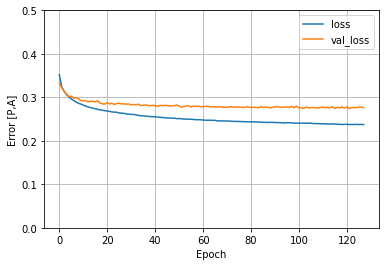

In [14]:
def plot_loss(history):
    plt.plot(history.history['loss'], label='loss')
    plt.plot(history.history['val_loss'], label='val_loss')
    plt.ylim([0, .5])
    plt.xlabel('Epoch')
    plt.ylabel('Error [P,A]')
    plt.legend()
    plt.grid(True)


plot_loss(history)

## Test Model

### Test

In [15]:
test_results = model.evaluate(test_X, test_y, verbose=2)
print("Mean Absolute Error:",test_results)

353/353 - 0s - loss: 0.2719 - 220ms/epoch - 624us/step
Mean Absolute Error: 0.27186521887779236


### Predictions

In [16]:
test_y.head()

,EMOTION_P,EMOTION_A
2,-0.5,0.6
9,-0.5,0.6
10,-0.5,0.6
12,-0.5,0.6
16,-0.5,0.6


In [17]:
test_predictions = model.predict(test_X)

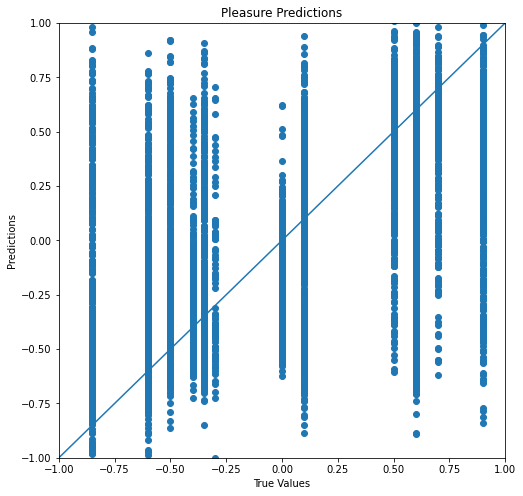

In [18]:
test_y_p = test_y.iloc[:,0]
pred_y_p = test_predictions[:,0]

fig = plt.figure(figsize=[8,8])

plt.scatter(test_y_p, pred_y_p)

plt.xlabel('True Values')
plt.ylabel('Predictions')
plt.title('Pleasure Predictions')

lims = [-1,1]
plt.xlim(lims)
plt.ylim(lims)

plt.plot(lims, lims)

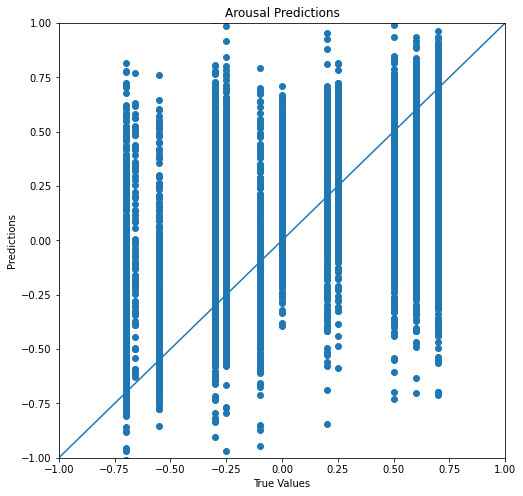

In [19]:
test_y_a = test_y.iloc[:,1]
pred_y_a = test_predictions[:,1]

fig = plt.figure(figsize=[8,8])

plt.scatter(test_y_a, pred_y_a)

plt.xlabel('True Values')
plt.ylabel('Predictions')
plt.title('Arousal Predictions')

lims = [-1,1]
plt.xlim(lims)
plt.ylim(lims)

plt.plot(lims, lims)

### Prediction

In [20]:
row=test_X.iloc[3]

newX = np.asarray([row])
print(newX)

yhat = model.predict(newX)
print('Real: %s' % np.asarray(test_y.iloc[0]))
print('Predicted: %s' % yhat[0])

[[ 4.29294321e-01  3.06416764e-01  1.90160499e-01  4.80217455e-01
   4.81940802e-01  3.92710381e-01  3.68086612e-01  2.79621814e-01
   2.86151000e-01  2.78543929e-01  1.46260049e-03  7.27718893e-02
  -1.24973131e-01  9.88677098e-01 -7.23215648e-03  7.74506342e-02
  -7.46573787e-02  9.93415262e-01  3.44755140e-01  2.35700501e-01
   2.43901109e-01 -1.90304534e+00  1.11720574e-01  1.17148491e-02
  -2.64487607e-01 -3.25672018e-01 -1.32798951e+00 -1.13553977e-01
  -3.25672018e-01 -1.32798951e+00 -1.13553977e-01  2.75070287e-02
   2.29849149e-03]]
Real: [-0.5  0.6]
Predicted: [-0.52534443  0.1486804 ]


In [21]:
row=test_X.iloc[150]

newX = np.asarray([row])
print(newX)

yhat = model.predict(newX)
print('Real: %s' % np.asarray(test_y.iloc[0]))
print('Predicted: %s' % yhat[0])

[[ 1.17215946e-01  3.61241095e-01  3.99839017e-01  4.36527563e-01
   2.25056134e-01  2.50486207e-01  2.13999571e-01  2.25460328e-01
   2.86151000e-01  2.78802821e-01 -4.47469565e-02 -1.97556939e-02
  -1.22498981e-01  9.91259681e-01 -3.79469484e-02 -1.91014097e-02
  -9.71441635e-02  9.94360778e-01  1.50873400e+00  1.53570480e+00
   5.10256963e-03  2.48060947e-02 -6.57138458e-02  3.51885611e-03
   3.30361134e-02  1.60708801e-02 -3.23744358e-02  6.02535890e-02
   1.60708801e-02 -3.23744358e-02  6.02535890e-02  3.09335762e-02
   5.35708106e-04]]
Real: [-0.5  0.6]
Predicted: [-0.37035128  0.5560564 ]


In [22]:
row=test_X.iloc[69]

newX = np.asarray([row])
print(newX)

yhat = model.predict(newX)
print('Real: %s' % np.asarray(test_y.iloc[0]))
print('Predicted: %s' % yhat[0])

[[ 7.45094044e-01  3.08864935e-01  5.89613759e-01  2.16829686e-01
   4.88945356e-01  5.00097549e-01  3.68079471e-01  4.04840912e-01
   2.86151000e-01  2.78836833e-01 -4.74951927e-02  1.28751507e-02
  -1.02237442e-02  9.98701594e-01 -3.35488704e-02  1.02280769e-02
  -2.56976120e-02  9.99019439e-01  8.40703464e-01  8.31786194e-01
   7.28529193e-03 -1.12519885e+00 -4.73639152e-02  3.69714237e-03
  -3.61404533e-02 -3.79055102e-02  1.92132258e-01 -1.37202153e-01
  -3.79055102e-02  1.92132258e-01 -1.37202153e-01  3.92774494e-02
   3.67095874e-04]]
Real: [-0.5  0.6]
Predicted: [-0.0444088 -0.0207414]


# Gradient Boosting (LMA features to P,A coordinates)

## Imports

In [120]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns

import sklearn
import tensorflow as tf

from sklearn.model_selection import cross_val_score
from sklearn.model_selection import RepeatedStratifiedKFold
from sklearn.ensemble import GradientBoostingRegressor

## Load Data

In [113]:
dataset = pd.read_csv('datasets/pa/Fs_B_N_LMA_DATA.csv')

### Split into Test and Train data

In [114]:
train_dataset = dataset.sample(frac=0.8, random_state=42)
test_dataset = dataset.drop(train_dataset.index)

print("No Training Samples:",train_dataset.shape[0])
print("No Test Samples:",test_dataset.shape[0])

No Training Samples: 8000
No Test Samples: 2000


### Split Features from Targets

In [115]:
train_X = train_dataset.copy()
test_X = test_dataset.copy()

train_y = pd.concat([train_X.pop(x) for x in ['EMOTION_P', 'EMOTION_A']], axis=1)
test_y = pd.concat([test_X.pop(x) for x in ['EMOTION_P', 'EMOTION_A']], axis=1)

test_y_p = test_y.iloc[:,0]
train_y_p = train_y.iloc[:,0]

test_y_a = test_y.iloc[:,1]
train_y_a = train_y.iloc[:,1]

In [116]:
train_X.head()

,avg_hand_distance,avg_l_hand_hip_distance,avg_r_hand_hip_distance,avg_feet_distance,avg_l_hand_chest_distance,avg_r_hand_chest_distance,avg_l_elbow_hip_distance,avg_r_elbow_hip_distance,avg_chest_pelvis_distance,avg_neck_chest_distance,...,avg_pelvis_velocity_y,avg_pelvis_velocity_z,avg_l_foot_velocity_x,avg_l_foot_velocity_y,avg_l_foot_velocity_z,avg_r_foot_velocity_x,avg_r_foot_velocity_y,avg_r_foot_velocity_z,avg_upper_body_volume,avg_distance_traveled
6252,0.182161,0.239957,0.073864,0.239951,0.627903,0.481206,0.502666,0.344620,0.415943,0.979307,...,0.581273,0.457494,0.579834,0.408163,0.508905,0.625058,0.410921,0.481715,0.206246,0.093821
4684,0.445825,0.270398,0.307184,0.540458,0.629404,0.480568,0.497964,0.556971,0.355507,0.977475,...,0.701403,0.453512,0.567967,0.471092,0.594918,0.640870,0.502866,0.438463,0.529884,0.154873
1731,0.630929,0.655890,0.246729,0.060113,0.653721,0.612517,0.599840,0.526427,0.305967,0.996776,...,0.574805,0.494450,0.583849,0.422701,0.483744,0.630963,0.421293,0.454491,0.467607,0.005886
4742,0.713392,0.546526,0.452078,0.520810,0.801025,0.734590,0.773689,0.665912,0.339651,0.989962,...,0.532673,0.334498,0.570885,0.344419,0.486102,0.629931,0.353288,0.494141,0.682069,0.130044
4521,0.403415,0.269620,0.282995,0.051448,0.644198,0.634451,0.521853,0.554992,0.314383,0.999728,...,0.584685,0.488869,0.583202,0.422638,0.485936,0.630273,0.421230,0.457467,0.350990,0.006148


In [117]:
train_y.head()

,EMOTION_P,EMOTION_A
6252,0.1,-0.7
4684,0.7,0.2
1731,-0.5,0.6
4742,0.7,0.2
4521,0.6,0.5


In [118]:
train_X.describe().transpose()[['mean', 'std']]

,mean,std
avg_hand_distance,0.403083,0.223347
avg_l_hand_hip_distance,0.337277,0.200253
avg_r_hand_hip_distance,0.350649,0.198675
avg_feet_distance,0.246535,0.107873
avg_l_hand_chest_distance,0.603496,0.160886
avg_r_hand_chest_distance,0.589745,0.170321
avg_l_elbow_hip_distance,0.514783,0.171863
avg_r_elbow_hip_distance,0.543706,0.171387
avg_chest_pelvis_distance,0.323467,0.062589
avg_neck_chest_distance,0.973500,0.048300


## Define Model

In [121]:
model_p = GradientBoostingRegressor()
model_a = GradientBoostingRegressor()

## Train Model

In [122]:
cv = RepeatedKFold(n_splits=10, n_repeats=3, random_state=1)

### Pleasure Regression

In [123]:
n_scores = cross_val_score(model_p, train_X, train_y_p, scoring='neg_mean_absolute_error', cv=cv, n_jobs=-1)
print('MAE: %.3f (%.3f)' % (np.mean(n_scores), np.std(n_scores)))

MAE: -0.236 (0.007)


In [124]:
model_p.fit(train_X, train_y_p)

GradientBoostingRegressor()

### Arousal Regression

In [125]:
n_scores = cross_val_score(model_a, train_X, train_y_a, scoring='neg_mean_absolute_error', cv=cv, n_jobs=-1)
print('MAE: %.3f (%.3f)' % (np.mean(n_scores), np.std(n_scores)))

MAE: -0.240 (0.006)


In [126]:
model_a.fit(train_X, train_y_a)

GradientBoostingRegressor()

## Test Model

### Prediction

In [127]:
row=test_X.iloc[0]

x = np.asarray([row])

y_p = model_p.predict(x)
y_a = model_a.predict(x)

print('Real: %s' % np.asarray(test_y.iloc[0]))
print('Predicted: %s' % [y_p, y_a])

Real: [-0.35  0.7 ]
Predicted: [array([-0.16072887]), array([0.50489924])]


/home/ds/.local/lib/python3.8/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but GradientBoostingRegressor was fitted with feature names
  warnings.warn(
/home/ds/.local/lib/python3.8/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but GradientBoostingRegressor was fitted with feature names
  warnings.warn(


In [129]:
row=test_X.iloc[150]

x = np.asarray([row])

y_p = model_p.predict(x)
y_a = model_a.predict(x)

print('Real: %s' % np.asarray(test_y.iloc[0]))
print('Predicted: %s' % [y_p, y_a])

Real: [-0.35  0.7 ]
Predicted: [array([-0.25354781]), array([0.40621777])]


/home/ds/.local/lib/python3.8/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but GradientBoostingRegressor was fitted with feature names
  warnings.warn(
/home/ds/.local/lib/python3.8/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but GradientBoostingRegressor was fitted with feature names
  warnings.warn(


In [130]:
row=test_X.iloc[69]

x = np.asarray([row])

y_p = model_p.predict(x)
y_a = model_a.predict(x)

print('Real: %s' % np.asarray(test_y.iloc[0]))
print('Predicted: %s' % [y_p, y_a])

Real: [-0.35  0.7 ]
Predicted: [array([-0.27337685]), array([0.32014121])]


/home/ds/.local/lib/python3.8/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but GradientBoostingRegressor was fitted with feature names
  warnings.warn(
/home/ds/.local/lib/python3.8/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but GradientBoostingRegressor was fitted with feature names
  warnings.warn(
